In [1]:
import mysql.connector
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import sys
from IPython.display import HTML
from matplotlib import pyplot as plt
from celluloid import Camera
import plotly.graph_objects as go

import networkx as nx

from IPython.display import HTML
from matplotlib import pyplot as plt
from celluloid import Camera
import collections

In [2]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  passwd="enron",
  database="emails",
  auth_plugin='mysql_native_password'
)

In [3]:
mycursor = mydb.cursor()

# Extract Data to Pandas

mycursor.execute("SELECT * FROM message")

myresult = mycursor.fetchall()

email_df = pd.DataFrame(myresult)

email_df.columns = ['mid','sender','date','message_id','subject','body','folder']



mycursor.execute("SELECT * FROM employeelist")

myresult = mycursor.fetchall()

employee_df = pd.DataFrame(myresult)

employee_df.columns = ['eid','first_name','last_name','email_id']



mycursor.execute("SELECT * FROM recipientinfo")

myresult = mycursor.fetchall()

recipient_df = pd.DataFrame(myresult)

recipient_df.columns = ['rid','mid','r_type','r_value','date_r']



mycursor.execute("SELECT * FROM referenceinfo")

myresult = mycursor.fetchall()

reference_df = pd.DataFrame(myresult)

reference_df.columns = ['rfid','mid','reference']



# Data Frame Characteristics

In [4]:
jobs = pd.read_csv('Data/Enron_jobs.csv')
employee_df = pd.merge(employee_df,jobs,on='email_id',how='left')
job_dict = {}
level_dict = {}

In [5]:
for email,level,job in zip(employee_df['email_id'],employee_df['job_rank'],employee_df['job_title']):
    job_dict[email] = job
    level_dict[email] = level

In [6]:
main_emails = list(employee_df['email_id'])

In [7]:
recipient_df = recipient_df[[email in main_emails for email in recipient_df['r_value']]]
email_df = email_df[[email in main_emails for email in email_df['sender']]]

In [8]:
# create mapping of messages to lists of recipients and how many recipients that email has
mid_dict = {}
count =0
total = len(recipient_df)
for mid,r_value in zip(recipient_df['mid'],recipient_df['r_value']) :
    if mid in mid_dict.keys():
        mid_dict[mid].append(r_value)
    else:
        mid_dict[mid] = [r_value]

(0, 5000)

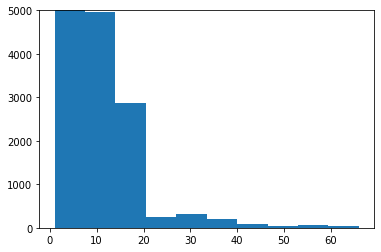

In [9]:
network_df = pd.DataFrame()

network_df['mid'] = list(set(recipient_df['mid']))


lst = []
lst_num = []
for mid in network_df['mid']:
    lst.append(mid_dict[mid])
    lst_num.append(len(mid_dict[mid]))
network_df['rec_list'] = lst
network_df['rec_count'] = lst_num


plt.hist(network_df['rec_count'])
plt.ylim(0,5000)

In [10]:
network_df = network_df.merge(email_df[['mid','sender','date']])

network_df.head()

,mid,rec_list,rec_count,sender,date
0,76,"[sean.crandall@enron.com, mike.swerzbin@enron....",3,mary.hain@enron.com,2000-08-17 07:11:00
1,93,[robert.badeer@enron.com],1,cooper.richey@enron.com,2000-08-23 04:39:00
2,159,"[robert.badeer@enron.com, mike.swerzbin@enron....",2,mary.hain@enron.com,2000-08-29 06:28:00
3,465,[richard.shapiro@enron.com],1,jeff.dasovich@enron.com,2000-08-07 12:23:00
4,517,[richard.shapiro@enron.com],1,jeff.dasovich@enron.com,2000-08-10 03:12:00


In [11]:
sender_count_dict = {}
for sender in set(network_df['sender']):
    sender_count_dict[sender] = len(set(network_df[network_df['sender']==sender]['mid']))


In [12]:
email_to_id = {}
id_to_email ={}
count = 0
for user in main_emails:
    email_to_id[user] = count
    id_to_email[count] = user
    count+=1

In [13]:
central_id = email_to_id['jeff.skilling@enron.com']
central_id

user_matrix = np.zeros((len(main_emails),len(main_emails)))

for sender ,rec_list,rec_count in zip(network_df['sender'],network_df['rec_list'],network_df['rec_count']):
    for recer in rec_list:
        user_matrix[email_to_id[sender]][email_to_id[recer]] += (1/rec_count)*sender_count_dict[sender]

129

In [16]:
G = nx.Graph()

G.add_nodes_from(range(len(user_matrix)))

# create list of edge weights to cut by percentile
edge_values = list(user_matrix)
l =[]
for edges in edge_values:
    l = l + list(edges)
edge_values = l

In [19]:
edge_thresh = np.percentile(edge_values,97.5)
for i in range(len(user_matrix)):
    for j in range(len(user_matrix)):
        #if i ==jeff_sig_id:
                #print('jeff_potential')
        if user_matrix[i][j] > edge_thresh:
            if i ==central_id:
                print('jeff_connection')
            G.add_edge(i,j)

In [20]:
eigen_dict = nx.eigenvector_centrality(G)
eigen_thresh = np.percentile(list(eigen_dict.values()),90)
for key in eigen_dict.keys():
    if eigen_dict[key]>eigen_thresh:
        print(eigen_dict[key],' : ',id_to_email[key],level_dict[id_to_email[key]])

0.19275960725979607  :  lindy.donoho@enron.com Employee
0.2171236329830229  :  kimberly.watson@enron.com nan
0.1572765054971742  :  d..steffes@enron.com Vice President
0.17281836631133615  :  elizabeth.sager@enron.com Employee
0.21802947556059069  :  shelley.corman@enron.com Vice President
0.18969846137971705  :  tana.jones@enron.com nan
0.19380176597145402  :  susan.scott@enron.com nan
0.16156611757311964  :  sara.shackleton@enron.com nan
0.1597324805071468  :  rod.hayslett@enron.com Vice President
0.1943682540095684  :  michelle.lokay@enron.com Employee
0.3060011625156687  :  jeff.dasovich@enron.com Employee
0.1490773773467797  :  gerald.nemec@enron.com nan
0.23126152574324413  :  louise.kitchen@enron.com President
0.2117679141080189  :  drew.fossum@enron.com Vice President
0.1915036629627393  :  steven.harris@enron.com nan


In [21]:
ranks = ['CEO','President','Vice President','Director']

In [22]:
level_num_dict = {}
for node in G.nodes():
    for i in range(len(ranks)):
        if ranks[i] == level_dict[id_to_email[node]]:
            level_num_dict[node] = i
            continue
    if node not in level_num_dict:
        level_num_dict[node] = len(ranks)

In [23]:
rank_list = []
for i in range(10):
    i_range_list = []
    for key,value in level_num_dict.items():
        if level_num_dict[key] ==i:
            i_range_list.append(key)
    rank_list.append(i_range_list)
while [] in rank_list:
    rank_list.remove([])

In [24]:
job_count = collections.Counter()
for rank in jobs['job_rank']:
    job_count[rank] +=1

In [25]:
job_count

Counter({'Employee': 41,
         'Vice President': 30,
         nan: 55,
         'Director': 14,
         'President': 5,
         'Manager': 17,
         'Trader': 11,
         'CEO': 5,
         'Managing Director': 6,
         'In House Lawyer': 1})

In [26]:
plotly_color = ['red','orange','yellow','purple','green','black','black','black','black','black','black']
node_size = [900,600,400,300,200,100,100,100,100,100]

colors_plotly = []
sizes_node = []


for node_num in list(G.nodes()):
    colors_plotly.append(plotly_color[level_num_dict[node_num]])
    sizes_node.append(node_size[level_num_dict[node_num]])

In [27]:
pos = {}
for i in range(len(rank_list)):
    x = -1 + i/5
    for j in range(len(rank_list[i])):
        pos[rank_list[i][j]] = (x,1/len(rank_list[i])*j) 
heir_pos = pos

In [1]:
employee_df

NameError: name 'employee_df' is not defined

In [28]:
#Vizualize Network Based on Job Ranks

//anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



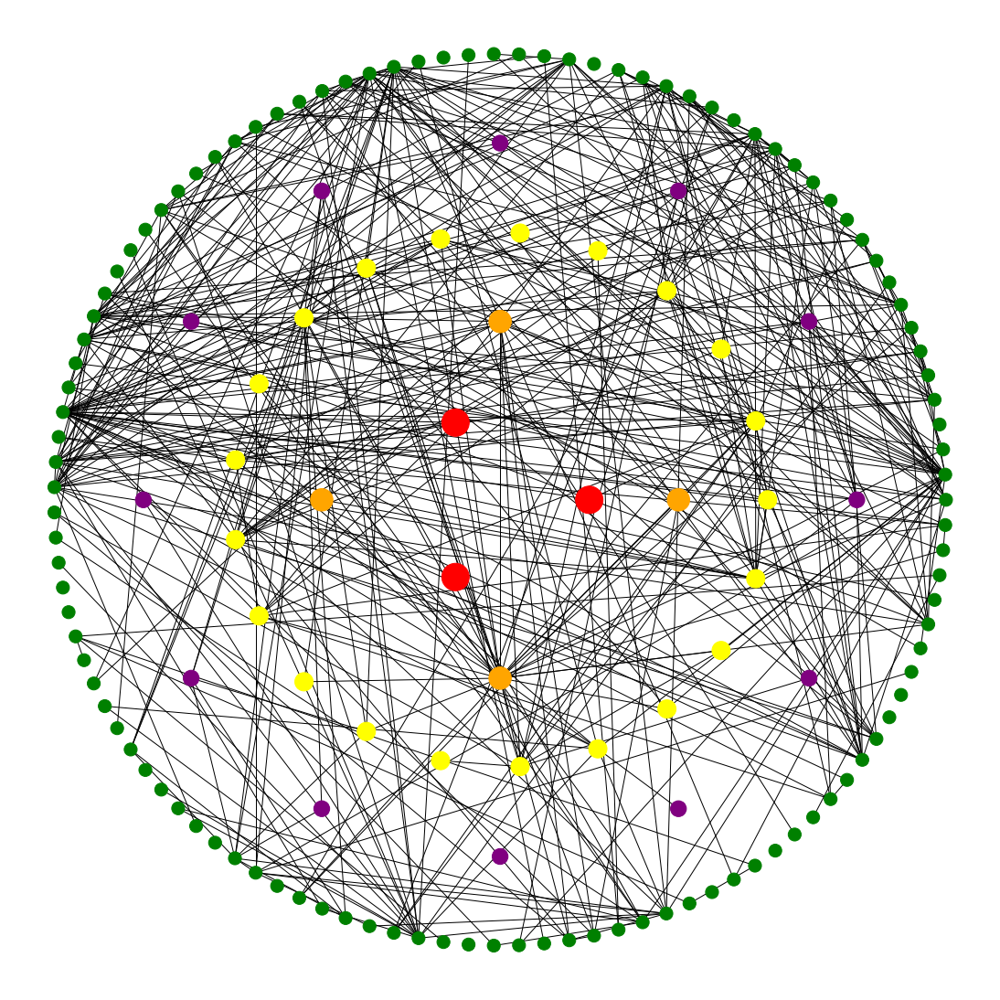

In [29]:
fig = plt.figure(figsize=(15,15))
pos = nx.shell_layout(G,rank_list)
nx.draw(G, pos= pos,node_size=sizes_node,node_color=colors_plotly)

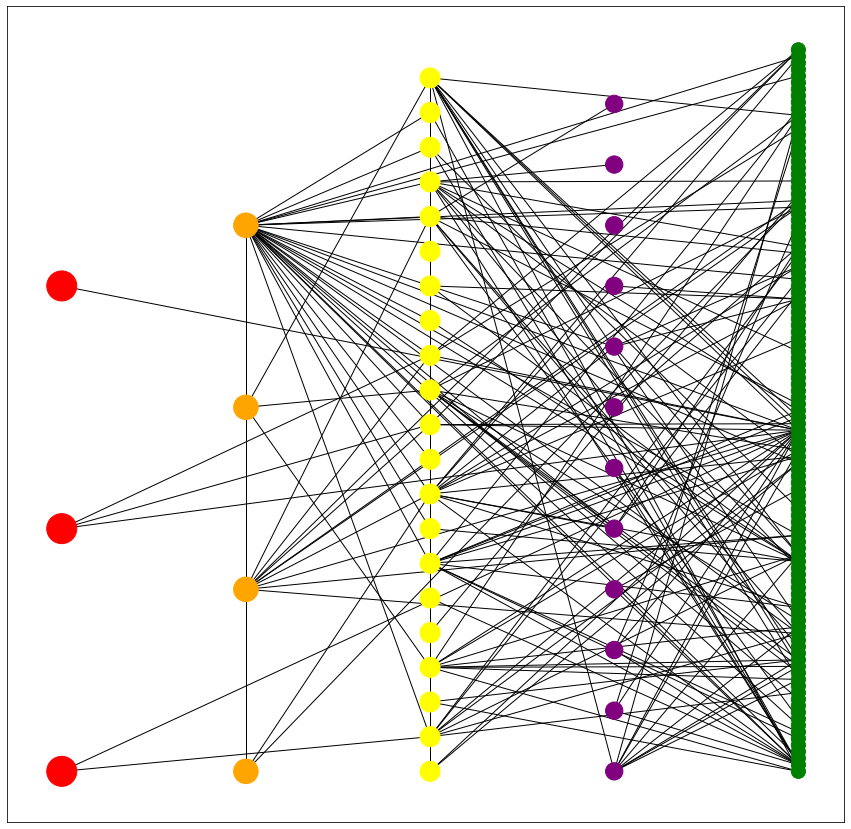

In [30]:
fig = plt.figure(figsize=(15,15))

pos = nx.shell_layout(G,rank_list)
nx.draw_networkx_nodes(G, pos= heir_pos,node_size=sizes_node,node_color=colors_plotly)
    

nx.draw_networkx_edges(G,pos=heir_pos)


In [31]:
set_edges = []
for node in rank_list[0]:
    set_edges = set_edges +list(G.edges(node))

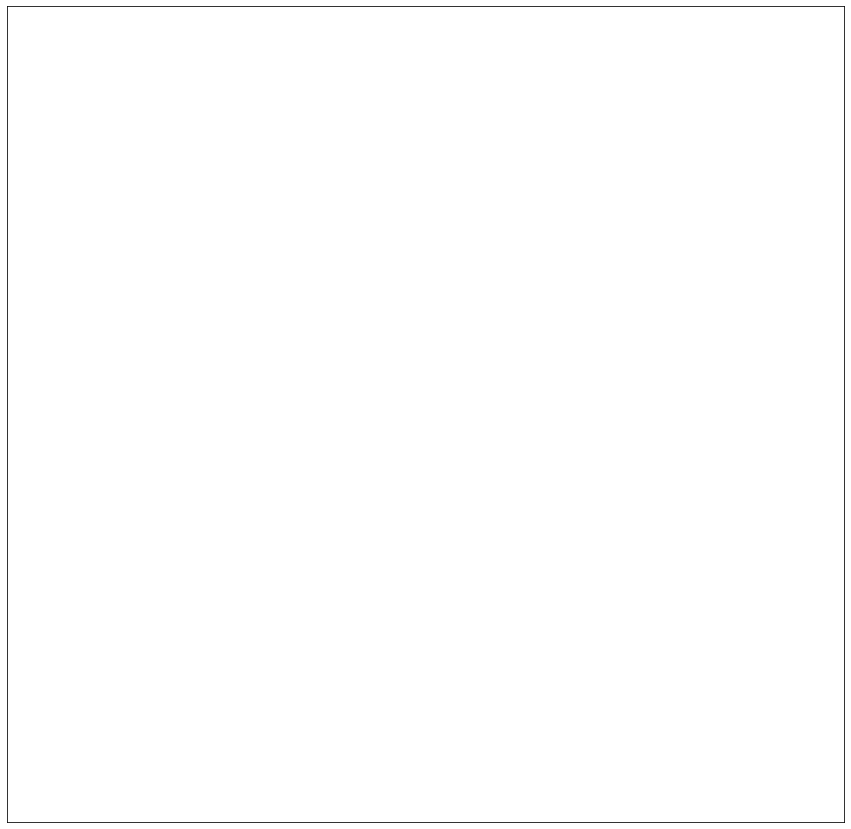

In [32]:
fig = plt.figure(figsize=(15,15))
camera = Camera(fig)
for i in range(len(rank_list)):
    set_edges = []
    
    for node in rank_list[i]:
        set_edges = set_edges +list(G.edges(node))
    nx.draw_networkx_nodes(G, pos= heir_pos,node_size=sizes_node,node_color=colors_plotly)
    nx.draw_networkx_edges(G,pos=heir_pos,edgelist=set_edges)
    camera.snap()
    
animation = camera.animate(interval=500)
animation.save('HeirarchyModel.gif', writer='imagemagick')
HTML(animation.to_jshtml())

In [33]:
email_df

,mid,sender,date,message_id,subject,body,folder
24,76,mary.hain@enron.com,2000-08-17 07:11:00,<5722839.1075863606028.JavaMail.evans@thyme>,Enron s transmission/power exchange model for ...,---------------------- Forwarded by Mary Hain/...,Robert_Badeer_Aug2000Notes FoldersNotes inbox
41,93,cooper.richey@enron.com,2000-08-23 04:39:00,<4083763.1075863605647.JavaMail.evans@thyme>,Change to EnData,The Fundamentals Group is moving Database serv...,Robert_Badeer_Aug2000Notes FoldersNotes inbox
107,159,mary.hain@enron.com,2000-08-29 06:28:00,<14457348.1075863603979.JavaMail.evans@thyme>,ISO To Participate in Super Peak Market,FYI---------------------- Forwarded by Mary Ha...,Robert_Badeer_Aug2000Notes FoldersNotes inbox
137,465,jeff.dasovich@enron.com,2000-08-07 12:23:00,<769016.1075863596202.JavaMail.evans@thyme>,CalPX Market Compliance Unit Submits its 2nd A...,FYI. The report posted on the website fails t...,Robert_Badeer_Aug2000Notes FoldersCapx
189,517,jeff.dasovich@enron.com,2000-08-10 03:12:00,<28494229.1075863594884.JavaMail.evans@thyme>,Re: Governor s Press Conference -- Shot Across...,There appears to be a pattern forming. The ad...,Robert_Badeer_Aug2000Notes FoldersCalifornia
199,527,jeff.dasovich@enron.com,2000-08-16 11:22:00,<14580176.1075863594659.JavaMail.evans@thyme>,CA ISO / CAL PX Information Related to 2000 Ma...,Tim/Bob:Attached is the letter that we sent to...,Robert_Badeer_Aug2000Notes FoldersCalifornia
201,529,mary.hain@enron.com,2000-08-17 07:20:00,<25626684.1075863594612.JavaMail.evans@thyme>,Re: SDG&E Offer,---------------------- Forwarded by Mary Hain/...,Robert_Badeer_Aug2000Notes FoldersCalifornia
210,538,jeff.dasovich@enron.com,2000-08-09 03:54:00,<31367023.1075863594381.JavaMail.evans@thyme>,Critics Seek More Control Over ISO,THE WALL STREET JOURNAL / CALIFORNIA Critics S...,Robert_Badeer_Aug2000Notes FoldersCal articles
213,541,jeff.dasovich@enron.com,2000-08-10 03:46:00,<19703418.1075863594306.JavaMail.evans@thyme>,Deregulation: `Conspiracy of Incompetence Eve...,Deregulation: `Conspiracy of Incompetence Even...,Robert_Badeer_Aug2000Notes FoldersCal articles
214,542,jeff.dasovich@enron.com,2000-08-11 05:27:00,<6858997.1075863594277.JavaMail.evans@thyme>,ISO Special 8.10.00 Report on Energy Market Is...,---------------------- Forwarded by Jeff Dasov...,Robert_Badeer_Aug2000Notes FoldersCal articles


In [34]:
list(email_df['body'])[2].split('Subject:')[2]

' ISO To Participate in Super Peak MarketFolks,Late Friday afternoon Ziad called me.  The ISO Governing Board earlierthe same day turned down the ISO management s request to force SCs toplace 95% of their scheduled load in the DA market.  That leaves the ISOlittle choice but to venture into the energy markets to procure power tocover their peak hours on hot days.Terry gave Ziad the OK to proceed with placing both the APX andCalifornia PX screens for this new product/matching-service.  I amworking with the two vendors and the ISO to make this happen quickly.We anticipate that the market will open on Tuesday, September 5, orearlier.Key people who you may need to contact:ISO - Ziad Alaywan  916-351-2140 (Nancy Traweek and Jim McIntosh arealso in the loop)PX - Ken Czarnecki 626-537-3123PX - John Yurkanin 626-537-3124APX - Denice Cazalet 408-517-2123APX - Michael Heinrich 408-517-2159Please feel free to contact me with your questions.  Several of you havenot had the opportunity to attend th

In [35]:
cleaned_list = []
for message in email_df['body']:
    chunks = message.split('Subject:')
    cleaned_list.append(chunks[-1])

In [36]:
len(email_df['body'])

87120

In [37]:
len(cleaned_list)

87120

In [51]:
count = 0
for item in cleaned_list:
    if  cleaned_list.count(item) > 1:
        print('big loser')
        print(item)
        count += 1

big loser
 ISO To Participate in Super Peak MarketFolks,Late Friday afternoon Ziad called me.  The ISO Governing Board earlierthe same day turned down the ISO management s request to force SCs toplace 95% of their scheduled load in the DA market.  That leaves the ISOlittle choice but to venture into the energy markets to procure power tocover their peak hours on hot days.Terry gave Ziad the OK to proceed with placing both the APX andCalifornia PX screens for this new product/matching-service.  I amworking with the two vendors and the ISO to make this happen quickly.We anticipate that the market will open on Tuesday, September 5, orearlier.Key people who you may need to contact:ISO - Ziad Alaywan  916-351-2140 (Nancy Traweek and Jim McIntosh arealso in the loop)PX - Ken Czarnecki 626-537-3123PX - John Yurkanin 626-537-3124APX - Denice Cazalet 408-517-2123APX - Michael Heinrich 408-517-2159Please feel free to contact me with your questions.  Several of you havenot had the opportunity to 

big loser
	Meeting with ShelleyShellley would like to meet at 9:30 on Monday in her office to discuss Transwestern customer accounts.  Please let me know if you have a conflict with this time.Thanks,Lindy
big loser
Spoke with Jim Adams at Panda this p.m.  His new guy Steve Curley is now on board working transportation for Panda.  Jim and Steve will likely call us Tues pm or Wed with a short list of questions on the project.  Jim is also waiting on feedback from TECO on our proposal.kh
big loser
 attached is the info for JP Morgan.  Let me know if you have questions.kh
big loser
	Enron Kids Adopt A Child Program << OLE Object: Picture (Device Independent Bitmap) >>  For each of the last 15 years the Enron Kids Committee has chosen an under-privileged HISD elementary school and offered to "sponsor" every child in that school.  What we mean by "sponsor" is that we outfit the child from head to toe plus give each of them a toy and book.  The presents are then handed out to the children at 

big loser
	Kern River New Delivery Point FilingDo either of you want the complete/partial certificate filing of Kern River s New Kramer Junction Delivery Point into SoCal s planned Adelanto Lateral?If so, I saw it was noticed and is available at the FERC today.  Let me know.Lorna M. BrennanCompetitive IntelligenceEnron Transportation ServicesOmaha  402-398-7573
big loser
Dear Dr. Lay--		Thank you for your presentation yesterday.  As always, you handled very well some tough questions in a very trying time for Enron.  I was literally mortified when I heard the "crack" question-- but I think you handled that well too.  As a 17-year Enron veteran, the question made me truly ashamed to be associated with the co-worker who asked the question.  Hindsight is always 20/20.  I m sure you must know that the majority of Enron s employees don t feel the same way as this one individual.  Thanks for your continued hard work and support.Kevin HyattDirector, Asset DevelopmentETS
big loser
	Oasis Dairy 

big loser
        RDI Subscription=20You have been identified as a current subscriber to an RDI database. These =databases include:=20Base Case=20PowerDat=20GasDat=20CoalDat=20This contract is expiring and as part of the renegotiation we will need you=r acceptance to allocate the costs of this information to your Co# and RCPlease respond with the desired application, Co# and RC prior to March 5th.==20Thank you=20Paula Corey=20Sr. Contracts Manager=20713.853.9948
big loser
	Location NumberJudy,I need to provide a NBV for a Gomez Laterial (35miles of 20" pipe), to Kevin Hyatt. Frank says it should be in company 0060 (TW).I ran the following locations numbers: 44*094, 44*095, 44*149 44*34037, but found nothing in co. 0060.  Can you help?Thanks,MaryI
big loser
	Location NumberJudy,I need to provide a NBV for a Gomez Laterial (35miles of 20" pipe), to Kevin Hyatt. Frank says it should be in company 0060 (TW).I ran the following locations numbers: 44*094, 44*095, 44*149 44*34037, but found n

big loser
	Enron KidsKevin,Are you still looking for sponsors for the Enron Kids program?  Sean Bolks said you had 14 kids that needed sponsors last Friday.Let me know,Thanks,Preston
big loser
	Enron KidsKevin,Are you still looking for sponsors for the Enron Kids program?  Sean Bolks said you had 14 kids that needed sponsors last Friday.Let me know,Thanks,Preston
big loser
 Kevin,As a follow up to our recent discussions concerning the SoCalGas RLS orpeaking rate, I am forwarding to you the proposed decision of ALJ Brown.  Myunderstanding is that at yesterday s Commission meeting the Commission madea decision to approve a change to the current peaking rate tariff.  I shouldhave their decision within a couple working days.  I am forwarding theirdraft decision.The expected PD rate design for the new peaking rate would include SFV ratedesign principals, demand charges determined over highest recorded usageover a 12 month period, and inclusion of public purpose program charges.  Atthis poin

big loser
 Enron Data Responses for FERC s Bulk Power InvestigationAttached find Enron Power Marketing, Inc., and Enron Energy Services  responses to the Staff s data requests in the Federal Energy Regulatory Commission s Bulk Power Investigation.  These responses assumes that you sent separate data requests to Enron Wind, so they do not include that information.  The answers also assume you are requesting this information for California (and therefore the Western interconnect) only.  Please let me know if these assumptions are incorrect.  If you were requesting Eastern Interconnect information you need to contact Chrisit Nicolay at the above E-mail address.  Enron requests confidential treatment of response numbers 2, 3, 4, 6, and 8 pursuant to 18 C.F.R. Section 388.112.  Due to the short turn around time for these requests we were unable to respond to question 8 and to provide the Unit Identifier requested in question 4.  We hope to be able to provide this information on Monday.  Ple

big loser
How does this look? Also, I did change some numbers in the excel spreadsheet:	The Ignacio to Blanco subscription levels were pulling from the row excluding ROFR capacity in the supporting sheet.  I changed it to be consistent with the other 	capacities (which include ROFR capacity).	Shelley had made some assumptions about East of Thoreau capacity subscription, such as, the USGT 400,000/d contract would remain subscribed (it doesn t 	have ROFR) and she had included the extension of 2-3 other contracts that don t have ROFR.  These contracts were then dropped after 2005.  I continued the 	extensions through 2006.	I changed the East of Thoreau capacity to 750,000/d from 850,000/d.
big loser
	Tracy  -  As discussed.Steve << File: enron corp infomation request-cons.xls >> Rob BrownManager, Enron Corp.Financial Accounting & ReportingOff. 713.853.9702Cell 713.303.4497rob.brown@enron.com
big loser
	Cost CenterKyle Norosky who works in Enron Corp Business Controls, recently flew to Min

big loser
Please review the attached agreement for the Big Sandy Interconnect.  It is very standard.  It is reimbursable.  It has a few blanks that have to be filled in for certain dates that we (or Caithness) don t know just at this time with respect to receiving regulatory approval, in-service date, etc.  Caithness wants this agreement for their prospective equity partners to review for content.  Teb, Lee and Ron, this agreement has not changed since you have last seen it, but I just wanted you to give it one more look.I would like to email to Kirk (Caithness) tomorrow afternoon.  Thanks, Kim.
big loser
	MESSAGE FROM MARK LINDSEY - 4TH Q 2001As discussed in Rick Causey s staff meeting yesterday, please begin to review 4th quarter earnings for your business unit(s) and compile a list of any major hurdles, challenges, etc. (i.e. bonus accrual, "clean-up" items).Furthermore, please assess any additional items that would be candidates for clean up, given the opportunity to expedite their

big loser
Steve Gilbert is working on this.  How soon do you need it?--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
	NNG & TW Direct Cash Flow Estimate (11/27 -11/30) Please find attached file. No major individual ($5.0 MM or greater) receipts or disbursements  anticipated over the last four days this month.                           << File: NNG&TWDAY01.xls >>
big loser
I was planning to attend.--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
	NNG & TW Direct Cash Flow Estimate (11/27 -11/30) Please find attached file. No major individual ($5.0 MM or greater) receipts or disbursements  anticipated over the last four days this month.
big loser
	PEP SYSTEM Reviewers?Rod HayslettEB4054713-853-6178
big loser
	Cost CenterKyle Norosky who works in Enron Corp Business Controls, recently flew to Minneapolis with regard to security issues.  He has told me that his trip is to be charged to ETS/

big loser
	2002 Plan Assessments as of 10/19/01 for ERECAttached is the updated version of the 2002 plan assessments from Enron Net Works (ENW) for your business unit.  We are sending revisions due to several changes, including increases in Corporate and other business unit allocations, and reductions in ENW expenditures.  This intercompany billing invoice now includes pass throughs and capital for your information.  Consistent with 2001, pass through billings (long distance, market data, WAN, etc.) will not be included in the standard assessments ("8xxxxxxx" accounts).  They will be posted directly to direct expenses ("52502000" accounts) at the cost center level.  This pass through number is only a high level place holder and is not intended to replace the dollars already being budgeted for by each cost center owner.If you have any questions, you can contact Kevin May at x52508 and he will answer any questions or direct you to the correct person.If you are not the correct person to r

big loser
	2002 Plan Lay Presentation Run Through Stan would like to have a run through of the presentation for the Lay reviews on November 1.  Please see the agenda attached below for your respective group s time.  We will be meeting in EB 49C2.  If you need to call in, the number is below.If you can not attend, please send a representative.   CALL IN:PARTICIPANT CODE:  277217  *  Toll Free Dial In Number:  (800)403-2002If you are calling in, please send your presentation to me ahead of time so I can make copies.   Please feel free to invite anyone else you want to attend.  If you have any questions, I can be reached at 713-853-7372.ThanksTracy
big loser
	4 Quarter UpdateImportance:	HighRod and I are meeting with Stan Monday afternoon, October 22, to talk about the 4th Quarter.  I have listed below the latest IBIT impact to Enron for the 4th Quarter that I have.  Please let me know if there are any changes and provide any variance explanations if necessary.  PGG  $28.0EREC $53.2Azurix

big loser
	September Capital ChargeSorry for the late notice, but here s the info on September capital charge:As was done for the 2Q flash in June, we will be using an estimate for the September Capital Charge.  However, unlike last time, we will rely on each of you to estimate your September (and Q3) capital charge, since we will be truing up to actuals YTD in October.  Please send us (myself and Terry West) what you will be incorporating into your flash.  If you have any questions, please give one of us a call.Thanks,Steve and Terry
big loser
	September Capital ChargeSorry for the late notice, but here s the info on September capital charge:As was done for the 2Q flash in June, we will be using an estimate for the September Capital Charge.  However, unlike last time, we will rely on each of you to estimate your September (and Q3) capital charge, since we will be truing up to actuals YTD in October.  Please send us (myself and Terry West) what you will be incorporating into your flash

big loser
	REQUEST - 2001 Operating Expenses - High PriorityHello everyone.  I know that most, if not all, of you are busy with quarter close, 2002 Plan, and possibly Board of Directors presentations and that this is not the ideal time to have more added to your plate.  However, in conjunction to with setting the 2002 Plan targets, the Office of the Chairman has asked to see an analysis of 2001 operating expenses by business unit, with some level of detail, and with quick turnaround.To that end, and to expedite this request in an efficient manner (and hopefuly save you some work), corporate accounting has already prepared a summary of operating expenses by business unit by category for the eight months ended August 31, 2001.  These categories correlate very closely with the most often used accounts in SAP (cost element groups), i.e. salaries, benefits, outside services, etc.  This information ties to your rollup in CS.  Some categories have many accounts mapped to them, and we have pro

big loser
	FuelA meeting has been scheduled for next Tuesday, February 5 in EB1336 to discuss the following:TW fuel sales, imbalances and UAFTW Daily Balancing ReportPlease let me know if you have a conflict.Jan MooreX53858
big loser
	FuelA meeting has been scheduled for next Tuesday, February 5 in EB1336 to discuss the following:TW fuel sales, imbalances and UAFTW Daily Balancing ReportPlease let me know if you have a conflict.Jan MooreX53858
big loser
	Plan Assumptions with Stan, 2/6/02, 8:00 amI talked with Rod about the purpose of the meeting.  Stan wants to start thinking about the assumptions for the 2004 rate case and a ten year Plan.  I will bring the 2002 Plan but it is really a short-term Plan and Rod does not want me to hand out anything.  It is a strategy session.We assumed in the Plan a rate drop effective 1/1/05.  I would like to review the assumptions behind that with Teb and Blair to better understand how it was derived.  This will be one of the major issues for discuss

big loser
	Pemex (MGI) ProposalThe following note is from Kim Watson:Please review the attached proposal for Pemex (MGI) for firm transportation on Transwestern.Please forward all comments back to Steve Harris.  We would like to send this out today, so your prompt attention would be appreciated.  I am on vacation until October 8 and Mark will not return to the office until October 1.Steve, once all comments have been incorporated, please forward to Jorge at Pemex at his email address of jrojas@gas.pemex.comPlease feel free to call me on my cell phone to discuss (713-416-5059)Thanks, Kim << File: Pemex Letter 09-27-01 TW Proposal.doc >> Audrey D. RobertsonTranswestern Pipeline Company email address:  audrey.robertson@enron.com(713) 853-5849(713) 646-2551 Fax
big loser
	Amending Red Rock ContractsOneok #27607 needs the receipt to be amended from East of Thoreau to Westar Ward, PPL#27649 needs to be amended from East of Thoreau to West Texas pool, and PPL#27641 needs to also be amended fr

big loser
In an effort to get cash in the door for TW and to maximize revenue opportunity for TW in the coming year, I think we should look at getting two proposals on file with the FERC as soon as possible. One would be the OBA filing we have been discussing (and trying to support with historical data) to get automatic cash-out on OBA s in "constrained" areas on TW.Second would be to look at filing for scheduling by price at alternate FT points.  This may be the time (the market to California is not so hot) to try to implement this.  I know we will have to look hard at the cost of the system modifications required and whether we can justify them.  Glen is already scheduling a meeting next week for further discussion of the OBA tariff filing.  Could we discuss scheduling alternate FT by price at the same meeting?
big loser
	SoCal UnbundlingAt yesterdays CPUC meeting the Commission approved on a 3-2 vote the Comprehensive Settlement we supported to unbundle the SoCal system.  This inclu

big loser
	Refresh pricingKinko s wants their pricing refreshed for their Reliant and TXU sites only.I need to know the fixed $MWh price if we assume a 50% renewable product in TXUand a 100% renewable product in Reliant s service area.I am trying to fill out the attached template that Larry sent to me with my gen only price refreshed,some Price to beat estimates I ran for him and your new renewable power quotes.ThanksKay << File: Price Offer Template-kinko s.xls >>
big loser
	Refresh pricingKinko s wants their pricing refreshed for their Reliant and TXU sites only.I need to know the fixed $MWh price if we assume a 50% renewable product in TXUand a 100% renewable product in Reliant s service area.I am trying to fill out the attached template that Larry sent to me with my gen only price refreshed,some Price to beat estimates I ran for him and your new renewable power quotes.ThanksKay << File: Price Offer Template-kinko s.xls >>
big loser
 CA RPS proposal & potential impactAll -Wanted to 

big loser
 Scheduling & ConflictsHi Keegan, Thank you for calling this morning to provide me with my schedule for today.  I want to share some constructive advice on how to fine tune our strategy with respect to scheduling because Keegan this is critical to my providing the best legal counsel I can to the various clients we serve.  You indicated that there is a conflict on the schedule in that there is a 9:30-10:30 meeting that conflicts with the Swaps Group meeting.  We do not want to schedule conflicting meetings and then realize it at the last minute and then just notify one group that we can t attend.  What you want to do is this:  You want to try at the time of the invitation to attend or as soon as practicable to notify me that there would be a potential conflict.  Then I will try to rescheduel.  This is especially important because the meetings with GSS are usually with folks from outside Enron, so once we agree to attend, it is nearly impossible the morning before to try to res

big loser
 FW: Check out this page at SpeakOut.com!>> This is the page I mentioned to you yesterday.  It ask for your opinion> regarding issues and which candidate matches your views.  Kind of fun,> kind of interesting.>> Brett Schelin> Phone: (225)924-8271> Fax: (225)924-8616> e-mail: labbls@womans.com>>> http://www.speakout.com/SelectSmart/Default.asp>> SpeakOut.com
big loser
 Mark Haedicke has asked me to submit a list of our "top ten legal risks" - please let me know of anything you think should be included in the list.
big loser
 Financial Confirmations IssuesPlease plan to attend a meeting regarding Financial Issues on Monday the 30th from 10:00am to 11:00am in EB3125B.  If you are unable to attend please call me directly at X3-9030. The meeting will be hosted by Kim Theriot Manager of Power and Gas Documentation.Many Thanks,Yolanda
big loser
I received a call from John Powell reuqesting copies of the agreements for transacting on EOL (for the legal department).  He was asking ab

big loser
 Deutsche BankRod:I don t know if you are still handling this.  We are close to getting this finalized.  One credit comment from them that I need someone s thoughts on.  They want the Issuer of LC s to maintain a credit rating of A from S&P and A2 from Moody s.  We usually put A- and A3.  are you okay with this?  If I need to run this by someone else please let me know.Carol St. ClairEB 3892713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
 sorema structurePLease find attached an explanation of the structure we are looking at.Idriss.(See attached file: Weather Derivatives Reinsurance.doc) - Weather Derivatives Reinsurance.doc
big loser
 ClickPaper Process Flow diagramsI don t know how much help you will find these, but I attach the process flows diagrams but I tried to get everyone s roles onto paper.  The main areas of note for me in having spent time looking at the process are (BIG CAVEAT is that I probably don t understand everything bearing in mind 

big loser
 Mobile Phone BillHello Louise,Your March, 2000 Enron mobile phone bill for 07881512535 has been processed.DID YOU KNOW...The Mobile Phone Web Site has today been moved to a new location on the Intranet Site and the new mobile phone URL is http://mobilephone.enron.co.ukAlso you can easily contact any Enron Mobile Phone User from your Lucent Land Phone:*  Press the  Call Mobile  button *  Key in the individual s extension number*  This will automatically dial the mobile numberIf your RC Code is incorrect please contact London HRService Centre by e-mail or Lorna Archer on extension 34207Payment of Personal Calls from mobile phones will be at the discretion of your RC Head.Please check your bill and indicate whether you agree or disagree with the bill details.  If you disagree, click on the  COMMENT BUTTON , and enter a reason.  Accounts will then decide if they need to investigate further.On your Lotus Notes Workspace (within Notes, select Window/1. Workspace at Office) there i

big loser
 FYI call approx. 1.5 weeks ago from Madelon Coover @ AGENCYJay/Dave - as I mentioned Madelon Coover called approx. a week and a half ago trying to get in our good books (or in her words  resurrect our relationship ).  The only two things she said of any interest were the following:- they have developed a WAP/ Palm(?) prototype in Dallas that enables some degree of EnronOnline quotes to this platform (not sure of functionality) - she was clearly keen to show this to us (I did not commit us in any way ) - she also mentioned their Portland office is doing work for EBS , something to do with broadband and that they were  very happy with their work .
big loser
 Bracewell & Patterson Seminar for ESA (Brazil)Sara;As per our previous telephone conversation with respect to a legal seminar in Brazil, I would like to discuss with you the most appropriate way to meet the expectations of both ESA lawyers and Direct Sales business people.  My idea is to organize a 1 or 2 day seminar in S?

big loser
 PA/ETAAttached are revised drafts of the New York PA and ETA, which have been revised to reflect the latest Clifford Chance drafts and our discussion yesterday.  We are unable to blackline these drafts, due to the fact that the Clifford Chance drafts are not on our system (and we did not receive all of them in any event).  Also, we have not yet received from Mark s office the language on confirmations; we have taken a shot at it but can obviously modify it after we get the language.Finally, we have attached a blackline of the "Legal and Privacy" statement, reflecting some suggested changes.  We also note that, if this document is to be "global", we will either need to decide on a single governing law or delete choice of law entirely.Best regards.------------------------------------------------------------------------------This e-mail is sent by a law firm and contains information that may be privileged and confidential. If you are not the intended recipient, please delete th

big loser
	Riskmantra vs. EGMTana,There are about 20-30 deals in pending sent to legal status that are Riskmantra vs. EGM.  My question is should we even be doing trades with Enron Gas Marketing.  And if we should, can we set up an ISDA with RMT with an effective date of 9/5/01?Thanks,Patrick
big loser
	ConfirmLogic Target Customer ListKim:I am reviewing the list of 20 target customers dated 9/14/01 in an effort to set up a document drafting timetable.  For financial trading purposes, I need an accurate list of trading counterparties reflecting the complete name of each legal entity.  Also, if a company is split into more than one legal entity (such as power and gas) for financial trading purposes, I need the names of both entities.Thanks.Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
Tanya:EOL is asking for the Chase master to be amended to eliminate the need for confirms on EOL trades.  Do we need to

big loser
	2001 Management ConferenceDuring this critical time, it is imperative that our management team remain focused on our business and continue to address the challenges currently facing our company.  For that reason, I have decided to postpone the Enron Management Conference.The Conference will now be held Friday, February 22 - Saturday, February 23, 2002 at the Westin La Cantera Resort in San Antonio.  While the Saturday meeting allows some Enron executives who cannot be away from the office during business hours to attend the Management Conference for the first time, I also recognize that it requires many of you to forfeit additional personal time on behalf of Enron.  I truly appreciate your sacrifice and I sincerely encourage your attendance.The new agenda, while still being finalized, will be abbreviated but every bit as informative and worthwhile as previously planned.  We ll be in touch soon with more details.Regards,Ken Lay
big loser
 gscap.pdf.pdf <<gscap.pdf.pdf>>
big l

big loser
	vacation Ladies,I would like to take the following days as Vacation:September 19, 20 & 21.Please advise if there would be any conflicts.Thanks.Cordially, Susan S. BaileyEnron North America Corp.1400 Smith Street, Suite 3803AHouston, Texas 77002Phone: (713) 853-4737Fax: (713) 646-3490Email: Susan.Bailey@enron.com
big loser
	Pop Up Box LanguageBob --Here is our first draft of the pop-up box language.  Please circulate among the appropriate members of your group and let Barbara or me know if you have any comments.  Language for the revised Password Application will follow.Mark TaylorVice President and General CounselEnron Wholesale Services(713)853-7459
big loser
	Enron All-Employee MeetingTo: All Enron Employees: Please join us at an all-employee meeting at 10 a.m. Houston time, Thursday, Aug. 16 in the Hyatt Regency Houston s Imperial Ballroom. We will review Enron s second quarter financial and operating highlights and update you on key issues affecting the company. We welco

big loser
How did it go?
big loser
	Duke Energy Consent Theresa Zucha on behalf ofStacy Dickson-GranmayehEnron North America Corp.1400 Smith St., EB3884Houston, TX  77002Phone:  713/345-4582Fax:  713/646-3490
big loser
	Revised AEP-EOL paperless confirm agreementI tweaked the one that I sent you yesterday.  Here s the  final version.Janet
big loser
	Duke Energy Consent Theresa Zucha on behalf ofStacy Dickson-GranmayehEnron North America Corp.1400 Smith St., EB3884Houston, TX  77002Phone:  713/345-4582Fax:  713/646-3490
big loser
	Revised AEP-EOL paperless confirm agreementI tweaked the one that I sent you yesterday.  Here s the  final version.Janet
big loser
	Kim JacobsenMark,What was the feedback on Kim?  Sorry about the HR mixup on the scheduling sheet that indicated that she was to work for me.  Cheryl Nelson interviewed her without knowing the real opportunity was for your group.  Oops.Let me know how you would like me to proceed.Michelle
big loser
	Canadian Hunter Resources ISDAIm

big loser
Congratulations to everyone on making it through Q3 more or less intact and a big thank-you to those who pulled us through with all your hard work.Given the continued increase in the number and variety of transactions coming to us from the Global Finance and VPP teams, we are going to have to revise our staffing procedures and ask each of the lawyers in the group to take on some of this burden.  If any of you receive a request to handle one of these deals, please refer the requester to me or at least let me know so that we can equitably distribute the load.  Mary and Anne will be scheduling training sessions for the entire group during which they will go over some of the most common structures and the issues that they have faced recently to help us on our way.  As with all of our work, I expect that we will each be available to the others in the group to bounce ideas around and help with thorny issues.Mark TaylorVice President and General CounselEnron Wholesale Services1400 S

big loser
 Mark TaylorVice President and General CounselEnron Wholesale Services1400 Smith Street - EB3892Houston, Texas 77008(713)853-7459(713)646-3490 (fax)
big loser
 Mark TaylorVice President and General CounselEnron Wholesale Services1400 Smith Street - EB3892Houston, Texas 77008(713)853-7459(713)646-3490 (fax)
big loser
We have received an executed financial Master Agreement:Type of Contract:		ISDA Master Agreement (Multicurrency-Cross Border)Effective Date:			July 5, 2001Enron Entity:			Enron North America Corp.Counterparty:			Doublewood XLIM Fund Ltd. (The)Transactions Covered:		Approved for all products with the exception of:   Foreign ExchangeConfirming Entity:		Enron North America Corp.Governing Law:			New YorkSpecial Handling Requirements:  (a) ENA is Calculation Agent, unless a Potential Event of Default or an Event of Default exists with respect to ENA,then Counterparty will act as Calculation Agent or will appoint a third party to act as such.(b)  Counterparty has three 

big loser
 Financial Trading Legal DatabaseDavid,Mark Taylor asked me to talk to you about getting your ISDA Masters inputted into our Financial Trading Database.  This databse is the central master database where we keep records of the financial agreements in either draft form or that have been executed.  London currently updates this database to manage  its (and Singapore s) financial contracts and I would like to get the Australian agreements plugged into the system.This database serves a number of purposes.  First, it is our core memory of contract negotiations.  Anyone in Legal and Credit around the world can take a look at this database and determine who we have entered into contract with and what negotiation issues may be at issue.  It is critical as we become a global trading company that we are consistent in the legal positions we take on these financial contracts.  For instance, it would be quite problematic if someone in Houston was negotiating a contract with an ISDA counte

big loser
 What happened with the NDA?
big loser
  Re: Financial Trading in BrazilDear Sara:Thank you for your E-mail below. We will be reflecting the new changes in theregulations in the chart and will be sending it to your review as soon aspossible.Kind regards,Marcelo Rodrigues>>> "Sara Shackleton" <Sara.Shackleton@enron.com> 03/13 2:29 pm >>>Greetings to you both!  It has been awhile since we last spoke.  I would like tofinalize the matrix which we have been discussing since the latter part of 1999.Although we were awaiting new Central Bank regulations, I am beginning to thinkthat the Central Bank revisions will not impact the matrix except with respectto transactions which may be entered into by entities that are the subject ofthe Central Bank regulations.  Please let me know whether or not you agree orcan offer any suggestions.  Thanks and regards.  Sara - M2689iii.doc - Char5.doc
big loser
Attached are revised copies of the True Quote LOI and Term Sheet.  A copy of the LOI marke

big loser
attached is my updated list Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
	Work ReportsPlease remember to get your work report updates to me by the end of the day.Mark TaylorVice President and General CounselEnron Wholesale Services1400 Smith Street - EB3892Houston, Texas 77008(713)853-7459(713)646-3490 (fax)
big loser
	Work ReportsIf you have not already done so this week, please remember to update your work reports for me this afternoon.Mark TaylorVice President and General CounselEnron Wholesale Services(713)853-7459
big loser
 Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
 Re: Hey  I m glad to know I m not the only one that s this sore.  We should be sore though.  We played 5 games.  And I played every second of every game.  Now don t you feel sorry for me?!
big loser
 Re: Hey  I m glad to know I m not 

big loser
 book adminsAdmin   DPR   Phone #John Swinney  BAS0800  3-9111   SpecII0800    Spec0800   Metals0800Pat Stafford  0800dbrc  5-8638   0800dist   0800dist2   0800rprc   USUK0800Michelle Nelson 0800blrc  5-8091   0800cfrc   RES0800   FRT0800Sony Wilson  Ngl_0800  3-7729   EGLI0800Anjali Abraham  0800btx   3-7434   0800plasShifali Sharma  wti0800   3-5170   wti_prepay_0800   0800CANI think this is it.  If you need anything else, let me knowJohn
big loser
 Executive Reports Add-InAttached is the latest version of the Add-In for publishing Executive Reports.  It contains the "Pulp & Paper P&L", "Pulp & Paper Position", "Pulp & Paper Price", "Emissions Summary", and "Natural Gas Net Fixed Price Positions By Book (Ignores Correlation)" subroutines.John Lavorato is expecting to see these publish reports in the updated viewer tomorrow morning!To use this latest version of the Add-In:Close all instances of Excel.Detach the attached websave2.xla file into the Microsoft Office s Library d

big loser
Are you busy?
big loser
 Re: FWD: GET IT WHILE IT s HOT!! 2001 Calendar  You were right.  That was pretty sick!!!Hey, let s all get together for lunch sometime.  When would be a good day?
big loser
 Re: FWD: GET IT WHILE IT s HOT!! 2001 Calendar  You were right.  That was pretty sick!!!Hey, let s all get together for lunch sometime.  When would be a good day?
big loser
 FT-IM-ENOV-PHYRobin:Per your request, the attributes on FT-IM-ENOV-PHY have been changed as follows	Portfolio Code	Book Code	Book Type	Book Flag	Commodity	Region CodeOLD ATTRIBUTES	1	E	M	P	NG	MIDWESTNEW ATTRIBUTES	P	A	M	P	NG	MIDWESTIn order to prevent duplicate book attributes,  IM-EMWNSS2-PHY attributes were also changed as follows:	Portfolio Code	Book Code	Book Type	Book Flag	Commodity	Region CodeOLD ATTRIBUTES	P	A	M	P	NG	MIDWESTNEW ATTRIBUTES	P	A	M	P	NG	MIDWEST1These changes will properly report the ERMS positions in the FT-IM-ENOV-PHY book as apposed to IM-EMWNSS2-PHY, which should have no positions.If you

big loser
 Basis Position ReportPlease find the attached EES Basis Position Report.Thanks, Monica
big loser
 Relocation to ChicagoRobin,You will be receiving a cost-of-living adjustment of 20% when you relocate to Chicago plus an additional $1,000 per month.  In addition, we will provide relocation assistance for your household goods and car transportation.  Allowance$3,500 will cover expenses which are outside the movement of your household goods.  (This amount is before taxes.)Household goods moveOption 1 - Full service of household goodsOption 2 - Self move / $1,500  (This amount is before taxes.)Please let me know if you need additional information.Thanks,Ivonne Brown
big loser
 What s going on?  I haven t heard from you in awhile.  Laura indicated to me that she was able to do something with the analyst program to hopefully solve your cost of living issue.  We would still love to have you in Chicago.  Let me know what you are thinking.You may have told Laura, but I haven t spoken 

big loser
 pool <<losers pool.xls>> Here is the spreadsheet with the updated remainingplayers.  Good luck this week, I can t see any sure things out there.  Bob******************************************************************This email and any files transmitted with it from the ElPaso Corporation are confidential and intended solely for the use of the individual or entity to whom they are addressed. If you have received this email in error please notify the sender.******************************************************************
big loser
	Unify Exception ListGoing forward, as a precautionary measure, we will begin locking users out of the system if the need arises.  We will use our Watchdog application in order to initiate this process.  We will do so only as a last resort and will notify you that we will be doing this.  Our reasons for doing this are mainly to ensure the critical system resources are provided to the users that need them the most.The old list we had from Sybase no l

big loser
	THIS IS A SURVEY - ONE QUESTIONTD{FONT-SIZE: 10pt; COLOR: black; BACKGROUND-COLOR: white}[IMAGE]	 	Now that you have access to the following applications without requiring VPN access...  Outlook Web Access (email and calendar) PEP XMS (Expense Reporting application)  And, COMING SOON... eHROnline (year-end) Benefits Election (Oct. 29, 2001) Electronic Pay Stubs (year-end), and Much More,  through the ClickAtHome Portal and the Internet, do you still believe you need remote access through VPN from home to Enron networks (must have a valid business reason with supervisor approval and a monthly cost)?   YES NO NOT SURE Please answer this survey from your computer at work, not via Outlook Web Access.
big loser
 August SonatJenna, this is what we show in our system for Sonat.  I know it is notright, but I wanted you to have the detail regardless.  I am going toget with the trader to see exactly how the volume should be allocated.I ll let you know what I find. <<Superior Supply So

big loser
	Renee,Thank you for digging in to the issue of Deferred Phantom Stock Units.  It is clear that the payment will be made in shares.  However, I still don t understand which date will be used to determine the value and calculate how many shares.  The plan document under VII.  Amount of Benefit Payments reads "The value of the shares, and resulting payment amount will be based on the closing price of Enron Corp. common stock on the January 1 before the date of payment, and such payment shall be made in shares of Enron Corp. common stock."  Can you help me interpret this statement and work through the numbers on my account.Thank you,Phillip Allen
big loser
	Amerex - Scott HalprianHi guys,We met last February when I was over in Houston and you kindly gave me some pointers as to how we in the UK can apply your experiences to the UK market.I have had a call from Scott at Amerex saying he is moving to London to set up here.He has said you would recommend him with a view to working o

big loser
	Competitive Analysis Update #4- US Terrorism Attacks Importance:	HighReport is divided into Market Updates; Transportation/Infrastructure Updates; and Political Updates.  For further information, contact:Robert Johnston x39934Clay Seigle x31504 (oil/politics)Brendan Fitzsimmons x34763 (financial markets)Kelly Holman x39844 (gas/power infrastructure)A.	Market UpdatesU.S. Markets?	NYSE and NASDAQ officially closed today.  First time NYSE closed on consecutive days since WW2.  Equity exchange officials to conference call later today to determine restart.?	NYMEX officially closed today.  No new information on restart.?	CBOT and CME officially closed today.  No new information on restart.?	The Group of Seven (G-7) major countries are in talks on emergency policy coordination to prevent further turbulence in global financial markets following the terror attacks against the United States.  No official word yet on coordinated intervention.?	Lower Manhattan trading infrastructure dev

big loser
=09FERC Order on Reporting CA gas salesAttached is the Commission s "Order Imposing Reporting Requirement on Natur=al Gas Sales to California Market," which was issued late yesterday.In the order, the Commission finds that if does have the authority to reque=st the information as set out in the May 18 order proposing the requirement=s.  =20The information is to cover August 1, 2001 through Sept. 30, 2002 (the end =date coincides with the end of the Commission s mitigation plan re: wholesa=l prices in California and the West).Specific info gas sellers and LDCs file concernign purchase and sales trans=actions is exempt from FOIA disclosureAlso, respondents may request privileged treatment of "other portions of th=eir responses subject to the.....Commission s regulations"Some of the questions have been modified based on comments received based o=n comments received on the May 18th proposalTransaction by transaction data is required; FERC will aggregate the inform=ationThe inform

big loser
	A&A to be placedAll,We currently have 7 associates and 2 analysts yet to place in ENA.   These A&A are new hires and will be joining Enron in August.    Please advise me if you would like to see these resumes today.Rgds,Karen.x54667
big loser
	Friday 5/25/01Deskheads:I would like to have a 2 hour team building session for the assistants, receptionists, and clerks on Friday 5/25/01.  The only thing that will be charged to your cost center is the cost of a lunch brought in for the administrative staff.  I know that the assistants usually are out of here between 12:30 to 1:30 being that this is a Friday before a holiday.   I would like to have the session start at 12:30 so that they can still be out of here by 2:30 that day.  This would require the phones being on solo pilot starting at 12:30.Please respond with your approval, questions and/or comments as soon as time permits so I can set everything up this week.Many thanks,Ina Rangel
big loser
	 Phillip;These are just what I s

big loser
Mark, attached is a file regarding what the payment structures could look like. The plug is the total PV $ s that we will put towards the equation... other than that it is simply a demand charge calculation.Pls coordinate and let me know. BT
big loser
 PT?What does the T stand for?  PT...reminds me of the circus, are you really that much fun?  My "boy toy" is standing me up tonight, can you believe it?  Oh...the agony!  Besides the afro, what else have you picked up for your costume?  You need to rent some white tuxedo shoes and a white belt to go with your orange or light blue, polyester bell bottoms.  (these MUST fit quite snug)  Not to mention a very hip large collar disco shirt.  The girls will be squealing with delight.I m very happy that we will continue to become better friends and I can t wait to spend some time with you again.  So incredibley cool that we agree on the same ground rules.  I m sending big wet kisses your way...LOOK OUT! - Christina_____________________

big loser
	infoMark,As discussed. Let me know if anything comes up. Thanks. Brian HendonEnron Global MarketsFinance & Structuringdirect:  713-853-6301cell:     713-502-5021fax:      713-646-3203
big loser
	Map of Interstate Pipelines in the RockiesDo you guys have a map showing the interstate grid for the 1-80 corridor?Paul
big loser
	Change of Control ProvisionsAs many of you know, I have a provision in my employment contract which provides for a payment of $20 million per year for the remaining term of my contract in the event of a change of control of Enron.  The merger with Dynegy, or a similar transaction with any other company, would trigger this provision on closing.  Assuming the merger with Dynegy is closed within 6-9 months, as we expect, this provision would entitle me to total payments of slightly more than $60 million.Many CEOs have change of control provisions in their employment contracts and mine has been in place since 1989.  But given the current circumstances facing 

big loser
	EPNG Proposal IIAll,Here is a draft document for BP, please review and comment.Dave << File: EPNG Capacity Proposal II.doc >>
big loser
	Producer hedgingMark, Brian,The US based Producers that are taking over Canadian Producers are moving alot of hedging control back to the US.  I want to make sure that we up here are passing on information to you and vice versa about plans to hedge.  In the case of the Devon hedge, it was fairly well publicised that they had to do something to hedge the Anderson purchase, but there are other cases where we might get some news and need to pass it on for coverage down south.Should it be you two we contact?We specfically need to think some about coordinating on companies like Apache, Hunt, Devon, Burlington, Murphy.Did we get any of the Devon volume in Houston?  It was alot of gas.
big loser
	Producer hedgingMark, Brian,The US based Producers that are taking over Canadian Producers are moving alot of hedging control back to the US.  I want to 

big loser
	Kennedy Oil
big loser
	Powder River Gas Purchase ProposalThe attached can act as a starting point for discussions around Enron s purchase of Pioneer s Powder River Basin Methane supplies.Once you have reviewed it please give me a call at 303-575-6473 and we can discuss it.
big loser
 hockeyDear Hockey Fans.....         Here are the upcoming dates for the Avalanche....these are open dates for purchasing the corporate suite at $3400.00 This includes 10 tickets and first rate catering.  Renting the suite for an Av s game is a fantastic way to entertain your top clients, prospects or employees.  The Av s always have a packed house, full of positive energy.  The events are a great way to entertain in one of Denver s newest facilities-"The Pepsi Center" !  All of these are sold on first come first serve basis ... 10/23  Carolina 10/31  St. Louis 11/16  NY Islanders 11/24  Edmonton 12/3    Ottawa 12/12  Columbus 12/23  Minnesota 12/29  Philadelphia 1/3      NY Rangers 1/15    San J

big loser
	West Gas 3Q YTD OriginationBarry,Attached is a revised origination schedule for 3rd quarter and supporting detail.Please provide any revisions by Wednesday, October 31.  I will consolidate the originations for all teams and submit to Louise.Let me know if you have any questions. << File: 3Q YTD Origin West Gas.xls >> Have a Great Day,   Carol L. Carter    713-853-1945
big loser
	DRAFT- FINAL REMINDER- To All US Employees who Participate in the Enron Savings PlanFinal ReminderIf you are a participant in the Enron Corp. Savings Plan, all trades among your investment funds must be completed by 3:00 PM CST Friday, October 26.The makeup of your investment funds in the Savings Plan at 3:00 p.m., October 26, will reflect your investment decision for the duration of the transition period.
big loser
 Medicine Bow Tie-In CapacityDear Medicine Bow Shipper:We received notification that the 5th segment to gate valve 6 providing atotal firm capacity of 495 Mdth/day was approved by FERC to

big loser
 MPC Dry Creek Storage Inventory TransferMark and Scott,Attached is a letter that covers the inventory transfer.If it s a go please revise as necessary sign and fax.Thanks.Jim GriffinManager, Gas Transmission MarketingMontana Power Company40 East BroadwayButte, MT  59701Phone:  406-497-2806Fax:      406-497-2054Email: jgriffin@mtpower.com <mailto:jgriffin@mtpower.com>  <<Storage Inventory Transfer.doc>>
big loser
	FW: WorldCom Calling CardPls confirm that you have received your new WCom calling card.   Thank you.Carolyn GrahamEnron NetWorks LLCVendor Management713-345-8008
big loser
 HiPaul, Thanks for writing, This is definitely a source for amusement. I too have been playing with this for a short time (about a week). I don t use my computer that often in my work, so I m kind of new at this stuff. I don t even know how to put my picture in my profile.       Sometimes I think I moved to the sleepiest town in Colorado. Everytime I tell someone where I live they say "Superior? 

big loser
	Wyoming Interstate Gas Company (WIC) MaintenanceOn Tuesday, November 13, 2001, the Douglas Station will be out of service for approximately 8 hours.  Throughput during the work will be reduced to a rate of about 360 MMCf/d with a total daily throughput estimated at 450 MMcf/d.  As this will directly effect all gas coming out of the Powder River, please contact your marketer directly as to how much gas they will be able to deliver into WIC on that day.  Allocations will be based on WIC allocations methods.Dinah L. SchlechtSr. Market Services Rep.Bear Paw Energy720-946-3694 (work)720-530-7758 (cell)
big loser
	West NatGas Prices 1106
big loser
        Restricted Deliveries Importance:     High November 2, 2001 ATTENTION ALL SHIPPERS/NOMINATING AGENTS AND PLANT OPERATORS: Due to the continuing warm weather and other operational considerations, Public Service Company (PSCo) cannot accept either:Imbalance payback gas from Shippers/Nominating Agents, or More gas than what is curre

big loser
 "Non-Critical", News, 20011120, QPC, 092027077RE:   SHORT-TERM FIRM CAPACITY AVAILABLE      Short term firm transportation capacity of 94,000 Dth is available on Questar Pipeline Company from receipt point #302 (CO2 plant outlet) to delivery point #336 (Elberta, Utah) on a first-come-first-serve basis for the period November 20 through November 30, 2001. Short term capacity will be at a $5.28804 / Dth monthly reservation rate.Parties interested in this firm capacity should contact their Questar Pipeline marketing representative or call (801) 324-2073.
big loser
	As you all understand the state of our trading condition, this email is to inform you of another two counter parties who have explained to me why they cannot do business with us at this time.  Dominion E & P and England Energy will no longer sell us gas, until they see clear direction and can accurately predict the outcome of the Dynergy/Enron merger.  They both wish us good luck and wanted to say this is strictly a 

big loser
 pool <<losers pool.xls>> Here is the spreadsheet with the updated remainingplayers.  Good luck this week, I can t see any sure things out there.  Bob******************************************************************This email and any files transmitted with it from the ElPaso Corporation are confidential and intended solely for the use of the individual or entity to whom they are addressed. If you have received this email in error please notify the sender.******************************************************************
big loser
	CMS Deal #1022271Paul,We have the above Sep-01 production deal on WIC pipeline in the system under CMS Marketing, Services and Trading Company.  However, the counterparty is billing us under CMS Field Services, Inc.  These two counterparties settle differently.  Please confirm the correct counterparty name if possible.Thank you,Scott DozierClient Services - SettlementsEnron Net Works LLCoffice: 713.345.7213fax: 713.646.8420email: scott.dozier@enron

big loser
Some of you may have gotten a similar email before but it seems as though it is appropriate once again - I just wanted to pass on my personal information so that any of you can get in touch with me through a mean others than Enron -3110 Lake StreetHouston,TX  77098713-526-7117 (home)713-412-4571 (cell)kward1@houston.rr.comPlease keep in touch!Kim
big loser
 [enerfaxdaily] Employees File Suit Against EnronSlow browser may need to wait 15 seconds for your email to appear, then scroll to view. mailto:leave-enerfaxdaily-799289M@relay.netatlantic.com to unsubscribe enerfaxdaily as: mwhitt@ect.enron.com forward to web@enerfax.com If your email does not support this web version, please subscribe to the free text version by writing subscribe@enerfax.com <mailto:subscribe@enerfax.com> Please visit our website to view today s gas and power prices and news by clicking <http://www.enerfax.com> If you received this in error or no longer wish to subscribe click this link mailto:leave-enerf

big loser
	Timesheets dueTime sheets for pay period October 16-31 will be due on Wednesday, October 31.  Please forward me your exception time.Thanks!Holly KeiserEnron Wholesale ServicesLegal DepartmentPhone: 713-345-7893Fax: 713-646-3490Location: EB 3887Holly.Keiser@enron.com
big loser
	Vitol/Enron ISDAHi, Stephanie,I wanted to check where we are on the ISDA ... we sent you a proposal at theend of Sept, and you and I have exchanged a couple of emails since then, butoverall I believe that the ball is still   in your court .  Is this correct?Regards, DavidDavid FransenVitol SA GenevaTel : 00-41-22-322-1111**********************************************************************This email and any files transmitted with it are confidential andintended solely for the use of the individual or entity to whom theyare addressed. If you have received this email in error please notifythe sender.**********************************************************************
big loser
	Template Deemed IsdaCou

big loser
We have received an executed financial master agreement:Type of Agreement:		ISDA Master Agreement (Multicurrency-Cross Border)Effective Date:			September 27, 2001Enron Entity:			Enron North America Corp.Counterparty:			Tall Tree Lumber CompanyTransactions Covered:		Approved for all products with the exception of:  Foreign ExchangeConfirming Entity:		Enron North America Corp.Governing Law:			TexasSpecial Handling:		No special handling requirementsCopies will be distributed.Stephanie PanusEnron Wholesale Servicesph:  713.345.3249fax:  713.646.3490
big loser
	BASFWendi,Just wondering if things are moving ok from credit to legal in the pa database, as I seem to keep running into cps that your comment says credit approved, but the status is still at credit reviewing....The latest is BASF Corporation. Can you make sure this moves on to legal? Gracias!
big loser
We have received an executed financial Master Agreement:Type of Contract:		ISDA Master Agreement (Multicurrency-Cross Bord

big loser
Chris, I am fine with this product.Stacy
big loser
 Master Agreement - enovate LLC - Constellation Power (Revised Dra ft)Rudwell- Pursuant to our discussion, attached please find a revised draft ofthe Enfolio Agreement between CPS and enovate LLC.  The form of agreement isthe original one used by Enron and edited accordingly for enovate LLC.The edits proposed (as submitted to enovate back in January) are consistentwith industry standards and according to my notes were being forwarded toenovate s Legal (Enron) for further review.   We are continuing contact anddiscussions to this matter with Roy Rodriguez at enovate and hope we can putclosure to this agreement in the very near future.Regards,Vangie McGilllowayConstellation Power Source, Inc.Phone 410-468-3798Fax 410-468-3499Email vangie.mcgilloway@powersrc.com <<enovate -Master Firm Purchase Sale Agreement(rev 1-jan 15).doc>> - enovate -Master Firm Purchase Sale Agreement(rev 1-jan 15).doc
big loser
 Master Agreement - enovate

big loser
Per our conversation.
big loser
Per our conversation.
big loser
 EOL questionLong time since I placed one of these to you. . . Okay, NORTHEAST GAS MARKETS, LLC; An EOL approved CP (Investment Grade); We have have a new GISB [Choice of Law = NY] & a Special provision (13.10) that I haven t come across yet whereas  - - - - - -  Enron recognizes that NEGM is acting as buyer on behalf of certain companies ("Repurchasers") to who it immediately resells such gas at the Delivery  Points, The Parties further agree that the term "transporter" shall include any company acting in the capacity of a transporter for any Repurchaser & agree that 4.3 will apply to invoices from such Transporters for Imbalance Charges received. - - - - - I can t see any reasons why this should cause this GISB to be excluded from EOL transactions, but wanted to make sure that there wasn t some deeper intent for the special provision that we would want to keep On-line transactions on GTCs.Anything we should bew

big loser
     UCC Lien Searches                    11/02/2001                    10:42 AMHere are a few more names for UCC Lien Searches:Incorporated in Virginia:     Dominion Resources, Inc., 100 TredegarSt., Richmond, VA  23219               Virginia Power Energy Marketing, Inc., 5000Dominion Blvd., Glen Allen, VA  23060Incorporated in Delaware:               Dominion Exploration & Production, Inc., CNGTower, 1450 Poydras St., New Orleans, LA  70112               Dominion Field Services, Inc., 445 West MainStreet, Clarksburg, WV  23601               Dominion Transmission, Inc., 445 West MainStreet, Clarksburg, WV  23601Thanks for your assistance.Deb KorkmasEnron North America Corp.1400 Smith Street, ECN 3834AHouston, TX  77002Phone:  713-853-5448Fax:  713-646-3393**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliateand may contain confidential and privileged material for the sole use ofthe inten

big loser
Per Carol St. Clair, at this time, there is no urgency in finalizing and executing any master netting agreements.  No master netting agreement should be signed without Bill Bradford s or Louise Kitchen s prior approval.  If any questions, please contact either Carol or Elizabeth Sager.Thanks!Marie
big loser
	AlleghenySusanI have been asked my business group to send a master netting agreement and collateral annex to Allegheny.  Can you send me  a form of those two agreements. thanksAndrew
big loser
	Forest and Noble GasMarie,	Since Jay is out this week, I ll be "working" on the master netting for Forest Oil and Noble Affiliates.  When these are ready to go out please send a copy to me so I can advise the counterparties.  Thank you.Max
big loser
   Executed Assignments>    >>    > Hi, Roeline!>    >>    > Just checking on the status of the original assignments I forwarded> to>    > you for execution.  Have you received them back from UOM, Dynegy and>    > Sempra?  If so, will y

big loser
	Status of AgreementsPer Carol s request, please e-mail Carol, Mary and me with an update on the agreements you are working on.Thanks!Marie
big loser
	language for SoCal Margin AgreementImportance:	HighPlease send me ASAP a sample agreement that contains good language for the credit rating provision and the timing of the payment of the Margin Call.I hope to have a proposed re-write to send to SoCal with our conversation tomorrow.Thanks.Sarah
big loser
	Richardson Energy Marketing, Ltd.Jay,FYIBill Hayes 817-339-7410 with Richardson Energy Marketing, Ltd. is looking for a master netting agreement.Nidia A. MendozaCredit SpecialistEnron Corp.1400 Smith St.,  Suite 2808 DHouston, TX  77002Tel:  713/853-4868Fax:  713/853-9476e-mail: nidia.mendoza@enron.com
big loser
	Final NA MasterDear Carol and Marie:Pursuant to our recent telephone conference, attached is the final form ofthe North American Master Netting Agreement for signature by all of therespective parties.If this does not r

big loser
Per Carol s request, please e-mail Carol, Mary and me with an update on the agreements you are working on.Thanks!Marie
big loser
	Enron Canada Corp>> Would you please tell me where Enron Canada Corp. s principal place of> business in Canada is located?>> Very truly yours,>> BILLY> Billy D. Dixon> Attorney> BP America Inc.> 501 Westlake Park Blvd., Rm 16.166> Houston, Texas 77079> Direct 281/366-4745> Fax 281/366-5901> billy.dixon@bp.com>> ***IMPORTANT -- THIS EMAIL AND ANY ATTACHMENTS HERETO ARE> ATTORNEY-CLIENT> AND/OR ATTORNEY WORK-PRODUCT PRIVILEGED AND CONFIDENTIAL.  If you have> received this email in error, do not under any circumstances read,> forward,> copy, disseminate or save this email or any of its attachments.  If> you have> received this email in error, take the following actions: (1) reply to> this> email indicating that you received this email in error, and (2) delete> and> completely erase this email and its attachments from your computer and> any> backup sys

big loser
	Master Netting Agreements ReminderReminder - If you are working on a Master Netting Agreement, you also need to understand what type of entities are being included in the netted group.  On the power side, there are regulatory restrictions on a regulated utility from becoming a guarantor of the debts of unregulated companies;  accordingly,  an MNA with a regulated utility and other unaffiliated parties on its side will not work, particularly if you are posting collateral on a fully netted basis.  In this case, the only option would be to keep the underlying margining agreements in place (no new global collateral annex) and have the MNA only be a cross default and acceleration and  possible setoff (just in case the money is going the right way and/or just in case it works).  Mary is working on a new draft of the MNA to be used if we are not superceding the underlying margining terms. Thanks Elizabeth Sager713-853-6349
big loser
	Master Netting Agreement AssignmentsAttached is 

big loser
 ISDA Master AgreementMs. Rosenthal:Sara Shackleton just left for vacation until after Labor Day, but askedme to respond to your e-mail regarding sending us your completed ISDAschedule.  Our Credit Department has said that Enron Corp. will providea parent guaranty for ECT Investments, Inc., however, they would likefor CSFB to also provide a guaranty since CSFB (Europe) is not a ratedentity, or provide independent financial statements for CSFB (Europe).Our Credit Department did not provide us with a cap for the Enron Corp.guaranty.You can send your ISDA Schedule to my attention and we will proceed withreviewing same.Thank you.Marie HeardSenior Legal SpecialistEnron North America Corp.Phone:  (713) 853-3907Fax:  (713) 646-3490marie.heard@enron.com**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliate andmay contain confidential and privileged material for the sole use of theintended recipien

big loser
	Confirmation Signing AuthorityKim:I have been asked by our corporate paralegal to assist him in cleaning up the ENA corporate database as those individuals who have been appointed agent and attorney-in-fact to sign confirmations in connection with financial transactions.  Mary Cook has a copy of an e-mail in the file to Brenda Herod setting forth the procedures and telling her that you verify the requests and notify Legal of any changes.  In this e-mail, apparently Brenda asked that Mike Moscoso s and Kristen Hanson s appointments be revoked and that Lisa McClendon be added.Will you let me know of any changes that should be made at this time?Thanks!Marie
big loser
	Re: your request for FPL Energy Power Marketing ("FPL") ISDA MasterAgreementSara: I have not heard any response since by March 26th note (below).  Please confirm that you received it and will be responding.  If you can give me a time estimate that would be even better.  Thanks, -Serge>>> Serge Martin 03/26/01 01:3

big loser
	lunch  Marie,  Are you available to have lunch with Jane and I today?  If not, we can try again later in the week.
big loser
	lunch  Marie,  Are you available to have lunch with Jane and I today?  If not, we can try again later in the week.
big loser
	lunch  Marie,  Are you available to have lunch with Jane and I today?  If not, we can try again later in the week.
big loser
	Three new additions to the world.........Ladies and gentlemen,This is just to let you know that Emma gave birth at week 34 on Friday, 6th July, to our triplets:Benjamin James - at 12.45 pm - 3 lbs 4 ozsToby William - 12.46 pm - 4 lbsHannah May - 12.48 pm - 3 lbs 15 ozs.Although small, they are all "fully functioning" and very well - they are in the lowest level of special care (and they will probably be in there for another two to four weeks) until they can feed properly and maintain their weights.  Emma is fine, too - very well!!All the best and kind regardsMark
big loser
	Assignment of OSLAMarie:Attach

big loser
	City of GlendaleSara,Believe it or not, we are very close getting our signed ISDA from the City of Glendale.  Steve Lins, the City attorney had a couple of questions which I will attempt to relay without having a copy of the documents.1)  I am assuming that he obtained a for legal opinion letter or document of some sort.  This document references a confirmation and we are not sure what this references.  Typically, it references a transaction, which in this case, there are no transactions yet.  He feels this reference should be deleted.  What is your opinion regarding this? [Shackleton, Sara]    If we have no transaction on the books, then he can delete the reference.  Marie:  Have we received an opinion from Glendale? 2)  We sent him a couple of form documents to facilitate the documents required under the ISDA.  One form ws a form resolution.  They have already received City Council approval to enter into financial tranactions and to enter into an ISDA with us.  Steve is go

big loser
	Enron North America & Coastal States Trading, Inc.  ISDA 8/3/01Hello Marie, per our conversation this morning, please find attached CoastalStates Trading, Inc. s standard schedules, along with a copy of our guarantyformat.  We prefer to make proposed changes directly on the electronicversion(as opposed to hard copy).  Please red-line the schedule on the PC,put a draft date in the upper right hand corner of the first page of bothschedules, then email the schedules back to John Shuttee for review.  Johnwill handle all negotiations for this ISDA.  He can be reached at713/420-3548 or john.shuttee@elpaso.com.Thanks for attention to this matter.CKC <<Coastal Guaranty Format (update).doc>>  <<ISDA CST CSA Schedule 2.doc>><<ISDA CST Master Schedule 3 - .doc>>******************************************************************This email and any files transmitted with it from the ElPasoCorporation are confidential and intended solely for theuse of the individual or entity to whom they a

big loser
	SPOT price reduced from 684 to 336S ergioPara um observador externo, a decisao do governo em alterar o preco do spot na vespera da inauguracao da Eletrobolt nao soa uma atitude muito seria e que inspire confianca no investidor. Afinal, o governo ja havia decidido pelos 684 ate o fim do racionamento (como bem diz o Fred, a termica racionamento continua ligada). A gente sabia que cedo ou tarde a tentacao do cap voltaria a baila. Acho que a decisao da Enron noticiada na imprensa de interromper a producao como forma de pressao e adequada. O unico risco e que se chover muito a janela de oportunidade vai ficando mais estreita e o nosso poder de barganha se dissipa no tempo.Curiso, mas esperado, ver a serie de rea coes na imprensa citando a Enron como especuladora (Cascaes) e o absurdo que e o pre co 684, haja vista o preco ex-post praticado nos leiloes. Para contrapor este ultimo argumento, a meu ver falacioso, e preciso ter em mente que o preco dos leiloes refleta unicamente a di

big loser
 Electronic Mail Retention	This is a reminder that due to the various proceedings ongoing in California, please do not delete any email or electronic data that relates to the Company s past, current or future business in California.  Deletion of such data could subject both you and the Company to allegations of deliberate destruction of evidence, contempt of court, and civil and criminal penalties.  To preserve such data, please have your assistant create a folder entitled "California Data" and move all emails and other data to that folder.  Thank you for your cooperation.  If you have any questions, please contact Richard Sanders at x35587 or Mark Haedicke at x36544.
big loser
 Electronic Mail Retention	This is a reminder that due to the various proceedings ongoing in California, please do not delete any email or electronic data that relates to the Company s past, current or future business in California.  Deletion of such data could subject both you and the Company to alleg

big loser
	Forward Contract Termination NoticesPending Mark Haedicke s okay, here are my suggested termination notices to Unisil and Tri-Valley Growers:     UNISIL:                [Date}                [Jason to provide attorney name]                  Re:  Power Sales Agreement between UniSil Corporation and Enron Energy Marketing Corp.,                          successor by merger to PG&E Energy Services Corp.("EEMC"), originally entered into                         between EEMC and UniSil Corp. as of December 5, 1997, and subsequently assigned                          to UniSil Acquisition Corp. (the "Agreement")                  Dear ___________:                  Pursuant to Section 3.3.2 of the Agreeement and Section 556 of the Bankruptcy Code, EEMC hereby terminates                   the Agreement, effective immediately.                  Very truly yours,                     Marcus?TRI VALLEY GROWERS:                    [Date]                    [Marcus--who is Tri Valley Growers 

big loser
	Golf Outing with Porter & HedgesChris Ferrazzi Bill Wiggins and Gene Nettles want to play golf with you at Champions!  I told them a weekday would probably be most palatable.  Please let me know if you are interested and if so what time and days would work for you.  Thanks.
big loser
	Dunn and Davis Searching for a New ScapegoatProbing the  palace coup  Electricity: A panel focuses on price hikes and the actions of the ISO president. September 26, 2001 By KIMBERLY KINDYThe Orange County Register SACRAMENTOA state Senate committee is set today to start serving 16 subpoenas on electricity producers and officials who manage California s energy grid to determine whether they acted in concert to manipulate energy prices. The investigative committee, headed by state Sen. Joe Dunn, D-Santa Ana, is focusing on a series of events last fall filled with enough Shakespearean plot twists and intrigue that it has earned a name around the Capitol: "the palace coup." Lawmakers and consumer 

big loser
 DR Arbitration issues There will be a meeting with our outside counsel, Doak Bishop and Will Russell Tuesday at 4:00pm in 20C3 of 3AC to discuss the legal issues associated with SECLP plant and the CDE.   You are both invited to attend if it is convenient, otherwise we can brief you later in the week. Regards,     Michelle
big loser
	SCE InvoluntaryRichard & Lisa:  I understand from Carl that there is a call with some of the generators tomorrow to discuss the foregoing.  In that respect, I am forwarding a brief memo that we prepared a number of months ago (prior to PG&E s filing) regarding some of the issues/considerations that potentially would arise if Enron Wind were to file an involuntary petition against SCE.  The memo is a bit "dated" but I nonetheless thought it might be helpful to you to some extent in terms of setting forth some of the relevant considerations that arise in the involuntary context.  Please let me know if you would like any follow up on any of this pr

big loser
 one more impt nametom green from sidley & austin -- fabulous.
big loser
I will tell them.  Thanks.--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
	John Richter, Jr. v. NEPCO	Please see attached memorandum.	 << File: mm-sanders17.doc >>
big loser
 Proposed SCE Negotiation StrategyFollowing last week s meeting, here is my recommendation on how to proceed with SCE. 1.      Form Enron Negotiation Team         My recommendation is to use the same team we used with PG&E + Jeff Dasovich.  My understanding was that Lisa M. was the lead negotiator - I would not change this.  Jeff should only be there to make introductions.2.      Meet & Confer (10/29)         Sue Mara and Jeff Dasovich will listen and report back to everyone on what happens.  3.      Reformed Stipulation         I would propose that we take a wait and see approach to this document.  Based on Dasovich s idea to get together with SCE on Thursday, maybe let this ride.4.

big loser
 California Attorney General s SubpoenaPlease see the attached documents.  If you have concerns orquestions, please contact me.The subpoena and its cover letter are in WordPerfect format, butyou should be able to open them in Word 97 if necessary. - CAG-Request-Clients.doc - EyreLetter.wpd - wsccsubpoena.wpd
big loser
 Bullet Summary of the ISO s Amendment No. 33 (December 8 Filing)After I wrote this I was forwarded Steve Hall s summary.  There s some=20redundancy but hopefully, this provides a few more details.    Also, Mary H=.=20and I are informed that on Friday the FERC issued an order that appears to==20approve the ISO=01,s request in full.Bullet Summary of the ISO s Amendment No. 33 (December 8 Filing):The following is a summary of the filing made by the ISO.1) ISO=01,s $250/MWh Soft Capa) Summarized: ISO Claims its proposal is identical to the FERC proposed so=ft=20cap but raises the soft cap level to $250 from the $150/MWh proposed by the==20FERC: =01&The ISO would re

big loser
 Proposed Answer of CMUA s ComplaintAs you have already heard, California Municipal Utilities Association filed= a=20complaint with FERC asking for cost based rates. The following is a brief==20outline of an EPMI/EES answer to the complaint.  The answer is due Friday. ==20Please send me any comments ASAP.=20? The complaint should be rejected because it wrongly assumes that the=20Commission has no option to ensure just and reasonable rates but to require==20cost based rates because there is no low cost solution to the problems=20currently faced by the California markets.  We should attach our white pape=r=20to our protest and state that the paper explains how these problems could b=e=20solved at little or no cost to the customers. =20? I list here, for your information, the reasons CMUA claims that markets a=re=20not competitive (these reasons will not be re-listed in the pleading).=20? 2000 prices greatly exceeded 1999 prices without regard to load.? zonal constrained prices,

big loser
 Hello Old FriendHi Ron - It certainly has been a long time since we have communicated. I am glad to see that you have not yet retired and either have I. Moreover, I don t have any plans to do so in the immediate future as this job is so much fun.The reason I am writing is that a former student of mine from Albania who works for Enron has been thinking for some time that she would like to go back to school and get a Master s Degree in Finance or PhD. Being a foreign student she needs to get some sort of scholarship or assistantship. She graduated from OSU a year or so ago and has been working at Enron since that time. Given what is happening at Enron, I am not surprised that she has decided to go back for a graduate degree.Our College of Business does not have any graduate student assistantships and we also don t offer a master degree in finance or PhD.  Monika is without a doubt one of the sharpest students I have had in recent years. She is incredibly bright and works very 

big loser
 Derivatives IIREMINDER!!!  You are enrolled in the following. Derivatives IINovember 1 & 2, 2001in EB5528:00 am - 5:00 pm  (both days) Please complete the following quizzes and bring to class  Please be on time
big loser
 Derivatives IIREMINDER!!!  You are enrolled in the following. Derivatives IINovember 1 & 2, 2001in EB5528:00 am - 5:00 pm  (both days) Please complete the following quizzes and bring to class  Please be on time
big loser
 NBSK pricesHi Monika,    Please see the attached file for Northern Bleached Softwood Kraft Pulp delivered to Japan.  Let me know if you have any questions.    Best regards,    DequanDequan HeEconomist, Asian ServiceResource Information Systems, Inc.4 Alfred CircleBedford  MA 01730Tel: (781)271-0030 ext. 34Fax: (781)271-0337Email: he@resourceinfo.com
big loser
 NBSK pricesHi Monika,    Please see the attached file for Northern Bleached Softwood Kraft Pulp delivered to Japan.  Let me know if you have any questions.    Best regards,    Dequan

big loser
 CGAS Harassment PolicyMichelle,Here is Enron s harassment policy and the modification I made for CGAS.  Let me know what you think.Thanks,Dave
big loser
 CGAS Harassment PolicyMichelle,Here is Enron s harassment policy and the modification I made for CGAS.  Let me know what you think.Thanks,Dave
big loser
 RW separationsMichelle,Please let know what you thing regarding the following:1) Two of the RW employees have called asking about their Cobra coverage and whether or not they are due money for the coverage.  One could argue ( and they obviously are ) that health and welfare coverage constitutes part of their employment and should be paid to them as part of their separation.If we provide it to one then we really need to be consistent and apply it to everyone.  I m sure they are speaking to each other on a daily basis.2) Russell Gilardi s attorney has made comment that one could interpret his contract to mean that he has a fixed term contract through the end of the year.  He

big loser
 RE: Enron and PDI JapanPhil, With the e-mail transmission (using .pdf files), we ll need you or someone else in Enron to sign a document similar to the attached letter. Please read it and let me know if you want to make any changes before we fill in all the details.Thanks very much, Douglas   - emailrelease.doc
big loser
 EU-US "Safe Harbor" agreementJane:I participated in a lunch yesterday on Capitol Hill which discussed the recently concluded bilateral negotiations between Europe and the US on the issue of data privacy/safe harbor.  I admit that I don t fully understand the issue, but in essence I m told it s an internal EU directive passed a few years ago (not all countries within the EU have come into compliance yet, by the way) that has strict bearing on issues pertaining to the protection of the privacy of transmitted data (eg, over the internet).   The EU wants to forbid transmitting certain types of data to countries that don t "adequately protect" the information.  

big loser
 Che Club Meeting - This Lunchtime - was rather lonelyGerry, Michelle and I rather enjoyed our discussion at lunch time. It was highly productive and I would like to thank those who took the time out of their very busy schedules to attend.In no small way related to the high calibre of the people at the meeting and the skills of the facilitation, we accomplished a great deal. For ease of reference and to make sure you each are clearly on you action before our next meeting, here is a summary:General MinutesThe group voted David, Michele and Gerry as the most intelligent and attractive members of the HR communityGerry had the most interesting strory about disciplining people who are always late for meetings by having their houses visited by a radical Californian based sect who do the reverse of an exorcism.The average IQ of those present was measured as over 200 (thanks to Michelle).Gerry won the tic tack tow tournament I won the biggest feet competitionFollow up action pointsIt

big loser
 Services agreement>>>  Sunday, October 15, 2000>> Mark:>>  Here is redlined version of proposed services contract with a few> suggested changes and a couple of comments.  I think the draft prepared by> the human resources personnel addresses the important issues.>>      Clark>>>    <<AGREEMT.DOC>> - AGREEMT.DOC
big loser
 Recent developments in California related to wage and hour and wo rkers compensationI am sending you links to our newest ASAP s on California wage and hour andworkers compensation issues.  Our ASAP s are our summary of importantdevelopments in employment law.  If you do not have employees in California,these ASAP s probably are not relevant to your company.The first ASAP summarizes recent developments relating to whether or notcomputer professionals and nurses must be paid overtime.  The link to thisASAP follows:http://128.241.163.162/nwsltr/asap_sb88.htmlThe second ASAP is a general overview of the current state of the workers compensation system in Califo

big loser
 Contracting SolutionsOur research is complete with John Nguyen and Mark Delaro.    There is only one John Nguyen that works for Enron, and he is at EBS.   This is not the same John Nguyen that was sent from Contracting Solutions.  I talked with the Enron John personally and compared past employment to the CS John.    The John Nguyen that was sent by CS was sent on 5/4 to Keith Dziadek for an opening he had.   We got no response from Keith, which for him is considered a no.    We have no record of Mark Delaro ever being sent in by CS.    He was directly recruited by Ergos, presented by them, and hired through them.   Jennifer talked with Mark  and he states that he has never talked to a recruiting firm named Contracting Solutions.   If CS did indeed present his resume to Enron, then they should be able to produce the email with date/time stamp.    Neither Jen nor I have asked them for this yet.   I feel Robert and I should meet with them tomorrow to bring closure to the situa

big loser
 Section 5.14 of Stock Purchase Agreement between Enron and Sierra Pacific ResourcesI spoke with Keith Fullenweider at V&E regarding PGE s discharge of liabilities, and whether or not a consent would be required from Sierra Pacific Resources pursuant to Section 5.14 of the Stock Purchase Agreement.  He agreed that settlement of this type of liability by PGE in the amounts discussed would not be material to PGE (even settlements with a broader group of individuals).  Payments made by PGE prior to the closing should not have any impact on Sierra s ownership of PGE or the value of PGE after closing.  Enron has the right to dividend net income out of PGE before closing (up to certain limits).  Payment of liabilities would probably reduce the amount that Enron could dividend before closing.  Its not clear whether or not  the materiality standard was intended to be material to PGE and PGH II taken as a whole.  The amounts could be material to PGH II, but we assume that this would n

big loser
 New Vendors for Contract Accounting Services	Michelle, as I mentioned in my voice mail to you, I would like to use contractors from the two firms listed below.  Both of these firms have contractors available now, so as soon as we get these agreements in place we can bring them in and put them to work.  If possible, I d like any agreement we put in place to be flexible enough to allow us to use other contractors in the future besides those we currently have identified.  If you need me to do anything else or if you are not the right person to talk to, please let me know.  Thanks.AccountSource InternationalContact:   Pam White, PartnerPhone:   713-629-9200Address:   770 S. Post Oak Lane  Suite 325  Houston, TX  77056Email Address: plw@account-source.comFax:  713-629-0101Enterprise Services CompanyContact:   Rebecca Soots, ManagerPhone:  713-219-4234Address: 6671 Southwest Frwy  Houston, TX  77074Email Address: Rpsoots@esc-hdq.comFax:  713.270.7195
big loser
 Michael L BrownSpok

big loser
 CelgarMichelle,?Further to my voicemail, should we advise the actuaries to  cease their due diligence work on the Celgar pension plans? They have just  called me to advise about some further liabilities under the supplementary plan  for non-union employees. Thanks.
big loser
 McConville consulting agreementMcConville s counsel has asked us for language in addition to a mere representation that the Enron Milford certificate of incorporation applies to ENA to the effect that we will cooperate or at least not unreasonably oppose Kevin s making a claim for indemnification should the situation arise.  I have drafted language along the lines of what I think he is asking for.  Is this something that we would consider agreeing to?Bonnie J. WhiteEnron Litigation Unit1400 Smith St., Suite 4824Houston, TX  77002Ph:  (713) 853-7244Fax: (713) 853-6576
big loser
 CelgarMichelle,?Further to my voicemail, should we advise the actuaries to  cease their due diligence work on the Celgar pensio

big loser
 Recent ASAP on AAP issuesI am sending you our most recent ASAP.  Our ASAP s are our summaries ofrecent developments in employment matters.  This ASAP addresses the recentchanges in the regulations related to affirmative action plans.  Employerswhich have contracts with the federal government, or contracts with federalcontractors, must prepare and maintain affirmative action plans (AAPs) aslong as they employ 50 or more employees, when the contracts are for $50,000or more. The changes addressed in this ASAP are quite technical and requirecareful consideration.http://www.littler.com/nwsltr/asap_fed_affirmact.htmlPlease double click on the above link to access the ASAP.  Let me know ifyou have trouble accessing this ASAP, and I can send you a hard copy.  Youalso may visit our website (www.littler.com) to review this and otherpublications by lawyers from our firm.  Feel free to forward this link orprint a copy and distribute it to others within or outside your company.  Inadditi

big loser
	WARN issuesDocument attached.  - 2k01 sc design m2.doc << File: 2k01 sc design m2.doc >>
big loser
	*CutsLance,  I have been told that all cuts will be based on PRC.  Kristina Mordaunt was my last reviewer and I have serious doubts about the fairness of her review.  If this becomes an issue, I would appreciate it if you would talk to Paul Racicot and Jim Fallon about the quality of my performance at EBS.  Thanks
big loser
	Broadband litigation workMichele - I have not yet gotten a hold of the 2 individuals I d like to work with on this.  Mark H. had asked me not speak to them until after I d met with Richard Sanders.  At any rate, I should be able to speak to them next week and get their names to you - I want to ensure that they want to work on the project.  I ll be in touch as soon as possible next week.  Regards, SherronSherron S. WatkinsVice President, Enron Corp.713-345-8799 office713-416-0620 cell
big loser
	Re: FW: Q&AsDocument attached.  - Merger Q&As m1.doc
big loser

big loser
	Diversity strategy meetingsAs you may know, I recently moved into Cindy Olson s organization and am responsible for our corporate responsibility initiatives, including diversity.  Andrea Yowman now reports to me and will coordinate the diversity function.  All of you are involved in diversity, whether it is because you have participated in the Corporate Culture Committee, are responsible for supplier diversity, recruiting, compliance, etc.  We think that an ongoing coordination effort among the people invited will be critical to the success of our efforts.I propose that we arrange a standing, one-hour meeting, initially every two weeks, to discuss overall strategy as well as individual activities that we have been involved in.  I would like for the first meeting to be held in mid-November.I hope we can count on your participation.  Please let me know if you will be able to participate, and if so, which day and time works best from the list below:Tuesdays:		10:00 to 11:00 a.m

big loser
	Severance QuestionThe answers so far have stated current Enron Corp Severance Plans are in place for those employees laid off.What are the Enron Corp Severance Plan details? Where can they be found?ThanksBrian Ripley713-345-4709 (work)281-541-2927 (cell)
big loser
	Due Diligence InformationImportance:	HighMichelle,Here s the list of information I need for Northern Natural Gas:1.  EEOC charges, lawsuits and/or judgments entered or settlement agreements reached in the last 2 years (including discrimination, harassment, workers  comp and ERISA claims, or otherwise), including any compliance agreements, consent decrees, etc. with any governmental agency (i.e..  OFCCP, EEOC, DOL, etc.)2.  List of any pending government compliance audits, administrative proceedings, employee grievances regarding compliance with wage, overtime, or safety and health issues.I talked with Valeria and she is pulling the EEOC charge information.  Of course, I need this as soon as possible.  Thanks for y

big loser
 Midwest Generation	Jeff Hodges has told me that you are helping us out with trying to locate information re: the Midwest Generation Labor Dispute.  The following article appeared in the Chicago Tribune today:Under a settlement agreement signed with the National Labor Relations Board, Midwest Generation LLC, a wholesale power supplier to Commonwealth Edison Co., will begin negotiating as early as next week with the union representing 1,150 of its electrical workers, officials said. The move comes less than two weeks after the International Brotherhood of Electrical Workers local authorized a strike. The sides have disagreed over when the current contract expires; under a separate agreement, Midwest Generation was released from its obligation to maintain the existing contract through June 2002, company officials said.Would there be any way to obtain details about this, or is it probably a confidential settlement?Thanks for the advice.Phil
big loser
 Midwest Generation	Jeff Hod

big loser
 Removal from People/Expert FinderKathryn, I need to have the following individuals removed from both People & Expert Finder.  Jeff Jones at HRGIM informs me that you are the contact to have this done.Users Name      Phone Number   Rick Boehm      713-751-7945   Dan Orbeck Jr   713-654-0197   Ken Kooser      713-654-4039   Don Chancey     713-654-4032   Angela J Wingo  713-751-7925   John F Anderson 713-853-3188   Jeremy Waggenspack      713-853-6161   Brian Mihura    713-654-4032   Junichi Sugiura 713-853-6161   This request has been approved by Alan Aronowitz (EN-Legal Emerging Markets) Regards Roberto DeLeon Manager, IT Security & Controls
big loser
	Matthias Lee - Employment AgreementAlanAttached is the Employment Agreement for Matthias Lee, for your approval. Do let us know when you have presented to Matt so that we could give him the original to sign and thereafter, send to Houston for your signature. << File: Executive Agreement_SIN_Matthias Lee.doc >> Need your advice

big loser
	OSHA "Complaint of Discrimination" - Jenks, OKImportance:	HighPlease read the attached  for the latest developments in the above said case.Frank Garrard Manager, EH&S  NEPCO (425) 415-3033  (Direct) (425) 415-3000 (Main)    - Dismissal of Case 10-8-01.doc << File: Dismissal of Case 10-8-01.doc >>
big loser
	OSHA "Complaint of Discrimination" - Jenks, OKImportance:	HighPlease read the attached  for the latest developments in the above said case.Frank Garrard Manager, EH&S  NEPCO (425) 415-3033  (Direct) (425) 415-3000 (Main)    - Dismissal of Case 10-8-01.doc << File: Dismissal of Case 10-8-01.doc >>
big loser

big loser
I am out of the office on vacation from December 24- 28.  I will be back in the office on Monday, December 31st.  Therefore, if you require immediate attention, please contact my assistant, Twanda Sweet, at 713-853-9402.  Otherwise, I ll respond upon my return.
big loser
	ATTENTION: Downtown Club (MET) MembersPayroll deductions and cost center billings for Th

big loser
 new build
big loser
 new build
big loser

big loser
 Re: Technician at Mike s house from 6:00 - 6:35 on Tuesday  Please let me know what the next step will be for setting up the nortel box.  x37031.Sincerely,Mike Grigsby
big loser
 Re: Technician at Mike s house from 6:00 - 6:35 on Tuesday  Please let me know what the next step will be for setting up the nortel box.  x37031.Sincerely,Mike Grigsby
big loser
thank you.
big loser
 Meeting with Enron NetworksMike,As per our conversation, I would appreciate your help to arrange a shortmeeting with executives from Enron Networks and a group from our company.e-STEEL (www.e-steel.com) has become the preferred marketplace as well asthe recognized technological and collaborative commerce leader for the$800billion global steel market. We have financial backing from GoldmanSachs and Kleiner Perkins and have alliance contracts with companiesthroughout the steel supply chain, including U.S. Steel and Ford MotorCompany . Because we conside

big loser
We should change all settlements at Socal to NGI Southern Border, Socal from Southern California Border average.  This new index excludes KRS fixed priced trades.  Please let the brokers know about the changes to Socal basis going forward.  Please change basis and gd swing swaps (fp and index) in EOL.Also,  Frank and Matt should set up basis and a gd swap (fp and index) for  southern border, PG&E.  This will be the index for PG&E Topock.  This index will be effective for April 2001.  I will have the physical product out there as soon as possible.Let me know when they have been changed.Mike
big loser
 earthsat summer
big loser
 New Generation Report 2/28/01
big loser
 Purchase Malin and Socal TopockPlease provide me with your Physical offer for the following volumes:The volumes are in monthly volumes.ThanksKris ShiremanMALIN06/2001:  44,99707/2001:  41,83808/2001:   46,07009/2001:    39,85910/2001:    37,28311/2001:    28,03812/2001:    31,43101/2002:    23,64302/2002:    21,2

big loser
	Counterparty Exposure  - Positions by Basis Locations Mike: Attached is the data you wanted for the West Desk, only.  Credit can give you the information for the entire floor.  Russell Diamond has been called back to work on the project.  I would still use Tanya as the contact.Now that all of the data has been collected for the West, we can sort and present it however you want on Monday.Have a good weekend.ThanksAnne << File: Credit_10_26_totals.xls >>
big loser
 Hey, I m gonna be in town on Wed. night.Give me a buzz if you want to grab some dinner.Carey614-324-6923
big loser
Will we be acting as agent for Pasadena in January?  Should we turn this contract back?  Let me know what your thoughts are.Mike
big loser
	ATTENTION: Changes in Remote AccessPlease be aware that remote connectivity into the  Enron network has changed, IPASS is no longer available. Remote Connectivity into Enron may be obtained by using the eConnect solution.  Authorization to use eConnect may be reques

big loser
	variable costMike,Here is the variable cost sheet you had sent me a while back.  I linked all of the products to Reuters.  In order to get the product prices to update real time you need to have Reuters open on your computer.  Take a look at it and if you like it we can get it on the plasma.  Sorry this has taken so long, our Reuters people aren t exactly the quickest when it comes to adding products.  Anyway, let know.Aaron
big loser
 James Hemmerly Resume West Gas Trader JAMES HEMMERLY Michael Hubley Vice President Executive Search Associates             140 Newbury St Boston, MA 02116617-375-6060 ext. 204  mhubley@execsearchusa.com  EDUCATION                        Colorado School of Mines                                                                                                                                                  May, 1988                                Bachelor of Science, Petroleum Engineering  PROFESSIONAL EXPERIENCE                                 S

big loser
 West Power Weekly BriefingCharts for today s meeting are attached:
big loser
We will meet for thirty minutes before our 3:30 fundies meeting.  1.  EOL market making - Lavo has asked us to increase basis liquidity.  Janie has mentioned general theme of market, "why trade on EOL 5000/d and risk moving the market".  We are becoming market framers.  I think Frank Ermis is a pioneer.2.  Deal confirmations - Anne Bike misbooked a deal for me from March, cost $3.5 million.  How do we deal with this issue of confirmations missing deals.3.  Vacation and work hours - Discuss vacation schedules for the rest of the year.  We need to do a good job of coordinating when we are out.Mike
big loser
	Staffing issuesI have some ideas, if you want to hear them, about Susan and what I would like out of the eastern rockies assistant trader/cash trader.  I can e-mail you my thoughts or we can talk about them or both.  Let me know when you want to talk about this.Jay
big loser
	Bloomberg KeyboardMik

big loser
 WestRateSheet   This is the excel sheet that is linked to EOL Listen or we would like to be linked to EOL Listen that hopefully we can make a web page out of so that it can be posted on the plasma screen.Aaron WestRateSheet
big loser
        Palo Alto historical loads  << File: loaddata_June&July_2001.xls >>  << File: actualloadapril&may.xls >>  << File: daily usage values2.xls >>
big loser
	Reminder:  Portland Fundamental Analysis Strategy MeetingThe call-in information for the Tuesday Portland Fundamental Analysis Strategy Meeting is as follows:Date:			Each TuesdayTime:			1:00 p.m. (PDT)Dial In Number:	877-233-7852Participant Code:  	328886If you have any questions, please contact Kathy Sheppard at 503-464-7698.Thanks.
big loser
Jeff,How should proceed with Texaco and their 1.5 million withholding?Thanks,Mike
big loser
Dear West,We talked briefly on Monday about our commitment to a full work day at Enron.  If you are in the office, then please be prepared to contribute to 

big loser
	TW Index DealsIt looks to me from reviewing the bid documents we received on the January I to I deals like we communicated to the counterparties identical information that the capacity would be available in several "packages" and other details of the sale procedure.   That communication must have been either (1) a posting of some type, (2) a fax or other document we sent them explaining what space was available and how to bid, or (3) a script that the marketers were all following to communicate to the customers.   Toby, if it was a posting, it would have gone up in late December or the first few days of January.  Please verify whether we did any open season posting advertising that space (which included Dec. 01 space and calendar  02 and  03 space).  If it was a fax or other document or a script, we need to get our hands on it.  Kevin, Lorraine, TK, Susan--does anyone remember which it was or know how to get our hands on it?  If we are going to be in a dogfight with BP on th

big loser
 Receipt PointsBob, Per our conversations earlier this month,  My contract 20510 needs to haveonly 2828 mmbtu at Carlton and 32172 at Marshall.  All of the fuel for thetransport needs to be taken from Marshall.  Currently, this contract has2858 at Carlton.  This is 30 above my obligation.  After this change ismade, it is my expectation that under no circumstances will my volume atCarlton be curtailed below a receipt volume of 32568 at Marshall.   Acombination of 2828 plus 32568 gives me a delivered volume of 35000.  Thatis my firm entitlement and curtailments below that are unacceptable as longas my nominations are primary FT.Please contact me at 713-544-4017 if more clarification is needed.Thank you.  Steve Phillips
big loser
	Storage Desk 3rd Party Storage ProceduresAttached are the Storage Desk 3rd Party Storage Procedures for your information. Reyna Cabrera(713) 853-3072
big loser
	SCG Advice 2837-AGlen and Steve: The attached supplemental advice filing by SoCalGas replac

big loser
	Meeting on Gas QualityPlease attend a meeting at the following time and location to start discussions on gas quality on Northern s system.		Day			Thursday		Date			November 8		Time			2:00 to 3:30 pm		Location		Video Conference  ECN 42C2/OMA 696I would like to start the dialogue in what will be a series of meetings to discuss the impact of non-spec gas on Northern s system and explore solutions to the problems created by the non-spec gas.  The following list of issues will be addressed on November 8 and at subsequent meetings.  Randy and Danny, will you please select a representative or representatives from your respective regions to be a participants on this project?List of Issues to be explored:	Identify the contaminants/gas quality problems		What is our tariff specification of each contaminant?	System impacts resulting to taking non-spec gas	Cost to system to accept non-spec gas	Revenue impact of non-spec gas	What is the tariff spec of other interconnecting pipelines?	Possi

big loser
		We finally found the right person in the KN Energy organization for the 18 dth Carlton Obligation.	KN will nominate today for Gas Day 26th going forward.  We told KN that they will have a penalty	of $25.00 per dth for each day they did not nominate.  18 dth x 25.00 = $450/day x 3 days = $1350.	We also told them we have been leaving messages since Saturday.  We left messages at 	3 different offices.  KN admitted to seeing the posting but "did not understand" the obligation	and they did not call for clarification.	If you have any questions, please let John (Ext. 7429) or I (Ext. 7637) know.  Thanks. Lynn
big loser
	Account ReceivablesThe attached list are outstanding receivables associated with the Central Region group that have occurred prior to December 2000. I would request that these receivables get written off in order to clean up the books. Total value $11,783.70.  If you have any questions, please do not hesitate to give me a call.
big loser
 Services Agmt et alImporta

big loser
	Work At Home MeetingThe following summarizes the action items we identified in our meeting this afternoon:Updated the Remedy records for Beverly, Shirley and Mary that they are Work At Home participants; to give their requests high priority; and to assign them to Glenn and Robert, when possible.Glenn obtained a modem for Shirley and will install it tomorrow when she brings her system in.  He will map the drive (T:) at the same time.Sent John the note regarding completing the eRequest for reestablishing VPN access.Will investigate the CITRIX Server not available message after new access is established and tested.Please let me know if anything has been overlooked.  Otherwise, we will continue to work the issues above.Chris33270
big loser
	FYI - 637 Imbal MtgWe held a meeting to discuss the status of TW s 637 Imbalance filing.  Our current position (after discussions about a month ago) has been that we are concerned about filing anything in the 637 docket because it would stir-

big loser
	MidAM PointsGas Control we need to call  Mid Am by around 5:45 P.M. (Intra day 2 process) to see what their intention are on Quad Cities and Cedar Rapids points if they are outside their 20,000 plus 5% of their order. ETS scheduler should call you around this time to see if we need to allocate them based on the information they have given you. Also be sure and log this conversation.Gary
big loser
	Bill Cordes s father passed awayImportance:	High We regret to inform you of the passing of Bill Cordes s father Ray.The services will held at 11:00 AM on Monday, August 27 atHeafey-Heafey-Hoffman-Dworak-Cutler Funeral Chapel7805 West Center Road391-3900Visitation will be at the funeral home on Sunday, August 26 from 6:00 to 8:00 PM.
big loser
	Bill Cordes s father passed awayImportance:	High We regret to inform you of the passing of Bill Cordes s father Ray.The services will held at 11:00 AM on Monday, August 27 atHeafey-Heafey-Hoffman-Dworak-Cutler Funeral Chapel7805 West Center R

big loser
	WINTER OPS MEETINGPlease have your presentations for the NNG Winter Ops meeting sent to Debbie Moore, who is in Gina Taylor s shop, by August 20th. Debbie will then put all the presentations in the same format. We want to be able to make copies here in Houston and ship to Kansas City rather than pay Kinko s up there to make copies which is very expensive. Your co-operation is appreciated. thanks. sj
big loser
	1st Italian visitor. Mauro FormaggioRick, as I mentioned to you last week, I would like you to help to organise the visit of two italian officials this summer. The first one is- Mauro Formaggio (Director of Gas at the Italian Gas and Power Regulatory Authority)I have a very good relationship with him and we have helped him in the past re. UK Gas Grid Code and other issues regarding gas TPA. He is now working on the TPA rules applicable to the Italian gas market, and he is asking if he could meet someone in Enron to understand more about the general operation of a big p

big loser
	TMS - PGas meeting Attendees    Lynn Blair    Steve January    Hasan Kewdaii    Joanne Bisbee    Jeff may    Mike Sullivan    A representative with Cedar Falls Utility contacted the NNG measurement desk about volumes for the current gas day changing on the Operator Confirmation Summary. Issue: The daily PGas extract is including partial volume with an Incomplete flag for the current gas day (not closed).  The MIPS extract did not process current gas day volumes.  The Operator Confirmation Summary in TMS displays the incomplete volume to the TMS scheduler and to external customers thus impacting the imbalance calculation. Possible Solution:1.	Hold the data pole file until gas day is complete2.	Modify downstream system to process the incomplete flag to ignore current day volumes 3.	Modify the PGas extract so that current day volume will not be included.Solution: PGas IT staff will modify the PGas extract so that current day (non closed) volumes will no longer be included in th

big loser
	Recommendations for ongoing improvement of UAF.The attached recommendations document provides some additional detail to some of the items listed within the presentation.
big loser
	Astro Tickets	I have 4 tickets for the Astros game on Thursday,July 12 and 4 tickets for 	Friday, July 13th.	Does anyone have a customer they would like to take to the game either one	one of those nights?  Please let me know ASAP.	Thanks. Lynn
big loser
	Astro Tickets	I have 4 tickets for the Astros game on Thursday,July 12 and 4 tickets for 	Friday, July 13th.	Does anyone have a customer they would like to take to the game either one	one of those nights?  Please let me know ASAP.	Thanks. Lynn
big loser
	IDD/Park & Ride TransferEarlier this month, Marketing entered into a negotiated rate deal with Kaztex for one day transport from Demarc to Eagle.  It was Kaztex s intention to withdraw the gas they had in their IDD/Park & Ride account to bring their balance down to zero.  The negotiated rate deal 

big loser
	Storage allocationsJill,Lynn and Steve January want to change the storage allocation from after confirmation to after regular allocations during all cycles except timely (for the timely cycle it storage allocations will be after confirmations).I looked at the code and it seemed to be pretty self contained module.  But a few things to look out for:1) Process for saving to the database	- after allocations	- after storage allocations	- after confirmations2) rollback of allocations to include storage3) SBS - currently it turned off for the storage allocation process.  How does it get turned back on?  Business group has to make a decision on how whether SBS needs to turned on or off for the confirmation processPlease let maggie or gerry know the time estimate.Thanx<Embedded StdOleLink>
big loser
	<<Concur Expense Document>> - Company Card NotificationCompany Card transactions have arrived.To add these transactions to an expense report, click on the following link for Company Card

big loser
	Nomination/Confirmation ProcessLynn, since we were unable to get to the review of the nomination process during today s brown bag lunch, there are several of us here in Omaha who would appreciate a follow up session to review the basics of the nomination and confirmation process.  Please let me know if we can get this lined up.  Thanks,Tom HalpinEnron Transportation Services402-398-7334Tom.Halpin@enron.com
big loser
	Williams VisitLynn,I got a call from Dan McVay, the senior commercial guy at Williams Field Service this evening, and he relayed a request from his scheduling group in Tulsa.  They would like to visit with the team involved with the scheduling and nomination process for MOPS on Monday, Oct 22nd., probably most the day  This is in anticipation of their assuming responsibilities for the system.  They would like to observe the process and the procedures we go through everyday to administer the pipe. They will still require an interim period whereby we provide these

big loser
	K #27291 - Invoices not capturing incremental fees for alternate pointsFYI - In working to load rates for the FERC California reporting requirements, it appears that for the last four months Duke Energy T & M contract #27291 has not been billed the incremental fee of $0.06/dth for alternate deliveries to the Cal Border (over and above the base discount negotiated for the contracted primary points).Please let me know if you have any questions.Thanks,Elizabethx3-6928
big loser
	Reporting replication issue is now fixedYesterday we noticed a problem where reports were not reporting on the correct cycle, or were not picking up information between cycles.  As it turns out, an important table was not being replicated from the application database to the reporting database.  I was told that this problem has been fixed, and on first inspection of the tables, everything looks correct.
big loser
	Reporting replication issue is now fixedYesterday we noticed a problem where reports were 

big loser
	Pipeline Interconnect Forum Information> >> > Pipeline Interconnect Forum Participants:> >> > PG&E s California Gas Transmission has reserved a block of 30 rooms> at the> > Sheraton at Fisherman s Wharf for the October Pipeline Interconnect> Forum.> > The group rate is good for the night of Sunday, October 21, 2001.> >> > To make a reservation, call 888-627-7024. Identify yourself as a> member of> > the Pipeline Interconnects Meeting for Sunday, October 21, 2001.> Please> > make your reservation before October 1, 2001.  After this date, the> group> > rate may not be available.> >> > Hotel Information:> > Sheraton at Fisherman s Wharf> > 2500 Mason St.> > San Francisco, CA 94133> > Phone: 888-627-7024> > Group name: Pipeline Interconnects Meeting> > Date: Sunday, October 21, 2001> > Check in time: 3:00 PM> > Check out time: 12:00 PM> > Single/Double Occupancy: $199.00> > Additional Person: $20.00> > Reservation cut off date: October 1, 2001> >> > The price of the room include

big loser
=09November 2001 Transwestern Customer Meeting.You have been selected to attend the Transwestern customer meeting in Novem=ber.  Review the attachment below for details.  Please indicate whether you= will attend or will not attend in a email to ava.garcia@enron.com or phone= at 713-853-5842.Hope to see you in November.Thanks,Ava Garcia << File: TW2001Customer2.pps >>=20 << File: 2001TWCustomermtg..pps >>=20 << File: TW2001CustomerInvitation.ppt >>
big loser
		I want to thank all of you for your efforts yesterday to help our customers get their	business taken care of on the Enron pipes.  It looks like we will be in the same	mode of operation at least through this morning.  	Please make every effort to contact your customers and let them know they	can get into Hottap through URL:					www.hottap.enroncorp.com	 		If they are having problems accessing Hottap, give them the pertinent information they	need to do their "next cycle" business (ie. schedule quantity info).  Let s be pro

big loser
	MidAM PointsGas Control we need to call  Mid Am by around 5:45 P.M. (Intra day 2 process) to see what their intention are on Quad Cities and Cedar Rapids points if they are outside their 20,000 plus 5% of their order. ETS scheduler should call you around this time to see if we need to allocate them based on the information they have given you. Also be sure and log this conversation.Gary
big loser
	Baseball Tickets		I have 4 baseball tickets for Wednesday, September 12 and 4 tickets for Thursday, September 13	for the Astros vs Giants.  If anyone has a customer they would like to take, please	let me know by Wednesday, September 5th.  Thanks. Lynn
big loser
	Appreciation Luncheon for ETS  TW TeamsSteve Harris would like to let you know that your hard work during the past few months has been sincerely appreciated.A "Thank You Luncheon" has been scheduled to express this appreciation.  Please mark your calendars to attend a luncheon on Friday, September 7, 2001, from 11:30a - 3:0

big loser
		I want to thank all of you for your efforts yesterday to help our customers get their	business taken care of on the Enron pipes.  It looks like we will be in the same	mode of operation at least through this morning.  	Please make every effort to contact your customers and let them know they	can get into Hottap through URL:					www.hottap.enroncorp.com	 		If they are having problems accessing Hottap, give them the pertinent information they	need to do their "next cycle" business (ie. schedule quantity info).  Let s be proactive and 	help the customers through this frustrating time.	I also appreicate everyone staying around until 6:00 last night.  It is good to work with 	a group that is willing to help out where possible.	Also, Toby thanks for your "hours" of work on sending out the emails to our customers	to let them know what our plans were. 	Thanks. Lynn
big loser
	IES MemoHere is the final memo that Chris Sebesta sent this week.  Please forward on to the appropriate staf

big loser
	Installation of Pigging FacilitiesI have reviewed the La Plata Facilities O&O Agreement.  Lee, could you please review the same and see if you agree with this assessment?  It appears to me that the pigging facilties could qualify as either of the following:Special Services.  This would be subject to prior written consent and agreement between the Operator (TW) and the Operating Committee (TW & NWPLRepresentatives).  If NWPL agreed, their share of the cost would be in proportion to their ownership interest.  If we did obtain their approval, future O&M cost attributable to the pigging facilities could be shared among the owners.  (We ve agreed to a flat fee for 2000 through 2003 with a 3.5% escalator starting in 2001.) Addition or Expansion.  Demonstrate that the pigging will add incremental transmission capacity. We have to give notice to NWPL and they have 60 days to participate.  If they participate, they share in the cost at their ownership interest, but they get a share o

big loser
 TW - feb 28 2002 bank presentation north american assets.ppt
big loser
	RE: TW modelPlease see comments below:1) We should probably show TransPecos as an undivided ownership interest as opposed to an investment in JV.  That way, the revenues and costs will be picked up above the line and can be analyzed with the other revenues.  Looks like we are properly picking up the capex from TransPecos in our capex additions already.  I might be missing something, but I only see two accounting ways to handle TransPecos - equity method investment (as shown), or consolidated with 50% minority interests.  In the former case our debt holdings are understated, and in the latter they re overstated.  My guess is that the JV will be accounted for as shown.  In terms of capex, currently I have TW picking up 50% of the capex (starting equity basis).  Not to be flip, but I m not sure which accounting method would let us pick up half the revenues and half the costs.  If we had an undivided interes

big loser
Per our conference call today, here are some ideas to get TW Settlement Value.1.	SoCal to commit to TW to let us schedule transport at the SoCal/Topock (South Needles) delivery point.2.	SoCal to turnback 20,000 to 25,000/d of receipt capacity from the WTX Pool, at no cost to TW (SoCal continues to pay for it).3.	TW has been scheduling PG&E s payback to SoCal at SoCal/Topock to help PG&E and SoCal.  SoCal to schedule this as transport from PG&E/Topock (as a RP) to SoCal/Topock (DP) and pay TW transport fee.4.	SoCal to agree (in writing) to dedicate to TW the incremental 50,000/d at Needles becoming available Jan, 2002 until Red Rock Expansion in-service.5.	SoCal to amend their OBA to dollar-valued (from volumetric) and cash-out their existing OBA with TW (at TW s index value).6.	SoCal to sell storage to TW.7.	SoCal to purchase incremental Thoreau to West of Thoreau capacity from TW.8.	Extension of SoCal s mainline &/or San Juan lateral contracts.  Or early notice of terminatio

Transwestern s average deliveries to California were 874 MMBtu/d (80%), with San Juan lateral throughput at 862 MMBtu/d.  Total East deliveries averaged 451 MMBtu/d.  El Paso s average deliveries to California were 1985 MMBtu/d (68%):- PG&ETop, capacity of 1140 MMBtu/d, deliveries of 590 MMBtu/d (52%)- SoCalEhr, capacity 1250 MMBtu/d, deliveries of 930 MMBtu/d (74%)- SoCalTop, capacity 540 MMBtu/d, deliveries of 465 MMBtu/d (86%)Friday s posted Gas Daily prices:	SoCal gas, large pkgs	  2.725 (+.385)	PG&E, large pkgs	  2.68 (+.395)	San Juan (non-Bondad)	  2.565 (+.385)   	TW Permian		  2.54 (+.245)
big loser
 Red Lake InfoDavid,Here is the form that I promised.  I hope that this helps and sorry for theinconvenience.  Please do not hesitate to contact me with any otherquestions. <<Red Lake Gas Storage Agreement.doc>> Kevin P. BohneAquila(816) 701-6298kbohne@utilicorp.com
big loser
I received a message that there will be a surprise lunch for Rich Jolly on Friday, March 29 from 11:30 to 1:

big loser
 BR/TW Window Rock Meeting Scheduled for Dec 3rdMichelle, 	We are looking forward to the planned meeting between BR and TW to further discuss the Window Rock interconnect.  The following isan informal agenda listing of topics:1.  BR would provide an overview of our November 6th discussions with EPNG regarding the Window Rock Interconnect.  2.   As discussed, it would be beneficial if TW would be able to discuss the operating parameters along TW s pipeline system prior to andafter the proposed Red Rock expansion.  In particular, BR would be interested in expected pressures/volumes at Window Rock, Station 4, 5 andThoreau prior to the expansion and after the expansion with 0mmcf/d, 50 mmcf/d, 100mmcf/d, and 150mmcf/d delivered at Window Rock into TW.The Window Rock deliveries into TW would physically service markets to the west while allowing TW to reduce physical flow from the easterndelivery points by providing the eastern backhaul service to BR.  3.  Discuss potential system 

big loser
	TW PNR Revenue thru November 13thOn November 8th, Calpine parked 22,500 at Southpoint and scheduled the gas off TW on November 13th. The posted rate for Southpoint for that time period was the max rate of $0.3883/Dth Buyer			PO #	POI	 Dekatherm 	 Rate/Dth 	  Invoice Amount to Date Calpine Energy 		27507	78151	 22,500 	 	$0.3883 		 $43,683.75If you have any questions, please call me.
big loser
https://clickathome.enron.com/us/signup.aspMark McConnellTranswestern Pipeline Company713-345-7896   office713-822-4862   cell713-646-2551   faxmark.mcconnell@enron.com
big loser
	TW ROFR  Upon receipt of a notice to exercise ROFR, you must determine the criteria of when the notice is required,  In the example provided I m told it required a one year notice therefore if the contract terminated 10/31/02, notice was due 10/31/01.  Therefore 10 days after 10/31/01 the capacity must be posted for bidding.  In the interim, since it has not yet been posted a transaction could be negotiated an

big loser
With Rod Hayslett s help, I put together an easy excel spreadsheet we can use to quickly evaluate capital investment projects.  It is set up for pipelines but can be modified for power development too.  If you add the inputs in the "yellow" boxes, the model can calcluate the rate you need to make the project viable.  You can change the debt/equity ratios, targeted ROE, and whether the project is new greenfield development or expansion of existing assets.Let me know if you have questions.khClick the link below to access the spreadsheet.  I also put a copy in the Asset Development file folder.  P:MarketingTW_NNGTW DeskCapEx Model.xls
big loser
	TW Salt Dome StorageKim,At one time there was someone in marketing looking at developing salt dome storage on TW near Station 1.  I was wondering what if any was the status of that evaluation.  Given the increasing number of power plants being installed in the area, this has the potential to reduce expansion costs where we have highly va

big loser
	TW ROFR  Upon receipt of a notice to exercise ROFR, you must determine the criteria of when the notice is required,  In the example provided I m told it required a one year notice therefore if the contract terminated 10/31/02, notice was due 10/31/01.  Therefore 10 days after 10/31/01 the capacity must be posted for bidding.  In the interim, since it has not yet been posted a transaction could be negotiated and the shipper would then be required to provide notice of resinding the original election to participate in the Rofr process.  If this isn t clear, please call    MK
big loser
 Marketing Business ObjectsHi Kim,	I d like to schedule 10 mintues of your time so we can adjust your Business Objects file locations to the new ETS Marketing standard configuration.  When s a good time for you?  I m available except between 14:00 and 16:00 on Tuesday.  I d like to help you complete this configuration as soon as possible.Thanks,-Ed
big loser
 Video CardsKaron -- How about you orde

big loser
	TW Order 637 FilingPlease plan to attend a meeting regarding TW s Order 637 filing immediately following Steve s staff meeting on Monday, March 24.  We will remain in 39C1 following Steve s meeting to discuss the strategy for resolving TW s Order 637 issues.  FERC Chairman Pat Wood has pledged to get all 637 orders issued by this August so we need to consider what we need to do to eliminate those proposals we no longer want and, hopefully, trade them for deferring segmenting until the next rate case.  Please invite anyone else who could benifit from or contribute to this meeting.
big loser
I received a message that there will be a surprise lunch for Rich Jolly on Friday, March 29 from 11:30 to 1:00pm in ECN46C1.  Rich is retiring after 35 years of service.  Everyone is invited.Thanks, Kim.
big loser
	Agave IC KimReceived an as-built package for the interconnect on West Texas Lateral. Material matches up but there is not a hydro test and test log for the installation. This is

big loser
 Transport Proposal for TW on NNGPlease see attached proposal per our discussion regarding transportation on NNG.  Please call to discuss when you have a few minutes.  I intend to be in Houston next Wednesday, if you would like to discuss in person.  Let me know if you have a few minutes and I will try and meet up with you.
big loser
 Transport Proposal for TW on NNGPlease see attached proposal per our discussion regarding transportation on NNG.  Please call to discuss when you have a few minutes.  I intend to be in Houston next Wednesday, if you would like to discuss in person.  Let me know if you have a few minutes and I will try and meet up with you.
big loser
 Transport Proposal for TW on NNGPlease see attached proposal per our discussion regarding transportation on NNG.  Please call to discuss when you have a few minutes.  I intend to be in Houston next Wednesday, if you would like to discuss in person.  Let me know if you have a few minutes and I will try and meet up wi

big loser
	Bullets, pleaseBullets, please.
big loser
Bullets, please.
big loser
=09Albuquerque Region Outage Report Through December 2002Please review the attached outage report.Jerry Graves713-345-8923
big loser
 DTN Nymex Feed for TWKim,Below are the fees for the new DTN Nymex Price Feed for TW. Please let me know if you approve the fees and forward on to Mark Gigliotti for approval. He then will forward on to Steve Hotte and then Rod Hayslett. We then can cut a P.O. in iBuyit and faxed over to DTN to get the realtime feed started. One-Time Initiation Fee:		$1000 on a 2year agreement, waived on a 3 year agreementDTN Fees:					$20/user with a monthly minimum of $500NYMEX 1st User Fee:			$60NYMEX secondary User Fee:		$12/userTotal Monthly Fees for 20 users: 	$788Thanks,Mark Ferguson(713) 853-3186
big loser
	Transwestern Capacity Release Report for January 2002 Reservation InvoicesAttached is the file to be used for demand invoice verification for January 2002 capacity release transacti

big loser
	Charges on Steve s Met AccountKim and Linda, would either you know if someone charged a lunch meal on Steve s Account at the Met?  Linda, would you check with your guys?  The charge was made during the first week of December.Thanks in advance,Audrey D. RobertsonTranswestern Pipeline Company email address:  audrey.robertson@enron.com(713) 853-5849(713) 646-2551 Fax
big loser
	Interconnect Agreement - Questar Southern TrailsAll, Please review the attached interconnect agreement between Transwestern and Questar.  It is fully reimbursable by Questar.  This interconnect will be a delivery point to Questar in the Blanco Hub.  FYI, the section of pipe that we are connecting the interconnect to is owned by Transwestern and is not part of the jointly owned facilities of the Blanco Hub.  If you have any questions, please feel free to call me to discuss.Please reply back to me with any comments you may have.  I would like to send a draft to Questar on Tuesday morning, January 22, when 

big loser
 On 01/04/02, M Kester, S Dernovich & R Aragon met with Bryan Dils and Jack Gasten (both Senior O & M Technicians) of Transwestern.The TW reps agreed that the best method to accomplish the Blanco interconnect would be for TW to tap its existing 30 inch (formerly NWPL Ignacio-Blanco) pipeline that is running N-S approx 120 lf east of the proposed S Trails Blanco Meter site.To accomplish the tie in would then require about 120 lf of 20 inch (or perhaps 12 inch) pipeline, parallel to the right of way corridor that Questar has already acquired from TW for the extension to WFS Milagro.The custody transfer meter facilities and any control facilities would then be installed on the Questar site.TW stated that pressure ranges between 928 to 950 psig in this  30 inch pipeline.Agreement needs to be finalized on who installs the tap, pipeline tie in, and meter facilities.    It would be good if TW would agree that Questar could accomplish all work, with the exception of the tap of the 30

big loser
	TW Station 2 Unit 202Monday, Dec. 17th. Station 2 will take unit 202 for 32 to 36 hours to repair gear box. Capacity West of Thoreau will be 1060 MMBTU/D for Dec. 17th. We will determine capacity Monday for the 18th gas day. If you have any question give me a call.Gary
big loser
	Schedule change requestJerry, A while back you suggested moving the overhauls up at Station 4 toMarch 1st, 2002. If its still works for you lets give it a try. The onlyconcerns at this time may be parts delivery time, but I think we will beok. The recommended outage dates are listed below. Let me know if this willwork for you. Thanks!Ronnie........401 start date 3-1-2002, Completion date 4-9-2001402 start date 4-11-2002, Completion date 4-21-2001403 start date 4-23-2001, Completion date 5-3-2001
big loser
	TW Station 2 Unit 202Monday, Dec. 17th. Station 2 will take unit 202 for 32 to 36 hours to repair gear box. Capacity West of Thoreau will be 1060 MMBTU/D for Dec. 17th. We will determine capacity 

big loser
	New Mexico Power Plant ProjectRegent Energy in Pact to Develop 500 MW Plant Regent Energy recently executed a contract with Millennium Energy Ventures, a private Houston-based venture capital and project development company, to develop an electric plant with 500 MW generating capacity on Regent s Horseshoe Gallup lease in San Juan County, NM. Regent will own 75% of the project, while MEVCO will own the remaining 25%. The estimated cost of the project comes in at $250 million. Under the agreement, MEVCO will manage the permitting, estimated at 6 to 9 months, and construction process, arranging the equity as needed for same. Regent will be prepared to give up 50% (total) of its 75% net for the financing, netting a 25% interest following the equity/debt financing. Further terms of the agreement provide that MEVCO will assist Regent in the acquisition of several gas fields in the Four Corners area, San Juan and Rio Ariba Counties of New Mexico, totaling an estimated 90+ Bcf and 

big loser
	Board AgendaThe agenda for Monday s meeting is attached. << File: Agenda 10,01.doc >>
big loser
	QuestarKimMonday I will be on vacation.I have listened to the message from Questar and it seems like that the Morongo Valley area ( with R.O.W issues) is a few miles away from the SOCAL interconnect. The distance from Needles to SOCAL interconnect is approximately 90 miles. The horse power requirements to handle up to100 mmcf/d from Needles to SOCAL is around 2,500 hp.Based on the above, and also assuming that SOCAL has the capacity to handle up to 100 mmcf/d at a pressure of 850 psigat this location, the conversion/ compression cost is as follows:Conversion costs for 90 miles:		 $9,000,000 Compression cost:		           	 $6,000,000	Total costs				$15,000,000Note: As we have discussed before this cost is based on EE&CC cost estimate of 1997 plus 5% escalation for each year.Mansoor
big loser
	Agave PlantKim,Per our conversation yesterday after the morning meeting, Sue and I would 

big loser
	Contract Termination notices; Corporate order books	Kim--	I think we finished all the letters.  It was fun helping you guys out!	By the way, do you have any books in your dept. for ordering supplies with logos/names etc. on them?  I was trying to 	find a place from which I could order some napkins, plastic glasses, etc. with a name on it, as a B-day gift for someone.	--Dot
big loser
	Time Reports are Due TomorrowPlease submit.adrAudrey D. RobertsonTranswestern Pipeline Company email address:  audrey.robertson@enron.com(713) 853-5849(713) 646-2551 Fax
big loser
	Contract Termination notices; Corporate order books	Kim--	I think we finished all the letters.  It was fun helping you guys out!	By the way, do you have any books in your dept. for ordering supplies with logos/names etc. on them?  I was trying to 	find a place from which I could order some napkins, plastic glasses, etc. with a name on it, as a B-day gift for someone.	--Dot
big loser
	TW/NNG & Sid RichardsonPlanning ha

big loser
 Revised Customer Notice #2 9/19/01See attrached Notice sent to customers this morning.thxToby
big loser
	Mavrix phone in Eric Gadd s officeEric will not be taking that phone when we move.  Before I advise Pam Daily of this do you want input  as to where it should go or how this should be handled.Thanks!
big loser
	Mavrix phone in Eric Gadd s officeEric will not be taking that phone when we move.  Before I advise Pam Daily of this do you want input  as to where it should go or how this should be handled.Thanks!
big loser
	Gray InterconnectEarl,I haven t heard anything lately on the status of the Gray Interconnect.  Has the cost estimate remained the same?  What is the schedule for in-service?Let me know.Thanks.
big loser
	Gray InterconnectEarl,I haven t heard anything lately on the status of the Gray Interconnect.  Has the cost estimate remained the same?  What is the schedule for in-service?Let me know.Thanks.
big loser
	Southern TrailsSteve - at today s staff meeting, Danny

big loser
 PEP System MessagePlease find attached a blank Evaluation form for exempt employees.If you have any questions about completing this form, please contact your HR Rep.
big loser
	Legal Essentials for Managers Training - August 22, 2001 (Part 2)Due to the file size of the Legal Essentials for Managers presentation, PART 2 is included in the following attachment.  To open:*	Double click on the icon below.*	Click on Save to Disk.*	Save the file to your H: or C: drive.*	Go to the "My Computer" icon on your computer desktop.*	Choose the drive that you saved your file on.*	Double click on the file named Part 2.ZIP *	WinZIP software will open and allow you to choose the Powerpoint presentation.*	Double click on the Powerpoint file to open and then you can print them and/or save them as you wish. <<Part 2.ZIP>> Please contact Miranda Southard at 713-853-6252 if you need assistance in opening the file.Regards.Brian Schaffer
big loser
 PEP System MessagePlease find attached a blank Eval

big loser
 FW: CEC Natural Gas Infrastructure Issues 052901Kim,Thanks again to you and Lorraine for a wonderful time at lunch yesterday. Ihope we can do it on a much more regular basis. Here is the web site withthe CEC report I was referring to yesterday. I think this is a usefulreference; the FERC is giving it some serious thought as well.Amy  http://www.energy.ca.gov/reports/2001-05-22_200-01-001.PDF
big loser
 Dear Colleague,The Edison Electric Institute just published a paper, The CaliforniaElectricity Crisis: Lessons for Other States, which I wrote. The paper isavailable on the Publications page of my website, www.EHirst.com<http://www.ehirst.com/> . Please let me know if you have any comments onthe paper.Here is a summary of the paper:        California was supposed to show the rest of the nation a brighterelectricity future. That future, as outlined by the California PublicUtilities Commission in 1994, envisioned an electricity industry featuringcompetitive markets. Such markets

big loser
 Transwestern Meeting 2:00 - 4:00 p.m.You are invited to attend a meeting to discuss Transwestern on July 31st from 2:00 - 4:00 p.m.It will be held in 49C2 (video conference room - Houston) and in 7C2 (video conference room - Omaha) Attendees - Houston:              Attendees - Omaha:            Attendees - Washington D.C. via phone: Stan Horton                            Greg Porter                            Charles Moore - Akin, GumpRod Hayslett                           Mary Kay Miller                      Robin Nuschler - Akin, GumpDanny McCarty                       Steve Kirk                              Frank Kelly - Gallagher, BorlandSteve Harris                            Maria Pavlou                          Steve Stojic - Gallagher, BorlandKim Watson                                                                        Joe Hartsoe - EnronShelley CormanDrew FossumTeb Lokey Washington D. C. participants, please dial:   1-800-713-8600                                

big loser
	You are Invited to an Open Season Reception for Desert Crossing Gas Storage and Transportation SystemOpen Season has officially started today for the new Desert Crossing Gas Storage and Transportation System.   Allegheny Energy Supply, Salt River Project and Sempra Energy Resources invite you to visit with them at one of their Open Season Receptions.You will be receiving in the mail over the next day or so an invitation to attend a Shippers Meeting for the new storage and pipeline facility.  These meetings are designed to communicate the benefits of contracting  for Desert Crossing capacity to potentially interested customers for this, the largest proposed gas storage facility in the US Southwest. We would like you to join us, along with the project s three sponsors---Allegheny Energy Supply, Salt River Project (SRP) and Sempra Energy Resources to discuss any issues or questions which you might have. The meetings will be taking place at key locations across the Southwest, du

big loser
Transwestern s average deliveries to California were 1081 MMBtu/d (99%), with San Juan lateral throughput at 860 MMBtu/d and Rio Puerco at 2 MMBtu/d.  Total East deliveries averaged 446 MMBtu/d.  El Paso s average deliveries to California were 2290 MMBtu/d (78%) :- PG&ETop, capacity of 1140 MMBtu/d, deliveries of 727 MMBtu/d (64%)- SoCalEhr, capacity 1240 MMBtu/d, deliveries of 1053 MMBtu/d (85%)- SoCalTop, capacity 539 MMBtu/d, deliveries of 510 MMBtu/d (95%)Friday s posted Gas Daily prices:	SoCal gas, large pkgs	  3.33	PG&E, large pkgs	  3.20	TW San Juan		  2.63	TW Permian		  2.925Enron Online bases:		Sept		Oct		Nov-Mar	Perm-CA	 .46		 .43		  .42SJ - CA	 .85		 .64	  	  .52SJ-Waha	 .41		 .23		  .12	Perm-Waha	 .02	 	 .02	              .02
big loser
Transwestern s average deliveries to California were 1079 MMBtu/d (99%), with San Juan lateral throughput at 844 MMBtu/d and Rio Puerco at 17 MMBtu/d.  Total East deliveries averaged 445 MMBtu/d.  El Paso s average deliveries to Cal

big loser
	ENA Trading Track - Interviews OctoberAll,Please mark you calendars, you  have been selected to participate in the  ENA Trading Track recruiting event Monday, October 29th , 3 pm - 7 pm.     If you are unable to interview on this date please advise.A selection of you will telephone screen 18 external candidates, and decide whether or not they should proceed to the final round on the above date.    A separate e:mail will be sent in relation to this.Any questions let me know.Regards,Karen x54667
big loser
	Scott FreemanHi Keith,Just spoke with Scott with regard to the trading track.  He has been scheduled to interview.Kind regards,Karen.
big loser
	Scott FreemanHi Keith,Just spoke with Scott with regard to the trading track.  He has been scheduled to interview.Kind regards,Karen.
big loser
 LondonMorning sunshine..all is well here in London...doingalot of looking around and am totally overwhelmed withthe sense of world history with each step taken andeach sight seen...looked a

big loser
http://gasfundy.corp.enron.com/gas/framework/default.asp
big loser
Just talked to the PUC.  Seems that EES is up-to-date on its registration and it s only EEMC that s not current.  Wade will get the 1K to Jeanne Bennett, who s filled out the requisite one-pager and will send check and paperwork to where it needs to get.HOWEVER, the PUC person notified us that they previously received notice from the issuer of EEMC s security bond that EEMC s security has been canceled.  She said that we have until day-after-Xmas to get current on the bond.  She could not reveal who the issuer is and I don t have that info. Presumably someone in EES received notice that the issuer was canceling EEMC s security bond?  We need to get info on that.We should therefore also double check that the the issuer of the EES security bond hasn t also canceled.Let me know if you have any questions,  and let me know what we find out about the bond, or if there s anything I can do to assist.Thanks,Jeff
big lo

big loser
Jim: Attached are two Gov t. Affairs Org. charts, the first being the corpo=rate structure( led by me) that needs to be approved by Whalley and Kean; t=he second chart being for  ENA/EES ( led by Steffes) that is in the process= of being approved by the Offices of the Chair of both business units. The =corporate budget is approximately $2.575 million( seven professionals and t=wo support staff) while the EES/ENA budget is approximately $6.425 million(= twenty one professionals and three support staff).(These budgets  include =a million or so of "mitigatable" real estate leases) The corporate staff wo=uld do the following that I believe is absolutely essential( this reflects =minimal staffing and " barebones" effort): 1) Management for Enron of regul=atory approvals processes for PGE sale and Dynegy Acquisition and any other= asset sales that may occur( 3-3.5 FTE);2) Retention of skeletal Washington= Legislative presence(two employees with no outside services support) to en=su

big loser
      A.00-11-038 et al. (ALJ Pulsifer Ruling)>>  << File: CPUC01-#110329-v1-A0011038_et_al__Pulsfier_Ruling_.doc >>This e-mail is intended solely for use of the individual to whom it isaddressed and may contain information that is privileged, confidential orotherwise exempt from disclosure under applicable law.  If the reader ofthis e-mail is not the intended recipient or the employee or agentresponsible for delivering this message to the intended recipient, you arehereby notified that any dissemination, distribution, or copying of thiscommunication is strictly prohibited.  If you have received thiscommunication in error, please immediately notify us by replying to theoriginal sender of this note.  Thank You.
big loser
Had a call from Tribolet.  He agrees (as does Lisa M.) that we need to rationalize our California legal support.  Can we outline our key cases?  Also, my opinion is to continue to use Mike Day but have YOU as the only "point of contact" for approval of work.  

big loser
	PJM/NEPOOL/NYISOWith the cancellation of a number of Surety Bonds by our providers, we are faced with a potential credit crunch in NEPOOL.  Also, it is my understanding (although I haven t seen anything) that our Nov 2001 bills are due in all of the markets on Dec 20, 2001. Christi and I are trying to work out our payment plans (if any) and other requirements to keep our books afloat.  We need to have support on understanding any payment obligations (and bills if we have them) and issues (e.g., Annual Fees).  Who can we talk with for each market?Thanks,Jim
big loser
With the cancellation of a number of Surety Bonds by our providers, we are faced with a potential credit crunch in NEPOOL.  Also, it is my understanding (although I haven t seen anything) that our Nov 2001 bills are due in all of the markets on Dec 20, 2001. Christi and I are trying to work out our payment plans (if any) and other requirements to keep our books afloat.  We need to have support on understanding an

big loser
	NEWCO Regulatory ListRegulatory				S. Montovano - E. Gas		J. Dosovich - W. Gas		C. Nicolay - FERC		Alan Comnes	West Power	S. Walton - E. Power		J Steffes		Charles Yeung	ERCOT	Susan Lindberg		Sarah Novosel	FERC							Are all of these people still here?  We obviously hope so, as we would like them for NEWCO
big loser
 Re: NEWCO Regulatory ListNo Yeung + Lindberg are gone--------------------------Jim SteffesEnron
big loser
 I m Back on EmailI m connected again, so please include me in correspondences, etc.  Christi, if you need to me send the note about NEPOOL decertification status, I can do that now. Thanks Sarah
big loser
	ERCOT SWITCHESI talked with Bob Gresch who is doing all over our switches with ERCOT for Lockheed and Packaged Ice.  We need to send him the proper information to DeDASR Owens Corning as well.  We have already given ERCOT the authority to cancel the pending request for Owens, however, we need to send the DeDASR over as well.  Additionally, ERCOT is going t

big loser
I received a call late today from the CPUC (Joyce @ 415-703-2199).  Someone from Pac Tel called and said that his service was switched without authorization - Mike Benson with Payphone group @707-253-8892 or 707-292-1766.Lamar -- who is the client rep for Pac Tel?  Can they get into Pac Tel and try and find out if we have done something inappropriate?  We need to call this guy back by Monday EOB.  Please let Jeff Dasovich know so he can call Joyce back - I ll be out on vacation next week.Jim
big loser
I would recommend that if we keep Roy Boston we not keep Pat Keene and move Bob Frank to Texas with Roy Boston in the Mid-C.Jim
big loser
	Govt Affairs Org ChartJanet --Here is the org chart that captures our discussions.  I think that this org and the # of people is the lowest level that can even try to meet the combined needs of ENA and EES.Total headcount = 21.  The personnel cost = $6.4 MM (total for ENA and EES).    Please let me know if you have any questions.Jim << File: 

big loser
	Merger Analysis - ERCOT Market ShareImportance:	HighI am trying to identify generation assets owned and/or controlled in ERCOT by Enron and its affiliates.  The information I have been provided is that Enron only has Ponderosa Pine Energy Partners LTD - 263 MW.  Is this correct?  Do we have any long-term capacity over the DC Tie?  Do we have any construction in progress?  Any other positions (e.g., Capacity Auction) that may be considered by the PUCT in the merger?Is there anyone else I should talk with about this information?Thanks,Jim
big loser

big loser
	EPSA filing on capacity releasesI reviewed the EPSA filing, and I have no problems, but Becky is going to run it by the desk to make sure it is okay with them.  Becky and I have been talking about what we will file and I plan to work on that today and tomorrow, but here is the thumbnail of it.FERC is trying in the rule to give intraday recall rights to releasing shippers.   If this applies to all transactions, it obvious

big loser
	NARUC s National Electrcitiy PolicyFYI...November 6, 2001Dear Interested Parties:Please find attached the final draft of NARUC s National Electricity Policy. We are providing you with this document as a courtesy. Our goal is toreview and debate the policy at the NARUC Annual Meeting in Philadelphia and to approve a policy that provides members of Congress and other federal policy makers a summary of NARUC s position on federal energy policy and legislation. We look forward to a lively debate in Philadelphia.Sincerely,Judy Jones, Co-chairEdward Garvey, Co-chairNARUC s National Energy Policy CommitteeATT: NARUC s National Electricity PolicyList of National Energy Policy Committee Members - nepfinaldraft.doc << File: nepfinaldraft.doc >>
big loser
	Enron s Security Review>> )Reviewed Enron s future total Retail Choice agency population there 1,395> electric customers with 560 companion gas accounts. looked at what is> active and pending in RAIS, obtained the billing histories f

big loser
	Credit Rating Isuses - ISOsI am concerned with the credit worthiness issues with the various ISOs, and I am seeking your comments/advice on the appropriate action items that GA should take to assist the various sections in Enron to comply with the requirements in an expedient, proactive,  and cost-effective manner.    1.	Perhaps I should start by mentioning that in NYISO, and PJM (and I assume the same for the rest), there is an obligation on the market participants for informing the ISO (some in writing, within 5 business days as the case in PJM) of any Material change in its financial condition.  The issue here should GA assist in communicating this change.   2.	Does the Team agree that there is a need to determine exactly what are the conditions for posting a financial instrument.  How the instrument size is calculated (hence the total additional obligation)? how does it change with the change in our business volumes, or credit rating? are the terms for the financial inst

big loser
Here is my proposed budget.Jim
big loser
	NERC Statements on Impact of Security Threats on RTOsMEMORANDUMTO: Legislative Affairs Committee       Regulatory Affairs Committee       NAERO Working GroupFROM: Scott Weiner, Legislative Affairs Committee Chair             Jim Steffes, Regulatory Affairs Committee Chair             Mark Bennett, Senior Manager of Policy             Donn Salvosa, Manager of Government AffairsDATE: September 25, 2001RE: NERC Statements on Impact of Security Threats on RTOsThe attached e-mail in Microsoft Word form contains statements that NERC made during a recent meeting with members of the national press.  The statements concern NERC s view of the implications of terrorist threats for FERC s " Four RTO policy" set forth in its July 12th Order.  The statements also may bear upon the effort to establish a new standards setting organization, particularly the possibility that NERC s responsibilities could be shifted to EISB.  Also attached is an article

big loser
	Cancellation of 4:30 (CDT) CA Pacific NW Refund Conference Call Today	At the request of Jim Steffes, we are canceling the above referenced call today @ 4:30 p.m. (CDT).  We will re-start with tomorrow s meeting and discuss filings, etc. at that time.	Should you have any questions, please do not hesitate to contact either Jim Steffes or myself at (713) 853-6082.  Also, please notify me if I have missed anyone.	Thank you!
big loser
	Refund Proceeding UpdateAs I talked with Jim yesterday, Belden would like a short overview of the refund proceedings:  schedule, key issues, etc.If you can pass on whatever you have I can prepare such a memo.  Or let me know and I can call Fergus.Thnks.GAC
big loser
	Refund Proceeding UpdateAs I talked with Jim yesterday, Belden would like a short overview of the refund proceedings:  schedule, key issues, etc.If you can pass on whatever you have I can prepare such a memo.  Or let me know and I can call Fergus.Thnks.GAC
big loser
 Revised Draft Deci

big loser
	Mauro Formaggio (Italian Energy Authority)This is the schedule so far for Mr. Formaggio, who has asked to meet with someone in Enron to understand more about the general operation of a big pipeline (dispatching, the nomination and balancing operation, the allocation of measurement, and other major aspects of third-party-access implementation, including OBAs with interconnecting pipelines).He was scheduled to arrive this afternoon, and will be staying at the Hyatt Regency.  Thursday, 8/239:00 through	Arrive at Enron.  He was given either Ginger Dernehl or myself as initial contacts.     Lunch	Advise John Buchanan of arrival (X.37429).  	John will come to 47 to escort Mauro down to 41 for presentations by Lynn Blair and others about ETS gas logistics.	Then Mauro will meet with Dannis Bellard for a tour of Gas Control.3:30-4:30	Meet with Julie Gomez, VP of Long-Term Fundamentals-GasFriday, 8/2411:00-12:00	Meet with Rick Shapiro and Jim Steffes, Government Affairs-The AmericasI 

big loser
Thane --You are probably already aware but if not, Enron holds an interest in Project Cornhusker (a QF in Cleburne).  There are some issues that may develop with the plant related to its ability or inability to meet specific ERCOT guidelines.  Generation Investments is managing this asset and relations with Brazos Co-op. Their primary concern is that Mirant is Brazos Co-op s QSE and may be interested in playing games with the plant through modification of ERCOT rules. Please coordinate with Jean and decide who will call either Rick Hill or Chuck Ward.Thanks,Jim
big loser
	Feinstein LegislationI assume you re all over this, Linda.On the off chance that you haven t seen it.  Feinstein is asking IEP for comments on her draft legislation that would increase regulation of natural gas, define what just and reasonable rates would be and increase refund power on the electric side.  I think we would have some concerns with her proposal.  If you want to pass along our comments to IEP, 

big loser
	NEW MARKET ENTRYEvan --Who is responsible for completing all paperwork for entering a new market?  Is it someone on your team or someone from CEC?  There have been some issues with getting everything coordinated lately and I wanted to make sure that we knew who was on point.Jim
big loser
	Anti-competitive SubgroupHere is a copy of my uncompleted 1st draft of my testimony.  I will hopefully be finishing this week.   << File: M-Ulrich Direct Testimony.doc >> Also here is a proposed agenda for today s conference call at 3pm << File: Agenda ComEd 2001 DST Rate Case 08-06-01.doc >> Call number and pass code are as follows.Monday, August 6, 2001  from 3 p.m. - 4 p.m. CST.  800-991-9019.  Passcode 7314194#.Marc L. Ulrich713-345-4784 (office)877-720-7711 (pager)
big loser
	Imbalance IssuesJanine --As you might recall from the memo summarizing the 1999 Edison DSTproceeding, the Illinois Commerce Commission essentially "punted" on theimbalance issue, instead deferring to FERC.  Attach

big loser
	Gover Norquist on Reagan and Rick Santorum on Stem CellsMonday on Jerry Bowyer in the Morning:?        Monday is the 20th anniversary of Reagan s signing his famous tax cut bill, and Americans for Tax Reform s Grover Norquist is here to talk about what it has meant for our economy.?        Senator Rick Santorum responds to President Bush s decision on stem cell research funding.?        Brian Wesbury gives us the economic news.Listen Monday morning and every weekday morning, from 6-9am, on Pittsburgh s New Talk Radio, 1360 WPTT.Call with your comments, at (412) 333-1360To comment on the program, e-mail me at susan@jerrybowyer.com .To unsubscribe reply to jerrybowyer@home.com  with "remove" in the subject line.Jerry BowyerPennsylvania Newsmakersseen across the state on these television stations: www.jerrybowyer.com/coveragemap.php     The Jerry Bowyer Programon WPTT radio in Pittsburgh, 1360am: www.1360wptt.com/bowyer Focus on the Issueson Cornerstone TelevisionAudio clips fr

big loser
        Re: Contact Information Thanks for your response ... Connie shared her V 1.4 cutover questions and  concerns with me ... if you reply to her e-mail prior to the Wed. RMS meeting,  please include me in your reply.  I ll keep in touch with you regarding possible questions from the oversight  committee on Nov. 2.   //ark Bruce policy analyst Electric Utility Restructuring Legislative Oversight Committee office: 512-463-0814 mobile: 512-576-8995 fax: 512-463-6783 e-mail: mark.bruce_hc@house.state.tx.us <<mailto:mark.bruce_hc@house.state.tx.us>>
big loser
	PGE Imbalance ChargeChristi --What s the latest on the PGE imbalance method??Jim
big loser
 RTO Week - FERC Staff PerspectivesFYI, FERC has posted their perceptions of the results of RTO week.  They look pretty good, for the most part.  We may want to make some comments to support or refute items as the case may be.  The summary is located at the following link:http://www.ferc.fed.us/Electric/RTO/workshops/staffsummary.p

big loser
Sue -Received your voice mail.  Having AReM only file is ok with me.  Spoke with Lamar Frazier - Jeremy sounds worried.  Let s make sure that the contract question is vetted with internal and external lawyers - agree not to give CPUC any info.Thanks,Jim
big loser
Craig --As we discussed yesterday, we would be very interested in a memo outlining a work product that would document the cost/benefit of RTOs.  If you have any questions, please don t hesitate to call me at 713-853-7673.Thanks.Jim
big loser
	Draft Answers to QuestionsHere is my draft answer to the questions posed by one of the banks.  I am still chasing down some data, but wanted the group editing with me.  Would you please review ASAP so I can get up to Wes.  Keep in mind, these are the responses to Jeff M., not necessarily what they should or will share with the bank.  I think we should give them all the data points and let them judge what is disclosed.1.  What effect of global slow down?  We believe that the curr

big loser
 Tariff changes effective October 22, 2001The following notice was posted on the Nominations Electronic BulletinBoard today:On October 12, 2001 the Pennsylvania Public Utility Commission approvedColumbia s tariff filing to become effective on October 22, 2001, subjectto an Administrative Law Judge Recommendation.  This tariff filing includesseveral changes that may be important to suppliers, such as changes inColumbia s banking and balancing service, introduction of a new Flow OrderManagement Service, and a new Imbalance Trading Service.The full text of Columbia s original tariff proposals, as filed with the PAPublic Utility Commission on August 22, 2001, can be accessed at thefollowing site:                                     http://www.columbiagaspamd.com/products_services/tariff_revisions_effective_oct.htmShippers serving aggregation pools on the Columbia Gas of Pennsylvania,Inc. system should carefully review Columbia s new Elective BalancingService (proposed tariff page

big loser
	Draft revisions to the 9/6/01 Bingaman reliability provisionEnclosed is my draft of possible revisions to the above-referenced reliability provision, taking intoaccount suggestions by Craig. I have enclosed a redline version and a clean one. The revision doesthe following:1.By adding"without hindering reliable, non-discriminatory, and efficiently priced transmission service"it uses words of art from FERC Order No. 2000 and shows the intertwined nature of security and commercial practices.2.By adding the reference to section 201(f), it specifically includes  Federal and State entities.3.There is no named reference for any particular industry  standards body---thus no attempt to eitherprovide an advantage or disadvantage to any existing body.4.The FERC could take into consideration recommendations of enties with technical expertise regarding reliability standards---such as WECC , Regional Advisory Bodies, and the States.5. FERC could assign enforcement responsibility in a give

big loser
 Sam s OverviewI am not certain that Sam Behrend s attachment went through to you all last night.  Attached is a copy of the current version of the document (it includes Sam s overview).Thanks,Cathy==============================================================================This e-mail, including attachments, contains information that is confidential and may be protected by the attorney/client or other privileges.  This e-mail, including attachments, constitutes non-public information intended to be conveyed only to the designated recipient(s).  If you are not an intended recipient, please delete this e-mail, including attachments, and notify me.  The unauthorized use, dissemination, distribution or reproduction of this e-mail, including attachments, is prohibited and may be unlawful.==============================================================================
big loser
	SCE SettlementAccording to the Stipulation we entered with SCE and approved by the ALJ:"If the MOU is im

big loser
	Re: Load Curtailment Annex to TC   << OLE Object: StdOleLink >> To all, attached please find a revised draft of the Load Curtailment Annex, marked to show changes from the draft distributed to you on September 14.  Also for your convenience, I am attaching a clean draft. << File: LCAnnex091401v2.doc >>  << File: LCAnnex091401v2RED.doc >>
big loser
				Stuart,			here is the agreement.  The black-line version is included as well.			Thanks, Ron.			 << File: 3b1b03!.DOC >> 			 << File: 3b98RED.DOC >>
big loser
				Stuart,			here is the agreement.  The black-line version is included as well.			Thanks, Ron.			 << File: 3b1b03!.DOC >> 			 << File: 3b98RED.DOC >>
big loser
	Fuel CellsDid Connecticut reject our fuel cell project? If so, details?[Allegretti, Daniel]  Yes.  The DPUC issued a draft decision which declines to fund the project from the Conservation and Load Management Fund.  The decision praises the project in the text but includes a footnote which is critical of the proj

big loser
 CEC Siting Regulation: Staff Report and Business Mtg. Scheduledfor Sept 12Recently, the CEC initiated a Rulemaking on siting.  The purpose is toreview and rewrite the Commisison s Rules related to siting of newgeneration.  As the Siting Committee has failed to convince the fullCommission of how best to proceed, the Commission is scheduling a BusinessMeeting on Sept . 12 to discuss this matter and, presumedly, provide theCommission direction.Attached is a staff report laying out the issues.IEP is monitoring this matter through its Regulatory Committee.  Presently,staff plans to attend the meeting.  Comments on the staff report prior tothe Business meeting on the 12th,  as well as comments on other mattersrelated to the Commission s Rules regarding siting, would be advantageous.IEP is interested in hearing from company s willing to fund a strongerintervention (i.e. the development of comments, etc.) than mere presence atthe Business meeting.  Please contact Steven Kelly ASAP i

big loser
	Draft Post-Labor Day Legislative Plan On RTOsAttached for your review and any comments is a draft legislative action plan of initial steps to be taken on RTOs when Congress returns next week.  We will also be sending this draft plan to our lobbying consultants for their input and discussion at our meeting/conference call next Tuesday afternoon.  As always, your input is much appreciated.John << File: DRAFT RTO LEGISLATIVE PLAN 83001.doc >>
big loser
	RTO Waiver - Request for Comments>  RTO Scheduling Group,>> Attached is the latest draft of the RTO Scheduling Waiver sent to the> group by Paul Sorenson on Friday, August 24.  Please provide comments> to Gordon Scott by 12 noon EDT tomorrow on the document and any items> for the agenda.  I will combine the comments, including those from> NERC staff, and send the combined comments to the group for Thursday s> meeting.  An agenda will also be attached.  The meeting announcement> is attached.  If you plan to attend, and have not l

big loser
	Florida Joint House and Senate Committee Hearing/ Infrastructure SecurityMike,This morning legislative staff asked that I arrange for the appearance of an ETS security personality to address the House and Senate committees examining FL security issues. The committees tentatively plan to meet jointly on October 26th to discuss infrastructure security. There also will be a prehearing meeting on the 25th w/ committee leadership, to discuss the presentations. The hearing schedule and agenda continues to be a work in progress as legislative members and staff prepare for a special session to begin on Monday. However, I wanted to alert you to the possibility of needing someone from your shop on at least the 26th. I have seen most everything we ve produced to date regarding this issue and drafting a statement will be relatively straight forward. As is always the case, it is the committee Q and A where the practitioner is most helpful.I will keep you informed of any developments, my 

big loser
     DIRECT ACCESSSUSPENSION LETTER                                                                         (Embedded                                                        image moved   (Embedded image moved to file: pic22208.pcx)       to file:                                                         pic09399.pcx)  FOR INTERNAL USE ONLY                                                                                                                                                              (See attached file: 10-4-01 DA Suspension Ltr (E-mail).doc)Jeanne SmithSouthern California EdisonSan Francisco Office(415) 929-5514 / PAX 2-6714Fax: (415) 673-1116
big loser
     DIRECT ACCESSSUSPENSION LETTER                                                                         (Embedded                                                        image moved   (Embedded image moved to file: pic22208.pcx)       to file:                                                         pic09399.pcx)  F

big loser
	LayoffsLast week was the hardest week that our office has ever experienced.  When I look down the list of people who were laid off I see the names of some very talented people.  Things have unfolded so quickly -- the reality of the situation is settling in for me, and probably many of us, today.  Again, I wanted to express my thanks and gratitude to everyone on our floor -- both current and former employees.  In the interest of keeping people informed about who is here and who is gone, below is a complete list of layoffs done last week within the west power team.Last Name	First Name	Coffer	Walter	Alport	Kysa	Ausenhus	Kara	Axford	Kathy	Bryson	Jesse	Burry	Jessica	Butler	Emily	Cadena	Angela	Chen	Andy	Chen	Lei	Cocke	Stan	Cox	Chip	Dalia	Minal	Deas	Patty	Frost	David	Fuller	Dave	Gang	Lisa	Guillaume	David	Hall	Erin	Harasin	Leaf	Linder	Eric	Mainzer	Elliot	Maxwell	Dan	McCarrel	Steven	Mehrer	Anna	Merriss	Steven	Merten	Eric	Miles	Darryl	Mullen	Mark	Mumm	Chris	Nalluri	Susmitha	Porter	Dav

big loser
	RE: May 2001 CheckoutJoy,We spoke with John at your office about a proposed idea where EPMI andCOB book both sides of the parking agreements and then any power COBkeeps is sold to COB  at a price plus $4 to zero out the parking.  Thisis acceptable for us, and I have tried to get in touch with John severaltimes so that he can instruct whoever to make the changes in your systemand to confirm that this is ok so we can change our system.  However, Iam not getting any response.  Do you know if any changes have been madeto your numbers?  If you could get with him and give me a call, we couldtry to close out May!  Thanks.Amie JacksonSettlement Operations AnalystBryan Texas Utilities - QSE630 Atkins St.Bryan, TX  77801phone:	(979) 821-5790fax:	(979) 821-5864e-mail:	AJackson@btutilities.com
big loser
	 Hey Mr. Forney,Hope things are going well. Can I buy you coffee or lunch one of these days ?Is that a good deal or what. Just Kidding !Wanted to find out what you guys are up to. Let m

big loser
We have sold a financial swap to Frontera for hours 7-11 for $20.   They sold a 340 mw schedule for the onpeak tomorrow.They will be ramping up starting hour ending 7 for the following:He7,8  - 30mw sHe 9  - 100HE 10 - 200HE 11 -280So,  basically,  they will be dragging significantly for these hours.    We sold this imbalance to them for $20 and we will take the floating price.The Resource Plan will only show 340 mw s onpeak.     Ercot will call and ask about our ACE issue.    Just say that our unit is just now coming up and we are on the normal ascension ramp mentioned above.Thanks,JMF
big loser
	OOMC FOR FRONTERAI notified Coleen at the ISO that Frontera will be off line starting at 2300 hours tonight for economic reasons.  I also told Coleen the plant will be available if needed.The ISO sent OOMC of 164 mws for 2400 9-25-01 through 2400 9-26-01.  I called the ISO and spoke with Jay about the OOMC.  Jay told me that he will probably hold the plant at minimum load tonight.  

big loser
Jerry,Please see the attached:JMF
big loser
 Question   Would  it be prudent for me to call Cheryl Moseley for a Market Ops    question? (a la Nancy Traweek in CA?)    **********************************************************************    This e-mail is the property of Enron Corp. and/or its relevant  affiliate   and may contain confidential and privileged material  for the sole use of   the intended recipient (s). Any review, use,  distribution or disclosure   by others is strictly prohibited. If  you are not the intended recipient   (or authorized to receive for  the recipient), please contact the sender   or reply to Enron  Corp. at enron.messaging.administration@enron.com and   delete all  copies of the message. This e-mail (and any attachments   hereto)  are not intended to be an offer (or an acceptance) and do not    create or evidence a binding and enforceable contract between  Enron   Corp. (or any of its affiliates) and the intended  recipient or any other   party

big loser
	Shut - In costsI am guessing that you guys have market knowledge of shut-in costs for western Canada.  We have heard all of the typical low price rumors of Rockies shut-ins at a dollar.  I am going to put Steve South and Paul Lucci in charge of presenting a shut-in analysis by field in the Rockies and san juan.  What do I need to have these guys look at in terms of variable costs.  Is it as simple as gathering and processing?  Let me know your thoughts.Thanks,Grigsby
big loser
A backup seat and a backup computer have been assigned to you.  Please read this communication in detail.Purpose:  Net Works has developed a backup plan for possible work stoppages after moving to the new building.  A wider business continuity plan will be rolled out next year.Location:  Large areas of the 30th and 31st floors of the current building, Enron Center North, will be set aside for recovery purposes.  Your name has been put on the list and you will be notified once the seat assignments are f

big loser
--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
Test--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
test
big loser
     meeting                    12:47 PMHiCan you can hit on Wed (lunch or afternoon fine for me)?  Talk to you soon.
big loser
per our discussion
big loser
Attached is a brief memo I prepared in anticipation of the meeting scheduled for Wed., May 23rd, to discuss setoff issues.  Please call if you have any questions or comments.ThanksElizabeth 713 853 6349
big loser
 Attached Files        Elizabeth,  John Klauberg has asked me to forward to you the attached notices of early termination.  Please call me at 713-287-2066 at the office or on my cell phone 713-540-1489 if you have any questions.Best Regards. George T. Lee, gtlee@llgm.com. - EMPITerm.DOC - ECTCanad.DOC - EnronCan.DOC - EnronCan.DOC - ENATermi.DOC - ISDATERM.DOC
big loser
 I m Leaving EnronI am going t

big loser
 Maine retail license for EPMIHere are comments on the draft:12.  "Location, if any, of any office available to the general public or Maine customers:"  The draft says "N/A".  Shouldn t we put in Houston office?  Dan A s office?13.  Customer rep. --Ramona in Dublin is EES customer rep.  Who will be ENA s?15.  Should EPMI s response be limited to supplied RETAIL electricity in these jurisdictions?  Otherwise, all 48 states should be listed for EPMI.  Also, the current EES sales in NEPOOL (New Hampshire and Rhode Island, I think) are made by EPMI.  There was/is also a retail sale in the MAPP area by EPMI, I think.21.  EES  response is not exactly true with regard to EPMI, since it has been involved in civil legal actions.  However, does this really request any civil cases?  Can we answer by saying "no enforcement proceedings by any state in which EPMI is providing retail sales of electricity?" Tom, The application says "Q" is attached as other supporting material, but I can t f

big loser
 US West Power Market Description VERY FinalGuys, here is the final red-line copy of the US West Power market description vs. the previous final one.There are A LOT of changes.Pls letr me know if you have Qs.Elena
big loser
 Standardized Master Contract and Model TariffPlease review the attached cover memo that describes the process followed by the Drafting Committee and a proposed plan of action for the meeting on the 24th.  You will find find attached a clean copy of the Master Power Purchase and Sale Agreement and a redline version showing changes made by the Drafting Committee to the last version of the agreement reviewed by the entire Working Group.   Also attached is a proposed Model Tariff for use with the Master Agreement.  The Model Tariff is described in the  Cover Memo.  All these files are in Rich Text (*.RTF) format and should easily import into any wordprocessing program.************************************************************Andrew S. Katz, Senior AttorneyE

big loser
 Enabling AgreementTo All TMOS Subcommittee Members:    Attached are two versions of the Agreement, one red-lined and onenot.  Please review closely and contact me with typos by June 3rd.  Anysubstantive changes please forward to this entire e-mail group to reviewby June 3rd.  The next TMOS meeting is schedule for June 10, 1999,therefore, we need to have final changes decided by June 8, 1999.    Thanks to all of you who have put in exhausting hours of negotiationand debate to create this final agreement.  It has been my pleasure towork with all of you.Margaret - ERCOT WHOLESALE ENABLING AGREEMENT Draft nine.doc - ERCOT WHOLESALE ENABLING AGREEMENT Draft nine-unredlined.doc
big loser
 Enabling AgreementTo All TMOS Subcommittee Members:    Attached are two versions of the Agreement, one red-lined and onenot.  Please review closely and contact me with typos by June 3rd.  Anysubstantive changes please forward to this entire e-mail group to reviewby June 3rd.  The next TMOS meetin

big loser
     RE: Mid-C Call Option                                           ConfirmationHi Shari Thanks for the revised draft - just a couple of things I wanted to talk toyou about which I have incorporated  into a revised draft.  Call me whenyou get a chance at 713 853 6349.  Thanks(See attached file: Enron Gas Daily Call Option Revised (5.10.01).doc)(See attached file: Enron Gas Daily Call Option Revised (5.10.01).doc) - Enron Gas Daily Call Option Revised (5.10.01).doc
big loser
 Flat screen monitorElizabeth,I would like to have a flat screen monitor, if possible.Thank you,Kay
big loser
Thanks for this - as you suggested earlier when I get a break I will follow-up on your earlier email, re WEST TEAM with Carol as support, and send out another email.
big loser
 Confidentiality Agreement Mark: Please find enclosed the marked up copy of the  Confidentiality Agreement. I propose that we get introduce our counselors to each other so  that they can finalize this agreement. Our counselo

big loser
 Re: PG&E Enron Stand-Still AgreementIn accordance with my voice message, attached is the Standstill Agreement,which by copy of this letter I am asking Christian  Yoder, one of Enron slawyers in Portland, to have executed by Tim Belden and then faxed to youat 415 973 5520 (fax) 415 973 3817 (telephone) .  If all is in order,please have the agreement signed by PG&E and returned to me at fax number713 646 3490.  If there are any problems, please call me at 713 853 6349.Thanks for all you assistance in getting this finalized.(See attached file: standstill3.doc)
big loser
     RE: Mid-C Call Option                                           ConfirmationHi Shari Thanks for the revised draft - just a couple of things I wanted to talk toyou about which I have incorporated  into a revised draft.  Call me whenyou get a chance at 713 853 6349.  Thanks(See attached file: Enron Gas Daily Call Option Revised (5.10.01).doc)(See attached file: Enron Gas Daily Call Option Revised (5.10.01).do

big loser
 Hotel Reservations for California WorkshopFor those of you planning to attend the Power Marketing Workshop in Newport Beach on April 18-19, rooms at the Four Seasons are no longer available at the conference rate.  I suggest you try the Marriott ($199-$219 per night) 949/640-4000 or the Hyatt Newporter ($275 per night - $99 govt. rate) 949/729-1234.  Both are close to the Four Seasons.  The Four Seasons - 949/759-0808 - may have some rooms available for the night of April 18 at their regular rate.  Looking forward to seeing you in California. - TEXT.htm
big loser
THANKS
big loser
 Hotel Reservations for California WorkshopFor those of you planning to attend the Power Marketing Workshop in Newport Beach on April 18-19, rooms at the Four Seasons are no longer available at the conference rate.  I suggest you try the Marriott ($199-$219 per night) 949/640-4000 or the Hyatt Newporter ($275 per night - $99 govt. rate) 949/729-1234.  Both are close to the Four Seasons.  The Four Se

big loser
 comparisonI need a comparison of these two sets of documents.  I need to know how the more recent documents changed from the last drafts.  Thanks.
big loser
 A&O Chart ISDA European Energy CommitteeAs requested. - memo for item 1 sep 11 2000.doc
big loser
 TVADave and Ed,We closed two option deals with TVA last week.  They have sent the following comments on our standard confirms. Dave - Rogers has already commented on the 16 hour call.  His comment was that this is a 16 hour call, all or none, not up to 16 hours.  Secondly, the option is exercisable in 50 MW blocks (increments of 50MW) not a minimum of 50 MW.  Please look at the rest of the language and let me know your thoughts.  Thanks.Ed-  there are some credit additions on page 3 under credit assurance.  Let me know what you think.Thanks guys.-Joe
big loser
 TVADave and Ed,We closed two option deals with TVA last week.  They have sent the following comments on our standard confirms. Dave - Rogers has already commented o

big loser
 Negative CTCVicki & Elizabeth:  here is a short draft of a proposed Assignment Agreement for the existing accrued, but not yet paid, amount of the Negative CTC Receivable (but not any future amounts).  There are a few items in brackets that we need to discuss.  Also, we should talk about the "consideration" issue for the transfer.  Also, we sent out earlier tonight a draft of a proposed Settlement Agreement on the MEGA transaction.  I subsequently received an e-mail from Shari that she had sent that on to MEGA.  The one item in particular that we should dsicuss there is which way the "true up" payments will need to move, based upon the different values of the transactions involved.  Please call me if you have any questions.  John"This e-mail, including attachments, contains information that is confidential and it may be protected by the attorney/client or other privileges.  This e-mail, including attachments, constitutes non-public information intended to be conveyed only to

big loser
 Attached is a draft of a PPA/Tolling Agreement that we were negotiating last year in connection with the potential disposition of our 99 Peaking Assets.  I believe you have seen this one before (in fact, I my memory serves my correctly you provided significant input).  I hope this is helpful.Stuart
big loser
FYI
big loser
 Energy Trading PaperDear Jane,Further to our discussions on Friday, I attach a copy of the Energy TradingPaper prepared by our Washington office.The paper is relevant to what we are focussing on now with EPSA, and discusses:what is happening in the US and English markets, the legal issues in merchantpower sale contracts, the EEI agreement (on which Enron s EPSA is largely based,or was it vice versa), and compliance issues.A few of points I found particularly interesting:* The way in which many of the risks are born seems to be reasonablysettled in the US market/EEI form.  The issue is to what extent Japanwill/should follow the same allocation, on which sub

big loser
 Rockets TicketsMy husband, Mark, is out of town all month in trial in NYC.  We split seasontickets with a few others.  I m not going to be using any of my Nov. seats.Would you like tickets for any of these games (knowing that your husband atleast likes to play basketball0?11/2 Milwaukee Bucks11/14     Chicago Bulss11/16     Charolette HornetsJust let me know.  Thanks.**********NOTE**********The information contained in this email message is intended onlyfor use of the individual or entity named above.  If the readerof this message is not the intended recipient, or the employee oragent responsible to deliver it to the intended recipient, youare hereby notified that any dissemination, distribution orcopying of this communication is strictly prohibited.  If youhave received this communication in error, please immediatelynotify us by telephone (713-546-5000), and destroy the originalmessage. Thank you.
big loser
 Rockets TicketsMy husband, Mark, is out of town all month in trial

big loser
Jim and/or Marianne;Could you please remind me what type of deals would be done under this type of agreement and how such deals would differ from the deals that are done under Electric Energy Services and Sales Agreement for Large and Industrial Customers?  Thanks.Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
 consent for Janice R. Moore <<1F1901!.DOC>> Attached is a slightly-revised version of your revision ofthe consent regarding Janice Moore.  We will call you shortly to discussthis matter.    Steve Williams    Janice Moore - 1F1901!.DOC
big loser
???? consent for Janice R. Moore????????????????????????????????? ??????????????????? 06/05/2001 10:04 AM????????????????????????????????????????????????????????????????????????????????? ???????????????????????????????????????????????????????????????????????????????????????????????????????????????????????? ????????????????????????????????????????????????????????????????????????????

big loser
thanks for the message - Enron definitely pays expenses.  I will call later to confirm time and possible training session (and also HR update)
big loser
Still sore?  Up for tennis?  I can play Wed or Thurs.  Talk to you soon.
big loser
We are half way home - You passed the drug test (excellent).  Still no news on the background check - but HR will call the service this morning and get back to me.
big loser
yes - Christian Yoder is going
big loser
we will meet just to make sure nobody has anything they want to talk about, so it should last hardly at all
big loser
Attached is a brief memo I prepared in anticipation of the meeting scheduled for Wed., May 23rd, to discuss setoff issues.  Please call if you have any questions or comments.ThanksElizabeth 713 853 6349
big loser
per our discussion
big loser
HiLooking forward to seeing everyone - a babysitter for Lucy, Ella and Sam sounds great.  Let me know if you need me to do anything.
big loser
HiKriste can hit so we are going to 

big loser
	Revision of draft Enron letterAll:  Attached below is Enron s attorney s revsion of my draft letteragreement, which, in my view, is execution-ready.  This letter has not yetbeen reviewed by EPMI, however, and there may be additional changes fromthem.  Please let me know by cob today if you have concerns or suggestedrevisions; I d like to get Roy s signature early tomorrow--if Enron has noadditional comments or revisions to offer.  Thanks.  Larry <<extension2.doc>> - extension2.doc << File: extension2.doc >>
big loser
	Revision of draft Enron letterAll:  Attached below is Enron s attorney s revsion of my draft letteragreement, which, in my view, is execution-ready.  This letter has not yetbeen reviewed by EPMI, however, and there may be additional changes fromthem.  Please let me know by cob today if you have concerns or suggestedrevisions; I d like to get Roy s signature early tomorrow--if Enron has noadditional comments or revisions to offer.  Thanks.  Larry <<extension2.do

big loser
	workHi, Liz  -   I am back in Houston after  a  couple of months  in  Europe and Virginiaand  am  starting to look around  for  work post MDCK. If you hear ofanything, I would appreciate  your keeping me in mind. I would most like tofind some sort of  special project  work where I can fill a need  part timeand  get to know some  folks  rather than jumping in head first into apermanent  spot.If there is anyone  else I should contact who might havesome ideas  I would appreciate hearing  about them as well.If  you have achance  , could you send me  Kerry galvin s email address? Iam at  512  6533063. Thanks. RP
big loser
	workHi, Liz  -   I am back in Houston after  a  couple of months  in  Europe and Virginiaand  am  starting to look around  for  work post MDCK. If you hear ofanything, I would appreciate  your keeping me in mind. I would most like tofind some sort of  special project  work where I can fill a need  part timeand  get to know some  folks  rather than jumping in he

big loser
	SinglesElizabeth,I just realized, since you weren t on my original roster...you may not be aHTA member.  If you re not, you will need to pay your dues before you play.I can fax you a form, and you can mail it in ASAP.  The dues are $10 for anindividual and $12.50 for a family for the Fall League Season (Aug-Dec 2000). HTA memberships should be mailed to:HTAP.O. Box 79341Houston, TX  77279-9341
big loser
	SinglesElizabeth,I just realized, since you weren t on my original roster...you may not be aHTA member.  If you re not, you will need to pay your dues before you play.I can fax you a form, and you can mail it in ASAP.  The dues are $10 for anindividual and $12.50 for a family for the Fall League Season (Aug-Dec 2000). HTA memberships should be mailed to:HTAP.O. Box 79341Houston, TX  77279-9341
big loser
	SinglesElizabeth,I just realized, since you weren t on my original roster...you may not be aHTA member.  If you re not, you will need to pay your dues before you play.I can 

big loser
	Master Netting ProjectsImportance:	HighI spoke with Antonoff at CWT who has assisted and is assisting with the form.  He and others can be available to assist with our teams on negotiating the master netting agreements and I think CWT should be employed to do so as we move forward for both staff capacity reasons and consistency reasons.Cordially,Mary CookEnron North America Corp.1400 Smith, 38th Floor, LegalHouston, Texas 77002-7361(713) 345-7732(713) 646-3393 (fax)mary.cook@enron.com
big loser
     Collateral calculation for the Virtual Transactions Market                    09/11/2001 02:36 PM                    Please respond to                    market_relationsmarket_relations@nyiso.com writes to the NYISO_TECH_EXCHANGE DiscussionList:COLLATERAL CALCULATION FOR APPLICANTS FOR THE VIRTUAL TRANSACTIONS MARKET:The largest price delta observed at the 97th percentile level during June,July, and August, 2001, was $159.33. Thisamount  should be rounded to the nearest dollar a

big loser
 East Power MeetingWe need to meet on Wednesday, the 2nd, at 2:00 pm (in the big conference on the sixth floor in ECS) to go back through the East Power contracts that we will continue to serve either through the pools or under bilateral deals.  Given the drill we went through today in preparing for the January schedules in PJM and NEPOOL, it became apparent we need to get all the team members on the same page and make sure we have a good system for notifying all relevant parties of terminations, changes, etc.Bill/Ed - Can you please run the most recent DPR for non-terminated East Power contracts. Casey and Stacey - will you please update the spreadsheet that you ran for Kevin last week. Let s make sure we all agree on contracts that have been terminated.  As most of you probably have seen, a number of terminations have been received in the past several days (see below).United Illuminating - effective January 1, 2002 HQ Energy Services - effective January 1, 2002 First Energy

big loser
I will be out of the office beginning Wednesday, February 13 and returning to the office on Monday, February 25.    Thanks, Kim.
big loser
Per Robert Baker:The TW Valero Pecos I/C unavailable until further notice.  Will keep you updated.Thanks DS
big loser
As of Sunday, January 20, 2002 Griffith Power plant located off of TW s mainline was declared operational for Commercial Usage to the Power Grid market.Gas Control Issues:Nominations:Their could be nominations every day for flow from El Paso and TW depending on the price and transportation agreementsbetween Duke and PPL.You will see a total nom for the TW side in your daily orders and the El Paso order will have to come from the TW logistics Team.Flows:We may have to batch the El Paso volumes depending on the nominations.  We will watch the noms this week to get a feelof where and how much they may vary.  As agents for Citizens under the EMAR umbrella, We will need to get with the El Paso controller and let them know that y

big loser
	Draft - SoCal/Topock AnnouncementHere s a simple first draft.  I didn t know how much detail we should get into.Ramona, am I using the correct terminology?  They are not going to confirm in Cycle 1.  They are just going to let us fill-in where El Paso filled-up all the capacity downstream. << File: SoCal-TopockScheduling.doc >> Let me know your comments.Thanks!
big loser
	Draft - SoCal/Topock AnnouncementHere s a simple first draft.  I didn t know how much detail we should get into.Ramona, am I using the correct terminology?  They are not going to confirm in Cycle 1.  They are just going to let us fill-in where El Paso filled-up all the capacity downstream. Let me know your comments.Thanks!
big loser
	Draft - SoCal/Topock AnnouncementHere s a simple first draft.  I didn t know how much detail we should get into.Ramona, am I using the correct terminology?  They are not going to confirm in Cycle 1.  They are just going to let us fill-in where El Paso filled-up all the capacity

big loser
	southpoint - Southpoint Gas Model.xls
big loser
	imbals as of 1/6
big loser
	TW/NNG ImbalanceLooks like we made up gas NNG owed TW the last few days, so lets stayed balanced on a daily basis.Gary
big loser
	TW imbalances
big loser
	imbalances
big loser
 preliminary  reportRobert, I had to delete a couple figures to get the size  below 1 meg to email. Call if you have questions. Ray - CZN102301mod.doc
big loser
 preliminary  reportRobert, I had to delete a couple figures to get the size  below 1 meg to email. Call if you have questions. Ray - CZN102301mod.doc
big loser
	A Hallmark E-Card from Christine McEvoyGreetings!We wanted to let you know that Christine McEvoy created a Hallmark.com e-card for you.  To see your card, click the link below, or copy and paste this link into your Web browser s address line:http://ecardview.hallmark.com/hmk/Website/greeting.jsp?id=EG3104-640181-3621572If you have trouble using the link we provided, please follow these steps:1. Click this link

big loser
	Caliper Tool Run on Section 5Team Gallup,We will be running the TD Williams caliper tool in section 5 (both lines) during the week of August 27th.  This run is a free run from TD Williams to try to lock down the locations of the dents in both lines near station 4 that we were unable to locate during the dig outs.  Prior to running the tools, we need to do two pig runs in each line for cleaning.  Hopefulling it can be done during the week of the 20th.I ve spoken with Gary Choquette and he requests to be informed before and after each pig run so he can check efficiencies.  Please let me know for sure that these pigs can be run during the stated time frames, and also if you will need support help.  I think you indicated that you would need 2 people during the week of the 27th.Darrell,No flow restrictions will be needed for these pig runs.  The pigs, including the caliper tool can run at any speed.  We will need at lease 120mmcfd flow through station 5 to keep the pigs moving.  

big loser
	Re: GriffithGriffith Energy will be off line until approx. 18 July.Please share this with your staff.David A. BowersPrimesouth, Inc.www.griffithenergyproject.com
big loser
	TW imbals
big loser
	Hot tap on TW 24"On Monday, July 9th commencing at 0700 we will be doing a hot tap on the TW 24" panhandle lateral at the Rockwell Place meter near Canyon, Texas. This is merely a courtesy notice as the scope of work will not require any manipulation of line pressure or interruption of service. Thank you,Eric Haiduk
big loser
	Hot tap on TW 24"On Monday, July 9th commencing at 0700 we will be doing a hot tap on the TW 24" panhandle lateral at the Rockwell Place meter near Canyon, Texas. This is merely a courtesy notice as the scope of work will not require any manipulation of line pressure or interruption of service. Thank you,Eric Haiduk
big loser
	Tw imbal summary
big loser
	imbalances
big loser
	TW shipper imbals as of 10/22/01
big loser
Beginning November 1, 2001Transwestern and L

big loser
	southpoint - Southpoint Gas Model.xls
big loser
	southpoint - Southpoint Gas Model.xls
big loser
	Griffith Gas & Electric Estimate - Tuesday Sept. 4, HE 8:00 AM to Wednesday Sept. 5, HE 7:00Plant Outage to remove ST screens started today.Target startup date is 9/9/01(Embedded image moved to file: pic05705.pcx) - pic05705.pcx
big loser
	Griffith Gas & Electric Estimate - Tuesday Sept. 4, HE 8:00 AM to Wednesday Sept. 5, HE 7:00Plant Outage to remove ST screens started today.Target startup date is 9/9/01(Embedded image moved to file: pic05705.pcx) - pic05705.pcx
big loser
	southpoint - Southpoint Gas Model.xls
big loser
	Griffith Power PlantWe need to keep our communications open to the plant.  I know that during their test mode they have had a variance in load projections.Hopefully when they become operational their loads will be more steady.  Ken,Sorry about yesterday.  Thanks to your quick responce to our gas control so we could correct the problem before the plantwent down

big loser
When we slow Gallup down or take it down to avoid the electric peaks, please log it.  This will help the field to keep track of the days and give Rich Jolly and David Roensch (Tiny) the information they may need to answer questions.Your help in this matter will be greatly appreciated.Thanks DS
big loser
I will be on vacation Friday Oct. 19.  I can be reached at home if anyone needs something.DS
big loser
If I needed to change the account that bills were to be paid into for this necxt billing cycle can it be done, for TW and NNG.Rod HayslettEB4054713-853-6178
big loser
 Radical Shift in Western Power and Gas Market Dynamics - CERAMonthly Briefing Title: The West Enters a Bust 	URL(s):	http://www.cera.com/eprofile?u=35&m=2810;***********************************************************************RADICAL SHIFT IN WESTERN MARKET DYNAMICSThe western power markets are entering a bust period as a result of the 24,000 megawatts of power plant additions and demand decline brought on b

big loser
 Any news?--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
 Any news?--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
	Floor Space AnnouncementI was very disappointed to not have any advance warning about the announcement that construction on 41 has been put on hold for financial reasons.The Gas Logistics team was "relocated" off the 41st floor on October 5.  Prior to the move, we had a very efficient, open configuration that let us work together as a unified team.  After the move, we are located on 3 different floors.   Besides the general impact on team unity, this move also means that our evening staff work alone on separate floors, rather than in a group.  It means fewer individuals to cover customer calls.  It means having more equipment to cover the day to day business.   I have worked hard to calm the team that this arrangement is just temporary and that we will eventual

big loser
	Withdrawn Partners Contact ListHello,I am in the process of establishing a Contact List for the Withdrawnpartners.  Would you please check the information I have on you and confirmthat it is correct and would you supply any information that is missing.Also, would you indicate what function each individual is responsible foreg. , MOU, Technical, Regulatory, Commercial or Legal.  I will update thelist once I have more information.  Thanks very much for your help.Jane StothersAssistant to John EllwoodFoothills Pipe Lines Ltd.Ph:    403-294-4435Fax:  403-294-4177 <<withdrawnpartners.doc>> - withdrawnpartners.doc
big loser
	Withdrawn Partners Contact ListHello,I am in the process of establishing a Contact List for the Withdrawnpartners.  Would you please check the information I have on you and confirmthat it is correct and would you supply any information that is missing.Also, would you indicate what function each individual is responsible foreg. , MOU, Technical, Regulatory, Com

big loser
	Increased Take-away at SoCal NeedlesBased upon our understanding of the request from TW Marketing, here is our suggested position on the posting and awarding of potential take-away capacity at SoCal Needles from approximately 1/1/02 to 5/31/02.TW would post on its website a notice in the capacity section that, based on information provided by SoCal regarding an expansion on their system, the take-away capacity at SoCal Needless may be increased by __Dth/day for the period of approximately 1/1/02 to 5/31/02.  Shippers would be advised that the actual start date would depend on SoCal completing their system modifications. The posting would say that TW would accept requests for such capacity during a stated period of time (a minimum of 3 business days).  TW would award the capacity to the shipper(s) willing to provide the greatest cost commitment. The greatest cost commitment would be defined as those revenues above and beyond the current revenues which Transwestern already rec

big loser
	Transwestern Off-system Transportation Contract T39817I talked to my Supervisor and here is what we can do, PNMGS will not accept or confirm any nominations under Off-System Transportation Contract T39817.  This will put the Contract in an "INACTIVE" status instead of total Termination of the Contract.Prior to any  future expectation of Off-system Transportation, pursuant to Contract T39817 between PNMGS and TWPC, there will then be an updated and current determination on the Financial Responsibility as set forth under ARTICLE XII. FINANCIAL RESPONSIBILITY.   PNMGS will then decide what, if any, steps will need to be taken prior to such Off-system Transportation.A. Lindsey McMurrayPNM Gas ServicesSenior Transportation Contract Rep.505-241-2686Cell 505-220-2662Fax 505-241-2339
big loser
	Hubbard (ENA)After the meeting yesterday and speaking to Bill Rapp and several others today I believe I can summarize the Hubbard/ENA circumstances as they exist right now:1)  The Hubbard Com

big loser
 Draft LM6K Contract
big loser
 Draft LM6K Contract
big loser
Claire:Here is the information for the Calpine project that we talked about yesterday and that Jim Simpson sent you the e-mail about.  Hypothetical 4 LM 6000 Peaking Project in Eastern PJMVOM:  $2.23H.R. 10,5000Gas Curve: Transco Zone 6Power Curve: East Hub Curve in PJMCommercial Operations Date: 6/1/01We are looking for a 3 and 5 year capacity number ($/kw-mo.) one number for each time period.  Please let me know if you need any more information regarding the project.  Thanks for your help.Ben
big loser
 RPUThe following pricing has been completed for RPU LM6000 deal.The price for the 6/1/01-9/30/06 term.$4.01kw-mo Spread Option Value Plus $1.67kw-mo Capacity for  a Total Price of $5.68Assumptions:47 MW year one, 25 MW year two through six at MAPP (curve) ISOHeat rate 10,200Max run hours 1400Summer only dealVOM $3.02NG at NNG Ventura with 0.10 summer adder7x16 product 97% Availability FactorYrly Price without capa

big loser
 (no subject)Ben-This is a lengthy info/doc request - please give me feedback on how best wecan close the loop.ThanksSusan Flanagan - DocReq 001013b.doc
big loser
 (no subject)Ben-This is a lengthy info/doc request - please give me feedback on how best wecan close the loop.ThanksSusan Flanagan - DocReq 001013b.doc
big loser
 (no subject)Ben-This is a lengthy info/doc request - please give me feedback on how best wecan close the loop.ThanksSusan Flanagan - DocReq 001013b.doc
big loser
 (no subject)Ben-This is a lengthy info/doc request - please give me feedback on how best wecan close the loop.ThanksSusan Flanagan - DocReq 001013b.doc
big loser
 (no subject)Ben-This is a lengthy info/doc request - please give me feedback on how best wecan close the loop.ThanksSusan Flanagan - DocReq 001013b.doc
big loser
 ENRON -- Information requests resulting from Gleason site visitThe following requests resulted from our site visit to Gleason Plant onOctober 19, 2000:1. Regarding the three 

big loser
 Succession PlanIt is my great pleasure to announce that the Board has accepted my=20recommendation to appoint Jeff Skilling as chief executive officer, effecti=ve=20at the time of their next board meeting on February 12, 2001.  Jeff will al=so=20retain his duties as president and chief operating officer.  I will continu=e=20as chairman of the Board and will remain at Enron, working with Jeff on the==20strategic direction of the company and our day-to-day global operations.Jeff will assume the role at a time when the company is hitting on all=20cylinders and is positioned for phenomenal growth.  He is clearly ready for==20the job, and after 15 years as CEO of this great company, I=01,m ready for =a=20somewhat different role.Our succession plan has been clear for some time.  This has afforded Jeff a=nd=20me the freedom to combine our strengths toward building a company that=20continues to exceed everyone=01,s expectations, including our own.  We look==20forward to furthering t

big loser
	Deal number 853185.01Importance:	HighBenPlease check trade below:Deal 853185.01 Trade date  Nov 1Enron Buys Strategic EnergyNov 2 only 50 mws  40.60  Strategic shows 25 mwsNY Zone JPlease let me know, if we agree with the mws. ThanksStephanie x39210
big loser
	Deal number 853185.01Importance:	HighBenPlease check trade below:Deal 853185.01 Trade date  Nov 1Enron Buys Strategic EnergyNov 2 only 50 mws  40.60  Strategic shows 25 mwsNY Zone JPlease let me know, if we agree with the mws. ThanksStephanie x39210
big loser
	Whats your cell #?  I think I gave Mike Cyrus your home #.  I talked with him last night and he was going to give you a call.  Lets you and me try and talk today.  I have some material about these guys that you will appreciate.Ben
big loser
	Whats your cell #?  I think I gave Mike Cyrus your home #.  I talked with him last night and he was going to give you a call.  Lets you and me try and talk today.  I have some material about these guys that you will appreciat

big loser
	affiliate ruleShelley, dumb question, but I m thinking in terms of general synergies for reorgco.  I am familiar with restrictions that prohibit operating info and preferential treatment to marketing affiliates of pipeline co s, but do the regulated pipeline co s have unrestricted access to the info from marketing affiliates?  My guess would be that the rule is asymmetric, but Enron always seemed to treat it as a two-way street.Thx-Davis
big loser
	affiliate ruleShelley, dumb question, but I m thinking in terms of general synergies for reorgco.  I am familiar with restrictions that prohibit operating info and preferential treatment to marketing affiliates of pipeline co s, but do the regulated pipeline co s have unrestricted access to the info from marketing affiliates?  My guess would be that the rule is asymmetric, but Enron always seemed to treat it as a two-way street.Thx-Davis
big loser
	Blackberry sDannis and Mike,Due to Financial constraints in November and December, 

big loser
	NNG 10 year valuation modelI met with Jayshree Desai this morning to discuss the recommended changes to the NNG valuation model.  She will make these and circulate the model later today.  I few items worth mentioning -1) Capex assumptions still seem too high for 2002-2004.  However, the 2002 number is some $30 million below the "Dynegy transition" capex amount shown in the 2002 Capex schedule.  Can we just assume non-discretionary only with the Base Gas repurchase in 2002/2003? Any discretionary would be commercially-driven. [Geaccone, Tracy]  The lower capital is probably from the revised plan.  I am okey with the other assumption. 2) Keep O&M flat to 2001 numbers? [Geaccone, Tracy]  Costs have been reduced due to Dynegy transition.  If we assume under our control, costs would be the same or slightly lower.  I would propose the same for now. 3) Tracy / Shelley - Any thoughts on how to incorporate the contract info to better analyze the "contract roll off" scenarios? We have

big loser
	Declined: PGS Segmenting Alternate Pt. PrioritiesWhen:	Friday, January 18, 2002 9:30 AM-11:00 AM (GMT-06:00) Central Time (US & Canada).Where:	EB39C1Sorry Teb but I have an appointment with the Sinus Dr.  Can we visit in advance of your meeting?
big loser
Sorry Teb but I have an appointment with the Sinus Dr.  Can we visit in advance of your meeting?
big loser
	 Web Site Posting for New Cash Out Pricing ProvisionsPlease review attachment for web posting.  Will posting be critical or non-critical?	 << File: Cash Out Web Site Notice.doc >>
big loser
Great--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
	MeetingShelley:Welcome back! I was wondering if you had 30 minutes today to discuss NNG s major customers from a strategic perspective.  Stan has asked me (on a very confidential basis) to explore various "buy back" options for NNG, including raising a lot of money!  I wanted to get your thoughts on certain customers  willingnes

big loser
	UPDATE - Reporting to Work Next WeekMany of you have asked whether you should come into the office next week, especially if there is no guarantee of being paid for time worked after today.  We want to encourage you to come to work.  We continue to consider every option available to us as a company; and unfortunately, restructuring through bankruptcy is one of those options.  Your continued efforts during these trying times are critical to the company as we go through this decision making process.I still cannot say with certainty if or when we will file for bankruptcy.  But you should be aware that, in general, the bankruptcy code provides protection for employee salaries and wages earned within 90 days of a petition filing to the extent of $4,650 per employee.  I want you to know that if we file a bankruptcy petition, we intend to seek approval by the bankruptcy court to exercise that protection immediately and pay you for your time worked prior to any petition filing accord

big loser
 Re: ADOPTION HOME STUDYDear Suzanne, I reviewed the homestudy you emailed to Ginger and it looks good.Please change the address for Across the World to :399 Taylor Boulevard,Suite 102, Pleasant Hill, California 94523.That is the address for the main office in Calif. I did notice that MARITAL was spelled marial in the marital section. I m sure your spellcheck probably caught it.I noticed that you mentioned the" Republic of Kazakhstan" quite a few times. I m not sure if that is the correct name of the country. I will check and let you know if you need to change it.There is only one other thing that needs to be changed .It is located about the last paragraph of recommendation where you state that "the family is excited to experience the Russian culture".That statement would be very offensive to the Kazakhstan officials if you were to mention Russian culture. These people are not part of Russia-they are Kazakhstani- and a very proud people.So you could just change the word Russi

big loser
 Penn State and golfHello Shelley:  Just an informal advance notice that the College of Earth and Mineral Sciences will host a golf tournament on Thursday, November 8, at Tour 18 in Humble, Texas.  A 12:30 p.m. shotgun start, followed by a Burger & Chicken buffet, is on tap for the day.  Hope you can join us.  Information will be mailed within the next week or so.-- *****************************John L. Dietz Jr.Director of DevelopmentCollege of Earth and Mineral SciencesThe Pennsylvania State University116 Deike BuildingUniversity Park, PA  16802jld5@psu.edu814-863-2289http://www.development.psu.edu
big loser
 Penn State and golfHello Shelley:  Just an informal advance notice that the College of Earth and Mineral Sciences will host a golf tournament on Thursday, November 8, at Tour 18 in Humble, Texas.  A 12:30 p.m. shotgun start, followed by a Burger & Chicken buffet, is on tap for the day.  Hope you can join us.  Information will be mailed within the next week or so.-- ****

big loser
Here is the other article=20How Enron Blew ItLess than a year ago, the Houston-based energy behemoth had everything: mon=ey, power, glitz, smarts, new ideas, and a CEO who wanted to make it the mo=st important company in the world. Now its stock is down, wall street is be=arish, and the CEO is gone. What went wrong?by Mimi Swartz </mag/issues/authors/mimiswartz.php>THE ENRON SKYSCRAPER NEAR THE SOUTH END OF HOUSTON S DOWNTOWN feels like th=e international headquarters of the best and the brightest. The lobby in no= way resembles the hushed, understated entryways of the old-fashioned oil c=ompanies, like Shell and Texaco nearby. Enron, in contrast, throbs with mod=ernity. The people hustling in and out of the elevators are black, white, b=rown; Asian, Middle Eastern, European, African, as well as American-born. T=hey are young, mostly under 35, and dressed in the aggressively casual unif=orm of the tech industry-the guys wear khakis, polo shirts, and Banana Repu=blic button-do

big loser
	NNG 10 year valuation modelI met with Jayshree Desai this morning to discuss the recommended changes to the NNG valuation model.  She will make these and circulate the model later today.  I few items worth mentioning -1) Capex assumptions still seem too high for 2002-2004.  However, the 2002 number is some $30 million below the "Dynegy transition" capex amount shown in the 2002 Capex schedule.  Can we just assume non-discretionary only with the Base Gas repurchase in 2002/2003? Any discretionary would be commercially-driven. [Geaccone, Tracy]  The lower capital is probably from the revised plan.  I am okey with the other assumption. 2) Keep O&M flat to 2001 numbers? [Geaccone, Tracy]  Costs have been reduced due to Dynegy transition.  If we assume under our control, costs would be the same or slightly lower.  I would propose the same for now. 3) Tracy / Shelley - Any thoughts on how to incorporate the contract info to better analyze the "contract roll off" scenarios? We have

big loser
 Kim asked me to send the attached spreadsheet to you.  It s my listing of TW s firm contracts where I track ROFR.  This is a complete list as of 9-17-01 of all long-term contracts (seasonal or longer).  Any monthly deals may not be included.  Dennis Lee has a report he runs from CBS of all currently effective contracts and contracts with future effective dates for me to cross-check that I have everything.The first tab "ROFR Criteria" is a complete list of currently effective contracts including (at the bottom) contracts with future effective dates and the Red Rock Expansion contracts.  The receipt and delivery areas are noted.  The tabs following show the subscribed capacity for certain segments of TW s pipe (West of Thoreau, Blanco to Thoreau & Ignacio to Blanco) by month through 2006.
big loser
	Production Migration 10/28/01The migration for reinstalling the scheduled quantities reports went well.....I tested all three pipes with K# s and ID# s and they came up fine.....I 

big loser
Let s meet today at 3:00 in conference room 6106 to discuss the griffth deal and our reply to citizens.  If you are unable to make it, please let me know.Thanks,Kim
big loser
	Griffith SalesAs I have discussed with you, Citizens is concerned about the frequency of upstream supply issues that have resulted in the recent cuts in the deliveries to the Griffith power plant.  Based on the information I have received, the reasons for these cuts have not risen to the level of Force Majeure, which as you know is the only event that would excuse performance under our contract for firm delivery of gas.  Citizens therefore requests that Enron respond to Citizens in writing with a descriptions of the steps Enron is taking to insure that there is not a continuation of these contract performance issues into the future. Your prompt attention to this matter is appreciated.
big loser
	I spose so but we might have to take stupid as well I just found out.
big loser
 Enron BillingChris,Enron may

big loser
	Hot ListPlease make changes to hot list and send them back to me asap!thanks,Mara << File: 10-22-01 Hot List.xls >>
big loser
  New confirmsDo you need something from me in order to redo those confirms we talkedabout?**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliateandmay contain confidential and privileged material for the sole use of theintended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. If you are not the intended recipient (orauthorized to receive for the recipient), please contact the sender orreplyto Enron Corp. at enron.messaging.administration@enron.com and delete allcopies of the message. This e-mail (and any attachments hereto) are notintended to be an offer (or an acceptance) and do not create or evidence abinding and enforceable contract between Enron Corp. (or any of itsaffiliates) and the intended recipient or any other p

big loser
Some of you may have gotten a similar email before but it seems as though it is appropriate once again - I just wanted to pass on my personal information so that any of you can get in touch with me through a mean others than Enron -3110 Lake StreetHouston,TX  77098713-526-7117 (home)713-412-4571 (cell)kward1@houston.rr.comPlease keep in touch!Kim
big loser
 Farewell DrinksAs our last day is Friday, November 30th, we would love to toast the good t=imes and special memories that we have shared with you over the past five y=ears.  Please join us at Teala s (W. Dallas) on Thursday, November 29th, be=ginning at 5pm. =20=20Looking forward to being with you,=20Lara and Janel=20=20Lara Leibman713.851.7770 (cellular)713.528.5281 (home)lleibman@houston.rr.com <mailto:lleibman@houston.rr.com>=20Janel Guerrero713.851.3778 (cellular)713.524.1534 (home)travelgirl_janel@hotmail.com <mailto:travelgirl_janel@hotmail.com>=20
big loser
	CitizensCitizens is initiating the process to terminate ou

big loser
 Malls on 10/31> > >> > >Hey guys..I dont want to scare anyone..but its better safe than> sorry,> > >right?? This is not just a foward I recieved..Its from one of my> > >colleages at JPMorgan. It s been sent around within the firm, I> wanted> > >to pass it on just in case.> > >Hi All -> > >I think you all know that I don t send out hoaxes and don t> > >do the reactionary thing and send out anything that crosses my> > >path.> > >This one,  however, is a friend of a friend and I ve given it> > >enough credibility in my mind that I m writing it up and sending it> out> > >to all of you.> > >My friend s friend was dating a guy from Afghanistan up until a> month> > >ago.  She had a date with him around 9/6 and was stood up. She was> > >understandably upset and went to his home to find it completely> emptied.> > >On 9/10, she received a letter from her boyfriend explaining that> > >he> > >wished he could tell her why he had left and that he was sorry it> > >had to be like that.  The

big loser
	Palo Alto InvoiceKim -Attached is a workbook with tabs reflecting the August 2001 Palo Alto calculation, Enron calculation and the manual invoice we sent to Palo Alto.  I will fax you the Enron Unify invoice and supply verification.  We met with Anne Bike to go over the deals and the Palo Alto calculation prior to forwarding the manual invoice.  We are now in the process of trying to get the deal correct in Sitara and Unity.  Please review and let me know when you are ready to discuss and how you want to go forward.  Janine Cashin713-345-8472
big loser
 July Fixed Purchases Here is what Charlie Sanchez sent.  He said we purchased 170,000 worth of fixed basis at -$.29 and a total of 240,000 fixed price NYMEX.  He said it looks like you missed the purchase from 12/28/00 and it seems like you only show 100,000 of the 170,000 worth of fixed basis at -$.29.  Ask Kim what she thinks.-Craig W. Lipke Citizens Energy Supply Phone (928) 226-2243 Fax     (928) 226-2168 Cell     (520) 6

big loser
	BurbankKim,I met with the lovely Bruno Jeider last week.  If I were to characterize him, I would have to say that he reminds me of Schultz from "Hogan s Heroes".  He sees nothing.  He knows nothing.I asked him about SCE s impending bankruptcy.  His reply is that he hasn t kept up on it and doesn t know what s going on.I asked him about his gas/power positions.  His reply is that he hasn t kept up on it and doesn t know what s going on.I asked him about Burbank s power plant development.  His reply is that he hasn t kept up on it and doesn t know what s going on.I asked him if he knew how to please a woman.  His reply is that he hasn t kept up on it and doesn t know what s going on.In short, if you plan to meet with Burbank, make sure your meeting includes their traders.Laird
big loser
Jason,palo Alto is asking for their Oct load forcast today in order to realign their supplies.  could you get this for me ASAP?  Let me know if there is a problem.  They are waiting on this to 

big loser
	New Master Physical with Wheelabrator LassenAll -Attached is a worksheet for a new ENFOLIO with Wheelabrator Lassen.  This counterparty is looking to transact on a 5-year deal sometime next week, so we need to get this executed as soon as possible.Please prepare a draft at your earliest possible convenience.  I will forward the email address of the contact as soon as possible.Thanks,Jay << File: Wheelabrator Lassen Master Physical 07062001.xls >>
big loser
	New Master Physical with Wheelabrator LassenAll -Attached is a worksheet for a new ENFOLIO with Wheelabrator Lassen.  This counterparty is looking to transact on a 5-year deal sometime next week, so we need to get this executed as soon as possible.Please prepare a draft at your earliest possible convenience.  I will forward the email address of the contact as soon as possible.Thanks,Jay << File: Wheelabrator Lassen Master Physical 07062001.xls >>
big loser
I have set up a meeting in 32C2 at 1:00 pm central time to discuss

big loser
	TASK ASSIGNMENTStatus:		completedTask Priority:		1Task Due On:		Task Start Date:
big loser
	TASK ASSIGNMENTTask Priority:		1Task Due On:		Task Start Date:
big loser
 Kim, here is your draft for Noresco. Call me if you have any questions. I realize the name is wrong on the file I will change this, it is correct in the contract. dp    Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
 Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
 Tucson Electric PowerDebra -Attached is a worksheet for another new Master Firm Purchase/Sale, this time for Tucson Electric Power Company.  Please prepare a draft and send to:Mr. Dave HutchensTucson Electric Power CompanyOne South Church StreetTucson, AZ 85701Please also send a copy of draft to Kim Ward (EB3204A) and one to me (EB2860).Thanks

big loser
Please review and give me your comments.  I have talked with Brant Reves and he said he is not requiring any credit provisions to be in place up front of this deal.  Note that the GTC gives us the option to request credit support during the term of the deal.
big loser
Please review the Collateral Threshold amount language added as item 12 to the Firm GTC.  The 3rd party debt default language was added as a triggering event.
big loser
forgot to add 100% load factor last time
big loser
Revised per our discussion.  Please forward to Citizens.
big loser
Please review my first draft.  I still need to add language to properly reflect the indices being used.  Please forward to my any changes that you may desire or that may be needed.
big loser
Kim,  Please review the attached confirmation letter to see if it correctly reflects your transaction.  Please call if you have any questions.
big loser
 Akzo Nobel, Inc. Confirmation Letter Kim,  Please review the attached confirmation letter

big loser
	Nepool SSJoe,My name is Castlen Moore, and I work with Narsimha Misra on the EES desk.  Anna Santucci and I are managing the Nepool hedging for EES, and Narsimha mentioned you might have a spreadsheet that could be helpful to us.  He said he thought it was pulling info daily from the web on various fundamentals.  Give me a call or email me when you have a minute.  Anything on Nepool would be greatly appreciated by Anna and I.Thanks!Castlen58528
big loser
	Nepool SSJoe,My name is Castlen Moore, and I work with Narsimha Misra on the EES desk.  Anna Santucci and I are managing the Nepool hedging for EES, and Narsimha mentioned you might have a spreadsheet that could be helpful to us.  He said he thought it was pulling info daily from the web on various fundamentals.  Give me a call or email me when you have a minute.  Anything on Nepool would be greatly appreciated by Anna and I.Thanks!Castlen58528
big loser
	EOL_Enpower_deals.xls give me a call when you get this..
big loser
 A

big loser
	RE: FW: StepenovitchI think I will give her a call if you agree.  Joylyn s number is561-309-0726.  Dad and I will be going to Disney at the Hyatt Regency thelong weekend of Friday November 9-11 and would like you and Payton to joinus.  Saturday is a free day for us as well as Sunday.  My event is Fridaynight and Saturday night.
big loser
	RE: FW: StepenovitchI think I will give her a call if you agree.  Joylyn s number is561-309-0726.  Dad and I will be going to Disney at the Hyatt Regency thelong weekend of Friday November 9-11 and would like you and Payton to joinus.  Saturday is a free day for us as well as Sunday.  My event is Fridaynight and Saturday night.
big loser
	EOL_Enpower_deals.xls give me a call when you get this..
big loser
Hey,Tonight will mark the first night of the MHEB / Eservices Off-peak Alliance.  The Eservices group just signed a contract (a copy of which will be provided to you) effectuating an commercial agreement, where Enron will attempt to market 

big loser
Hi Deborah!  I understand you got engaged recently and I hope you llaccept my congratulations....I m coming to wash dc tomorrow thru wed eve and would love to catchup...if you have any time give me a ring...i m staying at the st.regishotel tomorrow eve, or call me on my cell at 713 854 4952.  I m meetingwith a few senators, and cabinet members so i may be out of touchtemporarily.I hope you ve been well....Jeff
big loser
	furniture madnessHi Jeff,We are bringing alot of new furniture to the shop tomorrow. I will send somejpegs with an overall view and you can tell us if there is anything ofinterest. Also, have you gotten your new checks yet? We could really use thepayment.Thanks, Kim
big loser
	the new one didn t work either.  please check with IT.
big loser
 I can t find you guys over here.
big loser
 I can t find you guys over here.
big loser
	creditjust had 2 refusals to trade due to crdit issues.one from shell, which is a bit surprising since i thought we cleared this last

big loser
As you guys go through working up a severance program, I started thinking about some equity issues.  If the average tenure of an employee at Enron is about 3 years, why not come up with 2 plans--1 for long serving employees who have been long dedicated to the company, and a second one for the more recently hired?  It doesnt  make sense to me that someone who has been here under a year at $100,000 base should be entitled to 11 weeks even before they sign the waiver.  I would also not change the program in whatever form you ultimately settle on for the longer serving employees, rather just scale back the program for the newer employees.Regards,Jeff
big loser
	As you guys go through working up a severance program, I started thinking about some equity issues.  If the average tenure of an employee at Enron is about 3 years, why not come up with 2 plans--1 for long serving employees who have been long dedicated to the company, and a second one for the more recently hired?  It doesn

big loser
	George Update - FXJoeAfter spending some time with Houston and London people over the past 2 weeks, the conclusion is that George cannot be up and running within the next 2-3 months. Obtaining live FX quotes is the major issue. Options that we considered were:(a) Connect up to a bank s FX online systemShane Dallman (UK) identified potential issues with this, the main one being technical issues associated with the EOL application. After consulting with EOL people, it appears the FX manager application is not suitable for linking to an external party at the moment. They are working on these issues as part of a larger development project but I cannot get a clear timetable out of them(b) Get Thomas Cheng to run the FX managerIssues include: * Thomas doesn t feel comfortable having to watch the FX market on a real time basis and update prices accordingly, given most of his time is spent on metals* In that case, FX group would like automatic updates of the FX price from the market

big loser
	Max Movers (713 680 8700) is coming to my house tomorrow at about 8:30 (first pick up of the day) to move the sofa to your house.  I suspect they will be there by 9ish.  Is that ok?
big loser
	Max Movers (713 680 8700) is coming to my house tomorrow at about 8:30 (first pick up of the day) to move the sofa to your house.  I suspect they will be there by 9ish.  Is that ok?
big loser
	EnronOnline- Change to AutohedgeEffective Monday, October 22, 2001 the following changes will be made to the Autohedge functionality on EnronOnline.The volume on the hedge will now respect the minimum volume and volume increment settings on the parent product. See rules below: ?	If the transaction volume on the child is less than half of the parent s minimum volume no hedge will occur.?	If the transaction volume on the child is more than half the parent s minimum volume but less than half the volume increment on the parent, the hedge will volume will be the parent s minimum volume.?	For all other

big loser
	london product positionsChris was on the way to the airport so he asked me to send you a note Over the last five days the mahoney/o brien books have lost 1 million dollars on vega against calendar 2002  19/30 brent short strangle.vol for cal 02 is now 42.5 pct and we feel this is not a good level at which to cover this position, however the market appears liquid enough to close out if required. Today i have rolled 330 mb short cracks in q1 and q2 effectively reducing that exposure by two thirds, i expect to have the rest covered tomorrow I plan to maintain jet and kero diff shorts as this market is still under considerable pressure. prompt barrels trading at 17.50 over, deferred paper values are still in the high twenties, and airline demand shows no sign of improvement.If you want to talk to chris i expect he will be available around 9.30 pm london time.Tony
big loser
	Hello!Dear Jeff,How are you doing? I hope everything is all right with you. I just came back from Wharton 

big loser
 Fortune ArticleThe article just discussed on CNNfn.
big loser
Enron North America is interested in purchasing natural gas from Phillips Petroleum Company under the following terms and conditions:Service Level:  All volumes will be firm.  Buyer must flow 100% of purchased volumes.  If Phillips is not satisfied with Buyer s flow performance, Phillips may cut any or all gas during the month of f low, and may terminate all remaining months of contracted volume upon 15 days written notice to Buyer.Tier 1WFS Milagro Plant: (WFS Agreement-Agreement Transfer):  10000 mmbtu/day Price:  Inside FERC El Paso San Juan Index minus $.09.Tier 2WFS Milagro Plant (WFS Agreement-Agreement Transfer):  25000 mmbtu/dayPrice:  Inside FERC Northwest Rockies Index plus $.09El Paso Natural Gas Company San Juan Blanco Pool:  40000 mmbtu/dayPrice:  Inside FERC Northwest Rockies Index plus $.09WFS Ignacio Plant (WFS Agreement-Agreement  Transfer):  30000 mmtu/dayPrice:  Inside FERC Northwest Rockies Ind

big loser
i HEA RYOU LOUD AND CLEAR.
big loser
CHANGED PRICE ON 3/8 TO 16.00
big loser
Sale is based on IF
big loser
changed it to Inside Ferc
big loser
look at sitara 588471;588452;588605;596991
big loser
Looks good. Please book this.  Thank you.
big loser
I di d not do any deals with Roger for that time frame.  You need to find out who he talked to.
big loser
Ok to book for me and my husband, Joseph.  I was issued a new corporate American Express card.  Same number with expiration date of  3/03.  If you need any more info, please advise.   Otherwise, I will assume you will book the two tickets.  Thank you.
big loser
	I have stranded all the transport to the border out of Keystone for the month of December.The transport volumes that have been taken out are as follows:	22,836 - Keystone  -->  Socal Ehrenburg	11,418 - Keystone  -->  Socal Ehrenburg (this is the mexican de cobra deal).  Previously Mexican de Cobra was buying the gas from Texaco.  Starting in 					December, Mexican will h

big loser
Just so everyone knows who is in the basic teams working on cash please see attached spreadsheet.Please can all team leaders attend the Cash Meeting at 5pm to report on progress.Thanks
big loser
 [enerfaxdaily] Employees File Suit Against EnronSlow browser may need to wait 15 seconds for your email to appear, then scroll to view. mailto:leave-enerfaxdaily-799289M@relay.netatlantic.com to unsubscribe enerfaxdaily as: mwhitt@ect.enron.com forward to web@enerfax.com If your email does not support this web version, please subscribe to the free text version by writing subscribe@enerfax.com <mailto:subscribe@enerfax.com> Please visit our website to view today s gas and power prices and news by clicking <http://www.enerfax.com> If you received this in error or no longer wish to subscribe click this link mailto:leave-enerfaxdaily-799289M@relay.netatlantic.com or forward to web@enerfax.com
big loser
PG&E called.  They want to set up a conference call to brief us on the gas piece of th

big loser
	Fantastic Friday/Super Saturday InterviewersAs you all know, the recruiting season is in full swing and the AA Program s recruiters are hitting campus as we speak.  One of the most important parts of the process and a key to Enron s future success are the Fantastic Friday and Super Saturday interview dates where we make the selections on those candidates who will receive offers from Enron for the 2002 recruiting class.  It is important that these candidates be interviewed by business leaders from each business unit and specifically those who utilize AA pool members.  Our goal is for each business unit to identify a core group of interviewers for each of the four interview weekends which will be held as follows:		Dates						Total Number of Interviewers Needed**October 25-26           Fantastic Friday - Analysts			100		30 for dinner/70 for interview        November 2 -4 -        Super Saturday - Associates		100		30 for dinner/70 for interview		November 15-16        Fantastic F

big loser
Attached is a draft of the mark to market language per your discussion with Barry.  Please review and contact Barry directly to discuss.Barry s numbers(713) 667-9956 Home(713) 302-6442 Cell
big loser
Tyrell,  Attached are amendments for the letter agreements.  Please distribute to the appropriate individuals.  I have also included the Petro-Canada form.Barry,  Who in Calgary should work the Petro document?Let me know if you have any questions.  Thanks.
big loser
Barry,  The language looks fine.  I would refer to the correct legal name of Enron North America Corp.  All else is OK.
big loser
Dean,  Per Barry s request, attached is the amendment letter to be executed by Petro Canada concerning the Kern River capacity letter agreement.  Please forward to the appropriate individual.
big loser
Period of Delivery language revised per your email.
big loser
Per our discussion, I added the sentence to the beginning of Section 5A.  Please review
big loser
 Anything happening today?
big 

big loser
 Meet with SCEYou still interested in meeting with Edison s CFO?
big loser
	Discussion with Rick HawleyJust got off the phone with Rick Hawley--Puget s CFO.  He was very cordial and indicated the company was interested in talking with us.  We had a fairly open discussion of who we should contact.  In the end, he suggested that we call Bill Gaines, VP Energy Supply.  He said that as CFO he is head of the Risk Management Committee and that anything that was discussed with Bill would go through his committee.  I highlighted the notion that we were interested in talking about services that could be helpful to their risk management efforts and that would be beneficial to both of our companies.  By the way, at the beginning of the call, I made clear that we were not talking about total outsourcing.  He didn t immediately respond, but in the context of our discussion re:  who to talk to he stated that we should talk to him if we wanted to have a more strategic discussion on outsourc

big loser
	Just sent you yahoo map/directions on how to get to DWR.
big loser
Mark, let s discuss letter to BP prior to it going out this a.m.BT
big loser
Jeff, received your message for a Tues AM meeting in Sacramento... I can make that. Also, I will try to see SMUD while I am there and plan on seeing PG& E back in the city. Any word from SOCALED.  Give me a call this a.m. and we can figure out travel plans.BT
big loser
Mark, pls encourage everyone to talk to their customers today and let s let the street know we are as busy as always and that the overall issues are behind us. I have no new info regarding this matter but believe that the proper vehicles are in place to maintain liquidity.  I am very interested in what the wholesale customers have to say about our issues.  Do they have a mandate to not trade, are they wanting to turn down their exposures etc. If any customers say this, then let me know.Pls keep me posted. BT
big loser
Mark, I was talking to Jay on Friday and he was tel

big loser
	Buffalo Power Company LLC - Gas Turbine Power Plant Project ENA and Crestone (Northern Border s non-regulated affiliate) met with a group of developers and Joe Meyer, Secretary of State in Wyoming, who have proposed to build a 200 MW power plant (expandable to 500 MW) in the Powder River basin of Wyoming.  Their "angle" is that the existing utility, Powder River Electric Coop, cannot meet the demand for electricity and the necessary distribution infrastructure to maintain the pace of development in the Coal Bed Methane BOOM that is happening in the basin.  As you may or may not know, Enron has been very involved in this Coal Bed Methane play since 1998.  ENA is the largest purchaser of 3rd party gas in the basin and Crestone is the largest non-producer gathering company in the basin.  Crestone has a gathering trunkline located near their proposed site.  The developers will be filing a petition to remove this area from the COOP s certificated territory in the next couple of w

big loser
Mark, do you have any customers that we could invite as a guest to this event. I would be more than happy to host.I have tickets for the Sunday race.... Oct.7.Let s discuss on Monday. BT
big loser
	Monique SanchezAs most of you know, Monique Sanchez has resigned and will be leaving Enron October 12.  Monique is moving to Salt Lake City with her fianc? and will be living in Deer Valley.  We congratulate Monique on her move and thank her for all of her contributions to the west desk.We will plan a going away dinner for Monique before she leaves.  Mike
big loser
	TEXACO GRAND PRIX TICKETSThis is to confirm that I have reserved 6 tickets for you to attend the Texaco/Havoline Grand Prix on Sunday, October 7.I will be distributing the tickets no later than Monday, October 1.  (No charge will be allocated to your CO and RC.)The main race begins at 1:00 pm on Sunday.Attached, please find the Program of Events and various pictures of the hospitality area.  Complete information on the 

big loser
 PG&E Corporation AnnouncementPG&E National Energy Group and any othercompany referenced herein that uses the PG&E name orlogo are not the same company as Pacific Gas andElectric Company, the regulated California utility.  NeitherPG&E National Energy Group nor these otherreferenced companies are regulated by the California PublicUtilities Commission.  Customers of Pacific Gas and Electric Companydo not have to buy products from these companies in orderto continue to receive quality regulated services from the utility.
big loser
	10:00 meeting on CascadeCan we reschedule this for some other time today?  I just realized that I have the Kinder Morgan guys coming in today for a meeting on a new storage expansion of Huntsman storage.
big loser
	10:00 meeting on CascadeCan we reschedule this for some other time today?  I just realized that I have the Kinder Morgan guys coming in today for a meeting on a new storage expansion of Huntsman storage.
big loser
	Coming to VisitHey guys, 

big loser
We recognize that we are experiencing a difficult time at Enron now and you are all interfacing with our customers every day.  We are therefore holding a  short meeting at 9:00am tomorrow morning to answer questions from you and your groups.  Tammie to advise on the room.  Please invite all of your groups.Louise
big loser
	Originators MeetingWe recognize that we are experiencing a difficult time at Enron now and you are all interfacing with our customers every day.  We are therefore holding a  short meeting at 9:00am tomorrow morning to answer questions from you and your groups.  Tammie to advise on the room.  Please invite all of your groups.Louise
big loser
	Originators MeetingWe recognize that we are experiencing a difficult time at Enron now and you are all interfacing with our customers every day.  We are therefore holding a  short meeting at 9:00am tomorrow morning to answer questions from you and your groups.  Tammie to advise on the room.  Please invite all of your gr

big loser
 Daily-Blessings 2/15/01Daily-BlessingMathematical Equationhttp://www.daily-blessings.com/bless270.htm<a href="http://www.daily-blessings.com/bless270.htm ">Mathematical Equation</a>Want to work from home?  Be your own boss, set your own hours....http://www.daily-blessings.com/cjworkfromhome.htm<a href="http://www.daily-blessings.com/cjworkfromhome.htm ">Work from home</a>Need ink?  Buy from the folks that are reliable, low cost, and reputable!!!http://www.daily-blessings.com/cjinkman.htm<a href="http://www.daily-blessings.com/cjinkman.htm ">Mr Inkman</a><<<>>> <<<>>> <<<>>> <<<>>> <<<>>> <<<>>> <<<>>> <<<>>> <<<>>> <<<>>>* To remove yourself from this mailing list, point your browser to:http://inbound.postmastergeneral.com/remove?dailyblessings* Enter your email address (dana.davis@enron.com) in the fieldprovided and click "Unsubscribe". The mailing list ID is "dailyblessings".OR...* Reply to this message with the word "remove" in the subject line.This message was sent to ad

big loser
 Re: Hello sugar pudding  Hi Mommy!  Yes you may make a grilled cheese sandwich but get off the internet while you are doing it.  I want to be able to call you during this time.
big loser
  FW: Do Not take this guy hunting!>>>  <<AHMED.MPEG>> - AHMED.MPEG
big loser
 FW: Choking!!! Sorry this is just too funny not to pass along!> Choking-what to do?>> Two cowboys from Texas walk into a roadhouse to wash the trail dust> from their throats. They stand at the bar, drinking their beers and> talking> quietly about cattle prices.>> Suddenly, a woman at a table behind them, who had been eating a> sandwich, begins to cough. After a minute or so, it becomes apparent that> she is in real distress, and the cowboys turn to look at her.>> " Kin ya swaller?" asks one of the Texans. The woman shakes her head.>> " Kin ya breathe?" asks the other. The woman, beginning to turn a bit>   blue shakes her head again.>> The first cowboy walks over to her, lifts up the back of her skirt,> yanks down 

big loser
 Weather AlertThe potential for freezing rain and hazardous road conditions may be present this evening and early tomorrow morning particularly in the northern and western parts of the city. Please monitor local news and weather forecasts and use your judgement to insure a safe commute. The Enron building will be open for business tomorrow, Wednesday, December 13th. If there should be any change of building status, notice will be given on the building hotline and accessible by calling 713-750-5142.
big loser
 FW: Fun & Games <<Jan1st20.exe>>  <<Helpdesk.exe>>  <<Cokegift.exe>>  <<Buttons.exe>> - att1.htm - Jan1st20.exe - Helpdesk.exe - Cokegift.exe - Buttons.exe
big loser
http://www.natchitoches.net/cgi-bin/get_postcard.pl?word=LJEMRBTL
big loser
 ACT: New DSS Change Password Procedure  To All DSS Users,Currently there is no mechanism for changing your password on DSS.  On May 15, 2000, we will be putting a new procedure into effect that will function similarly to the LAN cha

big loser
 paperFYI:  Candis did not have her paper written today ... She is falling behind.
big loser
 paperFYI:  Candis did not have her paper written today ... She is falling behind.
big loser
	Jedi Cash ScheduleHi Dana,Please let me know if you see any Linder money come in the next few days.I m wondering if they are going to make a Distribution this month.Thanks.Amy
big loser
	This is greatThis is a flash w/ sound, so turn down the speakers a bit and watch.  Funnyfunny.http://www.madblast.com/oska/humor_bin.swf<http://www.madblast.com/oska/humor_bin.swf>
big loser
	This is greatThis is a flash w/ sound, so turn down the speakers a bit and watch.  Funnyfunny.http://www.madblast.com/oska/humor_bin.swf<http://www.madblast.com/oska/humor_bin.swf>
big loser
	This is greatThis is a flash w/ sound, so turn down the speakers a bit and watch.  Funnyfunny.http://www.madblast.com/oska/humor_bin.swf<http://www.madblast.com/oska/humor_bin.swf>
big loser
	My Instant Messenger isn t working for s

big loser
Thanks for your help!
big loser
 trader jokeA very successful energy trader parked his brand-new Mercedes infront of hisoffice, ready to show it off to his colleagues. As hegot out, atruck passed too close and completely tore off thedoor on thedriver s side. The trader immediately grabbed his cellphone, dialed911, and within minutes a policeman pulled up.Before the officer had a chance to ask any questions,the energy trading iconstarted screaming hysterically. His Mercedes, which hehad just pickedup the day before, was now completely ruined and wouldnever be thesame, no matter what the body shop did to it.When he finally wound down from his rantingand raving, theofficer shook his head in disgust and disbelief. "Ican t believe howmaterialistic you energy traders are," he said. "You are sofocused on yourpossessions that you don t notice anything else.""How can you say such a thing?" asked the trader.The cop replied, "Don t you know that your left arm ismissing fromthe elbow dow

big loser
The report named: West VaR <http://trv.corp.enron.com/linkFromExcel.asp?report_cd=36&report_name=West+VaR&category_cd=2&category_name=WEST&toc_hide=1&sTV1=2&TV1Exp=Y&current_efct_date=11/26/2001>, published as of 11/26/2001 is now available for viewing on the website.
big loser
Good morning,In an effort to smooth out some of the problems we have seen in the past, I would like to start getting a P&L estimate from each of you nightly to try to prevent any unnecessary surprises in the mornings.  I will then expect my group to contact you before they leave at night if it is above or below your estimates, or range you give them.  This will certainly help us all avoid any fire drills the next day. If you have any concerns about this please let me know, otherwise, your book admins will be calling you or stopping by your desks around 3:00 daily to get this estimate. Thanks,Kamx3-5781
big loser
 ExpansionSummary 10-11-01Here is the raw data file.    ExpansionSummary 10-11-01
big loser

big loser
 Fw: Afghanistan s Fall TV Line-up>>  Afghanistan s Fall TV Line-up>>>  MONDAYS: 8:00 - "Husseinfeld" 8:30 - "Mad About Everything" 9:00 -> "Suddenly Sanctions" 9:30 - "The Brian Benben Bin Laden Show" 10:00 -> "Allah McBeal">  TUESDAYS: 8:00 - "Wheel of Terror and Fortune" 8:30 - "The Price is> Right If Usama Says Its Right" 9:00 - "Children Are Forbidden From Saying> The Darndest Things" 9:30 - "Afganistans Wackiest Public ExecutionBloopers"> 10:00 - "Buffy The Yankee Imperialist Dog Slayer">  WEDNESDAYS: 8:00 - "U.S. Military Secrets Revealed" 8:30 - "When> Northern Alliance Attack" 9:00 - "Two Guys, a Girl, and a Pita Bread"9:30 -> "Just Shoot Everyone" 10:00 - "Veilwatch"> THURSDAYS: 8:00 - "Matima Loves Chachi" 8:30 - "M*U*S*T*A*S*H"> 9:00 -"Veronicas Closet Full of Long, Black, Shapeless Dresses and Veils"> 9:30 -"My Two Baghdads" 10:00 - "Diagnosis: Heresy"> FRIDAYS: 8:00 - "Judge Laden" 8:30 - "Funniest Super 8 Home Movies"> 9:00-"Captured Northern Alliance Rebels Sa

big loser
Though many of you already know, today is my last day here at Enron.  I am leaving to pursue my culinary interests full time and have accepted a baking/pastry apprenticeship with the Deer Valley Resort in Park City, Utah for the winter season.  I am happy to have spent the past 3 years working with such a fun and intelligent group of people. I sincerely wish all of you the best in your future endeavors.Please don t hesitate to look me up if you are in the Park City area, vacation planning, or considering some radical career change like this...ha.  It would be great to see old friends up there.  Forwarding info is below:http://www.deervalley.com/winter/winterhome.aspEmail: moshuffle@hotmail.comCellular: 713-516-0651
big loser
 Fwd: Election concession & retraction parody. Has good audio also.><http://www.mediatrip.com/shows/phone_flash.html>http://www.mediatrip.com/shows/phone_flash.html
big loser
Good morning.  With the energy crisis in California at this time, we will need t

big loser
1 ofD. Autry  31M. Pittman  312 of H. Moore 31D. Jackson 21J. Graham 11
big loser
Just a quick note about the free agent and bye week replacements for this year.  The free agent draft will be held Thursday at 1pm.  You will have until 1pm to submit your free agent requests to me at mcuilla@enron.com.  You should include who you want, who you want to drop and the amount of points you want to bid.  You can bid 0 points for a free agent however if someone bids 1 point you will lose.  In the case of a tying bid the two teams will have an open bid to determine who gets the player.  Everyone will start with 100 points and you more points based on your weekly finish (1 point for highest score and 12 points for lowest score).
big loser
1 ofD. Autry  31M. Pittman  312 of H. Moore 31D. Jackson 21J. Graham 11
big loser
MC    McNair                1    MC    Donald Hayes      1
big loser
Martin            Anthony Thomas            5Martin            Willie Jackson                0Martin 

big loser
 Looks like new ones are going for $31,000 - what is your real offer.  My wife is looking for a new car so I am seriously interested. Click here to visit Edmunds.com <http://tmv.edmunds.com/products/tmv/newtmv/epl/TMVController?action=calculate#> 	Beta Release 1.0 <http://tmv.edmunds.com/products/tmv/newtmv/epl/TMVController?action=calculate#>	 New Vehicle Pricing Calculator <http://a332.g.akamai.net/f/332/936/12h/www.edmunds.com/products/tmv/newtmv/media/calculatortop_175x41.gif>	 2001 Lexus IS 300 4dr Sedan (3.0L 6cyl 5A) <http://a332.g.akamai.net/7/332/936/0001/www.edmunds.com/pictures/83916.jpg>	2001 Lexus IS 300 4dr Sedan (3.0L 6cyl 5A) Color:	 Charcoal	Zip:	 77030	Vehicle Worksheet <http://tmv.edmunds.com/products/tmv/newtmv/epl/TMVController?action=calculate#> Appraise Your Used Vehicle <http://tmv.edmunds.com/products/tmv/newtmv/epl/TMVController?action=calculate#> See Glossary of Terms <http://tmv.edmunds.com/products/tmv/newtmv/epl/TMVController?action=calculate#>Cl

big loser
		I need the 14,15,21 & 22 off.				Thanx.
big loser
  RE:   Just in case you are having some downtime.  This game will test how well   you   know yourself and your fellow Asians.  I hope that it doesn t offend   anyone   - no, it s not lewd, it s kinda funny. Enjoy!   http://www.geocities.com/fobionaire/Fobionair.html   J**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliate andmay contain confidential and privileged material for the sole use of theintended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. If you are not the intended recipient (orauthorized to receive for the recipient), please contact the sender or replyto Enron Corp. at enron.messaging.administration@enron.com and delete allcopies of the message. This e-mail (and any attachments hereto) are notintended to be an offer (or an acceptance) and do not create or evidence abinding and e

big loser
  Positions      Dear John      In place of the original transfer of options that we sent you   yesterday,      I      propose the following transfer instead. You will note that it   includes      no      options at all.      short 1660 May 2002 futures      Please understand that this entire affair is making me as   uncomfortable      as      it is clearly making you.      Kind regards      Kevin R Davis   **********************************************************************   This e-mail is the property of Enron Corp. and/or its relevant affiliate   and   may contain confidential and privileged material for the sole use of the   intended recipient (s). Any review, use, distribution or disclosure by   others is strictly prohibited. If you are not the intended recipient (or   authorized to receive for the recipient), please contact the sender or   reply   to Enron Corp. at enron.messaging.administration@enron.com and delete   all   copies of the message. This e-mail (and any

big loser
	NG Delta 11-28-01(See attached file: NGDelta11-28.xls)_____________________________________________________________________________________________________________________________________Ce message et toutes les pieces jointes (ci-apres le "message") sont etablis a l intention exclusive de ses destinataires et sont confidentiels. Si vous recevez ce message par erreur, merci de le detruire et d en avertir immediatement l expediteur.Toute utilisation de ce message non conforme a sa destination, toute diffusion ou toute publication, totale ou partielle, est interdite, sauf autorisation expresse.L internet ne permettant pas d assurer l integrite de ce message, BNP PARIBAS (et ses filiales) decline(nt) toute responsabilite au titre de ce message, dans l hypothese ou il aurait ete modifie.	----------------------------------------------------------------------------------This message and any attachments (the "message") are intended solely for the addressees and are confidential. If

big loser
	Telephone Interviews: Trading TrackGuys,You have been selected to complete the telephone screening of external candidates for second and final round.  Each  candidate will be screened by two traders to ensure agreement on quality of candidates.   (these resumes have already been selected from c. 200 resumes by some of the ENA Traders).  As in the previous Trading Track recruiting event, you will be given a few days to complete this.  The candidates will be expecting your call, there is no set interview time therefore allowing you flexibility to call in the evening from home if necessary.   Resumes, telephone numbers etc will reach your desk tomorrow morning.   All phone screens to be completed by Tuesday pm: 16th October.Any questions please call myself or Adrianne Engler.Thanks, Karen.x54667
big loser
 Malls on 10/31> >> >Hey guys..I dont want to scare anyone..but its better safe than sorry,> >right?? This is not just a foward I recieved..Its from one of my> >colleages at J

big loser
	FW: Enron Europe Organization Announcement- VOLUNTARY LAYOFFSEnron has had a very good year to date and we at Enron Europe have played our part in this.   However, if we are to maintain growth levels, we need to focus very closely on our cost base and create more efficiencies in the current round of Enron Corp. budget reviews.We are analysing much more closely exactly which businesses we derive our earnings from and concentrating our resources on those areas.  We will be taking decisions to put some projects on the "back burner"and reduce the scope of others.This will inevitably mean that we need to reduce our headcount both in commercial and commercial support groups as we seek to identify the best mix of skills to keep us on our earnings growth track.  To this end we will be seeking to cut our headcount in Europe by between five and ten percent, but we will aim as far as possible to achieve this through a program of voluntary severance.  Details of this program will be mad

big loser
 EQUITY COMMENTSHi- thought you d want to know some of the recent equity comments from a few of the funds.  Bad comments first.. ENE: Ospraie, one of the Tudor funds has actually been reducing all their trading exposure to us becuase of our "credit situation".  At one point they probably had a 12,000 contract short gas position with us where we might have 1000 lots on now.  They have studied our financials for the last 2 years and like the rest of wall street can not determine how to value us.. I think the bigger concern though is our credit line situation.  Its been leaked that the availability of our borrowing is linked to stock price.. obviously the street does not know the real details but the fact these rumors are out there and lack of statements by us to the contrary are causing some to panic.  I ve heard the same come out of SAC which is a 5 B equity shop who also put on the favorite short-ENE.  SAC has just started trading with us. I am not sure what to do about this.

big loser
	SAVE THE DATE -- Enron Management Conference, November 14-16, 2001Mark your calendar.  The Enron Management Conference will be held Wednesday through Friday, Nov. 14-16, 2001, at the Westin La Cantera Resort in San Antonio, Texas.  This has been an eventful and challenging year for Enron.  As I ve said before, we are a company that continues to look to the future, and there are many exciting things on the horizon.  Please join me at this year s conference to plan our strategy and success for the new year and beyond.  Watch for an agenda and registration information in the next few weeks.  I look forward to a good meeting and to seeing you there.Regards,Ken Lay
big loser
	crude buyingnice move--stats will be very very bullish---especially padd I and II--expect big draws.jf
big loser
	crude buyingnice move--stats will be very very bullish---especially padd I and II--expect big draws.jf
big loser
	crude buyingnice move--stats will be very very bullish---especially padd I and II

big loser
 vacationIf we are going on a family vacation this year, we need to start planning.Now it may be that we all have over expended this year, me on the kitchen,MBA on the house, JDA on the furniture is has bought, is buying or willbut, and we may only be able to go to the Woodlands, Fredericksburg, orsomeplace.  Anyway, we need to do some planning or we will be out of luck.August is looking bad for me.  September?  Love, Your Mom
big loser
 vacationIf we are going on a family vacation this year, we need to start planning.Now it may be that we all have over expended this year, me on the kitchen,MBA on the house, JDA on the furniture is has bought, is buying or willbut, and we may only be able to go to the Woodlands, Fredericksburg, orsomeplace.  Anyway, we need to do some planning or we will be out of luck.August is looking bad for me.  September?  Love, Your Mom
big loser
	take-out, wine, and movie?
big loser
	take-out, wine, and movie?
big loser
	take-out, wine, and movie?
big 

big loser
Jean:I think the location i talked about before is actually better for you.  The area towards the edge of the building borders the northeast gas group, long-term originators, and mid-market orig group.  not exactly who you need to be around.  the location in the center is much closer to the east gulf group, specifically sandra, and the same distance to the central and texas trading groups.  most importantly, it provides room for both your group and the trading group to expand.  call me if you want to talk further....thanks for the article. john
big loser
Stranger:Any interest in getting a drink or dinner Tuesday?  havent seen you in forever.
big loser
Jeff:To explain the P&L of -349,000  : We executed the trade when you gave the order (the delta anyway), first thing in the morning.  The market rallied 8 cents from the morning, with the back rallying about 2.5 cents.  On 904 PV contracts, curve shift was -226,000.  The balance, $123,000,  is almost exactly $.01 bid/mid, which 

big loser
 Re: Extra creditrules to a game:You flip a coin. If you get tails you win 0.  if you get heads, i give you$1.  Keep flipping until you get a tails, at which point you walk away withthe money.  however, each heads you get after the first you double yourmoney.  So if you flip heads 3 times and then tails, you get $4.  What syou bid/offer on playing this game?  (would you pay $.5 to play? $1? $2?what you charge me play against you?)
big loser
 Re: Extra creditrules to a game:You flip a coin. If you get tails you win 0.  if you get heads, i give you$1.  Keep flipping until you get a tails, at which point you walk away withthe money.  however, each heads you get after the first you double yourmoney.  So if you flip heads 3 times and then tails, you get $4.  What syou bid/offer on playing this game?  (would you pay $.5 to play? $1? $2?what you charge me play against you?)
big loser
 Re: Extra creditrules to a game:You flip a coin. If you get tails you win 0.  if you get heads, i g

big loser
I think it s spelled Gaetien and I would like to see those guys, so count me in if it happens.
big loser
The report named: NG - PROPT P/L <http://trv.corp.enron.com/linkFromExcel.asp?report_cd=11&report_name=NG+-+PROPT+P/L&category_cd=5&category_name=FINANCIAL&toc_hide=1&sTV1=5&TV1Exp=Y&current_efct_date=10/08/2001>, published as of 10/08/2001 is now available for viewing on the website.
big loser
A backup seat and a backup computer have been assigned to you.  Please read this communication in detail.Purpose:  Net Works has developed a backup plan for possible work stoppages after moving to the new building.  A wider business continuity plan will be rolled out next year.Location:  Large areas of the 30th and 31st floors of the current building, Enron Center North, will be set aside for recovery purposes.  Your name has been put on the list and you will be notified once the seat assignments are finalized.  Locations will also be posted at the entryways on the 30th and 31st flo

big loser
 Gentlemen:The following champagne is available at 70% of approximate retail price. Also have interest in trading for red wine.  Retail prices derived from Spec s website or Winesearcer.com.  Wine has been stored at temperature controlled private wine storage facility.Quan      Vintage  Wine         Retail3  1990  Perrier Jouet Brut Fleur de Champagne  110 1  1988  Piper Heidsek Reserve    65 2  1990  Dom Perignon     1251  1990  Veuve Cliquot Ponsardin La Grande Dame 1001  1988  Taittenger Millesine Brut    85 1  1992  Jacquart Millesine    293  1990  Roederer Cristal     200Any interest??
big loser
  Re: v/xi hate hate that sprd-at 8 cts i think its such a good bearsprd-hope itkeepscoming in. ill tell you why later
big loser
  Re: v/xi hate hate that sprd-at 8 cts i think its such a good bearsprd-hope itkeepscoming in. ill tell you why later
big loser
 swapsDeals #852287, 851654, 851191 unintentionally were traded  as Gas Dailyswaps instead of last day average swaps.  Could

big loser
 RE: Pops Order Number 20267 John ArnoldThank You for your on-line order!The item(s) you ordered are currently out-of-stock. You will beautomatically notified when they become available.Thanks!!Pop s Wines & Spirits256 Long Beach RoadIsland Park, New York 11558516.431.0025516.432.2648, faxsales@popswine.comwww.popswine.com
big loser
 RE: Pops Order Number 20267 John ArnoldThank You for your on-line order!The item(s) you ordered are currently out-of-stock. You will beautomatically notified when they become available.Thanks!!Pop s Wines & Spirits256 Long Beach RoadIsland Park, New York 11558516.431.0025516.432.2648, faxsales@popswine.comwww.popswine.com
big loser
 what are your thoughts onap-octnov-mar0203price levels and outlooks thanksJen Fraser713-853-4759
big loser
 what are your thoughts onap-octnov-mar0203price levels and outlooks thanksJen Fraser713-853-4759
big loser
 Greg s BillJohnny,What does Greg owe you for the champagne?  Is it $896.00?Liz
big loser
 FW: 2001 Natu

big loser
 Still Getting Involiced for Your Deal #258505John - Could you please alert your back office that they are still invoicingus on a Nov-Mar strip that was traded on June 20, 2000 at $4.105.  That dealwas cancelled per our discussion and rebooked for half the volume inNovember (I beleive it was November).  Your deal number on the rebook isQF9221.1 I beleive.  I beleive Dutch Quigley on your end was involved whenwe originally discussed the deal.Thanks and call if you have any questions.Perry A. PiazzaCitibank/Salomon Smith BarneyGlobal Commodities390 Greenwich Street, 5th FloorNew York,  NY  10013-2375Phone: (212) 723-6912 / (212) 723-6979Fax: (212) 723-8556E-Mail:  perry.a.piazza@ssmb.com <mailto:perry.a.piazza@ssmb.com>
big loser
http://gasfundy.corp.enron.com/gas/framework/default.asp
big loser
 Gas Implied Volatility SmileJohn, MikeI work for the London Research team and am looking at some option pricing problems for the UK gas desk.Dave Redmond the options trader told me tha

big loser
 option candlesticks technical paperSeveral people have asked how to read the Carr Futures option candlestickcharts.Attached is a research note discussing tracking and trading optionvolatility.(See attached file: Tracking and Trading Nat Gas Vols.pdf)Carr Futures150 S. Wacker Dr., Suite 1500Chicago, IL 60606  USATel:  312-368-6149Fax:  312-368-2281soblander@carrfut.comhttp://www.carrfut.com - Tracking and Trading Nat Gas Vols.pdf
big loser
this is my idea of vacation...
big loser
 Every single muscle in my stomach is sore.
big loser
your guys are probably seeing this as well, but, 50 cents higher our customer biz was 95/5 from buy side.  now it s 50/50.  can almost smell blood among the producers.  only problem is trade is sooooo short they cant see straight.  were the market still not so fundamentally overvalued right now i d be looking for a 25 cent move up.  just can t see that happening at this level though.
big loser
 please fill in--i lost the scrap of paper	arnoldMay-0

big loser
maine impossible to get to...next option?
big loser
ok
big loser
sounds good
big loser
 VaRJohn,We have  been working for the last few days on VaR related issues.The focus is on Jim Schwieger s  storage book as of 5/25 and 5/26where we had some counterintuitive results. This book is a goodcandidate for a systematic review of the VaR process.It seems that the problem arises from forward - forward vols used by the VaR system. You can see in the attached spreadsheet that the VaR, on a cumulative basis,jumps on Jan 04, when an abnormal FF vol hits a relatively large position.This FF vol is also much different from the previous day number producing a bigjump in VaR.This row (Jan 04) is in magenta font in the attached spreadsheet. Please, lookat column D.The abnormal FF vol may result from one of the two factors: a. a bug in the code. We are working with the person in IT who wrote the                     code to review it. b. a poorly conditioned forward vol curve ( a kink or disco

big loser
 SMUD deal Asian optionsJohn(s),How will the Asian options we purchased from the gas desk settle with respect to weekends... will the average of every day s gas daily settle mean the average of only the days on which Gas Daily is published?  or will it triple count each Friday s or Monday s price to account for the weekend (with a similar calculation on weekends).  I assume it is the former, not the latter.  Is this correct?  Are you indifferent if we want to switch to the latter?  Intuitively, it would seem to me that at this point, it wouldn t matter (because Friday or Monday prices are just as likely to be above the average as below the average), but you re wearing the risk, not us - so let me know.Frankly, we don t have a preference as a desk, except that we need the settlement to be consistent with the deal we are entering into with SMUD.  SMUD has questioned our calculation and I need to know how much I need to argue for one or the other.Regards,Garyx31511
big loser
 ho

big loser
	Whats your cell #?  I think I gave Mike Cyrus your home #.  I talked with him last night and he was going to give you a call.  Lets you and me try and talk today.  I have some material about these guys that you will appreciate.Ben
big loser
	Whats your cell #?  I think I gave Mike Cyrus your home #.  I talked with him last night and he was going to give you a call.  Lets you and me try and talk today.  I have some material about these guys that you will appreciate.Ben
big loser
Whats your cell #?  I think I gave Mike Cyrus your home #.  I talked with him last night and he was going to give you a call.  Lets you and me try and talk today.  I have some material about these guys that you will appreciate.Ben
big loser
	Whats your cell #?  I think I gave Mike Cyrus your home #.  I talked with him last night and he was going to give you a call.  Lets you and me try and talk today.  I have some material about these guys that you will appreciate.Ben
big loser
	Whats your cell #?  I 

big loser
	New PowerTook a call from Bill Cronin at New Power  today. He requested that they be able to deal with commercial customers that were off limits before, ie medium commercial or large commercial. He also mentioned that they may have an interesty in some of the people. Any thoughts? Rick
big loser
	DSM developers create valueDave, Janet, and Dan,Before I think about where I could best apply my talents somewhere else I want to make sure you know why I (and all the other DSM developers) can bring value to you at EES.If DSM is part of the future offering of EES I think it is absolutely essential that you have your own developers in house, both in the home office and the field offices.  They are the originators of DSM value.  There are no projects for the rest of the DSM team to evaluate and plan for until a developer puts it on the list in the first place.  I routinely make the decision on my own whether to include or discard projects that have NPVs over $1million each.  I think 

big loser
Master Netting Group:I just want to personally thank all of you for all of your hard work the past few weeks in addressing our counterparties  requests for Master Netting Agreements.  We have been able to sign up a number of them as a result of your efforts and have managed to keep certain counterparties from cutting us off in trading.  	Thanks again for your efforts and for putting up with one fire drill after another!  Hopefully we all learned alot in the process.Carol St. ClairEB 4539713-853-3989 (phone)713-646-8537 (fax)281-382-1943 (cell phone)8774545506 (pager)281-890-8862 (home fax)carol.st.clair@enron.com
big loser
	Master Netting Agreements - Canadian Security RegistrationsMarie/Tana - would you be able to help me out again on the looking up the agreements that we have with the following entities.  Also to the extent that we have agreements please provide me with the address from the notice provision.Reliant Energy Services, Inc. (also formerly known as Noram Energy 

big loser
Please be advised that Sara has approved and Bill Bradford as signed, on behalf of ENA, the following documentation:1.	Fourth Amendment to Master Energy Price Swap Agreement between ENA and Morgan Stanley Capital Group, Inc.;2.	Amendment Agreement between ENA and The Chase Manhattan Bank; and3.	Derivatives Novation Letter among Deutsche Bank AG, Bankers Trust Company and ENA.Originals of the above documents have been forwarded to the respective counterparties for execution.
big loser
	Thanks for the cookies - I broke down and had a second!!Jane Wilhiteext. 35063
big loser
	UmmmmmmThanks for the treat this afternoon.  We appreciate it!
big loser
 FW: This is  hilarious!!This is wonderful.  Hope you all get a great  chuckle out of it. >  Take all American women who are  within five years of menopause - train us > for a few weeks, outfit us with automatic weapons, grenades, gas  masks, > moisturizer with SPF15, Prozac, hormones,  chocolate, and canned tuna - drop  > us (parachut

big loser
	Issue to be resolved and acted uponWorkflow in DCAF II for Global Products will require a number of changes to the Way DCAF II currently works.When a deal is received by DCAF II from MoneyPenney, DCAF II will have to determine if the deal is to be confirmed and who the confirming party is on the deal.DCAF II determines this by taking a contract number assigned to the deal and goes to Global Contracts.  The Contract identifies who is to confirm the deal.  Issue:  Currently MoneyPenny does not capture Global Compliant Contract Numbers.  Cindy Horn indicated her understanding is that Global Product Deals traded on EOL have a Contract Number.  While it is true that a party may agree to a GTC when logging on to EOL,  it does not mean that there  is a contract set up in Global Contracts between the parties.   My understanding is that EOL stores a Global Compliant Contract Number for those parties that have Master Agreements with Enron recorded in Global Contracts.  When a deal is 

big loser
	Thanks for the cookies - I broke down and had a second!!Jane Wilhiteext. 35063
big loser
	UmmmmmmThanks for the treat this afternoon.  We appreciate it!
big loser
	Looking for signed NDAsDo you have copies of any of the following NDAs?At the Moment - yes, expiredTrue Exchange - no, never had oneBizBots - no, never had one
big loser
	Looking for signed NDAsDo you have copies of any of the following NDAs?At the Moment - yes, expiredTrue Exchange - no, never had oneBizBots - no, never had one
big loser
	EOL and Clickpaper Approvals for 10-24-01Please see attached. Regards,Wendi Lebrocq3-3835
big loser
	Product Type Upload HIGH PRIORITYTom:Please see the attached information, which needs to be uploaded. Please copy the upload to set the Guest Users to Read as well (as appropriate).Kate:  Please make sure that Internal EOL users can see this product.Please make sure that the appropriate books are updated to trade this productNew Product Types:#1   Kate Garner            Product T

big loser
	Riskmantra vs. EGMTana,There are about 20-30 deals in pending sent to legal status that are Riskmantra vs. EGM.  My question is should we even be doing trades with Enron Gas Marketing.  And if we should, can we set up an ISDA with RMT with an effective date of 9/5/01?Thanks,Patrick
big loser
	Riskmantra vs. EGMTana,There are about 20-30 deals in pending sent to legal status that are Riskmantra vs. EGM.  My question is should we even be doing trades with Enron Gas Marketing.  And if we should, can we set up an ISDA with RMT with an effective date of 9/5/01?Thanks,Patrick
big loser
We have received an executed side letter agreement dated 08/10/01 with El Paso Merchant Energy, L.P. ("El Paso) which states that "notwithstanding the provisions of the Electronic Trading Agreement or the product descriptions on the EOL website, all financial derivative transactions entered into by El Paso Merchant Energy, L.P. on the Web Site which are listed by either ENA or ECC will be deemed to 

big loser
I am going away to the beach today so I am going to leave a little early today, at 2:00 pm.
big loser
 ISDADear Janet Wood,Thank you for your email dated 27th September, 2001 concerning ISDAAgreement between Nordea (Merita Bank Plc) and Enron North America Corp.  With reference to your email we confirm that a copy of the ISDA Agreementbetween Merita Bank Plc and Enron North America Corp. can be released to youfor the purposes of preparing an ISDA Agreement between Nordea (Merita BankPlc) and Enron Capital & Trade Recources Ltd.. Should you have any questions please do not hesitate to contact me.P.S. We would appreciate if you could confirm that ISDA Agreement issuperiority to electronic trading agreement behind Enrononline tradingsystem.  Regards,Lauri MarttilaMerita Bank PlcDebt Capital MarketsTel. + 358 9 165 59258Fax. + 358 9 627 956Address: Fleminginkatu 27 A,FIN-00020 Merita
big loser
 ISDADear Janet Wood,Thank you for your email dated 27th September, 2001 concerning ISD

big loser
 RE: 29th floorImportance: HighRoom 3259 - phone, printer and Fax machineRoom 3260 - phoneRoom 32C2 - phone and analog lineRoom 3376 - Phone and analog line and printerRoom 3371 - phone and polycom and fax machineRoom 2991 - two phones and analog lineRoom 2993 (hallway) - fax machine and analog lineRoom 2994 phone and printerRoom 2946 - phoneRoom 2945 - phone and printer and fax machineRoom 2947 - phoneLance D Jameson, PMPSent by Blackberry Wireless
big loser
 RE: 29th floorImportance: HighRoom 3259 - phone, printer and Fax machineRoom 3260 - phoneRoom 32C2 - phone and analog lineRoom 3376 - Phone and analog line and printerRoom 3371 - phone and polycom and fax machineRoom 2991 - two phones and analog lineRoom 2993 (hallway) - fax machine and analog lineRoom 2994 phone and printerRoom 2946 - phoneRoom 2945 - phone and printer and fax machineRoom 2947 - phoneLance D Jameson, PMPSent by Blackberry Wireless
big loser
 RE: 29th floorImportance: HighRoom 3259 - phone, printer and 

big loser
 Replace for Leslie Campbell while on maternity leaveI will be taking over Leslie Campbell s duties while she is on maternity leave.  Please forward any correspondence or emails to me.  I look forward to working with ya llFlavia NegreteRisk Assessment and ControlEB2824X5-4849
big loser
 (01-184) Reminder on Use of Money Market Funds as Original =Margin=20Deposits on the NYMEX DivisionNotice # 01-184May 31, 2001TO:All NYMEX Division Members and Member FirmsFROM:Neal L. Wolkoff, Executive Vice PresidentRE:Reminder on Use of Money Market Funds as Original Margin Deposits on the=20NYMEX DivisionDATE:May 31, 2001=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D==3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D=3D==3D=3D=3D=3D=3D=3D=3D=3D=3DThis Notice is a reminder regarding certain rule changes and related policy==20guidelines that will go into effect on June 1, 2001 for the NYMEX Division.= =20The rule changes going into effect on

big loser
 FW: EOL Approvals: 05-21-01Please see attached Regards,Wendi LeBrocq3-3835
big loser
At the request of John Allario, I am attaching our proposed form of Non-Disclosure Agreement.   If the enclosed meets with your approval, please execute the agreement and return it to me via fax no. (713) 646-3490.  I will then have it executed by Enron.  If you have any comments or questions please call Mark Greenberg, Senior Counsel, at (713) 345-8897 or me at (713) 853-3399.  We look forward to hearing from you.
big loser
 Credit Support AnnexTana -Does a Credit Support Annex exist for transactions perfected on the long form (omnibus) confirmation?  Is there such an animal?  If you have something like that, can I get a copy?Thanks again, Karen
big loser
 Credit Support AnnexTana -Does a Credit Support Annex exist for transactions perfected on the long form (omnibus) confirmation?  Is there such an animal?  If you have something like that, can I get a copy?Thanks again, Karen
big loser
 FW

big loser
 ISDA Legal OpinionsImportance: HighMs. Greasley:I am an attorney in Enron Corp. s legal department and Mark Taylor is myboss.   We were unable to access the website to obtain the latest nettingopinions and would like to make arrangements to get hard copies of them.Please call or e-mail me when convenient.  Thanks.Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
On or about 5/2/01we opened the above counterparty to transact Canadian/US Currency Swaps on EnronOnline (which they cannot transact under the old Master Energy Price Swap Agreement, they would have to transact udner the GTC).  After discussing this counterparty w/Sara Shackleton, an attorney in the swap group, it appears that Sara has been talking to Morgan Stanley and Morgan Stanley does all its interest rate & currency business out of Morgan Stanley Capital Services, Inc.  We can keep Morgan Stanley Capital Group open for currency swaps, but if they don t trade currency

big loser
 EOL approvals, 05-02-01Please see attached.
big loser
 EOL approvals, 05-02-01Please see attached.
big loser
 EOL approvals, 05-02-01Please see attached.
big loser
 Click Paper Approvals, 05-08-2001Please see attached.Aparna RajaramPh: (713) 345-4563Fax: (713) 853-9476Aparna.Rajaram@enron.com
big loser
 EOL approvals, 05-02-01Please see attached.
big loser
 Request for NDA Tana,John Pavetto asked if you could prepare a standard NDA for the following company:Ajilon, L.L.C.16225 Park Ten PlaceSuite 620Houston, TX  77084Attn.:  Ken KeeferKen Keefer is not sure who will sign on behalf of Ajilon.  David Berberian (Managing Director) will sign for Net Works.  John has a meeting with them the week of May 14.  Please let me know if you need any additional info.  Thanks!Sheri
big loser
 (01-147) Use of Letters of Credit, Certain Securities and==20Deliverable Warehouse Receipts as Margin...Notice # 01-147May 4, 2001TO:All NYMEX and COMEX Members and Member FirmsFROM:Neal L. Wolkoff, E

big loser
 EOL approvals, 04-25-01Please see attached.
big loser
 NDA RequestTana:Can you please mail back an NDA with the following information within it:Prospect: CMS Energy Marketing Services and Trading (Legal name)Topic:Using Enron s back office services to process their energy deal transactions.This has nothing to do with EnronOnline.  Please do not include EnronOnline terminology in the NDA, as it will only delay this effort.  Thanks in advance for your timely response.Fred Philipson5-9323
big loser
 NDA RequestTana:Can you please mail back an NDA with the following information within it:Prospect: CMS Energy Marketing Services and Trading (Legal name)Topic:Using Enron s back office services to process their energy deal transactions.This has nothing to do with EnronOnline.  Please do not include EnronOnline terminology in the NDA, as it will only delay this effort.  Thanks in advance for your timely response.Fred Philipson5-9323
big loser
 Offline FormThe nonsolicitation clause i

big loser
 Approval needed for US Weather SwapYour review and approval of the following product type in the EOL Datamanager is needed (for directions on approval , please see steps for approval at the bottom of this e-mail). If you have any questions please call me at ext. 39555.   ********* DO NOT APPROVE PRODUCT TYPES BETWEEN THE HOURS OF 6AM - 11AM***********US Wthr BP BDD Swap    Bond Portfolio   [Nov00/Oct01]    USD/BDDA US Weather Bond Portfolio Basket Degree Day Financial Swap Transaction with Enron North America Corp., under which the Seller is obliged to pay the Payment Amount to the Buyer where the Floating Amount is above the Strike Amount, or where the Buyer is obliged to pay the Payment Amount to the Seller where the Floating Amount is below the Strike Amount.  The Floating Amount is the sum of the Underlying Payment Amounts for the Underlying Transactions.  The Strike Amount shall be the amount submitted in the "price" field by Counterparty via the Website. The Notional A

big loser
 swapsHi Tana --I have a couple of questions concerning swaps that I hope you can answer. ==201. With respect to Part 2.  Tax Representations. to the Schedule, is it=20standard to insert into the Schedule the information from Form #3 when=20dealing with a U.S. Counterparty?2. Part 5.  Other Provisions.  Is the following point the most current and==20also a standard provision in the Schedule when dealing with a U.S.=20Counterparty?(h) Eligible Swap Participant.  It constitutes an =01&eligible swap partici=pant=018=20as such term is defined in Rule 35.1(b)(2) of the Commodity Futures Trading==20Commission, 17 C.F.R. o 35.1(b)(2) (1993).Thanks alot for your continued support of EES Legal.  Thanks Karen
big loser
 swapsHi Tana --I have a couple of questions concerning swaps that I hope you can answer. ==201. With respect to Part 2.  Tax Representations. to the Schedule, is it=20standard to insert into the Schedule the information from Form #3 when=20dealing with a U.S. Counterpar

big loser
 EOL PRODUCT TYPE APPROVAL for 5 Financial product types (Clickpaper to EOL migration)Your review and approval of the following 5 product types in the EOL Datamanager is needed (for directions on approval , please see steps for approval at the bottom of this e-mail). If you have any questions please call me at ext. 39555.US Newsprint Fin Swap      USD/MT/MA US Newsprint Financial Swap Transaction with Enron North America Corp. under which the Seller pays a Floating Price and the Buyer pays the price submitted by Counterparty on the Website (the Fixed Price) in respect of the Notional Quantity per Determination Period. The Notional Quantity per Determination Period shall be the volume submitted by Counterparty on the Website. Each calendar month during the term of the Transaction will be a Determination Period. The Payment Date(s) will be 5 business days after the Floating Price is determinable. The Floating Price shall be the Index for the relevant Determination Period.US Pac

big loser
 Request Closed: Access Request for sharon.crawford@enron.comThe request has been completed with all resources requested either completed or rejected. You can view the details of the  request by clicking http://itcapps.corp.enron.com/srrs/auth/emailLink.asp?ID=000000000024618&Page=MyReq.
big loser
 Request Closed: Access Request for sharon.crawford@enron.comThe request has been completed with all resources requested either completed or rejected. You can view the details of the  request by clicking http://itcapps.corp.enron.com/srrs/auth/emailLink.asp?ID=000000000024618&Page=MyReq.
big loser
 EOL approvals, 3-20-01Please see attached.
big loser
The swap forms have been moved back into the atty.fms bank, so you should be able to access them again.
big loser
 eRequests 20721 & 20740Good morning,Please provide the path to the Financial Trading Agreement database.  The information can be found by right-clicking on the database icon, then selecting Database properties.  The Server 

big loser
The above counterparty has been created in the Financial Trading Agreements Database and is listed as a master swap agreement, and it s not.  It is an Electronic Trading Agreement and needs to be moved down to "Other Agreements".  Please let me know when that is done and I will delete the entry in  the master swap agreement database.  Thanks!
big loser
 Product Type approval for 2 product types!! (CAN Gas Fin Opt Put and Call)Your review and approval of the following 2 product types in the EOL Datamanager is needed (for directions on approval , please see steps for approval at the bottom of this e-mail)Trader:  Lon DraperCAN Gas Fin Opt PutCAN Gas Fin Opt CallSTEPS FOR APPROVAL:click the  START button select  PROGRAMSselect  TEST APPLICATIONSselect ENRONONLINE CLUSTER(PROD) PROCEED WITH USUAL LOGIN/PASSWORD click the Enron Online Production Cluster "START" button  select EnronOnLine (this is the EOL Datamanager) PROCEED WITH EOL LOGIN/PASSWORDclick on the "+" for EnronOnLinec

big loser
 Confidentiality AgreementTana,Could you please supply me with a copy of your current Confidentiality Agreement?  Since we "copied" your group on the Enron Corp. Guarantee Agreement, I thought we could do the same with the CA.Thanks,Genia
big loser
 Bankers Trust/Deutsche BankDeutsche Bank has gotten back to me and is vacillating on what they want to do with the Bankers Trust trades.  In particular, they haven t thought through what they want to do with the online trades, don t like on online documentation, and now they think they may want to do a full novation of the trades once they decide how to resolve this.  So, until we hear back from them (they said in about a week), just let the Bankers Trust financial trades and master sit.
big loser
Deutsche Bank has gotten back to me and is vacillating on what they want to do with the Bankers Trust trades.  In particular, they haven t thought through what they want to do with the online trades, don t like on online documentation, a

big loser
 Financial Trading Agreements - db linkClick on the following  link to add the  Financial Trading Agreements  database to your Notes Workspace:Link -->
big loser
 TradeSpark, L.P. WebsitePlease provide the following lawyers with a guest ID to the above website.  The individuals listed next to the products will check any online GTC s (we think there are none), and/or short or long product descriptions to determine whether we are happy with the language/contract terms.Mark TaylorMark GreenbergStacy Dickson-nat gasShari Stack-powerWayne Gresham-coalBrent Hendry-weatherJohn Viverito-emissions
big loser
     Tuesday                    02/06/2001 04:53                    PMMs. Jones,I know you are working hard, but I needed to just check in and see how youare.Also, I just talked to Gale Ford, massage lady, and she said she will beworking on Sat., March 3 in the afternoon.  I know weekdays are hard foryouto make appointments and surely you are in need of a massage by now!!!!Let me k

big loser
 ISDA OpinionsHolly:Was someone able to obtain the password and pull down these opinions, and if so, who has them?Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
 NDAHi Tana,This email is in response to my earlier voice mail regarding two NDAs to be sent out today.  Here s what I think may be the pertinent information:Continental Airlines - Cargo1600 Smith StreetHouston, TX 77002United States Attn:  Mr. Ed O MearaEagle Global Logistics15350 Vickery DrHouston, TX 77032Attn:  Mr. Stephen J. CarattiniContent might say something about not mentioning any details about talking to Enron about air cargo commoditization with any other company or to the press, etc. until we give them express written permission.  I m sure I forgot something relevant.  Just give me a call at 5-9323.
big loser
 NDAHi Tana,This email is in response to my earlier voice mail regarding two NDAs to be sent out today.  Here s what I think may be the pertinent infor

big loser
 Fletcher Challenge/Apache AssignmentPer a conversation I just had with Saul Laureles, an attorney with Chamberlain, Hrdlicka, who has been hired to assist Apache/Shell with the assignment of the Fletcher Challenge business.  He said:Fletcher Challenge would like to assign their petro business to Shell Holdings for a short time (like one day or so).  Shell would then immediately transfer the agreement/transactions to Apache.  He proposes we get a new master in place with Apache, since Apache is a better credit than Fletcher Challenge.  He said he will send me some letter showing how he would like to do this, along with a draft Apache ISDA (without collateral, of course, since Apache is such a good credit).  I told him that I can t speak for Credit, but we probably are going to have a big problem on that last point.  We never enter into masters without a collateral annex attached.  I ll keep you posted when I hear from him.
big loser
 ISDA OpinionsTana:Last week Mark circulate

big loser
 NDA - United Fuels International Inc.At the request of Bob Shults, I am enclosing our proposed form ofNon-Disclosure Agreement.  If you have any comments or questions you wouldlike to discuss with me, do not hesitate to call me at (713) 853-3399.  Ifthe NDA meets with your approval, please return a copy to me via fax no.(713) 646-3490.  We look forward to hearing from you.(See attached file: united fuels.doc)
big loser
 Koch PetroleumTana -Do we have an ETA with Koch Petroleum Group, L.P.?Please let me know when you get a chance.Thanks.MarkSenior Counsel, ENAPhone:     713-345-8897Facsimile: 713-646-3940E-Mail:      Mark.Greenberg@enron.com
big loser
 NDA processGroup-Earlier this week, we met Tana Jones (Senior Legal Specialist) and Leslie Hansen (Legal Counsel) with ENA (servicing ENW) to discuss the process for executing NDAs.  Leslie will serve as in-house legal counsel for EMS while Tana will be the Senior Legal Assistant for all documentation such as NDAs.There are two

big loser
 Name Change/Merger NotificationPlease find attached the Name Change/Merger Notification Report for January.  To launch the report, double click on the attachment and select Enable Macros and Read Only.Please note that: ERMS short names will be changed in GCP and ERMS each Friday at 10am Central Time, and  Inactivations will be made on Feb 1We have made a few changes to our Name Change/Merger Notification Report - it now has a new look and a couple of features we hope will assist you.  For more information, please click below:Each month now has two sheets, a summary sheet (eg Jan 01 Changes) and a detailed sheet (eg Jan 01).Click below for more information:The summary sheet can be used to view all changes after a certain date.  If you re aware of all changes up to, say, January 15th enter 01/16/2001 in cell C6 of the Summary Sheet and click the Sort button in cell H6.  All changes made to the report on or after January 16th will be listed automatically.The Summary sheet may a

big loser
 Merger - El Paso Merchant Energy, L.P.We have received copies of a Certificate of Merger filed with the Delaware Secretary of State on 12/22/00, effective 12/31/00, wherein El Paso Merchant Energy-Gas, L.P. (Global Counterparty #72297), a Delaware limited partnership, merged with and into El Paso Merchant Energy, L.P. (Global Counterparty #53350), a Delaware limited partnership, with El Paso Merchant Energy, L.P. (Global Counterparty #53350) as the surviving corporation.By virtue of this merger, the ISDA Master Agreement dated 12/01/99 should now reflect El Paso Merchant Energy, L.P. as the Counterparty.  In connection with this merger, Credit will be getting a new parent guaranty from the Counterparty.  Upon its receipt, copies will be distributed.Copies of the Certificate of Merger will be distributed.
big loser
 TVATana,Please let me know the status of Tennessee Valley Authority.  I understand the power desk is working with them once again and would like TVA to have the a

big loser
 EOL Credit Responses 12/05/00
big loser
With respect to the trade done today with Gases y Graneles Liquidos S.A., please find attached a Chilean Annex A for an Omnibus form of confirmation.   Please attach this form and make an election for NY law as the choice of law.  Along with the fax of the Confirmation to the Counterparty, please also fax a form of IRS Form W-8BEN and ask the Counterparty to complete the form and return it to us.  Craig, can you talk to the Counterparty and make sure they send us back the tax form?!
big loser
 Bank of America Credit Support AnnexeSara,With respect to the amendment to the B of A ISDA Credit Support Annexe, the contact at B of A is James Allred (MD Energy Finance Group & Credit Products). He will pass the docs onto the relevant lawyer.Tel: 713 651 4830Fax: 713 651 4841james.r.allred@bankofamerica.com As you suggested, I have spoken with Tanya re. the Credit Support Annexe, & she will be sending you a worksheet. I have left messages with 

big loser
 ISDA Master AgreementsTana - can you please give me an update on where you are in the negotiations of the ISDA with the following counterparties and confirm which Enron entity you are negotiating on behalf of.Tks,DenisFirst Union National BankDeutsched Bank AG
big loser
 Dynegy Power MarketingHi Tana, I noticed that the trades that we need to assign from Dynegy Power Marketing to Dynegy Marketing and Trade were all November trades.  The settlements group will be doing their download tonight for November business.  Do you think I can change these trades to the correct name today or should I wait until the assignment is fully signed.Thanks,Melissa3-1886
big loser
 Our telecon re: ISDAsThanks for your help just now Anthony. Please may we have access to the Financial Trading Database, as suggested. (Cheers Tana !!) For now, those needing access will be Matthew Allan, Stephen Furter, John Costa, Damian Faulkner and Andrew Wells.As to the specific ISDAs mentioned in our telecon, p

big loser
 Nice VP and possibly Pres.When I look at Al Gore I continue to be amazed that one, let alone 50 million, Americans voted for him.  Both Clinton s and Gore s continued shamelessness, and disregard for doing the right and decent thing, is only slightly less amazing than the American people (or at least half of them) continuing to find reasons to support them.  My only, yet substantive, vested interest in the outcome is that we are inundated with US T.V. and I can t bear the thought of looking at Gore (and God forbid Hillary) for the next four years.  If they don t settle this Florida thing, I am going to have it have my cable disconnected.We vote in our federal election on November 27th.  We will not have any such problems however - not because we are any better than anyone (in fact, I am not entirely confident that most of my fellow Canadians will understand, or have ever have understood, the ballot or voted for who they thought they were voting for) - but rather because of t

big loser
 RUSH Approval - ANP Power Marketing CompanyThe above counterparty should be coming on tonight s list.  We would like to open them for gas ASAP, and Credit is reviewing the financials now to give them some headroom on power.  If you could let me know ASAP whether you have any issues.
big loser
 US Bandwidth STM-1Hi Matt-   SIGMA FACTOR REQUEST:Commercial has requested the following new Bandwidth product on EOL.  The product type is similar to a the other Bandwidth products currently listed on EnronOnline.New Product TypeCommodity:  Product Type:   US Bandwidth STM-1 Phy FwdCommodity: Bandwidth Currency:     USDDefault UOM:   DSO milesCountry:   USAProduct: STM-1Market Pooling Point Locations: New York to London (NY-LON)DS0s: 2016Miles: 3471Physical Description :A US Bandwidth Transaction with Enron Broadband Services, L.P. ("EBS") pursuant to which the Seller shall sell and the Buyer shall buy the quantity of Bandwidth Units submitted by Counterparty via the Website. The numb

big loser
 NDA processGroup-Earlier this week, we met Tana Jones (Senior Legal Specialist) and Leslie Hansen (Legal Counsel) with ENA (servicing ENW) to discuss the process for executing NDAs.  Leslie will serve as in-house legal counsel for EMS while Tana will be the Senior Legal Assistant for all documentation such as NDAs.There are two general forms that ENW uses for NDAs.  The first form is bilateral and used when both parties are disclosing confidential business information.  The second is unilateral and more clearly and thoroughly articulates Enron s interests.  The second form should be used when Enron is the only party disclosing confidential information.When you would like to execute an NDA with an outside party, please contact Tana via email (tana.jones@enron.com) and carbon copy myself, providing the following information: 1.  Which form you would like to use 2.  General description of the confidential information to be shared 3.  Counterparty s legal name 4.  Counterparty s

big loser
 Signature AuthorityMark, Per my conversation with Tana Jones, I am sending this request on behalf of Ted Murphy to change the primary signer for all documentation with respect to opening brokerage accounts and authorized trader lists to Cassandra Schultz.  Cassandra recently joined the Market Risk Management Group (RAC) group as a VP.  If you have any questions, please do not hesitate to call me.Veronica for Ted Murphy
big loser
 The Countdown ContinuesWell, just mentioning the landmark levels now, we just hit 460...it s not impossible that we won t get 40 more in by the end of the year...
big loser
 Amendment - IPG LTD, Bahamas C/O IPG, S.A.K., Kuwait : Singapore Crude Financials (01K2) (Non-EFFT)Hi Guys,I have had a letter from the above counterparty to amend its entity name.Please can you amend it within GCP.There is already IPG LTD within GCP, which can be inactivated.Thanks Ricky
big loser
 Amendment - IPG LTD, Bahamas C/O IPG, S.A.K., Kuwait : Singapore Crude Financial

big loser
Just a reminder that we have the Customer Access Agreement that Craig Breslau sent up for our review.  We need to (1) determine what procedures, if any, we need to put in place with respect to user ID s to other online trading websites, and (2) respond to Craig about this agreement.  When you both get back in town can we set a time to discuss this.  Thanks...
big loser
 Re: EnronOnline LLC and Enron North America Corp.Hi TanaThanks for quick response.I m happy for the unanimous consents of the directors and the attorneys-in-fact.  Please could you let me know when these have been signed and are effective.Thanks for your help.Regards
big loser
 EnronOnline LLC and Enron North America Corp.Hi Mark and TanaI have been given your name by Justin Boyd as someone who can help me or point me in the right direction.We need to raise a power of attorney to enable Amita Gosalia of Enron House to execute EnronOnline Password Applications for each of the above company.  Please could you le

big loser
 Thanksgiving VacationTana,I plan to take Wednesday, November 22 and Monday, November 27th off during the Thanksgiving holiday.  My parents are coming in from Pennsylvania for Thanksgiving.Susan S. BaileyEnron North America Corp.1400 Smith Street, Suite 3806AHouston, Texas 77002Phone: (713) 853-4737Fax: (713) 646-3490E:mail:  Susan.Bailey@enron.com
big loser
 Canadian Precedent Form of ISDATana, Enron Canada is currently negotiating a transaction with 6 major municipalities in Ontario (the "G6") to provide various services to a company those 6 entities are setting up, which services will include physical and financial trading (both gas and electricity).  John Suttle is working with Jan Wilson of our Toronto office to set the credit terms applicable to this entity on both the physical and financial trading side, but they have not yet made a final determination.  In the interim, the G6 has requested that we send them a copy of our precedent form of master financial trading agre

big loser
 EOL Credit Responses 09/19/00The EOL approvals for 09/19/00 are attached below.Regards,bd
big loser
 EOL Credit Responses 09/19/00The EOL approvals for 09/19/00 are attached below.Regards,bd
big loser
 EOL Financial Power Trading ApprovalsPer the request of Stephanie Sever, I am attaching a list responding to her request to confirm the attached counterparties ability to trade financial power products online.  Stephanie, the ones I said "OK to open" you will need to go in and open for financial power (from Legal only).Call me if you have any questions about specific counterparties.
big loser
Attached are the two ISDA s.
big loser
 "Other Agreements" in Lotus NotesPer our conversation yesterday, we would like to open the "Other Agreements" information in the Financial Trading Agreement Database to members of the Interest Rate and Currency Desk.  If possible, we would also like them to see the comments screen.  The people who will need access are Laurel Adams, George Garcia, Sh

big loser
 (00-323) Margin Change for Crude Oil, Unleaded Gasoline, and Heating OilNotice No. 00-323September 12, 2000TO:ALL NYMEX MEMBERS AND MEMBER FIRMSALL NYMEX CLEARING FIRMSALL NYMEX OPERATIONS MANAGERSFROM: Neal Wolkoff, Executive Vice PresidentSUBJECT: MARGIN RATE CHANGEEffective Date: Tuesday, September 12, 2000 (close of business)Futures Contracts:Crude Oil FuturesUnleaded Gasoline FuturesHeating Oil FuturesContract Months: All MonthsRate Change:NYMEX Division Margins on Crude Oil, Unleaded Gasoline, and Heating Oil Futures ContractsEffective at Close of Business on Tuesday, September 12, 2000Clearing Member (Maintenance Margin) Old: $2,500 New: $3,000Member Customer (Initial Margin) Old: $2,750 New: $3,300Non-Member Customer (Initial Margin) Old: $3,375 New: $4,050The margin credit for NYMEX Light Sweet Crude/IPE Brent Crude Oil futures spread positions will also be increased, from $2,000 to $2,500 (at the Clearing Member level), as of Tuesday, September 12, 2000.  The net m

big loser
 Financial Trading Agreements Database LinkAttached is the link that will allow you access to referenced database.  Please note, that we have just upgraded the database to add the ISDA definitions, branch offices approved for trading, and market disruption provisions.  This information should be inputted for the new master swap agreements on a going forward basis, but we still need to go back and repopulate the data for the existing master swap agreements.Also, FYI, the "See" drop down is our nickname for the name changes and mergers reference.  If an item is filled in for that entity it should show you any prior or new names for the counterparty.  If there is anyone else who would like the link, please let me know and I will forward it to them.We hope you find the information provided in this database helpful.Link -->
big loser
Bill Bradford called this morning and wants to put Duetsche Bank on the front burner.  He has been speaking to them and wants to set up a conference 

big loser
 Financial Trading Legal DatabaseDavid,Mark Taylor asked me to talk to you about getting your ISDA Masters inputted into our Financial Trading Database.  This databse is the central master database where we keep records of the financial agreements in either draft form or that have been executed.  London currently updates this database to manage  its (and Singapore s) financial contracts and I would like to get the Australian agreements plugged into the system.This database serves a number of purposes.  First, it is our core memory of contract negotiations.  Anyone in Legal and Credit around the world can take a look at this database and determine who we have entered into contract with and what negotiation issues may be at issue.  It is critical as we become a global trading company that we are consistent in the legal positions we take on these financial contracts.  For instance, it would be quite problematic if someone in Houston was negotiating a contract with an ISDA counte

big loser
 Click Paper Approvals for 7/25/00Attached is the referenced list.  The Bakersfield California is approved to only do newsprint commodity swaps and options.  Therefore, I have turned them down to trade the current products we have available online.  As our product base expands, we can send them through again as an amended counterparty if we offer newprint commodity swaps and options online.
big loser
 Clickpaper Approvals and Declines
big loser
 assignment of deals from Merchant Energy Group of the Americas to Morgan StanleyTana,Before Carol St. Clair left for maternity leave, she was working on the assignment of some financial and gas deals with Christopher Smith (who previously worked in our group).  Since Christopher is no longer here and with Carol being out, I m scrambling to find out who in the financial team is working on this.I ve left Mark Taylor a message since Carol s voice mail forwards all questions to Mark.Could you let me know if you have any info?Thx,Tracyh
bi

big loser
We have received a notice dated 7/10/00 from Merrill Lynch International Bank that it intends to transfer their FX business to Merrill Lynch International Bank Ltd., a United Kingdom incorporated bank regulated by the SFA,  effective as of the fourth quarter of 2000.  We do have an ISDA Master Agreement in place with Merrill Lynch International Bank.I am sending a copy of the notice to Gary Hickerson & Tanya Rohauer (I am also sending Tanya the financials of the new entity).  We will await Credit s instructions as to how they would like to proceed after reviewing the documentation.
big loser
 New ProfileTom,Attached is the new profile matrix with all the new products added in purple.   There are 30 new ones if I counted correctly.   Please start using this profile today.  Let me know if you have any questions.Thanks,Stephanie
big loser
Attached is a revised draft of the Authorized Trader List.  We need to open a pulp & paper brokerage account today, so we will need to get thi

big loser
 EOL Credit Responses 07/10/00Please find attached Credit s EOL responses for 7/10/00.Regardstm
big loser
 EOL Credit Responses 07/10/00Please find attached Credit s EOL responses for 7/10/00.Regardstm
big loser
 U.S. income tax treatiesTana,Steve Douglas asked that I forward to you the following list that sets forth those countries with which the United States has entered into income tax treaties that are currently in effect:AustraliaAustriaBarbadosBelgiumCanadaChinaCyprusCzech RepublicDenmarkEgypt (United Arab Republic)EstoniaFinlandFranceGermanyGreeceHungaryIcelandIndiaIndonesiaIrelandIsraelItalyJamaicaJapanKazakstanKoreaLatviaLithuniaLuxembourgMexicoMoroccoNetherlandsNew ZealandNorwayPakistanPhilippinesPolandPortugalRepublic of South AfricaRomaniaRussian FederationSlovak RepublicSpainSwedenSwitzerlandThailandTrinidad and TobagoTunisiaTurkeyUkraineUnited KingdomU.S.S.R.VenezuelaPlease call me at ext. 35777 if you have any questions.Best regards.
big loser
 U.S. income tax 

big loser
 Enron North America Corp. NYMEX Hedge Exemption ApplicationsWe are in the process of preparing applications for position limit exemptio=ns=20for ENA=01,s NYMEX energy commodities futures trading.  These applications==20require that ENA represent whether its officers, employees, owners, or agen=ts=20have a power of attorney, control or have a financial interest in any other==20related commodity future(s) account either individually or acting with=20another person pursuant to express or implied agreement.Please direct any responses to my paralegal, Tana Jones, via intercompany==20email or call her at (713) 853-3399 by the end of business Friday, June 30,==202000 if you have any power of attorney, control or have a financial interes=t=20in any commodity futures account (other than an ENA or other trading=20affiliate account).IF YOU DO NOT HAVE A COMMODITY FUTURES ACCOUNT, YOU DO NOT NEED TO RESPOND =TO=20THIS REQUEST.
big loser
 Enron North America Corp. NYMEX Hedge Exemption A

big loser
 Terminations numberCarol,It looks like we may have to change the Houston terminations phone number. Can you tell me how many customers will be affected?I will forward a new number once known (probably later this week). Will Tana be handling the change notification?Dave
big loser
 IMPORTANT-please readI just spoke to Mark Taylor and he has requested that we be more specific about the nature of the project we are working on in our confidentiality agreements.  On a going forward basis can you please provide that information along with the other info you give me.  Thanks!I will be out of the office Monday and Tuesday.  If you have a RUSH Confidentiality Agreement that can t wait until Wednesday, call Mark Taylor at x37459 and he will find someone else in our Group to prepare it.Louise, don t worry about Continental.  Mark is working on getting it signed in my absence!
big loser
 IMPORTANT-please readI just spoke to Mark Taylor and he has requested that we be more specific about 

big loser
 Our luncheonCarol St. Clair had her assistant reserve EB46C1 on May 24 from 11:30 -2:00 for our luncheon.  Can you please confirm that that date is good for your group and also the total head count.  Suzanne will take care of ordering lunch for us.Thanks!
big loser
I have created a new subdirectory aptly called "Confidentiality Agreements" and have moved Marie s list of Confidentiality Agreements there, the list of EnronOnline Confidentiality Agreement and the two EnronOnline forms of Confidentiality Agreements.
big loser
 Tana, refer to the curve description column for the description of the specific commodity.  Our commodities are from Monomers down.  If you need further explanation of this table. Just stop by 2148a.Lee
big loser
 Our luncheonCarol St. Clair had her assistant reserve EB46C1 on May 24 from 11:30 -2:00 for our luncheon.  Can you please confirm that that date is good for your group and also the total head count.  Suzanne will take care of ordering lunch for u

big loser
Per my discussions with Leslie Hansen and Dave Forster, please restrict Australian based counterparties from trading US physical power on a going forward basis.  To the best of our knowledge, no Australian based counterparty has been granted a FERC license to trade physical US power.  This situation, of course, can change if a counterparty were to provide us evidence of their FERC licensing.
big loser
 Commodities ExchangesTana,As a follow up to Friday s discoveries, on the commodities side, it appears as though the agencies which regulate the commodity exchanges drive the rules regarding safeguarding of client accounts.  Other than 1) the US exchanges (which are all governed by the CFTC), and  2) the OMLX, and the IPE (which we have already addressed),  what are the other exchanges whose contracts we trade?  ThanksPaul
big loser
1.  Per my discussion last week with David Minns, I sent him a spreadsheet so he could scroll across the product list and see the full range of prod

big loser
 Enron Capital & Trade International Limited(European Power Marketing Group)Good Afternoon Tana;     Can you provide me with some quick information? My traders entered into a transaction with the above group via London and Ineed to scurry to get the ENRON CORP. PARENT GUARANTY AMENDED TO INCLUDE THISENTITY (provided I have the correct name).Do I have the correct entity name? Can we do AN AMENDMENT TODAY? I would like toget it amended today so as not to have to break the trade?In addition, if you could give me the Legal Contact Person in London for theabove named entity with phone and fax numbers it would be very helpful.If you can assist, thanking you most kindly in advance. With kind regards.-----------------------------------------------------------------------------This message is confidential; its contents do not constitute acommitment by Paribas except where provided for in a written agreementbetween you and Paribas. Any unauthorised disclosure, use ordissemination, eith

big loser
Thanks for your email.   It is important on a going forward basis that if we veer from any restriction that Legal has placed on a counterparty (e.g. if Credit says it is ok to trade weather under a GTC instead of a master) that Legal hear before we trade so we all make sure we are on the same understanding as to whether any restriction should be waived.  In response to your email I have the following comments:1.  The New York Times Company:  cannot trade derivatives online at all.  Their board resolution and master agreement require that two specific officers must enter into the trade together on a telephone call.  They cannot trade any other way without revising their board resolution and agreement.  All their  trades must be done by telephone.2.  San Diego Gas & Electric Company:  the California PUC said that utilities such as San Diego cannot enter into derivatives transactions at all!3.  Aspect Resources:  can enter into derivative transactions.  We want the transactions 

big loser
Attached are the revised online GTC s.  The weather GTC s won t change except for the credit support language, so I thought that you could make that same change when you made it to the rest of the GTC s.
big loser
 Customer DataOn Friday we will be receiving the remaining customer list from credit, due to the timescales I am asking for turnaround on the customer matrix and master agreement review by the end of play Tuesday 12th October.Any problems with this please notify me immediately as we are now running up against very tight deadlines in terms of getting all of the information in the system for the launch schedule.ThanksLouiseMark,On another note we are requesting a review of the blanket decision which has been made to prevent any regulated utility from completing any financial transactions, if we are not prepared to do the due diligence on which ones can transact and which ones can not - is this our responsibility or theirs?  ie their decision whether to trade or not.Lo

big loser
 Online TradingHere are the coal revisions:
big loser
 EnronOnline PresentationOn Tuesday September 7th  from 4:00 - 5:30 in Conference Room EB2601 & EB2601I will be doing an orverview of the EnronOnline System.  If you have not had a chance to see an overview or have people in your group that could benefit from this overview please RSVP to LBecker@ect.enron.com.  This project continues to be confidential in nature so please limit participation to the appropriate personnel.
big loser
 Enron Online Market DescriptionsPlease find attached for your further handling the revised, legally approved market descriptions for SO2 and NOx Emissions Allowance.  Please advise if I may be of further assistance.
big loser
 Re: EnronOnline Market Descriptions  Awais,I have forwarded the descriptions you have sent us thus far to the respective Legal Trading Lawyers to sign off as far any legal issues we may have with the descriptions.  I understand your deadline is the end of the week.When can

big loser
Thanks for your help!
big loser
 Lateral Files for EB 38, IP99 413 0005 0446Tana,I have received the quote for the new files for your area.  The 5-drawer files are $682 each and the 2-drawers are $362 each for a total of $5,948 (includes tax).  If you want me to proceed with the order, please send me an authorizing email.  Also, I still need to know how you would like the cabinets to be keyed: all alike, split by banks (by groups) or individually, or a combination of the last two options.  I can submit this purchase order now without this information, but will need that shortly.I will be out of May 26-28, so if you have any questions, please contact Pat Scarborough (x35368).Robin
big loser
 Lateral Files for EB 38, IP99 413 0005 0446Tana,I have received the quote for the new files for your area.  The 5-drawer files are $682 each and the 2-drawers are $362 each for a total of $5,948 (includes tax).  If you want me to proceed with the order, please send me an authorizing email.

big loser
 Bankrutpcy UpdateNo. 79 Tuesday April 24, 2001	Page A-33 	ISSN 1523-567X	Regulation, Law & Economics		BankruptcyDaschle Says Bankruptcy Reform Stuck As Party Roles in Conference Still in LimboBankruptcy legislation (S. 420/H.R. 333) that separately passed the Senate and House earlier this spring remains in limbo, as the Senate still cannot agree on how to proceed to conference with the House, Senate Minority Leader Thomas Daschle (D-S.D.) told reporters April 23. The question of party representation in conference continues to stall efforts to bring the issue of bankruptcy reform to a close. Democrats, who occupy half of the Senate s seats, are insisting upon equal representation in conference, while Republicans oppose it. Efforts to forego a conference with the House are unlikely to succeed given House leadership concerns about a number of controversial amendments the Senate made to S. 420 before passing it. In particular, many Republicans object to provisions opposed by Pre

big loser
I will be at an EIM Forms Review offsite this afternoon beginning at 1 at the Doubletree Hotel.Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
Can anyone give me an update on where things stand with our ability to enter into ISDA s with Brazilian counterparties?  (i.e., can we do it?  Are there any limitations?)Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
 Hess Energy Trading Company, LLC ("Hess") and affiliatesI have received the following request from a Hess lawyer:ECT and Hess have an executed ISDA effective 1/29/98.Guess what they want?  The following ISDA agreements to trade financial (and PHYSICAL):(1)  Amerada Hess Corp.   and  ENA(2)  Hess Energy Services Company, LLC and  ENA(3)  Hess Energy Trading Company, LLC  and  ELFI(4)  Hess Energy Trading Company, LLC  and ECT Singapore Pte. Ltd.(5)  Hess Energy Trading Company, LLC  and ECTRICI explained our financial trading ent

big loser
I have an appointment at 1:00 today and should be back to the office between 2 - 2:30.Thanks,Stephanie
big loser
 Destec Properties Limited PartnershipSara,An Interest Rate swap was entered into with the above counterparty in October 1997.  This was part of a large structured Coal deal.  (Coal Capital Co.?)  I believe the confirm was created in Legal.   Is it possible for me to get a copy of this confirmation?  We are having a real problem getting this settlement booked each month, so we want to refer to confirm to see what is said.  I am out next week, but could you ask someone to send a copy to Todd Warwick?  he is in ENA reporting and is helping me out with this.  Thanks.
big loser
 ENW NDA s to transfer from EBSTana-Here are the companies that we are currently talking with that require an NDA.  I believe that all of these are covered under NDA via EBS.I assume it s common practice to have to go through this process due to our group s move from one company to another, but 

big loser
 Interest Rate SwapAttached is the revised interest rate swap. We will send the signature page tomorrow.  <<interest rate confirm.doc>> Tracy Ross, Counsel, Royal Bank of CanadaPhone: 416-974-5503; Fax: 416-974-2217File - This email may be privileged and confidential.? Any dissemination or use of this information by a person other than the intended recipient(s) is unauthorized.? If you receive this in error, please advise me immediately. - interest rate confirm.doc
big loser
I will take off the Monday and Tuesday PRIOR to Thanksgiving.  Please advise if any problems.  Sara
big loser
Stephanie and Sam need NYMEX calendars
big loser
Attached are revised commodity swap confirms.  I didn t change the rate swap and we re still waiting for input from the bank.
big loser
 Cash Collateral LanguageAs discussed.  <<cash collateral.doc>> Tracy Ross, Counsel, Royal Bank of CanadaPhone: 416-974-5503; Fax: 416-974-2217File - This email may be privileged and confidential.? Any dissemination

big loser
 assignment of deals from Merchant Energy Group of the Americas to Morgan StanleyTana,Before Carol St. Clair left for maternity leave, she was working on the assignment of some financial and gas deals with Christopher Smith (who previously worked in our group).  Since Christopher is no longer here and with Carol being out, I m scrambling to find out who in the financial team is working on this.I ve left Mark Taylor a message since Carol s voice mail forwards all questions to Mark.Could you let me know if you have any info?Thx,Tracyh
big loser
 assignment of deals from Merchant Energy Group of the Americas to Morgan StanleyTana,Before Carol St. Clair left for maternity leave, she was working on the assignment of some financial and gas deals with Christopher Smith (who previously worked in our group).  Since Christopher is no longer here and with Carol being out, I m scrambling to find out who in the financial team is working on this.I ve left Mark Taylor a message since Carol 

big loser
Thanks!
big loser
 MAC AmendmentLuanne:Our credit person is fine with revising the MAC language to say taht a MACwouldbe triggered if either (1) an entity s Credit Support Provider s rating fromS&Pis below BBB- by S&P or Baa3 by Moody s or (2) if such Credit SupportProviderfails to be rated by both S&P and Moody s.  Also, in Sections 4.5 and 4.6 oftheISDA Schedule we would like to change the reference to "Goldman Group" to"TheGoldman Sachs Group, Inc."I will have Tana Jones draft an amendment and send it to you.  Call me ifthereare any problems with the above.Tana,Please draft an amendment for my review.Carol St. ClairEB 3892713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
Tana:  I hope I m not repeating myself here but Laurel Adams (confirm desk - Hickerson) and Sheila Glover (Hickerson CFO) need access.  If it s been provided already, my apologies for asking again.  Thanks.  Sara
big loser
Luanne:Our credit person is fine with revising the MAC langua

big loser
David:Enclosed is a new draft of the Kennecott amendment letter.  Mark and I have discussed the counterparty termination language and have come up with the language that I have high;lighted.  Upon your approval, I plan to use the same language for the Duke and Cinnergy letters.Carol St. ClairEB 3892713-853-3989 (Phone)713-646-3393 (Fax)
big loser
I just learned that I have a conflict on June 2.  So I have already consulted with Marie who has agreed to Friday, June 9.  I hope this works for the majority of the group.  Thanks.  Sara
big loser
David:Enclosed is a draft of the GPU Energy ETA amendment letter.  Leslie Hansen is working with them on the "affiliate" issue so there may be more to add to it.  Please let me know if you are okay with these amendments.carol
big loser
Bill and Tanya:Enclosed is a list of "follow-up" items that we came up with based on what we talked about last Friday.  Maybe some of these can be discussed at our next group meeting next week so that we are

big loser
Temp file until the IT group completes the Internet version.
big loser
Dear West,We talked briefly on Monday about our commitment to a full work day at Enron.  If you are in the office, then please be prepared to contribute to the group for a full day.  Our schedule now calls for critical communication in the afternoons.  We need to know that each employee will be here every day to create the consistency needed to outperform the rest of the market.  We want to remain as flexible as possible with all traders when it comes to an emergency, but remember that you have a commitment to Enron to contribute a full work day.  Please organize your vacation on the west desk calendar with Ina and coordinate any early afternoon departures with Ina and myself.  Also, prepare to have your markets covered when you leave the office early.Sincerely,Mike
big loser
	Reminder:  Portland Fundamental Analysis Strategy MeetingThe call-in information for the Tuesday Portland Fundamental Analysis Stra

big loser
	Enron In Action 04.02.01Discounted tickets to 104 KRBE / Enron Earth Day are available for Enron employees to purchase for $16 (regular price = $20) on-line through the Signature Shop at www.enronsigshop.com now until this Wednesday, April 4.  Concert information is available at www.104krbe.com .  Check out volunteer opportunities in the Volunteer Section below!Give us your best shot and join Cliff Baxter to help raise funds for Junior Achievement by participating in the Birdies for Charity Putting Contest in the Enron Lobby on Tuesday, April 3, from 11 a.m. - 1 p.m. Watch for special appearances by Jeff Skilling, Greg Whalley and others!  Donate $5 and you will have three chances to sink a putt and be entered to win some great golf prizes! Contingent Staffing Solutions - An New Enron Innovation - Frequent user of temporary employees for administrative / clerical support? Then learn about Contingent Staffing Solutions (CSS) a new Enron innovation designed to provide you with

big loser
The original message is encrypted using Lotus Notes Public and Private Key security.  Encrypted messages cannot be migrated to Microsoft Exchange Server.
big loser
=09Entities that do not need power marketing authorizationChristi-This email briefly responds to your question whether state agencies or muni=cipalities and qualifying facilities ("QFs") must obtain power marketing au=thorization.  The answer is no.With regard to state agencies or municipalities, section 201(f) of the Fede=ral Power Act ("FPA") states that no provision of Part II of the FPA, which= governs the regulation of electric utility companies engaged in interstate= commerce, "shall apply to, or be deemed to include, the United States, a S=tate or any political subdivision of a state, or any agency, authority, or =instrumentality of any one or more of the foregoing, or any corporation whi=ch is wholly owned, directly or indirectly, by any one or more of the foreg=oing, or any officer, agent, employee of any 

big loser
  New Enron DealFOR IMMEDIATE RELEASE-----------------------Today Enron and Hades announced a definitive energy services agreement saidto be worth an estimated $666 Trillion.In the deal, Enron will provide both gas and electric commodities to Hades facilities throughout and under North America.  John D. Rockefeller, formerCEO of energy monopolist Standard Oil, is now head of Hades  energymanagement division.  Said Rockefeller, "Obviously Hell has significantheating demands.  While eternal flames are a great idea in concept, theyrequire vast and reliable fuel resources.  Enron was the only supplierwilling to make a deal with my boss, and, as a former monopolist, I justlike the way they do business."A spokesperson for Enron said the two cultures were able to work easilytogether during negotiations.  According to the company, "The deal fits bothcompanies exceptionally well.  With Hades  ability to attract and retain newcustomers, we see this as a fabulous growth opportunity for 

big loser
 FW: WASSSAAAAAAAAAAAAAABI!And yet there is more . . . check out the link.http://www.tekgen.com/wasssssssssup.mpg
big loser
 FW: WASSSAAAAAAAAAAAAAABI!And yet there is more . . . check out the link.http://www.tekgen.com/wasssssssssup.mpg
big loser
 Re: The life of an egg....  That was an insightful commentary on the male condition. I guess you re implying that all of us guys need a good lay or day. Even Lisa too.
big loser
 Re: The life of an egg....  That was an insightful commentary on the male condition. I guess you re implying that all of us guys need a good lay or day. Even Lisa too.
big loser
 Re: The life of an egg....  Sorry, I m just giving you a hard time. Please let me know if my behavior was inappropriate.
big loser
 Re: The life of an egg....  Sorry, I m just giving you a hard time. Please let me know if my behavior was inappropriate.
big loser
 Take me out to the ...Oh wait, I can t go to the ball game because I couldn t take a day off from work to stand in the 

big loser
 Fw:  This is long but definitely worth readingOK everyone.  This story is why Yankees tell redneck jokes.> > This is an e-mail from some guy named J.D. Horne, who, according to the> > messages that were attached to this, is not a 21 year-old frat boy, butan> > attorney of indeterminate age. He sent it to his friend Brian Brice andit> > got forwarded around the country. You have to give the guy some propsfor> > being self-deprecating...but I hope I never meet him on game day.> >> > ******> > A chronology of events for Saturday, December 4, 1999, and the earlymorninghours of Sunday, December 5, 1999:6:00 Arise, play the Eyes of Texas and Texas Fight at full-freaking blast6:20 Get in car, drive to New Braunfels7:30 Tee off (me and a buddy were the FIRST tee-time of the morning)8:50 Turn 9 (crack open first beer)8:53 Crack open second beer8:58 Crack open...(you get the idea)10:30 Finish 18 (holes, as well as beers), sign scorecard for smoooooth 9510:35 Headed for San Antonio10:5

big loser
While I don t truly fear you becoming a bitter individual as a result of these negative experiences, I do feel the highlighted section below is now more appropriate than ever.One must keep their eyes open and use all of the wisdom they possess when they trust.  Just as I suggested that positive experiences can cause one s level of trust to grow exponentially, negative experiences can cause irreparable harm.  If you trust blindly or too willingly and that trust is violated it colours every aspect of your life.  There are too many people in this world that have become bitter and cynical, not because they were born that way but, because they handed out trust haphazardly and too many times that trust was thrown back in their face.  I don t mean to suggest from the above that one should live in a day-to-day mind-set of distrust but rather that they must really look at people and all the aspects which they posses.  I have come to the conclusion that if you spend most of your time o

big loser
 Married for only two weeks!>Date: Sun, 27 Aug 2000 18:17:42 EDT>>This couple had only been married for two weeks.>>The husband, although very much in love, couldn t wait to go out into town>and party with his old buddies, so he says to his new wife, "Honey, I ll be>right back...">>"Where are you going coochy cooh...?" asked the wife.>>"I m going to the bar, pretty face. I m going to have a beer.">>The wife says to him, "You want a beer my love?">Then she opens the door to the refrigerator and shows him 25 different>kinds>of beer brands from 12 different countries: Germany, Holland, Japan, India,>etc.>>The husband doesn t know what to do, and the only thing that he can think>of>saying is,>"Yes, loolie loolie...but the bar.... you know...the frozen glass...">>He didn t get to finish the sentence, when the wife interrupts him by>saying,>"You want a frozen glass puppy face?" She takes a huge beer mug out of the>freezer so frozen that she was getting chills holding it.>>The husba

big loser
 Fwd> IT MAKES YOU THINK> Sometime in between moving into> the dorm,> And begging for an ID,> Somewhere in the middle of an 8> o clock class,> And watching Friends on our 8 inch> TV.> Sometime after the night you> forgot,> With the guy you don t remember.> Maybe before the five tests in> three days,> Or the party every night in> September.> Sometime in the car on the way to> Daytona,> For the road-trip of the year.> After class gets out with that gay> TA,> After you finish the last warm> beer.> Shortly after you figured out,> This newfangled  e-mail  thing.> And after you stopped dreaming> about,> The fun a 21 ID would bring.> Maybe the morning after you pulled> the all-nighter,> But finally got the paper done,> Or maybe when you can t remember,> The last Sunday night you had fun.> Somewhere between the day you met> your dorm roommate,> And you were sure you got one of> the duds,> And the day 4 years later when> she s still your roommate,> And she s one of your best buds.> De

big loser
 how about carraba s this thursday night? (oct 12th)ok, eveyone - let s this again!! carraba s this thursday night around8:45ish!! it will be an ORIGINAL TASTERS  DINNER GET TOGETHER!!!  email me and let me know if this fits into your schedule!love,ashlea
big loser
 how about carraba s this thursday night? (oct 12th)ok, eveyone - let s this again!! carraba s this thursday night around8:45ish!! it will be an ORIGINAL TASTERS  DINNER GET TOGETHER!!!  email me and let me know if this fits into your schedule!love,ashlea
big loser
Thanks
big loser
 My Friend AlTo: Yortex@aol.comMIME-Version: 1.0Content-Type: multipart/mixed; boundary="part2_7e.b9a7b47.271dac63_boundary"X-Mailer: Windows AOL sub 125PaulYou ll like this one.I ll have the time to write you a longer letter in a couple of days.Jim
big loser
 Halloween Happy Hour - Please read!Drink tickets will be distributed at the Continental Club on October 26th, and not at Dolores Muzzy s desk, as previously announced.  Please RSVP

big loser
 Re:First off I hope your still not at work when I send this.Secondly it would be cool to meet earlier in the week but I m in San Antonioand will be until Friday.  I will be driving to Houston on Friday morning todo some packing and then the parents will be coming up on Saturday morningto help with the final move.  I will pretty much leave it in your ball parkabout Friday night.  I know you have been working long hours and Friday isjust a bad day.  Even though I would like to see you, if you have a repeatof last week then I understand if you want to call it off.  In that casemaybe we can meet up some other time.  Although I do remember a girl tellingme once that weekends are her time and she was going to go out no matterwhat.Let me know what you think and I ll probably give you a call Fridayafternoon to see how things are going.Kyle_________________________________________________________________________Get Your Private, Free E-mail from MSN Hotmail at http://www.hotmail.com.

big loser
 TW Negotiated Rate FilingAlas- a negotiated Rate Filing with a few days notice!!!!TK has done it again  Negotiated Rate deal with Sempra   December 1 thru December 31   Rate $1.00   10,000/day   Receipt Point  ____?  (to be provided)   Delivery Point  PG&E TopockI will prepare the filing for November 30th.  Barb, please add to our filing log.
big loser
From astrology.com (must I beware of overindulgence in such websites?)I like the part about charm and charisma and think it is very true.Sagittarius and SagittariusWhen two Sagittarians join together in a love match, the truth-loving natures makes theirs a near perfect relationship. This couple views the world around them with an educated eye and both share an intense hunger for more knowledge. They will engage one another in pleasant conversation and banter that challenges and tickles the mind.  An occasional hotheaded dispute can erupt in the Sagittarius-Sagittarius relationship, when one fact-fanatic Sag partner carries thi

big loser
 TW Letter AgreementComments?
big loser
 Caithness Big Sandy LLCTW and Caithness met in Denver this week for the first face-to-face meeting between the parties.  The purpose of the meeting was to review the status of the Caithness Big Sandy Project and to establish the next steps for moving the project forward.Caithness CorporationCaithness Corp. is a privately held company based in New York with a variety of business interests.  The company is essentially a financial vehicle for private investors.  Their energy segment currently owns 1,200 MW of generation through renewable assets in California (geothermal at Coso, wind in Tehachapi and Palm Springs) and a gas fired plant in South Carolina jointly-owned by Florida Power & Light.Big Sandy ProjectThe Big Sandy Project is a proposed power plant to be located near Wickieup, Arizona.  The project would be built in two phases- first phase would be 550 MW, with a gas load of approx. 80,000 MMBtu/d, and phase 2 would add another 170

big loser
Brian,Transwestern has reviewed your draft exhibit responsive to Judge Biren s inquiry on June 7.  We appreciate your work on it and generally agree with the exhibit and the approach taken by SoCalGas.  However, we think it appropriate to balance simplicity with the need to be responsive to Judge Biren s questions.  See the attached marked-up version of the exhibit.  We ve attempted to streamline the data provided for "non-Wheeler" points, and to clarify the footnotes regarding Wheeler Ridge.  Also, we ve modified the numbers regarding the TW Topock lateral to accurately reflect the lateral s 400 MMcf/d physical capability.  We ve also made some minor formatting changes.Let us know what you think.Jeff FawcettSusan ScottTranswestern Pipeline Company
big loser
 PNM tech. conferencePhil Richardson and Sarah Tomalty of Dynegy say that they would probably (i.e. subject to management approval) withdraw their protest if we would amend our proposed tariff language to limit the quanti

big loser
 PNM answerPlease see the attached and let me know your comments by Wednesday a.m. if possible.
big loser
 Transwestern GIR Testimony Brian, I m forwarding to you the first draft of Transwestern s GIR testimony.? As you can see, there are several holes yet to be filled in, particularly with respect to cites/references.? However, as concerns content, I d appreciate any comments/proposed changes anyone would like to offer here.? I m not sure if I have the latest Email distribution list, so please feel free to forward this on to anyone I ve inadvertently left off.? Thanks. (See attached file: jcftestimony.doc)
big loser
 SoCal GIR settlement teleconI participated in a teleconference today at 3:00 p.m. with several members of the "all-party" settlement group.  The ALJ assigned to the GIR case, Andrea Biren, has apparently issued a ruling on SoCal s Motion to Extend the deadline for filing the all-party settlement.   Although I personally haven t seen the document yet, it was the 

big loser
 Transwestern Contract Approval RequestTRANSWESTERN PIPELINE CONTRACT APPROVAL REQUESTPlease review the attached non-standard discount letter for Duke Energy Trading & Marketing.  The one year contract for 10,000 Dth/d provides for primary EOT-EOT transportation.  Duke is allowed to transport to SoCal/Needles at an incremental rate based upon actual utilization.  Duke has retained ROFR rights and rights to capacity release revenues above the discounted rate.Please indicated approval via REPLY WITH HISTORY.   If any questions arise please contact me at x35702.
big loser
 Gallup request for rehearingAttached is my draft of a request for rehearing.  It incorporates Mr. Stojic s and Mr. Kelly s initial comments.  Please review it and let me know if you have any comments on or before Tuesday afternoon (I will be out of the office Monday).  Thank you!
big loser
 Revised Contract Approval Request - Phillips Petroleum CompanyTRANSWESTERN PIPELINE CONTRACT APPROVAL REQUESTPhillips Pet

big loser
 Transwestern Contract Approval RequestTRANSWESTERN CONTRACT APPROVAL REQUESTPlease review the provided non-standard discount letter for Duke Energy Trading & Marketing.   Duke s 18,000 Dth/d Ignacio to Blanco contract has a one year term and a seasonal based 1-part rate structure.  Transportation on an alternate basis is provided for on a south to north flow direction at an incremental $.01 charge based upon actual utilization of the described path.Please provide an indication of approval via REPLY WITH HISTORY.  If any questions arise, please contact me at x35702.
big loser
 Transwestern Contract Approval RequestTRANSWESTERN CONTRACT APPROVAL REQUESTPlease review the provided non-standard discount letter for Duke Energy Trading & Marketing.   Duke s 18,000 Dth/d Ignacio to Blanco contract has a one year term and a seasonal based 1-part rate structure.  Transportation on an alternate basis is provided for on a south to north flow direction at an incremental $.01 charge based

big loser
 Re: Late-Filed Exhibit_______________________________________________________________This message and any attachments are intended for the individual or entitynamed above.  If you are not the intended recipient, please do not read,copy, use or disclose this communication to others; also please notify thesender by replying to this message, and then delete it from your system.Thank you._______________________________________________________________To: Jeff Fawcett:     Do Transwestern shippers to Transwestern s North Needles deliverypoint have 1090 MMcfd of primary rights into ScCalGas, 750 of primaryrights. or some other number?
big loser
Brian,Transwestern has reviewed your draft exhibit responsive to Judge Biren s inquiry on June 7.  We appreciate your work on it and generally agree with the exhibit and the approach taken by SoCalGas.  However, we think it appropriate to balance simplicity with the need to be responsive to Judge Biren s questions.  See the attached marked-u

big loser
Sara,Please let me know if the ISDA Master Agreement between RMT and Enron Japan Corp. is ready for execution.   The file is with you for your for initials.You may not have initialed-off on the agreement yet -- because you were going to check with Mark as to possibly adding in the online language.   Let me know if I may be of assistance.Regards,Susan S. BaileySenior Legal SpecialistEnron Wholesale ServicesLegal Department1400 Smith Street, Suite 3803AHouston, Texas 77002phone: (713) 853-4737fax: (713) 646-3490email: susan.bailey@ enron.com
big loser
We have received an executed Amendment Agreement dated as of September 19, 2001 between The Chase Manhattan Bank and Enron North America Corp.  The amendment (i) amends the definition of "Specified Swap" to include foreign exchange spot or foreign exchange forward transactions or currency option transactions; (ii) to specify that The Chase Manhattan Bank is a Multibranch Party and may act through any Office specified in a confirma

big loser
Weezie:Please email the names of any financial counterparties which you have reviewed on behalf of global markets to Susan, Stephanie and Samantha.  Such counterparties may have been previously reviewed for a different financial product and we do not want to create multiple files or conduct multiple reviews.Bob Sevitz is the "gatekeeper" for the data collection process.Thanks.Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
Did Dominic Carolan already request that do contract reviews for these two parties?Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
	SMUD, AIGDid Dominic Carolan already request that do contract reviews for these two parties?Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
I will be taking half a day of vacation

big loser
Susan:Please send the foregoing list to Richard.  Thanks.Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
Can one of you attend a meeting at 2:00 that Ed McMichael has called to discuss the Financial Book status?  He may have some questions about the termination log.  The meeting is tentatively in the new building, 5th floor - you can check with Sara, she will also be attending.  I m not feeling well and going home for the rest of the day.  If you need me for anything, my home number is 713-807-7242.Thanks,Stephanie
big loser
	Forest Products Trading CounterpartiesSusan,Sorry about the previous attempt.  This is the list of counterparties.  We need to know if we can disclose to third parties that we have traded with them and the volumes associated with the trades.  Thanks for your help.  Call me if you need clarification.Thanks for your help,Jennifer AdamsWaste Management Inc.Georgia Pacific Co

big loser
=09Government Affairs Retainer AgreementsPlease send out Notices of Termination by November 30, 2001 for all retaine=r (fixed payments) agreements (lobbying, legal, consulting, etc...)  We nee=d to end all payments as of December 31, 2001.  Thank you very much.Ginger DernehlAdministrative CoordinatorGlobal Government AffairsPhone# 713-853-7751Fax# 713-646-8160
big loser
	Possible press release before market open on 11/20/01Attached are two versions of a press release.  We plan to issue one of these before market open tomorrow.  The second version assumes financial close on the remainder of the secured credit facility (I need someone to confirm or deny).  The first version speaks only to the merger and our debt restructuring efforts.  Please review and provide comments as soon as possible to me and Karen Denne (karen.denne@enron.com).  I understand that Jeff McMahon and Jimmy Lee will discuss the attached at 7:00 CST tomorrow.
big loser
	Possible press release before market op

big loser
	Fuel Cell Update
big loser
	2001 Management ConferenceDuring this critical time, it is imperative that our management team remain focused on our business and continue to address the challenges currently facing our company.  For that reason, I have decided to postpone the Enron Management Conference.The Conference will now be held Friday, February 22 - Saturday, February 23, 2002 at the Westin La Cantera Resort in San Antonio.  While the Saturday meeting allows some Enron executives who cannot be away from the office during business hours to attend the Management Conference for the first time, I also recognize that it requires many of you to forfeit additional personal time on behalf of Enron.  I truly appreciate your sacrifice and I sincerely encourage your attendance.The new agenda, while still being finalized, will be abbreviated but every bit as informative and worthwhile as previously planned.  We ll be in touch soon with more details.Regards,Ken Lay
big loser
	Powerpoin

big loser
 enronHi MichaelRemember we talked about the Kyoto conference and you said you heard theGovt Affairs guy at Enron give an amazing speech about global warming? Iran the idea to get a speaker on global warming by the 2nd yr in chargeof the Energy Club (http://dolphin.upenn.edu/~energy), and he thoughtthat would be great. And furthermore, the prof who I do researchfor(Paul Kleindorfer)said he is very well connected with the big guys atEnron and would love to jointly sponsor the talk. SO, do you rememberthe guy s name? Was it Robert Reilly possibly? I don t know if he wouldstill be there but we can try.Thanks-Amy Richard
big loser
 Re: Steve, Attached is a cleaner version of the resume I sent youearlier in the week.  There was a typo in the firstone I sent you.  Thank you.Bob--- Bob Lane <lanebob1@yahoo.com> wrote:> Steve> > Thank you so much for taking the time to discuss the> career opportunities in the energy sector for> someone> with my background and experience.  Attached is

big loser
	ResearchPlease pull information on the soft money federal contributions by the following organizations:DukeDynegyMirantSouthernWilliamsVarious financial institutionsEli Lilly and other pharmaceuticalsWe re interested in their overall spend, their party split, and the individual candidates they re contributing to.Thanks.
big loser
	ResearchPlease pull information on the soft money federal contributions by the following organizations:DukeDynegyMirantSouthernWilliamsVarious financial institutionsEli Lilly and other pharmaceuticalsWe re interested in their overall spend, their party split, and the individual candidates they re contributing to.Thanks.
big loser
Thanks so much for the message. I am hanging in and hanging on, as is everyone else. I have never seen such courage and strength in an uncertain environment. Thanks for your offer.. You hang in there too.--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
	Sue Mara & VICAHi Ka

big loser
	NOrm ColemanSteve--how was your call earlier this week with Norm Coleman (Republican running for US Senate from Minnesota).  Are we going to back him and is there anything I can do to assist?
big loser
	Northeast RTO Mediation ReportYesterday afternoon, September 17, the Judge in the Northeast RTO mediation proceeding issued his report to the Commission on the 45-day mediation session.  Although not unexpected, but still disappointing, the Judge endorses the market design proposal of the New York and New England ISOs.  This market design proposal encompasses a long, drawn out process for discussing what the Northeast market should look like (minimum 12 months) before work begins to develop the new RTO.  The target implementation date of the ISOs is November, 2004, but the proposal clearly states that this time frame is "subject to extension" if new design requirements are introduced.  We believe the true intent of the ISOs is to delay indefinitely this process in order to re

big loser
Please send out Notices of Termination by November 30, 2001 for all retainer (fixed payments) agreements (lobbying, legal, consulting, etc...)  We need to end all payments as of December 31, 2001.  Thank you very much.Ginger DernehlAdministrative CoordinatorGlobal Government AffairsPhone# 713-853-7751Fax# 713-646-8160
big loser
A few months ago, I sent a note to the North American Government Affairs group commemorating a bit of an end point in our efforts relative to California.  In that memo, I included a quote that went as follows ? "What we do in life echoes through eternity".  I think of these words often and believe them more than ever, particularly after the events, both external and internal to Enron, of the last few months.  I do not know for sure what the next few weeks or months will bring for any of us, but I do know that what we ve done here at Enron in Government Affairs over the last several years, whether in Houston, Washington, London, Brussels, Sao Paulo, etc

big loser
 Powerplant Siting Legislation AnnouncedGreetings...Senator Sher and his bipartisan Senate Coalition held a pressconference endorsing SB28X, the powerplant streamlining bill.Jan was available to respond to press on behalf of IEP following the pressconference -- commending the legislature for their efforts in promoting thestreamlining of siting power plants.IEP will be suggesting amendments to this bill.Thanks,Jean--Jean MunozMcNally Temple Associates, Inc.916-447-8186916-447-6326 (fx)____________________________________________SENATOR BYRON SHER11th DistrictBIPARTISAN SENATE COALITIONENDORSES POWERPLANT STREAMLINING BILLContact: Kip Lipper916/445-6747A bipartisan group of key senators announced their support today forlegislation to speed up powerplant siting without compromising environmentalprotections. The legislation, SB 28X, jointly authored by Senators ByronSher (D-Stanford), Debra Bowen (D-Marina Del Rey), and Jim Battin (R-LaQuinta), is an important element of the Sena

big loser
Attached is the final version of the paper "Recent events in the California gas markets" paper that I gave to Joe Hillings and Cynthia Sandherr for congressional briefings.
big loser
 Asm Dem PlanA little something we got our hands on..... - Assembly Demo Plan.doc
big loser
----- Forwarded by Jeff Dasovich/NA/Enron on 03/22/2001 10:32 AM ----->>>  <<NewsRelease.Cohen.doc>> - NewsRelease.Cohen.doc
big loser
 DRAFT talking points for California PUC Hearings on the 27th/28th	Attached is a draft of the talking points for the Commission s hearings.  Few points:Our time is likely to be limited to 5-10 minutes.Mike Day, our outside counsel, will make the presentation on our behalf.Mike Day is fleshing out the legal details of our presentation and he will forward that along for folks review later today.Comments can be forwarded to me via email, pager (888.916.7184), voicemail (415.782.7822), or home (415.621.8317).We will finalize the message points on tomorrow s daily call (10 AM CS

big loser
  Here s a letter detailing my earlier E-mail. - CDWR Letter.pdf
big loser
Here s the gov s analysis of the MOU.  Have a good weekend.Best,Jeff----- Forwarded by Jeff Dasovich/NA/Enron on 04/28/2001 01:26 PM ----- - Governor s cost-benefit for MOU.pdf
big loser
Attached is a revised agenda for the meeting.Here are the background materials related to topics to be discussed at the meetingsIf you prefer, hard copies of the roundtable materials will be available at the meeting.
big loser
Please find attached a memo and powerpoint  presentation that memorializes the above-refrenced meeting. I would ask that Kevin and Tim forward this on to everyone in their group who should see it- we did nt have a good list of names. Thanks and feel ree to call if you have any questions.
big loser
Here is a copy of Order 637-A*Please call or email me if you would like a copy of any other orders.  The FERC CIPS web site has been down since Friday AM.
big loser
Greetings folks:Here is the "solution

big loser
Richard --We need to make some decisions very soon (this morning) about Enron s submission of data into the Pacific Northwest ("PNW") refund case.  The data is due at FERC no later than Thursday August 16.The key strategic issues in submitting the data to the ALJ include the following --1.	Do we exclude bookouts (ie, only physical transactions)?It appears that other market participants intend to exclude bookouts.  EPMI should also exclude bookouts given that these transactions never went physical and hence are not appropriate to consider in this case.2.	Do we provide only sales transactions or do we include our purchases?The ALJ s Order allows parties to include purchases only if the selling party is not an intervenor in this case and hence, our purchase would not be included in the data.  The ALJ wants to limit the amount of data to be provided to ease the workload.  Our initial analysis of some data from other parties is that there will be transaction data irregularities an

big loser
 WTO Impact on the Privatization & Liberalization of the Global telecommunication marketsRick,Here are some articles which examine the ineffectiveness of WTO agreement  (1997) on the opening up of the telecommunication markets around the world. One of the major forthcoming issues is Japan s risk of tbeing aken to the WTO over its high access costs in the Japanese domestic market.  Both the US and EU have been urging the Japanese to bring down the cost or face the consequences.  We are still waiting to see what will happen in Brussels? Whether the WTO have enough power to enforce its regulations would be a major factor in determining the its prowess in the future.  best regards,xi xi
big loser
 EEI - CUBR Press ReleaseAttached is the draft press release prepared by EEI announcing the joint effort with our coalition (CUBR).  I need your comments/questions/concerns by close of business on Sept. 29.Thanks,Jeff
big loser
 Electronic Version of EEI PresentationHere is a copy of a d

big loser
 FYI-Edison wants back in the generation businessEdison Mission Energy Power Project Starts Construction After ExpeditedApproval By California Energy Commission Monday December 11 6:39pm Source: Dow Jones Operation Targeted for August IRVINE, Calif., Dec. 11 /PRNewswire/ -- Edison Mission Energy (EME), anEdison International company (NYSE: EIX), started construction of its new Sunrise power plant on Thursday, December 7, having received expeditedapproval from the California Energy Commission (CEC) to proceed. The power generation facility will be located in Kern County, California, andwill bring both short- and long-term generation capacity to the state, whichis in dire need of new power generation. "From the onset of the California power crisis, we have sought to findmeans to bring new power to the California market," said John E. Bryson, chairman and CEO of Edison International. "This CEC approval will helpensure that this critical new project will be able to provide a sign

big loser
 Some Background on California Gas Price Spikes--The Other Side of the StoryLast week, I distributed a presentation that the Brattle Group gave before the California Inquisition (i.e., legislative gas oversight committee looking into the gas price spikes at the Cal border).  The Brattle Group is a consulting firm that Edison has long used to beat up on SoCalGas (recall that Edison used to be a big gas customer when it owned power plants).  Edison "arranged" for the Brattle Group to be the star witness at the Cal Leg gas hearing.  Their job was to set up El Paso and Dynegy for the hit at hearings that took place the following day.  Their message was simple (and simplistic):El Paso and Dynegy have market power.They have used the market power to drive up basis and thus the price of gas at the border (to "obscene" levels).That, in turn, has driven up electricity prices.Ken Lay is giving a gas talk tomorrow, and Rob Bradley asked that I provide the alternative view to the Edison/B

 Requested information(See attached file: StraightTalk.pdf)(See attached file: history.doc)(Seeattached file: straight.doc)(See attached file: 8K.pdf) - StraightTalk.pdf - history.doc - straight.doc - 8K.pdf
big loser
 Summary of Proposed Short-term Solution for California s En=ergy=20CrisisDean Tyson:It was a pleasure to see you again today. Phil, it was a pleasure to meet y=ou=20and I look forward to working together.  Since time is of the essence, I=20wanted to summarize where we left off at today=01,s meeting regarding Calif=ornia=01,s energy crisis.  That summary is attached.  I ve also attached three=20articles from the business section of today s Chronicle that arguably bolst=er=20our arguments for adopting the approach that we discussed at today s meetin=g. Given the fact that the legislative process is moving rapidly, bankruptcy =is=20a daily threat, and Dean Tyson will be attending the meetings in Davos, it==20appears that our window of opportunity is very small.  It seems th

big loser
FYI.  In a letter to the California Legislature, the independent California Legislative Analyst is predicting significant shortages for this summer in excess of those predicted by the governor and the Cal Energy Commission.
big loser
 Summary of Enron s filing in UC/CSU caseAttached is a summary of the Enron s motion in opposition to  UC/CSU s motion for an expedited hearing schedule.  The documents will be filed later today and circulated to the working group.  Once this filing is made we will turn our efforts to preparing our answer to their complaint, and continue developing our strategy on the counterclaim. Thanks to Bob Williams, Mike Smith,  Evan Hughes,  Jeff Dasovich, Dennis Benevides, Peggy Mahoney,and Tom Riley for their efforts in this matter.
big loser
 UCCSU Filings 3-14Attached you will find the brief we filed yesterday in the UC-CSU matter and the declarations of several Enron people and an expert supporting our positions.  The filing yesterday was only to oppo

big loser
 I hope this one is okay.Lisa.
big loser
 DRAFT PRESS RELEASE: NBP Announces Intent to Purchase ENA Assets in Powder River and Wind River BasinsAttached is a draft press release regarding NBP s intent to purchase ENA s assets in the Powder River and Wind River Basins.  Please return all comments to me via e-mail by 5:00 pm on Tuesday, August 22.  If you have any questions, please call me at ext. 3-9053.Thanks.Eric
big loser
	Cogentrix s revisions
big loser
  Sad news>I don t usually pass on news like this, but sometimes we need to pause and remember what life s all about.>>There has been a great loss recently in the entertainment world.  The wonderful Larry LaPrise, the man who wrote the "Hokey Pokey", died last week aged 83.>>The most traumatic part for the family was getting him in the coffin.>They put his left leg in - and things just started to go chaotic from thereon ...
big loser
  Sad news>I don t usually pass on news like this, but sometimes we need to pause and remem

big loser
	DOAH consolidationHi there.We need to get to closure on how to respond to motion to consolidate, and how to deal with the 36 vs 42 issue on Deerfield. Shall we try again for a conference call later today? Karri is available up until 4:30pm, (Central).Thanks,Kay
big loser
	DOAH consolidationHi there.We need to get to closure on how to respond to motion to consolidate, and how to deal with the 36 vs 42 issue on Deerfield. Shall we try again for a conference call later today? Karri is available up until 4:30pm, (Central).Thanks,Kay
big loser
	CogentrixGetting warmer.  Could you send me an email with a brief description of how you see us marketing their energy.
big loser
        Genuity Buy and Corp Sell (Back to Back) Molly, Please find the deal tickets attached.  Lets try to get it out (at least the Genuity piece) today. Thanks, Arshak.  << File: GENUITY-CORP-DEAL-TICKET-8-31-2001-AS.xls >>  << File: GENUITY-CORP-BUY-DS3-1400SMITH-8-31-2001-AS.xls >>
big loser
        Genuity 

big loser
	Deerfield landowner!!!!!Paul Jankowsky just called and wanted to talk to the attorney in charge of the Deerfield project.  He sounded a tad irate.
big loser
	LC s and CollateralDebbie and/or Tanya:Could you please send me an updated list of LC s that we have posted and that have been posted to us.  Also, could you please send me a margin report that sets forth margin posted to and from our trading counterparties?  We will be beginning the process of responding to termination letters and this information will be helpful to us.  Thanks.Susan and Stephanie:For the global chart please set up a column for margin as we need to track margin that we have posted and margin that has been posted to us.Carol St. ClairEB 4539713-853-3989 (phone)713-646-3393 (fax)281-382-1943 (cell phone)8774545506 (pager)281-890-8862 (home fax)carol.st.clair@enron.com
big loser
	Deerfield landowner!!!!!Paul Jankowsky just called and wanted to talk to the attorney in charge of the Deerfield project.  He s

big loser
Thanks.--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
	VEPCOI have attached a revised draft of the letter to send to Dominion in light of their November 29 missive.  Heather and Kay, please take a look and let me know what you think.  Is it all true and correct? << File: Virginia Electric.doc >>
big loser
	VEPCOI have attached a revised draft of the letter to send to Dominion in light of their November 29 missive.  Heather and Kay, please take a look and let me know what you think.  Is it all true and correct? << File: Virginia Electric.doc >>
big loser
 OK - - If you ve just been laid off, or think you areabout to get laid off, you ve got to sit through thisone...very funny...Click the link below:http://216.119.118.64/index2.html__________________________________________________Do You Yahoo!?Yahoo! GeoCities - quick and easy web site hosting, just $8.95/month.http://geocities.yahoo.com/ps/info1
big loser
	ENEL --  Rio Bravo

big loser
   Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
Wilson,We are trying to finalize this transaction by next Tuesday, and I could really use your help.  I believe you owe me a draft of an opinion letter?  Also, do you have any comments to the draft agreement I sent out last week?I also need an opinion that the language in the agreement re the Cities obligation to financially support MDEA is sufficient.Thank you,Kay
big loser
Hi Wilson,We discussed asking the counterparties for opinion letters.  Could you outline what you think we should ask for, or alternatively, just draft it?Thanks,Kay
big loser
Here are issues which I m unclear about, all of which impact the drafting of the agreement:How are we setting the heat rate?  Do we have the GADS (?)?  Is it a daily average, weekly average?  Flat rate? Adjusted? If so, how often?Are we comfortable that there are no permit restrictions?We hav

big loser
 JacobyJacoby s assistant just called and wanted your home address.  Apparently Ben is going to send you something or someone (manicurist/pedicurist) to your home.  I told her you liked champagne too if he wanted to get you a beverage and also that you would be leaving to go celebrate your daughter s birthday a little later this afternoon.  I didn t want them sending out someone and you not be there.  I can see you now with the phone in one hand and a manicurist on the other or better yet, a glass of bubbly!
big loser
 JacobyJacoby s assistant just called and wanted your home address.  Apparently Ben is going to send you something or someone (manicurist/pedicurist) to your home.  I told her you liked champagne too if he wanted to get you a beverage and also that you would be leaving to go celebrate your daughter s birthday a little later this afternoon.  I didn t want them sending out someone and you not be there.  I can see you now with the phone in one hand and a manicurist

big loser
 Organizational AnnouncementWe are pleased to announce organizational changes to the Enron South America legal department in response to the recent reorganization and realignment of the principal Enron Wholesale Services business units operating in the region, Enron Americas and Enron Global Assets. Randy Young, currently General Counsel of ESA, will be assuming new responsibilities within Enron.  John Novak will become General Counsel of ESA, reporting to Mark Haedicke.  The ESA legal department will be responsible for supporting all Enron Americas and Enron Global Assets businesses in the region.  Additional legal resources, coordinated by Lance Schuler, will be provided from EWS Legal in Houston to support ESA s wholesale activities.  John will also work closely with Bruce Lundstrom, General Counsel of EGA, to coordinate legal support with respect to the EGA businesses in the region.  An organizational chart describing the new structure is attached.This new structure will 

big loser
 Yes, they are deducting for parkingHow do I get on the list for the form?  Could you pretty please check for me?Thanks,Kay
big loser
 Yes, they are deducting for parkingHow do I get on the list for the form?  Could you pretty please check for me?Thanks,Kay
big loser
 Indeck Pepperell
big loser
 Midway Project - Generic Interconnect AgreementPlease see attached for your review and comments. <<FPL Construction & Connection Agreement Generic.doc>>
big loser
 Midway Project - Generic Interconnect AgreementPlease see attached for your review and comments. <<FPL Construction & Connection Agreement Generic.doc>>
big loser
1. =01&Ancillary Services=018 or =01&AS=018 means those services required b=y Entergy=01,s=20interconnection agreement with MDEA or Entergy=01,s tariff.OR=01&Ancillary Services=018 or =01&AS=018 means those services recognized by= Entergy=01,s=20interconnect agreement with MDEA or Entergy=01,s tariff.2.=01&Available Energy=018 means Energy that is available for sa

big loser
Here s a first draft of the NRG loi.  Kay
big loser
 Indeck Pepperell
big loser
Hi Wilson,We discussed asking the counterparties for opinion letters.  Could you outline what you think we should ask for, or alternatively, just draft it?Thanks,Kay
big loser
 Matching giftHello.I gave the Matagorda County Fair & Livestock Association $2050, and filled out the form for the match.  Please advise if this has been paid, as they are sending me a bill for the $2050, plus a finance charge.Thank you,Kay Mannx57566
big loser
 Escrow AgreementChris, per our conversation this afternoon, this e-mail will document thefact that, due to travel schedules, NorthWestern is unable to obtain thenecessary officer signatures for the incumbency documents requested byCitibank as part of establishing the escrow arrangement called for under theLetter Agreement.  You agreed that NorthWestern could complete the necessarypaperwork with Citibank on Tuesday of next week.  Thanks again for yourflexibility.Mich

big loser
 Re: NRG bullet points   << OLE Object: StdOleLink >> I ve made some revisions the Bill s document to make sure we are on the same page before I prepare the LOI.   << File: NRG Term Sheet.doc >> Do we want to give any sort of description of how the benchmark will be set?Do we want to mention the cancellation provisions?Thanks,Kay
big loser
Thanks.
big loser
Reagan,I ve requested the issuance of a draft master (gas) for Clarksdale.  Yazoo has theirs in hand, but I haven t heard any of any comments.The power side is a bit more complicated.  Yazoo City and Clarksdale have not cut a deal between them to determine how to buy power - whether it should be bought  by MDEA (easier in some accounting respects, but credit is more of an issue) or by the individual Cities.  Maybe this should be on the list for our 300 meeting.Kay
big loser
 WEEKLY GE CONFERENCE CALLImportance: HighTHE WEEKLY GE CONFERENCE CALL SCHEDULED FOR TODAY, JANUARY 17, 2001, ISCANCELLED. - WorldHungerMods 2-15-01.d

big loser
Hi there.I am attaching for the group s consideration a red line that I ran comparing the current working draft (v4) with the draft John R. recently circulated to Tax and Insurance. I suggest that Pete Thompson keep the typewriter on this.  We are getting so close to the end, I would really like to try to avoid confusion.  I am also attaching a clean copy of the current active version, and the current list of issues under consideration.  I suggest we work through this list and turn another draft before soliciting Cris/Herman and Lisa s comments.  We should also give the ENA commercial reps the opportunity to review it at that time.Kay
big loser
 Re: GE- Standard Domestic Contract- Need your help  Herman Manis will need the opportunity to review, also.ckm
big loser
 first cut at responses to Navigant questions on NiMO proposalsee attached first draft of responses.  please get me any comments by COB today as i need to submit by 10 AM tomorrow.  Paul/ed - please look at my respo

big loser
 payment of invoices, Blue Dog MaxChris,Please see attached letter, original to follow via FedEx. <<Microsoft Word - BDM002.pdf>> <<Microsoft Word - BDM002.pdf>> - Microsoft Word - BDM002.pdf - Microsoft Word - BDM002.pdf
big loser
 Austin - S&S ContractEric-I revised the contract you sent me to make it site specific.  Those changes are redlined.  Please note that I have reinserted sections 10.4.1 and 10.4.3 as well as the defined terms that go with them.  These were related to exhaust temperature and energy.  I know this is a simple cycle plant and they typically aren t required, but I wanted to see if GE would guarantee it anyway.  It maybe helpful in the future if Austin Energy goes combined cycle.  If for some reason GE s lawyers specifically want to leave that out, then they will probably also want to delete sections 10.4.2 and 10.4.4 (and their defined terms) since those also talk about specific exhaust guarantees.  Let me know what they decide.Exhibit A (site basis con

big loser
 RE: GE Legal OpinionIsabel and Greg,I m having a logistical problem.  The only managing director of Salmon isnot in the office today.  I can have the membership certificates signed by(1) a vice president or (1)  the managing member or (3) elect a newmanaging director.  What s your preference?Kay
big loser
 RE: GE Legal OpinionIsabel and Greg,I m having a logistical problem.  The only managing director of Salmon isnot in the office today.  I can have the membership certificates signed by(1) a vice president or (1)  the managing member or (3) elect a newmanaging director.  What s your preference?Kay
big loser
 LV Cogen Turbine AgreementAttached please find the latest LV Cogen Turbine Agreement (seconddocument below) that provides notices to Enron North America, as agentfor E-Next Generation, and changes to the signature blocks.  Alsoattached is a blackline (first document below) showing changes made tothe version circulated on April 10. Pursuant to instructions receivedfrom Ka

big loser
 Assignment and Assumption Agreement re: E-Next B/O Contract w/GE for MCS as EPC for LVCII.Hello Lee.  (I know your thinking - What now!)As I m sure you know, we are fast approaching a full notice to proceed onthe LVCII project.  One item that we have as part of our EPC contract withModern Continental South, is an Assignment and Assumption Agreement wherebyMCS will assume certain responsibilities for (owner), and abide by theconditions set forth in that agreement.  We will ask GE to participate inthat Agreement.  I have attached that agreement to this e mail for yourreview.  Current plans are for a full NTP (Notice To Proceed) to beginconstruction on May 1, and we are working hard to be ready for that keymilestone to occur. Your review and concurrence on the draft documentattached below is appreciated.Please review and contact me should you have any questions.SincerelyW. J.  (Bill) Williams JrDirector, Technical ServicesEnron North America(503) 464-8958(See attached file: GE 

big loser
 Citibank s billing wire instructionsKay,As per Steve s request, please find below our wire instructions for thefees.  Feel free to give me a call should you have any further questions.Thanks.Citibank, NAABA 021000089A/C 3611-3293F/B/O 795184, Enron/Pegasus EscrowEstelle LawrenceCitibank Agency & Trust111 Wall Street, 14/3New York, NY 10005T: 212.657.2076F: 212.657.3862
big loser
 Pegasus - GE DocumentsThis e-mail is confidential and may well also be legally privileged. If you have received it in error, you are on notice of its status.  Please notify us immediately by reply e-mail and then delete this message from your system.  Please do not copy it or use it for any purposes, or disclose its contents to any other person:  to do so could be a breach of confidence.  Thank you for your co-operation.  Please contact ourIT Helpdesk on +44 (0) 20 7936 4000 Ext.2000 or email ITHelp@freshfields.com if you need assistance.We attach clean and blacklined copies of the following:(a) the

big loser
Insert at p. 42 as ARTICLE XII.ARTICLE XII.ADJUSTMENTS REGARDING UNITS WITHSERIAL NUMBERS LISTED IN EXHIBIT P12.1 Adjustments in Performance Guarantees to Reflect Site Conditions.  Seller recognizes that the Sites for the Units identified and listed by serial number in Exhibit P have not been identified by Purchaser.  When the Site for each such Unit has been identified and the corresponding Site conditions for each such Unit has been provided by Purchaser to Seller, Seller and Purchaser agree to amend the Guaranteed Levels and the Specific Performance Levels for each such Unit to reflect changes in the Basis Conditions made to reflect the Site conditions for each such Unit.  The Guaranteed Levels and Specific Performance Levels as so amended will be consistent with those customarily provided by Seller for other LM 6000 Enhanced  Sprint combustion turbine generator units in the United States with comparable Site conditions.12.2 Storage of Unit(s).  Seller and Purchaser recogn

big loser
 Salmon Closing Memorandum <<30C_01!.DOC>>Kay:Enclosed is the initial draft of a closing memorandum for the Salmontransaction.  Please review and advise of any comments.  Thank you.Carolyn M. CampbellKing & Spalding713-276-7307 (phone)713-751-3280 (fax)ccampbell@kslaw.com <mailto:ccampbell@kslaw.com>Enclosure: 140424v1                    Confidentiality NoticeThis message is being sent by or on behalf of a lawyer.  It is intended exclusively for the individual or entity to which it is addressed.  This communication may contain information that is proprietary, privileged or confidential or otherwise legally exempt from disclosure.  If you are not the named addressee, you are not authorized to read, print, retain, copy or disseminate this message or any part of it.  If you have received this message in error, please notify the sender immediately by e-mail and delete all copies of the message. - 30C_01!.DOC
big loser
 Salmon Closing Memorandum <<30C_01!.DOC>>Kay:Enclosed is the 

big loser
 ENA ConsentThis e-mail is confidential and may well also be legally privileged. If youhave received it in error, you are on notice of its status.  Please notifyus immediately by reply e-mail and then delete this message from yoursystem.  Please do not copy it or use it for any purposes, or disclose itscontents to any other person:  to do so could be a breach of confidence.Thank you for your co-operation.  Please contact ourIT Helpdesk on +44 (0) 20 7936 4000 Ext.2000 or email ITHelp@freshfields.comif you need assistance.Attached please find a clean and blacklined version with the most recentchanges to this document.  We now believe that the document should be infinal form but please let us know if you have further comments.Regards,Nick Van DusenTel: 212-284-4984FAX: 212-277-4001nicholas.vandusen@freshfields.com                    Confidentiality NoticeThis message is being sent by or on behalf of a lawyer.  It is intended exclusively for the individual or entity to which it 

big loser
 KayDo you have a form of term sheet outlining the terms and conditions of a Power Purchase Agreement.AR
big loser
 MDEA Charter & master agreementsMDEACharter of Incorporation, dated 12-8-2000filed 12-4-2000certificate granted by Sec. of State 12-8-2000Book 364, pages 397-407Kay --  (1)  Do you want to start power and gas Master Firm agreements for us?   (2)  Would you plagiarize the Enron Corp. parent guaranty to make one up for us to use for Clarksdale and Yazoo City credit?
big loser
I think this will change a bit, but it gives you some history.
big loser
 FW: Salmon Energy Turbine AgreementGentlemen:On behalf of Enron North America Corp., and pursuant to Section 4(b) of theLetter Agreement dated April 4, 2001 between Enron North America Corp. andPegasus Power Partners, LLC, we have enclosed the final form of the TurbineContract to be executed by and between GE Packaged Power, Inc. and SalmonEnergy LLC pertaining to the purchase of four turbines, together with ablacklined

big loser
 Draft Contract and ExhibitsPlease review and comment.  These were sent to MDEA wqith the understanding that Enron is still working on them.Thanks,Reagan
big loser
 ENA/Blue Dog: Revised Letter AgreementKay:I am attaching a blackline of the Letter Agreement that includesMarguerite s latest changes so that your tax/accounting specialists mayreview Section 5(e) (which deals with deemed refunds and deemed payments).Although we are still reviewing the Letter Agreement and the othertransaction documents, we wanted to alert you to Section 5(e) so that wecould discuss this provision with you on the 12:30 call.Thanks,John and Marisa <<2xn3RED.DOC>>                    Confidentiality NoticeThis message is being sent by or on behalf of a lawyer.  It is intended exclusively for the individual or entity to which it is addressed.  This communication may contain information that is proprietary, privileged or confidential or otherwise legally exempt from disclosure.  If you are not the name

big loser
 Re: LunchYes, I knew about both of them.  You know I have my sources to keep me informed as to what s going on.  I figured Bob Carter would leave.  It was just a feeling.  I guess Sheila will have to replace him and Al Larsen in Portland.  I bet she s a crazy woman.Oh, you should see the roots on my hair!  I m so glad I m getting it done on Thursday!  I look like a skunk!  Thank goodness my hair is curly!!!!!  I was thinking about putting on some makeup to go to the doctor, but I think not.  I ll do good to get my hair dry!  I m feeling tired today, but maybe it s because I didn t sleep all that well last night.  I ve been so hot lately and having nightsweats.  What fun getting older is!Are you feeling any better?> > I heard Pat Radford is leaving, and you know Bob Carter is leaving, right?>
big loser
 Re: LunchYes, I knew about both of them.  You know I have my sources to keep me informed as to what s going on.  I figured Bob Carter would leave.  It was just a feeling.  I g

big loser
 New Proposal by Delta on HSR Fee SplitKay: I advised Greg Lang that Enron had approved our tentative proposal onsplitting the HSR fee, with Enron bearing a maximum of $25k.  Bill Blumenthal (our HSR expert) has now spoken with Dave Burns (PaulHastings  HSR expert), and Bill reports back that Mr. Burns now agrees thatthere is exposure to an HSR filing requirement upon exercise of theput/call.  Apparently, Mr. Burns had not previously focused on the transferof the remaining 20% interest in the LLC pursuant to the put/call in hisanalysis.  They also agree that the filing fee will be determined by thefair market value of the assets in the LLC at that time. Greg Lang called after his report from his HSR expert and now proposes thefollowing alternatives: 1.  Straight-up 50/50 split of fees (with no $25k maximum on Enron scontribution), so that the parties are equally incentivized to minimize thefee; or 2.  Draft additional provisions whereby Enron consents in advance to somestruct

big loser
 Enron/Delta Turbine AcquisitionThis e-mail is confidential and may well also be legally privileged. If you have received it in error, you are on notice of its status.  Please notify us immediately by reply e-mail and then delete this message from your system.  Please do not copy it or use it for any purposes, or disclose its contents to any other person:  to do so could be a breach of confidence.  Thank you for your co-operation.  Please contact ourIT Helpdesk on +44 (0) 20 7936 4000 Ext.2000 or email ITHelp@freshfields.com if you need assistance.As discussed during our call earlier this afternoon, please find attachedfor onward transmission to GE a draft of (i) the GE Consent and Agreementand (ii) the GE legal opinion.Kind regardsIsabel - NY003700033.DOC - NY003699615.DOC
big loser
 Blacklined Draft from Last Night s version <<2XFLRED.DOC>>Kay:Enclosed for convenience is a blacklined draft from last night s version.Thanks.CarolynEnclosure: 136641vR7/6                    Con

big loser
 term sheet & mouozzie, see you tomorrow around 9:30am -  we can discuss attachments indetail then.(See attached file: Homestead PPA MOU.doc)(See attached file: 000321homestead plant indicative bid.doc) - Homestead PPA MOU.doc - 000321 homestead plant indicative bid.doc
big loser
 Override letterAttached is the  form of override letter to be executed at the same time as the GE facility agreement.  It addresses accounting issues and lender requirements.I should have a final draft of the GE facility agreement later today.Kay
big loser
 Override letterAttached is the  form of override letter to be executed at the same time as the GE facility agreement.  It addresses accounting issues and lender requirements.I should have a final draft of the GE facility agreement later today.Kay
big loser
 Revised LOIGentlemen,Attached is a clean version of the LOI.  Originals are being sent to Bob and Marvin by FedX tonight.Regards,Kay
big loser
 Letter of IntentMarvin and Bob,Attached is the m

big loser
 Organizational Announcement - Introducing Enron Engineering and=20Operational ServicesIn order to better align our engineering and operations capabilities with t=he=20commercial businesses they support, we are pleased to announce the followin=g=20organizational change will be effective immediately.  A new business unit,==20Enron Engineering and Operational Services (EEOS), is being formed which wi=ll=20include our existing operations in Enron Engineering and Construction Compa=ny=20(EE&CC), Operational Energy Corporation (OEC), and National Energy Producti=on=20Corporation (NEPCO).Brian Stanley, as President and Chief Executive Officer, and Keith Dodson, =as=20Chief Operating Officer will provide the leadership for this new=20organization, reporting to the Office of the Chairman of Enron Wholesale=20Services.  NEPCO will continue to operate as a stand-alone business under==20John Gillis, President.With the majority of EE&CC and OEC=01,s activities focused on assets and=20pro

big loser
 Re: kayak  Yes, I do still have it.  It is located close to the Southwest Freeway(59 South) and Weslayan.tjbx54698
big loser
 more kayakwww.dagger.com.... and look at the Products, Recreational Kayaks section.I am selling my Bayou II kayak by Dagger.  It is a two person, enclosedstyle, kayak perfect for enjoyable kayaking with a special friend or familymember.  Especially good for fishing because one person can paddle andposition the boat while the other fishes.  Fast and extremely quiet!!!$749 Retail(camo $50 extra), will sell for $ 5502 person, tandempolyethylene outer layercamoflage colorwide cockpit and very stablebow seat slides and locks for single person usepadded seats with adjustable back restsbow deck rigging with recessed fittingscarry toggles(handles)includes bow and stern inflatable flotation insertsweighs 65 lbs13   6 " longMax Load 450 lbs.
big loser
 Re: kayak  Yes, I do still have it.  It is located close to the Southwest Freeway(59 South) and Weslayan.tjbx5

big loser
 ABB Purchase AgreementKay:  Brice Golden insists that he has learned about the existance of a Purchase Agreement in place under which projects such as his for Ft Pierce can add their order for Transformers, without having to negotiate a stand alone contract.  Sort of an ala carte arrangement.  I have asked Sheila Tweed what she knew about this, and she said she had nothing, but did not know what you might have done.  I know we have done bulk purchases and later split for the different peaker  projects, and some others similar to that, but no blanket agreement.  What have you got?BB
big loser
 ABB Purchase AgreementKay:  Brice Golden insists that he has learned about the existance of a Purchase Agreement in place under which projects such as his for Ft Pierce can add their order for Transformers, without having to negotiate a stand alone contract.  Sort of an ala carte arrangement.  I have asked Sheila Tweed what she knew about this, and she said she had nothing, but did not 

big loser
 Proposed Terms of EngagementIt was a pleasure meeting with you and Debbie on Monday afternoon.  Per our discussion, enclosed is Tripp Scott s proposed terms of engagement as well as an abbreviated description of the firm and its key directors.I look forward to speaking with you soon.Ed - 239299.WPD - 239243.WPD
big loser
Here s the latest drafts:Kay
big loser
   Blue Dog #2> > Chris,> > The price to change this unit from Gas Only to Dual Fuel (distillate) is> $1,445,000.  Based on the payment schedule in Exhibit I-1, 32% of this> would be due the end of this month.  The remaining payments would be in> accordance with the payment schedule for Unit #2 in the exhibit.  We are> putting together a spreadsheet that defines this.> > The offer to make this scope change expires at the end of this month.> After that time, we will be committed to the gas only configuration.> > The CM&U group is putting together a proposal to convert unit #1 to dual> fuel.> > Regards,> > Jeff> Global Po

big loser
 EscaladeHi Leatha,Neil and I went to D Taylor and looked at an Escalade. We liked it,however, we want to price it with a couple of extra features.  I like theextra wood package, and Neil likes it with the gold trim package.  When weasked for a price, it added around $1700, which I thought was ridiculous.They offered to discount it by $200, which I again thought was ridiculous.When we priced these options at McGinniss, the price was less ($600 for thewood package instead of $995, for instance), and they offered to discountthe options by a third.  So, we can get the deal done if they will getreasonable over these options.  The sales guy (Nathaniel) was going to"work on it".  The fellow you had told us to ask for wasn t in, by the way.I will be out of town on Monday, but Neil will be in, and will have myLexus.Thanks,Kay
big loser
 Lake Austin Spa ResortContact: Kay Mannemail: kay.mann@encore.com Getaway package May 4, 2001 Includes six (6) private signature or premier room. Thr

big loser
 CA - OnondagaKay:Ben and I are working on a deal that involves the monetization of a Cash Flow Interest which ENA currently holds in Onondaga Cogeneration L.P. (an 80 MW combined cycle plant in NY state)We would like to begin discussions next week with parties interested in purchasing ENA s interest in OCLP.  Please prepare a form CA and forward to Ben and I so that we may forward it to the interested counterparties.  We also need one draft CA prepared for the following counterparty: Trust Company of the WestSheila has inititated the process of assigning the Cash Flow Interest from ENA into an LLC.Call me if you wish to discuss.Fred
big loser
 Re: CA - Onondaga  The sale of the cash flow interest is a new deal that I am not working on and I think that the CA that Fred needs is to cover bidders for the purchase of the cash flow interest.  I will get Ed to prepare the CA if you wish.
big loser
 Panda EnergySteve:I talked with Ben this afternoon and understand that we are ready

big loser
 GE Form Agreement      Attached please find a draft of the  GE Form Agreement (the fourthdocument below), as well as a blackline (third document below) showingchanges made from the Coyote Springs Agreement that was used a the basisfor the Agreement.  In addition, please find the exhibits to the FormAgreement (first document below), as well as a blackline showing changesto the Coyote Springs Exhibits (second document below).  If you have anyquestions or comments, do not hesitate to contact me. <<Exhibits to Enron Turbine Form Agreement 2/16/01.DOC>>  <<CRO-Exhibit to Enron Turbine Form Guaranty Versions 1 to 3.DOC>>  <<CRO- GEAgreement Versions 1 to 3.DOC>>  <<GE Agreement.DOC>>  - 01.DOC - CRO- Exhibit to Enron Turbine Form Guaranty Versions 1 to 3.DOC - CRO- GE Agreement Versions 1 to 3.DOC - GE Agreement.DOC
big loser
 Re: PSEG - Exclusivity Letter & Comments  From a commercial perspective, I don t have a problem leaving out the exercise price during the 30 day option peri

big loser
 Re:Maybe we should have the GE call on Thursday, or maybe Friday am.
big loser
 amGood morning,Just checking in.  Michael and I had a good morning.  No weird outfitstoday.  Figures, since I now have a camera ready to go.So what do you think about the stone thing? I like the way Bob s front yardlooks.I m not sore today, but then again, I didn t do all that much.  Our yard islooking better, though.Hope you are having a good day.Love,ckm
big loser
 Re:Maybe we should have the GE call on Thursday, or maybe Friday am.
big loser
 Per your request, attached are the AES/Calvert docsStuart
big loser
 Per your request, attached are the AES/Calvert docsStuart
big loser
 PSEG RequestKay:I talked with PSEG this morning.  PSEG would like to negotiate and sign a binding LOI regarding the Kendall project site in Illinois prior to negotiating and executing the Definitive SPA.  The specifics of this LOI are: PSEG would pay an up-front $300,000 payment to ENA  This payment would be non-refunda

big loser
 BlueDog Change Order #2, Rev 5Brian,The following are our comments to the subject change order.  If you like, wecan set up a time to discuss these comments.  As I mentioned on the phone,many of the comments directed at Part 1, Item 1 are due to the fact I do nothave a signed copy of Consent to Assignment.  I am searching for a copy atthis end, but if you have ready access, a copy would be appreciated.Part I1.  The base contract defines the party GE is contracting with as the"Purchaser".  LJM2is the Purchaser under the base contract. I understandassignment of the contract by LJM2 to E-Next is under consideration and wassupposed to have occurred in December. I do not have a copy of the Consentsigned by GE or any other signed documents indicating that the assignmenthas taken place.  Assuming the assignment has taken place, according to theunsigned documentation I have, Enron North America Corp. should be replacedas the contracting party in paragraph 1 by E-Next Generation LLC a

big loser
Hi there,I ve made some suggested changes on the CO you sent.  In the interest of time I m sending this to David Marshall, since this largely deals with ROL and insurance, and I couldn t tell if he has read this previously.Thanks,Kay
big loser
 Electronic file of Coyote Springs contractHi guys,Could someone send an electronic file of the execution copy of the Coyote Springs contract?Thank you,Kay
big loser
Attached is a red-line of the revised form against the form John S. sent me.  Please advise of any comments as soon as possible.KayIn the interest of time I m sending it out before I ve reviewed it, so forgive the typos, etc.
big loser
 Shaeffer redlineI ran a redline from the last version I had electronically. I ve forwarded the current version to Herman for his review and approval.  Due to some of the changes, Enron may need some revisions as well.Kay
big loser
 kendall sale agreementHi.There s a document in my O drive directory called kendallsale, or something close.  I 

big loser
 Closing Volumes for the ENA/SEL Turbine and Transformer Transacti onKay: We have the closing volume for the ENA/SEL turbine and transformertransaction ready for reproduction.  We have one complete set of originalsand one set with partial originals.  Please let me know whether you wantthese originals sets in redwells or bound in some manner.  Also, pleaseadvise whether you wish to have additional copies velobound,  GBC bound(reduced and double sided for working copies), or hardbound, as well as thenumber of each.  Thanks. Carolyn M. CampbellKing & Spalding 713-276-7307 (phone)713-751-3280 (fax) <mailto:ccampbell@kslaw.com> ccampbell@kslaw.com                      Confidentiality NoticeThis message is being sent by or on behalf of a lawyer.  It is intended exclusively for the individual or entity to which it is addressed.  This communication may contain information that is proprietary, privileged or confidential or otherwise legally exempt from disclosure.  If you are not the 

big loser
 InvitationThis message is for the named person s use only.  It may containconfidential, proprietary or legally privileged information.  Noconfidentiality or privilege is waived or lost by any mistransmission.If you receive this message in error, please immediately delete it andallcopies of it from your system, destroy any hard copies of it and notifythesender.  You must not, directly or indirectly, use, disclose,distribute,print, or copy any part of this message if you are not the intendedrecipient. CREDIT SUISSE GROUP and each of its subsidiaries each reservethe right to monitor all e-mail communications through its networks.Anyviews expressed in this message are those of the individual sender,exceptwhere the message states otherwise and the sender is authorised to statethem to be the views of any such entity.Unless otherwise stated, any pricing information given in this messageisindicative only, is subject to change and does not constitute an offertodeal at any price quote

big loser
 DinnerKay-thanks again for the opportunity to work with ENA on the InterGEn deal-Ihope you were satisfied with us.Could you and Neil come to our house for dinner on Feb. 2?                    Confidentiality NoticeThis message is being sent by or on behalf of a lawyer.  It is intended exclusively for the individual or entity to which it is addressed.  This communication may contain information that is proprietary, privileged or confidential or otherwise legally exempt from disclosure.  If you are not the named addressee, you are not authorized to read, print, retain, copy or disseminate this message or any part of it.  If you have received this message in error, please notify the sender immediately by e-mail and delete all copies of the message.
big loser
 E-Next Generation Purchase by DAED I/IIKay - As mentioned in my voice mail.  Please revise the signature pages for E-Next Generation as follows and e-mail back to me. Wilmington is standing by to execute. Regards, Karl Eac

big loser
 Letter of Credit from GE for LM6000sThe accounting group received a set of 3 faxes from GE with information on Letters of Credit issued by GE with E-Next Generation as the beneficiary.  These documents need to be countersigned and I don t know if anything else is required to "activate" the LOCs.  I ll fax copies to you all.The documents are:LOC 1: $4,289,200  (for the 6 Fountain Valley turbines, since the amount is 5% of the total turbine cost)LOC 2: $717,600  (for Intergen turbine 1)LOC 3: $717,600 (for Intergen turbine 2)This is in accordance with the LM6000 purchase agreement (Section 6.1.3) where GE must provide Retention Letters of Credit (the Retention Amount is 5% of the purchase price) when E-Next Generation pays GE the final progress payment (this final payment is scheduled to go out on 1/16/01).The LOC docs need to be counter-signed within 30 days and then forwarded to the E-Next Generation, since they are the beneficiary. -Catherinex3-9943
big loser
 Prototype Let

big loser
 Ltr to SEL enclosing Facility Agreements <<2TCV01!.DOC>>Kay:Per your request, enclosed is a proposed letter to SEL enclosing the finalfacility agreements.  I have included a "receipt acknowledged" signature inthe proposed letter, although I believe this is optional as long as ourcourier, upon delivery, obtains a signature acknowledging receipt.  Pleaseadvise of any comments.  Thank you.Carolyn M. CampbellKing & Spalding713-276-7307 (phone)713-751-3280 (fax)ccampbell@kslaw.com <mailto:ccampbell@kslaw.com>Enclosure: 131359v1                    Confidentiality NoticeThis message is being sent by or on behalf of a lawyer.  It is intended exclusively for the individual or entity to which it is addressed.  This communication may contain information that is proprietary, privileged or confidential or otherwise legally exempt from disclosure.  If you are not the named addressee, you are not authorized to read, print, retain, copy or disseminate this message or any part of it.  If you

big loser
 Coop CityMark, call me or e-mail when you have your flight times.  We will met atSquire Sanders, 120l Pennsylvania Ave, DC on Tuesday and in their New Yorkoffice at 350 Park Ave on the 16th.  I ll be at 732-872-7319.  Talk to youlater.
big loser
 Turbine/Transformer Prototype Documents <<2RZ502!.DOC>>  <<2rz602!.DOC>>  <<2rz802!.DOC>>Kay:We have enclosed the most recent drafts of the following "prototype"documents:1.  Letter Agreement for the turbine transaction;2.  Letter Agreement for the transformer transaction3.  Limited Liability Company Agreement fur the turbine/transformertransaction.These documents were last revised on 12/15/2000.  Since that time, we made anumber of changes to the letter agreement in the InterGen transaction thatyou might also wish to consider for the prototype.  These items include (i)provisions for submission and approval of the facility agreement, (ii)requirement that the entire purchase price be funded into escrow uponapproval of the facility ag

big loser
 Escrow AgreementCitibank just confirmed that they will also accept faxed signatures on the Escrow Agreement.  Have you approved it yet?  If so, and we let accounting know to wire the funds to Citibank before 2:00, we can get the $ in the Escrow Account by tomorrow.  Otherwise, the funds will not get there until Friday.K-
big loser
 invoice information/TurboParkE-Next Generation LLCMr. Jody Pierce1400 Smith, EB 2480Houston, Tx 77002
big loser
 SWPC LetterHi Kay.  Hope you had a good holiday.Any success on the letter?Thanks,MItch
big loser
 invoice information/TurboParkE-Next Generation LLCMr. Jody Pierce1400 Smith, EB 2480Houston, Tx 77002
big loser
 CA Development I and II notice of exercise of purchase optionI am attaching a revised draft notice of intent to exercise the purchase option for the equipment for the CA transactions. We need two separate notices - one for CA I and one for CA II.  Ben/Fred/Rebecca, could you please prepare a draft of the two exhibits? Lisa/Cather

big loser
 NRG-CAKay:I talked with NRG (San Diego) regarding the CA for the 7EA purchase.The NRG entity that will be executing the CA is: NRG Development Co., Inc. 750 B Street San Diego, CA  92101 Attention:  Mr. Scott MagieIf asked, I will relay to Scott that the form of the Agreement was based on Enron s form utilized in all turbine transaction CA s.hohohow s the egg flowing today on 38?Fred
big loser
 NRG-CAKay:I talked with NRG (San Diego) regarding the CA for the 7EA purchase.The NRG entity that will be executing the CA is: NRG Development Co., Inc. 750 B Street San Diego, CA  92101 Attention:  Mr. Scott MagieIf asked, I will relay to Scott that the form of the Agreement was based on Enron s form utilized in all turbine transaction CA s.hohohow s the egg flowing today on 38?Fred
big loser
 EscrowAs I discussed with Fred this morning, attached are escrow agreements for both Citibank and Chase.  Let me know which one you want to talk to and I will hook you up with the agent.
big lo

big loser
Attached is the override letter which was used in connection with the LM6000 turbine contract as it was moved into TurboPark.  This letter highlights the 97-10 and lender requirements.  I hope you find it useful.This is the type of letter that was included for the Pastoria and Blue Dog equipment.  This shows one approach to assignment under TurboPark.  This is also included in the other override, it is just easier to access here for assignment:Kay
big loser
 NRG Confidentiality AgreementJim-your e-mail to Carolyn Campbell was just forwarded to me.  The changesto the confidentiality agreement are ok.Since Carolyn will be out most of this week, please direct anycorrespondence regarding this matter to me.  ThanksJohn L. KefferKing & Spalding713 751 3255713 751 3280 (fax)jkeffer@kslaw.com                    Confidentiality NoticeThis message is being sent by or on behalf of a lawyer.  It is intended exclusively for the individual or entity to which it is addressed.  This communic

big loser
 City of Austin Agreement and Exhibits     Attached please find clean copies of the most recent versions ofthe City of Austin Agreement and Exhibits, as well as blacklines showingchanges from the last version circulated.To complete the agreement, we need to include the following:1. The description of the facility on page 1.2. The addresses and contacts for sections 7.7.2, 25.1 and 25.3.To complete the exhibits, we need to include the following:1. Exhibits H-2 and R need to be added.2. Do we need to add language to section B of Exhibit A-1? <<Comparison of Exhibits to City of Austin Agt. Form to V. 1.DOC>><<Comparison of City of Austin Agreement - Versions 2 to 3.DOC>>  <<Cityof Austin Exhibits.DOC>>  <<Gas Turbine Agreement Draft of12/13/00.DOC>>  - Comparison of Exhibits to City of Austin Agt. Form to V. 1.DOC - Comparison of City of Austin Agreement - Versions 2 to 3.DOC - City of Austin Exhibits.DOC - 00.DOC
big loser
 westinghouse 501D5A - updateconfirming today s calls, 

big loser
 RE: Exhibits to Enron South America Gas Turbine Purchase Agreemen t - SS_Final Exhibit B-1(rev 4)_ENRONCOMMENTS_R2.doc
big loser
  Letter agreementGentlemen,I ve revised paragraph 5 to reflect our discussion.  Also, I made a changeto paragraph 7 to include technical bulletins per Mitch s request which wedid not discuss on our call.(See attached file: WestinghouseProposal to Resolve Issues on Enron - Dec10SWPC.doc)Please let me know if you have any questions or comments.Kay713 345 7566 - WestinghouseProposal to Resolve Issues on Enron - Dec10 SWPC.doc
big loser
 CO#6 for Fountain ValleyAll,Attachment contains latest revision reflecting order for two additionalstacks, six power stabilizers and moving cost for the Fountain ValleyProject.  Please review and let me know if additional changes are requiredor recommended. <<changeorder#6rev2.doc>>Please note new contact information below:Mike Storm  g   GE Aero Energy Products  ___________________________________    A GE Power Syste

big loser
  <<jgtk01!.DOC>>  <<RED FUELCELL AGR.DOC>>--------------------------------------------------Jacqueline Pennino Scheib, Esq.Robinson & Cole LLP280 Trumbull StreetHartford, CT  06103(p) 860-275-8285(f) 860-275-8299jscheib@rc.com - jgtk01!.DOC - RED FUELCELL AGR.DOC
big loser
I forgot to mention something yesterday.  3 (g) states that within 10 days of closing we will provide Coral with the documents on Exhibit T.  I personally do not know if we have all the documents listed. We need to either verify that we have these documents, or add some language about providing the ones in our possession.Thanks,Kay
big loser
 GE Breakout ContractKay:Lee Johnson and John Ayres are going to meet Monday morning at 8:30 to go through all the technical information in the contract to confirm everything.  They should get back to you very quickly with any changes.  I think the primary thing they are discussing is using a combined guarantee rather than single unit.Thanks,Brett
big loser
 Letter agr

big loser
 10 AM and 12 PM Friday Conference CallsWe have set up call-in numbers for our 10 AM and 12 PM conference calls tomorrow as follows:10:00 AM conference callDial-in: 800-991-9019Passcode: 6145262# (the "#" key needs to be pressed after the numbers are entered).12:00 PM conference call Dial-in: 800-991-9019Passcode: 6141282#  Rebecca Walker
big loser
 10 AM and 12 PM Friday Conference CallsWe have set up call-in numbers for our 10 AM and 12 PM conference calls tomorrow as follows:10:00 AM conference callDial-in: 800-991-9019Passcode: 6145262# (the "#" key needs to be pressed after the numbers are entered).12:00 PM conference call Dial-in: 800-991-9019Passcode: 6141282#  Rebecca Walker
big loser
 ESA facility agreement - close to execution versionThe first facility agreement which needs to be finished is the ESAFacilityAgreement.  Peter and/or Chris, could you please send/re-send the mostrecent version with a email stating any open issues, copying everyone onthis email.  We need

big loser
 GenPower LetterPlease review and comment.  Thanks.
big loser
 GenPower LetterPlease review and comment.  Thanks.
big loser
 Attached FilesKay,   Attached are the latest versions of the CA Energy Developmentbreakout agreements.  Please note that, because the agreements deal withonly one Unit each, the term "Unit Liability Amount" has been replacedwith "Maximum Liability Amount."  Also, there is no need for an ExhbitN-1, so that reference has been deleted as well.  The agreement is stillmissing an Agreement Reference number, Ben Jacoby s fax number, and theinformation needed for the exhibits.  Thanks, Chris <<break out agreement--CA Energy Devlopment II (12/4/00).DOC>>  <<breakout CA Energy Dev. I  (12/4/00).DOC>>  - 00).DOC - 00).DOC
big loser
 SWPC TransferDon -Please forward on to Allegheny.In order to facilitate the smooth transfer of the assets, to close out the turbine purchase contracts, and to provide Allegheny with unused generation capability at Gleason, we are enter

big loser
 See attached.
big loser
Ben Jacoby has asked that I forward the attached drafts of the letter agreement and LLC agreement.  These forms relate to the "turbine only" LLC, but once we get the kinks worked out of this we can move forward with finishing the rest.These documents are subject to Enron internal review, but in the interest of time we are getting this out for comment.Thanks,Kay MannSenior Counsel713 345 7566
big loser
Gentlemen,The ESA docs are being reviewed internally for financing and accounting issues.  Thanks for turning the docs in such a timely manner.COA is on stand by, due to our need to focus on ESA and two new, identical contracts (remember, we have a lot of turbines!)The next two up are the ones previously destined for CAL ISO - I believe units 17 & 18.  These units also have the dual fuel options included, so the base prices of each will be increased appropriately.  We will pay 75% of the price prior to signing the facility agreement, and the January paym

big loser
 ESA Electrobolt Exhibits <<ESA_Electrobolt_Summary of Contract Terms-112800.doc>> <<ESA_Electrobolt_Exhibits.DOC>>Here s what I think we should have on the ESA exhibits.  Let s see if itwill hunt.Thanks,Lee - ESA_Electrobolt_Summary of Contract Terms-112800.doc - ESA_Electrobolt_Exhibits.DOC
big loser
Here s the draft form I received this am.Look forward to talking to you later.Kay
big loser
 GE Consent - Elektrobolt Turbines Attached is a draft of the GE consent to the assignment of theLM6000 Turbines to the Owner Trust.  A draft of the Purchase OptionAssignment and Assumption Agreement for this transfer will followshortly.Please let me know if you have any questions or comments regarding theattached draft.Regards,Rob TaylorAndrews & Kurth L.L.P.600 Travis StreetSuite 4200Houston, Texas  77002Tel: (713) 220-4436Fax: (713) 238-7273e-mail: robtaylor@andrews-kurth.comThis e-mail is privileged and confidential and is intended only for therecipient(s) named above.  If you are no

big loser
  <<jgtk01!.DOC>>  <<RED FUELCELL AGR.DOC>>--------------------------------------------------Jacqueline Pennino Scheib, Esq.Robinson & Cole LLP280 Trumbull StreetHartford, CT  06103(p) 860-275-8285(f) 860-275-8299jscheib@rc.com - jgtk01!.DOC - RED FUELCELL AGR.DOC
big loser
 Re: Opportunities at ENA  see you then
big loser
 Re: Opportunities at ENA  see you then
big loser
 Opportunities at ENAKay, as we ve discussed before, I m interested in pursuing the opportunities available in the ENA legal group.  As you know, my experience at EECC in addition to focusing on traditional EPC contracts and joint venture agreements, has also included cross-border financing agreements and merger and acquisition activity.  Before coming to Enron as you recall, I worked with a New york based firm here in Houston where I focused mostly on transactions in Mexico since we represented Pemex on their transactions involving long and short term oil supply agreements and CFE (Mexico s electricity comm

big loser
 BlacklineHere s the blackline I prepared, so you can see which looks better.(See attached file: COMPARE6TO5)Here it is as a Word file, just in case:(See attached file: COMPARE6TO5.doc)
big loser
 BlacklineHere s the blackline I prepared, so you can see which looks better.(See attached file: COMPARE6TO5)Here it is as a Word file, just in case:(See attached file: COMPARE6TO5.doc)
big loser
Here s something to look at.I m heading out soon for Master Whalley s birthday party at the Houstonian, but I ll check messages later today.Kay
big loser
 Another BallotThis one is making the rounds <<BALLOT[1] (2).doc>>                    Confidentiality NoticeThis message is being sent by or on behalf of a lawyer.  It is intended exclusively for the individual or entity to which it is addressed.  This communication may contain information that is proprietary, privileged or confidential or otherwise legally exempt from disclosure.  If you are not the named addressee, you are not authorized 

big loser
 Construction Schedule - Office MovesJust a quick note to give you as much warning as possible.  The current phase of the office construction process is almost finished.  We have been given a completion date when (we hope) your new office will be ready of Monday, November 20.  Your assistants can help you order boxes and arrange your move.
big loser
 FERC Staff Investigations on Midwest and Southeast Bulk Power SystemsOn 11/1/00, FERC Staff issued reports on its Investigation of Bulk Power Markets in the Eastern Interconnection.  These reports were the result of a Commission order earlier this summer.  Enron s Federal regulatory staff (Christi, Charles Yeung, and Sarah Novosel) provided a great deal of information for this investigation and Joe Hartsoe and Donna Fulton discussed many of the problems with the grid with the new head of Staff, Scott Miller (who recently joined FERC from PG&E Gen).    While the Commission is under no obligation to take any of Staff s recommendati

big loser
 EnnervateJordan has asked me to take a look at this. Please contact me Monday morning to discuss.  [x 5-4998]Joel
big loser
 EnnervateJordan has asked me to take a look at this. Please contact me Monday morning to discuss.  [x 5-4998]Joel
big loser
 Blacklines, etc for GE Form Turbine AgreementAt the request of Peter Thompson, attached please find the blacklines of the GE Form Turbine Agreement, the first showing changes from version 1 to version 5; the second showing changes from version 3 to version 5.  Also attached please find Exhibit N-3 as well as a memo summarizing questions and comments pertaining to the agreement.If you have any questions or comments, please feel free to call Peter Thompson at (202) 662-2780 or reply via e-mail at pthompson@akllp.com. - 82651_1.DOC - 554888v3-v5.DOC - 554888v1-v5.DOC - 82660_1.DOC
big loser
 FCEL consent to disclosure letterAs requested, I went the abbreviated route.Kay
big loser
 GE Turbine Form Facility AgreementAt the request of 

big loser
Here are the form exhibits, as we discussed:Kay
big loser
 ENSR Extension LetterKay, Joe Curreri at ENSR wanted me to let you know that he is still waiting on the signed extension letter (Master Services Agreement).  Once you initial it, please have someone deliver it to Janet Dietrich as she then needs to sign it before sending it back to Joe at ENSR.  Please let me know if there is anything I need to do to get this process completed.  Thanks.Stephenx 33890
big loser
 enovate stuffKay - 1) Attached is my quick attempt at writing something to make the management changes at enovate that we discussed.  Could you please review this and add the appropriate legal language.  I don t think that we need any Board approval for any of these changes, so is some type of notification sufficient?2)  I would like to address the idea of signature authorities other than Laura at the same time.  My suggestion would be that Richard and myself be granted some level of authority to execute CA s, 

big loser
 CarlosHi Kay,I just talked to Carlos.  They had their meeting today with the EES group, and what can I say?  Since Carlos told me that you are his exclusive head hunter, can I be the mingling coordinator?  Don t you think it might be nice to have Carlos meet Stuart and some of the group, like for lunch or something?  He is feeling sooooo lost.By the way, I think I am taking Friday off, okay?Kathleen
big loser
 CarlosHi Kay,I just talked to Carlos.  They had their meeting today with the EES group, and what can I say?  Since Carlos told me that you are his exclusive head hunter, can I be the mingling coordinator?  Don t you think it might be nice to have Carlos meet Stuart and some of the group, like for lunch or something?  He is feeling sooooo lost.By the way, I think I am taking Friday off, okay?Kathleen
big loser
 ABILITY TO SELL GE LM6000  Kay I received a call from Dwight Beech,who used to do powere-type work....he is now in a different group.  While in that group he for

big loser
 WLB NoticeRob - I tried to conform this for the transformers only - please make any changes you think we need.  If none, would you let the group know so we can get it out to WLB and Tim?Thanks,R.
big loser
 Attached FilesAttached are clean and marked versions of the Purchase Option Assignment and Assumption Agreement.  Please insert the date of the ABB Agreement (p. 1) as well as descriptive information of the equipment being purchased (Schedule 1).Please let me know if you have any questions or comments regarding the attached.Regards,Rob TaylorAndrews & Kurth L.L.P.Chase Tower600 Travis StreetSuite 4200Houston, Texas  77002Tel:  (713) 220-4436Fax:  (713) 238-7273robtaylor@andrews-kurth.comThis e-mail (and any attachment(s) hereto) is intended only for use by the addressee(s) named herein and may contain legally privileged and/or confidential information.  If you are not the intended recipient of this e-mail, you are hereby notified that any dissemination, distribution or co

big loser
 GreetingsI forgot to pack Michael s speech/language notebook this am.  I did remindhim that today is a Mary Lou day.  He wants Paige to pick him up, but Idon t know how that could work.The cars are moving on the Pearce Elevated.  You are probably right - youcould go quickest on 10 assuming no construction problems, as 610 may becrowded.  I wish I would have thought to drive in that way this am.It is Bosses Day, and there is so much food around here.  I m on my secondcookie, and I won t even mention the sausage balls and 7 layer dip.Love,Kay
big loser
 GreetingsI forgot to pack Michael s speech/language notebook this am.  I did remindhim that today is a Mary Lou day.  He wants Paige to pick him up, but Idon t know how that could work.The cars are moving on the Pearce Elevated.  You are probably right - youcould go quickest on 10 assuming no construction problems, as 610 may becrowded.  I wish I would have thought to drive in that way this am.It is Bosses Day, and there is so 

big loser
 Bruce SilversHave you heard from Bruce Silvers?  He called and left me a voicemail that he was free all day Monday, but he was checking with Nick Palatin.  I haven t heard any more from him and was wondering if he called you.  Just following up.
big loser
 Re: Change order for GE transformer--Pleasanton  Attached are files incorporating suggested revisions for the change order to Contract 24-LM6K-2-99 for the purchase of a generator step-up transformer for the Pleasanton Project.In lieu of the Exhibit A of the draft you sent out, I have substituted Exhibit A, the GE proposal dated October 9, 2000.I have substituted Exhibit B, GE s standard specifications for generator step-up transformers, for the EE&CC specifications in the earlier draft. GE s proposal is quoted on the basis of their standard GSU transformer specification. I have this only in hard copy and have a call into GE to verify this is the applicable standard and whether it is available in electronic form. I will gi

big loser
 FuelCell Schedule 13d MemoAttached is the memo regarding the Schedule 13D filing requirements in connection with the FuelCell transaction.Please call me at (713) 221-1131 with your questions.Thanks.Scott - 13d Memo.pdf
big loser
 FuelCell Schedule 13d MemoAttached is the memo regarding the Schedule 13D filing requirements in connection with the FuelCell transaction.Please call me at (713) 221-1131 with your questions.Thanks.Scott - 13d Memo.pdf
big loser
 North Carolina - Edgecombe CountyI am trying to find: (i) an executed copy of the Option to Purchase Real Estate; and (ii) recorded copy of the Memorandum of Option to Purchase Real Estate in connection with the Edgecombe County NC property (between North Carolina Eastern Municipal Power Agency and Tarheel Land Development Company, L.L.C.).  The option extension is due at the end of the month and I would like to get the extension documents ready.Do either of you have copies of these documents?Thanks - Kathleen
big loser
 Si

big loser
 Attached are clean and redlined versions of the documents we discussed today. Please note that theAttached are clean and redlined versions of the documents we discussed today.  Please note that the redlined versions were prepared in WordPerfect and then converted to Word, so there may be some minor translation difficulty.Please call if you have any questions. - #1172822 v1 - SECURITIES PURCHASE.CLEAN.doc - #1172812 v1 - STRATEGIC ALLIANCE.RED.rtf - #1172815 v1 - SECURITIES PURCHASE.RED.doc - #1172817 v1 - WARRANT.RED.doc - #1172818 v1 - REG RIGHT.RED.doc - #1172819 v1 - WARRANT.CLEAN.doc - #1172821 v1 - REG RIGHTS.CLEAN.doc - #1164859 v8 - STRATEGIC ALLIANCE AGREEMENT.doc
big loser
 Ledford agreement - accounting issueHerman:I talked with Karen Way at Piper Marbury Rudnick & Wolfe (our chicago counsel) regarding the contingencies section (s.18) of the Ledford land option agreement.  She confirmed for me that none of the conditions in Section 18 would allow us to recover eith

big loser
 Pleasanton (ENA SFO project)Hello LisaI wanted to contact you to let you know that we (ENA West) are attemtping to help the ENA San Francisco guys locate a Generator Step Up Transformer for the Pleasanton project.  ENA is responsible to bring an LM6000 and GSU to the project.  We cannot use one of the ABB transformers (Don Hammond checked with ABB, and the as built configuration simply cannot be used or changed to meet the needs of ENA SFO s application.  As such, we have had to go out and find a GSU.  The good news is we have found one through GE.  It will meet SFO s delivery schedule.  We have not received a quote, nor have we signed anything (but we want to ASAP).  In talking to Dale Rasmussen, I understand we would need to purchase this major component through a West LB structure.  GE prefers to sell us the GSU through ENA s existing contract with GE.  As such, I am asking what steps you (or Kay) would like us to take in setting up a purchase option (or whatever is the c

big loser
 ledford-titan option to purchase , livingston county.DOC <<ledford-titan option to purchase , livingston county.DOC>>Attached hereto, please find the draft Ledford-Titan Option to Purchase RealEstate and Grant of Easement for your review.  Per my emails with Rusty, weintend to messenger the execution copies to the Ledford s attorney on Mondayat mid-day.  Therefore, please send me your comments at your earliestconvenience.  Thank you.____________________________________________________________________________The e-mail address and domain name of the sender changed on November 1, 1999.  Please update your records.The information contained in this communication may be confidential, is intended only for the use of the recipient named above, and may be legally privileged.  If the reader of this message is not the intended recipient, you are hereby notified that any dissemination, distribution, or copying of this communication, or any of its contents, is strictly prohibited. If yo

big loser
  VEPCO interconnection agreementHow does everybody look for a discussion concerning the VEPCOinterconnection agreement on Tuesday, Sept 19?I ve checked with Christi, Mitch and Reagan, so they don t need to confirm.Details to follow...Thanks,Kay
big loser
 VEPCO interconnection agreementHow does everybody look for a discussion concerning the VEPCO interconnection agreement on Tuesday, Sept 19?I ve checked with Christi, Mitch and Reagan, so they don t need to confirm.Details to follow...Thanks,Kay
big loser
 Authorization to revise documents to reflect change from Enovate to enovate.  Per our conversation this morning, please revise the name change documents to reflect enovate with a lower case "e" rather than Enovate.We will be distributing marketing materials in Illinois, Indiana, Texas, Wisconsin, Michigan, Iowa, Alberta (Canada).  Thanks for your assistance.  Let me know if you need anything.Russell(312) 541-1159
big loser
 VEPCO interconnection agreementHow does everybody

big loser
 Enron/VEPCOAttached please find the latest version o fthe VEPCO agreement.  I have also attached a version that has been processed through CompareRite against Kay s August 15th version.Feel free to call Nancy with questions and comments on 202-828-5862.D. David Parr, Jr., Esq.Bracewell & Patterson, L.L.P.2000 K Street NW, Suite 500Washington, D.C.  20006-1872202-828-5800 Telephone202-857-2122 Facsimile - CLEAN VEPCO PPA.doc - COMPARERITE VEPCO PPA.rtf
big loser
 LM6000 Change OrdersPlease find attached my versions of Change Order 2 and Change Order 3.Chris
big loser
Glad you wrote, since I need to send you this option agreement for your review:I will chase down the fax and give it a look.Thanks,Kay
big loser
 LM6000 Change OrdersPlease find attached my versions of Change Order 2 and Change Order 3.Chris
big loser
 Palacios callingHi Kay Kay,Just wanted to say Hi. Did Houston really see rain today? We hadabout five drops. We have had a nice quiet week. We did buy five pounds 

big loser
 Westinghouse/Gleason Meeting AgendaThe proposed agenda for tomorrow s meeting is as follow:Low frequency sound issueMegawatt limit @ 182 MwUse of evap coolerHeat Rate deficiencyLate equipment deliveries We can also talk about Wheatland performance.Let me know if there is anything else we need to add to the agenda.Thanks,   John
big loser
 VEPCO meetingLooks like Thursday at 300pm is working out for most people to meet to discuss the VEPCO PPA. The meeting will be held in EB38C1.Please let me know if you have any questions or comments.Kay
big loser
 VEPCO meetingLooks like Thursday at 300pm is working out for most people to meet to discuss the VEPCO PPA. The meeting will be held in EB38C1.Please let me know if you have any questions or comments.Kay
big loser
 Invitation - Westinghouse/Gleason iss (08/24/2000 12:30:00 PM CDT)                                                                              (superscript: New meeting request from John Normand)                        

big loser
 EdgecombeKay,Your contract draft sent on 8/15/00 goes only through Section 7.2.  Didsomething happen in the transmission?
big loser
 TravelI m flying to somewhere (probably DC) tonight, returning on Friday.  Ozzie is making the travel arrangements, so you don t need to do anything.  I ll let you know what else I find out.Thanks,Kay
big loser
 VEPCOVirginia Power has raised a question about wanting some type of guaranty or other form of performance security should an Enron LLC sign the contract.  What can we propose (or exclude) under the contemplated structure?Thanks,Kay
big loser
 VEPCOVirginia Power has raised a question about wanting some type of guaranty or other form of performance security should an Enron LLC sign the contract.  What can we propose (or exclude) under the contemplated structure?Thanks,Kay
big loser
 EdgecombeKay,Your contract draft sent on 8/15/00 goes only through Section 7.2.  Didsomething happen in the transmission?
big loser
 TravelI m flying to som

big loser
 Enron schedules>>  <<Zoning Notes & schedules.doc>> - Zoning Notes & schedules.doc
big loser
 Enron schedules>>  <<Zoning Notes & schedules.doc>> - Zoning Notes & schedules.doc
big loser
 Please review your following upgraded itinerary. Have a nice tri p!                                           MANN/C KAY                                          ATTN SUZANNE ADAMS                                          713 853-7340  ENRON CORP                  3AC SUITE 400   DATE:  AUG 04 2000 SERVICE               DATE  FROM           TO             DEPART  ARRIVE CONTINENTAL AIRLINES  07AUG HOUSTON        WASHINGTON     1053A   0252PCO 1460    A          MON   G.BUSH INTERCO R REAGAN NAT                            TERMINAL C     TERMINAL B                            LUNCH                         NON STOP                            RESERVATION CONFIRMED         2:59 DURATION                  AIRCRAFT: BOEING 737-500                            SEAT 03B NO SMOKING CONFIRMED MANN/C KAY(ID

big loser
 PRIVILEGED and CONFIDENTIALMitch,Here s a first draft.  Please suggest any additional complaints/shortfalls which we need to raise.  It is better to be all inclusive than leave something out.Richard, any ideas or comments?Kay
big loser
 PRIVILEGED and CONFIDENTIALMitch,Here s a first draft.  Please suggest any additional complaints/shortfalls which we need to raise.  It is better to be all inclusive than leave something out.Richard, any ideas or comments?Kay
big loser
Nancy,I ve made a list of the transactions I see in the VEPCO deal.  Perhaps you can think of more.  I would appreciate your suggestions for B & P lawyers to assist with these various aspects of the deal, with local counsel input as necessary.  Additionally, I would like to have someone in the Houston office involved for backup. last minute meetings, etc.Thanks for your help.Here s my list: Power Purchase Agreement with Virgina Power (VEPCO)Interconnection Agreement (VEPCO)Land option/due diligence/purchase (El

big loser
 Peoples documentHere s where I am:Kay
big loser
 Peoples documentHere s where I am:Kay
big loser
 Peoples documentHere s where I am:Kay
big loser
 WestLB docsGreggPer our conversation <<Acquisition Ag exec>>  <<Cash Collateral Deposit Ag exec>>JAB----------------------------------------------------------------The information transmitted is intended only for the personor entity to which it is addressed and may contain confidentialand/or privileged material.  Any review, retransmission,dissemination or other use of, or taking of any action inreliance upon, this information by persons or entities other than theintended recipient is prohibited.   If you received this in error, pleasecontact the sender and delete the material from any computer. - Acquisition Ag exec.doc - Cash Collateral Deposit Ag exec.doc
big loser
 WestLB docsGreggPer our conversation <<Acquisition Ag exec>>  <<Cash Collateral Deposit Ag exec>>JAB----------------------------------------------------------------

big loser
  Re: ABB rev 10  (Document link: Lisa Bills)Here is a comparision showing the changes made since Rev 5 for your review:(See attached file: REV 5VS10.rtf)Please note that the comparision causes changes in formatting, numbering,etc. which are not in the original.
big loser
  Re: ABB rev 10  (Document link: Lisa Bills)Here is a comparision showing the changes made since Rev 5 for your review:(See attached file: REV 5VS10.rtf)Please note that the comparision causes changes in formatting, numbering,etc. which are not in the original.
big loser
An "April-less" version...Kay
big loser
  Enron Contract VerbageSecurity Level:?         InternalMike,     When  we  spoke  this morning, Dave advised that one change to the languagethat  will  be  required is  the addition of the words in red , in bold added byABB at the end of this paragraph in section 22.2 of the contract.     In  the  case of an assignment to a party described in (ii), (vi), or (vii)(other  than   Enron  Engineering  & 

big loser
 LM 6000 GSU sBen,I would like to confirm our conversation of this morning.  The requirments areas follows:two (2) 138 KV units City of Austin shown on data sheet dated April 6 2000HU-Enron - 2Ctwo (2) 138 KV units Las Vegas shown on dats sheet dated May 17 2000 HU - Enron2Dsix (6) 115/230 flexible units as shown on data sheet dated May 17 2000 HU-Enron -1CThe factrory ex-work dates are as agreed in the option extension agreement dated19 June 2000.Please let us know via return e-mail that our understanding is correct.  We arepresently changing the units 03 and 04 (same as City of Austin) that had beenpreviously released to agree with the requirments above.I will be out of town for the rest of the week, however, I will have my computerand my cell phone with me.  If you need me please contact me via e-mail or cellphone.Thanks,MIKE
big loser
 Affiliate Master Purchase and Sale AgreementHere is some more info. regarding the Affiliate Master Purchase and Sale Agreement that is on 

big loser
 Signature page for Assisgnment of OptionKay -Attached is the signature page for the Assignment of Option Agreement.  PerWest LB s request, please print out six copies and have each one signed.When the text of the Assignment is finalized tomorrow morning and acceptableto Enron, please fax one signed copy back to me at (312) 240-4486.  PleaseFederal Express all six originals to me also.  We will send back counterpartsignatures from all parties for your files when completed.If you have any questions, don t hesitate to call (312-240-4413).  Thanksfor your help on this matter. <<Assignment of Option Sig Page.doc>>----------------------------------------------------------------The information transmitted is intended only for the personor entity to which it is addressed and may contain confidentialand/or privileged material.  Any review, retransmission,dissemination or other use of, or taking of any action inreliance upon, this information by persons or entities other than theinten

big loser
I have revised the option form consistent (except where noted) with comments sent by Herman and Lisa, and have attached a redline version.  Herman, I dealt with your comment regarding the defn of Optionee by tinkering a little with the 1st paragraph.  I also construed your comment regarding Enron s right to terminate the option to NOT preclude termination if our counterparty is in default.  Please confirm that this is acceptable.Lisa, I did not change the notice info since the first entity will the the project co, with ENA Legal receiving a copy.Please advise if you have any comments.Kay
big loser
 Fountain Valley/GE Facility Agreement and ExhibitsAttached please find the Fountain Valley/GE Facility Agreement andExhibits, as well as blacklines (the first two documents) showingchanges from the form documents.To complete each, we will need:1. The contact information for Sections 6.7.2, 25.1 and 25.3 of theAgreement.2. Please have the business team confirm the Purchase Amount an

big loser
 Edgecombe PPAAfter review of your draft PPA, we have identified the attached list of keyissues.   We are available to discuss them prior to Thursday s meeting if youwish, or we can go over them as the first part of our meeting on Thursday.We look forward to seeing you on Thursday.(See attached file: Contract issues july 17.doc) - Contract issues july 17.doc
big loser
 WestLB Turbine Financing Closing Dinner for ENAWestLB has invited us to a closing dinner in Houston for the $556MM Structured Bridge Financing for ENA which closed in May.  The date of the event is Thursday, July 27th.  Please advise at your earliest convenience if you will be able to join the festivities.Regards, Lisa
big loser
 ABB Agreement for ReviewAttached is the latest ABB agreement for your review:
big loser
I m circulating some language for the ABB transformer purchase agreement. ==20Please let me know if you have any problem with the language.The buy back language is new.  The assignment language is i

big loser
If anyone would like to discuss the transaction this weekend, I can be reached at home at 713 973 6325.Kay
big loser
 Agency AgreementPer your request . . . - #1127382 v10 - NEW AGENCY AGREEMENT.doc
big loser
 Agency AgreementAs we discussed, in an effort to forward our internal discussions and memorialize the results of our discussions in Chicago last week, Boyd and I have produced a new draft of the Agency Agreement.  The changes can be inspected by launching the attachment in Word and then going to Tools --- Track Changes --- Highlight Changes to display and print the changes in the document.A number of questions must be addressed.  They include, in no particular order:Can we delete the confidentiality article?Is it commercially important to restore the langauge on displacement deliveries?What will the compensation arrangements be?Are we willing to deduct the administrative fee from the net cumulative revenues?  [Doing so "loses" us $10,000 a month.]Will we collect account

big loser
	SquashJohn,Interested in playing sometime this week?  Let me know and I ll get a court.John D. SuarezEnron Broadband ServicesPhone: (713) 853-5267Mobile: (713) 443-5267<mailto:john_suarez@enron.net>
big loser
	SquashJohn,Interested in playing sometime this week?  Let me know and I ll get a court.John D. SuarezEnron Broadband ServicesPhone: (713) 853-5267Mobile: (713) 443-5267<mailto:john_suarez@enron.net>
big loser
 RE: Poolie
big loser
 RE: Poolie
big loser
 Poolie>>>    > Gentlemen - season ends Sunday April 8 so I m guessing playoffs start>    > Tues 10th or Wed 11th.  How about hooking up for the annual (anal)>    > Buzzie Pool XIV???   on either Sunday aft the 8th or Monday eve the>    9th.>    >>    > There is a remote possibility that Mark Van may .... yes may>    participate>    > this year if time permits - as I nice gesture perhaps he could host>    and>    > we could do it from his hottub - Mack is dying to sport the new mauve>    > Speedo his mom gave him from Ch

big loser

big loser

big loser
	 John--Assuming you get the o.k. on the work arrangement we discussed yesterday........As a follow up to our discussions, particularly concerning working the second half of the day once each week, here is what I would propose:  Instead of working 4 half days in the morning and one half day in the afternoon/evening, I would work 3 half days in the morning (8-1) and one full day.  This way I would be available to meet with Geoff in the afternoon once each week.Please let me know if this works and if the arrangement in general is acceptable to HR, Louise, etc.  Thanks.
big loser
 Re:
big loser
=09Hello everyone.In December we decided to kill our planned offsite due to market volatility=.  Louise and I would like to get everyone together offsite, probably in la=te June (once Louise is back from holiday (just kidding)).  I think it s ti=me to go have a little fun with the group driving Enron s success.=20I would like suggestions as to:1)  Where to go.2)  Wha

big loser
	John, I need your helpDave Gallagher (our head of Continental Gas Trading) and Andy Fairley (gas trader in the UK) will be in Houston on Feb 12-14.  Can you please help them set up meetings with your commercial gas desks and the gas originators so they can learn from your guys on a number of fronts including:I think your teams will be interested in what is happening over here in Gas as well.  Last year really saw the business take off.  We now have about 50 counterparties and are doing about 30 transactions a day in Belgium, Netherlands, Germany and even an occasional deal in France.  Perhaps they could have separate meetings with you, the West Desk,  Texas Desk,  East Desk,  MidContinent Desk,  John Arnold,  Janet Dietrich, Fred Lagrosta s group,  Julie Gomez and any other ideas you have.Basis Trading?	How are the books structured?	How do the various desks lay off the delta (mid or bid/offer, size parameters)?	How the options are traded; understand the basis vol curve?	Are 

big loser
	CSNUnfortunately we seem to have lost the deal with CSN today.  This caught us by surprise: they claim that they were offended by the changes in the contract that we submitted this morning as well as by the call that was made to S? Paulo de Oliveira (to try to get CSN guarantee).Next step: I don t think that there is much of a chance of getting the deal with any type of intervention, although opinions differ on the matter.  We need to talk about it tomorrow.Remi
big loser
	CDWR UpdateGentlemen:I have spoken with CDWR several times since we submitted our proposal.  They are immediately interested in a 5 year power sale and then want to discuss Pastoria.  I updated a price for Freeman for 200MW Peak SP-15 5 Year ($124/MWh).  I also spoke with their lawyers a couple of times to start trading comments.  I volunteered to send a team to LA today or tomorrow, but so far they prefer to discuss by phone.   Their lawyers acknowledge that the primary issue for suppliers is credit.  The

big loser
Lavo,I will be in town all weekend.  I can reached anytime at one of the following numbers.home:  713 365 9035		cell:  713 503 3466Scott
big loser
John,I need to get with you sometimes soon to make those changes to my contract (2001 bonus).  I was in somewhat of a rush yesterday evening and neglected to make the changes you had advised me about.  I have already forwarded the information back to Enron.Thanks
big loser
The next Strategic Planning Meeting is scheduled for Wednesday, November 21 @ 11:00 a.m. in ECN 49C2.  London will participate via video conference.  Dial-in numbers have been arranged for those unable to attend the meeting.			Domestic#	800.745.1000			Int l#		801.977.0648			Access code#	8531935Many Thanks,Liz TaylorExec. Assistant to Greg WhalleyOffice of the ChairmanEnron CorporationTel.   713.853.1935Fax   713.853.1838
big loser
	Suggested course in uncertain timesJohn,Let me begin by recognizing that you are now entrusted to resolve issues that were not of you

big loser
	FW: -- DJ Enron CEO -2: Also To Get Reimbursed For Tax Penalties -- DJ Enron CEO -2: Also To Get Reimbursed For Tax Penalties --  WASHINGTON (Dow Jones)--Enron Corp. (ENE) Chief Executive Kenneth Lay couldreceive a lump sum payment as much as $80 million as a result of Dynegy Inc. s(DYN) plan to acquire Enron, according to a regulatory filing released Tuesdayby the Securities and Exchange Commission.   Under Lay s employment agreement, which originally extended through Dec. 31,2003, Lay was entitled to a lump sum payment equal to the number of fullcalendar years remaining under his contract multiplied by $20.2 million if heterminated his employment within 60 days of a change of control.   In August, Lay, chairman of Enron, resumed his position as CEO following theresignation of Jeffrey K. Skilling, Enron s then-president and CEO. At thattime, his contract was extended to Dec. 31, 2005.   In addition to the lump sum payment, Lay is entitled to an amount for anyrelated tax pen

big loser
        eNYMEX I recently met Robert "Bo" Collins, the new President of the NYMEX and formerly with El Paso. Bo is keenly aware that the NYMEX has fallen down in two areas--first, catering too much to the locals, while ignoring their true customer base and secondly, not following through with the eNYMEX rollout. Bo along with Vincent Viola, the new Chairman of the NYMEX are dedicated to correcting these two problems immediately. Personally, I think there is a chance that EnronOnline could partner with the NYMEX and it could benefit both. Obviously, they need us far more than we need them, but there is a window of opportunity due to the recent change in the NYMEX management. Is this something of interest and if so, should we follow up? Bo and Vince will be in Houston in late August for a NYMEX cocktail party at ROCC and I could arrange a meeting at Enron.
big loser
        eNYMEX I recently met Robert "Bo" Collins, the new President of the NYMEX and formerly with El Paso. Bo i

big loser
Greg, David,While I think you guys have come to some conclusions about layoffs, it is the people we need to keep we need to address now.  We will provide you a list of those that are crucial to keep going forward.I am extremely concerned about one person in particular--Rob Fuller.  I have done everything I can over the last weeks to make sure he knows we are committed to him, however market rumors are that he could be close to leaving.  We now have to commit to him with dollars on a piece of paper, and any help you can provide tomorrow would be helpful.  I don t think this is a next week issue.Shanna, I will coordinate with you on the HR front to get Oxley s feedback.Thanks for your attention.Jeff
big loser
	Greg, Jeff and Stan:I just received a call from David Dehaemers at Kinder, Morgan.  They are interested in buying Transwestern and offered to have Rich call Ken - but I waived that off in order to get a read from you all.With respect to the merits, if a preferred at the p

big loser
Volume won t affect relative profitability.  It just scales the profit or loss.  Increasing the number of transactions always results in more profit.  Increasing volume just makes the numbers bigger.----Original Message-----   >From:      Zimin Lu/HOU/ECT   >To:          Greg Whalley/HOU/ECT@ECT,John J Lavorato/Corp/Enron@Enron   >Cc:          Vince J Kaminski/HOU/ECT@ECT,Stinson Gibner/HOU/ECT@ECT   >Bcc:         >Subj:      EOL WTI Historical Trade Simulation - more profitable trading strategy   >Sent:     Wednesday, January 03, 2001 3:45 AM   >   >Please ignor my previous mail regarding the same issue, which contains some typos.   >   >   >   >Greg and John,   >   >I found that by reducing the volume per trade and increasing daily number of trades ( keeping the    >total volume per day constant), we can be more profitable.  This is partially because in a trending market   >we lose less money by following the market more closely. For example, suppose market move from   >$30

big loser
Maggie,Attached is my completed security request form for access to TW s CAS.Thanks,Paul
big loser
	CAS Access RequestPaul and Mark:Please fill out the attached Internal Security Access Request including your ID under the required information.  Please return the form electronically for process.  If you have any questions do not hesitate to call me at 36142.Thanks,Maggie Matheson
big loser
	Time Reports Due TodayPlease submit...Audrey D. RobertsonTranswestern Pipeline Company email address:  audrey.robertson@enron.com(713) 853-5849(713) 646-2551 Fax
big loser
Please have a look at this and see if you spot anything that needs to be added. I d like to add our gas quality specs and equipment specs mentioned in Sect. 3.3. Next I want to circulate to engineering and operations for comment.Thanks,Paul
big loser
	PG&E contracts 25841 & 26511Elizabeth,The original delivery points for these contracts were:25841		40,000/d to Topock26511		21,000/d to NeedlesTK tells me that now the deliv

big loser
Oscar,Per our conversation, the following are the fuel management team s assumptions of fuel requirements for Eco at 100% of capacity:LNG   91,260 MMBtu/day at 507 MW    Heat Rate = 7500 BTU/kwhLPG   1905 Metric Tons at 507 MW     Heat Rate = 7461 BTU/kwh    (Note: 522 gallons/MT   ,   91,300 Btu/gallon)No.2   619,000 gallons/day at 465 MW   Heat Rate = 7313 BTU/kwh    (Note: 131,850 Btu/gallon)Heat rates at less than 100% of capacity will be different from those at 100%. Check with Rick or Arthur regarding performance curves.Call me if you have any additional questions.Regards,Paul
big loser
If the last Hoegh Galleon cargo of this year is diverted to Puerto Rico, the economics of sending non-Cabot LNG to Puerto Rico are different than those mentioned in my prior note.Based on current prices, there is $0.7 MM of value that could be captured between Enron LNG and Eco on the diversion. This represents the price difference between what it would cost to buy back our sale to ENA a

big loser
	Palo alto historical usage consolidationMike,Attached are Palo Alto s historical loads, which have been verified with Palo Alto.  If you would like to see a different format, let me know.Thanks,Kim
big loser
	Call in information for Fundamental Analysis Strategy MeetingThe call-in information for the Portland Fundamental Analysis Strategy Meeting is as follows:Date:			Each TuesdayTime:			1:00 p.m. (PDT)Dial In Number:	877-233-7852Participant Code:  	328886If you have any questions, please contact Kathy Sheppard at 503-464-7698.Thanks.
big loser
	Western Issues Update 10-02-2001
big loser
We will meet for thirty minutes before our 3:30 fundies meeting.  1.  EOL market making - Lavo has asked us to increase basis liquidity.  Janie has mentioned general theme of market, "why trade on EOL 5000/d and risk moving the market".  We are becoming market framers.  I think Frank Ermis is a pioneer.2.  Deal confirmations - Anne Bike misbooked a deal for me from March, cost $3.5 million. 

big loser
 Test--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
 Test--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
Patti, Stacey,The new Las Vegas Pool product will bridge into sitara as -Pipe: Kern River Gas TransmissionZone: Las VegasFacility: UNA - Las VegasIt is buyer s choice; the pool consists of -Harry Allen (2-4015)Apex (2-4002)Blue Diamond (2-4016)Pecos (2-4013)Lone Mountain (2-4012)Pecos and Lone Mountain do not seem to be options when manually bookinga deal in sitara. If they are not in the system they probably need to be set up.The meters will be determined before 10:30 during scheduling. The deals willbridge with the UNA - Las Vegas meter/facility.Let me know what you think.Thanks,Jason
big loser
	Kern Las VegasImportance:	HighInformation for new physical pointUS Gas Phy	Kern Las Vegas		Dec01		USD/MMPipe: Kern River Gas TransmissionTrade Zone: Las VegasFacility: UNA - Las

big loser
 Culpepper> > > Hard to read the table below, but basically Culpeper> is tied with Manning and Garcia for the second> highest> scoring QB.  Each set of numbers is points scored> for> that week in our league.  So Culpepper has scored in> the 30 s twice and 28 and 29 once....He s a stud.  > > So who to start?  Minn plays philly who is giving up> 185 through the air.  Oakland is playing Seattle who> is giving up 216.  So the numbers say start Gannon. > However, Culpepper has gotten it done against tough> d s all year.  The numbers below include games> against> GB, Chicago, and Tampa Bay twice.  So IF IT WERE ME,> I d start Culpepper.> > Now for the running backs:> J. Jackson plays Pittsburg.  I don t think I d start> him.  T. Allen is cleared to play this week so I> wouldn t start Brookins.  A. Smith plays buffalo who> is giving up 132 yards on the ground.  this is the> 6th> WORST in the NFL.  This too seems like an obvious> start to me....But once again, whenever I do all> this

big loser
John:Bases on the conversations I have over heard I understand there are discuss=ions being held regarding the Enron Corp 1994 Deferral Plan and the value o=f the ENE stock held in those accounts related to a single sum distribution=.  As you and I discussed previously I do not fault anyone for wanting to t=ake their Deferred Values out subject to the 10% penalty.  After having str=uggled with the issue I do find a problem with the various interpretations =of how the ENE stock should be valued.  Any method other than  the number o=f shares times the current market value is not fair to the thousands of Enr=on employee s who had ENE shares in there 401K account and were not afforde=d a look back option.  Some might say this is easy for me since I did not h=ave ENE stock in either, but I do feel its a matter of treating everyone fa=irly.  Most employee s do not have access or knowledge of the Deferral Plan= so it would probably go unnoticed, but that would not be equitable.  The

big loser
	Trading Track - Interviews: Wednesday May 30thAll,We will be scheduling interviews for the Trading Track, Wednesday, May 30th from 1.00 pm to approximately 4.00 pm with a debrief afterwards.    We will be interviewing approximately 12 - 16 candidates (both internal and external).Please reserve this time in your calander.    If you are unable to particpate please let me know otherwise you will be contacted with regards to location/confirmed times/resumes/etc shortly.Any questions please do not hesitate to contact me.Kind regards,Karen.x54667
big loser
	BAMMEL AD VALORUM TAXAs we draw near to the HPL transfer to AEP on June 1, I wanted to remind everyone about the Bammel Ad Valorum Tax.  As we discussed earlier this year the Tax needs to be split between Enron and AEP based on the number of months ownership during the year.  Since the actual liability is not likely to be known until August or SeptemberI assume both parties will have to reach agreement as to how to handle this 

big loser
 spoke too soon> >> >> > Unfortunately i am too late to halt my last email. Perspective comes> > quickly> > at 8000 meters and today, thinking back on the ascent and all the rock> > climbing moves on that ridge that might have left me dead given my> > perpetually clumsy condition (wrsened by AMS), I am happy to be alive.>The> > weather is beautiful but the mountain has bitten back and many are dead> > and> > dying, including friends of mine from my own team who summitted too late> > for> > the north side. By the time i am allowed to send this, the media will>have> > already begun reporting on this tragedy. I was slowed by my vomiting and> > had> > i continued, i likely would have been trudging up with this group.> >> > In my last email there is black humor concerning one of my friends:> > ensuring> > his safety so suz and i could take a vacation. He is stuck on the ridge> > now,> > dying, and will likely be dead by morning. One of our strongest guides>is> > with him and he, t

big loser
     Re: you can t hide...Hey there,Did you call me at the Derby?  I have some vague recollection of getting avoice mail from you...however i had many many mint juleps and was veryintoxicated.  I actually flew in on saturday and out sunday morning....wasmaybe there 16hrs tops.Anyway,  I guess you were here this weekend.  Hope everything went well.Give me a call anytime if you d like to talk.  I will be home solo for thenext 3 weekends....great time to chit chat.  Hopefully will talk to yousoon.Take care,Mo.This message is for the designated recipient only and may containprivileged or confidential information.  If you have received it in error,please notify the sender immediately and delete the original.  Any otheruse of the email by you is prohibited.
big loser
     Re: you can t hide...Hey there,Did you call me at the Derby?  I have some vague recollection of getting avoice mail from you...however i had many many mint juleps and was veryintoxicated.  I actually flew in on sa

big loser
Thanks
big loser
 Re: Updated Line Pack Gas Purchase Agreement form provided by Vector.
big loser
Kevin, As we discussed, here are the changes I feel need to be made to the form before Enron North America Corp.  can agree to use it.1.  Change 1.1 to read as follows:  This Agreement shall be effective upon its execution and shall continue in full force and effect through December 31, 2000.2.  Change 3.1 to read as follows:  Upon not less than 36 hours advance notification by Vector, Seller shall be obligated to sell and deliver to Vector, and Vector shall be obligated to purchase and receive from Seller, at the time stipulated by Vector in the advance written notification, at a Point of Sale, a quantity of gas equal to Seller s PSQ for such Point of Sale, as specified in Exhibit A to this Agreement.  The parties agree that time is of the essence in this Agreement..3.  Add 4.2 to read as follows:  4.2  If Vector fails to purchase and receive from Seller the quantity of gas requ

big loser
 LIVING LIKE A KING>Date: Tue, 15 May 2001 17:26:21 -0700>MIME-Version: 1.0>X-Mailer: Internet Mail Service (5.5.2653.19)>Content-Type: text/plain>>>So I ve been in Korea for about a week and a half now and what can I>say,>LIFE IS GOOD....>>I ve got a spanking brand new 2000 sq. foot 3 bedroom apt. with a 200>sq.>foot terrace running the entire length of my apartment with a view>overlooking Korea s main river and nightline......Why do I need 3>bedrooms?>Good question,.... the main bedroom is for my queen size bed,...where>CHUNG>is going to fuck every hot chick in Korea over the next 2 years (5 down,>1,000,000,000 left to go).... the second bedroom is for my harem of>chickies, and the third bedroom is for all of you fuckers when you come>out>to visit my ass in Korea.  I go out to Korea s finest clubs, bars and>lounges pretty much every other night on the weekdays and everyday on>the>weekends to (I think in about 2 months, after I learn a little bit of>the>buyside business I ll

big loser
 FW: The best! - West Palm Beach voters. (1).doc
big loser
anyone up for woodys tonight
big loser
 Fwd: Election concession & retraction parody. Has good audio also.><http://www.mediatrip.com/shows/phone_flash.html>http://www.mediatrip.com/shows/phone_flash.html
big loser
    THIS IS SCARY!!! DO IT!!    > >    > The Phone Will  Ring Right After You Do This. . .    > Just read the  little stories and make a wish.    > Scroll all the  way to the bottom and there is    > alittle    > message    > there -then    > do  it. No attachment on this one.    >    >    > I m 13 years  old, and I wished that my dad would    > come    > home from  the army,    > because he d  been having problems with his heart    > and    > right leg. It  was    > 2:53 p.m.    > that  I d made the wish. At 3:07 p.m. (14    > minutes    > later),  the    > doorbell rang,  and there he was,    > luggage and all!!    > Katie    >    >    > I m 20 and I ve  been having trouble in my job and    > on    > the v

big loser
 FT <<rabbit.exe>> - rabbit.exe
big loser
 FT <<rabbit.exe>> - rabbit.exe
big loser
sounds good.
big loser
i am in.
big loser
 DUMP AT WORK> >> We ve all been there but don t like to admit it.  We ve all kicked> >> back in> >> our cubicles and suddenly felt something a brew down below.  As much> >> as we> >> try to convince ourselves, the WORK POOP is inevitable.  For those of> >> you> >> who hate pooping at work as much as I do, I give you the...........> >>> >> 1999 SURVIVAL GUIDE FOR TAKING A DUMP AT WORK.> >> Memorize these definitions and pooping at work will become a pure> >> pleasure.> >>> >> ESCAPEE> >> Definition: A fart that slips out while taking a leak at the urinal or> >> forcing poop in a stall. This is usually accompanied by a sudden wave> >> of> >> panic/embarrassment. This is similar to the hot flash you receive when> >> passing an unseen police car and speeding.  If you release an escapee,> >> do> >> not acknowledge it. Pretend it did not happen.  If you are

big loser
 GAME TONIGHT @ 7:00We have a game tonight at 7:00.  Please try to make it to the field by 6:30.-Eric
big loser
 ONE WEEK till Pajama Pub CrawlHoustonTNDC - www.houstontndc.comThis is your last chance to sign up!!!!Only a few spots are left!Once they are gone you are SOL09.09.2000It is back!!!.....Summer Pajama Pub CrawlTHIS IS THE LAST PJ CRAWL OF 2000Here is what you get:Hotel accommodations at the Radisson AstrodomeLimo Bus to all LocationsFree Covers, drink specials at all bars..plus more to come!!Tickets are $40 and available on-line at The ClubMonkey Storehttp://store.yahoo.com/clubmonkeySpecial package: PJ Crawl tickets with The Clubmonkey Glass only $45get a glass for $5 regularly $10 at http://store.yahoo.com/clubmonkey/We will also have commemorative t-shirts for the pub crawl check theClubmonkey store for details or get them at the eventThis event will benefit End Hunger Network. So please bring anynon-perishable items you would like to donate!...you will get a fre

big loser
 FW: Booty Call AgreementIce!THE PRE-BOOTY CALL AGREEMENT>>> > This pre-booty call agreement (hereinafter referred to as the>>>"Agreement")>>> > is>>> > entered into on the _____ day of __________, 2000, by>>> > _______________________, between ____________ and ______________.>>>THIS AGREEMENT SHALL COVER THE FOLLOWING RULES AND PRINCIPLES:>>>1. No sleeping over -- unless it is very good and we need to repeat>>> it in the morning.>>>>>>2. No meeting in public except for dinner or drinks before the>>> events of the evening.>>>>>>3. No calls before 9 PM -- we don t have shit to talk about.>>>>>>4. None of that "lovemaking" shit -- only mind-blowing sex allowed.>>>>>>5. No emotional discussions -- Ex.: Where are we heading with this?>>> Do you love me? The answer is no, so don t ask.>>>>>>6. No plans made in advance -- that is why you are called the>>> "backup," unless you are from out-of-town, then it s only a one->>>time advanced arrangement.>>>>>>7. All gifts excepted -- mone

big loser
 Check your status out !>>>>>  <<Corruptt.exe>>>> Dan Amor> CREDIT  | FIRST> SUISSE  | BOSTON> EMERGING  MARKETS> *  +171 888> Fax  +171 888 3860> * :  MailTo:daniel.amor@csfb.com>>This message is for the named person s use only.  It may containconfidential, proprietary or legally privileged information.  Noconfidentiality or privilege is waived or lost by any mistransmission.If you receive this message in error, please immediately delete it and allcopies of it from your system, destroy any hard copies of it and notify thesender.  You must not, directly or indirectly, use, disclose, distribute,print, or copy any part of this message if you are not the intendedrecipient. CREDIT SUISSE GROUP and each of its subsidiaries each reservethe right to monitor all e-mail communications through its networks.  Anyviews expressed in this message are those of the individual sender, exceptwhere the message states otherwise and the sender is authorised to statethem to be the views of any suc

big loser
 Bobby Knight Cartoon>>(See attached file: bha_b_nai.exe) - bha_b_nai.exe
big loser
 Bobby Knight Cartoon>>(See attached file: bha_b_nai.exe) - bha_b_nai.exe
big loser
 Bobby Knight Cartoon>>(See attached file: bha_b_nai.exe) - bha_b_nai.exe
big loser
 ChoicesMost of you know that I very rarely send fwds, but my Dad sent me the one below ;and although I ve read it, I still think its worthwhile to read again.Everyone have a good weekend.CKLREAD THIS.  LET IT REALLY SINK IN.>>  >> >>>  >> > THEN CHOOSE HOW YOU START YOUR DAY TOMORROW.>>  >> >>>  >> > Michael is the kind of guy you love to hate. He is always in a good>>  >> > mood and always has something positive to say:>>  >> >>>  >> > When someone would ask him how he was doing, he would reply, "if I>>  >> > were any better, I would be twins!">>  >> >>>  >> > He was a natural motivator.>>  >> >>>  >> > If an employee was having a bad day, Michael was there telling the>>  >> > employee how to look on the positive side of the s

big loser
 My new friendMeet my new friend.(See attached file: homes.jpg) - homes.jpg
big loser
i am in.
big loser
i will be watching.  have fun
big loser
yeah, paincourtville, la.  i don t know where the fuck that is.
big loser
i am here dog
big loser
i will be here on fri night, but sat i am going to tim s engagement party.  i think i will be out on fri.
big loser
i had to wake up early on sunday so i didnt feel like going.  were there a lot of hotties?
big loser
i wasn t that drunk on saturday.  i was just joking.  i felt great on saturday.  like a champ.  people get married younger than you?  wow.  what the hell do they do if they get married that early?
big loser
i can t remember if i sent these to you guys or not >"You Were an Accident!"> > >> > >"Strangers Have the Best Candy"> > >> > >"The Little Sissy Who Snitched"> > >> > >"Some Kittens Can Fly!"> > >> > >"Getting More Chocolate on Your Face"> > >> > >"Where Would You Like to Be Buried?"> > >> > >"Kathy Was So Bad Her Mom Sto

big loser
how was moving this weekend?  did you still want to get a drink after work tomorrow?
big loser
what is up with the avs?  are they going to shit their pants again?
big loser
i think we should wait in line at the grasshopper next time so we don t waste our night.  we will know for next weekend.
big loser
what about when he was gargaling puke trying to say " i am a trader at enron"
big loser
susan forgot to reply to all.  i think this was directed at you bass.  susan said:why the heck am I getting all the crap on this one....I m not the one who came back to the table with puke on myself.
big loser
especially since boone bought some weed from the waiter
big loser
all i know is we can never go back to teala s.  i don t want to get banned at front porch also SUSAN!
big loser
i bet your teeth are on strike too b/c all the bile in your stomach is eating them up after you threw up for 2 hours
big loser
totally
big loser
you obviously haven t seen my new swing.  you need to be on your 

big loser
 Re: Coors fiels Baby!>> i was going to come home this weekend if you knew them.  we would have to> set up a service contract with those chicks.>
big loser
those were pretty good.  how is everything in phoenix?  it looks hot.
big loser
i found a bunch of tickets to fargo.  most run through minneapolis.  the cheapest is $432.  the earliest arrives at 12:30 and they have one at 2, 3, 5.  let me know what you guys have and i will coordinate the times accordingly.
big loser
yeah baby.  i was there two weeks ago and there were hotties everywhere.  i am going to come home in the early part of july and we will figure out the final details.
big loser
what is shawn s cell phone number?  he was supposed to stay at my place last night and he didn t show up.
big loser
i was going to come home this weekend if you knew them.  we would have to set up a service contract with those chicks.
big loser
 FW:> > >> > > A little raw SF talent at PacBell> > >> > > ___________________________________

big loser
 FW: Prison Bitch Name GeneratorWhat s yo name, biznitch? http://members.iglou.com/lyons/bitchGen.html <<Oz Prison Bitch Name Generator.url>> - Oz Prison Bitch Name Generator.url
big loser
 Fw: The moves>  Date: Mon, 8 Jan 2001 14:22:47 -0600>>  > > >>  > > >>  > > > 1. The Teabagging>  > > >    The all time classic maneuver of tapping your cock on a chick s>  > > >    forehead whilst she is sucking on your balls, and uttering the>  > timeless>  > > >    phrase -- "Who s Your daddy?">  > > >>  > > > 2. The Houdini>  > > >    Going at it doggy-style until you are just about to come, then>  > > >    pull out and spit on her back so she thinks that you have. Whenshe>  > > > turns>  > > >    around a blast is unleashed into her face and she is leftshocked>  and>  > > >    amazed, wondering how you managed it.>  > > >>  > > > 3. The Angry Dragon>  > > >    Immediately after you blow your load in a girl s mouth, smackthe>  > > >    back of her head and make it come out her nose. Wh

big loser

big loser
 Generation Plants ListingHere it is...Julie  :-)
big loser
sounds good
big loser
 Fortune ArticleThe article just discussed on CNNfn.
big loser
 New Generation Report, December 1999
big loser
 Fortune ArticleThe article just discussed on CNNfn.
big loser
 New Generation Report, December 1999
big loser
 Power PlantsPhilip is a list of the gas plants.  CEC list is all plants including QFs and non QFs (i.e.utility plants and the IPPs - Reliant, SOuthern et al).  Chris
big loser
that is good
big loser
 The Joys of Marriage-------------------------------------------------------------------------------
big loser
 Fw: Security AlertDue to the high number of attacks on women in secluded parking lots thecity of Melbourne, Australia opened the world s first all female parking lot.Even the attendants and security staff working the lot are all female ina further effort to create a comfortable and safe atmosphere.Attached is a picture of this one and only parking lot. - Carpar

big loser
no
big loser
 Cross your fingers
big loser
 Cross your fingers
big loser
??????? FW: wooderson > say, man, you gotta joint..............it d be a  lot cooler if you > did!!!!!!  >? <<new_bongo_partners.jpg>>  <<new_bongo_partners.jpg>>  - new_bongo_partners.jpg
big loser
 Fwd: Election concession & retraction parody. Has good audio also.><http://www.mediatrip.com/shows/phone_flash.html>http://www.mediatrip.com/shows/phone_flash.html
big loser
Temp file until the IT group completes the Internet version.
big loser
 ExpansionSummary 10-11-01Here is the raw data file.    ExpansionSummary 10-11-01
big loser
	[Fwd: a day in the life]this is an old one but a great one.If you dont like this email, then you just don t understand.A chronology of events for Saturday,  December 4, 1999,and the early morning hours of Sunday,December 5, 1999:6:00 Arise, play the Eyes of Texas andTexas Fight atfull-freaking blast6:20 Get in car, drive to New Braunfels7:30 Tee off (me and a buddy were theFIR

big loser
	what are teh oddsof this merger not going through?  a pwr trader that reliant s ice (trading platform) is having record breaking days.  just glad i never believed the "hype ckl
big loser
	what are teh oddsof this merger not going through?  a pwr trader that reliant s ice (trading platform) is having record breaking days.  just glad i never believed the "hype ckl
big loser
   do you still want to go out tonight?   **********************************************************************   This e-mail is the property of Enron Corp. and/or its relevant affiliate   and   may contain confidential and privileged material for the sole use of the   intended recipient (s). Any review, use, distribution or disclosure by   others is strictly prohibited. If you are not the intended recipient (or   authorized to receive for the recipient), please contact the sender or   reply   to Enron Corp. at enron.messaging.administration@enron.com and delete   all   copies of the message. This e-mail (

big loser
	Daily DoseIncredible performance Saturday.  Georgia is now my 2nd favorite team.http://www.theadvocate.com/sports/story.asp?StoryID=16427http://www.theadvocate.com/sports/story.asp?StoryID=16430http://louisianastate.theinsiders.com/2/23364.html
big loser
	Daily DoseIncredible performance Saturday.  Georgia is now my 2nd favorite team.http://www.theadvocate.com/sports/story.asp?StoryID=16427http://www.theadvocate.com/sports/story.asp?StoryID=16430http://louisianastate.theinsiders.com/2/23364.html
big loser
                     the enron stock is down again.  13 days in a row.   **********************************************************************                     This e-mail is the property of Enron Corp. and/or its         relevant                  affiliate                     and                     may contain confidential and privileged material for   the         sole            use               of                  the                     intended recipient (s). Any

big loser
	Western Issues Update 10-02-2001
big loser
               did you go look at that house last night?  did you like it?   i      got         a               dog, it               is precious, you are going to love it.   **********************************************************************            This e-mail is the property of Enron Corp. and/or its relevant         affiliate            and            may contain confidential and privileged material for the sole   use      of         the            intended recipient (s). Any review, use, distribution or      disclosure         by            others is strictly prohibited. If you are not the intended      recipient         (or            authorized to receive for the recipient), please contact the      sender         or            reply            to Enron Corp. at enron.messaging.administration@enron.com and      delete            all            copies of the message. This e-mail (and any attachments hereto)      are      

big loser
                                       i am tired.  your dog kept me up all         night.   **********************************************************************                                       This e-mail is the property of Enron      Corp.               and/or                  its                           relevant                                    affiliate                                       and                                       may contain confidential and   privileged            material                  for                     the                           sole                              use                                 of                                    the                                       intended recipient (s). Any review,      use,                  distribution                     or                                 disclosure                                    by                                       others is strictly prohibited. If   y

big loser
	did you hook up with that blonde chick saturday night?
big loser
	Wood Report Oct. 01 thru Oct. 15
big loser
sorry i haven t called you back.  i am in portland.  i don t get backuntil tonight.  i will call you when i get home.  hope all is well.**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliate andmay contain confidential and privileged material for the sole use of theintended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. If you are not the intended recipient (orauthorized to receive for the recipient), please contact the sender or replyto Enron Corp. at enron.messaging.administration@enron.com and delete allcopies of the message. This e-mail (and any attachments hereto) are notintended to be an offer (or an acceptance) and do not create or evidence abinding and enforceable contract between Enron Corp. (or any of itsaffiliates) and the int

big loser
    hey Matt!  what s going on?  got any big plans for this weekend besides    watching the LSU game?    This message (including any attachments) contains confidential    information intended for a specific individual and purpose, and is    protected by law.  If you are not the intended recipient, you should    delete this message.  Any disclosure, copying, or distribution of this    message, or the taking of any action based on it, is strictly    prohibited. ********************************************************************** This e-mail is the property of Enron Corp. and/or its relevant affiliate and may contain confidential and privileged material for the sole use of the intended recipient (s). Any review, use, distribution or disclosure by others is strictly prohibited. If you are not the intended recipient (or authorized to receive for the recipient), please contact the sender or reply to Enron Corp. at enron.messaging.administration@enron.com and delete all copies of 

big loser
	FW: A Picture is Worth a Thousand Words> > > >www.wayport.net    - cj_4903.jpg << File: cj_4903.jpg >>
big loser
  RE:   Let me know if we will need a 4th person to play on Friday afternoon. A   guy   I work with may be able to fill in if no one else can join us.
big loser
  RE:   Let me know if we will need a 4th person to play on Friday afternoon. A   guy   I work with may be able to fill in if no one else can join us.
big loser
	RememberMatt, i told susan that mitch and chad stayed over but didnt mention anything about her room or chad throwing up.  so remember that in your conversations with her.
big loser
	RememberMatt, i told susan that mitch and chad stayed over but didnt mention anything about her room or chad throwing up.  so remember that in your conversations with her.
big loser
	RememberMatt, i told susan that mitch and chad stayed over but didnt mention anything about her room or chad throwing up.  so remember that in your conversations with her.
big loser
  sla

big loser
  RE:   Let me know if we will need a 4th person to play on Friday afternoon. A   guy   I work with may be able to fill in if no one else can join us.
big loser
  RE:   Let me know if we will need a 4th person to play on Friday afternoon. A   guy   I work with may be able to fill in if no one else can join us.
big loser
	RE:Let me know if we will need a 4th person to play on Friday afternoon. A guyI work with may be able to fill in if no one else can join us.
big loser
	RE:Let me know if we will need a 4th person to play on Friday afternoon. A guyI work with may be able to fill in if no one else can join us.
big loser
	 what did you do this weekend?  got any plans for memorial weekend? - This message (including any attachments) contains confidential information intended for a specific individual and purpose, and is protected by law.  - If you are not the intended recipient, you should delete this message and are hereby notified that any disclosure, copying, or distribution of

big loser
nope
big loser
totally
big loser
you obviously haven t seen my new swing.  you need to be on your best game to take my title.
big loser
you better be able to golf tomorrow.
big loser
rohan davey
big loser
the joke reminds everyone of suzy b/c she drinks a lot.
big loser
yeah.  i think they will go to the rose bowl.
big loser
he is a winner.  kansas might turn into a 6 win a year program with cooper there.
big loser
> Two buddies, Tony and Steve, are getting very drunk  > at a bar  > when suddenly Steve throws up all over himself. "Oh,  > no. Now Jane will  > kill me!"  Steve says.  >  >  Tony says, "Don t worry, pal. Just tuck a twenty in  > your breast  >  pocket, tell Jane that someone threw up on you and  > gave you twenty dollars  > for the dry cleaning bill."  >  >  So they stay for another couple of hours and get  > even drunker.  >  >  Eventually Steve rolls into home and his Jane  > starts to give him  > a bad time. "You reek of alcohol and you ve puked  > all over yo

big loser
what is your cell number again
big loser
i say we go to tealas and sit on the porch.
big loser
sounds fun.  i think i am going to go out there at lunch and get some dancing in.
big loser
did they look lazy?  they always seem over-confident.
big loser
let me know when you want to go out.  i can go out any night.
big loser
there is a band?  what is going on this weekend?
big loser
just call me on my cell phone.  i am going to happy hour after work to eat and drink.
big loser
we might go get some food and spirits after work if you are interested.  i am going to butt-fuck mississippi for val s wedding.  i will be in town the rest of the month so i am ready to start tearing up houston again.  let me know if you are up for drinks after work.
big loser
what happened to the avs?  are they going to shit their pants again this year?
big loser
what time are you going to get into town?
big loser
oops i did it again
big loser
 Britney and Christina> >> >   <<britney_spears_and_christina_a

big loser
http://enaresearch.corp.enron.com/research/framework/default.asp
big loser
  philly hockey - phillyhockey.jpg*******************Internet Email Confidentiality Footer*******************Privileged/Confidential Information may be contained in this message.  If youare not the addressee indicated in this message (or responsible for delivery ofthe message to such person), you may not copy or deliver this message to anyone.In such case, you should destroy this message and kindly notify the sender byreply email. Please advise immediately if you or your employer do not consent toInternet email for messages of this kind.  Opinions, conclusions and otherinformation in this message that do not relate to the official business of myfirm shall be understood as neither given nor endorsed by it.
big loser
 Focus Group with traders -- EnronOnline CommercialAs per our conversation today, I am helping Enron s ad agency develop a television commercial about EnronOnline.  Their creative team would

big loser
	Book for RayfaelGood Morning Scooter- I have ordered the book Stinson recommended for  Rayfael from Amazon.  It should come in later this week. Julie  :-)
big loser
	Book for RayfaelGood Morning Scooter- I have ordered the book Stinson recommended for  Rayfael from Amazon.  It should come in later this week. Julie  :-)
big loser
	TTTDTI will not be charging for TTT service through June 01, they will probably not start to charge any time soon, however they still have the ability to charge.  My feeling is that they will find it difficult to charge after providing the service for free for some time.  If they do start to charge by nom is there a way we can provide that service?  I will think about that one.
big loser
We sold the National Fuel back to the Canadian desk for June at NX1 + $.235.  The volume is 9189 per day, deal ticket 782980.Kimat, please forward to the Canadian Book Admin.
big loser
Tom, 	I sat and read your letter and again my heart stopped beating.  My life too

big loser
	Re: Taping conversations in californiaMike/Sarah,California Penal Code Sections 631 and 632 make it a misdemeanor to record a telephone conversation without the consent of all the parties.  In addition, civil penalties are available in the amount of $5,000 per violation.  This is true whether the caller is in California or some other state.  If either party is in some other state, however, you may want to also check the law of that state.If you are planning on taping a conversation, you should get unambiguous consent from all parties on the call before you begin taping.  Once you begin taping, you should again say words to the effect of, "the parties have consented and awknowledge that this conversation is being recorded" so that you have a record of the consent.  There does not appear to be any requirement of a periodic beep or tone (but it probably doesn t hurt so that the parties don t claim they didn t know that portion of the call was being recorded).Monitoring and/or e

big loser
 ISDA -- Energy and Developing Products in LondonI am writing in regards to ISDA s Energy and Developing Products conferencein London on December 4, 2001.  Attached is a copy of the final agenda foryour review.  Thank you both for your input and expertise.  <<draft3.doc>> Please let me know if you have any more suggestions to improve the agendabefore it goes to print. Again thanks,LizLiz O SullivanISDA600 Fifth AvenueRockefeller Center - 27th floorNew York, NY 10020Phone: (212) 332-2559Fax: (212) 332-2561
big loser
 Hello Mark: That is a great article in this month s Corporate Legal Times on the Enron legal department.  I know that the wholesale group has been critical to the company, and your role has been critical to the success of the legal department. Thanks for looking to Milbank on PG&E and EBS this year, among other things. In order to review where we are, and what we ought to be doing to better service your group, I would like to arrange a meeting with you at your con

big loser
Attached please find the write-up on California.  The paper includes four sections - (1) Background & Status, (2) Upcoming Issues & Recommendations, (3) Legislative and Regulatory History of California Restructuring, and (4) Summary of PG&E - Enron Correspondence on Payment of Negative CTC.We have also pulled together most of the primary documents (CPUC Orders, Legislation, etc.) that are discussed in this paper.  This material is quite lengthy and if anyone wants a copy, please let me know (I intend to send one to Tim Belden/Steve Swain).If we need to hold a meeting to discuss any of this, I ll be happy to set something up for tomorrow.Thanks,Jim
big loser
Conference call facilities to be arranged by Tammie Schoppe
big loser
The New Year has arrived and we really to finalize a lot of the work with regards to moving into NETCO.  Obviously we still do not have a deal but the deadline is approaching and preparations need to be finalized.The main areas to focus on over the next 

big loser
	ETS IT November Newsletter Now AvailablePlease visit the latest issue of the ETS IT newsletter at:http://www.ets.enron.com/ITNewsletter/default.aspThanks.
big loser
	ETS IT November Newsletter Now AvailablePlease visit the latest issue of the ETS IT newsletter at:http://www.ets.enron.com/ITNewsletter/default.aspThanks.
big loser
 Project Armstrong CasesRod,Attached are three cases for Project Armstrong.  I know you re out of the office until Wednesday but I thought if you could respond by Blackberry or phone as to which case we should send to TCPL, I would get that to them before the holiday so they could work on it Thursday and Friday.*	Case 1 is an 8% distribution growth case (starting with the plan and increasing acquisition activity to deliver 8% growth).  To achieve that our total capex for NBP goes up to an average of just over $400 million per year.*	Case 2 tracks with our budget case and involves about $200 million in capex per year and results in 2 years of 8% growt

big loser
	Floor Space AnnouncementI was very disappointed to not have any advance warning about the announcement that construction on 41 has been put on hold for financial reasons.The Gas Logistics team was "relocated" off the 41st floor on October 5.  Prior to the move, we had a very efficient, open configuration that let us work together as a unified team.  After the move, we are located on 3 different floors.   Besides the general impact on team unity, this move also means that our evening staff work alone on separate floors, rather than in a group.  It means fewer individuals to cover customer calls.  It means having more equipment to cover the day to day business.   I have worked hard to calm the team that this arrangement is just temporary and that we will eventually be put back together as a team.Prior to our move I constantly questioned whether our move was necessary.  I asked about smaller, more practical changes to fit more people on the floor.  And, I specifically asked abo

big loser
I would appriciate if you would send to me each week the PGE Position Report.  Also, at your convenience I would like to spend some time via telephone to run through the report to make sure I understand just what is being reported.  I ll have my assistant call to set-up the phone call early next week.Also, to whom in Risk Management do you send the position report?Thanks.
big loser
	RE: Sunday Golf at RavThank you Cindy!   I check with Raveneaux this morning as I was alreadythere.  The Pro Shop said there was no tee time for Horton.   I am sure theyjust over looked it.  Just in case however,  I reserved a 9:45 am on the NewCourse as a backup.  You may want to double check with the Pro Shop.  Thankyou again.  Please meeting you via e-mail.Best regards.Steve Westlund
big loser
	RE: Sunday Golf at RavThank you Cindy!   I check with Raveneaux this morning as I was alreadythere.  The Pro Shop said there was no tee time for Horton.   I am sure theyjust over looked it.  Just in case

big loser
I would appriciate if you would send to me each week the PGE Position Report.  Also, at your convenience I would like to spend some time via telephone to run through the report to make sure I understand just what is being reported.  I ll have my assistant call to set-up the phone call early next week.Also, to whom in Risk Management do you send the position report?Thanks.
big loser
 MTBE legislationToday, Senators Bob Smith (R-NH) and Harry Reid (D-NV) will introduce an MTBE bill. which is expected to be slightly different than we ve seen in previous Congresses.  We expect it to include:  1) a 4-year date certain to eliminate MTBE, with EPA determining the phaseout schedule2)  a lifting of the 2% oxygenate standard upon perfunctory petition by State governors within 90 days from date of enactment3)  and environmental "anti-backsliding" provision focused only on air-toxics and using a 2000 baseline with a 27.5% percent standard (the way I understand it right now, RFG must perf

big loser
 Some Background on California Gas Price Spikes--The Other Side of the StoryLast week, I distributed a presentation that the Brattle Group gave before the California Inquisition (i.e., legislative gas oversight committee looking into the gas price spikes at the Cal border).  The Brattle Group is a consulting firm that Edison has long used to beat up on SoCalGas (recall that Edison used to be a big gas customer when it owned power plants).  Edison "arranged" for the Brattle Group to be the star witness at the Cal Leg gas hearing.  Their job was to set up El Paso and Dynegy for the hit at hearings that took place the following day.  Their message was simple (and simplistic):El Paso and Dynegy have market power.They have used the market power to drive up basis and thus the price of gas at the border (to "obscene" levels).That, in turn, has driven up electricity prices.Ken Lay is giving a gas talk tomorrow, and Rob Bradley asked that I provide the alternative view to the Edison/B

big loser
Good Morning Everyone,In order to make access easier in connection with the our financial trading forms, Mary Cook has asked that the SWAP FORMS directory be divided into two (2) subdirectories as follows:		(a) 	Current							(b)	Old Therefore, if any of you wishes to access (a) the current forms used, or (b) the old forms now retired from use, just access as follows:	Current Forms:	O:LegalATTY.FMSSWAP FORMSCurrent	Old Forms:	O:LegalATTY.FMSSWAP FORMSOldCordially, Susan S. BaileyEnron North America Corp.1400 Smith Street, Suite 3803AHouston, Texas 77002Phone: (713) 853-4737Fax: (713) 646-3490Email: Susan.Bailey@enron.com
big loser
 Account for ECT Investments, Inc.Mr. Daborn:Would you please send me your delivery address so that I can send youthe documentation requested in connection with the opening of ECTInvestments  account with CSFB Europe?Thank you!Marie HeardSenior Legal SpecialistEnron North America Corp.Phone:  (713) 853-3907Fax:  (713) 646-3490marie.heard@enron.com**

big loser
apparently there has been a technical issue with the e mail i sent. ithasnt picked up all of the changes. i am bolding instead of usinghighlighting. the changes should be in para 1(b), 3(c), 4 and 7. i had aquestion in para 6.(See attached file: enronguarred.doc)Fimat USA Inc., a member of the NASD and SIPC, and a broker dealer and futures commission merchant registered under U.S. laws, makes no representation or warranty regarding the correctness of any information contained herein, or the appropriateness of any transaction for any person.  Nothing herein shall be construed as a recommendation to buy or sell.  Except as indicated otherwise,  Fimat and the Fimat Group refer to all companies or divisions of companies owned directly by Societe General that include the "Fimat" name.  Not all products and transactions offered by Fimat are available from all companies of the Fimat Group. - pic24464.pcx  - enronguarred.doc
big loser
  Revised AgmtCheryl,I ve attached the revised ag

big loser
	agreement <<Termination Agreement nov1_n1.doc>>Russell F. Hackmann, CFALehman Brothers Corporate Equity Derivatives(201) 524-2279 phone(917) 596-2936 cellrhackman@lehman.com------------------------------------------------------------------------------This message is intended only for the personal and confidential use of the designated recipient(s) named above.  If you are not the intended recipient of this message you are hereby notified that any review, dissemination, distribution or copying of this message is strictly prohibited.  This communication is for information purposes only and should not be regarded as an offer to sell or as a solicitation of an offer to buy any financial product, an official confirmation of any transaction, or as an official statement of Lehman Brothers.  Email transmission cannot be guaranteed to be secure or error-free.  Therefore, we do not represent that this information is complete or accurate and it should not be relied upon as such.  All i

big loser
	Financial Pulp & PaperBob and Sarah,Further to our conversation on Wednesday night, we have identified the top 10-15 counterparties from both a terminated and non-terminated perspective that we want to begin working on.  Of the non-terminated, 6 are counterparties that should be sent demand letters.Shari Mao will be providing you today a list of those counterparties that owe us money and should be sent demand letters.  Lynn Shivers will be pulling these contracts as well as those for the overall top 10 to 15 and we will begin the binder process and get you copies of the contracts as soon as possible.  We will also do the credit agg check for collateral and any overlap with other commodities.Please let me know if you have any questions.Kevin
big loser
	Financial Pulp & PaperBob and Sarah,Further to our conversation on Wednesday night, we have identified the top 10-15 counterparties from both a terminated and non-terminated perspective that we want to begin working on.  Of the

big loser
Weezie:Please email the names of any financial counterparties which you have reviewed on behalf of global markets to Susan, Stephanie and Samantha.  Such counterparties may have been previously reviewed for a different financial product and we do not want to create multiple files or conduct multiple reviews.Bob Sevitz is the "gatekeeper" for the data collection process.Thanks.Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
Did Dominic Carolan already request that do contract reviews for these two parties?Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
	EGM in the money, terminated counterpartiesThe following parties have terminated their financial masters with ENA and we need the list of outstanding trades generated by credit:Goldman Sachs Capital Markets LPRoyal Bank of CanadaSkandinaviska Enskilda Banken ABWe

big loser
	Fimat - Account opening documentationAttached is the account opening documentation in order to open an accountat Fimat Derivatives Canada Inc.(See attached file: KITANGLAIS.DOC)Please have this documentation completed and signed by authorized people atEnron.In order to open the account today, you could fax to my attention only thesigned pages and thereafter send the whole package by courrier to myattention.For any questions on these papers, you or your legal department can contactme directly via e-mail or phone.Regards,Jean-Pierre St-CyrVice-pr?sident, Audit et Affaires juridiques / Vice-President, Audit andLegalFimat Produits D?riv?s Canada Inc. / Fimat Derivatives Canada Inc.T?l?p./Phone:?514-841-6208T?l?c./Fax:514-841-6217 - KITANGLAIS.DOC
big loser
Mark:Should we amend the "Procedures for Entering into Transactions" in the RMT masters to provide for paperless transactions?Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-56

big loser
	services agreement > >  <<primebrokerage.pdf>> This message is for the named person s use only.  It may contain confidential, proprietary or legally privileged information.  No confidentiality or privilege is waived or lost by any mistransmission.If you receive this message in error, please immediately delete it and allcopies of it from your system, destroy any hard copies of it and notify thesender.  You must not, directly or indirectly, use, disclose, distribute, print, or copy any part of this message if you are not the intended recipient. CREDIT SUISSE GROUP and each of its subsidiaries each reservethe right to monitor all e-mail communications through its networks.  Anyviews expressed in this message are those of the individual sender, exceptwhere the message states otherwise and the sender is authorised to state them to be the views of any such entity.Unless otherwise stated, any pricing information given in this message is indicative only, is subject to change and doe

big loser
	Orlando Utilities CommissionRudwell:You are handling this counterparty from a credit perspective.  Rich Friedman from Global Markets has called to inquire about the status of this ISDA request.  Please refer to Lotus Notes to review the last action taken by Russell in February, 2001.  Please determine whether we can eliminate the Credit Support Annex from this agreement before we send another version.  You will note that this counterparty wants to rely entirely on the form used by Aron.  Russell has a copy of this agreement.Do you want to put this on the legal credit list for follow up? Thanks.Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
	National Energy Group, Inc.Importance:	HighStephanie and Sara -We currently have several deals on the books with National Energy Group, Inc. that we confirmed under omnibus confirms.  The initial two deals that we did with them, TAGG numbers QY8453 and QY

big loser
	ConfirmLogic Target Customer ListKim:I am reviewing the list of 20 target customers dated 9/14/01 in an effort to set up a document drafting timetable.  For financial trading purposes, I need an accurate list of trading counterparties reflecting the complete name of each legal entity.  Also, if a company is split into more than one legal entity (such as power and gas) for financial trading purposes, I need the names of both entities.Thanks.Sara ShackletonEnron Wholesale Services1400 Smith Street, EB3801aHouston, TX  77002Ph:  (713) 853-5620Fax: (713) 646-3490
big loser
	Oil Prepay RolloverSara/ Bob, Further to my discussions with Sara yesterday evening, and in the absence of any email from both of you to the contrary, I conclude that the confirms as they stand now should be OK from a legal perspective, subject to the credit approval of the entities. As I mentioned yesterday, Treasa s contact at CSFB here is trying to retain CSFB International as the counter-party as was the 

big loser
	Sam ChawkinSara - Please let me know if you are going to be ok in all the upheaval andif you will ever agree to see me? (those are 2 separate inquiries).   Sam
big loser
	Sam ChawkinSara - Please let me know if you are going to be ok in all the upheaval andif you will ever agree to see me? (those are 2 separate inquiries).   Sam
big loser
	Please stay in touch!Whatever out fates, please keep in touch!Russellridiamond@yahoo.com713-665-3345
big loser
 DEMAND FOR MARGIN
big loser
 DEMAND FOR MARGIN
big loser
We have received an executed financial master agreement:Type of Agreement:		ISDA Master Agreement (Multicurrency-Cross Border)Effective Date:			June 4, 2001Enron Entity:			Enron Canada Corp.Counterparty:			Encore Energy Solutions, L.P.Transactions Covered:		Approved for all transactions with the exception of:  Foreign ExchangeConfirming Entity:		Enron Canada Corp.Governing Law:			AlbertaSpecial Handling Requirements:	No special handling requirementsCopies will be distribute

big loser
Taffy:Sara and i need about thirty minutes with Mark.  Can you set something up for either tomorrow or before our group meeting on Wednesday?  Today is bad for me.  Thanks.Carol
big loser
 June 16th MeetingAre you going to do this meeting?  I ve got 30C2 reserved.
big loser
I was going to attempt to compose some type of farewell poem for Rod for Tuesday.  What I need from you is any things in particular about Rod that you associate with him based on your dealings with him, preferably things that are funny.  If you can think of any, please e-mail them to me.Carol
big loser
sara:One of the Japanese banks that we are dealing with wants the enclosed language in the schedule.  This is very similar to our forward rate agreement language.    Have you ever seen this before?Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
 updated credit luncheon discussion listSara ShackletonEnron North America Corp.1400 Smith Street, EB 3801aHouston, Tex

big loser
Attached is the first report identifying financial master trading agreements generated by ECT s derivatives legal group.  This report will be updated and distributed weekly.  It only reflects documentation originated by Houston s legal department and the status of negotiations.  If you have any questions, please call me at 713/853-5620 or e-mail.  Thanks.  Sara
big loser
 Southern Cone Financial Master AgreementsAttached is the first report identifying financial master trading agreements generated by ECT s derivatives legal group.  This report will be updated and distributed weekly.  It only reflects documentation originated by Houston s legal department and the status of negotiations.  If you have any questions, please call me at 713/853-5620 or e-mail.  Thanks.  Sara
big loser
 Fiancial Power Trades through 9/18/00       I have updated the above documents.Thanks,Melissa
big loser
 FW: (no subject)Sara:    As promised, this email discusses the securities laws issues involved

big loser
     Enron Credit Inc.("ECI") consent                    02:36 PMGail:Attached is a form of ECI unanimous consent.  Will you accept fhis for thepurpose of signing a repo agreement and transacting thereunder?  Please letme know.Also, you can email repo documents to me.Thanks.(See attached file: Resolution - ECI.doc)Sara ShackletonEnron North America Corp.1400 Smith Street, EB 3801aHouston, Texas  77002713-853-5620 (phone)713-646-3490 (fax)sara.shackleton@enron.com - p4233104a.pdf - p4233104b.pdf
big loser
 Enron Global Custody and Clearance AgreementAs requested, attached is the final Agreement which I believe reflects therevisions we discussed this morning.  If this is acceptable, please havethe Agreement executed on behalf of Enron and return the necessarycounterparts to me for signature by Chase.  I will then return fullyexecuted copies to you.(See attached file: Enron.doc) - Enron.doc
big loser
     Enron GlobalCustody and Clearance Agreement>                     PM>>>>>>>

big loser
     Repo Agreement                    <Marcelo_Cosm                    a@ml.com>                    05/22/2001                    07:28 AMSara:Thank you for yoir fax of May 21st.  I apologize for the oversights younoted.  Your suggestion of making the changes on your end is fine.Regards,Marcelo A. CosmaOffice of General Counsel--CanadaTel.:  1-416-369-7478Fax:  1-416-369-4551E-mail:  marcelo_cosma@ca.ml.comThis email message is intended for the addressee only.  It may containinformation which is privileged, confidential or exempt from disclosureunder applicable law.  Any dissemination or copying of this email messagebyanyone other than the addressee is strictly prohibited.
big loser
 Repo AgreementSara:Thank you for yoir fax of May 21st.  I apologize for the oversights younoted.  Your suggestion of making the changes on your end is fine.Regards,Marcelo A. CosmaOffice of General Counsel--CanadaTel.:  1-416-369-7478Fax:  1-416-369-4551E-mail:  marcelo_cosma@ca.ml.comThis email

big loser
 Allegheny sample confirmation draftHi Sara,Ok, I think I have properly referenced the side letter in this confirmation.  Please let me know what changes should be made.P.S. I am leaving at noon today, so if I haven t heard from you by then, I will give you a call tomorrow morning.Thanks!Kim x31647
big loser
 hedge fundsCaroline:You should have already seen the two ISDA s (Valentis, CD Holdings) emailed yesterday evening per your instructions.  I am still waiting for you to send  information regarding inhouse/outside legal counsel for both parties.The Schedule and Paragraph 13 sent to Valentis et al is very much like the hedge fund template which legal is refining.  We are reviewing the first draft and commenting.FYI - I will not be in the office on Friday, April 27.  Also, the Enron legal conference is next week and the lawyers will be in San Antonio from May 2 (afternoon) through May 4.  And finally, I will be on vacation during the week of May 7 - May 11.  Please try to ma

big loser
 changes needed for currency trade confirmationAna,The information on the confirm executed (deal no. m439607) between EGM and EIM needs a couple of changes.  Please make the counterparty: Compagnie de papiers Stadacona Bay Wellington Tower - BCE Place 181 Bay Street, Suite 1540, P.O. Box 822 Toronto, Ontario, Canada M5J 2T3And the bank accounts should be Account Name    Currency  Notes2013883015	EIM Holdings, (Canada) Inc.	US$		Primary concentration & funding account	Co# 1469			Receives US$ deposits from BoA collections				US$ collection				Funds FX settlement for Can$				Funding source for BNS US$ accounts								2013883007	EIM Holdings, (Canada) Co.	Can $		Can$ deposit account	Co# 1469			Deposit Acct for FX purchases of Can$				Primary funding account for operations				Thank youBob Crane
big loser
 Confimation TemplateAttached is a sample confirmation template for 100 MW s Sep01-Nov01.  We canuse this as a starting point. <<Swap Confirm Template.doc>>Travis J. BrockMerchant

big loser
 ISDA Schedule/Paragraph 13Yair:Attached is a blacklined (against the Enron North America Corp. draft of3/15/01) Schedule and Paragraph 13 to the ISDA Credit Support Annex.  Ihave tried to incorporate the essence of the March 19, 2001 "swap sideletter agreement."  Please call me to discuss as it would be nice tofinalize by April 6.  Thanks.(See attached file: 098a Blackline ctr (Allegheny Energy Supply).doc)Sara ShackletonEnron North America Corp.1400 Smith Street, EB 3801aHouston, Texas  77002713-853-5620 (phone)713-646-3490 (fax)sara.shackleton@enron.com
big loser
 Louis Dreyfus Plastics LLC master swapSara,Will you please let me know what is the status of this master swap?Thanks for your help,Nidiax3-4868
big loser
 ISDA Schedule/Paragraph 13Yair:Attached is a blacklined (against the Enron North America Corp. draft of3/15/01) Schedule and Paragraph 13 to the ISDA Credit Support Annex.  Ihave tried to incorporate the essence of the March 19, 2001 "swap sideletter agreement.

big loser
 Allegheny sample confirmation draftHi Sara,Ok, I think I have properly referenced the side letter in this confirmation.  Please let me know what changes should be made.P.S. I am leaving at noon today, so if I haven t heard from you by then, I will give you a call tomorrow morning.Thanks!Kim x31647
big loser
Does anyone have this file?Sara ShackletonEnron North America Corp.1400 Smith Street, EB 3801aHouston, Texas  77002713-853-5620 (phone)713-646-3490 (fax)sara.shackleton@enron.com
big loser
 Equity Swap ConfirmThere were a couple of cosmetic changes. This is it! Disregard the previous attachment.JAG
big loser
 Bank Brussels Lambert (acquired by ING)Don t know if I have the name spelled correctly but I received a call requesting an ISDA Master (for Pushkar Shahi) for trading rate/currency.  Thanks.  Sara
big loser
 Equity Swap ConfirmThere were a couple of cosmetic changes. This is it! Disregard the previous attachment.JAG
big loser
 ISDA Schedule/Paragraph 13Yair:Attached 

big loser
 Sara,I don t think we ever touched base on the issues surrounding the credit worksheet.  Please let me know if we still need to talk.  Thanks.
big loser
 Sara,I don t think we ever touched base on the issues surrounding the credit worksheet.  Please let me know if we still need to talk.  Thanks.
big loser
 Enron Credit Inc.Sara, I have stopped by your office but you are not around.  Please provide the following information/clarification in light of your conversations with other folks:1. We do not have to send Bear the Officers/Traders list and other documents with the agreements to get things moving?2.  If we do, then who do I contact or ask Richard Sage to contact to get this information re: the correct slate of officers updated?  No one has advised me of these steps.  And actually, if we have to do this, I would like Stephanie to take the lead on finishing her work on this part of the project.3. Re: this attorney Cheryl at Bear  that you have talked to -- what is her full 

big loser
 ISDA Agreements
big loser
 Brokerage Rates                                              CREDIT RATE                             DEBIT RATEBNP Paribas                  90% of 90 day T-Bill rate                    They loan Enron the money                                                                                                                    with no interest cost.ED&F MANN                 100% of 90 day T-Bill rate                    150 Basis points over                                                                                                                           fed fund rate    REVCO                         90% of the 30 Day T-Bill rate                  1%  over Prime Rate
big loser
 Brokerage Rates                                              CREDIT RATE                             DEBIT RATEBNP Paribas                  90% of 90 day T-Bill rate                    They loan Enron the money                                                               

big loser
 Perfercting Monies for Canadian CounterpartiesThe legal counsel at Sempra would like to contact someone in our office regarding "perfecting monies" for Canadian counterparties when posting collateral.  Who should I have him call?Please advise.Veronica GonzalezCredit Analystext 3-0511
big loser
 second try: Allegheny ISDA side letter----------------------------------This e-mail is sent by a law firm and contains informationthat may be privileged and confidential. If you are not theintended recipient, please delete the e-mail and notify usimmediately. - Allegheny  ENRON side letters(v1).DOC
big loser
 can you please look overI ve just omitted the offensive language on the lines....i need to get something back to them.....thanks,ca
big loser
 second try: Allegheny ISDA side letter----------------------------------This e-mail is sent by a law firm and contains informationthat may be privileged and confidential. If you are not theintended recipient, please delete the e-mail and n

big loser
 Korean EntityHi, Sara!Cynthia asked me to check with you guy about a Korean entity.  Michael Moulton has done a swap with a Korean entity that will be confirmed under a confirmation with Annex A attached.  Are there any special provisions we need to add for a Korean entity?Thanks!MarieMarie HeardSenior Legal SpecialistEnron Broadband ServicesPhone:  (713) 853-3907Fax:  (713) 646-8537Marie_Heard@Enron.net
big loser
 Inconsistant Credit AmountsGas Producers Liquids Inc. - Omnibus confirmations only - No ISDAHow do we margin this LC customer when the Exposure Thresholds are not consistant across each Annex B?  Their financial mark to market exposure is currently $1.3MM.		AnnexTrades		B-Credit Line		QL3281.1		$0QL3360.1		$0QN8251.1		$0QN8251.2		$0QQ7096.1		$0QQ7109.1		$500,000QR4386.1		$0QS3259.1		$0QS3259.2		$25,000Brant
big loser
Mark:  Where do we stand on this issue?Sara ShackletonEnron North America Corp.1400 Smith Street, EB 3801aHouston, Texas  77002713-853-5620 (phone)71

big loser
 R.V.I. Guaranty Co., Ltd., a Bermuda reinsurance company and Continental Insurance CompanyIs anyone familiar with an ISDA Master Agreement executed between ENA and the above company?  I have received a Security Agreement executed by this party seeking ENA s signature and the document references the Endorsement (to a policy  - what policy?) issued to ENA on 10/19/00 which defines the ISDA agreement.  This could be related to credit activity in London.  I am waiting to hear from Jeff Kinneman and Denis O Connell.Sara ShackletonEnron North America Corp.1400 Smith Street, EB 3801aHouston, Texas  77002713-853-5620 (phone)713-646-3490 (fax)sara.shackleton@enron.com
big loser
 POAJoe- whenever you can send.. I ll get my legal going on it...Thanks and Regards,Caroline - enron.doc
big loser
 Raptor 2 - Sale of CEG/RioGasFYII was just notified that the sale of CEG and RioGas which are hedged in Raptor 2 will likely close next week.  Current estimates indicate that the loss on the sale

big loser
 Transfer of bond business from ENAC to ECIAll,So that everyone can see what everone else is doing, below is the list of steps of which I am aware.I think quite a few of these were completed in Houston on Friday.Please shout if:- I have missed anything- Any deadlines are unrealistic- Anybody else should be copied inetcThanks,Richard
big loser
 Re: Confidentiality Agreement with ScanaSaraYou are right about the tax issue - in fact, we are in the process of replacing the UK directors and officers of Enron Credit Inc with US directors and officers.The entity that signs up to the confidentiality agreement ought to be the one that owns the information to be supplied.  Based on conversations I have had with Richard Sage, I had formed the impression that the owner of the information was Enron Credit Ltd.  If this is right, we should pursue your first suggestion.  Otherwise, given that the tax issue is being rectified and this should therefore be an isolated incident, I think we can 

big loser
 First Union National Bank ("FUNB") ISDA s with ENA and Enron Corp.Tanya:I know you re swamped so I ll try to make this easy and you can answer "yes" or "no", etc.1.  Is First Union National Bank the correct name?  (as opposed to First Union National Bank, Charlotte)2.  Threshold for cross default:  We used $100,000,000 for ENE and $50,000,000 for FUNB.  FUNB wants $100,000,000.3.  Documents to be delivered:  FUNB will produce audited/consolidated financials for First Union Corporation.  We requested FUNB financials.4.  With respect to the ENA master only (the CSA): (i)  FUNB wants to post 10-year government bonds in addition to cash and L C s (ii)  I sent you the FUNB matrix  Is it acceptable? (iii) FUNB wants to revise the MAC trigger to include "Baa3 by Moody s" and "failure to have a Credit Rating from either S&P or Moody s". (iv) FUNB wants to revise the definition of "Qualified Institution" to include not only the rating we assign, but also "having assets in excess of $

big loser
 Enron/Corrugated ServicesSara:Any chance you are available at 1:30pm on Wednesday for a call regarding theEnron/Corrugated Services ISDA?  If that time will not work for you, pleasesuggest another time tomorrow afternoon that would.Also, you will be receiving on Thursday morning a copy of some of the morerelevant documentation relating to the June 2000 drop down of the CorrugatedServices, Inc. operating assets and liabilities (including the originalEnron/Corrugated Services, Inc. ISDA) into a newly formed limitedpartnership known as Corrugated Services, L.P.  In connection with thattransaction, Corrugated Services, Inc. changed its name to CSI Holdings,Inc.  CSI Holdings, Inc. also formed at that time and now owns 100% of CSIGP, Inc., which entity serves as the general partner of Corrugated Services,L.P.  All of this was done to create a more franchise tax efficientoperating and ownership structure.Based on the foregoing, we believe that it will be necessary to redocumentthe

big loser
 ANNEX B-2 <<4J0401!.DOC>> attached are our comments to annex b-2, the enron guaranty. - 4J0401!.DOC
big loser
 Inland - ISDA and ConfirmsSara:Julie Beck (VP Finance - Inland Paperboard and Packaging) has given me the name of another attorney who will review the new ISDA and confirms: Jack Falconi,  (214) 360-4865,  jfalconi@gfbank.comTemple Inland (the parent  -  will provide a $15 million guaranty) has worked with Jack in the past and wants him involved.  It might be a good idea to call Jack.  I am not clear on the role that Grant Adamson will play (Grant gave us comments on the earlier ISDA).  From what Julie said, I think that Jack will be our main legal contact at this point.Thanks,  Jim
big loser
 Consolidated Edison Company of New York, Inc.The LC as well as the confirm should include CECONY delivery instructions:    Citibank, New York    ABA No.  021 000 089    For: Consolidated Edison, Inc.    Account No. 4074 7707    Ref: Trade #
big loser
 Conference Call A confere

big loser
 Authorized SignersPatrick and Michelle,We added both of you to the list for Authorized Signers for ECT Investments, Inc.  for transfer of funds.  Authorization requires one commercial and one commercial support signature.Thanks. SheilaCurrent Authorized Signers for transfer of funds for ECT Investments, Inc. are M. Bradley, J. Greene, G. Hickerson, P. Lewis and M. Ruch.
big loser
 PraxairSDo we have a ISDA w/ Praxair that will allow me to do power swaps at Mid-C?C
big loser
 PraxairSDo we have a ISDA w/ Praxair that will allow me to do power swaps at Mid-C?C
big loser
 FPL Energy Power Marketing Inc./Enron North America Corp.Sara: As promised, enclosed is a red-line of the FPL Energy PowerMarketing Inc./Enron North America Corp. drafts vs. the final executedFlorida Power & Light Co./Enron North America Corp. agreements.Regards, -SergeSerge G. Martinsmartin@steelhector.comSteel Hector & Davis LLP200 South Biscayne Blvd.Miami, Florida 33131-2398(305) 577-7097 phone(305) 577-70

big loser
 Sample Forward ConfirmationAt the request of Clint Freeland (who works with Tim DeSpain), attached is Enron Corp. s template for a forward transaction.Stephanie PanusSr. Legal SpecialistEnron North America Corp.1400 Smith Street, Suite 3806Houston, Texas 77002
big loser
 CSISara:Here is my contact info.  Please send me yours.Please feel free to call Forest Felvey at CSI to check signals on theconfidentiality agreement issue you mentioned.  He will verify that BakerBotts is assisting CSI on swap issues and that it is okay to communicatewith me.  [I ve copied Forest with this email for his info.]As we discussed, I will get you copies of the new LPS documentation relatingto the 2000 CSI franchise tax restructuring and you will get me copies ofthe existing Enron/CSI contractual documentation relating to the original1998 arrangements and any amendments, etc., since then.Thereafter, we can figure out what our next steps are.Thanks.__________________________Neel LemonBaker Botts LL

big loser
 Equity Forward ConfirmationSara:As we discussed this evening, I attach a revised draft based on ourdiscussions and, aside from the jurisdiction issue, have highlighted what Ithink are the open issues in brackets.  I apologize in advance if I leftanything out and look forward to discussing this further with you tomorrowmorning.Regards,Maria Chiodi <<Fwd001220Trade1Dec 20 Draft.doc>>This message is for the named person s use only.  It may containconfidential, proprietary or legally privileged information.  Noconfidentiality or privilege is waived or lost by any mistransmission.If you receive this message in error, please immediately delete it and allcopies of it from your system, destroy any hard copies of it and notify thesender.  You must not, directly or indirectly, use, disclose, distribute,print, or copy any part of this message if you are not the intendedrecipient. CREDIT SUISSE GROUP and each of its subsidiaries each reservethe right to monitor all e-mail communications

big loser
  Waste Management Draft Swap(See attached file: waste management draft swap.doc)Hi Chris,  Let me know if you need anything else.Thanks,Melissa(713) 853-1886(See attached file: waste management draft swap.doc) - waste management draft swap.doc
big loser
??????? Enron Canada Corp. [Comment]??Please see the attached Consent. Richard P. BordenMacleod Dixon LLP3700 Canterra Tower400 - 3rd Avenue S.W.Calgary, Alberta? T2P 4H2Tel:? (403) 267-8362Fax:? (403) 264-5973E-mail:? rick.borden@macleoddixon.com<<MACLEOD-.doc>>  - MACLEOD-.doc
big loser
 FX ProductSara:  Please approve on the attached language for the FX Product.William:  There is a gap between hour ending 3:00 and 4:00 .  Do you want to go ahead and set up Central time to trade until Hour Ending 4:00?  Please let me know.  Thank you,Melba
big loser
  Waste Management Draft Swap(See attached file: waste management draft swap.doc)Hi Chris,  Let me know if you need anything else.Thanks,Melissa(713) 853-1886(See attached file:

big loser
I will be taking Friday, Dec. 29 as a vacation day.  SaraP.S.  I will also be on vacation Dec. 7 & 8.
big loser
Jim:I was hoping that we could speak sometime today as I will be out of the office Dec. 7 and 8.  I would like to discuss your comments the Schedule and receive your blackline to the Credit Support Annex.  I am available all day except between the hours of 10 am - 2 pm (Houston time).  I look forward to hearing from you.  Regards.  Sara
big loser
 Alcoa and EWEBED:(1)  The Alcoa lawyer wants to adopt the terms of the ENA/Alcoa Inc. master for purposes of the December deal.(2)  EWEB has requested the following provision:DEFAULT RATE shall mean the lesser of (a) the per annum rate of interest equal to the prime lending rate as may from time to time be published in "the Wall Street Journal" under "Money Rates" on such day (or if not published on such day the most recent preceding day on which published), plus two percent (2%) but not to exceed in total fourteen percent

big loser
I would like to add Dec. 7 as a vacation day.  Please let me know if there are any problems.  Thanks.  Sara
big loser
Richard:I have spoken with Jeff Blumenthal (US tax) about your request as I think he would be better suited to provide your advice.  Jeff cannot make your conference call tomorrow but I have forwarded to him this message and your diagrams from last week.  If you could provide Jeff with a short description of any issues, he will be glad to respond this week. Thanks.  SaraNew meeting request from Richard Sage  11/28/2000 10:00 AM Local Time  11/28/2000 11:00 AM Local TimeTitle: New US Entities (Denis s office)Location:  -No room information available-Chair:  Richard Sage/LON/ECTTo (required): David A Wall/Risk Mgmt/LON/ECT, Denis O Connell/LON/ECT, Rod Nelson/LON/ECT, Ian Sloman/LON/ECT, Kellie Naven/LON/ECT, Sara Shackleton/HOU/ECTcc (optional): Erica Gut/LON/ECTDiscuss implications of implementing entities of the attached.
big loser
Diana: I negotiated the Enr

big loser
ENA and ECTRIC have masters with this counterparty.  I NEED THESE WITH RESPECT TO THE PREPAY ORIGINATING FROM LONDON WHICH CLOSES TOMORROW.These are both missing from the files.Does anyone have these?  Please contact me ASAP!Thanks.  Sara
big loser
 (See attached file: Enron.doc)(See attached file: Enron2.doc)(See attached file:Mscg.doc)TreasaPlease find attached Draft Confirmations showing indicative terms.Please note that trade size, pricing and maturity are still subject to internalapprove and the issue concerning our ability to successful net credit protectionwith this transaction still has to be resolved before we will be in a positionto trade.Please let me know if you have further questions.I ll speak to you later todayRegards Shane------------------------------------------------------------------------------This e-mail and the information it contains may be confidential and is for theintended addressee(s) only. If you have received it in error, please do notdisclose th

big loser
 Open Lunch DatesSara and Mary:Here are some dates in the next 2 weeks that work for me for lunch:Next week - Monday, Wednesday and FridayWeek of November 13th - Monday, Wednesday, Thursday, FridayLet me know what works for you.  Look forward to hearing from you.Carol St. ClairEB 3892713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
I would like to take Friday, Dec. 8 as a vacation day.  Please advise of any conflicts.  Sara
big loser
 Consolidated PapersSara,The desk has transacted two five year swaptions.  Do you recall where we were on the ISDA?  Negotiations had cooled significantly in light of the structured Skeena deal dying; however, now may be a good tome to resurrect.  I have made the ISDA a condition precedent to exercise of the swaption.  I seem to recall the open issue was the definitions for the financial covenants of the MAC clause (cross border lease, etc.). I seem to recall that they didn t provide us with some of the definitions within 

big loser
 Meeting with Janine JugginsJanine would like to meet with you all when she is in Houston on either the 2nd or 3rd November.  The meeting will be on Global Trading and in particular Global Books.Could you please let me know your availability for those 2 days.Thank youLouise
big loser
I received a call from John Powell reuqesting copies of the agreements for transacting on EOL (for the legal department).  He was asking about arbitration and other items.  He didn t specifically ask for GTC s so you may want to inquire.  Thanks.  Saraphone 281/378-1114fax        281/378-1151
big loser
All:  Please let me know if something is missing from the attached list.  Thanks.  Sara
big loser
Mark:Just in case you re curious, attached is a listing of items Jason is handling for the group.  I m trying to keep track.
big loser
 DeutscheBank ("DB")I spoke with Steve Kessler this morning.  He told me that he agreed with Carol to net commodity transactions (which was actually more than he wanted

big loser
 Swap ContractSara:Can you please e-mail a sample ISDA without any credit info or address info to Phil Touhy George Woodward at the addresses above?Thanks!Chris
big loser
Clem:  I gave y;our phone number to Steven Kessler who is the lawyer for Deutsche Bank ("DB") (in New York).  You may recall that you and I spoke earlier about DB s insistence of NO WAITING period to call upon the guarantor (we reduced to two days).  Please call Steve  (212-469-8202) unless he calls you first.  Thanks.  Sara
big loser
 Letter of Credit ProvisionsPer Steve Kessler s request, attached please find Exhibit A to Paragraph 13 of Annex A:  Letter of Credit Provisions.  Please let me know if I can be of further assistance.Regards,Kelly(See attached file: Exhibit A.doc) - Exhibit A.doc
big loser
 Swap ContractSara:Can you please e-mail a sample ISDA without any credit info or address info to Phil Touhy George Woodward at the addresses above?Thanks!Chris
big loser
 U.K.  arranger for ENA and ECT Inves

big loser
 Deutsche Bank SecuritiesEquity Trading is requesting an Executing Broker Agreement be set up for ECT Investments, Inc. and Enron North America Corp with Deutsche Bank Securities.  We do not have one currently in place and we have done a significant amount of business with them in 2000  (included in top 10 for 8/2000 YTD in brokerage commissions).Thanks. Sheila
big loser
 Deutsche Bank SecuritiesEquity Trading is requesting an Executing Broker Agreement be set up for ECT Investments, Inc. and Enron North America Corp with Deutsche Bank Securities.  We do not have one currently in place and we have done a significant amount of business with them in 2000  (included in top 10 for 8/2000 YTD in brokerage commissions).Thanks. Sheila
big loser
Stephanie and Sam need NYMEX calendars
big loser
 Alberta prepay - confirmsAttached are revised commodity swap confirms.  I didn t change the rate swap and we re still waiting for input from the bank.
big loser
Attached are revised commodity 

big loser
MG Ltd. is entering into FX transactions through ENA.  The companies have also entered into financial copper trades (first trade 6/16/00).  I think RMT and MG Ltd. should enter into an ISDA Master but I don t know the long term plan for MG Ltd.   Please confirm.  SaraP.S.  Have we assigned a single paralegal to handle RMT Masters?
big loser
 ISDA NotebooksGood morning.Following-up yesterday s discussion regarding the ISDA Notebooks, I am preparing to have extra sets of the ISDA Notebooks printed.  Please advise how many sets you need, if any.Taffy
big loser
Tana:  Can you make a copy of the most recent draft and get on my calendar before Monday so that we can discuss.  Thanks.  Sara
big loser
 Vaulation Date Raptor Language:  RUSH	Kristina, please forward as you deem necessary to EBS persons for final approval.  Thank you.Please see attached language concerning the Raptor swaps in respect of the Valuation Date mechanism and advise me as soon as possible of your approval or co

big loser
 Re:Project TahitiAttached please find the Sale and Auction Agreement for the Fiji Z Class B Interest and the Bali Trust Agreement.The Sale and Auction Agreement is marked against the Sale and Auction Agreement from the Hawaii 125-0, McGarrett Series B transaction and the Bali Trust Agreement is marked against the Alchemy Trust Agreement.Please note that the attached documents are in Word Perfect.  A subsequent email with the documents in Microsoft Word will follow.Please fax comments to David Barbour and Muriel McFarling at 214-659-4401 by Monday, August 28th.If you have any questions, please contact David Barbour at 214-659-4444.B. Scott OlsonAndrews & Kurth L.L.P.1717 Main StreetSuite 3700Dallas, Texas 75201Direct: 214.659.4443Fax: 214.659.4832 - 255084 COMPARISON AGAINST MCGARRETT SERIES B.wpd - 255146 COMPARISON 220406 VER 7.WPD
big loser
I am seeing more and more credit derivatives.  The trades originating in Houston are coming from Jeff Kinneman s bond/debt traders but

big loser
 brokerage agreementsDarren:  Laurel mentioned that you were interested in existing/pending brokerage/futures agreements.  Attached are our most recent matrices by Enron company.  ALL of these agreements are negotiated by legal and must be executed by the business unit (VP or higher) and Ted Murphy.  Sheila Glover always sends a request and explanation for new account to legal, compliance and Ted Murphy.  Legal keeps a comprehensive listing by Enron company in an effort to avoid confusion.  Legal updates authorized trader lists and trading resolutions.  Let me know if you have any questions.  Sara
big loser
 FX TransactionseSafe Protect Gateway (tm) has scanned this mail for viruses, vandals andsuspicious attachments and has found it to be CLEAN.File: 62cy01!.DOC (38,400 bytes)Encoding: Base64Result: Clean.~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~Attached is a draft of the memo we discussed on the proposed FX business. Please call or e-mail with any questions.  Best 

big loser
 CMPCEdThe full name of the company is Empresas CMPC based in Chileweb site is www.cmpc.cl There might be a problem with the site only being in Spanish, but I know that credit here got S+P data on them.Sending the Report tonight.RegardsDarren
big loser
 MG plc s Integration with Enron NetWorks L.P.The following power point presentation graphically sets forth the steps necessary to integrate MG plc into Enron NetWorks L.P.  This presentation differs from that sent to several of you last week in that there are now dotted lines in red around those pieces of MG that are affected at each stage of the reorganization and solid red lines around the same pieces reflecting where they wind up at each such stage - hopefully a more friendly on the eyes presentation.  Please do not hesitate to call regarding any piece of the presentation.  My best to all.  Steve.
big loser
 MG plc s Integration with Enron NetWorks L.P.The following power point presentation graphically sets forth the steps 

big loser
 Alcoa Master AgreementCarol,Tim Reyes of Alcoa would like to make sure that their current master agreement with Enron will encompass trading metal products, specifically, aluminum products on EOL.  I am hoping that you are the correct person to answer his question.If you require more information Please contact Mr. Reyes at 865-594-4734.Thank you,Noel
big loser
 Alcoa Master AgreementCarol,Tim Reyes of Alcoa would like to make sure that their current master agreement with Enron will encompass trading metal products, specifically, aluminum products on EOL.  I am hoping that you are the correct person to answer his question.If you require more information Please contact Mr. Reyes at 865-594-4734.Thank you,Noel
big loser
 FX Product DescriptionHere s my stab at the Product Long Description.Sara - please review and offer your comments.RAC - I need a Sigma Factor, please.William - I have built a test Product in the Product Manager and it appears to have worked okay. I have asked D

big loser
 PrimeTrade Agreement - EnronDear Darren:Attached please find the PrimeTrade Access Agreement which is being sent toyou at the request of Charlie Zahringer. After you have reviewed thedocument, sign two (2) copies and return to me. Once the CSFB ManagingDirector has signed them we will return a copy for your records.Should you have any questions do not hesitate to call me at (212) 325-2228or Charlie at (212)325-3337 or Charles.Zahringer@CSFB.com <<PrimeTradeAccessAgreement.doc>>KateKathleen M. Dybala> CREDIT | FIRST> SUISSE  | BOSTON>Tel:  212 325 2228This message is for the named person s use only.  It may containconfidential, proprietary or legally privileged information.  Noconfidentiality or privilege is waived or lost by any mistransmission.If you receive this message in error, please immediately delete it and allcopies of it from your system, destroy any hard copies of it and notify thesender.  You must not, directly or indirectly, use, disclose, distribute,print, or co

big loser
 TSS130 CLIENT CONTRACT CONFIRMATIONFrom: Metallgesellschaft Ltd. London         20-JUN-00 17:32 T1676038Attn: DEALERSHerewith copy of telex/fax sent toENOTQuoteHEREWITH BUSINESS TRANSACTED FOR ACCOUNT ENOTWe confirm having sold to you at 12:30 on 20/06/00a call option with a strike Price of 1,800.00 USD per tonneon 15,000 tonnes of COPPER GRADE  A at a premium of 97.00 USD per tonneto be declared in our office not later than 11:10 london time on6/12/00Prompt 20/12/00premium which totals 1,455,000.00 USD payable before close of londonbanking hours on 21/06/00Our reference: 1601604 / JAGThanks and regardsMetallgesellschaft LtdUnquoteThanks and regardsMetallgesellschaft Ltd
big loser
 Latest drafts of both assignments and appendices - HS Resources - Enron.doc - Enron.xls - HSR-HSESEnron.doc - JAron-Enron.xls
big loser
 Jeffries - OTC Exectuing Broker RelationshipSara,Equity Trading has started a new executing broker relationship with Jeffries in Dallas.  They are an OTC Market 

big loser
 Guarantee to the ISDA Master AgreementPlease find attached the Guarantee to be provided by our parent MerrillLynch & Co Inc., with respect to the ISDA Agreement currently in negotiationbetween our respective institutions. If you require any further assistanceplease contact me. <<guarantee_mli.doc>>Best RegardsKasar AkhtarTelephone: 212 449 7482Facsimile:  212 449 2615e-mail:    kakhtar@exchange.ml.com - guarantee_mli.doc
big loser
 Guarantee to the ISDA Master AgreementPlease find attached the Guarantee to be provided by our parent MerrillLynch & Co Inc., with respect to the ISDA Agreement currently in negotiationbetween our respective institutions. If you require any further assistanceplease contact me. <<guarantee_mli.doc>>Best RegardsKasar AkhtarTelephone: 212 449 7482Facsimile:  212 449 2615e-mail:    kakhtar@exchange.ml.com - guarantee_mli.doc
big loser
 updateCargill said that we do not have a line of credit nor do we have money sitting in an account with them.The acco

big loser
 Twister Omnibus/AssignmentTeam,I have had a few conversations over the past couple of days with Terry Brownrigg at Twister Gas Services, LLC and Todd Tharp with Sanguine, Ltd..  We transacted with Twister last week and I had sent you a credit worksheet for the transaction.  Twister is a broker who transacts on behalf of small E&P companies, and in this case, the E&P agreed to post the L/C we quoted for the transaction.  After talking to Sara, it sounds like we are going to go ahead and send a confirmation to Twister for the deal and attach to the confirmation an assignment of the deal from Twister to Sanguine.  It is my understanding that both Terry and Todd will need to sign both the confirmation and the assignment, so I think we will need to carefully coordinate the steps through the Confirmation Desk (Sheetal Patel).I have attached a worksheet for the transaction (Sanguine agreed to post $500K).  Please coordinate with Sara, Sheetal and me in getting this out.The contact 

big loser
 ContactsI will be out on maternity leave soon (hopefully).  In my absence, please call Sheila Glover (3-3210) for any questions that you may have.  If you just need a copy of an old report, please call Aneela Charania at 3-0951.Thanks,Terri3-9899
big loser

big loser
 updateCargill said that we do not have a line of credit nor do we have money sitting in an account with them.The account is inactive at this time.Let s review our next step when you have an opportunity.ThanksDavid
big loser
 Various "Morgan Stanley" master agreementsAs a result of Jeff Nogid s request, here is a recap of the Morgan Stanley situation:(1)  Morgan Stanley Capital Group Inc. This is the entity for commodity trading. (i)  ECT has a Master Energy Price Swap Agreement dated 6/16/92 (ii)  ECTRIC has an ISDA dated 3/2/99, but eff. 8/27/97(2)  Morgan Stanley Capital Services Inc. Jeff Nogid requesting new master for fixed income transactions(3)  Morgan Stanley International Limited This is the entity for

big loser
  Re: Financial Trading in BrazilDear Sara:Thank you for your E-mail below. We will be reflecting the new changes in theregulations in the chart and will be sending it to your review as soon aspossible.Kind regards,Marcelo Rodrigues>>> "Sara Shackleton" <Sara.Shackleton@enron.com> 03/13 2:29 pm >>>Greetings to you both!  It has been awhile since we last spoke.  I would like tofinalize the matrix which we have been discussing since the latter part of 1999.Although we were awaiting new Central Bank regulations, I am beginning to thinkthat the Central Bank revisions will not impact the matrix except with respectto transactions which may be entered into by entities that are the subject ofthe Central Bank regulations.  Please let me know whether or not you agree orcan offer any suggestions.  Thanks and regards.  Sara - Res2689a.doc - Ins325a.doc
big loser
 Goldman, Sachs & Co.The Goldman Sachs Client Access Agreement (the "Agreement") and/or ScheduleA -- Electronic Trading Service

big loser
I have an early afternoon appointment.  Sara
big loser
 letter agreement between EES and Enron Corp.Attached is a first stab at the agreement.  Please comment.
big loser
 ISDA documentsSara,     Any progress on getting a guaranty, legal opinion and a correctedcertificate of the secretary for me?  I will forward the executed master toyou with my attached docs once I receive these docs from you.ThanksChuck
big loser
 ISDA documentsSara,     Any progress on getting a guaranty, legal opinion and a correctedcertificate of the secretary for me?  I will forward the executed master toyou with my attached docs once I receive these docs from you.ThanksChuck
big loser
 Westpac Banking Corporation We have received the following executed Master Agreement:Type of Contract: ISDA Master Agreement ( Multicurrency-Cross Border)Effective Date:  April 12, 2000Enron Entity:  Enron North America Corp.Counterparty:     Westpac Banking CorporationTransactions Covered:   Approved for all products exc

big loser
Has Taffy finalized the confirm "hotline" solution?  The paralegals have no plan other than to rely on the confirm desk to call a live person.
big loser
 Revised Memorandum regarding pulp and paper transactionsAttached is a revised version of our memorandum regarding pulp and papertransactions.  The memorandum incorporates your comments and our furtherthoughts relating to certain issues we discussed during our conference callyesterday.  Also attached is a revised attachment to the memorandum.You can reach David at 212-504-6285 and Scott at 212-504-6968.Have a good weekend.Scott Eckas(See attached file: 0463515.03)          (See attached file: 0464504.01)|------------------------------------------------------------------||NOTE:  The information in this email is confidential and may be   ||legally privileged.  If you are not the intended recipient, you   ||must not read, use or disseminate the information.  Although this ||email and any attachments are believed to be free of an

big loser
 letter agreement between EES and Enron Corp.Attached is a first stab at the agreement.  Please comment.
big loser
 letter agreement between EES and Enron Corp.Attached is a first stab at the agreement.  Please comment.
big loser
 Hi Sara,How are you?  I am in the middle of making up the"wedding list" and I don t have your address inHouston.  Can you Please email it to me.  Also, I amgoing to have the invitation  addressed to you andguest.  Or do you want me to include Mike s name aswell?  Let me know.Everyone is fine.  Gary is busy again, and I m justdoing what I usually do....Anyway, please email the info so I can get it over toRobyn s parents.Thank you soooo much.Love,Joan__________________________________________________Do You Yahoo!?Talk to your friends online with Yahoo! Messenger.http://im.yahoo.com
big loser
Attached is revised summary.  Also, I have asked Susan B. and Susan F. to prepare a list similar to Marie s list for delivery by the end of the day Thursday.  Sar

big loser
 ADA Derivatives conferenceThere is a half day Argentine Derivatives Association conference scheduled for the afternoon of March 22 here in downtown Buenos Aires.  The topic will be primarily regarding credit derivatives.  I am planning on having Andrea attend and, if possible, I am planning on attending as well.  I think it is important that we begin to get involved in ADA activities even if we cannot currently transact in the nascent local derivatives market.  The cost will be $250 per person.  Mark, I believe Sara has a copy of the ADA brochure if you are interested in getting more information regarding the association.Regards,Brent
big loser
 RythymsDonna,Mike Deville spoke with Jeff Kinneman and me regarding the pending sale of Rythyms5,400,000 shares (value approx. $40s something) Restricted legend being removed by transfer agentSale through Merrill Lynch ONLYShares held in vault on 48th floorShares currently in the name of Enron Communications Inc.Gill Melman ECI Legal

big loser
 Bracewell & Patterson Seminar for ESA (Brazil)Sara;As per our previous telephone conversation with respect to a legal seminar in Brazil, I would like to discuss with you the most appropriate way to meet the expectations of both ESA lawyers and Direct Sales business people.  My idea is to organize a 1 or 2 day seminar in S?o Paulo, having Nancy Wodka (B&P) and Jos, Em?lio (Tozzini, Freire) talking about international and Brazilian legal issues of "Contracting" (focusing on PPAs and equity participation).  I would also very much like to have you talking about "Derivatives".  Additionaly, it would be interesting to have someone from EES (or V&E) to talk about "Outsourcing".  I d like to hear your opinions before contacting Nancy and Jose Emilio.  Please be advised that Nancy has indicated to us that the Seminar must take place in March.Thanks for your cooperation.Regards,Sami
big loser
 ISDA Schedule Form - ISDA Schedule Form.doc
big loser
 Draft Lumber SwapJarrod,Please prepar

big loser
 Enron Pipeline Company - Argentina S.A. ("EPCA")Sara,Ted Murphy has executed the documents relating to the opening of a brokerage account for EPCA @ Morgan Stanley.  Ted has asked that you send him an e:mail message as to the purpose of the EPCA brokerage account.Thanks.
big loser
 Enron Pipeline Company - Argentina S.A. ("EPCA")Sara,Ted Murphy has executed the documents relating to the opening of a brokerage account for EPCA @ Morgan Stanley.  Ted has asked that you send him an e:mail message as to the purpose of the EPCA brokerage account.Thanks.
big loser
 Enron Pipeline Company - Argentina S.A. ("EPCA")Sara,Ted Murphy has executed the documents relating to the opening of a brokerage account for EPCA @ Morgan Stanley.  Ted has asked that you send him an e:mail message as to the purpose of the EPCA brokerage account.Thanks.
big loser
 Enron Pipeline Company - Argentina S.A. ("EPCA")Sara,Ted Murphy has executed the documents relating to the opening of a brokerage account fo

big loser
 Fw: Funny!>>  <<Christ7.exe>> - Christ7.exe
big loser
 Re: Enron/BlackbirdReally, here is the attachment.  Sorry for the confusion. - schedule
big loser
 Re: Enron/BlackbirdReally, here is the attachment.  Sorry for the confusion. - schedule
big loser
 Re: Enron/BlackbirdReally, here is the attachment.  Sorry for the confusion. - schedule
big loser
 Re: Enron/BlackbirdReally, here is the attachment.  Sorry for the confusion. - schedule
big loser
 Fw: Funny!>>  <<Christ7.exe>> - Christ7.exe
big loser
	Project BlackbirdAttached, in Microsoft Word format, are initial drafts of each of the following documents:LLC Agreement - Blackbird 1 (221575_2)LLC Agreement - Blackbird 2 (221576_2)Trust Agreement - Blackbird 1 Interst Owner Trust (221577_2)Facility Agreement (221578_2)Schedule to ISDA Master Agreement (221579_2)Sale and Auction Agreement (221582_2)Total Return Swap Confirmation (221685_2) - 221685_2.doc - 221576_2.doc - 221577_2.doc - 221578_2.doc - 221579_2.doc - 221582_2.do

big loser
 JAPRO Gruppen AktiebolagPaul, The above entity is a Swedish limited liability company which Energydesk.com Limited intends to acquire.  According to the company s Articles, it may prepare  analyses, give information, and engage in advisory and consulting activities with respect to risk management, energy and power trading; carry out strategic and other analyses and advise on strategic and organisation development; engage in IT based consulting as well as in any other activity ancillary with any the foregoing.  Principally, the company acts as a risk management consultant for small and medium seized energy companies in the Sweden and Finland.Will the acquisition give rise to any SFA concerns?!  Despite the general extraterritorial application of US securities laws, I d guess an acquisition of a minor Swedish-based operation active in the Nordic market by a U.K. entity would be too remote to cause attraction over there.  I may check it anyhow, but do you have a feel for the to

big loser
 APEA / Chase: Change in Reporting of NGI s 1st of Month IndicesLucy,Effective September 1st, Natural Gas Intelligence changed the reporting of the California Border and City-Gate 1st of month indices.  These indices were formerly reported in a separate table.  That table has been eliminated and these indices have been included within the general table.   These changes are minor; however, we need to ensure that Chase knows of the change.  Can you please handle this?  It affects Glendale, Pasadena and SMUD.The following are the new definitions:1.  Malin:  the "Bidweek Avg." price for California, Malin, published in Natural Gas Intelligence, or successor publication, in the first issue published on or about the first Monday of the delivery Month in the table identified as "Spot Gas Prices".2. Kern River Station: the "Bidweek Avg" price for California, Kern River Station, PG&E, published in Natural Gas Intelligence, or successor publication, in the first issue published on or ab

big loser
 J.D. Irving N06566.1 I have attached the revised J.D. Irving deal that we discussed the ECT to ENA name change. Will you please review it and let me know if everything looks O.K.?Thank you,Jarrod
big loser
 Smoking/Non-Smoking RoomsPlease advise which type of room you would prefer.  Thanks, Suzanne
big loser
 Products for Trading in Brazil.Please review the attached memo to verify that I have identified all of the products that you are interested in trading in Brazil.  I will be in Sao Paulo on Monday, September 20, 1999.Thank you,Sara
big loser
 Products for Trading in Brazil.Please review the attached memo to verify that I have identified all of the products that you are interested in trading in Brazil.  I will be in Sao Paulo on Monday, September 20, 1999.Thank you,Sara
big loser
see attached
big loser
 KPM Lasara Swap & Put DraftsI have attached the KPM Lasara Drafts. Please let me know if you have any questions.Thank you,JC
big loser
 KPM Lasara Swap & Put DraftsI have 

big loser
 NYMEX issuesPlease schedule a meeting with Tana (at her convenience) to discuss NYMEX hedge exemption and related issues.  Thanks.  SS
big loser
 NYMEX issuesPlease schedule a meeting with Tana (at her convenience) to discuss NYMEX hedge exemption and related issues.  Thanks.  SS
big loser
 Rotation of Confirmation Desk CallsEffective immediately, all questions from the confirmation desk to legal should be routed to a designated paralegal on a quarterly basis (with the exception of the very first rotation) as follows:Susan Bailey - X34737  September 1, 1999 - December 31, 1999Susan Flynn  -  X30975                    January 1, 2000       - March 31, 2000Marie Heard -  X33907                     April 1, 2000             - June 30, 2000You will be advised of subsequent rotations.  Please do NOT route calls to Tana Jones who will be spending most of her time working on special projects for our group.This procedure should not affect any existing arrangements you may have with 

big loser
 Duke Energy International ISDADuke did not send comments back to us like Julie Dill had advised a couple of weeks ago.  However, they will be sending these to us tomorrow.Regards,Pat
big loser
 Duke Energy International ISDADuke did not send comments back to us like Julie Dill had advised a couple of weeks ago.  However, they will be sending these to us tomorrow.Regards,Pat
big loser
 swap opinion letter/ enron and RPII.DOC <<swap opinion letter/ enron and RPII.DOC>>Attached for your review is a form of opinion letter to be delivered inconnection with the confirmation.  Please call me (817-878-3575) after youhave had a chance to review the letter. - swap opinion letter/ enron and RPII.DOC
big loser
 swap opinion letter/ enron and RPII.DOC <<swap opinion letter/ enron and RPII.DOC>>Attached for your review is a form of opinion letter to be delivered inconnection with the confirmation.  Please call me (817-878-3575) after youhave had a chance to review the letter. - swap opini

big loser
 MeritaPlease review and let s talk.  Thanks.  SS
big loser
 SwapSara, we need your help with the following:We have closed our first financial power swap in Argentina, with thefollowing terms:Counterparty: Central Puerto S.A.Notional volume: 30 MW, 24 hours/day, 7 days/weekTrade date: July 20, 1999Effective date: November 1, 1999Termination date: April 30, 2000Calculation Period: each calendar month beginning with November 01, 1999and ending on April 30, 2000Fixed price payer: ECT Corp.Fixed price: $18.40Floating price payer: C. PuertoFloating price: Simple average of the quotations for the Argentine hourly monomic power price at the load center (Ezeiza) published by Cammesa for the applicable Calculation PeriodWe need you to issue the Confirmation of this trade and have it sent to the customer asap, with a copy to us in Buenos Aires.Thank you very much.If you have any questions pls. call either Federico or myself.Regards,Julian
big loser
 SwapSara, we need your help with the

big loser
 RIVERSIDE 6Sara,I hope you have now received instructions from your commercial swaps team to put together an ISDA  currency swap and confirm which ECT Corp will be providing to either Enron Europe Power 3 Limited or a subsidiary of that company. The subsidiary will be receiving dollars under a bond issue and paying pounds out (a spot transaction I believe) but will then receive pounds income which it will need to convert to dollars to pay interest on the bonds.The precedent document is the Sutton Bridge currency swap.Can you please confirm you have been instructed and let us know your timing for issuing a document.  The sooner we can see this next week the better.The bond trustee will as usual require the swap to be backed with legal opinions from Enron in-house counsel (Mark Haedicke) re due execution and from V&E (Terry Yates) re enforceability. My understanding is that the swap will not be guaranteed by Corp (correct Julian?).Linklaters are representing Enron - Julian Dav

big loser
 Catequil ConfirmPlease let me know if there is anything else needed in order to get the confirms for these deals to go out...  They need to go out today.Here are all the tickets for the trades we have done with Catequil:QV0879.1QV0879.53/2/01 Catequil sell 1 a day AECO  for Nov-March 02  @ -.19 QV0879.2QV0879.63/2/01 Catequil buy 1 a day NGI-Chicago Citygate   for Nov-March 02 @ 0.255  + .005QV4865.1QV4865.53/6/01  Catequil sell 1 a day AECO  for Nov-March 02  @ -.195QV4865.2QV4865.63/6/01 Catequil buy 1 a day NGI-Chicago Citygate   for Nov-March 02 @ 0.245  + .005QW3079.1QW3079.23/9/01 Catequil sell 1 a day AECO for May-Oct 01  @ -.195QW8413.1QW8413.23/13/01 Catequil sell 1 a day AECO for May-Oct 01 @-.25           Mog :)
big loser
Joe:Enclosed are the confirm templates for Catequil Partners, L.P. and Catequil Oversea Partners Ltd.  Please fill in the details for the 12 trades and send back to me so that we can send it to the counterparty.  Thanks.Carol St. ClairEB 3889713-

big loser
Paul:Please confirm that the credit terms for the AIG ISDA drafts are the same as the credit terms that we used in the Deemed ISDA.-same independent amount language -no collateral thresholds -same cross default thresholds-existing Enron Guaranty will remain in place -same Additional Termination Events for AIG with no cure; no additional termination events for ENA  Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
 hedge fund "meeting"Carol:Regarding a "hedge fund meeting" next week, I have spoken with most of the likely participants and everyone is eager to meet next week.  I ll fill you in on details in person.  I think the following people should attend:Fred LagrastaCaroline AbramoRobyn ZivicRussell Dykyou BrentmeI believe that we have a mushrooming "process" issue.  I also believe that the credit group is part of the problem (we should have a separate discussion with Paul to discuss potential hedge fund credit issues - maybe the

big loser
 KaiserImportance: HighRod and Paul:I have checked the ISDA between Kaiser and ENA and it has our standard setoff language which permits setoff of amounts owed by or to the Non-Defaulting Party and its Affiliates against amounts owed by or to the Defaulting Party under the ISDA and other agreements.  Please call me once you have located the Metals agreement as Greg indicated to me in a voice mail that he needs an answer this morning.Rod,If we get comfortable on the legal side with this arrangement, are there other credit issues that need to be considered?Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
   Enron Credit Inc.>=20> .Mike,> Can you send me your address for mailing the W-9 form for Enron Credit> Inc.?>=20> Thanks,> Stephanie Panus=0F#****************************************************************Bear Stearns is not responsible for any recommendation, solicitation,=20offer or agreement or any information about any trans

big loser
Susan:Sara and I would like to meet with you sometime on Monday to go over all outstanding work items so we are aware of what can be accomplished before you leave and what may need to be given to the other paralegals.  Can we do that at 10 and can you send to us before then an updated list of your outstanding work assignments? Thanks.Carol
big loser
Sara:What we have negotiated with Southern was limited to financial trades done under the ISDA.  This was a form that they sent to us that we revised.  It was my understanding that they were going to contact Leslie separately about EPMI physical trades and Stacy about physical gas trades.Carol.
big loser
 Lotus Notes AccessTana:  I hope I m not repeating myself here but Laurel Adams (confirm desk - Hickerson) and Sheila Glover (Hickerson CFO) need access.  If it s been provided already, my apologies for asking again.  Thanks.  Sara
big loser
Steve:It has come to my attention that we made need another agreement similar to the one t

big loser
 Signature AuthorityMark, Per my conversation with Tana Jones, I am sending this request on behalf of Ted Murphy to change the primary signer for all documentation with respect to opening brokerage accounts and authorized trader lists to Cassandra Schultz.  Cassandra recently joined the Market Risk Management Group (RAC) group as a VP.  If you have any questions, please do not hesitate to call me.Veronica for Ted Murphy
big loser
At the request of David Minns their short name in Lotus Notes will be EAF (for Enron Australia Finance).   David gave me a list of their masters, so I am going to enter just the names and agreement.  David and Alison will flesh out the rest of the data when he gets back.
big loser
Leslie Hansen just called me and it appears the power traders have asked her to review the ETA for trading on the Dynegy Website.  I told her we were meeting to develop a policy about the opening of such websites, that we had no board resolutions passed allowing the opening

big loser
Attached is my proposed form of Amendment, which would delete the old style "ERMS" Collateral Annex and replace it with an ISDA Credit Support Annex.  Tanya, please take a look at the stairstep, and the segregation of collateral provisions.
big loser
Please find attached our proposed Second Amendment, which would replace the current form of collateral annex attached to the ISDA Master Agreement we have in place with an ISDA Credit Support Annex and Paragraph 13 thereto.  If you have any questions or comments concerning the form please call me at (713) 853-3399 or Sara Shackleton, Senior Counsel, at (713) 853-5620.  Tanya Rohauer in our Credit Dept. can handle any credit questions you have.  Her number is (713) 853-3263.  Thanks for your prompt attention to this.
big loser
Richard:I have spoken with Jeff Blumenthal (US tax) about your request as I think he would be better suited to provide your advice.  Jeff cannot make your conference call tomorrow but I have forwarded to him

big loser
Tell everyone to calm down and get their work done.  Then they should go home.  I know it doesn t help much, but I m not sure what you can tell everyone at this point.--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
I just told kathy to send an email tomy direct reports.  I will resend to you--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
Agreed.  Don t make it harder than it needs to be--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
 FERC Contact Re:  Enron Situation Impact on PipelinesI received a call from Jim Guest at the FERC OCA this afternoon concerning the Enron situation.  He had read the articles and heard the reports.  Wanted to know if bad accounting was the root of the problem.  I advised him that it was bad investme

big loser
 Consultant s view on gas transmission into CaliforniaImportance: HighRod:As we discussed here are the bulletts that summarize what we heard from our consultants.Overall demand pictureBelieve it will be 2006 before the California market will get back to 2000/2001 demand levels          2002            demand down approximately 900 mmcf/d          2003            demand will be flat          2004            growth in demand will begin          2005-2006   return to 2001 demand levelsReasoning:   2001 was a dry year - the lack of hydro generation created an additional 600 mmcf/d demand for gas in California   Anticipated generation capacity overbuild in California - new more efficient power plants with better heat rates will displace older gas fired generation, reducing the amount of gas              required to generate a MW of electricity on the margin   California electricity rate increases have curtailed demand for power and subsequently, gasGas transmission capacity into t

big loser
 Useful DefinitionsA little humor to keep us smiling in these troubled times:Make sure to read the last one.***************************************Social Studies: Some Useful DefinitionsFeudalismYou have two cows.Your lord takes some of the milk.FascismYou have two cows.The government takes both, hires you to take care of them andsells you the milk.Applied CommunismYou have two cows.You must take care of them, but the government takes all the milk.CapitalismYou have two cows.You sell one and buy a bull.Your herd multiplies, and the economy grows.You sell them and retire on the incomeEnron Venture CapitalismYou have two cows.You sell three of them to your publicly listed company, using letters of credit opened by your brother-in-law at the bank, then execute a debt/equity swap with an associated general offer so that you get all four cows back, with a tax exemption for five cows. The milk rights of the six cows are transferred via an intermediary to a Cayman Island company sec

big loser
	AcSEC Exposure Draft on Proposed Statement of PositionRod:  Attached are AGA comments concerning the Exposure Draft of the Proposed Statement of Position. Are you following this issue or planning on filing comments? Comment letter deadline is November 15, 2001. << File: American Gas Association draft 06NOV01.doc >>
big loser
	FLU SHOTSThe Enron Health Center has received its shipment of flu vaccine.  Shots will be given on a first-come, first-served basis.  NO APPOINTMENTS WILL BE ACCEPTED.  	When:	Beginning Tuesday, November 13	Time:	8 a.m. until 4 p.m.	Where:	Enron Health Center, EB-312	Cost:	Free to Enron employees, spouses, retirees, and EDS		$10 for contractorsFor more information email:  mailto:health.center@enron.com.
big loser
 Gentle ReminderAs you know, the Enron Global Services Special Staff Meeting is scheduled for Thursday, Nov. 15 from 8:30 - 1:00 in 5c2.  If you are planning to use a powerpoint presentation for your business unit overview, could I get that pre

big loser
finalizing due diligence. do you have the ingaa/aga report you referenced inour meetings?
big loser
finalizing due diligence. do you have the ingaa/aga report you referenced inour meetings?
big loser
finalizing due diligence. do you have the ingaa/aga report you referenced inour meetings?
big loser
finalizing due diligence. do you have the ingaa/aga report you referenced inour meetings?
big loser
Thanks--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
	FW: Price CurvesSally,In March of 1999, ETS companies, Northern Natural Gas (NNG) and Transwestern Pipeline Company (TW), signed Confidentiality Agreements with Enron Capital and Trade (ECT) for pricing information.  You were the signatory for ECT at that time.  These price curves are used by the pipelines for risk management purposes.  Currently, we are implementing a new risk system and would like the ability to use this system across all of ETS  pipes.  However, the Confidenti

big loser
 NEPCO Earnings	Attendees: Richard Lydecker; Wes Colwell, Rod Hayslett, Keith Marlow (Pending Availability)
big loser
finalizing due diligence. do you have the ingaa/aga report you referenced inour meetings?
big loser
finalizing due diligence. do you have the ingaa/aga report you referenced inour meetings?
big loser
 NEPCO Earnings	Attendees: Richard Lydecker; Wes Colwell, Rod Hayslett, Keith Marlow (Pending Availability)
big loser
 NEPCO Earnings	Attendees: Richard Lydecker; Wes Colwell, Rod Hayslett, Keith Marlow (Pending Availability)
big loser
	iBuyit ApprovalsLisa,Attached is the Spend/Approvals amounts for the new HR job groups that have recently been created and the most recent HR structure file that I received from Lessa Hutcherson in HR.  I inserted in red the Spend/Approval amounts that we discussed for the new groups.  Currently we have no employees in any of these new groups.Let me know if you have any questions.ThanksJeff << File: iBuyIt Report Request 3.xls >>  

big loser
 SoCalGas Complaint (Message from Greg Porter)MESSAGE FROM GREG PORTER________________________________________________As you know, Transwestern filed a complaint against Southern California Gas Company (SoCalGas) at the Federal Energy Regulatory Commission on September 28, 2001.  The complaint asked FERC to find SoCalGas  refusal to pay the tariff commodity rate constitutes a violation of Transwestern s tariff and the 1995 Global Settlement.  SoCalGas filed an Answer on October 18, 2001.  In summary, SoCalGas  Answer stated:1.	SoCalGas did not affirmatively agree to pay the stated tariff rate during the Global Settlement.  2.	The commodity charge SoCal has been paying is consistent with the course of performance/conduct prior to, and after, the Global Settlement.  3.	Since the Global Settlement has been in effect, SoCalGas has relied on the commodity/usage charges that Transwestern has billed.    4.	SoCalGas claims they had been paying the appropriate rate and that Transweste

big loser
 Citizen s Project in Arizona (O&M Service Proposal)A meeting concerning the above subject is schedule for 2pm with Stan Horton on Thursday, December 14th.  Please try to arrange your schedules to attend, as Stan s schedule is not flexible.  Please confirm your attendance by email or voice mail to me by tomorrow, so I can provide Cindy Stark with a headcount.Thank you so much!Kim Pattison68301
big loser
 Citizen s Project in Arizona (O&M Service Proposal)A meeting concerning the above subject is schedule for 2pm with Stan Horton on Thursday, December 14th.  Please try to arrange your schedules to attend, as Stan s schedule is not flexible.  Please confirm your attendance by email or voice mail to me by tomorrow, so I can provide Cindy Stark with a headcount.Thank you so much!Kim Pattison68301
big loser
 lights.exe
big loser
 Capital Charge and Calculating Return on Invested CapitalOver the last few months, we have been working on a new methodology to measure and report busine

big loser
 GoalsRod,Mark asked me to forward the attached files to you.Terry
big loser
 Reorganization of Houston and Omaha Facilities Management=20ResponsibilitiesResponsibility  for daily operations of building support services in the=20Enron Building, Houston leased offices, and Two Pacific Place (Omaha) will =be=20transitioning from Corporate to Enron Energy Services (EES) by year-end.  T=he=20areas affected include facility operations and maintenance of mechanical,==20electrical, and air-conditioning systems; mail delivery;  housekeeping; =20food, copier, and records services.This transition of services, as presently managed by Enron Property and=20Services Corp. (EPSC), is designed to optimize value to Enron=01,s Business==20Units by leveraging facility management businesses now offered by EES to=20their commercial customers.  EPSC staff having administrative responsibilit=y=20for these services will report to Enron Facility Services, a subsidiary of==20EES=01,s Global Energy Ser

big loser
Jim: Attached are two Gov t. Affairs Org. charts, the first being the corpo=rate structure( led by me) that needs to be approved by Whalley and Kean; t=he second chart being for  ENA/EES ( led by Steffes) that is in the process= of being approved by the Offices of the Chair of both business units. The =corporate budget is approximately $2.575 million( seven professionals and t=wo support staff) while the EES/ENA budget is approximately $6.425 million(= twenty one professionals and three support staff).(These budgets  include =a million or so of "mitigatable" real estate leases) The corporate staff wo=uld do the following that I believe is absolutely essential( this reflects =minimal staffing and " barebones" effort): 1) Management for Enron of regul=atory approvals processes for PGE sale and Dynegy Acquisition and any other= asset sales that may occur( 3-3.5 FTE);2) Retention of skeletal Washington= Legislative presence(two employees with no outside services support) to en=su

big loser
Here is my proposed budget.Jim
big loser
	Personnel InformationJo Ann --Do you know if Dan Staines has an active Employment Contract?JIm
big loser
Dow jones headline 2day: Enron says no more layoffs at us operations..........I am laying off 20 percent of my group next week...who will explain the headline to my group?--------------------------Rick S.
big loser
	Retention awardsImportance:	HighSensitivity:	ConfidentialSteve: Please  approve the following requests via Jo Ann for the following individuals( all options priced on or about 11/1/01).: Harry Kingerski-$50,000; Christi Nicolay-$50,000; Sarah Novosel-$50,000;& Bob Frank-$40,000. Thanks.
big loser
FYI. Split between Davis and Lynch is now very public.  Davis is likely losing his mind.  Can Ron Carroll or Dan Watkiss search these filings down at FERC?  Thanks.Best,JeffState PUC seeks to void Davis s power contracts Deals gouge consumers, agency tells federal regulators In a move that could undermine California s hard-won 

big loser
	Global Regulatory AffairsI am trying to understand the Global Regulatory Affairs requirements and resources.  Let me know if what I have below is accurate and feel free to expand on its content - as well as indicate if you are going to make changes to those resources.Regards,JimEuropeApproximate headcount of 129 Professionals3 Support2002 Plan Budget $2.7MMJapanApproximately 5 ProfessionalsSouth AmericaApproximately 8 ProfessionalsPrimarily Supporting EGAS asset sales
big loser
	Govt Affairs Org ChartJanet --Here is the org chart that captures our discussions.  I think that this org and the # of people is the lowest level that can even try to meet the combined needs of ENA and EES.Total headcount = 21.  The personnel cost = $6.4 MM (total for ENA and EES).    Please let me know if you have any questions.Jim << File: ENA EES Govt Affairs 11.17.01.ppt >>
big loser
Sorry.  Was covering a meeting up the street.  Got your message.  I m back.  You know there are rumors flying arou

big loser
Craig --As we discussed yesterday, we would be very interested in a memo outlining a work product that would document the cost/benefit of RTOs.  If you have any questions, please don t hesitate to call me at 713-853-7673.Thanks.Jim
big loser
=09My CVAnthony and Chor-Lim,Thank you for agreeing to help me market myself within Enron.  Since I am s=o new to the company, your help will be invaluable.Here is my updated CV and a companion paper providing more detail.  Please =distribute them as you deem appropriate. << File: MN CV 2001.doc >>  << File: MN CV 2001 sup Info.doc >>=20Thanks,Maurice
big loser
FYI. The California AG has announced that he is investigating conflict of interest charges against consultants who were involved with arranging DWR s long term power contracts. May be part of Davis  attempt to "re-negotiate" the contracts.  There s been some assertions that, under California law, any contracts negotiated by consultants with financial conflict of interests must be n

big loser
	Crude Oil InventoryUS crude oil inventory information is compiled by API and by the US EIA DOE.  Both utilize information collected from company surveys along with their own estimation methodologies.  A recent EIA DOE report (attached) lists the information forms from which the EIA DOE collects data.  A summary of API sources of data, collecting and auditing procedures, and estimation methodology utilized in publishing the API Weekly Statistical Bulletin can be obtained from API for $52.  Please advise if you wish to obtain this API report.       << File: 2001 1018 Accuracy of Petroleum Supply Data EIA.pdf >> Rita HartfieldPhone:  713-853-5854Fax:  713-646-4702Cell:  713-504-5428Rita.Hartfield@enron.com
big loser
I have talked to Neil about Bill Richardson of Kissinger McClarty using our company plane to go to Venezuela relative to our LNG project...to visit President Chavez. I d recommend yes if it s worth  the expense to the business unit.
big loser
	Crude Oil InventoryUS 

big loser
 Turbine Export IssueJeff:  We are going to have a call with OPIC tomorrow to discuss the turbine export issue and the state of affairs in the California re power.  The two times that OPIC people are available are 11:30-2:00 and 4:30-5:30 (both times are eastern standard time).  Does one of these slots appear better for you?  I don t anticipate that you would be needed for the entire time allotted for the call but I m sure the OPIC people will have some questions requiring your knowledge of California.  Attached, please find a summary document we re working on containing talking points we want to convey to OPIC.  Again, thanks for your help, Scott
big loser
Jim Steffes forwarded to Janet late Monday the recommended organization and budget($ 6.4 million total for both companies). Jim should be the primary point of contact on both the budget and Gov t Affairs organization for ENA/EES( I ll address remainder of issues with Whalley, kean, and Fallon). As an aside, it s possible t

big loser
 California Campaign CloseoutAttached is the presentation that Rick and Steve will make to Mr. Lay regar=ding our accomplishments during the California energy crisis. =20=20Great work everybody!! =20=20More to come on RTOs.....=20=20=20=20=20
big loser
	Organization Update - EES USAAttached please find two documents from EES Office of Chairman:                <Embedded Picture (Device Independent Bitmap)>
big loser
I am pleased to announce that effective July 1st the following individuals have been promoted from Director to Senior Director.  Dan Allegretti - Dan has been a leader on both retail and wholesale electricity issues in New England for the past several years with Enron, resulting in Dan currently serving as Chair of the New England Power Pool Participants Committee.  Dan, more importantly, has been very active, both in the past and during the course of this year, in ensuring that transactional opportunities in the New England region are fully exploited by both Enron

big loser
 RESPONSE OF SVMG to PETITION OF THE CALIFORNIA ENERGY COMMISSION FOR MODIFICATION OF DECISION 01-05-064 BY PROPOSING A REAL-TIME PRICING TARIFF, Dockets No. R.00-10-002 and A.00-11-038/A.00-11-056 - PUC cover letter1.doc - RTP support letter.doc - certification of service1.doc
big loser
 Language on bondsSenator Burton s office expects bond language back from LegislativeCounsel sometime tomorrow, Tuesday.  As soon as we get a copy we willforward it.  If the language is acceptable to Enron, then Bev, Scott andI need to visit with Republicans to urge their support as soon aspossible.We are continuing to coordinate with the big users and someother suppliers on this issue.
big loser
 Investor Memo - Timetable UpdatePlease note the update regarding the State of California DWR Power Bondsprovided in the attached memo. <<Investor Memo -- Timetable Update 7-2-01.pdf>>If you have any questions, please contact Charles Fitzpatrick at (800)900-3873. - Investor Memo -- Timetable Update 7

big loser
Transwestern s average deliveries to California were 1015 MMBtu/d (93%), with San Juan lateral throughput at 873 MMBtu/d.  Total East deliveries averaged 394 MMBtu/d.  El Paso s average deliveries to California were 2063 MMBtu/d (70%):- PG&ETop, capacity of 1140 MMBtu/d, deliveries of 598 MMBtu/d (53%)- SoCalEhr, capacity 1250 MMBtu/d, deliveries of 1002 MMBtu/d (80%)- SoCalTop, capacity 540 MMBtu/d, deliveries of 463 MMBtu/d (86%)Friday s posted Gas Daily prices:	SoCal gas, large pkgs	  2.345 (flat)	PG&E, large pkgs	  2.30 (-.035)	TW San Juan		  2.19 (-.01)   	TW Permian		  2.215 (flat)
big loser
	Club MembershipsImportance:	HighI would like to ask for your help in providing me with the following details for each membership you may have.1)	Corporate Membership or Individual Membership2)	Reimbursement of Initiation Fees3)	Timing of reimbursement of initiation fees4)	Type of membership reimbursement method (one of the three listed below)5)	Is there a business reason to continu

big loser
Transwestern s average deliveries to California were 840 MMBtu/d (77%), with San Juan lateral throughput at 829 MMBtu/d.  Total East deliveries averaged 491 MMBtu/d.  El Paso s average deliveries to California were 1568 MMBtu/d (54%):- PG&ETop, capacity of 1140 MMBtu/d, deliveries of 426 MMBtu/d (37%)- SoCalEhr, capacity 1250 MMBtu/d, deliveries of 713 MMBtu/d (57%)- SoCalTop, capacity 540 MMBtu/d, deliveries of 429 MMBtu/d (79%)Friday s posted Gas Daily prices:	SoCal gas, large pkgs	  2.35 (-.535)	PG&E, large pkgs	  2.29 (-.55)	TW San Juan		   n/a    	TW Permian		  2.27 (-.47)Enron basis:	n/a
big loser
	Meeting for Houston and Omaha ETS EmployeesHouston and Omaha ETS Employees,As you know, Enron reached a settlement with Dynegy, which allows Dynegy to exercise its option to acquire Northern Natural Gas.To discuss this action, please attend a floor meeting with Stan on Monday, January 7, from 1:30 - 2:30 in the Enron building in the area of 3922.  Omaha employees, please gath

big loser
When: Thursday, November 29, 2001 9:00 AM-10:00 AM (GMT-06:00) Central Time (US & Canada).Where: EB1336*~*~*~*~*~*~*~*~*~*
big loser
	Conference Call with PG&E to Discuss the Gas Portion of Its Proposed Plan of Reorganization that It Will File w/FERC Toward End of NovemberPG&E called.  They want to set up a conference call to brief us on the gas piece of their POR that they ll be filing with FERC around November 30th.  They want to try to do it in the next couple of weeks. Please let me know if you re interested and please pass this along to anyone else who might be interested.  Thanks.Best,Jeff
big loser
	Tie inI received a call form Bob Bradly who is representing Vern E Falkner, and he needs to talk to someone about possibly doing a tie-in to our pipeline in Hansford County Texas. His phone number is 405-842-4334.I attempted to contact both of you via phone and was unsuccessful, hence the e-mail. Did not wish for this to fall through the cracks.  Thanks, John Toews, OCC
big

big loser
	Capacity Available - Team DiscussionKim would like the Marketing Team to meeting with Steve to discuss the above mentioned topic, Friday morning, November 16, 9:00 a.m., ECN-1336.Please mark your calendars accordingly.adrAudrey D. RobertsonTranswestern Pipeline Company email address:  audrey.robertson@enron.com(713) 853-5849(713) 646-2551 Fax
big loser
 BR/TW Window Rock Meeting Scheduled for Dec 3rdMichelle, 	We are looking forward to the planned meeting between BR and TW to further discuss the Window Rock interconnect.  The following isan informal agenda listing of topics:1.  BR would provide an overview of our November 6th discussions with EPNG regarding the Window Rock Interconnect.  2.   As discussed, it would be beneficial if TW would be able to discuss the operating parameters along TW s pipeline system prior to andafter the proposed Red Rock expansion.  In particular, BR would be interested in expected pressures/volumes at Window Rock, Station 4, 5 andThoreau prior t

big loser
	Bullets Due - Thursday Kim,  Steve is scheduled to take vacation on Friday of this week.   Would you please arrange to have all bullet items submitted for review by 3:30p on Thursday, January 10th?    Thanks in advance,adrAudrey D. RobertsonTranswestern Pipeline Company email address:  audrey.robertson@enron.com(713) 853-5849(713) 646-2551 Fax
big loser
	Bullets Due - Thursday Kim,  Steve is scheduled to take vacation on Friday of this week.   Would you please arrange to have all bullet items submitted for review by 3:30p on Thursday, January 10th?    Thanks in advance,adrAudrey D. RobertsonTranswestern Pipeline Company email address:  audrey.robertson@enron.com(713) 853-5849(713) 646-2551 Fax
big loser
We are scheduled to meet with PG&E to discuss their plan of reorganization for gas on Jan. 8th at 10 AM CST.  If you have any questions, please let me know.Best,Jeff
big loser
I am out of the office and will be returning on Wednesday October 31st
big loser
	Columbia Gulf orde

big loser
	ENA Ctrc s
big loser
Transwestern s average deliveries to California were 1059 MMBtu/d (97%), with San Juan lateral throughput at 839 MMBtu/d.  Total East deliveries averaged 292 MMBtu/d.  El Paso s average deliveries to California were 2064 MMBtu/d (70%):- PG&ETop, capacity of 1140 MMBtu/d, deliveries of 692 MMBtu/d (61%)- SoCalEhr, capacity 1250 MMBtu/d, deliveries of 910 MMBtu/d (73%)- SoCalTop, capacity 540 MMBtu/d, deliveries of 462 MMBtu/d (86%)Friday s posted Gas Daily prices:	SoCal gas, large pkgs	  2.575 (-.14)	PG&E, large pkgs	  2.545 (-.065)	TW San Juan		   n/a    	TW Permian		  2.30 (-.18)Enron basis:	n/a
big loser
Sold firm of 3,000 MMbtu/d transport to Western Gas Resources from Permian to Topock at .08 plus fuel, generating $3360 over 14 days through the end of month.Sold firm transport of 10,000 MMbtu/d East-to-East to Tenaska at .04 for January, generating $12,400.Sold firm transport of 5,000 MMbtu/d San Juan to California Topock to Western at .10 for Januar

big loser
Please set up the following people with "trader" status under Transwestern Pipeline Company.  We will be using Enron On Line to trade pipeline capacity.  Kevin Hyatt (administrator), Michelle Lokay, Lorraine Lindberg, Jeff Fawcett, and TK Lohman will all need this access.  My network user ID is "mlokay" and each trader will respond with their own user ID.  Thanks.
big loser
Please address mailing envelopes from the attached list.  Thanks.
big loser
Please increase the contract TQ from 350 to 500 effective 02/01/2001.  Thanks.
big loser
Here is a revised version of the Red Rock agreement which includes changes suggested by Jeff.  If you ve already sent the previous version to shippers, that is perfectly fine, as Jeff s changes should be noncontroversial.  We ve just removed the reference to the service request as service requests will be submitted along with each shipper s bid rather than executed simultaneously with the agreement.  This new version more accurately reflects th

big loser
 TW CapacityMichelle,As per our conversation, Mirant Americas Energy Marketing submits thefollowing bid for capacity:Term 10 yearsReceipt Point: Northwest Pipeline (POI 500533)Delivery Point: I/B Link (POI 500545)Volume 30,000 Dth/dayRate: $0.055 DthThanks for your helpRick Wadle
big loser
Transwestern s average deliveries to California were 1070 MMBtu/d (98%), with San Juan lateral throughput at 868 MMBtu/d.  Total East deliveries averaged 485 MMBtu/d, with Rio Puerco at 0 MMBtu/d.  El Paso s average deliveries to California were 2292 MMBtu/d (78%) :- PG&ETop, capacity of 1140 MMBtu/d, deliveries of 787 MMBtu/d (69%)- SoCalEhr, capacity 1250 MMBtu/d, deliveries of 971 MMBtu/d (78%)- SoCalTop, capacity 540 MMBtu/d, deliveries of 534 MMBtu/d (99%)Friday s posted Gas Daily prices:	SoCal gas, large pkgs	  3.545 (+.215)	PG&E, large pkgs	  3.59 (+.39)	TW San Juan		  3.13 (+.50)	TW Permian		  3.31 (+.385)Enron Online bases:		Sept		Oct		Nov-Mar	Perm-CA	 .36 (-.10)	 .40 (-.03)	  .44 

big loser
 revised languageAfter discussions with the commercial group I propose that that redlined language be added to the attached Dynegy agreement and to the 4 other negotiated rate agreements we ve done.  If there are any objections you need to get back to me ASAP.
big loser
Below is a summary of available future capacity to the California border:effective 11/01/2001-10/31/2003, 13,500 Needles and 14,000 Topockeffective 11/01/2002-10/31/2003, 21,500 Needleseffective 04/01/2002-10/31/2002, 14,000 Topockeffective 04/01/2003-10/31/2003, 14,000 Topock The spreads are still pretty wide even through 2002 at 0.75; and here s an opportunity to capture it before it tightens.
big loser
Transport Options - In response to our recent FERC filing, a technical conference has been scheduled in Washington D.C. for January 9, 2001.  Fuel Hedge - With gas prices running at record highs, we hedged 5,000 MMBtu/d of fuel for calendar 2002 at $4.50, then unwound it the following day as the market dipped

big loser
 FERC Meeting This Morning - Order on El Paso Capacity AllocationChairman Hoecker announced that FERC will hold a special meeting Nov. 1 to issue a proposed order detailing possible remedies to the California wholesale market based on two investigations currently underway.Only one item was discussed - an order resolving the Amoco complaint over El Paso s capacity allocation.  In the order, the Commission finds that El Paso s allocation of delivery point capacity at Topock is unjust & unreasonable.  The Commission directs El Paso to assign primary point rights to its shippers using a one-time assignment process outlined in the order.  If elections for primary point capacity exceed available space, El Paso will pro rate the space and allow shippers to select other primary points in an iterative fashion until all shippers have primary point rights equal to their firm capacity rights.  Chairman Hoecker said this case illustrates the fact that overbooking pipeline capacity is even

big loser
 BulletKN (Oneok) called to get more information about the Right of First Refusal in their current contract.  The minimum requirement to keep ROFR in a contract extension is with maximum rate for at least 1 year.  Cathy Bulf will let TW know by Monday, and in writing, if they would like to exercise.
big loser
KN (Oneok) called to get more information about the Right of First Refusal in their current contract.  The minimum requirement to keep ROFR in a contract extension is with maximum rate for at least 1 year.  Cathy Bulf will let TW know by Monday, and in writing, if they would like to exercise.
big loser
 Revenue ManagementWe would like to set-up a two hour meeting for Thursday, August 3rd to discuss the variables for modeling
big loser
Here is the revised bullet sheet along with the draft agreement.
big loser
Attached for your review is a draft of Transport Options filing that incorporates the comments and suggestions I ve received since last week.  Please provide any fur

big loser
 Calendar Requests for 2001Please forward any calendar requests for 2001.  adr
big loser
 new wellThanks again for your help on getting the well connected ASAP.  For theweekend, we estimate we will be flowing around 34,000 mmbtu/day.We have been replacing wellhead equipment and dehy s to allow for greaterproduction.Hopefully this flow will continue for awhile.We are selling the production at the interconnect, hopefully TW is gettinga good transport rate.  Earlier today, i could have paid TW $4.00/mmbtutransport, got any FT?  $10.50 at the border, $5.50 at TW. Makes your FTwest shippers rich.I know we have had numerous discussions with gas control, Michelle, fieldpeople, etc.  Tell everyone thanks for the hard work.
big loser
 Open Season ResultsAttached are the results of the Open Season.
big loser
 Open SeasonThis week, make sure you call all your customers (if you haven t already spoken with them) and discuss the non-binding open season.  Answer any questions they might hav

big loser
Completed an IT agreement with CIMA Energy, who owns 5000/day production on the Crawford lateral.  Gas will be transported to both the Willi Wick Farm Tap in the Texas panhandle area as well as to the West Texas pool.  The agreement is at 0.065 cents, plus fuel for 14 months beginning Sept 2000.  This new shipper on TW will generate additional revenue (currently shipped under a Duke FT for 0.02).
big loser
FYI...I am scheduled for Jury Duty next Monday, August 14.
big loser
 RSVP: August 25 - Introduction to the Electric IndustryBy now I m sure that you ve heard about the upcoming electric industry class that has been customized for GPG staff.   The purpose of the class is to learn about electric utilities as our customers, learn about some of the current regulatory and legislative debates and the impact on us, and to learn about the economics of electric generation.   The class will be held on August 25 at the Downtown Houston Doubletree Hotel, Granger Rooms A & B  from 8-5 

big loser
Please include me on the Priority Dual Monitor list.  I will be the product manager for trading Transwestern capacity on EnronOnline.  In order to manage the product in Stack Manager and view pricing information, two monitors for the same CPU are required.  Thanks.
big loser
 Pogo InterconnectMichelle,I was wondering where we stand now on the Pogo interconnect South of WT-1 on the West Texas Lateral.  Per our phone conversation a few days ago it sounded like the 30 day landowner notification would be the biggest hold up.  What will be the design capacity for the interconnect?  I think you told me, but I can t find it in my notes.  My understanding is that there will be a chromatograph, sulfur monitor, water monitor, flow control and a way to shut in if pressure reaches our MAOP.  Also, who will own and operate the station?  Let me know if I m off base on any of this or what I ve missed and also don t hesitate to call if you need anything.  Please let us know as things progres

big loser
The report named: West VaR <http://trv.corp.enron.com/linkFromExcel.asp?report_cd=36&report_name=West+VaR&category_cd=2&category_name=WEST&toc_hide=1&sTV1=2&TV1Exp=Y&current_efct_date=11/13/2001>, published as of 11/13/2001 is now available for viewing on the website.
big loser
	new booksYour new cash books are being set up ASAP.  They tell me they will be ready no later than tomorrow.Once those are set-up, Stephanie Sever will email you your new EOL id s.Kam
big loser
Your new cash books are being set up ASAP.  They tell me they will be ready no later than tomorrow.Once those are set-up, Stephanie Sever will email you your new EOL id s.Kam
big loser
	Western Coal OverviewHere is a brief overview of the WSCC Coal Plants.  It gives you a basic idea of where plants are, what kind of coal they burn, and how big they are.  If you have any questions feel free to let me know. Aaron Martinsen713-853-6726
big loser
Though many of you already know, today is my last day here at Enron. 

big loser
	can you email me the gzn file.  My hard drive was replaced and I lost everything on my desktop.
big loser
	can you email me the gzn file.  My hard drive was replaced and I lost everything on my desktop.
big loser
 Hi there,How are you feeling?  Like a million dollars or more like .50 cents?  Laurel**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliateandmay contain confidential and privileged material for the sole use of theintended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. If you are not the intended recipient (orauthorized to receive for the recipient), please contact the sender orreplyto Enron Corp. at enron.messaging.administration@enron.com and deleteallcopies of the message. This e-mail (and any attachments hereto) are notintended to be an offer (or an acceptance) and do not create or evidenceabinding and enforceable contract between

big loser
  Memorila Day weekend>>    Any great plans for the long weekend?  Duncan and I are looking into>    some>    white water rafting water oriented types of things....though I know>    there>    will be know swimming this early in the spring.....brrr!>>    love, k>    _________________________________________________________________>    Get your FREE download of MSN Explorer at http://explorer.msn.com>>_________________________________________________________________Get your FREE download of MSN Explorer at http://explorer.msn.com
big loser
  Memorila Day weekend>>    Any great plans for the long weekend?  Duncan and I are looking into>    some>    white water rafting water oriented types of things....though I know>    there>    will be know swimming this early in the spring.....brrr!>>    love, k>    _________________________________________________________________>    Get your FREE download of MSN Explorer at http://explorer.msn.com>>___________________________________________

big loser
Amanda,Please move the file i sent you from the Testing tab to the West directory under the Pipeline tab.  I have updated it in the Testing tab so discard the version i emailed.  Thanks.Mat
big loser
  Sat night - the planHello!  OK, for those of you who can make it (and I hope it will be all ofyou), we are going to dinner at El Tiempo downtown (713-221-1695 @ Main &Prairie) at 7:30 PM.  So, if you can make it to dinner, please come at 7:30and we will reserve a big table.  If you can t make it to dinner, come toEl Tiempo for a margarita and then we will head over to Dean s after that.Hope to see you all there!  And please feel free to invite others!  JBIf you need to reach me, my cell phone # is 713-417-8613.(See attached file: pic13648.pcx)
big loser
test
big loser
  Sat night - the planHello!  OK, for those of you who can make it (and I hope it will be all ofyou), we are going to dinner at El Tiempo downtown (713-221-1695 @ Main &Prairie) at 7:30 PM.  So, if you can make it

big loser
 Re: Data RoomI have reviewed the list you sent me regarding items you would like to see in the Data Room.  I spoke to Ned Greenwood and Jerry Mouser (the project coordinators) about this list.  We do have several of the items you listed, however, rather than having every document available, we have our Engineers, Legal Counsel and Financial Advisor available and ready to meet with you one-on-one.If you would like to fax a list of specific questions you may have, please do so.  I would also like to ask that you please send me a list of the people who will be coming with you and their titles or job responsibilities.  We look forward to meeting with you here on Monday and we ll do our best to make your time worthwhile. Thank you.
big loser
	QuestarKimMonday I will be on vacation.I have listened to the message from Questar and it seems like that the Morongo Valley area ( with R.O.W issues) is a few miles away from the SOCAL interconnect. The distance from Needles to SOCAL interc

big loser
	confidentiality agreementBill,Attached is the confidentiality agreement that we are signing with Aquila.  It was originated out of our legal group but Aquila added:	2. 	(iv)	7.  	"for a period of two years."I would like to use it for Reliant too.  Any problem with that?  Please let me know.Mark   << File: Aquila confident 11-01.doc >> Mark McConnellTranswestern Pipeline Company713-345-7896   office713-822-4862   cell713-646-2551   faxmark.mcconnell@enron.com
big loser
	CAS Access RequestPaul and Mark:Please fill out the attached Internal Security Access Request including your ID under the required information.  Please return the form electronically for process.  If you have any questions do not hesitate to call me at 36142.Thanks,Maggie Matheson << File: InternalSecForm.doc >>
big loser
	Time Reports Due TodayPlease submit...Audrey D. RobertsonTranswestern Pipeline Company email address:  audrey.robertson@enron.com(713) 853-5849(713) 646-2551 Fax
big loser
https://clickathom

big loser
	Storage Points - TW/NNG GrayKim,I wanted to update you on the status of the filing of the TW/NNG Gray storage point.  Anticipated approval is expected October 31st.  We do not anticipate any delays in the approval because this filing is identical to the last 4 filings we have done.  If you have questions please give me a call.Thanks,Preston
big loser
	New Storage Points		On October 18, 2001, the Commission issued an order approving Northern s tariff filing to add eight (8) additional storage points.  	Linda/Karen:  Please set up the corresponding deferred delivery points for the following new storage points:	New Storage Points:	Transok Arapaho	ANR Greensburg	Enogex Custer	Westar Seagraves	Valero Spraberry	El Paso Keystone	Pony Express (Tescott)	TW/NNG Gray - POI #78284 was established on October 18th  for this Deferred Delivery Point.
big loser
	Password for access to TW Deal Profitability/AnalysisHere is the password to get into the TW Deal Profitability/Analysis Tools: I.D

big loser
	PG&E PX Credit Calculation Attached is a summary of PG&E s notes on how they calculate the PX Credit (until January 19, 2001 when they hardwired $150/mwh).  We continue to try and get a handle on how the FERC Refund case will impact the PX Credit and Negative CTC.  If anyone has any issues or comments, please let me know.  Thanks.Jim << File: PG&E PX Credit Calculation.doc >>
big loser
As the merger between Dynegy & Enron goes through, any calls received requesting documentation or information regarding the merger should be relayed to me. I will be the point of contact for all Dynegy/Enron information requests.
big loser
Attached is a summary of PG&E s notes on how they calculate the PX Credit (until January 19, 2001 when they hardwired $150/mwh).  We continue to try and get a handle on how the FERC Refund case will impact the PX Credit and Negative CTC.  If anyone has any issues or comments, please let me know.  Thanks.Jim
big loser
 On-line Computer Component InfoHi Avram.

big loser
 Do you know Laura Doll?Jean -- Laura Doll has been appointed head of the CA Power Authority.  Do you know her?  It would be good to have an introduction for Jeff Dasovich. Jim
big loser
 Should we set up a different call schedule for CA given the new environment - maybe just once a week? If we do, we need to send out a notice to the key business people. Thanks
big loser

big loser
	SCE SettlementAccording to the Stipulation we entered with SCE and approved by the ALJ:"If the MOU is implemented and the PE Advice Letter adopted, SCE will commit to pay the energy credit to the Enron ESPs . . . using the methodology it employed up to January 5, 2001 for energy provided to direct access customers of those ESPs through and including January 18, 2001."Mike Day, are we in a position now to send a letter to Edison demanding immediate payment?
big loser
As you know, the Commission last week issued several important notices and papers regarding various policy initiatives that the Commi

big loser
 Enron Security LettersJeff,Here are the two letters that were sent.   I understand you will beforwarding to Jim Staffus (sp?), your VP of gov t affairs. <<EnronSecDemand 11-29-01.doc>>  <<EnronSecDemand 12-5-01.doc>> Jerry MillerRm 1983, 77 Beale, MC B19CSan Francisco, CA 94105phone: 415-973-4104; fax: 415-973-8494
big loser
Calpine has cratered to 13.15 at last look.  50MM shares traded today.  This is starting to look like the dot-com implosion.
big loser
Just talked to the PUC.  Seems that EES is up-to-date on its registration and it s only EEMC that s not current.  Wade will get the 1K to Jeanne Bennett, who s filled out the requisite one-pager and will send check and paperwork to where it needs to get.HOWEVER, the PUC person notified us that they previously received notice from the issuer of EEMC s security bond that EEMC s security has been canceled.  She said that we have until day-after-Xmas to get current on the bond.  She could not reveal who the issuer is and I do

big loser
=09American ThanksgivingImportance:=09HighA few months ago, I sent a note to the North American Government Affairs gr=oup commemorating a bit of an end point in our efforts relative to Californ=ia.  In that memo, I included a quote that went as follows ? "What we do in= life echoes through eternity".  I think of these words often and believe t=hem more than ever, particularly after the events, both external and intern=al to Enron, of the last few months.  I do not know for sure what the next =few weeks or months will bring for any of us, but I do know that what we ve= done here at Enron in Government Affairs over the last several years, whet=her in Houston, Washington, London, Brussels, Sao Paulo, etc. was very good= and will be remembered for the positive difference that we have all made i=n the industries in which we have worked and for each other.  We even had a= good time doing it.  The good work we do will go on for many, if not, all =of us . . . for some, here; for othe

big loser
 Prehearing conference Statement -- November 7, 2001Sue and Jeff --After reviewing ALJ  Barnett s Ruling again, it appears that the PHCstatements are restricted to which of the four areas he as identified fordiscussion should go to hearing and why.  Attached is an outline of what weare thinking of putting in for Enron. Please circulate to any one you thinkneeds to see it at Enron and provide input as soon as you can. <<X29077.DOC>> Jeanne
big loser
 Prehearing conference Statement -- November 7, 2001Sue and Jeff --After reviewing ALJ  Barnett s Ruling again, it appears that the PHCstatements are restricted to which of the four areas he as identified fordiscussion should go to hearing and why.  Attached is an outline of what weare thinking of putting in for Enron. Please circulate to any one you thinkneeds to see it at Enron and provide input as soon as you can. <<X29077.DOC>> Jeanne
big loser
 DA court appealHello lawyers,Attached is a draft of an appeal to the Sup Ct. of the

big loser
The call was pretty tough. Quick side bar:  Edison is very concerned about TURN getting a stay from the court on the EIX/PUC settlement .At the start of the call, Fielder said that he d fax me the judge s ruling in the TURN appeal, but based on how the call went, I m not sure if he ll send it. As we conjectured sometime back, Edison is indeed talking about charging us (through a reduced PX credit) for our "share" of the undercollection.Our "share" would be paid down through a reduction in the PX credit over the life of the settlement (presumably about 2-3 years).In short, with one hand Edison would pay us what they owe us; with the other hand, Edison would take it back.Edison intends (as we conjectured) to base the amount of the undercollection owed by DA customers on the percentage of load they represent (e.g., if DA is (was) 10% of the load, they would pay for 10% of the undercollection).We had a very "animated" discussion that went back and forth for some time.  I told him

big loser
 California Campaign CloseoutAttached is the presentation that Rick and Steve will make to Mr. Lay regarding our accomplishments during the California energy crisis.   Great work everybody!!   More to come on RTOs.....
big loser
	California Update--08.27.01The California PUCLoretta Lynch held a press conference in Sacramento today to discuss changes to the Commission s previously released proposal regarding Direct Access and the rate agreement between the PUC and DWR.In the amended proposal discussed and distributed today, Direct Access would end retroactive to July 1.  Customers with contracts executed as of July 1 would would remain Direct Access customers.The LegislatureThe Assembly version of the Senate MOU (SB 78) has not yet been reviewed and voted on in the Committee.It is scheduled to be reviewed and voted on at 6:30 PM PDT today.Amendments on Direct Access were released this afternoon (based on negotiations between Davis  office and business customers):Customers who 

big loser
 Do you know Laura Doll?Jean -- Laura Doll has been appointed head of the CA Power Authority.  Do you know her?  It would be good to have an introduction for Jeff Dasovich. Jim
big loser
 Should we set up a different call schedule for CA given the new environment - maybe just once a week? If we do, we need to send out a notice to the key business people. Thanks
big loser
 Colorado - GolfAre you playing golf?  And if yes, what s the game and wager???Jim
big loser
 Do you know Laura Doll?Jean -- Laura Doll has been appointed head of the CA Power Authority.  Do you know her?  It would be good to have an introduction for Jeff Dasovich. Jim
big loser
 PG&E s Gas Accord II application Importance: High Today, October 9, 2001, Pacific Gas and Electric Company (PG&E) filed an application with the California Public Utilities Commission (CPUC). In this application, PG&E proposes a market structure and rules for the northern California natural gas industry, beginning January 1, 2003.  PG

big loser
FYI.  Something s wacky with your server.  I got Rick s note, but ain t received your original.  And you are, indeed, awesome, MRS. Hunter.Best,Jeff
big loser
got your message.  talk to you at 5 pm your time.best,Jeff
big loser
John Fielder SVP of Edison will expect Dave and Mike (and me, if I m not wrappped up in the interminable BS to try and get CA s market back on its feet) at Edison s offices in Sacramento at 1 PM tomorrow, Wednesday, July 11th.Address:1201 K Street(12th & K)Suite 1810Sacramento916.441.3966Best,Jeff
big loser
     hey whassup?                    02:26 PMyou still mad at moi?don t be....-------------------------------------------------------------++      colleen silva      producer      RED SKY       >san francisco      v 415-633-2023      c 415-336-2219      <http://www.redsky.com>
big loser
herbst theatre.
big loser
     hey whassup?                    02:26 PM  you still mad at moi?don t be....-----------------------------------------------------------

big loser
USA: UPDATE 1-PG&E utility gives Calpine debt priority status.07/06/2001Reuters English News Service(C) Reuters Limited 2001.(changes 1st paragraph, adds details, company statement) SAN JOSE, Calif., July 6 (Reuters) - Independent power generator Calpine Corp. said on Friday that its contracts with Pacific Gas and Electric Co. will be altered, ensuring that Calpine will continue to supply power to the bankrupt California utility and that it will get paid more than $250 million for power already sold.Calpine stocks rose more than 14 percent, or more than $5, to $43 after the announcement. As part of the contract modification, the $267 million, with interest, that the utility, a unit of PG&E Corp , owes Calpine in past due receivables under the contracts, will be elevated to "administrative priority status," a claim which is paid before any other general unsecured creditors. Calpine will get the money, in a lump sum, as soon as PG&E has a confirmed reorganization plan, which ca

big loser
	Just sent you yahoo map/directions on how to get to DWR.
big loser
Just sent you yahoo map/directions on how to get to DWR.
big loser
3310 El Camino (Sacramento).  Suite 120.
big loser
	Sue Mara & VICAHi Karen:Sue did a great job today at the VICA meeting.  I wish I could take Sue andfellow speaker Fred Pickle up and down the State of California to talk tobusiness associations about energy.The audience was very receptive to the presentation.  Now that the energycrisis has moved off the front page and the legislature is out of session,people seem better able to absorb the magnitude and long-term ramificationsof long term contracts, the end of direct access, etc.David Horowitz spent more time talking about telco deregulation thanelectricity.  He is clearly more comfortable talking about telco and wascompletely unaware of current events at Enron.  David Freeman did not showup and he didn t send anyone in his place.Carolyn Casavan, VICA co-chair of the energy & environment commi

big loser
	Conversation with Edison re: Getting Negative CTC PaidI talked to John Fielder (SVP Edison) about setting up a meeting for Barry Tycholiz with Edison s CFO about hedging Edison s QF price risk. Fielder wanted to talk about the negative CTC issue. Here s what he said:They plan to "settle" with the ESPs and pay them when they pay everyone else, which he re-iterated would be sometime in Q1 02.Edison is holding firm to the notion that the negative CTC contributed to the utility s undercollection and that the ESP s share of the undercollection has to be netted against the payables attributable to the negative CTC and owed the ESP.He said that they will propose to net it out in one of two ways:  1) lump sum netting (i.e., if they owe $50MM and the share of the undercollection is $30 MM, then they pay the ESP $20 MM; or 2) future reductions in PX Credit (i.e., they pay the ESP $50 MM, and then reduce the PX going forward until the $30 MM is paid down).  The numbers are illustrative

big loser
	Angelides Oct. 19th Letter to L. Lynch Urging July 1 DA Suspension DateI m sure that by now everyone s seen the letter that Angelides sent to Loretta last Friday.  If you haven t, let me know and I ll have it faxed to you.  In short, Angelides blames all of the financial woes of the State on Loretta and the PUC.  Specifically, he claims that by allowing DA sign-ups to extend to September 20th, the PUC may have shifted over $8 billion to "homeowners, small businesses, and other enterprises..."  Angelides ends the lettery by urging the Commission to immediately roll back the DA suspension date to July 1.The concern, of course, is that Angelides  assertions are out there and have received alot of press attention, i.e., Direct Access=$8 billion tax on homeowners.  To her credit, Loretta refuted Angelides in the press accounts and repeated that the best way to get costs down is to renegotiate the DWR contracts.  She also said in the press accounts that she intends to deal with th

big loser
	John CampbellWe are not giving any more money in California.  To that end we just sent a letter to the D s saying, essentially, "we re giving the money we thought we were going to give you to the N.Y. Disaster Relief fund."   Prior to the "no more money" decision, we also concluded that it made no sense to give individual donations.  So ... the following should a letter similar to the following should work:    "Thank you for your kind invitation to participate in your October 24 reception.  Earlier this year, we made a corporate decision to direct our campaign dollars in California to the California Republican Party and not participate in individual races."  Jeff: your thoughts??
big loser
=09Information needs surveyGinger - Please forward to Gov t Affairs group.  Thanks!We re trying to identify information needs - both specific and general.  Ma=ny of these are already provided, and response to this survey will help in =identifying new services and prioritizing/improving exi

big loser
	FYI. Put another call into Bloom.  I m sure he ll get back to me soon, but you know how busy these important lawyers are...Best,Jeff
big loser
	CA questionI spoke with Mary Lynne today, and she said that once upon a time (after the PX expired) we filed something asking the CPUC to make the DJ index a substitute for the PX credit.  Does this ring a bell?  And the more important question -- did we ever withdraw that request?  Thanks.
big loser
	FYI. Put another call into Bloom.  I m sure he ll get back to me soon, but you know how busy these important lawyers are...Best,Jeff
big loser
 FW: Edison s Hedging Proposals Under the Rate Settlement It Reached with the California PUCImportance: HighFYI.  Edison s filing for approval to hedge power up to $250MM.  If you d like to get in front of Edison s CFO on this. Let me know. Best,Jeff
big loser
 CESG Annual RetreatJeff-Hey there! Will you please moderate a panel for me at the CESG AnnualRetreat? Below are the details. Just let me 

big loser
 CMTA Hosting President Bush 10-17-01 RSVP ASAPDear CMTA Members:From: Jack Stewart, President - California Manufacturers & TechnologyAssociationThe California Manufacturers & Technology Association is hosting a majorforeign policy and international trade speech by President George Bush!President Bush is making the stop as he travels to China on a two-day statevisit and the White House asked us just yesterday to host the event.?	Sacramento Memorial Auditorium?	11:00 am to noon?	October 17th, 2001?	Yes, that s next Wednesday!As a valued CMTA member, a complimentary ticket has been reserved for you oranother employee of your company.BUT YOU MUST RSVP WITH YOUR SOCIAL SECURITY NUMBER to Geri Royer at916-498-3330 or groyer@cmta.net by 4:00pm (PDT), October 12th, 2001.Please take advantage of this opportunity that your CMTA membership affordsyou.If you would like to come in the night of October 16, we have held a blockof rooms at the Sacramento Hyatt Regency Hotel (916/443-1234) a

big loser
 TicketsImportance: HighI have two 50 yard line tickets for the Raiders game on Sunday as well asDad wanting one of you to go to the Sunday night game with him.  Any takers?Nancy(707) 251-4870 (phone)(707) 265-5446 (fax)"Plus je bois, mieux je chante"
big loser
 TicketsImportance: HighI have two 50 yard line tickets for the Raiders game on Sunday as well asDad wanting one of you to go to the Sunday night game with him.  Any takers?Nancy(707) 251-4870 (phone)(707) 265-5446 (fax)"Plus je bois, mieux je chante"
big loser
 Results for Week "4" and Week "5" pick sheetEldon is having some computer problems, so I am sending this out.  Itmightbe a good idea to copy me on your e-mail picks this week.NANCY.SELLERS@ROBERTMONDAVI.COMLet s hear it for the 49 er faithful!  All four of this week s winnersputtheir money on the Niners! 1st place - NARVCO - also the ONLY person to take Baltimore overDenver! 2nd place - HANK - hey, wait a minute - he s a RAIDERS fan! 3rd place - ELDON 4th place

big loser
	See you ThursdayJeff and I are still planning to thumb our noses at the terrorists and fly up there on Thursday morning.  We were planning on a 10 am to 2 pm meeting, working through lunch. Does this sound good to you two?
big loser
	Meeting with Edison (John Fielder) re: Getting Edison to Pay Us What We re Owed for the PX CreditTalked to John Fielder (SVP at the utility) this morning in an attempt to determine if Edison will come around and pay us the PX credit they owe us.Summary of our offer:Edison pays us 90% of what they owe us as of 01.17.01.Payment structure: Edison pays us 10% immediately, with an agreed to (speedy) payment schedule for the remaining 90%.In return, we drop our complaint against Edison at the PUC.In return, we agree to a bottoms-up approach retroactive to March 1 to replace the current PX Credit/Residual CTC framework.Fielder said that he didn t see any show-stoppers in our proposal, but had to check back on his end.  However, there were three additio

big loser
	Participation in Roundtable on Lessons Learned in California on October 4thOn October 4th, I ll be trying to fill Rob Bradley s rather large shoes at the Cal State University Center for California Studies  13th annual envisioning California conference, "Our Year of Disconnect:  The Politics of Power in California."I ll be participating in a Roundtable at the plenary session entitled: "Lessons Learned, Unlearned & To Be Learned:  A Roundtable on California s Utility Deregulation."The Roundtable will be moderated by the State Librarian, Kevin Starr.  The other roundtable-ists include:Chuck Cicchetti (Edison plant?  Anyone know what he s up to these days?)Bob Foster--EdisonNettie Hoge--head of TURNGlen Thomas--Chair of the Pennsylvania PUC (any info on Chair Thomas is appreciated)State Senator Debra BowenDavid Freeman--Self-appointed emporerDr. Joseph Pratt--History prof., University of Houston (any info on the professor is also appreciated)Each of us will have two minutes to o

big loser
	FW: FERC Meeting SummaryImportance:	HighToday s FERC meeting was a big deal.   Some of the key actions are:DSTAR and RTO West are to be "married,"  The FERC wants a single western RTO but will wait on making CAISO merge with other western RTOs so that California can "heal its wounds." Every utility needs to declare which RTO it plans to join by 12/1/01 (or possibly 12/15; not sure of date).  Otherwise the utility will lose market-based rates, will be unable to get a merger approved, and will have its transmission rev req. scrutinized.The commission favors 1 market structure applied to the four nationwide RTOs.   It plans on holding a week of workshops and issuing a NOPR to determine this structure.  The goal is to essentially re-issue the Order 888 tariff in a form that encompases the new functions of RTOs.  Although consistent business rules applied to large geographic markets are a good thing, expect this new effort and redefining the RTO to delay ultimate implementation.A

big loser
 Conference Call re: California s PUC s Decision to Suspend DAImportance: HighPlease be advised that you are cordially invited to participate in a conference call on the above-referenced topic, as noted below: Date:        TODAY, Monday September 24Call Time:   1:30 PM PDT/3:30 CDTCall-in:       (800) 998-2462Passcode:    5558930    Please note: if any technical difficulties during call, dial *0 for operator assistance.Joseph Alamo Sr. Administrative Assistant Global Government Affairs ph. (415) 782-7841 fax (415) 782-7854 e-mail: joseph.alamo@enron.com
big loser
	Intention to Challenge the California s PUC s Decision to Suspend DA?	The PUC s decision 1) suspending DA and 2) signaling the PUC s intent to continue to consider nullifying DA contracts signed after July 1 is full of holes.?	We haven t detected any downside in joining with coalitions, and trying to get other coalitions, to appeal the PUC order.  ?	Sue Mara is working with the ARM coalition to appeal yesterday s or

big loser
	Talked to BaldwinTalked to Mark.First thing he has to do is convince Davis  lawyers that his companies  client list (which includes TW) shouldn t conflict him out of working on DWR gas deals.He should have that figured out by this week--sounds like he may have to make some decisions about his current client list and working for DWR.I told him that we d like to sit down as soon as possible to discuss opportunities for us to help out DWR with its gas needs.He said that he d be happy to do that, once he s got all conflict issues worked out with the Governor s office.He s going to get back to me to set up a meeting; and if I don t hear from him by Monday/Tuesday of next week, I ll call him back to set up a meeting.I m assuming that you d be part of that meeting?I asked him what sort of deals they re working on. As you likely know, some of the contracts permit DWR to either 1) provide gas to the plant providing DWR power under the power contract or 2) manage the plant s fuel supp

big loser
Bob s home number might be 617.567.8871 (rather than 8877).  His cell phone is 415.713.4473.Best,Jeff
big loser
	stakeholder listJeff,Thanks, in advance, for your help with this.  The project is a "Corporate Responsibility Stakeholder Perception Survey" designed to gather baseline information on how our stakeholders view the issue of corporate social responsibility in general, and Enron in that regard in our major markets US, UK and Japan. Stakeholders are defined as those who are affected by our business, can affect our business or have an interest in Enron - customers, suppliers, governments, regulators, NGOs, employees, shareholders, etc.What I would like from you is which stakeholders you think are important to include from Enron Corp s perspective here in California, and the job title or name therein. Please just take 5 minutes or so to list them, don t spend any longer than that.CPUC - who?CEC - who?any others... I already have the major environmental organizations, but

big loser
	for Board review and commentCEERT and Clean Power Campaign Directors - Attached is a revised version ofthe letter sent earlier this week regarding CDWR power contracts.  Pleasereview and respond with comments as soon as possible.  A discussion ofCEERT s plan of action will be scheduled shortly.Thank you,Rachel McMahonCEERT916-442-7785916-447-2940 faxrachel@ceert.org - Sept 11 to Governor re contracts.doc << File: Sept 11 to Governor re contracts.doc >> <Embedded Picture (Device Independent Bitmap)>
big loser
	for Board review and commentCEERT and Clean Power Campaign Directors - Attached is a revised version ofthe letter sent earlier this week regarding CDWR power contracts.  Pleasereview and respond with comments as soon as possible.  A discussion ofCEERT s plan of action will be scheduled shortly.Thank you,Rachel McMahonCEERT916-442-7785916-447-2940 faxrachel@ceert.org - Sept 11 to Governor re contracts.doc << File: Sept 11 to Governor re contracts.doc >> <Embedded Picture

big loser
	DWR Gas Supply Jeff, further to our conversation... this is the list of companies that have entered into contractual agreements with the DWR. I don t know if this means they have transaction but perhaps between Kim Ward and yourself, you can advise.What I need to know is the legal status/issues ( if any ) of any of the companies listed here today as it relates to the state of California. Pan Canadian Energy Services, Occidental Energy Marketing, Dynegy Marketing and Trading , Texaco Natural Gas, BP Amoco, and Coast Energy Group. Can you advise If any of these companies form part of ongoing legal action against the state?Once I know this, then we can decide on a plan what we should discuss with Mark Baldwin.Thanks in advance. BT
big loser
This story reflects fairly well the debate underway regarding the DA suspension date.The Treasurer, Angelides, is taking a hard line.  We are working with others to get the date pushed back.California PUC staff has started calling around try

Only couple brief comments on the version that includes Edison s comments:Under the definition of "Spot Market Service" it now reads:This service is available for Large Customers and Medium Customers whose service from a Direct Access provider has been interrupted, or who have failed to elect or be deemed to elect either Direct Access, Core Service or Term Service. I don t understand the meaning of the phrase "or be deemed to elect."  If inserting the phrase serves an important purpose, then perhaps it s appropriate to leave it in.  But we haven t discussed any reason for needing it.  As such, given the last-minute nature of the change, it should be deleted.There is one heckuvalot of detail in the rate-related language that Edison provided that we didn t have a chance to discuss in our negotiations.  It may turn out that it s all fine, but I frankly haven t haven t had the chance to adequately wrap my meager mind around the language, so I just want to let folks know that many more comm

big loser
	Today s HearingsThe following energy bills will be heard today.SBX2 78 (Polanco/Sher), SCE MOU, will be heard by the Assembly Energy, Costsand Availability Committee upon adjournment of the Assembly TransportationCommittee (approximately 2:30 p.m.) in room 437.  Late Friday, AssemblymanHertzberg informed his caucus that the Assembly may take this measure up onthe floor as early as today.  Because floor session is currently scheduledfor 11:00 a.m. this would require the Assembly to reconvene late thisafternoon, however, this has not been scheduled and such an action wouldlikely interfere with several Assembly fundraising events this evening.SBX2 1 (Soto/Scott), windfall profits tax, will be heard by the AssemblyRevenue and Taxation Committee at 1:30 p.m. in room 126.SB 532 (Sher), renewable portfolio standard, will be heard by the AssemblyNatural Resources Committee at 1:30 p.m. in room 447.  This measure wouldrequire DWR and/or the IOUs to purchase specified amounts of renew

big loser
 Power-Market Bear Mauls Plans For New Generators In WestFYI.  Story on the effect of FERC prices on supply in PNW.Best,JeffPower-Market Bear Mauls Plans For New Generators In WestBy Mark GoldenOf DOW JONES NEWSWIRES07/26/2001Dow Jones Energy Service(Copyright (c) 2001, Dow Jones & Company, Inc.)NEW YORK -(Dow Jones)- The crumbling price of electricity in the western U.S., attributed by many to federal price controls, has forced power plant developers to cancel projects, calling into question whether there will be enough electricity to meet demand in the Northwest this winter. The cancellations of peaking plants and temporary, oil-fired generators - high-cost units that provide power needed only when demand is highest - have cut projected generating capacity in the Northwest by up to 1,000 megawatts, about 3% of the combined peak demand of Washington, Oregon, Idaho and western Montana."The price caps have added uncertainty," said Scott Simms, spokesman for Enron Corp. (ENE) u

big loser
 California Update 7/23/01? When the Assembly reconvenes at 4:00 PDT it appears they will likely take up the budget only; there is no word at this time that they will take up AB 82XX, and they do not appear to have the votes needed to pass it even if they did take it up.  The fact that Burton has come out against a conference committee is an additional disincentive to work on 82XX.  Therefore, at this time it appears unlikely that 82XX will be passed before the recess.? Instead, it appears likely that a working group will be established to work on SB 78XX during the recess.  This group will likely include members of Keeley s, Hertzberg s and Burton s staffs.  These staff members may be allowed to go on vacation for a few weeks before returning to work on the MOU.? The Assembly must pass the budget before they can recess.  It is unclear at this time if it will be possible to do so tonight or if it will take a few days; the Senate, by leaving, has put the Assembly in a difficul

big loser
 ACR Inviting Comment On DWR/CPUC Proposed Rate AgreementAttached is an assigned Commissioner ruling (ACR) inviting comment on theproposed rate agreement between the California Dept. of Water Resources andthe California Public Utilities Commission.  Interested parties may filecomments with the Docket Office on or before August 1, 2001.Please note that there are three attachments to the ACR. Attachment A, theproposed rate agreement, is being forwarded to you as a separate PDFdocument.  Attachment B, the relevant Water Code sections, is contained inthe body of the attached Word document.  Attachment C is the two page letterfrom the DWR, the Dept. of Finance, and the Treasurer s Office to PresidentLynch dated July 2, 2001.  Attachment C was previously distributed to theA.00-11-038 et al service list in the Chief ALJ s ruling dated July 5, 2001.Today s ACR and all three of the attachments can also be accessed at theCPUC s web site.<<A0011038 Lynch Ruling.doc>>John S. WongCPUC - A

big loser
FYI.  You may have read that Calpine is close to reaching a deal with the state on its overcharges (about $240MM).  Note from structuring s analysis that Alan sent around that Calpines share of the stranded costs is about 45% of the total amount of stranded costs arising from the DWR contracts.  That is, of the $9.5B (present value) of stranded costs, the Calpine contracts account for about $4.4B  So, in exchange for settling on $240MM, Calpine gets $4.4 B.  Nice work if you can get it.
big loser
 FINALAttached is the final letter.  Please note - there was a small change at the top of page 2.
big loser
 Energy Action ReportCEA Campaign HeadquartersRELEASE DATE: July 11, 2001,  16:15:28 PST=20Energy Action Report=20MEMORANDUM <?xml:namespace prefix =3D o ns =3D "urn:schemas-microsoft-com:office:offi=ce" />TO:                  Californians for Energy ActionFROM:            KPC Communications & Woodward & McDowellRE:                   First Newspaper Ad, Media BriefingCalifornia

big loser
got your message.  talk to you at 5 pm your time.best,Jeff
big loser
John Fielder SVP of Edison will expect Dave and Mike (and me, if I m not wrappped up in the interminable BS to try and get CA s market back on its feet) at Edison s offices in Sacramento at 1 PM tomorrow, Wednesday, July 11th.Address:1201 K Street(12th & K)Suite 1810Sacramento916.441.3966Best,Jeff
big loser
     hey whassup?                    02:26 PMyou still mad at moi?don t be....-------------------------------------------------------------++      colleen silva      producer      RED SKY       >san francisco      v 415-633-2023      c 415-336-2219      <http://www.redsky.com>
big loser
herbst theatre.
big loser
     hey whassup?                    02:26 PM  you still mad at moi?don t be....-------------------------------------------------------------++      colleen silva      producer      RED SKY       >san francisco      v 415-633-2023      c 415-336-2219      <http://www.redsky.com>
big loser
Publishe

big loser
USA: UPDATE 1-PG&E utility gives Calpine debt priority status.07/06/2001Reuters English News Service(C) Reuters Limited 2001.(changes 1st paragraph, adds details, company statement) SAN JOSE, Calif., July 6 (Reuters) - Independent power generator Calpine Corp. said on Friday that its contracts with Pacific Gas and Electric Co. will be altered, ensuring that Calpine will continue to supply power to the bankrupt California utility and that it will get paid more than $250 million for power already sold.Calpine stocks rose more than 14 percent, or more than $5, to $43 after the announcement. As part of the contract modification, the $267 million, with interest, that the utility, a unit of PG&E Corp , owes Calpine in past due receivables under the contracts, will be elevated to "administrative priority status," a claim which is paid before any other general unsecured creditors. Calpine will get the money, in a lump sum, as soon as PG&E has a confirmed reorganization plan, which ca

big loser
----- Forwarded by Jeff Dasovich/NA/Enron on 06/26/2001 04:35 PM -----Much Calif Power Price Gouging Beyond FERC s Reach -ISO    Updated: Monday, June 25, 2001 06:59 PM ET   Email this article to a friend!  Printer-friendly version  By Jason Leopold Of DOW JONES NEWSWIRES LOS ANGELES (Dow Jones)--Federal energy regulators only have the authority to order refunds for about a third of the $9 billion California Gov. Gray Davis claims energy companies have overcharged the state in the 12 months to May 2001, documents from the state s wholesale market operator show. Of the total, $2.9 billion came from the May-September period the Federal Energy Regulatory Commission has said it can t act on, and $2.8 billion from the October-May period is attributable to municipal utilities over which FERC lacks jurisdiction, according to documents from the California Independent System Operator.     That leaves just $3.3 billion in alleged overcharges that FERC could potentially order refunded -

big loser
 brazil contactHello Jeff:I am back from my Asia trip and will be leaving for Brazil tomorrow. I would like to contact Joe Kaischkill in anticipation of my trip to schedule time with him. Could I get a contact # or email to intitiate contact?Thanks for your help once again.Best regards,Joe Alcantara
big loser
Steve:Please review and edit as needed.  I m on my way to airport to return to SF.  If you need me, please page.Best,Jeff
big loser
 Demand Buy-DownPlease see the attached press release from Governor Davis regardingdemand buy-down.  Please also see the Executive Order at the bottom ofthe page.http://www.governor.ca.gov/state/govsite/gov_htmldisplay.jsp?BV_SessionID=@@@@0373158305.0992279028@@@@&BV_EngineID=ealleejklgkbemfcfkmchcng.0&sCatTitle=Press+Release&sFilePath=/govsite/press_release/2001_06/20010611_PR01285_exec_order_load_curtailment.html&sTitle=GOVERNOR+DAVIS+ORDERS+FINANCIAL+INCENTIVES+FOR+BUSINESSES+WHO+CUT+ENERGY+USE&iOID=15261
big loser
Here s the proposal th

big loser
 Asm Dem PlanA little something we got our hands on..... - Assembly Demo Plan.doc
big loser
 Hertzberg	Folks:Here is a rewrite of the power point presentation referenced in the previous note.  Again, please keep confidential and do not distribute.  It s the copy that Hertzberg used to present to his caucus.Thanks.Best,JeffP.S.  Our numbers show that noncore for Edison would be about 30% of load; Hertzberg has it at about 20%.
big loser
 MIsc.Jeff,Regarding your voice mail, here is information on today s Dunn hearing:While today s hearing is still going on, here is what transpired withEdward Kahn as of 2:40 p.m..Kahn went over his previously released SCE sponsored report onwithholding.  He discounted the Mirant sponsored Hogan report asinconclusive and indicated that he will be releasing a responseshortly.  Kahn indicated that Tim Belden refuted his report at a meetingin Santa Fe but that Tim would not "predictably" release hard copies ofhis report.  Kahn also referenced an En

big loser
 Republican Letter to the GovernorFYI: Attached is a letter from Senator Brulte and Assembly Member Cox to theGovernor in response to his signing yesterday of SB 28x (Sher), which makesseveral IEP-sponsored changes to the CEC siting process.  Brulte/Cox outlinein this letter the next steps they believe should be taken to streamline thesiting process and propose other fixes to getting more generation on-line.Julee Malinowski-BallSenior AssociateEdson + Modisette916-552-7070FAX-552-7075jmball@ns.net - brulte_010522.pdf
big loser
 Burton Presentation and Press ConferenceThe following are summaries of today s appearance by Sen. John Burton to the Sacramento Press Club and of his news conference this afternoon announcing a lawsuit against FERC. John Burton held what amounted mostly to a Q&A session at a lunch with the Sacramento Press Club today. He started by talking about the Edison MOU, which he said will be assigned to the Senate Utility Committee for review, the Judiciary Com

big loser
These are the materials that Ken Lay used in his discussions with California business leaders.  The word document was provided as background.  Please keep confidential and if I ve missed anyone please forward along.  Comments are welcome and appreciated.Best,Jeff
big loser
 Rate Agreement between DWR and the PUC Regarding CreditworthinessSensitivity: ConfidentialFYI:  Just got off the phone with Michael Hoffman, who s one of two key outside financial advisors to Davis on the electricity crisis. The administration is trying to get a legally binding agreement between the PUC and DWR to ensure that the PUC doesn t muck around with the money (via utility rates) DWR requires to be creditworthy.  They were shooting for this Friday to have a draft of the document read for folks to review, but it now looks like it won t get resolved until (at the earliest) next week----seems that the one PUC lawyer who can actually do the work is on vacation.  Go figure.Best,Jeff
big loser
 Rate Agre

big loser
  Summary of Today s Call/Agenda for Tomorrow s CallGreetings:n order to keep everyone in the loop, the folks on today s call wanted tosend out a brief summary of the call for the benefit of those who couldn tmake it.  Apologies for any omissions, inaccuracies, etc.  Others who wereon the call please chime in if I ve gotten anything wrong, or missedanything.Best,JeffSUMMARY   Enron, Duke, El Paso and Williams were on the call, as was Michael   Hoffman of the Blackstone Group (the Governor s financial advisors).   On the subject of how the group would organize itself, it was agreed   that the calls would be open to anyone who wanted to participate.   A smaller group consisting of Duke, El Paso, Enron, and Williams would   take the lead on walking the halls of Sacramento, meeting with policy   makers, and advocating whatever plan the group develops.   Folks agreed that achieving a comprehesive solution requires a tangible   process; that is, the principals need to get in a room

big loser
 Ken Lay spoke with several California CEOs this morning and urged them to get personally involved in pushing for a comprehensive set of reforms.  Three expressed willingness to help.Scott McNealy (Sun):  contact person - Piper Cole (piper.cole@sun.com); scott.mcnealy@engeng.sun.com.  Mcnealy wants, by close of business today, a "cheat sheet" of the talking points to use with politicians (the "8 or 10 elements of the solution") with the expected comeback he may hear from the political leaders and our response to that comeback.  He says he hasn t spent time working on issues in Sacremento so we may also want to include a list of suggested contacts.Kevin Sharer (Amgen): contact person - Sarah Jensen, VP of Engineering and Operations (805.447.6785); ksharer@amgen.com.  Sharer wants the same information as McNealy and he and McNealy both indicated their willingness to call a meeting of other California CEOs.  Sharer will also be having breakfast with Hertzberg one week from today

big loser
Folks:  Let me know if this captures the results of the conversation on Friday.Best,Jeff***************************************************************************************************************************Basics of ProposalSomething akin to the MOU (that adequately addresses the solvency issue, for the IOUs, the State and QFs), but WITHOUT the transmission componentDirect Access for ALL customers, transitioning to a core/noncore market structure in 18-24 months (this can be accomplished without stranding CDWR s contracts)Concessions -IOUs (MOU modifications) -Generators (past due amounts) -investigationsPackage to finance the deal (bond issuance backed by rate increases to permit securitization)MessageThis is the last best chance to achieve a comprehensive settlementWe have developed a comprehensive solution and are meeting with everyone that will see us.We have thus far received positive feedback on and a willingness to work with our proposalWe intend to work tireleles

big loser
 Legislative Status Report Week Ending 4/27Date: April 27, 2001To:  Jan Smutny-Jones, Steven Kelly, Katie KaplanCc:  IEP Board MembersFrom:  Julee Malinowski-BallRe:  Legislative Status Report Week Ending 4/27RECENT EVENTS-- Rule #1: Never assume an issue is done until the ink is dry from theGovernor s signature (and even then you never know).  The Senate Republicansagreed late this week to oppose SB 28x (Sher), which makes severalIEP-sponsored proposals to the siting process, due to a controversialprovision added in the Assembly Appropriations Committee regardingunemployment compensation.  Assembly Republicans let it slide on processbecause CMTA and the Chamber s objections to the egregious language was solast minute.  Senate Republicans had more time to look at the issue andagreed not to let it go forward.  Since they control of the final vote in abill requiring two-thirds, their united opposition stopped the bill, onevote shy.  The author was granted reconsideration and di

big loser
 Final BAEF reportPlease  find attached the final?and well waited for version of the Bay Area  Economic Forum Report - "A Knowledge Economy Still Needs Power".? I am  looking into getting hard copies of the report for those interested.?  Thanks for your patience.? Laura?? - BAEF Report (FINAL).pdf
big loser
 Ken Lay Meetings in CASince Steve Kean is planning to accompany Ken on his meetings next week in CA, please be sure to cc Maureen McVicker on all meetings that are scheduled so she can manage Steve s calendar. Thanks.
big loser
 Some Background on California Gas Price Spikes--The Other S=ide of=20the StoryLast week, I distributed a presentation that the Brattle Group gave before==20the California Inquisition (i.e., legislative gas oversight committee looki=ng=20into the gas price spikes at the Cal border). =20The Brattle Group is a consulting firm that Edison has long used to beat up==20on SoCalGas (recall that Edison used to be a big gas customer when it owned==20power p

big loser
 Sacramento Pres Final 4_13_01(projected).pptPer your request, attached are the presentation slides from yesterday.Douglas Porter, Senior AttorneySouthern California Edison Company(626)302-3964(626)302-3990(fax)douglas.porter@sce.com(See attached file: DRT2486.PPT) - DRT2486.PPT
big loser
 SCE Advice Filing on PX Credit -- ProtestAs you are aware, SCE made an advice filing on April 5th to eradicate the PXRate Schedule and Replace it with Schedule PE --Procured Energy.  As part ofthe filing, SCE proposes to set "on an interim basis" the cost of energyprocurement, for bundled service customers for billing purposes and in thecalculation of the energy credit for direct access customers equal to theGeneration rate component of the Customer s otherwise applicable tariff.Two primary issues arise from SCE s statement. First what does "interimbasis" mean -- how long will this be in effect.  In starts on January 19th,but it is unclear as to when it would end. Second, and most important

big loser
Apologies.  My dead just fell into a million pieces.  I won t have a chance to review Jimmie s fine work (nice name for the CFO, by the way), and I ve just been informed that I ll need to have dinner with our bankruptcy guy this evening (turns out we re on the unsecured creditor committee for PG&E s banckruptcy).  So I won t be able to be in class tonite.  Again apologies.  Great job Jimmie, particularly in light of the Easter holiday.Best,Jeff
big loser
 Re: NetscapeJeff,You re obviously right about discounting cash flow.  I was getting a little lazy.  The capital exp in Exhibit 3 in the book is close to what you have in the model.  I agree about your working capital assumption.  I guess I m not clear on your conclusion. The $3+ you calculated a share is based on 16% growth.  We are being asked to calculate what growth justifies $28/share.  I calculate 31% growth for $14/share and about 40% growth for $28 per share.  Reality is their immediate growth is probably going to be 

big loser
	[PRESSLIST] ATTORNEY GENERAL BILL LOCKYER ISSUES STATEMENT IN RESPONSE TO PG&E DECISION TO FILE FOR BANKRUPTCYATTORNEY GENERAL BILL LOCKYER ISSUES STATEMENT IN RESPONSE TO PG&E DECISION TO FILE FOR BANKRUPTCY(SACRAMENTO) - Attorney General Bill Locker today released the following statement regarding Pacific Gas & Electric s decision to file for bankruptcy:"The uncontrolled increase in electricity prices by generators and marketers has claimed another victim with the bankruptcy of one of California s oldest businesses. While this is a significant and unwelcome development, our team of bankruptcy litigators has beenpreparing for several months to defend California taxpayers in the event of a utility bankruptcy. This morning, I spoke with a PG&E executive, and he personally assured me that the utility will honor its legal obligation to pay the state for its purchase of energy andto repay its renewable energy supplier-creditors ("qualified facilities"). I am prepared to enforce 

big loser
Dan Walters: Politicians seek shelter as energy Armageddon looms (Published April 4, 2001) There s been a subtle but unmistakable shift in the political atmosphere that envelops California s energy crisis. Politicians have concluded that the crisis is largely beyond their control and the die is more or less cast. Whatever fate decrees - massive summer blackouts, soaring utility bills or even the bankruptcy of the state s utilities - will happen, and politicians from Gov. Gray Davis downward are scrambling to insulate themselves from voters  anger and single out rivals for blame. No one is saying that publicly, of course, but the fatalistic mood is very apparent in the Capitol, whose denizens have dropped their preoccupation with energy and moved to other matters. Legislative committees are working on the hundreds of bills that had been stalled for three months while the special committees that had been holding almost daily sessions on the energy crisis have gone into semihibe

big loser
 Interesting NewsLoretta has just issued the attached ruling requesting the utilities within  10 days to provide the following:?1. All presentations to and minutes of meetings of their respective boards  of directors relating to the payment or non-payment of dividends by respondent  utilities to their respective holding companies from January 1, 2000 to  present.2. All presentations to and minutes of meetings of their respective  boards of directors relating to the distribution or transfer of funds or other  assets from the utilities to the holding companies, or vice versa, between 1996  and the date of this order.3. All communications between the holding  companies and their respective utility subsidiaries relating to the utilities   payment or non-payment of dividends from January 1, 2000 to present.4. All  communications between the holding companies and their respective utility  subsidiaries relating to the distribution or transfer of funds or other assets  from the utili

big loser
----- Forwarded by Jeff Dasovich/NA/Enron on 03/22/2001 10:32 AM ----->>>  <<NewsRelease.Cohen.doc>> - NewsRelease.Cohen.doc
big loser
 California Concessions/Price CapsTom:  Apologies.  I m wrapped up, but will try to come up with more.  Three things that come to mind:1. Seems important that any price cap include a hard sunset date.2. Direct Access for all customers in California should be a concession.3. Dramatic commitment from California to substantially upgrade the in-state gas transportation network (fyi: it may  be in worse shape than the electric tx network--can build more plants, but if one can t get the gas to them.....)Best,Jeff
big loser
 California Concessions/Price CapsTom:  Apologies.  I m wrapped up, but will try to come up with more.  Three things that come to mind:1. Seems important that any price cap include a hard sunset date.2. Direct Access for all customers in California should be a concession.3. Dramatic commitment from California to substantially upgr

big loser
 Re: Air Force Talking Paper of Direct AccessBill,Thank you for the terrific fact sheet.  Is this something you havedistributed orwould you like me to distribute it?  I would of course not submit it onbehalf ofthe Air Force?Wells Bill LtCol HQ AFCESA/ULT wrote:> As requested>>  <<Direct Acccess TP(16 Mar 01).doc>>>> Bill C. Wells, Lt Col, USAF> Chief, Utility Litigation Team> DSN 523-6347; 850-283-6347>> Note new e-mail address:>     bill.wells@tyndall.af.mil>>   ------------------------------------------------------------------------>                                        Name: Direct Acccess TP(16 Mar01).doc>    Direct Acccess TP(16 Mar 01).doc    Type: Download File(application/msword)>                                    Encoding: base64
big loser
 DedeAs discussed, customers should send letters to Dede as follows:The Honrable Dede AlpertCalifornia State SenateState Capitol, Room 5050Sacramento, CA 95814Interested companies should copy:  "Honorable Members of the Californ

big loser
Please note marked increase in Chron s quality of reporting when it ain t Lazarus doing the reporting.  This was the lead, front page story in the Chron.  Note Abraham s quote in p.#3 re: "must increase supply or decrease demand."  I ve heard that somewhere before.Best,JeffEnergy Boss Says State Summer Blackouts  Appear Inevitable  Carolyn Lochhead, Chronicle Washington BureauFriday, March 16, 2001 ,2001 San Francisco Chronicle URL: http://www.sfgate.com/cgi-bin/article.cgi?f=/chronicle/archive/2001/03/16/MN200965.DTL Washington -- The Bush administration warned yesterday that blackouts "appear inevitable" in California this summer, but it firmly rebuffed a deal from Sen. Dianne Feinstein that would force the state to lift its rate freeze on consumers in exchange for federal controls on wholesale prices. Energy Secretary Spencer Abraham insisted that price controls would make shortages worse by reducing power sales into the state. The administration s top priority is to preve

big loser
 Wyden Bankruptcy Amendment--URGENTThe Wyden Amendment to the Bankruptcy Bill is being debated on the Senate floor as we speak. If it passes,the QF s in California will be severly imnpaired ina bankruptcy proceeding. I hope that you have contacted your Congressional representatives. Feinstein is fighting this and Boxer has suppoted, then opposed it, and may be supporting it again. EPSA and EEI opposed the Amendment. Jan--has IEP weighed in yet?-----Original Message-----
big loser
 Wyden Bankruptcy Amendment--URGENTThe Wyden Amendment to the Bankruptcy Bill is being debated on the Senate floor as we speak. If it passes,the QF s in California will be severly imnpaired ina bankruptcy proceeding. I hope that you have contacted your Congressional representatives. Feinstein is fighting this and Boxer has suppoted, then opposed it, and may be supporting it again. EPSA and EEI opposed the Amendment. Jan--has IEP weighed in yet?-----Original Message-----
big loser
 Senate to investiga

big loser
 Fellow referred to me by Ken LayJust got a call from a fellow named Jame Edgerly at the Enterprise Zone, Inc.  He told me that Ken Lay (through Ken s secretary Vanessa) referred me to him.  He is very interested in getting us to help him work with the Legislature to establish an "Enterprise Zone" energy tariff to encourage investment in California s Enterprice Zones.  Before I launch on the effort, just wanted to check in and see if this rings a bell with you.  Thanks.Best,Jeff
big loser
 SOCAL Gas Questions!Art/ScottI have been trying to locate the right person in the organization to assist with some questions about   Socal Gas.  Comment/Question:  Tricon, an EES gas customer behind Socal, paid significantly  more for marketer gas service (IF SOCAL BORDER)   in Q4 00  when compared to the cost of gas for Socal Gas customers.  How does Socal Gas adjust for its cost of gas?  Is there a delayed true-up mechanism???  What options are available should the customer return to util

big loser
 GAO InvestigationOn Monday, 2 March 200, U.S. Representatives Jay Inslee and Peter Defazio (OR-04) requested that the investigative arm of Congress research whether energy producers have been "gaming the market" and unfairly jacking up energy prices in the Western United States.  "My constituents have seen huge increases in their energy prices, and I have seen some reports suggesting that energy producers have deliberately withheld energy from the market in order to drive prices even higher.  I am requesting that the GAO investigate this possible market manipulation, and determine whether these reports are accurate," said Inslee.  Following is text of the Congressmen s letter to the General Accounting Office: March 5, 2001 David WalkerComptroller General of the United StatesGeneral Accounting Office441 G Street NWWashington, DC 20548 Dear Mr. Walker: We are writing to request that the General Accounting Office (GAO) investigate whether power shortages and the subsequent skyr

big loser
 Comments-re:DWR Creditworthiness/Letter-re:Direct Access <<X22350.DOC>>  <<BILASALT.DOC>> - X22350.DOC - BILASALT.DOC
big loser
 Public Affairs CommitteeGreetings:As many of you know, the IEP Board met last week and decided upon a newcommittee structure within IEP. The Public Affairs Committee was created toreplace the Market Response Committee with Greg Blue appointed as theinterim chairperson. We would like to move to establish this new committeeas soon as possible and meet to discuss direction, specific upcoming issues,an overall plan, budget and structure for the year. We would like to startthis process with a conference call on Monday March 5, 2001 at 3:00 p.m.Please see call in information below. (It is not necessary for anyconsultants to participate in the Monday call.)   This conference call willbe followed by an in-person meeting here at IEP on Thursday March 8, 2001 at2:00 p.m.If you are interested in participating on this committee please signify thatwith an e-mai

big loser
        Sonoma Coast Viticulture contact Nancy, sorry this took a while, but it will be worth it.  If anybody knows about the Sonoma Coast, it s this guy.  He s done work with Flowers, Kistler, etc. out there.  His name is Greg Bjornstad (sp.?) and his number is (707) 829-1687.  He doesn t really know me from a hole in the ground but you can "double reference" my name as Todd Graff s friend.  Todd is the winemaker at Sonoma Creek and is a good friend of mine who worked with Eric on some projects.
big loser
=20Jim:It was a pleasure speaking with you yesterday.  Based on our conversation,==20this email includes the following:An Enron contact to discuss developing small-scale generation on Tribal lan=ds.Our views on the impediments to distributed generation and suggestions on h=ow=20to remove those impediments.A description of the credit issues that continue to impede DWR=01,s ability= to=20sign contracts with power suppliers, and options to resolve them. Two=20possible options 

big loser
 FINAL MANIFESTODear Colleagues,Some of you have been asking for the final version of the manifesto.  Thecopy attached is the FINAL version.David - Manifesto DJT 1-25-01.doc======================================David J. Teece, DirectorInstitute of Management, Innovation and OrganizationF402 Haas School of Business #1930University of California, BerkeleyBerkeley, CA  94720-1930Phone:  (510) 642-1075Fax:  (510) 642-2826http://haas.berkeley.edu/~imio======================================
big loser
Ginger:  Could you please forward this along to the Quinn-Gillespie folks---David Lugar in particular?  Thanks very much.Others:Attached are excerpts from the California Leg Analyst s Report--an "independent" institution in Sacramento--on the electricity crisis, the plan thus far to address it, and the effect that the solution might have on the State s financial position.  Also have attached URL to full report.http://www.lao.ca.gov/analysis_2001/2001_pandi/pandi_toc_anl2001.htmlBest,Je

big loser
 Governor Davis - Legislative PackageAttached, please find a press release from Governor Davis regardingdistributed generation, renewable energy and co-generation.  Pleasenote, the Governor is advocating the elimination of stand-by charges.http://www.governor.ca.gov/state/govsite/gov_htmlprint.jsp?BV_SessionID=@@@@1172525339.0982192452@@@@&BV_EngineID=halkdjlkkhebemfcfkmchcng.0&sFilePath=%2fgovsite%2fpress_release%2f2001_02%2f20010214_pr054_distributed_generation.html&sTitle=GOVERNOR+DAVIS+ANNOUNCES+BILL+PACKAGE+TO+INCREASE+RENEWABLE+ENERGY,+DISTRIBUTED+GENERATION+AND+CO-GENERATION&sCatTitle=Press+Release&iOID=13343
big loser
 Yesterday s Sen HearingThe Senate Energy Committee met yesterday afternoon and passed two veryimportant bills.SB 6x (Burton/Bowen), as amended, would establish a state power andfinancing authority. The measure passed on a party-line vote with noRepublican votes.  What makes SB 6x interesting to IEP members is that isprovides financing through the Author

big loser

big loser
 Governor s Executive OrdersAttached are the Governor s Executive Orders and letters to FERC and Bushsigned today, in one document.Julee Malinowski-BallSenior AssociateEdson + Modisette916-552-7070FAX-552-7075jmball@ns.net - EXECUTIVE ORDERs.doc
big loser
 TURN Testimony -- Rate Stabilization ProceedingYesterday (the 8th) was the day for parties to file testimony in the RateStabilization Proceeding.  I have done a quick review of TURN s testimony,and they did not submit tables which go back and calculate the impact ofadopting its proposed accounting changes on transition cost recovery and theTRA undercollection balance.  In its testimony, TURN stated that it tried todo such a calculation, but that the numerous adjustments which the UDCs hadmade to their regulatory accounts since last summer made the task alot moredifficult than anticipated.  TURN estimates, however that PG&E s TCBAbalance as of 12/31/01 would be approximately $5.1 billion, while SCE swould be $2.9 

big loser
 I-6 penalty charges Diann, per Tom s request I have copied the SR  in an e-mail to you.  Let me know if you need additional information.  SR Customer (Tim Ball) received  January invoice for delivered service 11/20 -12/20 2000 with interruptible penalty charges. He wants know should he pay the full amount or deduct the penalty and pay for the delivered services?  This is according to his interpretation of the California governor s order on I6 rate reliefLen Pettis  CEMEnron Energy Services611 Anton BoulevardSuite 700Costa Mesa, CA 92626Toll Free  800-522-1802 x 242Voice      714-429-8166Pager      877-452-1224Pager e-mail 8774521224@skytel.come-mail          lpettis@enron.com
big loser
 I-6 penalty charges Diann, per Tom s request I have copied the SR  in an e-mail to you.  Let me know if you need additional information.  SR Customer (Tim Ball) received  January invoice for delivered service 11/20 -12/20 2000 with interruptible penalty charges. He wants know should he pay th

big loser
 Please Take a Look--Draft Slides for Monday Talk in New York on California Crisis  I ve still got considerable work to do, but wanted to make sure all had a chance to review and comment well in advance of finalizing.  I m giving a talk at Exnet on Monday about California.  Attached is a draft of the slides.  All comments welcome and appreciated.  I m continuing to work on it.  Thanks very much.Best,Jeff
big loser
 Urgent - Steve Kean to testify at Senate hearing, need infoSteve Kean will be testifying at the Senate Energy Committee s hearing on Wednesday regarding California.  Steve and Jim Steffes asked me to contact you for the following information.  I ve listed specific requests for several people, but am copying many more of you for your input as well.  Anything you can provide by sometime on Monday will be appreciated!Dave Parquet - Siting of new power plants in California.  Any insight you can provide regarding the rules, the current climate, what would fix the curren

big loser
 Telecom Services: Broadband Services: USA:    Senators renew high-speed Internet tax credit ...USA: Senators renew high-speed Internet tax credit bill.   01/23/2001 Reuters English News Service (C) Reuters Limited 2001. WASHINGTON, Jan 23 (Reuters) - A bill that would encourage businesses to bring high-speed Internet access to underserved areas was reintroduced in the Senate on Tuesday, with the hopes that President Bush would include the item in his budget.Computers equipped with a "broadband" or high-speed Internet connection can download information at a rate of up to 1.5 megabits per second, or about 25 times faster than a standard, dial-up connection. While broadband access is currently available in many business districts and affluent residential neighborhoods, the service has not yet spread to less affluent or more sparsely populated areas. The bill would provide a five-year, 10 percent tax credit to Internet companies that extend broadband service to rural or underse

big loser
 FW: Emergency Petition of ORA  and TURN for Modification of Decisi on and Resolution on A.92-12-043 et  al.??????? Brian - This is a  copy of an emergency petition to modify the gas accord decision that was filed  yesterday.? It basically requests that penalties to core customers for  diversions be waived and any diversion be priced at the market price up to $50  per dth.? Unfortunately, we felt it had to be filed because we couldn t let  the core be exposed to $100 per Dth gas supply when PG&E can t buy at $10  per dth.? Hopefully, the crisis will be resolved and petition will have no  bearing.? ??????? It was mailed to the  Gas Accord service list and our legal division e-mailed to an unknown service  list which I had wished they hadn t done. (We are not trying to add to any  problem, but based on a worst case scenario we couldn t have the core exposed to  buying $100 per dth gas for all its gas supply)???  ? ?  - CPUC01-#87842-v1-emergency_petition_on_A9212043_.doc
big lo

big loser
 Re: Brief Summary of Today s Activities in California (at Least Thus Far)  Yes, I ll get to Mike Day.
big loser
 Re: Brief Summary of Today s Activities in California (at Least Thus Far)  Yes, I ll get to Mike Day.
big loser
 Brief Summary of Today s Activities in California (at Least Thus Far)  The Commission voted out the order 5-0, essentially as it appeared yesterday.  Three key changes:They clarified that the surcharge applies to Direct Access customers (but the entire "rate freeze" structure remains intact for now).The Commission reversed itself and chose not to adopt TURN s "netting out" of gen revenues and CTC collections, and said instead that the Commission will consider it as an option in the next phase (a move likely made in order to lower chances of a successful utility appeal).The Commission added to the decision language saying that it will study the pros/cons of securitizating the utilities  power purchase costs.  They will submit a report on the issue to the

big loser
 San Francisco Chronicle, Tues 12/19: "Utilities Want Rates To Increase About 20%Utilities, State Wrangling Over Rate Hikes for Power"Utilities Want Rates To Increase About 20%Utilities, State Wrangling Over Rate Hikes for Power David Lazarus, Chronicle Staff WriterTuesday,?December 19, 2000 ,2000 San Francisco Chronicle Top-secret talks between state officials and PG&E became bogged down yesterday over how much customers  bills should be raised to rescue the utility from financial ruin, sources said. State officials are pushing for Pacific Gas and Electric Co. and Southern California Edison to accept a 10 percent rate increase, while the utilities are asking for a rate increase almost double that amount, the sources said. An accord, first reported in The Chronicle on Saturday, still could be announced any time this week, the sources said, noting that Gov. Gray Davis was maintaining pressure for the two sides to come to terms as quickly as possible. However, the sources said,

big loser
Recognizing the time constraints you face, I ve tried to 1) clear up a few inaccuracies and 2) massage some of the sharper language without taking a chainsaw to the otherwise good job.
big loser
I was told that Lynch and Duque released press releases today saying that the Commission does not intend to let the utilities to go bankrupt.  Haven t been able to find any press releases on the CPUC website, however.
big loser
 FYI-Edison wants back in the generation businessEdison Mission Energy Power Project Starts Construction After ExpeditedApproval By California Energy Commission Monday December 11 6:39pm Source: Dow Jones Operation Targeted for August IRVINE, Calif., Dec. 11 /PRNewswire/ -- Edison Mission Energy (EME), anEdison International company (NYSE: EIX), started construction of its new Sunrise power plant on Thursday, December 7, having received expeditedapproval from the California Energy Commission (CEC) to proceed. The power generation facility will be located in Ker

big loser
Paul:  Here s additional info for the "curtailment" data that we re pulling together.Utility Pricing for Core Gas CustomersPrior to the month in question, the utility forecasts gas prices based on NYMEX monthly prices.  So for example, based on November s forecast, the utility sets prices to be charged to core consumers in December.When December s over, the utility compares forecast prices with actual prices.  If the forecast was too low, and there s an undercollection, the utility will increase January s price forecast by "just enough" to make up for the December undercollection.  If prices were too high and there s an overcollection, the utility will reduce January price forecast by just enough to refund the overcollection.If the overcollection/undercollection is very large, the utilities have generally spread out the "true-up" over several months to avoid "rate shock" one way or the other.  However, under the current circumstances, the utilities may be less willing to spre

big loser
 Governor s Proposals Go PublicFOR IMMEDIATE RELEASE December 1, 2000GOVERNOR DAVIS RESPONDS TO FERC WITH INITIATIVES ON ELECTRICITY PRICES,SUPPLYSACRAMENTO - Responding to a draft proposal by the Federal Energy Regulator=yCommission (FERC), Governor Gray Davis today announced several initiativesto ensure reliable and affordable electricity in California.In a letter to the federal regulators, the Governor outlined a variety ofregulatory and legislative actions to keep the state=01,s electricity price=s atthe lowest reasonable cost. They include innovative measures to encouragethe siting of power plants in compliance with the state=01,s environmentallaws, restructuring the state=01,s power-buying agencies to eliminate confl=ictsof interests, and promoting energy conservation and voluntary cutbacks bylarger users during periods of high electricity demand."If you do your job of protecting consumers by rectifying the wholesalemarkets, the steps I have to take can be transitional 

big loser
 Lawsuit Filed In San Diego Vs Enron For Power Mkt AbusesLawsuit Filed In San Diego Vs Enron For Power Mkt Abuses11/29/2000Dow Jones Energy Service(Copyright (c) 2000, Dow Jones & Company, Inc.)LOS ANGELES -(Dow Jones)- A second lawsuit is being filed in San Diego Superior Court Wednesday against Enron alleging the company, and others, overcharged California consumers more than $4 billion for electricity service. On Monday, a similar suit was filed against Dynegy Inc. (DYN), Reliant Energy Inc. (REI), Duke Energy North America (DUK), Southern Energy Company (SO), AES Corp., Williams Energy and NRG Energy. Both lawsuits are seeking class action status and may be consolidated into one complaint. The complaints allege unfair trade practices and illegal trust activity. A news conference announcing the details of the lawsuit will be held Wednesday morning in San Diego.Enron does not own or operate major generating units in the state, but is active in trading electricity here and s

big loser
 Subscription RenewalDear Jeff,Our records indicate that your subscription to California Energy Markets is due for renewal.Please let me know if you would like to renew or if you have questions regarding the renewal.Sincerely,Stephanie E. Taylor
big loser
 Subscription RenewalDear Jeff,Our records indicate that your subscription to California Energy Markets is due for renewal.Please let me know if you would like to renew or if you have questions regarding the renewal.Sincerely,Stephanie E. Taylor
big loser
 The Answer Is:  To CLEC!Hello Everyone,We ve gotten word back from Jim Fallon to go forward with obtaining CLEC licenses.  This brings us to the next set of questions:Which entity do we license?  EBS or ETI?If we license ETI as a CLEC, can we transfer EBS  IXC licenses to ETI?Do we get CLEC licenses in all states, or some strategic subset of states?I d like to put together a group to address these questions, working with legal, tax, and commercial people.  Please let me kn

big loser
 Subscription RenewalDear Jeff,Our records indicate that your subscription to California Energy Markets is due for renewal.Please let me know if you would like to renew or if you have questions regarding the renewal.Sincerely,Stephanie E. Taylor
big loser
 Comments on FERC November 1 orderFor purposes of our discussions, Alan and I have put together an outline of issues raised in the FERC meeting today that we might consider putting in our comments to FERC.  Our written comments would also include the issues we have already raised in our white paper and our oral comments at FERC.  Of course to the extent we have discussed things in our white paper we could simply cite the paper.  Given the potentially long list of issues to be addressed, I haved left a voice mail asking Seabron if he is available to help Alan.
big loser
 Keynote Speaker: IPPSA 7th Annual ConferenceProfessor Michaels, Further to the voicemail message I left for you today regarding speaking early next year at t

big loser
 FERC Notice of Public Conference in San DiegoAttached is a notice from FERC on a public conference in San Diego on November 14th regarding the Commission s proposed remedies for California.  The conference is being held primarily to accord an opportunity to the citizens of San Diego, and others who are unable to attend the Nov. 9th meeting.The notice is also available on FERC s website, at www.ferc.fed.us.Jacqueline GallagherResearch/Policy AssistantElectric Power Supply Association1401 H Street, NWSuite 760Washington, DC  20005202.789.7200202.789.7201jgallagher@epsa.org - 11-14.pdf
big loser
 Fwd: DJ - Calif PUC Unlikely To Order Refunds From Pwr GeneratorsPlease forward this to anyone I have forgotten.  Thanks.DJ Calif PUC Unlikely To Order Refunds From Pwr GeneratorsCopyright , 2000 Dow Jones & Company, Inc.(This article was originally published Thursday)     LOS ANGELES (Dow Jones)--The California Public Utilities Commission likely won t order generators to refund billio

big loser
Market Surveillance Committee report is smallest file, oldest doc (August), and probably the best message from our prespective, particularly the solutions.  PX report is the biggest file and the newest (11.1.00).
big loser
Talked to Bill Reed.  In his comments, he will say:FERC should be more prescriptive.  Can t wait for a new board, made of new people, to act.  FERC needs to be more assertive--I told him we re all for leadership from FERC.They will strongly support the end of the buy-sell requirement and express concern about the CPUC s micromanagement of utility purchases--I told him we d have a similar message on that issue.FERC should "PJM" the California market--I told him we would differ significantly on that issue, i.e., PJM-ing generaly, and "merging" the PX and the ISO.He said his comments on "refunds" would be "narrow" and would point out that the FERC staff report says there is evidence of specific "bad actors" and that those bad actors should be required to give 

big loser
 November 9 FERC CommentsIn response to Jim s E-mail  - here s is my proposed list of issues for Enron s November 9 comments.  We have to send our issue list to FERC tomorrow so please comment on this ASAP.We should discuss price signals including:price caps andmarket informationHere s my rationale.  Since we ll only have five to ten minutes to talk, our comments should focus on the most important commercial issues to us: removing or improving price caps and improving market transparency by providing market information to market participants.  We could summarize the positions we took in the white paper about why the Commission shouldn t allow a price cap at all and why we need information.  In addition, we should assume that they will adopt price caps anyway and may reaffirm their own proposal, so we should also tell them how the $150 cap will be too low to incent investment in new generation, how the reporting requirement will create special problems for power marketers  (we

big loser
 Bandwidth Trading Structure MeetingThe Bandwidth Trading Structure meeting witll take place at 8:30 am on November 2, 2000, in conference room 4434.  I will circulate a meeting agenda no later than October 30.W. Wayne GardnerEnron Broadband Services1400 Smith StreetHouston, TX  77002-7361Phone:  713 853 3547Fax:  713 646 2532
big loser
 Re: Regulatory meetingI have reserved 4598A for you guys tomorrow from 12 - 2.  Thanks.Joanne Garner713 853 3237
big loser
 Re: Regulatory meetingI have reserved 4598A for you guys tomorrow from 12 - 2.  Thanks.Joanne Garner713 853 3237
big loser
 Re: Regulatory meetingI have reserved 4598A for you guys tomorrow from 12 - 2.  Thanks.Joanne Garner713 853 3237
big loser
 Bandwidth Trading Structure MeetingThe Bandwidth Trading Structure meeting witll take place at 8:30 am on November 2, 2000, in conference room 4434.  I will circulate a meeting agenda no later than October 30.W. Wayne GardnerEnron Broadband Services1400 Smith StreetHouston, TX 

big loser
 Tax, Legal, Regulatory and Accounting MeetingJeff and Mike,Our first meeting has been scheduled to take place on November 2nd.  The meeting will probably last half a day and will begin around 1pm.  Please let me if you plan to attend.  Thanks and have a great weekend.Regards,Lara
big loser
 Tax, Legal, Regulatory and Accounting MeetingJeff and Mike,Our first meeting has been scheduled to take place on November 2nd.  The meeting will probably last half a day and will begin around 1pm.  Please let me if you plan to attend.  Thanks and have a great weekend.Regards,Lara
big loser
 FERC & California marketsArticle noting that FERC will have special meeting on Nov 1 re California markets, also Article that Terry Winter is having a press conference today (Friday) about how the market will be fixed: FERC To Meet Nov 9 To Propose Remedies To Calif                     Pwr Mkt                     Friday, October 20, 2000 08:17 AM                       LOS ANGELES (Dow Jones)--In an unu

big loser
 Fwd:Attached are Frank Wolak s slides from his presentation at WPTF s meeting  last Friday.? Greg Blue asked that I send these to the board, although I  note that?a few?of you received them directly from Frank.?DanReceived: from dymwsm07.mailwatch.com by ArterHadden.com; Tue, 10 Oct 2000 10:40:09 -0400Received: from dymw0110.mailwatch.com (dymw0110.allegro.net [204.253.83.102]) by dymwsm07.mailwatch.com (8.11.0/8.11.0) with SMTP id e9AEaAL06385 for <Douglass@@arterhadden.com>; Tue, 10 Oct 2000 10:36:10 -0400Received: from 204.253.83.71 by dymw0110.mailwatch.com with SMTP ( MailWatch 3.0(WSS) v4.3); Tue, 10 Oct 00 10:40:00 -0400X-Server-Uuid: 66e863c0-6e3b-11d4-8628-00508bd3c8cdReceived: from zia.stanford.edu (zia.Stanford.EDU [171.64.233.220]) by dymwsm09.mailwatch.com (8.11.0/8.11.0) with ESMTP id e9AEaLH17504 for <Douglass@@arterhadden.com>; Tue, 10 Oct 2000 10:36:21 -0400Received: from econ-wolak (econ-wolak.Stanford.EDU [171.64.233.175]) by zia.stanford.edu (8.8.8/8.8.8)

big loser
 DG caseJeff/Sue, what are your thoughts about trying to meet with commissioners or key staff to advance our quite reasonable positions in the DG case?  The Phase 1 ruling is only a month away.  It still baffles me that such contacts are permissible, but obviously the utilities are doing whatever they can to oppose our positions on UDC ownership, open access D tariffs, and standby rates.
big loser
Attached are the high tech slides with the correct figure for dollars that  the high tech sector spent on electricity in 1999.----- Forwarded by Jeff Dasovich/NA/Enron on 10/04/2000 09:39 AM -----
big loser
 DG caseJeff/Sue, what are your thoughts about trying to meet with commissioners or key staff to advance our quite reasonable positions in the DG case?  The Phase 1 ruling is only a month away.  It still baffles me that such contacts are permissible, but obviously the utilities are doing whatever they can to oppose our positions on UDC ownership, open access D tariffs, and standb

big loser
 Re: Environmental Alert  Oh great, he gets married, but his kids die from pollution.
big loser
 Re: Environmental Alert  Oh great, he gets married, but his kids die from pollution.
big loser
 Re: Next Financial Reporting CaseKim:  Been having horrible computer problems.  (Just got switched over to Windows 2000---I hate Microsoft; break it up into a million itty bitty pieces.)  Haven t had a chance to read what you wrote.  Attaching what I cobbled together yesterday.  Will also take a look at what Mr. Jackson put together.  You should feel free to go ahead and meld mine and yours, etc.  I m at work.  Will be here until  about 11-11:30.  After that, if you need me, page me at 888.916.7184.  And thanks a million for pulling it together.Best,Jeff
big loser
Kim:  Been having horrible computer problems.  (Just got switched over to Windows 2000---I hate Microsoft; break it up into a million itty bitty pieces.)  Haven t had a chance to read what you wrote.  Attaching what I cobbled 

big loser
 Conference call re Tim s top 5I d like to have a conference call tommorrow at 9:00 a.m. to review Tim s "top 5" priorities to fix the wholesale market in California.  I need to do this tomorrow so Seabron and Ron can write our pleading for the Section 206 proceeding while I m on vacation next week.  Please let me know ASAP if 9:00 is a bad time or if you don t want to be on the call.
big loser
Thanks.
big loser
 SDG&E Bilateral Authority DelaySDG&E would like to inform you that  we did not gain authority from thecommission on 9/7 and cannot enter into bilateral trades at present; (2) weanticipate receiving that approval on September 21; we will solicit newproposals between now and then and look forward to your continuingparticipation, as well as your assistance in gaining the necessaryregulatory approvals.  Thanks
big loser
 DRAFT message points for FERC hearing in San DiegoAttached are the draft message points.  As always, all comments, suggestions, etc. are encouraged and 

big loser
did you burn the man?  are we having lunch?  are you famous now?
big loser
 San DiegoSteve Kean will be in San Diego for the electricity hearing on the 11th.  Can either of you suggest a hotel in close proximity to the hearing site?  It will be held at the County Adminstration Center Building, 1600 Pacific Highway in San Diego.  Thanks.
big loser
 NYT Article about Ex Commissioner Fessler---------------------- Forwarded by Jeff Dasovich/SFO/EES on 09/05/200005:00 PM---------------------------(See attached file: State Deregulates.doc)
big loser
  Tonight> >> >> >Are you there?  I ll be online for the next half hour or so.  Did you get> >my message?  Dinner is at 8.  What time are you done with class?
big loser
did you burn the man?  are we having lunch?  are you famous now?
big loser
  Tonight> >> >> >Are you there?  I ll be online for the next half hour or so.  Did you get> >my message?  Dinner is at 8.  What time are you done with class?
big loser
  Tonight> >> >> >Are you t

big loser
Talked to Dave.  In a nut shell, here are the problem areas in the bill as he sees it.  It was a very brief conversation, but I think I ve captured the key points:Based on an expectation that the "expedited siting" bill would help site plants, Dave s group had six plants on the drawing board.The 5 ppm requirement kills 4 of the 6, i.e., the 4 can t meet the 5 ppm requirement.The requirement that the plants would either be 1) shut down after 3 years or 2) replaced with a combined-cycle plant kills the other 2 because a) shutting down the plants in 3 years kills the economics, and b) the sites for the two LM-6000s can t accomodate combined cylces (i.e., Dave couldn t get siting).In addition,the generator would be required to sign an exclusive with the ISO (which the EOB would have to approve), which takes away the optionality of going to the market, thus killing the economics.On the labor side, it s complicated, but in essence, by requiring that "...it be shown that the applica

big loser
C1 was up 10 points today.  I figure that means you signed a deal with them yesterday....
big loser
C1 was up 10 points today.  I figure that means you signed a deal with them yesterday....
big loser
  California ISO Ten-minute marketFYI - Attached is the FERC notice of Cal ISO s filing to implement ten-minutemarkets effective September 1, 2000.  Do you think there is any interest in ourparticipation/intervention?(See attached file: ER002383.00B.TXT) - Cal PX $350 - Cal PX Notice - ER002383.00B.TXT
big loser
 IXC vs. CLECAttached please find a chart that summarizes the differences between IXC and CLEC obligations for Texas, New York and Illinois.  This project was meant to incorporate California and Florida; however, I have not yet received any information from our counsel in CA and I only received the pertinent information from our counsel in Florida late last night and this morning.  I apologize that I was not able to include any information from those states.  I will incor

big loser
Greetings:Due to scheduling conflicts and in the attempt not to waste anyone s time, we ll try to conduct some preliminary due diligence via email, voicemail, etc.  I ve asked GP to get us their audited financial statements for purposes of credit check.  Here is some additional information about the project.  If any questions come to mind based on this info, please let me know and we can forward along to GP for answers.  At this point we have tentatively scheduled a meeting with GP s CEO in the S.F. office for Tuesday, June 27th at 10 AM (PDT).A Little Background:Plan to construct an undersea fiber optic (24 fiber) cable linking several of California s major coastal cities (San Diego, L.A., Santa Barbara, San Luis Obispo, Monterey, S.F.). Will use a "festooned" arrangement (i.e., exit sea at each city point).  Total undersea length is ~900 km.At each coastal city, they ll have a POP to connect to PSTN.At San Luis Obispo, Santa Barbara and Manhattan Beach, they will deploy two

big loser
 Utility M&A SeminarRick:  it was great to catch up with you the other day in NY.  It seems like it was a very long time ago that we worked together on the PECO deal, doesn t it?I look forward to doing the panel with you at the Utility M&A Symposium in NY on Monday, January 29, 2001.  Our panel is set for around 4:00 that afternoon.  I ll get off a brochure to you, but the panel will discuss price volatility and what strategies there may be for dealing with it.  I thought it would be great if you could address the California situation and your thoughts on why it occurred and what the causes are and perhaps what remedial measures should be undertaken.  Your thoughts on price caps and the "hard" and "soft" nature of the various approaches would also be on interest.  I think people would also have a keen interest in the differences between CA and other markets, such as PA and perhaps the soon to open Texas market.  I ll follow up with more info as the time gets closer, but you p

big loser
 Re: FW: Government Affairs MeetingThe "big" meetings, which happen about every quarter, are de rigeur.  The summer "big" meeting is an absolute must (and generally very fun).  I ll be there.Hope you re there, too.Best,Jeff
big loser
 Ken Lay Meetings in CASince Steve Kean is planning to accompany Ken on his meetings next week in CA, please be sure to cc Maureen McVicker on all meetings that are scheduled so she can manage Steve s calendar. Thanks.
big loser
  Sorry I missed your callRick:Sorry I missed your call. I had just popped out for a coffee.I ll just wait until next week before proceeding, after I get some commentsfrom you guys. I should pretty much be around all next week so you cancatchme whenever.I suppose you have been following the FERC California decision prettyclosely. How CA gets integrated into a new RTO appears to be the keyquestion. I would be surprised if RTO West even wants them in, given thecredit risk issues, etc.SeabThis e-mail, and any attachments the

big loser
 Re: Press Statement on Bad PUC Gas Decision? Need to decide by 4 PM (PST)  Yep.  Thanks.
big loser
 Press Statement on Bad PUC Gas Decision?  Need to decide by 4 PM==20(PST)As you know, we ve been working for about an eternity to unbundle SoCalGas ==20system.  90+% of the industry agreed to an unbundling solution and filed it==20as a settlement at the Commission.  In opposition, muni generators and TURN==20supported SoCalGas  original proposal to essentially maintain the status qu=o=20(SoCalGas eventually came over to our side, as did Southern California=20Edison). =20A judge s proposed decision came out the day before Thanksgiving adopting t=he=20settlement advocated by the muni generators and TURN. =20If it weren t for the continual barrage of retrograde policy pronouncements==20coming from the "new" California PUC, folks would be genuinely shocked by t=he=20judge s proposed decision, but as things are, it was somewhat expected.There s one silver lining:  We managed to get

big loser
 November 9 FERC CommentsIn response to Jim s E-mail  - here s is my proposed list of issues for Enron s November 9 comments.  We have to send our issue list to FERC tomorrow so please comment on this ASAP.We should discuss price signals including:price caps andmarket informationHere s my rationale.  Since we ll only have five to ten minutes to talk, our comments should focus on the most important commercial issues to us: removing or improving price caps and improving market transparency by providing market information to market participants.  We could summarize the positions we took in the white paper about why the Commission shouldn t allow a price cap at all and why we need information.  In addition, we should assume that they will adopt price caps anyway and may reaffirm their own proposal, so we should also tell them how the $150 cap will be too low to incent investment in new generation, how the reporting requirement will create special problems for power marketers  (we

big loser
 Conference call re Tim s top 5I d like to have a conference call tommorrow at 9:00 a.m. to review Tim s "top 5" priorities to fix the wholesale market in California.  I need to do this tomorrow so Seabron and Ron can write our pleading for the Section 206 proceeding while I m on vacation next week.  Please let me know ASAP if 9:00 is a bad time or if you don t want to be on the call.
big loser
We re in the process of developing a strategy to take us through the next few months.  But while the (otherwise perishable) thoughts are still fresh in my mind from the hearings on Monday and Tuesday, I wanted to throw out some observations for discussion in the days/weeks ahead.OBSERVATION--The pressure to finger somebody for "price gouging" is increasing.The administration is hell bent on finding a "fall guy."  The price spikes pose real political risks for Davis and he and his folks need and want an easy way out.   His press release following the hearing renewed the call for "refund

big loser
	Supervisory Board Meeting on 2001-11-20Importance:	HighDear All,Attached please find the following documents for the Supervisory Board Meeting dated 20 November 2001 for you final approval and signatures.kind regards,Renata Maziarz1.  << File: 01-11-20 Minutes of the SB meeting.doc >> 2.  << File: Att No 1-O&M Budget for 2001-rev1.xls >> 3.  << File: Att No 1-O&M Budget for 2001-rev1.xls >> 4.  << File: BUDGET2002 revision 1.xls >> Budget-rev 1 is the Attachment No 3.
big loser
 FW: ENS - Draft Form of AcceptanceEdLet me know a.s.a.p. if you have any problem.I think the figures are correct.Alf
big loser
	Financial Trading AgreementsImportance:	HighJimHi there, following up from my call earlier...I am working as part of a team implementing financial trading agreements with our intra group counterparties. Part of that process involves contacting the directors of each enterprise and clarifying certain pieces of information. I know that you are a director of the following compan

big loser
 Agreement.DOC <<Agreement.DOC>> - Agreement.DOC
big loser
	DRAFT MEDIA STATEMENT RE: KLL COMPENSATIONImportance:	HighSensitivity:	ConfidentialJim -- We have been getting a large number of media calls about the 14A filing, which discusses Ken Lay s change of control provision in his contract.  We would like to use the following with media -- and internal meetings with employees:	Change of control provisions are very common at the CEO level.  Ken has had a change of control provision in his employment contract since 1989.  It enables him to trigger an involuntary termination in the event of a change of control, which includes a merger or consolidation with another corporation and Enron is not the surviving corporation.  This would have gone into effect in the event of a hostile takeover or the announced merger with Dynegy.Please let me know ASAP if we are able to use this statement.Thank you.Karenx39757
big loser
	DRAFT MEDIA STATEMENT RE: KLL COMPENSATIONImportance:	HighSensi

big loser
	Management Committee Meeting - Monday, December 17Please reply and let me know if you will participate in person or via conference call.  The dial-in number is 801-983-4013, please reference Ken Lay.Thanks,Joannie3-1769
big loser
	futher request to waive notice periodsJim, further tmy previous emails.We wouild also request that you waive the for the other Australian incorporated companies so meetings of the Directors of both these companies may also be held  in either Sunday,  Monday morning Sydney time or later as required. As with previous request  would you please sign this email at the places indicated below and fax back to me on 612 9229 2350.   Thanks for the assistance. David MinnsCompany Secretary    Waiver of Requirement to Give NoticeI James Vinson Derrick Jnr, being a director of both  Enron Australia Pty Ltd and Enron Australia Energy Pty Ltd pursuant to Article 22.4(a) of the Constiution of each company, hereby waive the requirement to give at least 2 Business D

big loser
 support for XceleratorJamesGiven Whalley s promotion, it looks like the Xcelerator will remain under Corporate, rather than moving to EWS as expected when we last spoke.  Given that change, would you like for me to continue to request support from Mark Haedicke s group or is there someone in the corporate area you d rather I approach.  Whatever route you suggest is fine with me.Most pressingly, I d like to discuss our ability to compete with a company with which we ve been in discussions -- if possible by the latter part of the week.Thank you.HeathHeath Schiesser713-345-4585heath.schiesser@enron.com
big loser
 support for XceleratorJamesGiven Whalley s promotion, it looks like the Xcelerator will remain under Corporate, rather than moving to EWS as expected when we last spoke.  Given that change, would you like for me to continue to request support from Mark Haedicke s group or is there someone in the corporate area you d rather I approach.  Whatever route you suggest is fin

big loser
	Career Opportunities at EnronDear Mr. Derrick:     Les LoBaugh suggested that I contact you to inquire about an in-housecounsel position at Enron. I am the General Counsel of Niagara Mohawk Holding sunregulated subsidiaries, Niagara Mohawk Energy, Inc. and Niagara Mohawk EnergyMarketing, Inc. We expect the sale of Niagara Mohawk Energy Marketing to closein November or December of this year, pending FERC approval, and a sale ofNiagara Mohawk Energy s Distributed Power and Energy Services Business units mayoccur contemporaneously with that closing. Therefore, I am now pursuing othercareer opportunities.     I am a good candidate for an in-house counsel position at Enron because ofmy 12 years experience as an attorney in the energy industry. As General Counselfor the Company, I provide legal services and business advise to seniormanagement and the Board of Directors of both the energy marketing and theenergy services subsidiaries. My experience includes drafting and negotiating

big loser
	Request to MeetMr. Derrick,Our firm has been retained by Enron on a variety of matters over the last few years but we have not yet met.  I will be in your Houston offices on Tuesday, April 17th.  I am writing to ask if you would be available to meet sometime that afternoon.You may recall meeting my partner, Mike Morgan, in Portland about three to four years ago.  Mike has worked with Enron on the PGE/Sierra deal and other matters as well.I am the senior partner at our firm who specializes in labor and employment law.  I am a former partner at Littler Mendelson in San Francisco and continue to enjoy a close relationship with that firm.I have been working with Rick Johnson, Director of Labor and Employment Relations at Enron Corp.  We have been handling the labor issues associated with an energy management agreement--Project Neon.  Rich Freed is lead counsel.  We are working on a project labor agreement in connection with the construction of a power plant--Project Epic.  Randy

big loser
	Enron Advisory CouncilImportance:	HighSAVE THE DATEThe Enron Advisory Council meeting is scheduled in Houston on April 10-11, 2001.  On Tuesday, April 10 a dinner meeting is scheduled at the Four Seasons in the Whitney Room (2nd Floor) beginning at 6:00 p.m.On Wednesday, April 11 the Advisory Council will meet from 8:00 a.m. - 4:00 p.m.  in the Enron Boardroom.   You will receive a detailed agenda prior to the meeting.Please let me know if you plan to attend.Thanks,Vanessa
big loser
	Enron Advisory CouncilImportance:	HighSAVE THE DATEThe Enron Advisory Council meeting is scheduled in Houston on April 10-11, 2001.  On Tuesday, April 10 a dinner meeting is scheduled at the Four Seasons in the Whitney Room (2nd Floor) beginning at 6:00 p.m.On Wednesday, April 11 the Advisory Council will meet from 8:00 a.m. - 4:00 p.m.  in the Enron Boardroom.   You will receive a detailed agenda prior to the meeting.Please let me know if you plan to attend.Thanks,Vanessa
big loser
Please forma

big loser
	Governor Davis  Power GrabSteve - per my voicemail, before we released this article that I prepared,we wanted to run it by you to make sure that Enron is comfortable with it.Thanks, Adam.          ++++++CONFIDENTIALITY NOTICE+++++The information in this email may be confidential and/or privileged.  Thisemail is intended to be reviewed by only the individual or organizationnamed above.  If you are not the intended recipient or an authorizedrepresentative of the intended recipient, you are hereby notified that anyreview, dissemination or copying of this email and its attachments, if any,or the information contained herein is prohibited.  If you have receivedthis email in error, please immediately notify the sender by return emailand delete this email from your system.  Thank You <<143590_1.DOC>> - 143590_1.DOC <Embedded Picture (Device Independent Bitmap)>
big loser
 The 2002 Enron Legal Department Conference	Michelle and David, I would very much appreciate your serving as Co-

big loser
	Updating Enron marks			In your last memo to the general counsel, you requested that they respond to me by last Friday with respect to updating the Enron marks.  To date,  I have only received responses from Mark Haedicke, Randy Young, and John Ale.  Would you be so kind as to remind everyone again?  Thanks for your assistance.
big loser
	Updating Enron marks			In your last memo to the general counsel, you requested that they respond to me by last Friday with respect to updating the Enron marks.  To date,  I have only received responses from Mark Haedicke, Randy Young, and John Ale.  Would you be so kind as to remind everyone again?  Thanks for your assistance.
big loser
	industrial holdings investment-- arbitration proceedingthe arbitration proceeding filed with respect to this ena investment (which andrews and kurth filed for us), has been settled quickly in our favor with gail s assistance. this is the matter which we felt would not get actually litigated in the context of

big loser
	Transwestern DecisionFrank, Steve, Charlie, Robin, Greg and Maria:  CONGRATULATIONS on an outstanding result!  I don t think I ve ever in my days as an outhouse and inhouse lawyer worked with a team that was so cohesive and effective.  That you guys did it with a group pulled together  from two firms as well as in house lawyers is doubly impressive.  We appreciate the long hours and sacrifices you all made to get  this thing ready and try it in such a short time period.  Your timing is impeccable, as having a little good news about Enron out in the marketplace is sorely needed right now!  Thanks again guys!  DF
big loser
The lawfirm representing the plaintiff in this class action lawsuit is sending document requests to all officers and directors of several Enron related companies.  You may be an officer or director of one of these companies.  If you receive any document requests or other legal papers, please send the document(s) to Bob Williams at EB 861.  Please call me at 

big loser
 Deferral Enrollment 2001                                              =20Good news!  Deferral program enrollment begins Wednesday, November 15, 2000=. =20 Enron s Bonus Stock Option and Bonus Phantom Stock Programs provide you wi=th=20an opportunity to receive stock options and phantom stock in lieu of all or= a=20portion of the cash bonus you may receive during 2001.   To make enrollment==20even more convenient for you, this year s deferral program information is==20available on eHRonline. =20To learn more about your deferral program opportunities and to enroll for==202001 deferrals, access eHRonline at http://ehronline.enron.com.  (Call the==20ISC Help Desk at 713-345-4727 if you need your ID or password to access the==20system.)1. Review the program descriptions (attached to the Election Form) before y=ou=20make your elections.2. If you decide to defer compensation, complete the Election Form before==20Friday, December 8,  2000 (the enrollment deadline).3. Print your 2001

big loser
	Confirmation UsageGerald,When you get a second, see if the following accurately captures which confirmation template should be used with which deals.Confirmation Usage				Form	Deal Type	GTC Firm Pooled Gas	1 - 12 months Pooled Gas	GTC Firm Point Gas	1 - 5 months Wellhead Gas	Committed Reserves	Producer trades > 6 months	GISB	Day-month trades not with Producers with GISB	GTC Spot	Day-month trades not with Producers without GISB	Thanks,Judy
big loser
 Art,  Per our phone conversation, attached is the revised language for Section 4.4 of the Master Firm Agreement.  Please review and if acceptable, we will prepare executables and forward for signature. "Notwithstanding anything to the contrary contained herein, this Section 4.4 shall only allow for offset, set off, or recoupment between Company and Customer, excluding Customer s PNM Gas Services division." ********************************************************************** This e-mail is the property of Enron Corp. and/or its 

big loser
Per my phone conversation with Cheryl Hartsell, I hereby give permission for Unimark LLC to provide a copy of the contract with ENA Upstream Company, LLC dated October 20, 2001 to the producer who gas was sold by Unimark under such contract; provided that Unimark informs such producer of the confidential nature of the contract.  If you need any further information, please contact me at (713) 853-3512.
big loser
Per my phone conversation with Cheryl Hartsell, I hereby give permission for Unimark LLC to provide a copy of the contract with ENA Upstream Company, LLC dated October 20, 2001 to the producer who gas was sold by Unimark under such contract; provided that Unimark informs such producer of the confidential nature of the contract.  If you need any further information, please contact me at (713) 853-3512.
big loser
	Cutter OilHere you go! << File: Cutter Oil GPA.pdf >>  << File: Cutter Oil Consent.pdf >>
big loser
	Cutter OilHere you go! << File: Cutter Oil GPA.pdf >>  << 

big loser
	dukeBrent,I spoke with Lisa Herman late Thursday and proposed the multi-product/mulit-affiliate grty. She seemed excited and "encouraged," but wanted an additional entity added, Duke Energy Field Services, LP.  This entity will only comduct PHYSICAL business. Let mw know what I can do to help speed along the process.
big loser
	CA for EncoreGerald,Here is the information that you requested.Counter party:  Encore Acquisition PartnersAddress:  777 Main St., Ste. 1400Fort Worth, TX 76102Scope:  The scope of this project is to analyze, develop and propose a compression services package that will optimally manage Encore s current and future horsepower requirements.  In order to do this we will need to explain our financial structures and gain access to information pertaining to their compression facilities and existing power agreements. Email me with the completed CA so that I can forward it on to the client.ThanksNathan B. Creech
big loser
	Constellation Energy Source, Inc., CP 

big loser
We have accepted your suggested revision to Article 13 of the Agency and Management Agreement.  Attached is a new executable with the language revised.   Also attached for execution are the gas purchase confirm and associated GTC for the gas purchase through Monday June 4.  The GTC was revised to remove the $0.15 per MMBtu liquidated damages.  Thanks.
big loser
Forgot to mention earlier.  Please fill in the notice information on the executable copy of the Agency Agreement.  Thanks
big loser
Attached is the executable Agency and Management Agreement Document.  Please print out and execute and fax back to Barry for ENA s execution.  We will fax back a fully executed copy.  Please note that as we discussed, two of the gentlemen listed in Mexicana  de Cobre s power of attorney must execute.  Will will follow up with hardcopy orginals for execution with all the exhibits in the mail or delivered by Barry.  Thank You.
big loser
Louis,  Please approve a parking subsidy for Nabil Nach

big loser
 Enfolio agreementThe attached contract highlights the changes we have discussed.  The only other matter is the re-writing of the legal opinion.  Please look this over and we can discuss. Marcus CONFIDENTIALITY NOTICEThis electronic mail message and attachment(s), if any, contain informationwhich is PRIVILEGED & CONFIDENTIAL ATTORNEY/CLIENT COMMUNICATION(S) and/orATTORNEY WORK PRODUCT.  This confidential and legally privileged informationis intended only for the use of the individual(s) to whom the electronicmail message is addressed or copied, as shown above.
big loser
	Today s HearingGerald,The PSC held a pre-hearing conference today on the territorial dispute. Itwas uneventful. The Hilgert testimony was admitted as Exhibit 14 to WFEA ssubmission. WFEA sought a delay, Gulf opposed. No delay was granted.Bill
big loser
 Enfolio agreementThe attached contract highlights the changes we have discussed.  The only other matter is the re-writing of the legal opinion.  Please look t

big loser
  Dudes...Ernie and Gerald, well dudes, we re doing just what we said we were notgoing to do.  Fall out of touch again.  Here is the latest.  I am out on myship for six months now.  We left June 4th and we get back in November.It s a bitch to be gone from the family for that long but it very busy so itgoes fast for me.  We had our fourth (and probably last) kid on May 13th.Her name is Chloe Elizabeth.  She is perfect.  My two year old (Kate) wasvery surprised when we brought her home.  Carson said he wanted a brotherand Kelly wants to hold her all the time.  You can check some pictures outat www.geocities.com/pbieraugel.  Take it easy you guys and stay in touch.Paul.
big loser
Attached is a draft of the Keep Whole language we discussed last week.  Please review and provide any comments you may have.
big loser
Kay,  Please see attached.  Thanks.
big loser
	various oct 01 deal with mutiple tiered pricingGerald and Judy,Shawyne Smith has made the following deals with Unimark LLC

big loser
 Lunch Mr. Nemec and I were wondering when you might make a time available forus in your impressive schedule for LUNCH !!!!!!!!!!!!!!  Any day butThursday  next week is good for me. Take care, let us know.Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliateand may contain confidential and privileged material for the sole use ofthe intended recipient (s). Any review, use, distribution or disclosureby others is strictly prohibited. If you are not the intended recipient(or authorized to receive for the recipient), please contact the senderor reply to Enron Corp. at enron.messaging.administration@enron.com anddelete all copies of the message. This e-mail (and any attachmentshereto) are not intended to be an offer (or an acceptance) and do notcreate or evidence a bi

big loser
 Theresa attached are renegotiation letters as discussed.         Please note I did not find an address for Coleman in our files.  Also, I have not prepared letters for Howell Petroleum and North Central Oil Corporation.Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
	Happy HourWE RE HAVING A HAPPY HOUR:For:Bob Bowen and Joe HunterWhen:Today (9/7/2001)Where:Slick Willie s (Bayou Place)Time: 5:00
big loser
  The following agreements (GISBS)  have been executed: Sequent Energy BP Energy	Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
Gerald, I have attached a term sheet that I would like you to review.As I mentioned we need to determine which contract we will use for these deals, (dedicated reserves or enfolio).  In addition, we need to send renegotiation letters to several of the parties.  If you

big loser
Mark,  I forgot to mention in my earlier note, that for the parking/storage arrangement with Bay Gas, I would request their form of storage agreement.  I makes more sense to have a separate agreement cover the parking arrange as this is really independent of the compression services.  These storage company typically have their own agreement that not bad and usually won t use the counterparties paper.
big loser
Shonnie,  Attached are my comments per our discussion.
big loser
Rae,  Please redline the No4 against the original No3 on compare write and forward via email to Kim Ward.  MS word would not redline correctly.
big loser
Attached are the final documents which includes1.  Agency and Management Agreement - Clean and Redlined copy which shows the changes per my discussion with Jay Goleb at Baker & Botts2.  Gas Confirm for June 1 thru June 4, 20013.  Gas Confirm for June 5 thru June 30, 20014.  Gas Conform for July 1 thru October 31, 20015.  GTC which applies to all three con

big loser
 Proposed Devon Deal TermsAttached are proposed deal terms for Devon Energy.Tyrell Harrison303 575 6478
big loser
 Re: FW: Producer Payment SummaryI will prepare the documents.  Attached is the contract form that Crestone forwarded for their payment.  This would be a schedule to an existing Master Services Agreement in place between ENA and Crestone.
big loser
 Re: FW: Producer Payment SummaryI will prepare the documents.  Attached is the contract form that Crestone forwarded for their payment.  This would be a schedule to an existing Master Services Agreement in place between ENA and Crestone.
big loser
 Draft Response to WFEC PetitionFor your review.? We intend to file this  document Monday afternoon.? Please provide comments prior to noon Monday,  May 7, 2001.?Russell? - answerwfec.doc
big loser
 Draft Response to WFEC PetitionFor your review.? We intend to file this  document Monday afternoon.? Please provide comments prior to noon Monday,  May 7, 2001.?Russell? - answerw

big loser
 Enron Center GarageThe Enron Center garage will be opening very soon.Employees who work for business units that are scheduled to move to the new building and currently park in the Allen Center or Met garages are being offered a parking space in the new Enron Center garage.This is the only offer you will receive during the initial migration to the new garage. Spaces will be filled on a first come first served basis. The cost for the new garage will be the same as Allen Center garage which is currently $165.00 per month, less the company subsidy, leaving a monthly employee cost of $94.00.If you choose not to accept this offer at this time, you may add your name to the Enron Center garage waiting list at a later day and offers will be made as spaces become available. The Saturn Ring  that connects the garage and both buildings will not be opened until summer 2001. All initial parkers will have to use the street level entrance to Enron Center North until Saturn Ring access is av

big loser
Please review and let me know if you have any questions.
big loser
 Status Check of the Coal and Ash contractsHeather:Please give me a quick update on the status of the Lumberton andElizabethtown coal and ash contracts from Enron s perspective.  Are we stillshooting for a March 15th closing date.  As of now I will out of town on the15th, but reachable.Thanks, hope all is going well.Kris Johnson1-800-827-3873, ext. 105
big loser
 Enron Guaranty <<Enron Corp Guaranty2.doc>> John, Attached are our comments to the Guranty.? Please let me know if this works for your shop. Thanks, Toi 713-215-4540  - Enron Corp Guaranty2.doc
big loser
     Re: FW: Fw:Mullet: The Power Point Presentation                    AMYour killing me G.  Attachments get stripped at our firewall.  Show me someof this at home!Ryan F. RuppertSenior GeologistWest Texas GeoscienceExxonMobil Production Co.396 West Greens Road #603P.O. Box 4697Houston, Texas 77067713.431.1839 Telephone713.431.1510 Facsimile
big lose

big loser
 Revised Tom Brown AgreementsAttached is the proposed revisions to the Tom Brown PSA and Gas GatheringAgreement for South Canyon Production and proposal letter as Gerald and Ihave discussed.  These will be included in the package we will overnight toPetrie Parkman today.Ken Krisa - STD GATH AGRMT 02-7-01(red2).doc - PSA1(red2) 2-7-01.DOC - TBI Field Services bid response 2-9-01(rev)RED.doc
big loser
 Revised Tom Brown AgreementsAttached is the proposed revisions to the Tom Brown PSA and Gas GatheringAgreement for South Canyon Production and proposal letter as Gerald and Ihave discussed.  These will be included in the package we will overnight toPetrie Parkman today.Ken Krisa - STD GATH AGRMT 02-7-01(red2).doc - PSA1(red2) 2-7-01.DOC - TBI Field Services bid response 2-9-01(rev)RED.doc
big loser
 Huber ContractsGerald/Mark - I dropped off the Huber contracts as follows:Trailblazer Assignment and Assumption Agreement - dropped off one original for execution.  The VP was not the

big loser
 Wind and Powder River Purchase ContractsPowder River P96023720 Kennedy P96027277 Wellstar P96023736 Independent P96023737 Ocean Energy P96028270 MTG Operating P96028454 Phillips Petroleum P96038435 Coleman Oil & Gas P96040523 Quantum Energy P96030216 YatesWind River P96022315 North Central OilThe only purchase agreement I have not been able to locate is the Howell one (wind river), I will let you know as soon as I have it.  Let me know if you need anything else.
big loser
 Texas General Land Office IT TransportGerald/Eric-I have a couple of questions regarding TGLO transport contract 012-88494-202.  We are currently delivering a volume of 28.000mm into various Midcon interconnects on this contract that are designated to go to Reliant/Entex for the purpose of heating HISD schools.  The transport contract stipulates different rates for this delivery depending on whether the gas is intended for state facilities or not.  My first question, then, is:  are HISD schools considered 

big loser
 Hi.  I m trying to be organized and thought I d check in to see if you guys are around this weekend.  If you want to try and meet out, Anne and I are "lookin  for a good time".
big loser
 Hi.  I m trying to be organized and thought I d check in to see if you guys are around this weekend.  If you want to try and meet out, Anne and I are "lookin  for a good time".
big loser
 Awesome PhotoThis awesome picture was taken in Bitteroot National Forest in Montana onAugust 6, 2000.  The photographer, John McColgan, is a fire behavior analystfrom Fairbanks, Alaska.  He took the picture with a digital camera.  Becausehe was working at the time he took the picture he cannot profit from it;however, we feel the picture is a once-in-a-lifetime shot and should beshared. - MontanaFire.jpg
big loser
 Awesome PhotoThis awesome picture was taken in Bitteroot National Forest in Montana onAugust 6, 2000.  The photographer, John McColgan, is a fire behavior analystfrom Fairbanks, Alaska.  He took 

big loser
 Term SheetAttached is my draft revised term sheet for the producer purchase agreements.  Let me know if you have any comments.
big loser
Kay,  Please see attached.  Thanks.
big loser
 South Pass 89 B Lease of Platform SpaceAttached is a revised Lease of Platform Space Agreement (LOPSA) for the MEGS property associated with the Mariner Pluto subsea development. This version has Mariner  as operator on behalf of MEGS, L.L.C. as Lessee. The responsible party will be Mariner for performance and notification. The obligations between Mariner and MEGS are covered in their separate agreement for O&M. Please review and let me know if you have suggested changes. I will not be able to access my e-mail between June 21 and June 29. Hopefully on June 29 we will be in our new offices in Houston and ready to go.Thanks,BGP - Megslops.doc
big loser
 South Pass 89 B Lease of Platform SpaceAttached is a revised Lease of Platform Space Agreement (LOPSA) for the MEGS property associated with the 

big loser
 Hilcorp Old Ocean Processing PlantBrad,In follow up to our meetin with Hilcorp yesterday, I am requesting that you break out a segment from the original estimate for facilities. We have determined that the immediate need will require is a cost estimate for the inlet meter at the intersection of the two pipelines.  Hilcorp will put in the tap on their line.  I would like to have a notional number of how much that saves us also.Since the estimate is already complete, I am hoping you can just break out this information.  Greg Sharp is looking for an answer of go or no go on this project as early as this Friday (the 10th).  Please let me know if this is possible so that I can run some economics....
big loser
Andy,  Attached is the complete contract.  Hope things are going well for you.  We should have lunch some time.  Have any availability next week?
big loser
Andy,  Attached is the complete contract.  Hope things are going well for you.  We should have lunch some time.  Have a

big loser
Please see attached.
big loser
 CCGM, L.P.On or about September 23, 1999 a request for service was placed by the above referenced counterparty.  The request was for a Intrastate Gas Transportation Agreement and 311 Gas Transportation Agreement.  These agreements were forwarded to the counterparty, CCNG, Inc..  On or about October 6, 1999,  Kelly Cloud, Senior Vice President of CCNG, Inc. (713) 235-1972, called and informed me that the counterparty should be CCGM, L.P..  Further, she informed me that Section 7 of the agreement, which reads  in part: Gas is free from liens and adverse claims of every kind, should be changed because the gas that the counterparty will be transporting on HPL may and/or  is subject to liens.  She was instructed to destroy the agreement and another would be forwarded to her with the necessary corrections and re-wording of Section 7.Attached find the agreements for the necessary changes in Section 7.  Kelly Cloud has instructed me to call with any fu

big loser
Kay,  Please see attached.  Thanks
big loser
Please review.
big loser
 Tony Garza visit The Pipeline Joint Defense Group/TECALA, of which HPL is a member, has invited Texas Railroad Commission Chairman Tony Garza to come to Houston to meet with the group.   I have tentatively offered to include as part of the meeting a tour of the Enron Gas Control Room (can you do that, James?) for Chairman Garza and a small number of people from the Group (maybe about a dozen).  We would like a larger number of representatives from companies which are members of the Group to attend the general informal discussion with Chairman Garza, probably at either the Enron Building, The Met, or otherwise nearby.  Tentative dates are June 23 and June 30, probably in the middle of the day with lunch. Please let me know whether or not you would like to attend the meeting, and if so what date(s) work for you, and I will pass the information on to Roxann Neumann, who is coordinating the meeting.  If you th

big loser
Dear Mr. Koelemay:At the request of Mark Whitt,  I am sending you  the attached draft of a Master Spot Purchase/Sale Agreement between Enron North America Corp. and Citation Oil & Gas Corp.  for your review.Please do not hesitate to give me a call with any questions you may have regarding the enclosed.Very truly yours,Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
Alan,Further to our conversation, attached is the final version of the Spot Purchase/Sale Agreement.  Please sign two agreements and return same to my attention at the location listed below.  Upon final execution,  I will forward an original for your records.Should you have any questions and or comments, do not hesitate to give me a call.Best regards,Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-64

big loser
 Mon morning pre-ETS staff meetings If Mike has "checked out", will he then not be here on Monday at 8:30 for pre-Stan meeting, or what?  Should I just  call Drew?   When?
big loser
 Mon morning pre-ETS staff meetings If Mike has "checked out", will he then not be here on Monday at 8:30 for pre-Stan meeting, or what?  Should I just  call Drew?   When?
big loser
 Mon morning pre-ETS staff meetings If Mike has "checked out", will he then not be here on Monday at 8:30 for pre-Stan meeting, or what?  Should I just  call Drew?   When?
big loser
 Mon morning pre-ETS staff meetings If Mike has "checked out", will he then not be here on Monday at 8:30 for pre-Stan meeting, or what?  Should I just  call Drew?   When?
big loser
 June Quarter Forecast Meeting and Commercial Business ReviewPlease note the following changes:Commercial Business Review originally scheduled for Friday, June 22 at 1:30-3:30 has been moved to Wednesday,June 20 from 1:30-3:00 in 49C2.  This meeting is for comme

big loser
 FW: SoCalGas Capacity ForumYou get this?  Someone that I know forwarded it along to me.  Know anything about it?Best,Jeff - Capacity Forum.doc
big loser
 Data ResponsesI just had a good conversation with Sempra s regulatory person who is working on the data responses for Stephanie Katz.  Her name is Gillian Wright, and she is a "regulatory case manager" whatever that is.  She was pleased to hear about the extension til Wed 12:00 for her responses.  The best news is that she was a very chatty individual and was interested in our thoughts on the questions.  I told her that our answer no. 1 was just going to confirm that the recourse rate is in fact in our tariff where it is supposed to be and it is always "offered."  I suggested that her question no. 1 was a little different and to me, indicated that FERC just didn t understand the daily markets at all and further didn t understand very much about index to index deals and how they might be the best way to contract in many circ

big loser
 Risk Management CaminusDavid Port, ETS is purchasing a trading system from Caminus to track their transactions.  Included in this system are position reports which the Accounting Department will be using to report and determine compliance with the attached policy and procedures, including open positions, VAR, MTM, approval limits, Greeks, credit risk, stress testing, basis positions, confirmations and invoicing.  The ETS Risk Management policy requires that our reporting conform to the corporate standards, accordingly your name was given to me as the person who could help direct some of the more technical reporting standards.Caminus is doing an introduction to their system today from 12:00 am to 3 pm in 49c2, however I know you will not be back in town until next week.  Vernon Mercaldo is coordinating the installation of the system and will be needing your input relating to Corporate reporting standards.  As the project progresses he will be contacting you.Attached are draft

big loser
 Request to purchase chair(s) for SusanSusan Scott would like authorization to order an Aeron chair for each of her offices - on 47 and 41.  This particular chair is designed to help with back problems, which she has.  Many people at Enron already have this type of chair, but we rarely, if ever, have a surplus because they are so popular.  The cost is $567.77 per chair plus tax.  Please approve the purchase of two.  Thanks!
big loser
 Request to purchase chair(s) for SusanSusan Scott would like authorization to order an Aeron chair for each of her offices - on 47 and 41.  This particular chair is designed to help with back problems, which she has.  Many people at Enron already have this type of chair, but we rarely, if ever, have a surplus because they are so popular.  The cost is $567.77 per chair plus tax.  Please approve the purchase of two.  Thanks!
big loser
 Request to purchase chair(s) for SusanSusan Scott would like authorization to order an Aeron chair for each of he

big loser
Are you coming?  I think I owe you a beer or two, and since it will be on my expense account, I don t mind paying up!  DF
big loser
 Request for approval to purchase laptop, etc. for Susan ScottPlease approve the following purchase for Susan Scott: (and please don t take it out of my huge raise come Feb!)Compaq laptop (1 ea)  $2,745.00 2,745.00 totalMemory upgrade (1 ea)        575.00    575.00 totalDocking stations (2 ea)        587.00 ea 1,174.00 total      4,494.00 grand total
big loser
 final draftHere is what I think is a final draft...I m going to give it one last read thru...if you have further comments let me know immediately.  Thanks.
big loser
 Electric DevelopmentsWhen we originally decided to use my staff meetings for "graduate education" one of the hot topics was the electric industry.  We all had a first lesson on this topic in Shelley s electricity seminar last summer.  Now, John and Kevin have graciously agreed to join us Tuesday at 1:30 to discuss recent deve

big loser
 So Cal Edison Claims Withholding of Pipeline CapacityEdison Charges Gas Market ManipulationSouthern California Edison filed a motion late last week with the California Public Utility Commission seeking emergency relief from high spot gas prices on which its power purchase rates are based. The company told the CPUC that Southern California Border (Topock, AZ) prices in the last month have risen by $2.50/MMBtu possibly because of market manipulation, in particular the withholding off of the market of pipeline transportation capacity between the supply basins and the California border. "[T]here is substantial and compelling evidence that the basis differential has been and continues to be grossly distorted by market power abuse, collusion and affiliate self dealing of out-of-state gas suppliers and merchants," Edison told the CPUC. The company noted the CPUC already has filed a Section 5 complaint with FERC regarding this issue and is seeking a recision of "certain allegedly co

big loser
 TW Letter AgreementComments?
big loser
 Transwestern Contract Approval RequestTRANSWESTERN PIPELINE CONTRACT APPROVAL REQUESTPlease review the attached standard discount letter for Sempra Energy Trading Corp.  Sempra was recently awarded 49,000 Dth/d of East of Thoreau (EOT) to California capacity via Transwestern s Interactive Open Season Auction process.  The capacity was awarded at a one-part rate of $.285/Dth/d for a one year term of November 1, 2000 - October 31, 2001.  Sempra shall have alternate delivery point rights at the California Border as well as alternate receipt point rights in Transwestern s EOT Area.Please confirm via REPLY WITH HISTORY.  All Officer approvals will be faxed to Bill Cordes for final Officer approval.
big loser
 Transwestern Contract Approval RequestTRANSWESTERN PIPELINE CONTRACT APPROVAL REQUESTPlease review the attached standard discount letter for Sempra Energy Trading Corp.  Sempra was recently awarded 49,000 Dth/d of East of Thoreau (EOT)

big loser
 FW: It Could Happen>> Funny!>> FOR IMMEDIATE RELEASE> -----------------------> Today Enron and Hades announced a definitive energy services agreement> said to be worth an estimated $666 Trillion.  In the deal, Enron will> provide both gas and electric commodities to Hades  facilities throughout> and under North America.  John D. Rockefeller, former CEO of energy> monopolist Standard Oil, is now head of Hades  energy management division.> Said Rockefeller, "Obviously Hell has significant heating demands.  While> eternal flames are a great idea in concept, they> require vast and reliable fuel resources.  Enron was the only supplier> willing to make a deal with my boss, and, as a former monopolist, I just> like the way they do business.">> A spokesperson for Enron said the two cultures were able to work easily> together during negotiations.  According to the company, "The deal fits> both companies exceptionally well.  With Hades  ability to attract and> retain new customers, we

big loser
 Enron Gas Storage Deal Structure Working Notes for LRCTeamI have summarized in the margins of our DRAFT deal structure the "high level" issues that Gail Tholen, Jin and I discussed on Thursday.   These are preliminary guidelines and as our deal evolves and our partner s desires change, we will have to potentially address completely different accounting, regulatory and tax issues.     We hope to touch on some of the issues that this structure may raise from a Regulatory perspective with Drew Fossom when we meet next Tuesday at 10:00AM.  Please comment and advise as you see fit.Thanks-John
big loser
 Enron Gas Storage Deal Structure Working Notes for LRCTeamI have summarized in the margins of our DRAFT deal structure the "high level" issues that Gail Tholen, Jin and I discussed on Thursday.   These are preliminary guidelines and as our deal evolves and our partner s desires change, we will have to potentially address completely different accounting, regulatory and tax issues. 

big loser
 TW acquisition of capacity on PNMThe Commercial Group has been discussing with PNM the possibility of entering into service agreements for firm capacity on the portion of PNM s system between Blanco and Rio Puerco.  This would effectively operate as an expansion of TW s system from the San Juan Basin to the mainline.  TW would acquire PNM capacity then post it as available on the EBB just like we post other capacity.  Shippers could then use the capacity to transport gas from Blanco to any point on TW s system.   The capacity that PNM has available at this time is seasonal (summer months) only, so it would be used to provide short-term firm capacity or LFT to TW customers.   The marketers anticipate that the additional capacity would mostly be used to ship gas to points on TW s mainline besides Rio Puerco -- in other words, the total path used by shippers would be a combination of PNM s system and TW s system.  Shippers wouldn t necessarily know whether PNM capacity was bein

big loser
 LRC Joint VenturePlease find the attached memo summarizing a proposed joint venture between Enron North America and Texaco involving our respective intrastate pipeline assets in Louisiana (i.e., Enron s LRC pipeline).  The joint venture would restrict Enron and its affiliates from pursuing certain limited business opportunities involving specified pipeline assets that may be competitive with the joint venture.  Specifically, these assets include: (i) the Acadian Gas Pipeline System (currently ultimately owned by Shell Petroleum Inc. USA), (ii) the Cypress Gas Pipeline System (currently ultimately owned by Shell Petroleum Inc. USA), (iii) the Louisiana Intrastate Gas System (currently ultimately owned by American Electric Power Co. Inc.), (iv) the Louisiana Gas System (currently ultimately owned by Conoco Inc.); and (v) the Louisiana gas pipeline assets of Koch Gateway Pipeline Co. (currently ultimately owned by Koch Industries).  In keeping with Enron s internal policies, we

big loser
 EESRich - Per your phone mail, I see no reason why an EES employee couldn t office in your Region Office, providing he/she pays rent and we not break any market affiliate rules (if they apply here).Drew - Saving $ for Enron. Any issues I m overlooking?Mike
big loser
 EESRich - Per your phone mail, I see no reason why an EES employee couldn t office in your Region Office, providing he/she pays rent and we not break any market affiliate rules (if they apply here).Drew - Saving $ for Enron. Any issues I m overlooking?Mike
big loser
 Enron Tag Line ChangeDear Enron Employees: With the addition of communications to our core businesses, it is appropriate for us to modify our existing tag line to simply "Endless possibilities."  This change is effective immediately and replaces our current tag line of "Natural gas. Electricity. Endless possibilities." To achieve our goal of a unified Enron brand, each employee has the responsibility to make the Enron image a consistent and strong i

big loser
 Have your received the original signed agreement from CSN?   Regarding Nicor,  I have not had a response from those guys regarding the Masters.  I have left a message with Jim Hunt regarding status but he has not responded to date.    Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002Debra.Perlingiere@enron.com713-853-7658713-646-3490 Fax
big loser
 ENFOLIO Master Firm Purchase/Sale Agreement with NorthernStates Power CompanyPatrick:At long last I have been able to get input from others within our companysuch that I can provide comments our your drafts of the above-referencedAgreement for Northern States Power Company ("NSP").  I apologize for thedelay.  Our comments are as follows:Northern States Power Company AgreementDisparity of Dollar Levels related to Credit Issues.  We request in Section4.1 that the $50,000,000 dollar level be applicable to each of ourcompanies.  We further request that the collateral trigger level in Section4.7 b

big loser
	where are you???Hey, lady,I just got back from eating on 2.  I grabbed a table and looked for you the entire time, but didn t see you.  Then I got your message.  Where were you?Let s try it again soon.SBR x30569
big loser
	where are you???Hey, lady,I just got back from eating on 2.  I grabbed a table and looked for you the entire time, but didn t see you.  Then I got your message.  Where were you?Let s try it again soon.SBR x30569
big loser
	test
big loser
	Grand Goldking, LLCDebra,I ve just run a report for ALL Grand Goldking deals we have booked in the system, as you can see below in red, only one deal is still live (for one more day).Buyer	Seller	Deal #	Trade Date	Deal Type	Status	Contract	Trader	Start Date	End Date	ENA Upstream Company LLC	Grand Goldking, LLC	954752	7/30/2001	Physical Forward	Executed	96064119		8/1/2001	8/31/2001	ENA Upstream Company LLC	Grand Goldking, LLC	895278	7/2/2001	Physical Forward	Executed	96058364		7/1/2001	7/31/2001	ENA Upstream Company LLC	Gr

big loser
        Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
Further to our conversation, please see attached August Confirmations for Public Service Company of  Colorado and Cheyenne Light, Power, Fuel & Power Company. If in agreement, please sign and return to my attention at the location below.  Should there be discrepancy please advise as soon as possible. Upon final execution I will forward an original for your records.  Regards,Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
	Amendment to Master Firm Purchase/Sale Agreement (Barrett Resources Corporation)Mr. Ellis,Per our telephone conversation this afternoon, attached please find the above-referenced amendment that was originally forwarded to Bob Howard.   The amendment restates Section 5.1 Confirmation Letter ProcedureIf in agreement, please 

big loser
Please see the attached Master Spot Purchase/Sale Agreement for Pioneer Oil Company. Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
	BASE CONTRACT FOR SHORT-TERM <<GISBFormat_.doc>>Debra,This is a copy of our standard GISB Contract for you to review.If you have any questions, please advise.Thanks,Cathy  - GISBFormat_.doc
big loser
	BASE CONTRACT FOR SHORT-TERM <<GISBFormat_.doc>>Debra,This is a copy of our standard GISB Contract for you to review.If you have any questions, please advise.Thanks,Cathy  - GISBFormat_.doc
big loser
     Master Firm Agreement -                                         Enron/MarkWest(Document link: Sarai Renken)Debra,I wanted to let you know that I have not yet received the GuarantyAgreement under separate cover, as promised.Sarai
big loser
     Master Firm Agreement -                                         Enron/MarkWest(Document link: Sarai Renken)Debra,I

big loser
	   Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
	Credo Petroleum - MPAttached is a credit worksheet for the listed counterparty.  Kindly prepare a draft Enfolio Master Physical and forward to named contact. ThanksRudwell. x5-3596.
big loser
  Master Agreement      Debra,      Hope you vacation was a good one.  Are you caught up with your work      while      you were out? (Of course, not).  Just wanted to drop you a quick note      and      check the status of our partially executed Master Agreement.      Thanks      Paramy
big loser
	ENA-Duke Energy Marketing Limited PartnershipDebra,Please do not send out an Enfolio for the aforementioned counterparties. I am currently working on reviewing the entire relationship and allocating the appropriate lines.-Darren
big loser
 We cannot enter into  a contract with TXU as they require ENA to warrant gas sold is "intrastate" gas.  For obvio

big loser
	Happy HourWE RE HAVING A HAPPY HOUR:For:Bob Bowen and Joe HunterWhen:Today (9/7/2001)Where:Slick Willie s (Bayou Place)Time: 5:00
big loser
  The following agreements (GISBS)  have been executed: Sequent Energy BP Energy	Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
	  Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
	Powder River Confirms for SeptemberDebra,Here is the spreadsheet for September confirms.The green column is Mcf and the purple column is MMBtu at the wellhead.Also, on Kennedy we are pricing her Gas Daily gas on a daily basis throughout the month so I guess we ll have to send her confirm after the month is over. (or state that the "minus number" is determined on a daily basis)Let me know if you have any questions.Thanks,Theresa(303) 575-6485  << File: Nom Summary - September 2001

big loser
 4.5. Termination Offset.  Upon the designation or deemed designation of an= Early Termination Date, the Notifying Party may, at its option and in its =discretion, setoff, against any amounts Owed to the Affected Party by the N=otifying Party or any Affiliate of the Notifying Party under this Agreement= or under any other agreement(s), instrument(s) or undertaking(s), any amou=nts Owed by the Affected Party to the Notifying Party or any of the Notifyi=ng Party s Affiliates under this Agreement or under any other agreement(s),= instrument(s) or undertaking(s).  The obligations of the Affected Party an=d the Notifying Party under this Agreement in respect of such amounts shall= be deemed satisfied and discharged to the extent of any such setoff exerci=sed by the Notifying Party and/or the Notifying Party s Affiliates.  The No=tifying Party will give the Affected Party notice of any setoff effected un=der this section as soon as practicable after the setoff is effected provid=ed

big loser
	NIcor Energy, LLC As an update, there is only one issue remaining concerning the agreement, that being Force Majeure.  Also I am waiting on a revision to Dynegy s Guaranty for Nicor.   I have left a message for Mr. Hunt and await his call.  I think we are there just a few minor adjustments.dp Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
Attached is a draft of the Keep Whole language we discussed last week.  Please review and provide any comments you may have.
big loser
	various oct 01 deal with mutiple tiered pricingGerald and Judy,Shawyne Smith has made the following deals with Unimark LLC   pooled and committed wells ( 1063501, 1033968, and 1063576 ) which include pricing language with 5 separate tiers for maximum volumes of 4275/d.How should we confirm these deals?  We have language to confirm 2 pricing tiers.  Judy how should we proceed to confirm these deals?  Should we start 

big loser
 City of Yazoo/Clarksdale  Master Gas AgreementsAttached are drafts of the Master Firm Purchase/Sale Agreement for gas.  Upon completion of a guaranty I will incorporate a section for same. Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
Theresa has changed the price to  "less $.70"  and suggested I insert  meter numbers rather than well names.    Pending further changes I will send to Wellstar.dpDebra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
 Re: Exxon/HPL GISB  131153 133958 156438 107197Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
Mr. Priest,Attached for your review is a draft of a Master Firm Purchase/Sale Agreement b

big loser
 Master Firm Purchase/Sale AgreementDebra,Since my fax has not come through with either alternative number youprovided, attached please find the electronic version of my intended faxand change requests.  Please feel free to contact me, as indicated in theattachment, with any comments/questions.Sarai RenkenMarkWest HydrocarbonContract Administration(See attached file: Enron NA 05-1146 - FAX.doc)(See attached file: Enron NA05-1146 changes.doc) - Enron NA 05-1146 - FAX.doc - Enron NA 05-1146 changes.doc
big loser
Thanks!Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
Just to say Hi!   How is the Ponderosa coming along?  Would like to hear from you.Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
FYI,I have all your drafts completed,  I just need 

big loser
Thanks!!Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
HAPPY VALENTINES DAYDebra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
 EnergyOne Ventures LPTo All:Please provide myself and Sylvia updates on the ISDA and Master Firm Purchase Sale contract negotiation with EnergyOne Ventures LP.  Sylvia is looking to transact with this counterparty and they are willing to sign our contracts.ThanksRussell
big loser
Please see attached draft of Master AgreementDebra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
Your resume is with several persons in different areas of E.     Should   you receive  a call let me know,  so I can tell you more abo

big loser
 work scheduleDebra I have changed my class schedule thus need to change my work schedule.  I wil be here on wednesdays, thursdays and fridays from 12:30-5:30.  Thanks.Richard
big loser
HAVE A GOOD DAY !!!!!!!Debra PerlingiereEnron North America Corp.Legal Department1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
 FUNNYOHHHH - This is sooo funny!! I think that got the characters and the meetingagenda from here at NASA.  Actually I think I have been to a meeting likethis!!!! HAHAHAHAHAHA!!Have a good weekend!!-Donna>  <<Tso Meeting.exe>>  <<Chess.gif>>>> Joshua "Ayatollah of Rock and Rolla" Heck> Technical Services and Operations> Universal Weather and Aviation> Palm e-mail - TSO1@palm.net> (713)-944-1622 ext. 3673 (Work)> (281)-788-4375 (Cell)> (800)-222-6000 (E-Voicemail)> Mailbox# 281-788-001>> - Tso Meeting.exe - Chess.gif
big loser
Sorry to hear work is so demanding.     Let me hear from you when time permits.De

big loser
Cathy, The subject contact that you faxed to me appears to be their standard interruptible 311 contract.  t is a month to month interruptible contract.  I see no reason why it should not be signed.   Please call me if you need anything further.  I will be in the AEP Houston Metro building office starting on Monday.
big loser
 Re: FW: flooding..And how did you fare in all the rain.  I guess you went boating Saturday.
big loser
 Re: FW: flooding..And how did you fare in all the rain.  I guess you went boating Saturday.
big loser
  New contract formsStacy, sorry, I had copies of the 311 IT but not an updated Intra IT.Here s copies of both forms and the accompanying SOC s.(See attached file: FORM 311 TRANSPORTATION AGREEMENT.doc)(See attached file: SOC-2-01.dot)(See attached file: form intrastate transportation.doc)(See attached file: Intrastate SOC.doc)(See attached file: FORM 311 TRANSPORTATION AGREEMENT.doc)(See attached file: SOC-2-01.dot)(See attached file: form intrastate t

big loser
 ENA deals moved from Ks assigned to AEP (deals belong to ENA)Please reconfirm as necessary. These were all riding on contracts that have been "assigned" to AEP/HPL/Lodisco effective 6/1/01. ENA is no longer party to the original agreements. Please note that several of these are EOL transactions.Thank you!CyndiePS, Accounting was not copied on this message as there is no accounting impact on the contract # changes (all deals moved have production beginning 6/1/01 (no additional production was finalized or cleared on these transactions under the prior agreement).
big loser
  WESTEX DOCUMENTSPer Butch Cheatham s request, I am sending you the following documents:(See attached file: Exhibit A-Westex Terms and ConditionsIntrastate.doc)(Seeattached file: WesTex Gas Service Agreement (Base).doc)(See attached file:WesTex Transportation Order.doc)(See attached file: Exhibit A-Westex Terms and Conditions Intrastate.doc)(See attached file: WesTex Gas Service Agreement (Base).doc)(See at

big loser
 could you check some language?Dan,Attached is some language that we are considering for a deal.  Could you take a look at is and give me the "legal" ok on it?  Or add to or Change it so that we are legally comfortable with it?Thanks,Kim
big loser
 ENA ContractsLinda, Elizabeth Hernandez thought I should contact you about ENA Texas contracts.  Are the contracts we have in place as ENA sufficient to handle deals that once was done as HPL but will be done as ENA going forward?  We are wanting to make sure that we do not have to renegotiate contracts with our counterparties or be caught off guard by a contract not being in place once the AEP transaction is complete.  Basically, do we have the contracts in place to hit the floor running after the HPL sale to AEP goes through?Dave Baumbachx35384
big loser
 Tucson Electric PowerDebra -Attached is a worksheet for another new Master Firm Purchase/Sale, this time for Tucson Electric Power Company.  Please prepare a draft and send to:M

big loser
Grant, I have incorporated the language you provided to me in the attached document.  I have been informed by the Corporate Secretary s office that they will issue a Certificate of Incumbency showing that the person executing the contract for ENA is authorized to execute contracts for ENA.  No other party signs as to form or terms, however, the officer executing for ENA will require that the deal person and I initial on the line next to his signature.  I have reviewed the proposed draft resolution.  ENA will accept the enacted resolution and will not require that the City Attorney issue an opinion.  If the attached contract is acceptable, please print off 2 originals, have them approved, signed and forward to me for ENA s approval and signature.  Once the contract is fully executed, I will return one fully executed original to you for the City s file.
big loser
 Palo AltoShari -Kim Ward is working with Rudwell Johnson (Credit) and Dan Hyvl (legal) to get authority and a maste

big loser
     Enfolio Contract withCPS(Document                                         link: Dan J Hyvl)Christian,     The below documents has been modified in the manner that yousuggested.  Please make sure that the Purchase Order Number is communicatedto all parties in writing prior to the end of the month if it is to beused.  The red line should reflect  the changes that you have  beenrequesting.  By copy I am requesting Janet Wallis to review the suggestedchanges and to communicate directly with you if she approves such changes.If she notifies you that the changes are okay, then you may print 2originals of the clean document and have it signed by CPS and forward toJanet for signature by ENA.  Do not hesitate to call if you have anyquestions.   My phone number is (713) 853-6895.(See attached file: 2001-001ctr.doc)(See attached file: CPS red line 2.doc)
big loser
     Enfolio Contract withCPS(Document                                         link: Dan J Hyvl)Christian,     The below

big loser
 Akzo Nobel, Inc. Confirmation Letter Kim,  Please review the attached confirmation letter to see if it correctly reflects your transaction.  Please call if you have any questions.
big loser
Kim,  Please review the attached confirmation letter to see if it correctly reflects your transaction.  Please call if you have any questions.
big loser
 RE: FW: Enfolio Contract with CPSChristian,     If the purchase order number will be the same for all deals under thecontract, can you give me the number so that I can include it as a part ofyour address for Invoices.(See attached file: CITYPublicServiceSanAntonio.doc)
big loser
 RE: FW: Enfolio Contract with CPSChristian,     If the purchase order number will be the same for all deals under thecontract, can you give me the number so that I can include it as a part ofyour address for Invoices. - CITYPublicServiceSanAntonio.doc
big loser
 Re: Ormet AgreementMike, I have added the language as item 4 under Other to the Transaction Agreement

big loser
Charlotte, Please explain what you are referring to when you state that Article 12.7 was omitted by accident.  My copy of the signed agreement has 12.7.  I am attaching the proposed Amendment for your review and comments.   I added the Gas Daily Midpoint Price to  be used as a default index when a index was not specified and for online transactions.  Please review and let me have your comments,  if okay, please start the execution process and forward 2 to me for signature by ENA.
big loser
Charlotte, Please explain what you are referring to when you state that Article 12.7 was omitted by accident.  My copy of the signed agreement has 12.7.  I am attaching the proposed Amendment for your review and comments.   I added the Gas Daily Midpoint Price to  be used as a default index when a index was not specified and for online transactions.  Please review and let me have your comments,  if okay, please start the execution process and forward 2 to me for signature by ENA.
big loser


big loser
Laura,These are the documents that I sent to Russell on October 9th.  Russell simplified the transaction by taking ENA out of the deal.
big loser
 Roger Ondreko s Presentation on Marked to Market Accounting and Other Accounting Issues of Interest to  ENA LawyersFROM BARBARA GRAY AND STEVE VAN HOOSER:We have a special treat for our Wednesday staff meeting.  Roger Ondreko, a senior accounting professional in ENA s Transaction Support Group, will give us a presentation on mark-to-market accounting and related accounting concepts of significance to those closing typical ENA transactions.  The meeting is scheduled for tomorrow, Wednesday, October 25th at 1:30 pm in Conference Room EB49C1.   We would like to have a big turnout for Roger.  He has taken the time to update his materials and to inform our group as to the financing options available to us.  Please RSVP to Pat Radford (extension 39282) no later than 5:00 pm today, letting her know whether or not you are able to attend.
b

big loser
Clement, Please review the attached Guaranty as I have modified same.   If acceptable in your view, please proceed with execution.  Thank you for your patience.
big loser
A reminder to please send me the guaranty or a draft of same in order that I may send it along with the draft of the Master to Wicor.   In addition, please review the MAC clause in the agreement and advise if you have any changes.Thanks!Debra PerlingiereEnron North America Corp.1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron.comPhone 713-853-7658Fax  713-646-3490
big loser
Attached please find a red-line and clean version of the Confidential Agreement we discussed this morning.  Please advise if the clean version is in order and I will have the Credit Group proceed with its execution and forwarding to Gibson.
big loser
 Aquila Contract and 311 Grandfathered TransportationDan,Per our phone conversation, please contact Kathy Dirks with Aquila EnergyMarketing, Corporation regarding the final negotia

big loser
 Re: Crestar DocumentThere is a second document that Stacey was working on that is pretty much identical as the Monthly firm deal but involves only gas on Alliance called AOS ( this is like Interuptable gas, but a little different ). The confirms has been raised previously, and you should have this on file. This is the file name on the bottom of Stacey s last document.  o:commonlegalsdicksonagreementscrestarspotcnfm.doc. Let me know... PS . did you send the confirm to Crestar on the firm volumes. BT
big loser
 Re: Crestar DocumentDan, I will not be sending this document to Crestar.  Raise this confirm directly with Crestar in the final state and send  to them.  Assuming they have no problem with the paper.... we should be done on the monthly firm deal.Can you send down the paper on the AOS daily balancing agreement. This is a seperate agreement that is secondary to the firm deal.Thanks.
big loser
Barry, The attached document appears to be in final form.  It is ready to be put

big loser
 ISDA to KnaufChristian,Can you please forward the ISDA to Jeff Brown at Knauf Fiber Glass G m b H.  His e:mail address is jlb3@knauffiberglass.comHis address & phone number is:One Knauf Drive,Shelbyville, IN 46176Phone:  317.398.4434 ext:  8402fax:  317.392.3891Thanks,Laird
big loser
 ISDA to KnaufChristian,Can you please forward the ISDA to Jeff Brown at Knauf Fiber Glass G m b H.  His e:mail address is jlb3@knauffiberglass.comHis address & phone number is:One Knauf Drive,Shelbyville, IN 46176Phone:  317.398.4434 ext:  8402fax:  317.392.3891Thanks,Laird
big loser
 Mid Market Power Form/ENA ChangesCarol:I have attempted to incorporate the changes that Jim has incorporated in our long form power agreement which ENA has suggested to date into the short form.  Attached please find a sample short form (for the Con Ed market) for your review.  Please note the following as you review:1.  The short forms do not contain the optionality relating to our performing billing services -- 

big loser
     UpdateBill:I spoke with our outside counsel yesterday and we have some more follow upwork that we need to do on our side.  One issue that may be of someimportance to us in our analysis is determining what the governing law ofthe surety bond will be for each issuer, and more importantly, whether wecan have the bonds governed by Texas law.  Can you answer this for me?Also, with respect to the form of the bond itself, as we mentioned at themeeting, the language in the third paragraph which states that "if thePrincipal shall promptly and faithfully provide the Firm energy as definedin the Confirm, hen this obligation shall be null and void," does not workfor us.  Has anyone come up with alternative language?  Finally, withrespect to the Notice of Claim, we would like for the certification to saysomething like, "an Event of Default has occurred under the MasterAgreement" rather than tie it to a specific default under the Confirmation.Does that work for the sureties?I look for

big loser
 Re: LOC FormCarol:  I understand that we are still reviewing the attachment that liststhe open transactions.  How are you making out on the revised version ofthe LOC?
big loser
 Cash Collateral In CanadaPeter and Greg:One of our counterparties is questioning why we won t accept cash collateral in Canada.  They claim that under the current state of the law, holding cash collateral is the method for perfecting.  Please advise.  Should we ask Stikeman to update their advice to us on this?Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
 EPMI/Morgan Consent to assignmentWendy:Have you had a chance to take a look at this and if so, do you have any credit issues with this assignment?Carol St. ClairEB 3889713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
 EPMI/Morgan Consent to assignmentWendy:Have you had a chance to take a look at this and if so, do you have any credit issues with this assignment?Carol St. Clair

big loser
 Kaiser Aluminum & Chemical Corporation - UK and US swapsImportance: HighRod,Enron North America is looking to enter into power swaps with Kaiser Aluminum & Chemical Corporation starting June 2001.  I m seeing in the credit system that MG plc has forward financial metals positions with Kaiser, however I need clarification on whether the swaps are done with Kaiser Aluminum & Chemical Corporation or Kaiser Aluminum International Inc.  Secondly, is there a Master ISDA Agreement governing those swaps?  In pulling the mtm monthly breakout, it appears that MG plc is OTM north of $10MM US and the liquidation of that portfolio occurs mostly in cal  02.Given Kaiser s limited credit line, I d like to look into the potential of setting off financial exposures in the UK and US in cases of default.  Kaiser is looking at other businesses with Enron and this could be quite fruitful to tap into in order to increase trading liquidity going forward.In summary, we need to answer at minimum the 

big loser
 Nanny recommendation>> I had a fill-in nanny this week for my little boy, while my nanny was> attending to a family emergency.  This lady was very good, and is looking> for full-time employment.  If you know of someone who is looking for a> nanny for their child/children, give me a call for more information.>> Sarah Duckers.          ++++++CONFIDENTIALITY NOTICE+++++The information in this email may be confidential and/or privileged.  Thisemail is intended to be reviewed by only the individual or organizationnamed above.  If you are not the intended recipient or an authorizedrepresentative of the intended recipient, you are hereby notified that anyreview, dissemination or copying of this email and its attachments, if any,or the information contained herein is prohibited.  If you have receivedthis email in error, please immediately notify the sender by return emailand delete this email from your system.  Thank You
big loser
 Nanny recommendation>> I had a fill-in nanny this w

big loser
 Enron/TahitiIn connection with the Tahiti Transaction, attached  in WordPerfect format are each of the following documents.  Unless otherwise noted, each document is marked against the original version circulated last week.Trust Agreement of Tahiti (254424)Beneficial Interest Certificate (254806)Series Supplement Creating Series Z (254816)Tahiti Series Z Certificate issued to Fiji Z (254975)Warrant Assignment (254974)Promissory Note from Tahiti (254802)Direction Letter to Owner Trustee of Tahiti (254976)Amended and Restated LLC Agreement of Fiji Z, L.L.C. (254423)Promissory Note from Fiji to Tahiti (254977)Amended and Restated LLC Agreement of Bora Bora Z, L.L.C. (254978)Promissory Note from Bora Bora to Fiji (254979)Sale and Auction Agreement (255084)Independent Auctioneer Letter Agreement (255097)B Interest Assignment Agreement (254982)Assignment of Bali Promissory Note to Fiji (255717)              (marked against B Interest Assignment Agreement for McGarret B)Trust Agree

big loser
 Susan Flynn Active FilesCarol, Per your request, attached is a list of the active Susan Flynn files (active according to our recent Legal/Credit), for which have nowbeen assigned to either Samantha or me.Susan S. BaileyEnron North America Corp.1400 Smith Street, Suite 3806AHouston, Texas 77002Phone: (713) 853-4737Fax: (713) 646-3490E:mail:  Susan.Bailey@enron.com
big loser
 AK Steel AmendmentDear Carol:Thank you for your time this afternoon.  I will fax the language that was sent by AK Steel.  Bill Berkeland in the Mid-Marketing group will be sending you an e-mail with the AK Steel legal contact.  If there is any other information that you need please contact me.ThanksHarry BucaloEnronOnlineX3-9196
big loser
 questionnaire on Internet trading on commodities.DOC  Attached please find an initial draft of the questionaire. We are still working on it and we will send a revised draft next week.RegardsPablo Perezalonso Egu?aRitch, Heather y Mueller, S.C.pperezalonso@rhm.com.mxtel:

big loser
 Forms to be Signed	Carmen:Per my voice mail message to you, I need to get with you to get all of the paperwork done that needs to be done before I go on leave.  I would very much like to do that next week for I am close to me delivery date.  Please call me.  Carol St. ClairEB 3892713-853-3989 (Phone)713-646-3393 (Fax)carol.st.clair@enron.com
big loser
Here is my first cut at a proposed form of amendment.  I have added a rep and an additional Event of Default to cover the  Lien" issue in light of the fact that Barrett s Credit Agreement restricts them from entering into any agreement that contains a negative pledge.  I winged the amendment to the Confirmations since I have not seen them yet.  Please call me with any comments.Carol
big loser
 Re: Project  How did things get settled between Carol and Russell?   Looking over the spreadsheet itself, I would be able to tell you right off which counterparties we consider "Credit Concerns", where you would then prioritize on your en

big loser
     Enron ISDA> Final>  > Draft 6-23>  >>  >>  >                     06/26/2000>  >>  >                     08:29 AM>  >>  >>  >>  >>  >>  >>  >>  >>  >>  > Carol ->  >>  > Enclosed are what I hope will be the final drafts of the Schedule,>  > Paragraph>  > 13, LC provisions, and Schedule 1.>  >>  > I have accepted and incorporated the new changes you made plus all> the>  > changes which we have agreed upon.  I also changed the> presentation of>  our>  > address in Part 4a of the schedule - it s the same information> presented>  > in>  > a more concise way.  Finally, I changed the signature block on the>  > schedule>  > to eliminate EPME-Gas Company (it no longer exists) as a  general>  partner">  > ->  > I don t know where that came from.>  >>  > Also enclosed is our version of the Guarantee.  Please let me know> if any>  > other changes are required.  If not, let s proceed with execution> copies>  ->  > let me know if you want to generate them, or if you want me to.>  >>  

big loser
Susan:Sara and I would like to meet with you sometime on Monday to go over all outstanding work items so we are aware of what can be accomplished before you leave and what may need to be given to the other paralegals.  Can we do that at 10 and can you send to us before then an updated list of your outstanding work assignments? Thanks.Carol
big loser
 AgreementBill:  Attached is a revised draft of the Agreement which incorporates theresolution of the open items discussed last evening and this morning.  Welook forward to going over this with you tomorrow.Please note that we have not received your e-mail containing languagerelating to indemnification.  This is not incorporated into the contract.Rick. <<Replacement Power Insurance Policy1.doc>> - Replacement Power Insurance Policy1.doc
big loser
 Aquila confirm w/ multiple dealsCarol,I have attached a copy of the Confirmation that we did a while back with Aquila that encompassed multiple deals. I have also attached our deal count

big loser
 language?Hi Chris,I have not received any language from you.  Just wanted to make sure you=20didnt forget. =20Thanks,Sheetal :)
big loser
 Lunch For Rod NelsonGroup:Mark has okay ed having a going away lunch for Rod.  Looks like the week of June 26th works best for Rod.  Please e-mail Suzanne Adams by Monday of next week any days that week that do not work for you so we can pick a date.  Thanks.Carol
big loser
 Multi Purpose Form of GuarantyJeff, Stacy and Harry: We have developed a form of multi-product counterparty Guaranty that is a little different from our old form of counterparty Guaranty.  The main difference is the deletion of the 15 day cure period in Section 2.  Can you please take a look at this and let me know if you are okay with this as something credit can send to counterparties?Thanks.carol
big loser
Group:Mark has okay ed having a going away lunch for Rod.  Looks like the week of June 26th works best for Rod.  Please e-mail Suzanne Adams by Monday of next we

big loser
 June 16th MeetingAre you going to do this meeting?  I ve got 30C2 reserved.
big loser
Mark:Here is a summary of what I am currently working on.Carol
big loser
 Anglo American plcPaulWe would like to begin to establish ISDA agreements with the following entities:Anglo American plc (www.angloamerican.co.uk) based in London andAnglo American Corporation of South Africa Limited.The annual financial statement  of Anglo American plc can be taken from the website above. I have asked the folks at Anglo American in Johannesburg, South Africa for the financials for the Anglo American Corporation.Can you take a look at this for me please?ThanksMartin
big loser
 Top 20Attached please find a spreadsheet of the top 20 counterparties (by numberof deals) with whom we do not have an ISDA Master Agreement, for theperiod Jan-May  00.
big loser
 Re: policy>>> David,>> Unfortunately we were unable to accept all changes. Would you please> forward a clean copy of the draft policy to those listed a

big loser
 Weather ConfirmsSara and Jason:Here are my initial thoughts on how we can possibly shorten the weather confirms that are done under a Master Agreement.  It seems like we could amend the Masters to include the following definitions which seem to be used in each conform:Payment DateNCDCNWSHDDCDDThe Fallback Reference Weather Station procedures - the confirm would identify just the Fallback Reference Weather StationData SourcesLet me know what you think.CarolAlos, is it necessary to specify bank account information if that is already set forth in the Master?
big loser
 Weather ConfirmsSara and Jason:Here are my initial thoughts on how we can possibly shorten the weather confirms that are done under a Master Agreement.  It seems like we could amend the Masters to include the following definitions which seem to be used in each conform:Payment DateNCDCNWSHDDCDDThe Fallback Reference Weather Station procedures - the confirm would identify just the Fallback Reference Weather Station

big loser
 ISDA ScheduleHi Carol:Enclosed is redlined version of ISDA Schedule and CSA, marked against theJuly 7, 1999 version (please note that open items I left as is unlessotherwise indicated).Also note that the Indemnifiable Tax clause is a head office policyissue--DB s position is that, in cross-border transactions, the Payee maynot be in a position to learn of a Tax imposed due to a Change in Tax Lawin the Payor s jurisdiction which is based upon the Payee s connection withthe Payor s jurisdiction, no matter how tenuous that connection.  In such asituation, the Tax would not be an IndemnifiableTax and therefore would notbe grossed-up.  Further, although such a change would be a Tax Event andtherefore the Payee could terminate the Agreement upon learning of the Tax,the Payee, because of its inability to learn of the tax law change mightnot be able to terminate in a  timely manner and would be precluded fromchoosing not to enter into the Transaction. The worse-case scenario wouldbe

big loser
 Susan:Please add the following to your memo:I(B)Footnotes #4 and 5 - revisit why FDI Act language is added.Consult with Richard Sanders regarding Process Agent, arbitration and Waiver of Jury Trial issuesFootnote #22 - Sara to draft language providing for a mutual Termination EventConsult with Shari Stack regarding the need for the additional reps in footnote #55Sara to confirm that language for footnote #73 can be used as part of our form for all counterpartiesII(A)Confirm that "ratings test" language in definitions of Letter of Credit and Letter of Credit Default works and is what credit wantsDecide how "foreign bank" language in definition of Letter of Credit should workConfirm that our new Custodian language works for creditII(B)Can footnote #2 be deleted?Thanks.Carol
big loser
 documentationCarol,I am sorry if did not send this to you earlier, but please find attached a copy of the insurance policy, draft product description, and draft on-line auction instructions.Let m

big loser
 FASB 125 deals for 2nd quarterAs promised, here is an update of the deals we have planned to close this quarter:  1. We will be rolling the Alchemy transaction into the Hawaii 125-0 structure.  We are not sure if the current structure will be unwound completely and reconstituted into new entities in the Hawaii structure or if the current Alchemy entities will be used.  Regardless, I m fairly sure that the original swap will be unwound and a new confirmation will be done using the Hawaii Master Agreement.  We are hoping to close by May 31st. 2. Resco II/McGarret B - We are doing part two of the first transaction in the Hawaii Structure.  EES has requested that we put additional warrants of an entity they call Resco into the Hawaii structure.  This should close around June 15th. I am sending Resco I/McGarret A documents for the 3/31 transaction to Sara today.That is all we know about so far. Gareth is working on both of these deals.   Blackbird has been put on indefinite hold.

big loser
 GPU Energy Amendment LetterDavid:Enclosed is a draft of the GPU Energy ETA amendment letter.  Leslie Hansen is working with them on the "affiliate" issue so there may be more to add to it.  Please let me know if you are okay with these amendments.carol
big loser
 Bonneville Power AdministrationDavid:Enclosed for your review is a draft amendment letter for the above counterparty.  All of the requested chnages are driven by the fact that BPA is a federal agency.  I look forward to hearing from you.Carol
big loser
 Bonneville Power AdministrationDavid:Enclosed for your review is a draft amendment letter for the above counterparty.  All of the requested chnages are driven by the fact that BPA is a federal agency.  I look forward to hearing from you.Carol
big loser
 GPU Energy Amendment LetterDavid:Enclosed is a draft of the GPU Energy ETA amendment letter.  Leslie Hansen is working with them on the "affiliate" issue so there may be more to add to it.  Please let me know if you a

big loser
 Domain name transfer agreementMarkNot sure of your exact email address but hopefully one of these is correct.Can you please confirm that you receive this?Below is the agreement our attorneys have drafted for the transfer of thewww.weather-desk.com domain name.  Note that they have recommended that afew of the more specific details regarding the corresponding Enron usage ofthe RMS weather model be addressed in a simple but separate licenseagreement.   As discussed, in addition to general confidentialiyprovisions, those terms will include (1) the access will not cover anyinternational weather data that may be added to the system during the termof use through December 31, as our costs associated with such data areuncertain and (2) the use of the model will be for Enron internal purposesonly with no data or analysis results to be shared with third parties.I would appreciate if you can forward this to your legal dept. to review sothat we can hopefully get this resolved quickly.Th

big loser
Tana:Per my voice mail, Luannne Giessen s phone number is 212-902-0580.Carol
big loser
Sara:I have never had one executed.  Here are the forms of Annexes that I have used, 1 with the PSA Form (Chase 1/29/98) and the other with the ISMA form.  Also I m sending you some questions that I have asked Kinneman et al in the past.Carol
big loser
David and Louise:One of the things that Organic has asked us to keep confidential is "the existence of any business discussions, negotiations or agreements between the parties as well as any information regarding the skills and compensation of employees, contractors or other agents of the disclosing party."  This is a departure from our form.  Are we prepared to agree to this?  Also, to the extent that parties are insisting on using their form of CA, what do you want the approval process to be?Carol
big loser
Joe, Jeff an Bob:Here is a summary of those counterparties that have had specific objections to our new form of Annex A:1. Sithe Energy

big loser
 RE: Guaranty StatusLuanne:Thanks.  I will take a look at this.  Please do prepare execution sets ofeverything.  If you send them to me by mail (e-mail would be fine too) myaddress is 1400 Smith Street, Suite 3892, Houston, Texas 77002.Carol
big loser
Tanya and Tana:We have reached agreement with J Aron on everything.  I hope to receive execution docs soon.Carol
big loser
Susan:Sara and I want you to meet and talk to Jackie McKoy and Stephanie Panus so I have asked Taffy to set that up.  Sara and I plan to talk with them again as well.  Susan and Tana:If you would like to join Susan in talking to either of the 2, just let Taffy know.Carol
big loser
 Applicant from CareerPath.com :(0000103079)*** This candidate response was brought to you by CareerPath.comJobcode: 0000103079Jobtitle: SR LEGAL SPECIALISTRegarding: Sr. Legal SpecialistVivian I. IgwehHM: (281)- 8795576 Fax:(713)595 2104 xtn 1163Pager Number: (713) 930-2854http://vigweh.tripod.com/index.htmlEDUCATIONOxford Brookes

big loser
 MeetingDue to a conflict, the meeting that was scheduled for 1:00 p.m. on Thursday has been cancelled.  We have rescheduled it to Monday, April 24, at 10:30 a.m. in 38C1.  Please let me know if this is not a good time.  Thanks, Suzanne, x37340
big loser
 Weather ConfirmationAttached is the Aquila/ENA weather HDD confirmation. A couple of points to note.The Aquila company listed on the Confirmation is the one having an ISDA with Enron. I m not sure if ENA is the Enron counterparty.If we elect we can put a specific payment date in or just leave it to as 20 Business Days after the Floating Amount is detetmined.If there is an Aquila/ENA ISDA then that should be referenced  in Paragraph 1.Will you pass it on
big loser
 Conference RoomsSuzanne:Just wanted to confirm before we sent out any invitations that we have the following rooms reserved:Friday, May 5th 11:30-2  30th floorFriday May 12th 11:30-2  30th FloorWednesday May 24th 11:30-2  Which room did we get?Friday, June 16th 11:

big loser
 i didn t get the emailDo You Yahoo!?Yahoo! Mail Personal Address -  Get email at your own domain with Yahoo! Mail.
big loser
 i didn t get the emailDo You Yahoo!?Yahoo! Mail Personal Address -  Get email at your own domain with Yahoo! Mail.
big loser
Greg Whalley has available Diamond level seats (4 + parking) for the 2001 Astros  season.   Greg would like to offer you usage of these tickets for customer relations and employee appreciation.  Listed below are some of the amenities associated with the diamond club.  Please contact me, Liz Taylor, @ x31935 for availability.Parking:  Your parking pass enables you to park in the lot closest to Enron Field.Dining:  A private dining room is located behind the field-side seating area.  Special requests should be phoned in at least 3 hrs prior to game time.  Hours:  The Diamond Club opens two hrs before the first pitch and closes 1/2 hr after the final out is recorded.Many Thanks,Liz Taylor
big loser
yes
big loser
For the month of Ju

big loser
  Liz>>>> Liz:> Did you get my credit card form? As soon as you get a  chance could you> complete it and return to me via fax. Thank you. I  need this prior to> the trip departing this week. Thank you,  Marcela>>>>
big loser
  Liz>>>> Liz:> Did you get my credit card form? As soon as you get a  chance could you> complete it and return to me via fax. Thank you. I  need this prior to> the trip departing this week. Thank you,  Marcela>>>>
big loser
 Super Saturday ChangesThe recruiting season has officially begun.  The first Super Saturday weeke=nd=20is the weekend of October 27th and 28th.  We have undergone a rigorous=20interview process on campus, which will allow us to focus on =01&selling=01=8=20candidates that are invited to Houston for Super Saturday.  Students will==20arrive on Friday afternoon and will depart on Sunday morning.  We have=20activities planned for the entire weekend.  The goal is to implement a Supe=r=20Saturday process that allows for consistent and meani

big loser
I met with Jeff Sprecher of the Intercontinental Exchange for almost an hour and a half and thought it would be a good idea to bring you up to speed on where they are heading.1). We now have the complete API to them, but it is hooked up to their test environment. They will be sending us a contract to sign before they connect it to their production site. He assured me it will be the same contract that all the founders have to sign to get access to it. Esentially, if we trade or provide prices the API will be free; if we are voyeurs then we will have to pay for it.2). He stated that charging commssion is not a denfensible business model. They will try to make their money through mid and back office services.3). Their purchase of the IPE is directly related to implementing 2). his vision is to use the IPE infrastrucutre to make all derivative trades cleared and then use the FCM s to fulfill the back office movemment of funds tasks. In a nutshell he beleives the FCM s are all int

big loser
	Settling with the PoolDerek/John, Quick question... from what I have read, it  appears as though the way the Power Pool works, the Pool settles with the buyers  and sellers each month.  However,what happens when we contract with a  counterparty directly?  Does the pool collect payment due for energy  delivered under a bilateral contract and then forward payment onto the  supplying party?  Or does the financial settlement occur directly between  Enron and the counterparty?  Please advise, Thanks, Wendy  PS-Please reply to my email address at work.   wendy.conwell@enron.com << File: mailto:wendy.conwell@enron.com >> . PSS-  Hey John...The Rimrock was beautiful and  dinner was incredible!  Thanks for the  recommendation.
big loser
	Settling with the PoolDerek/John, Quick question... from what I have read, it  appears as though the way the Power Pool works, the Pool settles with the buyers  and sellers each month.  However,what happens when we contract with a  counterparty direc

big loser
	Good ByeAs most of you already know I am leaving Enron after five years to go to Harvard MBA School.  My times at Enron have been beyond the expectations that I had when I stepped into trading hourly power at odd hours of the night  when  I first became an Enron analyst.  Since the very beginning, Enron has given me the chance to demonstrate my talents and the chance to prove myself.  No other company would have given those chances at such a young age.  I like to think that I repaid the favor to at least some degree and am leaving Enron a little stronger than it would have otherwise been.  Even though I contemplated several other opportunities to leave over the last five years, I never left for another company.  I came to realize that the people that work here are the best, and I have always strived to be among the best.  Aside from the professional skills and energy, the people here have become good friends of mine.   Enron is among the best corporations in the world becaus

big loser
	Enron Americas - 3Q EOL, Mid-Market and Originations Transactions - Soft TargetsGentlemen, you have recently received hard copies of the 3rd quarter soft targets.  Attached for your reference are the electronic versions of the soft targets.Paul, your hard copies will arrive on Monday.Regards, Nella << File: Q3SoftTargets.xls >>  << File: 3Q Orig Detail.xls >>  << File: 3Q Counterparty Detail.xls >>  << File: MidMkt.Orig2000 vs. 2001a.xls >>  << File: EOL 2000 vs. 2001 Sep.xls >>  << File: New Counterparties.xls >>
big loser
	2001 Management ConferenceDuring this critical time, it is imperative that our management team remain focused on our business and continue to address the challenges currently facing our company.  For that reason, I have decided to postpone the Enron Management Conference.The Conference will now be held Friday, February 22 - Saturday, February 23, 2002 at the Westin La Cantera Resort in San Antonio.  While the Saturday meeting allows some Enron executives

big loser
=09Sent on behalf of Mark E. HaedickeRespond by January 10, 2002 and no later than 4:00 p.m.Enron North America Corp. and  Enron Net Works LLC are circulating this Que=stionnaire to their directors and officers to develop and verify informatio=n that will be used in connection with the proposed sale of all the busines=s of wholesale trading of natural gas and electricity with customers in Nor=th America. In a nutshell, we need to disclose any transactions between you= and Enron Corp., Enron North America Corp. or Enron Net Works relating to =the trading business since September 30, 1999.We expect to be in position to sign the purchase documents upon completion =of the auction scheduled for Thursday, January 10, 2002.  Unfortunately, th=at means we need your responses to the questionnaire as soon as possible, a=nd in no event later than 4:00 p.m. of January 10, 2002.=20Regards,Mark E. Haedicke
big loser
	How are thingsJohn, thought I would drop a line and see how things are go

big loser
	JV02I bot JV02 , 5000/d @ 3.25. Please put in the JV book, not mine.
big loser
	FW: America s new weapon[Boyt, Eric]  You have to turn up the volume a little This just cracked me up.................................................http://members.sigecom.net/theclan/Taliban.html
big loser
you bot 200 NGZ1 from John @3.175.cheers.
big loser

big loser

big loser
yes.
big loser
Spoke with Rick Stuckey who advised me that a group of seven of them will be arriving today. They would like to heave specific discussions regarding the Pro forma as well as EnronOnline technology starting monday morning. Rick also adivsed me that they are amending the original term sheet that they disucssed with Greg Saturday night.I will keep you posted.
big loser
 We contacted the offenderAndy,We pulled the log ... found the guy ... and told him to knock it off.  Please let me know if there is a repeat performance.  Best regards, Jeff
big loser
 What s the Plan -- Patterns of Global Terrorism 2000 Hell

big loser
yes
big loser
 Late Breaking News Kabul, Afghanistan---October 4, 2001--  A shocking development took place  today as the ruling members of the Taliban  held a press conference threatening the  United States if its territory is  invaded.  Immigration Czar  Mohmammed Ali Momaluke stated that the Afghan  authorities "would not hesitate  for a moment" to cut off the US supply of convenience store managers.
big loser
  Message from Boeing.......> Note:  To those of you who don t know powerpoint......at the end, to get> it off your screen, right click and double click on "end show"........>>>(See attached file: MessageFromBoeing.pps)
big loser
"Attention Taliban! You are condemned. Did you know that? The instant the terrorists you support took over our planes, you sentenced yourselves to death. The Armed Forces of the United States are here to seek justice for our dead. Highly trained soldiers are coming to shut down once and for all Osama bin Laden s ring of terrorism, and the Ta

big loser
 Conference w/UBS Warburg Legal Team - 2/7 @ 1:00 p.m. CST in ECS 06716Bob Dinerstein, Head of UBS Warburg Legal will be arriving on Thursday, February 7.  Bob would like to spend an hour with the business leaders to discuss the energy market and the regulatory/legal environment.  I have reserved Conference RM 06716 for this meeting @ 1:00 p.m. CST.  The dial-in number is listed below.  Please advise only if you are unable to participate.  Dial-in number: 888.380.9636 Host code:      693470 (Louise) Participant code:257749 Many Thanks, Liz Taylor Assistant to Greg Whalley 713.853.1935 office 713.853.1838 fax 713.854.3056 mobile
big loser
 Request Submitted: Access Request for samantha.law@enron.com You have received this email because the requester specified you as their Manager s alternate. Please click <http://itcapps.corp.enron.com/srrs/auth/emailLink.asp?ID=000000000066118&Page=Approval> to review and act upon this request.Request ID          : 000000000066118 Approver   

big loser
 West Deals Stacey Do you remember what was going to happen to these deals with the cap of 150.00? Will they be clearing anytime soon?  ThanksTracy     Mar-01	 ?	  	 AC	  	 Jan-01	 ATLANTICRICH	 566307.1 - Annuity entered to reflect CALPX Settlement of Index (Cap - $150.00) - per Murray O Neill	  	  	  	 (1,383,042)	Mar-01	 ?	  	 AC	  	 Jan-01	 DELANOENECOM	 566310.1 - Annuity entered to reflect CALPX Settlement of Index (Cap - $150.00) - per Murray O Neill	  	  	  	 (1,885,594)	Mar-01	 ?	  	 AC	  	 Jan-01	 TOSCORFNGCO	 566313.1 - Annuity entered to reflect CALPX Settlement of Index (Cap - $150.00) - per Murray O Neill	  	  	  	 (1,539,749)	Feb-01	 FO	  	  	  	  	  	 Canada accrual entries ?	  	  	 0 	0 	Jan-01	 FO	  	  	  	  	  	 Nymex liquidations - no settlements - need support for Valarie	  	 (156,552)	  	  	Mar-01	 ?	  	 AC	  	 Jan-01	 WHEELABRMAR	 566337.1 - Annuity entered to reflect CALPX Settlement of Index (Cap - $150.00) - per Murray O Neill	  	  	  	 (709,905)	Tra

big loser
	Pilot Power Group EntitiesCallaway Golf CompanyInternational Rectifier CorporationConexant Systems, Inc.Davis Wire CorporationFresh Express IncorporatedCNC Containers CorporationLet me know if you need more information
big loser
Geoff,Here is all my data:Home - 281-894-0468Cell - 281-382-5215Worst Case - my husband s pager - 281-264-9294If you need anything else, please let me know.Stacey
big loser
	VAR for the 11thHere is today s list. << File: dec 11 unofficialized.xls >> I have open questions for:Stacey - 2 west pwr books (by the way, good job on the gas books you guys have - I spoke with Casey and she ll officialize these tonight for the last time and we ll inactivate them tomorrow)Todd - GRM & weather - do you know when you might be able to start officializing these again?Michelle/Mark/John S - there are still a few books (exotics etc) that we should figure out what should be doneDavid Oliver - UK-CRD-BRN-PRC - Mark said this one would be officialized.  It showed up as 

big loser
	New West Power Deal InfoConfidential:  For Internal Distribution OnlyThe purpose of this e-mail is to bring everyone in the loop on activities on the west desk that we are undertaking to preserve as much value in our book as possible.  I realize that our efforts to date have not been communicated to all internal people who need to know what we are doing.  My apologies for this.  Hopefully this e-mail will accomplish that goal.A number of counterparties in the west have not yet terminated our deals and have benefited from our inability to procure power in the market to serve these deals.  As a result, we haven t been delivering on several contracts that are deep in the money.  Our counterparties have no motivation to terminate our contracts because such a termination would force them to write us a substantial check.  Instead, these counterparties have been happy to not receive high priced power from us and are filling their positions in the market at much lower prices.We have

big loser
	NETCOThe New Year has arrived and we really to finalize a lot of the work with regards to moving into NETCO.  Obviously we still do not have a deal but the deadline is approaching and preparations need to be finalized.The main areas to focus on over the next week are:-(i) 	Re-start/Integration Plans (due on Jan 7)				To be forwarded to Louise		These plans need to be detailed and show clear detailed timelines and detailed responsibilities for getting us up and running as soon as possible.  	The current restart date is January 21, 2001 but may be pushed forward to January 14, 2002.	(ii)	Budget (due Jan 3, 2002)						To be forwarded to Faith Killen 	First year budget to include all start up costs (some of which can be amortized)(iii)	Seating Plans								Tammy Shepperd to co-ordinate	We need to start the planning process for seating as we will be living on floors 5 & 6 of the Enron South building.	I have asked Tammy Shepperd to commence the seating plan and we would look to sta

big loser
	New Gas Book RequestWe have already created gas books for the top half of the list.  We now need to attach Gas Daily (I and Y risk types)to these books.  Also, we need to create gas books for the bottom half of the list, as well as, attach Gas Daily (I and Y risk types).Thank you.J.P. << File: New Book Request TAGGII.xls >>
big loser
 Volume ManagementThe people on the list for VM should be: Scotty Gilbert Eugene Lee Donna Sheidun Heather Dunton Heather is currently in Risk but they may have to reduce from 3 to 2 in that group.  Scotty agreed to take Heather in VM.  In the event that Heather can remain in the Risk Group, then Kit Blair should be added to the VM team.  Call me if you have any questions.  Stacey will let me know by Sunday where Heather sits relative to Risk.Tim
big loser
 Volume ManagementThe people on the list for VM should be: Scotty Gilbert Eugene Lee Donna Sheidun Heather Dunton Heather is currently in Risk but they may have to reduce from 3 to 2 in that g

big loser
	Timecard ReminderThis is just a reminder that timecards need to be submitted no later than 3pm today (Friday, 2-1).  Please remember to document your holiday for January 21st (Martin Luther King Day) as a Company Observed Holiday.  **Also don t forget to document any vacation or discretionary holiday that you have taken. **Thanks,Sonia HennessyEnron NetworksPhone# 713-345-4858Fax# 713-646-2443Location:  EB3103gsonia.hennessy@enron.com
big loser
	Timecard ReminderThis is just a reminder that timecards need to be submitted no later than 3pm today (Friday, 2-1).  Please remember to document your holiday for January 21st (Martin Luther King Day) as a Company Observed Holiday.  **Also don t forget to document any vacation or discretionary holiday that you have taken. **Thanks,Sonia HennessyEnron NetworksPhone# 713-345-4858Fax# 713-646-2443Location:  EB3103gsonia.hennessy@enron.com
big loser
	"Best Practices" Meeting - Tuesday, Feb. 5Importance:	HighPlease plan on attending a "Bes

big loser
	Associate/Analyst Program	Date:	August 22, 2001	As most of you know, Jeff Skilling created the Associate/Analyst Program in 1990.  This Program is one of his most successful and important contributions to Enron, and will continue as a cornerstone of the Company.  It remains our single most important source of new talent.The purpose of this memo is to reassure you that the direction, philosophy, and importance of the Program remains unchanged.  As we have said many times, most of our new businesses were created by graduates and members of the Program.  Many of the current leaders of our company are also graduates of the Program.Three broad principles will continue to guide the direction of the Program.?	We will have only one Associate/Analyst Program at Enron, and it is a Company asset.?	We will have a "One Enron" presence on campus to provide clarity of message and purpose.?	The Program is rotational in nature, and will prepare our future leaders for success by providing exp

big loser
 Aggie SongI am sure all of yall have this, but for those that don t:<http://www.plumlees.com/aggie.wav>Jeff D. BoldrickBusiness Development Coordinator - SE RegionDeloitte & Touche LLPphone: (404) 220-1084fax: (404) 631-8998This message (including any attachments) contains confidential information intended for a specific individual and purpose, and is protected by law.  If you are not the intended recipient, you should delete this message.  Any disclosure, copying, or distribution of this message, or the taking of any action based on it, is strictly prohibited.==================================================================?This email was sent to: dgraf@kennedywilson.com??EASY UNSUBSCRIBE click here:  <http://Topica.com/u/?aVxiKA.a2jvrI>?Or send an email to: betamu-unsubscribe@Topica.com??T O P I C A -- Register now to manage your mail!?<http://www.topica.com/partner/tag02/register>?==================================================================
big loser
 EnronOptions 

big loser
	Lawsuit infoThis looks like one of those things all us employee s should sign up for.http://biz.yahoo.com/prnews/011022/nem054_1.html
big loser
	Another photo spotThis place takes a little more work to get to but you can add a lot more photo s.HP Photo Page 1.  Go to the link shown above2.  Scroll down until you see a green box that has "new to hp photo?" in bold white letters.3.  Type in troggs_place in the box beneath view a friend s album4.   Click on ==> The mother of my child   5.  You should see a smaller photo of you at he fountain.  Scroll down and click on -> look at my album
big loser
	Move all your files for NEW COMPANYTeam, Please move all the files you need to do your jobs ( Phone lists, ID s, spreadsheets, anything) to O:commonlogisticsgaseastdesk directory.  A copy of this will be made to conduct business in New Company....THANKS
big loser
	Firm Gas General Terms and ConditionsAttached are clean and redline versions of the current draft of firm gas general ter

big loser
	August Trans Loss ChargesPaul:The estimated trans loss charges for August have been entered (NE Hourly # 700778.3 @ ; NE Phys # 700783.3).  They re unusually high due to the increase in deal volumes as well as inflated prices due to extreme heat (08/06 thru 08/10 in particuar).  If you have any questions or concerns please feel free to come by and discuss with me or Rebecca.  Just wanted to give you a heads up.-Marci
big loser
	August Trans Loss ChargesPaul:The estimated trans loss charges for August have been entered (NE Hourly # 700778.3 @ ; NE Phys # 700783.3).  They re unusually high due to the increase in deal volumes as well as inflated prices due to extreme heat (08/06 thru 08/10 in particuar).  If you have any questions or concerns please feel free to come by and discuss with me or Rebecca.  Just wanted to give you a heads up.-Marci
big loser
 Current Enron TCC Portfolio
big loser
 Current Enron TCC Portfolio
big loser
 Current Enron TCC Portfolio
big loser
=09Vermon

big loser
 Unit Contingent DealsMornin  Sunshine!!!I need unit names for all of the following deals please:593484593486594911594915595073597061597063597065598151598153Thanks!Kim
big loser
 Latest Information On April EES ItemsKate/Brooklyn I looked over the latest file and attached my comments and what I see in the Carp as of yesterday.Thanks
big loser
 Trade date on 592751.01 No Bro/SwerzbinKate, verballed trade with Powerex, they show trade date as 4/26 as opposed to our 4/25.  Please check with Mike.  Thanks
big loser
 Latest Information On April EES ItemsKate/Brooklyn I looked over the latest file and attached my comments and what I see in the Carp as of yesterday.Thanks
big loser
 New Broker: Automated Power ExchangeChris Foster has requested that we set up a new broker - the Automated Power Exchange, in EnPower. It is the same counterparty we already have in EnPower, with the same name and contact information. Melissa, I believe you said we could pretty easily add the name in the

big loser
 Minor revisionsMark,See attached for updates.ThanksbcPS - I will be out of the office tomorrow.
big loser
 Minor revisionsMark,See attached for updates.ThanksbcPS - I will be out of the office tomorrow.
big loser
 4/12/2001 CheckoutBLOOMBERGJeff Richterdeal 580280Bloomberg does not recognizeChris MalloryI am missing the following deal  per Bloomberg:Enron buys from El Paso 25 mw Q3 01 SP light at $228deal 580168Bloomberg shows fee of $.005Mike Swerzbindeal 580159Bloomberg shows fee of $.005PREBONAll deal are o.k.Amerex WestAll deals are o.k.
big loser
 4/12/2001 CheckoutBLOOMBERGJeff Richterdeal 580280Bloomberg does not recognizeChris MalloryI am missing the following deal  per Bloomberg:Enron buys from El Paso 25 mw Q3 01 SP light at $228deal 580168Bloomberg shows fee of $.005Mike Swerzbindeal 580159Bloomberg shows fee of $.005PREBONAll deal are o.k.Amerex WestAll deals are o.k.
big loser
 deal 580011 Cara Sempergerdeal 580011CP name should be BP Energy not BP Amoco.Thanks


big loser
 New CTPY RequestI just heard from Samuel (thanks for your message!) that I need to send Rhonda new counterparty information in order to get their names added to the system. I called Rhonda, but it turns out she s out of the office for the first part of this week, and her voice mail referred me to Melissa. (That s a short explanation of why I m sending this info. to all of you.)Anyway, following is the information connected with the new counterparty name Chris Foster has requested:Name: Sierra Pacific Holding Company, dba Sierra Pacific IndustriesAddress: PO Box 496028    Redding, CA 96049Or: 19759 Riverside Ave.      Anderson, CA 96007Phone: (530) 378-8179Fax: (530) 378-8139Contact: Director of Energy Resources - Robert ElleryI also have a copy of the Master Power Purchase and Sale Agreement if you d like me to fax that over. Just let me know how I can help. We ve already entered Chris s deal into the system with "New Counterparty," so the sooner we can change that the bette

big loser
Please accept my apologies for this worksheet s absence yesterday. It was undergoing cosmetic improvements to more accurately represent the EES-EPMI position. Note two new column headings as of 3/27 - "Transmission" and "Other EnPower" deals. Also, a change has been made to the SP-15 volumes in the 3/2 sheet. This change was made per Daniel Kang at EES and Chris Foster at EPMI. And as always, feel free to contact me with questions.Thanks,Kate SymesTrading Support503-464-7486
big loser
 Deal 428861.01Kate, just happened to notice when they entered the leg 2 of the deal 428861.01.... is it suppose to be 7days a week, 24 hours a day,  the 428861.01 is off peak hours only.Thanks
big loser
 DJ MeadMarketplace - MeadMktplace (2).xls
big loser
 Deal 428861.01Kate, just happened to notice when they entered the leg 2 of the deal 428861.01.... is it suppose to be 7days a week, 24 hours a day,  the 428861.01 is off peak hours only.Thanks
big loser
 3/26 CheckoutBLOOMBERGAll deals checke

big loser
 3/22 CheckoutBLOOMBERGMike Swerzbindeal 558066Bloomberg shows price as $367.....enpower has $267.Jeff RichterI am missing the following deal:Enron sells to Dynegy Power 25 mw of 3/23-3/24 off-peak SP-15 at $140.00PREBONDianna/Sean  I am missing the following deals:1) Enron buys from Duke 25 mw of 3/23-3/24 Mid-C peak hrs at $310.002) Enron sells to Mirant 25 mw of 3/23-3/24 Mid-C peak hrs at $310.00AMEREX WESTAll deals checked out o.k.
big loser
 3/22 CheckoutBLOOMBERGMike Swerzbindeal 558066Bloomberg shows price as $367.....enpower has $267.Jeff RichterI am missing the following deal:Enron sells to Dynegy Power 25 mw of 3/23-3/24 off-peak SP-15 at $140.00PREBONDianna/Sean  I am missing the following deals:1) Enron buys from Duke 25 mw of 3/23-3/24 Mid-C peak hrs at $310.002) Enron sells to Mirant 25 mw of 3/23-3/24 Mid-C peak hrs at $310.00AMEREX WESTAll deals checked out o.k.
big loser
 3/22 CheckoutBLOOMBERGMike Swerzbindeal 558066Bloomberg shows price as $367.....enpower

big loser
 3/13 Checkout Con tdeal 548465Jeff RichterIs Dynegy Direct the correct broker because I do not see this deal on their web checkout?
big loser
 natsource checkoutmissing dealtrader?callbuying tractebelaprilpv250.00 strike9.00 prem25 mw
big loser
 3/13 CheckoutAMEREXAll deals checked out finePREBONSean Crandalldeal 549048Prebon shows del. point as NP-15 Diana Scholtesdeal 549053Prebon shows price as $141 and delivery pt as Mid-CJeff Richterdeal 549013Prebon does not recognizeI am missing the following:1) Enron buys from BP Energy 25 mw of April 01 NP-15 peak hrs at $2072) Enron buys Williams 25 mw of SP-15 of April 01 off-peak hrs at $107BLOOMBERGAll deals checked out fine.
big loser
 Missing deal?Prebon sent over a confirm for a deal where:Enron (Mike Swerzbin) buys from PPL Montana Cal 04-Cal 06 25 mw of Mid-C at $45.00 off-peak hours.They did not tell me about this deal during checkout.  Can you please check with Mike.Thanks!!
big loser
 Missing deal?Prebon sent over a conf

big loser
 Modesto dealsThere are four deals on the no report that look like they sould be confirmed.  Can you take a look at them and check to see why they are coded not to be confirmed?#533919#533931#533932#533934I guess you have seen the email that shows what your computer looks like when you work in (or apparently near) California?  You open it and the screen starts moving around.Stay well!
big loser
 Modesto dealsThere are four deals on the no report that look like they sould be confirmed.  Can you take a look at them and check to see why they are coded not to be confirmed?#533919#533931#533932#533934I guess you have seen the email that shows what your computer looks like when you work in (or apparently near) California?  You open it and the screen starts moving around.Stay well!
big loser
 Re: Daily EES Sales 3/1  don t bother me with your silly emails!!!!  What, you think I care?:-)
big loser
 Re: Daily EES Sales 3/1  don t bother me with your silly emails!!!!  What, you think I

big loser
 2/16 Prebon CheckoutDianaI am missing the following deal:Enron sell to Avista daily Mid-C at $325SeanI am missing:Enron buys Duke March NP-15 at 50mw at $265MikeI am missing:Enron buys from Mirant Q3 01 PV 25 mw at $410.Thanks!!
big loser
 apb523878broker shows it for the 17th.
big loser
 2/16 Prebon CheckoutDianaI am missing the following deal:Enron sell to Avista daily Mid-C at $325SeanI am missing:Enron buys Duke March NP-15 at 50mw at $265MikeI am missing:Enron buys from Mirant Q3 01 PV 25 mw at $410.Thanks!!
big loser
 tfs524175broker has 50 mw
big loser
 2/15 Amerex CheckoutJeff Richterdeal 523881Per Amerex the term should be 2/17 only not 2/17-2/18deal 523882Per Amerex the term should be 2/17 only not 2/17-2/18Matt Motleydeal 524143Per Amerex the price should be $263 not $163Mike Swerzbindeal 524171Per Amerex the price should be $300 not $310deal 524172Per Amerex the price should be $300 not $310deal 524267Per Amerex the total mw should be 50 not 25deal 524310Per Amer

big loser
 apb checkout513386 should be apb514418  broker has cob
big loser
 2-5-01 checkoutJeff Richterdeal 513386Prebon does not recognize this deal Mike Swerzbindeal 514157Prebon shows cp as Merrill Lynch not Pacificorp.
big loser
 apb checkout513386 should be apb514418  broker has cob
big loser
 bro fees with BloombergKate, please verify with traderstomdeal 512827.01enron sells merrill260.00   Q2    200125 mwsbloomberg has fee .005   we have zerobob badeerdeal 512927.01Enron sells merrillQ2 2001250.00bloomberg has .005 fee, we have zeroif feeplease addthanks
big loser
 2-2-01 CheckoutqChris MalloryDeal 512609Prebon shows price as $165....Enpower has $160.
big loser
 apb checkoutmissing deal for tombuy bp energy25 mw217.50marchpalo verdethanks
big loser
 bro fees with BloombergKate, please verify with traderstomdeal 512827.01enron sells merrill260.00   Q2    200125 mwsbloomberg has fee .005   we have zerobob badeerdeal 512927.01Enron sells merrillQ2 2001250.00bloomberg has .005 fee,

big loser
 conoco deals #506549.01, 506550.01, 506551.01hi kate,these sean crandall deals need contacts.  can you please get a good contact name (and phone #) and i will put in a gcp request to have it added to the drop down list in deal entry.i m too lazy to press the shift key lately, sorry -no caps.thanks for your help!kim
big loser
 apb checkout505118term should be 26-27missing deal just like deal 505118505223 price should be 300.00misssing 2 deals for bob, will get details.thanks
big loser
Pinnacle West is still working on moving all its operations from Arizona Public Service Co. to Pinnacle. In the meantime, all TRANSMISSION deals should still be made using the counterparty name "Arizona Public Service Company." All other deals are made with "Pinnacle" itself. This should change sometime in the next month, according to the confirmation group in Houston. Let me know if you have any questions.Kate
big loser
 apb checkout505118term should be 26-27missing deal just like deal 50511850

big loser
 Powerez Deal from 1/8/01Kate, Pwx called this mroning to verbal a deal that  was sleeved with EES.  I do not see it in system, although I see the deal on EES spreadsheet that I receive daily.the deal is Enron Buys Pwx   Q4 2001 25mws   255.00  done direct  trade date 1/8/01  Matt Motley traderthen Enron Sell EES  Q4 2001  25mws   $255.05Should this be in the system and if so do you have deal numbers on the above.  I believe we sleeved the deal for EES and Pwx.  Contact at EES, Judy (backoffice 7138535490)  Jubran Whalen is EES trader.Thanks
big loser
 Powerez Deal from 1/8/01Kate, Pwx called this mroning to verbal a deal that  was sleeved with EES.  I do not see it in system, although I see the deal on EES spreadsheet that I receive daily.the deal is Enron Buys Pwx   Q4 2001 25mws   255.00  done direct  trade date 1/8/01  Matt Motley traderthen Enron Sell EES  Q4 2001  25mws   $255.05Should this be in the system and if so do you have deal numbers on the above.  I believe we 

big loser
 not to be confirmedThere is an hourly trader named Geir Solberg whose trades appear on our reports to be confirmed.  We go into each trade and change them to not to be confirmed.   The other hourly deals do not appear on these reports.  I think perhaps his defaults are not set correctly.  Can you check with him on this. I don t know why his are appearing on the reports and not other hourly deals.Thanks!
big loser
 not to be confirmedThere is an hourly trader named Geir Solberg whose trades appear on our reports to be confirmed.  We go into each trade and change them to not to be confirmed.   The other hourly deals do not appear on these reports.  I think perhaps his defaults are not set correctly.  Can you check with him on this. I don t know why his are appearing on the reports and not other hourly deals.Thanks!
big loser
 natsource checkoutmissing 2 dealsbuys ees164.9525 mwQ1np15sell dukejan 25 mwnp-15165.00these 2 deals kind of recognize 478198, and 478199.
big loser
 nat

big loser
 natsource fees458712 .0075458718  .0075457489  .0075459812  .0075the broker shows the fees on these trades, we have 0.  can you check this out?thanks
big loser
 Final Name Change/Merger Notification 11/00Attached is the Preliminary Name Change/Merger notification report for Nov. 2000.  The final list with any additions will go out on Wed, Nov 22.  Name overlays will be done today, Mon, Nov. 20, right after notification is given, and shortname changes will be done on Wed, Nov. 22. Records on this report will be inactivated on Fri.,  Dec. 1.                HAPPY THANKSGIVING!Cheryl x3-3103
big loser
 Final Name Change/Merger Notification 11/00Attached is the Preliminary Name Change/Merger notification report for Nov. 2000.  The final list with any additions will go out on Wed, Nov 22.  Name overlays will be done today, Mon, Nov. 20, right after notification is given, and shortname changes will be done on Wed, Nov. 22. Records on this report will be inactivated on Fri.,  Dec. 1

big loser
 Dow Jones Index Prices - Database AccessI d like to inquire about the Dow Jones index price database currently being maintained by the Fundamentals group. It s come to my attention - by virtue of the fact that I receive the Dow Jones data each afternoon - that several people are interested in having access to those figures. I ve had requests from mid-marketing, trading, and scheduling, and am working with IT to put the NP-15 and SP-15 data online. Cara Semperger, in particular, relies on the index prices in order to run one of her reports.I m wondering if it  would be possible to give these people access to your database, or maybe if your group would benefit from the data I receive. Your spreadsheet looks like a compilation of the documents I receive from Dow Jones, and one might be more useful for an individual or group than the other. I don t have a preference either way - I m more than happy to compile the reports in a separate folder. Please let me know what works best f

big loser
 NETCO Start-UpSee Attachment - POWER TRADING START.doc << POWER TRADING START.doc >>
big loser
	SE & MW Business PlanReagan, Bill, Larry, and I got together to put together a draft business plan that can be applied to the Southeast and Midwest regions.  The schedule is probably aggressive, depending on when we get a power marketing license.  The plan is short on back end details until the eventual buyer is known, and until we know VAR, capital, etc.Mitch
big loser
	NymexI ve got a meeting at 1:00 but here s the website.  Not sure if it has the actual contract.  When I get back I will look some more and I have a call into Tana Jones (paralegal) to see if she has a hard copy.http://www.nymex.com/
big loser
	NymexI ve got a meeting at 1:00 but here s the website.  Not sure if it has the actual contract.  When I get back I will look some more and I have a call into Tana Jones (paralegal) to see if she has a hard copy.http://www.nymex.com/
big loser
	NymexI ve got a meeting at 1:

big loser
	Harper gasTony only offer so far is from Husky at Ventua plus .03 (nov-mar).  He is still looking for better offers
big loser
	Harper gasTony only offer so far is from Husky at Ventua plus .03 (nov-mar).  He is still looking for better offers
big loser
	Harper gasTony only offer so far is from Husky at Ventua plus .03 (nov-mar).  He is still looking for better offers
big loser
	Harper gasTony only offer so far is from Husky at Ventua plus .03 (nov-mar).  He is still looking for better offers
big loser
	ALLIANCE CAPACITY ASSIGNMENTSAlliance has said anyone that may be taking assignment for service for the new gas year needs to be placed on the approved bidders list immediately to be eligible to take assignment for November 1.FYI - I know you guys have been talking about service
big loser
	ALLIANCE CAPACITY ASSIGNMENTSAlliance has said anyone that may be taking assignment for service for the new gas year needs to be placed on the approved bidders list immediately to be eligibl

big loser
 Inception Document for GTV II phase IIAttached please find the Inception Document for Gas Trading Vision II Phase II. I would appreciate your comments. I will be circulating the document for signatures on Wednesday. Please provide your inputs by then.ThanksZhiyong
big loser
 Inception Document for GTV II phase IIAttached please find the Inception Document for Gas Trading Vision II Phase II. I would appreciate your comments. I will be circulating the document for signatures on Wednesday. Please provide your inputs by then.ThanksZhiyong
big loser
	GTV III understand we have now finalized 90% requirements on the GTV II.Please could we pull together the format inception document this week for signature on your meeting next week with Geof and Colleen.Document to include all requirements, dependencies and timelines.I would suggest whoever is writing this spend some time with Geof this week.Please circulate to draft all listed above including me.Thanks,Louise
big loser
	GTV III und

big loser
X-FileName: geir solberg 6-26-02.PSTHere is the deal.
big loser
X-FileName: geir solberg 6-26-02.PSTHere is the deal.
big loser
	MODEL 8/29
big loser
	MODEL 8/29
big loser
	Trading opportunities.>> Hello Ryan,>> 	My name is Garrett Stephenson and I am a executive recruiter in> the Houston area. I currently have a few opportunities available in> ERCOT and WSCC trading and was wondering if you would be interested in> looking at these opportunities or if you knew someone that would.> Please let me know a good phone number and time to contact you.   I am> representing a great company who is offering great benefits, base, and> 17% of the book back to the traders.>> Thanks.>> Garrett Stephenson> Kane & Associates> Phone : 713-977-3600> Mobile: 281-507-5627>>
big loser
	Trading opportunities.>> Hello Ryan,>> 	My name is Garrett Stephenson and I am a executive recruiter in> the Houston area. I currently have a few opportunities available in> ERCOT and WSCC trading and was wondering i

big loser
	Enron ElvesHello all!First, thank you for your generosity this holiday season, especially during this difficult time. Your gifts and donations will help bring holiday cheer into the lives of our three adopted families.If you have chosen a gift tag from the tree: Please make sure your gift is clearly labeled with the recipient s name and a description of the gift. (We want to insure that all of the children have received gifts.) We ask that all gifts be wrapped and under the tree by Tuesday, December 18th. Also, if you have not already dropped the half of the gift tag into the red/gold box by the tree, please do so. This will not only allow us to keep track of who is purchasing what and for whom, but it will also enter your name into the drawing for Blazer tickets.Once again, we appreciate your participation in our Enron Elves Event. If you have any questions or suggestions about ways we can help make our adopted families  holiday even more jolly, please let us know.Happy Hol

big loser
	4-URGENT - OWA Please print this now.Current Notes User:REASONS FOR USING OUTLOOK WEB ACCESS (OWA)1. Once your mailbox has been migrated from Notes to Outlook, the Outlook client will be configured on your computer.After migration of your mailbox, you will not be able to send or recieve mail via Notes, and you will not be able to start using Outlook until it is configured by the Outlook Migration team the morning after your mailbox is migrated.  During this period, you can use Outlook Web Access (OWA) via your web browser (Internet Explorer 5.0) to read and send mail.PLEASE NOTE:  Your calendar entries, personal address book, journals, and To-Do entries imported from Notes will not be available until the Outlook client is configured on your desktop.2. Remote access to your mailbox.After your Outlook client is configured, you can use Outlook Web Access (OWA) for remote access to your mailbox.PLEASE NOTE:  At this time, the OWA client is only accessible while connecting to the

big loser
	PUD New Mexico ancillary chargesGuys-   FYI  --  Public Service Company of New Mexico charges ancillary as follows:  Schedule 1    Scheduling, System Control, and Dispatch Services -  $0.047 per MWh  Schedule 2    Reactive Supply and Voltage Control - $0.066 per MWh  Schedule 9    Loss Compensation Service - $3.00 per MWh.  This $3 is based on a $100 market price x 3%.  I have disputed this charge, arguing that the market (and as you mentioned the Cap) is well below $100.00.  I should be hearing from them soon and I will let you know when I do.  That could bring down  your total ancillary cost from July 2001 going forward.  New Mexico Gross Receipts Tax - 5.75% of gross charges for the month.  This taxes applied to all schedules that remain within New Mexico. )For   example from Four Corners to San Juan).Attached is a spreadsheet outlining this month s charges as of today (not accounting for any changes that may come in response to my dispute).Let me know if you have any que

big loser
	Tuesday/Wed BuybackAlicia:For today you had pre-scheduled 29 MW for all hours and had a unit outage that started around 8:00 (I think).  For HE 12 - 24 you purchased 25 MW from us at $220.  For HE 13 - 24 you purchased 3 MW at $225.  Your schedule will therefore reflect 29MW through HE 11, 4 MW for HE 12 and 1 MW for HE 13-24.  Deviation quantities and ISO purchases will be based on that schedule.For Wed your  pre-schedule reflects 18 MW On Peak and 21 Off Peak.  Prices for tomorrow were Peak - $215Off Peak - $110We will work to buy this back as well.  We will not pre-schedule anything tomorrow morning for Friday and Saturday unless you give us the go ahead.Prices for tomorrow C
big loser
	Tuesday/Wed BuybackAlicia:For today you had pre-scheduled 29 MW for all hours and had a unit outage that started around 8:00 (I think).  For HE 12 - 24 you purchased 25 MW from us at $220.  For HE 13 - 24 you purchased 3 MW at $225.  Your schedule will therefore reflect 29MW through HE 11,

big loser
	[EDIS]  STAGE 1 ELECTRICAL EMERGENCY CANCELLATION [News: Statewide]From: ISOISO cancelled STAGE 1 electrical emergency, in effect since 05/31/2001 09:00, effective 05/31/2001 23:00For more information contact:webmaster@caiso.comEDIS-05-31-01 2220 PDT---------------------------------------------------------To update or terminate your subscription to this email servicevisit our webpage at http://www.incident.com/edismail.html.EDIS is operated by the Governor s Office of Emergency Services,State of California. This email relay is offered by incident.comas a public service. Because of the complexity of this system andits dependence on other systems, we cannot be responsible fordelays or failures in transmission.---------------------------------------------------------
big loser
	Sept 12 Pinnacle dealCara,I have a dispute  from Pinnacle West for Sept 12 at $40.  I ve checked the sheets and the deal is in the sheet, but there is no deal number.  This leads me to believe that there

A backup seat and a backup computer have been assigned to you.  Please read this communication in detail.Purpose:  Net Works has developed a backup plan for possible work stoppages after moving to the new building.  A wider business continuity plan will be rolled out next year.Location:  Large areas of the 30th and 31st floors of the current building, Enron Center North, will be set aside for recovery purposes.  Your name has been put on the list and you will be notified once the seat assignments are finalized.  Locations will also be posted at the entryways on the 30th and 31st floors.Timing.  Through November, backup seats assignments will be announced as each trading group moves to the new building.  The backup seats will be available at least to January 1st.Testing.  Test times to try the backup PC and to familiarize yourself with your backup location will be announced by the IT team as the locations are finished.Telephones.   Only regular phones will be available.  For those with 

big loser
 Fwd: FW: Run off or Dance off?This is the only answer -- specifically for us "sad" individuals.  Love ya - MW>> (See attached file: danceoff.exe) <<danceoff.exe>> - danceoff.exe
big loser
 Frazzled - frazzled.jpg
big loser
 Frazzled - frazzled.jpg
big loser
 Fwd: Election concession & retraction parody. Has good audio also.><http://www.mediatrip.com/shows/phone_flash.html>http://www.mediatrip.com/shows/phone_flash.html
big loser
 Fwd: FW: Run off or Dance off?This is the only answer -- specifically for us "sad" individuals.  Love ya - MW>> (See attached file: danceoff.exe) <<danceoff.exe>> - danceoff.exe
big loser
 angelthis is cute.    Not long ago and far away, Santa was getting ready for his annual  trip...but there were problems everywhere. Four of his elves got sick, and  the trainee elves did not produce the toys as fast as the regular ones so  Santa was beginning to feel the pressure of being behind schedule.  Then Mrs. Claus told Santa that her mom was coming to visi

big loser
 FW: Fw: Only a woman could appreciate this one!!! - MAMMO.jpg
big loser
 FW: Fw: Only a woman could appreciate this one!!! - MAMMO.jpg
big loser
 WisomInstead of getting married again, I m going to find a woman I don t like and just give her a house,"   - Lewis Grizzard "The problem with the designated driver program, it s not a desirable job.  But if you ever get sucked into doing it,have fun with it. At the end of the night, drop them off at the wrong house." - Jeff Foxworthy "See, the problem is that God gives men a brain and a penis, and only enough blood to run one at a time." Robin Williams "If a woman has to choose between catching a fly ball and saving an infant s life, she will choose to save the infant s life without even considering if there is a man on base."   - Dave Barry "What do people mean when they say the computer went down on them?"    -Marilyn Pittman "Relationships are hard. It s like a full time job, and we  should treat it like one. If your boyfriend 

big loser
   http://www.u2.com/u2.html <http://www.u2.com/u2.html>**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliate andmay contain confidential and privileged material for the sole use of theintended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. If you are not the intended recipient (orauthorized to receive for the recipient), please contact the sender or replyto Enron Corp. at enron.messaging.administration@enron.com and delete allcopies of the message. This e-mail (and any attachments hereto) are notintended to be an offer (or an acceptance) and do not create or evidence abinding and enforceable contract between Enron Corp. (or any of itsaffiliates) and the intended recipient or any other party, and may not berelied on by anyone as the basis of a contract by estoppel or otherwise.Thank you.**********************************************************

big loser
	portland...Hey Cooper,  Well, I don t know if you remember, but I m heading out to Portland for an interview.  Prob little to no chance I ll end up there, but what the hell, I ve never been and it can t hurt to visit.  I remember you saying that you knew Brinda s email.  Do you think you could send it to me?  I ll be there the 14th.Otherwise, don t really know what to say.  I m pretty much still reeling from what happened.  I meant it when I said that nothing like this has happened in the last 8 years.  Unfortunately, my future with Steve is looking a little rocky right now, but I still don t know what my motivation was (drunkenness never an excuse...) and I ve been pretty upset.  I haven t seen Steve yet, and to be honest I don t think now is the time to bring this sort of thing up to him.  I decide where I will move in feb, and I think it s best if steve and I go our own ways amicably, without this mess (yes, feeble excuse).Anyway, don t mean to bring up all this crap, b/c

big loser
	**IMPORTANT** Stack Manager UsersImportance:	HighWe are in the process of confirming that all traders are set up correctly and ready to trade when the system goes live. We need to make sure that your Stack Managers are accessing the correct database. In order to do this, we need to know how you access Stack Manager:1) Through Terminal Server (the one that opens up a desktop within a desktop and it actually appears that you have two Start buttons). or2) By opening the Stack Manager directly from your "native" desktop.Please reply to this message with either a corresponding "1" or a "2" in the subject field.If you re not sure which one you have, please contact myself x39673, Teresa Mandola x39807 or Jennifer McQuade x53614 and we ll come by your desk to help you.Thank you,Dan Diamond
big loser
	Your new addressJust a reminder to send me your address first  chance you get. If they ask when they can install the cable modem what date /  times work for you. Cheers, GB
big loser
  

big loser
 EDF Man s ExcessGood Morning! We have excess of $4,498,358.00 with EDF Man.  I called and talked with Paul this morning and he said that he could not confirm the wire for today as of yet.   I ll let you know asap. Thanks!gg
big loser
 EDF Man s ExcessGood Morning! We have excess of $4,498,358.00 with EDF Man.  I called and talked with Paul this morning and he said that he could not confirm the wire for today as of yet.   I ll let you know asap. Thanks!gg
big loser
 EDF Man s ExcessGood Morning! We have excess of $4,498,358.00 with EDF Man.  I called and talked with Paul this morning and he said that he could not confirm the wire for today as of yet.   I ll let you know asap. Thanks!gg
big loser
 EDF Man s ExcessGood Morning! We have excess of $4,498,358.00 with EDF Man.  I called and talked with Paul this morning and he said that he could not confirm the wire for today as of yet.   I ll let you know asap. Thanks!gg
big loser
 EDF Man s ExcessGood Morning! We have excess of $

big loser
	NymexDutch,Who from Nymex do you speak with when you have any problems with their services? Please reply at your earliest convenience.Thanks, Paul JordanEnron Net WorksMarket Data AnalystPaul.Jordan@enron.com(713) 853-0320
big loser
	NymexDutch,Who from Nymex do you speak with when you have any problems with their services? Please reply at your earliest convenience.Thanks, Paul JordanEnron Net WorksMarket Data AnalystPaul.Jordan@enron.com(713) 853-0320
big loser
  Trade   I guess you didn t like my trade offer.   Othon, Inc.   Jose A. Ramirez   11111 Wilcrest Green Dr., Suite 128   Houston, Texas 77042-4739   713.975.8555   713.975.9068 fax   jramirez@othon.com**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliate andmay contain confidential and privileged material for the sole use of theintended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. I

big loser
 Fantasy Football>> Yes that time has come upon us again - fantasy football for the 2001season.> I m sure I echo everyone s feelings about the loss of Rick Pearce.  It s> been a tough summer because of it.  Since Rick took care of much of the> Commissioner s duties the past few years, we are in a void.  That being> said, I want to start this process of keeping our league intact.  Please> respond as quickly as possible and let me know your intentions as far as>> (1) playing in the league> (2) preference for a draft date (September 1 which is Labor Day Weekend,or> September 9)> (3) anyone you know who might be interested in joining the league.>>>> Thanks>> Michael Currie> Barking Spiders>> mcurrie@tcta.org> mgoblue1@yahoo.com>
big loser
	Kobra-book << File: Gas-Financials-Trading.kob >> Dutch,Please open this file and save it under your H: drive. Let me know if this is what you are looking for. Thanks, Felipe
big loser
	Kobra-book << File: Gas-Financials-Trading.kob >> Dutch,Pl

big loser
	(01-154) Implementation of New NYMEX Rule 9.11A (Give-Up Trades) IMPORTANT MEMONotice # 01-154May 7, 2001TO:All NYMEX Division Members and Member FirmsFROM:Neal L. Wolkoff, Executive Vice PresidentRE:Implementation of New NYMEX Rule 9.11A ("Give-Up Trades")DATE:May 7, 2001===========================================================Please be advised that beginning on the trade date of Friday, June 1, 2001,new NYMEX Rule 9.11A ("Give-Up Trades") will go into effect.!    In the absence of an applicable give-up agreement, new Rule 9.11A willdefine the respective responsibilities/obligations to an order of executingbrokers, customers and Clearing Members.!    The term "executing broker" as used in Rule 9.11A refers to theregistered billing entity, Member Firm or Floor Broker to whom the order istransmitted.!    Rule 9.11 will provide that, in the absence of an applicable give-upagreement, a Clearing Member may reject a trade only if: (1) the tradeexceeds trading limits established

big loser
	FW: America s new weapon[Boyt, Eric]  You have to turn up the volume a little This just cracked me up.................................................http://members.sigecom.net/theclan/Taliban.html
big loser
	Dora & Brooke,Here are the trades I am proposing:Bank One buys from Enron NX1 50 contracts/month Jan02-Dec02 3.37BNP Paribas sells to Enron NX1 50 contracts/month Jan02-Dec02 3.37Bank One sells to BNP Paribas NX1 50 contracts/month Jan02-Dec02 3.37Bank One buys from Enron NX1 40,000/d Apr02-Oct02  3.295BNP Paribas sells to Enron NX1 40,000/d Apr02-Oct02  3.295Bank One sells to BNP Paribas NX1 40,000/d Apr02-Oct02  3.295Give me a call to confirm.Geof Storey713-853-7058Dora212-841-2530Brooke312-732-7380
big loser
	Cal04John:We need to sell you 2/day Cal04 and buy it from another counterparty.  Sorryabout the confusion.Brad
big loser
 3-WAY CONFIRM TEMPLATE.docEach of the parties to this Agreement recognizes and acknowledges that the =parties are acting and agreeing to per

big loser
	me, brad mckay, tych and 3 others would like to take on 6 power hacks in football on Thursday morning.  Touch.
big loser
	me, brad mckay, tych and 3 others would like to take on 6 power hacks in football on Thursday morning.  Touch.
big loser
	me, brad mckay, tych and 3 others would like to take on 6 power hacks in football on Thursday morning.  Touch.
big loser
 Tractebel deal with NIMO shot down by PSCNot sure if you guys were aware of this.  I heard that Tractebel was unwinding a lot of their positions over the last couple weeks, and that the PSC shot the deal down (yesterday i think). John
big loser
	EOL Holiday Trading ActivityHello Everyone!Please let us know if your traders are planning on trading on EOL Thursday the 22nd, and Friday the 23rd.  Thanksgiving, of course, is an Enron holiday and Exchange holiday, however we know that the traders sometimes still trade on holidays!Let us know the level of trading so we can prepare for coverage on our end.Thanks,TARA
big lo

big loser
	FW: WorldCom Calling CardPls confirm that you have received your new WCom calling card.   Thank you.Carolyn GrahamEnron NetWorks LLCVendor Management713-345-8008
big loser
	RE: Wolf -Replylet me know if you got anything.  What is Greg Wolfe s title?What division of Enron does he work for? - ENRONR~1.DOC << File: ENRONR~1.DOC >>
big loser
	RE: Wolf -Replylet me know if you got anything.  What is Greg Wolfe s title?What division of Enron does he work for? - ENRONR~1.DOC << File: ENRONR~1.DOC >>
big loser
	RE: Wolf -Replylet me know if you got anything.  What is Greg Wolfe s title?What division of Enron does he work for? - ENRONR~1.DOC << File: ENRONR~1.DOC >>
big loser
	RE: Wolf -Replylet me know if you got anything.  What is Greg Wolfe s title?What division of Enron does he work for? - ENRONR~1.DOC << File: ENRONR~1.DOC >>
big loser
	New Albany Insurance PremiumKevin,We spoke some time ago about a proposal to buy down deductibles for our power assets and I recall receiving yo

big loser
	zufferlishould he be on the trip?  we could make him fly to portland.  to ease the travel he could spend a day or two working out of our office.
big loser
	FYI - Progress Report on testing an EES deal in EnpowerTo all,The following is documentation of a sample EES deal which was tested in the Enpower system.  This is for informational purposes only.  Please let me know if you have any questions, or need clarification on any points.  Over the last few weeks, a few of us have been working to test an EES deal in Enpower (St. Luke s - Roosevelt, part of the Beth Israel deal).  The deal is a fixed price sale in New York City (Zone J) of Energy, Line Losses, Ancillary s, and ICAP.  The T&D is a pass through.  We only tested one site out of the ten.  Needless to say, this is probably one of the simplest structures available.  Obviously, we have worked on a few other things at the same time, so it has taken longer than we expected, but I hope this will help highlight how difficult i

big loser
	Labor UpdateKevin,	We will continue to monitor the situation and update you as information is received.The Union is waiting on a NRB (National Labor Relations Board) ruling which should happen this afternoon or Monday.  This ruling could mandate Midwest to come to the negotiation table.If the ruling says Midwest doesn t have to "go to the table" then the Union will strike.  It will take 1-2 weeks for the workers to organize a strike after the NRB ruling is made.  According to labor insiders, when the workers walk out they will either turn the machines over to non-union workers or turn them off.  The labor source believes that Midwest does not have the non-union workforce needed to take over for the union workers in the event of a strike.If the ruling says Midwest has to "go to the table" then by law they will have to begin negotiations.
big loser
	Thanks for the effort Fletch:The Midwest marketing team hit 100 transactions today. Our 2001 goal is 200. Thanks for making the a

big loser
	Good ByeAs most of you already know I am leaving Enron after five years to go to Harvard MBA School.  My times at Enron have been beyond the expectations that I had when I stepped into trading hourly power at odd hours of the night  when  I first became an Enron analyst.  Since the very beginning, Enron has given me the chance to demonstrate my talents and the chance to prove myself.  No other company would have given those chances at such a young age.  I like to think that I repaid the favor to at least some degree and am leaving Enron a little stronger than it would have otherwise been.  Even though I contemplated several other opportunities to leave over the last five years, I never left for another company.  I came to realize that the people that work here are the best, and I have always strived to be among the best.  Aside from the professional skills and energy, the people here have become good friends of mine.   Enron is among the best corporations in the world becaus

big loser
 NU CT-Long-Island Transmission OpportunityDan Staines and I met with NU s Transmission Business Unit yesterday to discuss their proposed transmission project connecting CT and Long Island.  In a nutshell, here are the details on the project (Dan can speak to greater technical details):Run from Norwalk Harbor (CT) to Oyster Bay area of Long Island (Shore Rd substation) Minimum capacity of 330 MW;  are considering approximate doubling of the capacity Will be HVDC line, thereby facilitating flows in either direction and flexible scheduling They have started siting process (formal filing to be made this fall) and have commitments from key vendors (production slots secured, etc.) In order for the line to be workable, one of two things needs to happen:  (1) tansmission into the Southwest CT area needs to be beefed up; or (2) new generation needs to be placed at Norwalk Harbor.  As such, NU has proposed upgrades to the transmission system into Southweast CT (they are confident thes

big loser
        Re: Ohio Conference Call With Cinergy  Untitled AttachmentThe Michigan and Cinergy conference calls have both been canceled.  I appreciate all of you that have responded.  Guy
big loser
	Our favorite of them allI honestly never thought I d see the day when ol  New Albany was in the rear view mirror............ Enron Corp (ENE) (48.34 +1.62)DUKE ENERGY CORP. said it agreed to buy a 400-megawatt naturalgas-fired power plant in Mississippi from ENRON CORP. subsidiaryEnron North America. The sale is expected to close in earlyOctober 2001, Duke Energy said in a statement. The companydeclined to disclose the terms of the sale.(Reuters 02:35 PM ET 06/28/2001)
big loser
	Our favorite of them allI honestly never thought I d see the day when ol  New Albany was in the rear view mirror............ Enron Corp (ENE) (48.34 +1.62)DUKE ENERGY CORP. said it agreed to buy a 400-megawatt naturalgas-fired power plant in Mississippi from ENRON CORP. subsidiaryEnron North America. The sale

big loser
	Oglethorpe Info.FYI.  Oglethorpe (OPC) is inquiring about buying some daily calls for next May-Jul.  I m already working with Harry/Steve, but thought you would like the reason for the request.  OPC is building a 440MW merchant plant scheduled to be online in June 02.  OPC is looking to buy these calls to hedge against a late online date (suggesting they have already sold at least some of this planned new generation).    Billy
big loser
	Oglethorpe Info.FYI.  Oglethorpe (OPC) is inquiring about buying some daily calls for next May-Jul.  I m already working with Harry/Steve, but thought you would like the reason for the request.  OPC is building a 440MW merchant plant scheduled to be online in June 02.  OPC is looking to buy these calls to hedge against a late online date (suggesting they have already sold at least some of this planned new generation).    Billy
big loser
  Address Information   Here is the  information that you requested.   Evans  Automation   15200 Middlebro

big loser
	Phoenix Q3 P&L ImpactsI am currently building a spreadsheet to manage this information but know that it is important to get this out ASAP.  This is obviously very sensitive information, who should be copied?These are the potential P&L impacts from Project Phoenix rebookings by the end of Q3:			Gas		Power		Option		TotalStarwood						-4.5		-4.5MMChase					-20.0		+7.0		-13.0MMSprings			+1.0		-12.0				-11.0MMTyco			TBD		-8.0				-8.0MM	Total			+1.0MM	-40.0MM	+2.5MM	-36.5MMYou have each received the summary of issues with Starwood and Tyco.  A conversation regarding Springs is scheduled for this week.  Chase is a few days away but the magnitude of the impact is large enough that I wanted to highlight it now.  These are based upon best estimates to this point, I am attempting to establish the confidence interval on Chase and Springs power positions.Hopefully we will be able to finalize rebookings of these transactions by the end of the quarter, along with MFG, Quebecor and Owens Il

big loser
	Wind $7MM Booked in 3Q, 3.5 to origination, 3.5 to trading
big loser
	Ravi ThuraisinghamKevin,Here is the scoop on Ravi:- He has extensive technical and financial modeling experience that would be an asset to the group.- He would like the opportunity to using modeling (artificial intelligence, etc.) to realize arbitrage opportunities.  He has spoken to John Arnold and the crude desk about doing some variation of the above.  - He is not ready to sit down in a trading seat day 1, however he is interested in getting to learn the commodity via research and modeling with the opportunity to move into trading.  What are your thoughts?John D. SuarezEnron Broadband Services(713) 853-5267 work(713) 443-5267 mobile(877) 597-0646 pager email: john.suarez@enron.com
big loser
	Ravi ThuraisinghamKevin,Here is the scoop on Ravi:- He has extensive technical and financial modeling experience that would be an asset to the group.- He would like the opportunity to using modeling (artificial inte

big loser
	Energy AgendaMr. Herndon:As promised earlier, here s a copy of the energy program.  We look forwardto having Enron participate in this program.  If you have any questions,please contact Elizabeth Harvard at 434-924-4123 or Bob Webb at434-924-7570.Kathleen AldersonCenter CoordinatorMcIntire School of CommercePhone: 434-924-7010Fax:  434-982-3073E-mail: kja5y@virginia.edu - Agenda-Panelists.doc << File: Agenda-Panelists.doc >>
big loser
	Energy AgendaMr. Herndon:As promised earlier, here s a copy of the energy program.  We look forwardto having Enron participate in this program.  If you have any questions,please contact Elizabeth Harvard at 434-924-4123 or Bob Webb at434-924-7570.Kathleen AldersonCenter CoordinatorMcIntire School of CommercePhone: 434-924-7010Fax:  434-982-3073E-mail: kja5y@virginia.edu - Agenda-Panelists.doc << File: Agenda-Panelists.doc >>
big loser
	Curve ChangesHere are the significant (non market related) curve changes that have effected our P&L in the la

big loser
=09Martin Lin and Power FundamentalsKevin & Lloyd,As we re-asses the fundamental information needed by the traders, I think t=hat it is important to actively recruit Martin Lin to the power fundamental=s group.=20Martin Lin has developed and continuously improved the current short term a=nd long-term Interconnect and Ercot models as well as played an important p=art in bringing fourth advancements with Powerworld. He is the only person =that has extensive and significant working familiarity with the Ercot power= system.   He is of significant importance if we continue to make any chang=es or improvements to the current Interconnect and Ercot models.  His knowl=edge extends beyond the process of the flow of electricity and the transmis=sion of power to include the ability to program in C++ and VBA.  In regards= to Powerworld, he has both academic and practical expertise as well as a t=echnical understanding of the functionality of the program. He has been lea=ding the advancem

big loser
 FW: Books The UBSW Energy on-line products should be limited to the locations below through 2003 only.   Off-Peak markets will be only in NY, PJM, NEPOOL, and ERCOT.*       NEPOOL PTF *       NY Zone J (FP and Basis) *       NY Zone G *       NY Zone A *       Ontario (FP and Basis) *       PJM East Hub (FP and Basis) *       PJM West Hub *       PJM West (Basis) *       Cinergy *       Com-Ed (FP and Basis) *       TVA (FP and Basis) *       Entergy (FP and Basis) *       SOCO *       ERCOT South (FP) *       ERCOT North (Basis) Casey - Please see above the markets that will be Fixed Price (1-30 day market) and Basis/Spread (forwards). Kevin Presto Vice President, East Power Trading Phone:  713-853-5035 Cell:  713-854-3923 Fax:  713-646-8272
big loser
	Estate Power CurvesKevin -We are developing a process to mark estate curves.  We will be fully marking by Thursday (including vol curves) except possibly the West (still working on).  Is your group currently marking estate cu

big loser
	Andy ZipperShould we request the LT-Option book to be attached to Andy Zipper?  Any other books needed for him?  Will he be allowed to trade all regions?Thanks,Stacey
big loser
 Conference w/UBS Warburg Legal Team - 2/7 @ 1:00 p.m. CST in ECS 06716Bob Dinerstein, Head of UBS Warburg Legal will be arriving on Thursday, February 7.  Bob would like to spend an hour with the business leaders to discuss the energy market and the regulatory/legal environment.  I have reserved Conference RM 06716 for this meeting @ 1:00 p.m. CST.  The dial-in number is listed below.  Please advise only if you are unable to participate.  Dial-in number: 888.380.9636 Host code:      693470 (Louise) Participant code:257749 Many Thanks, Liz Taylor Assistant to Greg Whalley 713.853.1935 office 713.853.1838 fax 713.854.3056 mobile
big loser
 Most Recent Version <<UBS App for MBR Authority 2 5 Version 2 .doc>>Sharon Taftstaft@cov.com - UBS App for MBR Authority 2 5 Version 2 .doc << UBS App for MBR Author

big loser
	NOTICE TO: All Current Enron Employees who Participate in the Enron Corp. Savings PlanTO:  All Current Enron Employees who Participate in the Enron Corp. Savings PlanDue to an Enron programming error in the transmission of data to the Enron Corp. Savings Plan administrator, a number of currently active employees were erroneously coded with a status of terminated on the Savings Plan system.  As a result, you may have received a notice from Hewitt Associates, the Savings Plan administrator, indicating that you were a terminated employee and providing you with options for your Savings Plan account.  This notice was sent in error, and should be disregarded.This situation was identified and corrected.  We regret any confusion or inconvenience this may have caused. If you would like to verify that your Savings Plan employment status has been corrected, you may log in to the Savings Plan website through the Enron intranet (benefits.enron.com) or the internet (resources.hewitt.com/e

big loser
	My dataPlease send me your hotmail/yahoo account:Thankscolin_tonks@hotmail.com
big loser
	 << File: New world.xls >>
big loser
	Home E-mailPlease send me your home e-mail address.Kimberly BatesEast Gas/Origination713-853-5193713-646-8453 Fax
big loser
Fuels from production area to M3		Apr-Nov	Dec-MarEla-M3		7.96%	9.86%Wla-M3		8.23%	10.35%
big loser
	FW: America s new weapon[Boyt, Eric]  You have to turn up the volume a little This just cracked me up.................................................http://members.sigecom.net/theclan/Taliban.html
big loser
You will find your book names on the attached spreadsheet.KK
big loser
 We contacted the offenderAndy,We pulled the log ... found the guy ... and told him to knock it off.  Please let me know if there is a repeat performance.  Best regards, Jeff
big loser
 FW: Demotivational series (Power Point)For those with too rosey an outlook......
big loser
 Aggie SongI am sure all of yall have this, but for those that don t:<http://www.

big loser

big loser
	customer list
big loser

big loser
	ABCNEWS.com  Dead Man Goes Unnoticed for 4 Years Do we have to wait as long as this guy for the next  man night? Read this story  http://abcnews.go.com/sections/us/DailyNews/body010510.html << File: http://abcnews.go.com/sections/us/DailyNews/body010510.html >>  Hey Fenner was this a buddy of yours?  The  1997 Texas A&M Intramural Hide and Seek champion?   - ABCNEWS.com  Dead Man Goes Unnoticed for 4 Years.url << File: ABCNEWS.com  Dead Man Goes Unnoticed for 4 Years.url >>
big loser
	ABCNEWS.com  Dead Man Goes Unnoticed for 4 Years Do we have to wait as long as this guy for the next  man night? Read this story  http://abcnews.go.com/sections/us/DailyNews/body010510.html << File: http://abcnews.go.com/sections/us/DailyNews/body010510.html >>  Hey Fenner was this a buddy of yours?  The  1997 Texas A&M Intramural Hide and Seek champion?   - ABCNEWS.com  Dead Man Goes Unnoticed for 4 Years.url << File: ABCNEWS.com  Dead Man Goes Un

big loser

big loser
thanks
big loser
    AEP Refunds - Legal Opinion>>                 Doug,>>                 I called and left a message with Barbara Gray, ENA Legal.I asked her who I can contact in order to get an opinion regarding the ElPaso and Exxon refunds to AEP.>>                 I have not heard back from her yet, but I will get you anopinion as soon as possible.>>                 Troy**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliateand may contain confidential and privileged material for the sole use ofthe intended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. If you are not the intended recipient (orauthorized to receive for the recipient), please contact the sender orreply to Enron Corp. at enron.messaging.administration@enron.com and deleteall copies of the message. This e-mail (and any attachments hereto) are notintended to be an off

big loser
>>>The trailer is in pretty good condition per the officer and he thinks the>tires were okay.  It is 6  x 10 .  Linda is still going to take a picture >of>it today at noon and I will bring it home tonight.>>>**********************************************************************>This e-mail is the property of Enron Corp. and/or its relevant affiliate >and may contain confidential and privileged material for the sole use of >the intended recipient (s). Any review, use, distribution or disclosure by >others is strictly prohibited. If you are not the intended recipient (or >authorized to receive for the recipient), please contact the sender or >reply to Enron Corp. at enron.messaging.administration@enron.com and delete >all copies of the message. This e-mail (and any attachments hereto) are not >intended to be an offer (or an acceptance) and do not create or evidence a >binding and enforceable contract between Enron Corp. (or any of its >affiliates) and the intended recipient or 

big loser
 Basis QuoteNeed market indications for trunkline stx basis and index for the termJun02-Dec07. If you cant find it, give me Trunk ela.ThanksJoe**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliate andmay contain confidential and privileged material for the sole use of theintended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. If you are not the intended recipient (orauthorized to receive for the recipient), please contact the sender or replyto Enron Corp. at enron.messaging.administration@enron.com and delete allcopies of the message. This e-mail (and any attachments hereto) are notintended to be an offer (or an acceptance) and do not create or evidence abinding and enforceable contract between Enron Corp. (or any of itsaffiliates) and the intended recipient or any other party, and may not berelied on by anyone as the basis of a contract by est

big loser
 Duke $03/29/02            FINANCIAL STATUS FOR     03/29/02  10:02         PAGE   2ACCOUNT:  40781075      ENRON N.A. CORP-ENA CASH SRV20208846139 SAME DAY CR TRANSFER                                   2,735,550.05            GID:C0020880869301            CHP0073745            REF:      0209100088JO            BENEF REF:CAP OF 02/03/29            ORDER:    009102771343 DUKE ENERGY FIELD SER            VICES, LP. C/O DUKE ENERGY FIELD SERVICES IN            C P O BOX 5493 DENVER CO 80217-            ORIG BK:  0002 JPMORGAN CHASE BANK            DETAILS:PAYMENT TO ENRON FOR SETTLEMENT            OF STORAGE FEES DUE POST BANKRUPTCY.            INSTRUCT DATE:03/29/02 ADVICE TYPE:NONE
big loser
	3-29-02 Gas Cash.xlsI will be out of the office, Friday 3/29.  Should you have any questions, please contact the listed commercial lead or Eric Boyt (x5-7754). << File: 3-29-02 Gas Cash.xls >>
big loser
	3-29-02 Gas Cash.xlsI will be out of the office, Friday 3/29.  Should you have any qu

big loser
 man night again?Zero response from my last effort on this matter. Are your emails working men?Zander called and suggested we attend the CCA crawfish boil function to be held Thurday May 2, 2002. Reasonably priced event, beer, mud bugs and we can sit back and watch pig win raffle prizes.I m ine._________________________________________________________________Send and receive Hotmail on your mobile device: http://mobile.msn.com
big loser
	ActivityHey, I normally talk bad about you but lately I ve been bragging because of your good notes on Ponderosa Pines.
big loser
	PNL << File: POSTION05_02.xls >>   The PnL Mike put together for the 5/02/02 didnt match my sheet.
big loser
	PNL << File: POSTION05_02.xls >>   The PnL Mike put together for the 5/02/02 didnt match my sheet.
big loser
 JOE IS A DEER HUNTING SUPERSTAR Gentlemen,              Please access www.mertzranch.com <http://www.mertzranch.com/> and witness my photographic skills and Joe s obvious hunting skills as a pictur

big loser
 Natural Gas CustomersAttached please find a spreadsheet containing a list of natural gas customers in the Global Counterparty database.  These are all active counterparties, although we may not be doing any business with them currently.  If you have any questions, please feel free to call me at x33198.Jason Moore
big loser
 Associate PRCScott Neal will be represting an associate in your group.  Please forward feedback to him no later than July 7.  Many ThanksIf you have more than one associate please contact Kimberly Brown x35193.
big loser
 "Strike Out" ALSEnron/MDA Beach Bowl 2000To Benefit ALS ResearchI m bowling to help "strike out" ALS (Lou Gehrig s disease).  If you have not sponsored someone else, I would very much like for you to sponsor me.  The event takes place on July 29.  I will need all donations by July 26.Any donation is greatly appreciated and matched by Enron.Many Thanks,Liz
big loser
 Player Registered SuccessfullyDear Colton,Congratulations!  You have suc

big loser
 Fishing TripTodd,I am available for fishing with you on Sept.8. On the 8 Sept. when youarrive, I will take you to fish and we can discuss what type of deep fishingyou want. It is no problem getting a guide if I can not take you deepfishing. This is a slow season and a lot of tour guides are available. Youdo not need to bring any equipment. We have any kind you need. Are youstaying at Holiday Hotel ? I will speak to you on the day of your arrival.Hope to see you soon.Abel Guerrero Esq.
big loser
 Resume - 2000Resume.doc
big loser
 Fishing TripTodd,I am available for fishing with you on Sept.8. On the 8 Sept. when youarrive, I will take you to fish and we can discuss what type of deep fishingyou want. It is no problem getting a guide if I can not take you deepfishing. This is a slow season and a lot of tour guides are available. Youdo not need to bring any equipment. We have any kind you need. Are youstaying at Holiday Hotel ? I will speak to you on the day of your arrival.Hop

big loser
 Analyst requestTed,Jeanie and I met with Scott Neal (VP Gas Trading East Desk)  yesterday and he mentioned that he needs an Analyst as soon as is possible.  Should I contact Jana Giovannini or do you send her our request?  Thanks,Jennifer
big loser
 2001 Margin PlanAs you are already aware, Suzanne Nichole has moved on and I am the new team reporting accountant for Gas Trading.  I am in the process of working on your plans for 2001.  Dealiney and Lavarato communicated that 2001 margin plans are to be initiated by each team and the minimum increase expected is 20% over each of your 2000 plans.  Please send me your margin expectations so that I can update the templates and forward you revised copies which will include your direct expense plan dollars.Given that the deadline for turning this information in to the Office of the Chair is approaching soon, please send me your estimates as soon as you can.Thanks, Paula.
big loser
 Fwd: FW: Montana Forest Fire pictureSubj:    Montan

big loser
 2000-01 Boys & Girls Basketball SeasonREMINDER:Registration is now open for the SBMSA 2000-01 Boys & Girls BasketballSeason.  Online registration is at www.sbmsa.org.  In person registrationis at Spring Branch Elementary School Thursday, October 12th from 6pm to8pm and Sunday, October 15th from 1pm to 3pm.SPACE IS LIMITED - REGISTER SOON!!
big loser
 Final Gas and Power Trading PRC meetingMark you calendars for the Gas and Power Trading PRC meetings to be held  Wed. November 29 (Commercial) and Mon. December 4(Commercial Support)  You will receive specific information regarding times and locations soon.If you would like additional members of your staff to attend the meeting to provide feedback, please submit their names to me by November 10.A formal Gas pre-ranking meeting is not scheduled.  However, if you are interested in conducting a pre-PRC meeting, please contact me by November 10.Best regards,JeanieX5-3847
big loser
 Open Enrollment for 2001 benefits ends Nov. 15thThe

big loser
 NAT spot tanker rateshttp://www.noenergy.com/mirror/members/fdam/ls/rates/vlcc.html
big loser
 Forward to Mr. Scott NealPlease forward this e-mail to Mr. Scott Neal............ Scott, Get in touch with me please. Phone number is (931) 358-5468 or e-mail address is PLW30@aol.com. OUT Phillip Wellman
big loser
 Some in natural gas industry blame market speculators for high pricesAs natural gas prices rose in December, traders at the New York Mercantile Exchange kept one eye on the weather forecast and another on a weekly gas storage number.Read the full story at the address below:http://www.kcstar.com/item/pages/home.pat,local/377511be.120,.htmlThis story has been sent to you by: sneal12@mindspring.com.This is a service of kcstar.com.
big loser
 NAT spot tanker rateshttp://www.noenergy.com/mirror/members/fdam/ls/rates/vlcc.html
big loser
 Some in natural gas industry blame market speculators for high pricesAs natural gas prices rose in December, traders at the New York Mercant

big loser
 updateScott:Greetings from LSU.  I sent you an email a few weeks ago, but perhaps youdidn t receive it.  No big deal.I just wanted to drop you a line and let you know how I m doing.  My lastsemester is shaping up to be pretty tough.  The MBA class in Real Optionsis, to say the least, tough!  I m preparing for my mid-term right now, andso far we ve learned about Binomial trees, Sharpe ratios, the GOPOP model,risk-neutral pricing, Stochastic Processes, Black-Scholes and Monte Carlo,and pricing American, European, and exotic options.  What s also greatabout the class is that our professor constantly uses Enron as an exampleof how this stuff works in the real world.  It s a great class!One of my other classes, Economic Forecasting, is challenging as well,because I m dealing with a software package, Eviews, for the first time.Enough about the academics, though; I m working hard and that s what I needto be doing.I ve also started reading Reminiscences, and I find myself highlighti

big loser
1.  Patty Broderson  (770) 792-1962 (headhunter) is working on a postion for a trading/marketing company located in Dallas.2.  Roseanne Marino  (212) 704 2156  (headhunter) is working on a position in marketing/trading for Constellation energy.
big loser
 We were thinking of having another interview session for the Trading Tract later this month.   I ve been screening outside resumes but internally we haven t received many suggestions from each of you about other people already at Enron.  If you think anyone could qualify send the name to Karen Buckley.  If we don t have enough candidates, we will wait until the new analysts and associates arrive and do a session then.Lavo
big loser
available EXCEPT for the following days:May 16 -18May 22May 23 May 25-31June 6June 13June 20June 25-29July 2-6July 11  I hope this is helpful.  I will let you know if anything changes.Thank you,Scott
big loser
 We were thinking of having another interview session for the Trading Tract later this m

big loser
	Highlights from this morning s ENE/DYN analyst conference callListened in on the analyst call this morning.  Here are my notes.  Did not yet have a chance to organize them, so they re simply in chronological order.The call began with Watson, Bergstrom, and Whalley reading from prepared statements.  Watson spoke for c. 10 minutes, Bergstrom for 5, and Whalley spoke for perhaps 30 seconds.  Dynegy management was noticeably in control of the call.  Enron executives spoke when questions were directed to them.  Specific points:EES will be a part of the new company.  Enron assets will be revalued at closing.  The investment in Northern Natural takes the form of convertible preferred.  If the merger does not go through, Dynegy has the right to acquire Northern for  very little  additional consideration.  If DYN terminates the merger and ENE  has sufficient liquidity , ENE has right to repurchase the convertible preferred.  Debt/equity of combined company expected to be <45%.Both co

big loser
	We were thinking of having another interview session for the Trading Tract later this month.   I ve been screening outside resumes but internally we haven t received many suggestions from each of you about other people already at Enron.  If you think anyone could qualify send the name to Karen Buckley.  If we don t have enough candidates, we will wait until the new analysts and associates arrive and do a session then.Lavo
big loser
	Whispering Pines Golf OutingPlease e-mail me your handicap for the outing on April 28.Thanks,Becky
big loser
I have forgotten my user name and password.  I work for Enron.  Can you help me?Thank you,Scott Neal
big loser
=09Jared s Happy HourHelp us wish Jared well!!!!Wednesday, April 25atSambuca910 Travis4:30 p.m. - untilPlease RSVP
big loser
	The Dow  topped out in February of 1966 at 995. By September of that year the Dow had  tumbled to 744. The Dow then rallied to a high of 943 in September of  67. By  March of  68 the Dow had fallen to 825, 

big loser
	Draft Gas Firm EOL GTC No CreditImportance:	HighSee attached for your review and comment to me by end of day (or sooner if possible).  Soon to follow, firm eol with credit.  And the same two firms for over the counter, not eol. Cordially,Mary CookEnron North America Corp.1400 Smith, 38th Floor, LegalHouston, Texas 77002-7361(713) 345-7732(713) 646-3393 (fax)mary.cook@enron.com
big loser
	Membership rewards announcement - Pls distribute 1/18/02AMERICAN EXPRESS MEMBERSHIP REWARDS ANNOUNCEMENTAll Membership Rewards accounts were cancelled when American Express cancelled the Enron/American Express Corporate Cards.  To redeem Membership Rewards Points earned, the Corporate Card Account must be paid to a zero balance.  Upon paying the account  to a zero balance you have two options to redeem the points:1)  Establish a Personal Card account with American Express and have the points that were accrued on the Corporate Card transferred to the Personal Card.  To apply for a Personal Ca

big loser
	Body for Death
big loser
	Employment with UBS << File: EmpApp.pdf >> I have received a note from UBS to say they have not received your employement application form.  Pls completed the attached form and return to me.   Please ensure the following:1.	You put city and state in the school/college section 2.	You complete a 10 year history of work (if in College/not working/ etc  please state with dates).Regards,Karen BuckleyECS 05845
big loser
	Employment with UBS << File: EmpApp.pdf >> I have received a note from UBS to say they have not received your employement application form.  Pls completed the attached form and return to me.   Please ensure the following:1.	You put city and state in the school/college section 2.	You complete a 10 year history of work (if in College/not working/ etc  please state with dates).Regards,Karen BuckleyECS 05845
big loser
	Employment with UBS << File: EmpApp.pdf >> I have received a note from UBS to say they have not received your employement app

big loser
	CommunicationHey Homie,    I got a funny feeling I will be working late tonight.  (Smile)  Thanks for your help on yesterday.
big loser
	CommunicationHey Homie,    I got a funny feeling I will be working late tonight.  (Smile)  Thanks for your help on yesterday.
big loser
	CommunicationGood afternoon Ms. Thurston,    I will be in a meeting from 3-4:30.  If you leave at 5:00 I ll be rolling otherwise, I ll check you tomorrow.   It was good to have you over on yesterday.  Really enjoyed it. (Smile)
big loser
	CommunicationGood afternoon Ms. Thurston,    I will be in a meeting from 3-4:30.  If you leave at 5:00 I ll be rolling otherwise, I ll check you tomorrow.   It was good to have you over on yesterday.  Really enjoyed it. (Smile)
big loser
  Hi   Hey Tricey!   I haven t talked to you or seen you in a little while. What has been   going   on? How are the boys?   Not too much is going on with me. I went on a field trip with Taylor   yesterday to the Oil Ranch (pumpkin patch) 

big loser
	Ameren - deal 1060746The confirmation for deal 1060746 was faxed this morning to Emma.  I called her and left her a message that if the confirmation was not received to please get back with me.I also wanted to let you know that October 22nd is my last day.  I have accepted a position  with Freight Markets.  I am in the process of training Sean Riordan who will be taking my place.
big loser
	Ameren - deal 1060746The confirmation for deal 1060746 was faxed this morning to Emma.  I called her and left her a message that if the confirmation was not received to please get back with me.I also wanted to let you know that October 22nd is my last day.  I have accepted a position  with Freight Markets.  I am in the process of training Sean Riordan who will be taking my place.
big loser
Hi Melba,We need to have a couple of new physical products set up as soon as you can.  They are:1) Nicor/E. Dubuque = The interconnection between Nicor Gas Company and Northern Natural Gas Company locat

big loser
 RE: Easter      Yes, you are absolutely correct, I can never get ahold of you.    I   know      you re very busy.  Our plane get in at 12:00 on Friday, so we ll   hail a      cab over to Mom s house.  Everything here is going okay.  I hope Tina      has      had the baby by the time I get there this weekend.  I sure don t want      her      to have to spend Easter in the hospital.  As far as dinner is   concerned,      we ll have the regular, roast, ham, macaroni and cheese, greens yams,      etc.      Mom said something about getting a turkey, if so, we ll have to have      dressing.  Anyway, I think I am going to choir rehearsal tonight, so      I ll      try to call you on the way home.      See ya!
big loser
 RE: Easter      Yes, you are absolutely correct, I can never get ahold of you.    I   know      you re very busy.  Our plane get in at 12:00 on Friday, so we ll   hail a      cab over to Mom s house.  Everything here is going okay.  I hope Tina      has      had the

big loser
Veronica,Attached is the Guaranty Amendment for Nicor Energy, L.L.C., which adds financial transactions to the existing guaranty.  Please copy Jim Hunt at Nicor (jhunt@nicor.com) on you message.  Once received from Nicor, the Amendment needs to be countersigned by ENA.  We will also need a copy for our files when fully executed.Please call me if you have any questions. Stephanie
big loser
 Have your received the original signed agreement from CSN?   Regarding Nicor,  I have not had a response from those guys regarding the Masters.  I have left a message with Jim Hunt regarding status but he has not responded to date.    Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002Debra.Perlingiere@enron.com713-853-7658713-646-3490 Fax
big loser
 Attached is ENA s form of gty for Cilcorp Inc.  Debra PerlingiereEnron North America Legal1400 Smith Street, EB 3885Houston, Texas 77002dperlin@enron713-853-7658713-646-3490 Fax
big loser
     Enron s   Prop

big loser
The Late Day Rotation for Preschedule coverage is as follows:Monday - LisaTuesday - StacyWednesday-DonaldThursday - DianeFriday - SusiePlease refer late calls for preschedulers who have left for the day to the late day person.
big loser
At approximately 6:30 pm on 4/25 Ruth Ashe with PGE notified Enron that there will be a voice mail outage starting the evening of 4/25 and running thru 2pm on 4/26.  If you have any questions or concerns please contact her at 503-464-8663 or 503-323-1254.  Thank you for your attention to this matter.
big loser
We have a month long path LLH PV that has been cut on HE 5 and 6 for Saturday 4/28The original path is :TEP@PV-NEVP-CPS-E-SPP-IPC-PAC-SDGE-CISO(T)PVN.GILA/SP15- SDGE@SP15.HE 5 was cut by 3 MW, HE 6 was cut by 8.  SDGE HAS ASKED TO TAKE THIS TO REAL TIME.Please call and make sure that everything is going ok on this path SATURDAY.Thanks,C
big loser
Please Join Dave and I to watch the final survivor episode this Thursday!
big loser
 Please 

big loser
 The delivery of the equipment you ordered is scheduled.--- Automatic Notification System ( Request #: ECTH-4TRNV3 )Requested For: Errol McLaughlinRequested By:  Errol McLaughlinYour order (see below) has been assigned to Tommy Garza. Technician will contact you for information and delivery time. Please contact the technician if you have any question.PALM Vx CONNECTED ORGANIZER
big loser
 The delivery of the equipment you ordered is scheduled.--- Automatic Notification System ( Request #: ECTH-4TRNV3 )Requested For: Errol McLaughlinRequested By:  Errol McLaughlinYour order (see below) has been assigned to Tommy Garza. Technician will contact you for information and delivery time. Please contact the technician if you have any question.PALM Vx CONNECTED ORGANIZER
big loser
 QF4314 (EOL 672213) QF4331 (EOL 672217)Hi Errol & Sherry,We received confirmations for the above referenceddeals from Paribas (they confirm us) and Paribas  confirmdiffers from what we show in TAGG.  Paribas

big loser
 (01-154) Implementation of New NYMEX Rule 9.11A (Give-Up Trades) IMPORTANT MEMONotice # 01-154May 7, 2001TO:All NYMEX Division Members and Member FirmsFROM:Neal L. Wolkoff, Executive Vice PresidentRE:Implementation of New NYMEX Rule 9.11A ("Give-Up Trades")DATE:May 7, 2001===========================================================Please be advised that beginning on the trade date of Friday, June 1, 2001,new NYMEX Rule 9.11A ("Give-Up Trades") will go into effect.!    In the absence of an applicable give-up agreement, new Rule 9.11A willdefine the respective responsibilities/obligations to an order of executingbrokers, customers and Clearing Members.!    The term "executing broker" as used in Rule 9.11A refers to theregistered billing entity, Member Firm or Floor Broker to whom the order istransmitted.!    Rule 9.11 will provide that, in the absence of an applicable give-upagreement, a Clearing Member may reject a trade only if: (1) the tradeexceeds trading limits established

big loser
The report named: NG - PROPT P/L <http://trv.corp.enron.com/linkFromExcel.asp?report_cd=11&report_name=NG+-+PROPT+P/L&category_cd=5&category_name=FINANCIAL&toc_hide=1&sTV1=5&TV1Exp=Y&current_efct_date=11/05/2001>, published as of 11/05/2001 is now available for viewing on the website.
big loser
The report named: NG - PROPT P/L <http://trv.corp.enron.com/linkFromExcel.asp?report_cd=11&report_name=NG+-+PROPT+P/L&category_cd=5&category_name=FINANCIAL&toc_hide=1&sTV1=5&TV1Exp=Y&current_efct_date=11/02/2001>, published as of 11/02/2001 is now available for viewing on the website.
big loser
	SUN stationsIt turns out that Stepehn Harrington has agreed to buy us a PC to replace our SUN machines.  Are you all ok with that still?Kam
big loser
The report named: NG - PROPT P/L <http://trv.corp.enron.com/linkFromExcel.asp?report_cd=11&report_name=NG+-+PROPT+P/L&category_cd=5&category_name=FINANCIAL&toc_hide=1&sTV1=5&TV1Exp=Y&current_efct_date=11/01/2001>, published as of 11/01/2001 is now

big loser
	NetCo.Jeff was able to create a Netco file under O:ermserms_adm without an erequest.  There is a file for each region out there now.  I will save the new p&l to each region but could each of you please pick an p&l from your region as a back-up just in case. these are the files I know ofExoticaP&LHedgestripsAll excel queriesWeapon-X & new versionAccess financial reportsExotics fileTransport modelCurve filesDo you guys have anything else?Kam
big loser
	wrong midsErrol,We think that we have discovered an error in the system.  Elena has been valuing the San Diego Gas & Electric position.  It looks as if the mid for Dec 01 NGI Socal is in the system as $-.046.  The actual index however was $2.27.  Could you or someone in your group pls look into this and let us know asap.  We need to value this deal correctly so that we can unwind it.Thanks,CraigCraig A. BreslauEnron Americas713-853-4722
big loser
	wrong midsErrol,We think that we have discovered an error in the system.  Elena ha

big loser
You will find your book names on the attached spreadsheet.KK
big loser
	6th floor spreadsheetHere you go!
big loser
	east products
big loser
=09 URGENT - REQUIRES IMMEDIATE ACTION - UBS Orientation tomorrow @=The HoustonianDate: Thursday, January 24, 2002Location: The Houstonian HotelOrientation will be split into two sessions and divided by alpha-order. Ses=sions will run 10am-1pm and 2pm-5pm.We encourage all of you to attend your designated session as valuable infor=mation will be presented, and you will have the opportunity to get answers =to your questions.You will need to bring your Enron ID card or drivers license.You can speed things up tomorrow by filing in the attached forms - alternat=ively you can complete them there tomorrow10am Session   Letters A- K2pm Session Letters L-ZRegistration will be outside of the Juniper Room.Bus TransportationBuses will depart from the Java Plaza area on the ground floor of the north= building at:First session =09=09=09=09Second sessi

big loser
	Run?
big loser
	Boston Gas DealJohn, here are a few slides to support our discussion on Monday (conf call with Chris Germany and yourself with Howard Sangwine and me)...thanks for your help
big loser

big loser

big loser
	 i heart you....
big loser
	 i heart you....
big loser
	Index offersYour offer for:Thanks, Jim
big loser
	Index offersYour offer for:Thanks, Jim
big loser
	have u invited anyone to the game tomorrow?
big loser
	have u invited anyone to the game tomorrow?
big loser
	MorningI purchased some anti-roll-around pills this morning on the way to work to help make your sleeping environment better!
big loser
	MorningI purchased some anti-roll-around pills this morning on the way to work to help make your sleeping environment better!
big loser
	New Generation for August 31, 2001In an attempt to keep this report as timely and accurate as possible, please notify me of any updated information and/or inaccuracies.  Thank you.James Bruce	Enron North America		(503) 464-812

big loser
 Pricing - Calgary FlamesJon, How s that for productivity - Pricing out of Nov. 1, 2001 one/twp/three/ five year deals Thanks  Gregory FrersEnron DirectSales ManagerSuite 950, Encor Place645 - 7th. Avenue SWCalgary, AlbertaT2P 4G8Ph. : 403-663-2805Fax : 403-663-2899Greg.Frers@enron.com <mailto:Greg.Frers@enron.com>
big loser
 Pricing - Calgary FlamesJon, How s that for productivity - Pricing out of Nov. 1, 2001 one/twp/three/ five year deals Thanks  Gregory FrersEnron DirectSales ManagerSuite 950, Encor Place645 - 7th. Avenue SWCalgary, AlbertaT2P 4G8Ph. : 403-663-2805Fax : 403-663-2899Greg.Frers@enron.com <mailto:Greg.Frers@enron.com>
big loser
 Good morning Jon, Would you please provide me a live price on the following deal.  thanks much gmann Deal Start Date:	 01-Oct-01	  	Deal End Date:	 01-Oct-02	  	Term Duration (months):	 12	  	 	  	  	Fuel Rate %:	 1.5610%	  	 	  	  	 	  	  	 	 Month	 Rate 11 Volume	 	  	  	 	 January	 1,318	 	 February	 1,002	 	 March	 872	 	 April	 

big loser
As you might be aware,  Susan Scott (the book admin for the pipe option book) was forced by system problems to stay all night Wednesday night and until 200 am Friday  in order to calc my book.  While she is scheduled to rotate to the West desk soon,  I think we need to discuss putting two persons on my book in order to bring the work load to a sustainable level.  I d like to meet at 2:30 pm on Monday to discuss this issue.  Please let me know if this time fits in your schedules.Thanks,Larry
big loser
 PG&E Energy TradingPhillip, Scott, Hunter, Tom and John -Just to reiterate the new trading guidelines on PG&E Energy Trading:1.  Both financial and physical trading are approved, with a maximum tenor of 18 months2.  Approved entities are: PG&E Energy Trading - Gas Corporation    PG&E Energy Trading - Canada Corporation             NO OTHER PG&E ENTITIES ARE APPROVED FOR TRADING     3.  Both EOL and OTC transactions are OK4.  Please call Credit (ext. 31803) with details on every 

big loser
	Waiting on your reply -Stack UsersIf you re receiving this email its because we re still waiting on a response from you.  Please reply to this message ASAP.  See below for details.Thanks,DanWe are in the process of confirming that all traders are set up correctly and ready to trade when the system goes live. We need to make sure that your Stack Managers are accessing the correct database. In order to do this, we need to know how you access Stack Manager:1) Through Terminal Server (the one that opens up a desktop within a desktop and it actually appears that you have two Start buttons). or2) By opening the Stack Manager directly from your "native" desktop (stand alone computer).Please reply to this message with either a corresponding "1" or a "2" in the subject field.If you re not sure which one you have, please contact myself x39673, Teresa Mandola x39807 or Jennifer McQuade x53614 and we ll come by your desk to help you.Thank you,Dan Diamond
big loser
The report named: NG -

big loser
The report named: NG - PROPT P/L <http://trv.dev.corp.enron.com/linkFromExcel.asp?report_cd=11&report_name=NG+-+PROPT+P/L&category_cd=5&category_name=FINANCIAL&toc_hide=1&sTV1=5&TV1Exp=Y&current_efct_date=06/07/2001>, published as of 06/07/2001 is now available for viewing on the website.
big loser
	Fw: noweakstomachs - kick-breaknosound.mpg  - disclaim.txt
big loser
Joann ---Effective 5/1/01 through 10/31/01 we have a 10,000 MMBtu/d index put at Dominion South Point to PSEG.  We can do as much as we want in any month, within the 0-10,000 MMBtu/d parameters, but we can do no more than 920,000 MMBtu for the whole term.  We need to keep a running tally of how much we use.  Starting on Monday, can we keep this tally on the morning sheet and update it daily?Scott
big loser
	PG&E Energy TradingPhillip, Scott, Hunter, Tom and John -Just to reiterate the new trading guidelines on PG&E Energy Trading:1.  Both financial and physical trading are approved, with a maximum tenor of 18 mon

big loser
John,A dangerous environment is brewing on the trading floor.  We have very large positions and people are becoming more frustrated with the work environment, uncertain about future employment and now with new information about Lay s "golden parachute", I am concerned that not everyone may act in the best interest of the Company (hero or zero attitude) or at a minimum may not be in the best frame of mind to trade.  I hate to suggest it but do you need to reduce the people allowed to take risk for the Company? (similar to what was done when we sold HPL).  The general feeling is that everyone at the top is taking care of themselves and the "little" people that have been making the money for the Company are left out in the cold.  I also suggest that you move quickly to ensure appropriate compensation for key traders into next year.I know the first move I suggested would have the effect of reducing morale further but this group has a lot of risk on for people that may not be 100%

big loser
	ApologyWhere do I begin?  I guess I could start with several excuses or reasons to justify my behavior on Friday, but the truth is there aren t any.  I only am left with total humiliation and embarrassment for my actions, words, and behavior.  Please accept my sincere apology.Sandra
big loser
We did the following trades this morning:You BuyAt 8:45         100 Jan NYMEX @ $3.395At 8:50          50 Nov NYMEX @ $3.075At 9:11          5,000/d NYMEX @ $3.335At 9:17          5,000/d NYMEX @ $3.355MY backoffice will put them in.Tom
big loser
Sorry, the last two trades were Cal 02; I don t think I said what term they were in the last E-Mail.Tom
big loser
	Tom Martin s ESOP changesHi, Ben.  When you receive the information regarding Tom Martin s ESOP changes, and whether or not the appropriate people have received the information, would you please send me some kind of notification?  Please also let me know if Tom is the person who needs to call and inquire about it, as you suggested 

big loser
	Dave BTom -I am currently planning on having Dave run the west risk desk,  and leaving O over Texas.  So I just want to make sure that we are still on the same page with Dave coming back down here.  If not,  I need to make some changes to the organization.Thanks
big loser
	Netco P&L sCan I get a list of the traders that will make up the new reporting list for the new company as we stand today?  We need to get new books set up, and also we need to get the V@R engine ready to go as well.Thanks
big loser
	Re-start/Integration PlanningWe have for the last couple of weeks started to compile the Re-start/Integration Plans for Netco.  So far, we have primarily focussed on the mid/back plans where the technology requirements have been the driving factors.  Several plans are in the final stages of completion including:-+	Infrastructure		Jenny Rub+	Development		Jay Webb+	EnronOnline		Webb / Forster+	HR			David Oxley+	Cash Management	Tom Myers+	Credit			Debbie BrackettThe rest will be 

big loser
what time
big loser
yeah what happen
big loser
in my car
big loser
unfortunately not, what time are you leaving today
big loser
me too I will think of somewhere
big loser
where are we going
big loser
I know the feeling
big loser
sorry about that I woke up late
big loser
I cant sorry
big loser
definately working out, Im not sure about drinking
big loser
when do I get my drink
big loser
thats ok but now you owe me a drink
big loser
yes, I am going to puerto rico with sarah and matty, I will be around memorial day weekend if you can do it
big loser
I actually am going on vacation this saturday and coming back next sunday. How about the following saturday
big loser
at 5:00
big loser
	so are you ignoring me?
big loser
	so are you ignoring me?
big loser
	so are you ignoring me?
big loser
	so are you ignoring me?
big loser
	i am starting to figure you out.
big loser
	i am starting to figure you out.
big loser
	i am starting to figure you out.
big loser
	i am starting to figure you o

big loser
	book access in ERMScould you please grant access to myself and Ed Brady for the books that Alejandra Chavez currently has access.  This is for ERMS/PortCalc.  Thanks for your help and shout with any questions.  PL
big loser
	book access in ERMScould you please grant access to myself and Ed Brady for the books that Alejandra Chavez currently has access.  This is for ERMS/PortCalc.  Thanks for your help and shout with any questions.  PL
big loser
	NICORHi Phillip,I saw your emails to Marlo James on the Nicor issue that said Scott Palmer would be taking over the Central desk.  I just wanted to see if it would be possible to put this on the highest priority.  Due to the current situation, we need to get this matter resolved ASAP to be able to clear off the balances left sitting on our A/R and A/P.  Let me know if there s any additional information that you would require from me. Again, I stress the urgency of resolving this.  Thanks for your help.  Please update me on any progre

big loser
	RE: Estate> > > > >> > > > > Dianne> > > > >> > > > > Attached is a draft of a letter that I thought I would send to Mr.> > > > Mobley.> > > > > Please let me know if you want me to go ahead and send same.  I> > > thought> > > > we> > > > > would see what they would disclose asset-wise before we approach> > them> > > > with> > > > > the note or any other omitted asset.> > > > >> > > > > Tammy << File: ltrMobley7-6-01.wpd >>
big loser
	Ontario - August 01 - UnionI m still showing an open item for Union Gas Purchases - Liquidation 972214/VU3457.1 in the amount of $635,999.94.  Any info on this yet?Thanks!
big loser
	Ontario - August 01 - UnionI m still showing an open item for Union Gas Purchases - Liquidation 972214/VU3457.1 in the amount of $635,999.94.  Any info on this yet?Thanks!
big loser
     (01-363) Exchange Will Close Day After Thanksgiving; Reduced> Trading Hours Through Year s End>> Notice No. 01-363> October 30, 2001>>              TO:       All NYMEX and COMEX Di

big loser
	we shouldn t be too harsh on Tubby, but Auburn men should act betterFYI - Dad told me about this article today in the Pro-Bama paper. - Huntsville TimesPLhttp://www.al.com/auburnfootball/huntsvilletimes/index.ssf?/xml/story.ssf/html_standard.xsl?/base/sports/1007406914372431.xml
big loser
	we shouldn t be too harsh on Tubby, but Auburn men should act betterFYI - Dad told me about this article today in the Pro-Bama paper. - Huntsville TimesPLhttp://www.al.com/auburnfootball/huntsvilletimes/index.ssf?/xml/story.ssf/html_standard.xsl?/base/sports/1007406914372431.xml
big loser
	BooksPhillip - the bankruptcy books that you requested this morning have been set up in RisktRAC and ERMS.  I have given the East, Central, West, Texas and Financial desks access to these books.  Keep in mind that these books have not been placed in the RisktRAC hierarchy.  Please advise as to where they need to be placed.Thank you,Susan Trevinox3-1462 << File: B-Dec03-1-ST-5.xls >>
big loser
	BooksPhill

big loser
 aaaCredit Report2.xls
big loser
	RE: I came back the 5th of this month because of what is going on.  I was planning on staying out till Dec. but I figured I better get in here and get my resume updated.  The baby is doing great, thanks for asking.I was just bugging like always.C
big loser
	RE: I came back the 5th of this month because of what is going on.  I was planning on staying out till Dec. but I figured I better get in here and get my resume updated.  The baby is doing great, thanks for asking.I was just bugging like always.C
big loser
	revised october pma logHere is a revised PMA log.  Please disregard the earlier one.Sorry,Amandax53334
big loser
	revised october pma logHere is a revised PMA log.  Please disregard the earlier one.Sorry,Amandax53334
big loser
	Missing booksDear all-Could you all please review the attached list and see if these are any of your books (or if you know anything about them)?  If they are, could you please let me know if they should be includ

big loser
	MappingsHi Nilay,The curves below have not been mapped.  It s causing a problem with a traders VaR.EMERSON-US/IM: Map to NG and to OMICRON_5GDC-CHI./N/BORD: Map to NGI/CHI.GATE and OMICRON_11GDP-EMERSON: Map to NG and OMICRON_5IF-MONCHY: Map to NG and OMICRON_5IF-NGPL/OK-NW: Map to and OMICRON_11NGPL-IOWA-ILLIN:  Map to NG and OMICROM_11Let me know when it is done...............ThanksBharat
big loser
	New trader in RisktracJim Simpson has moved from the Chicago office to the Houston office.  He will be taking over the Mich-CG book.  We need to have the books transferred from Hunter Shively to Jim Simpson. The books are FT-INT-CEN-MKT2-BAS,GDI,GDL,IDX,PRC and INTRA_CNT-MKT2-PHY.  Jim should not need to be set up in the system, because he was in Chicago, he should just need books added.  Thanks for all of your help.PL
big loser
	New trader in RisktracJim Simpson has moved from the Chicago office to the Houston office.  He will be taking over the Mich-CG book.  We need to have 

big loser
	Mahmassani VaR........Hey Phillip,These are the unmapped curves.  Please let me know what OMICRONS they should be mapped to and I ll have Nilay do it.  This is your problem.  Large hedge benefits are not being captured in her books.BharatGDP-MONCHY	             890,193 	GDP-NGPL/(IA-IL	          2,315,334 	GDP-ST.CLAIR	            (379,744)			TOTAL			        2,825,783
big loser
	Mahmassani VaR........Hey Phillip,These are the unmapped curves.  Please let me know what OMICRONS they should be mapped to and I ll have Nilay do it.  This is your problem.  Large hedge benefits are not being captured in her books.BharatGDP-MONCHY	             890,193 	GDP-NGPL/(IA-IL	          2,315,334 	GDP-ST.CLAIR	            (379,744)			TOTAL			        2,825,783
big loser
	Mahmassani VaR........Hey Phillip,These are the unmapped curves.  Please let me know what OMICRONS they should be mapped to and I ll have Nilay do it.  This is your problem.  Large hedge benefits are not being captured in her

big loser
	http://members.iglou.com/lyons/bitchGen.html
big loser
http://members.iglou.com/lyons/bitchGen.html
big loser
 new jobwhat is this I hear that you may have a new job for me?  I hope so, wekeep going in the toilet on Wall Street.  My 2,000 options are now allworthless.PL**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliate and may contain confidential and privileged material for the sole use of the intended recipient (s). Any review, use, distribution or disclosure by others is strictly prohibited. If you are not the intended recipient (or authorized to receive for the recipient), please contact the sender or reply to Enron Corp. at enron.messaging.administration@enron.com and delete all copies of the message. This e-mail (and any attachments hereto) are not intended to be an offer (or an acceptance) and do not create or evidence a binding and enforceable contract between Enron Corp. (or 

big loser
	Re: Golf Ballsyes, I am interested in your Golf Balls..Please email your best price for all of them shippedpriority mail insured. Priority mail usually runs $5for a dozen plus $2 for the 1st $100 of insurance.. Ican send payment via paypal for them.If you have a picture showing the boxes that would begreat also.--- "Love, Phillip M." <Phillip.M.Love@ENRON.com>wrote:> Greg Couch forwarded your email address to me saying> you were interested in some Enron logo sleeves of> golf balls.  I have four sleeves of Titleist Tour> Prestige 90 and 8 sleeves of Pinnacle Gold Distance> golf balls.>> Please let me know if you are interested and what> you are willing to pay.  I am going to put them on> EBay tonight if I do not here from you.  If you are> not interested, I apologize for the message.  Thanks> PL>>>>**********************************************************************> This e-mail is the property of Enron Corp. and/or> its relevant affiliate and may contain confidential> and 

big loser
	More CounterpartiesAttached is a long list of counterparty names to move from NG-PRICE into ENA-WT-SOCAL.  Please move only financial deals only.  Please let me know when this is complete.  Thanks.DG << File: PositiveMTMCounterparties.xls >>
big loser
	west region splitting in twoFYI - the west is wanting to split the region into two regions.  Stephen, I know you have been working on mapping the P&Ls for reporting purpose, the attached file breaks down those two regions.  We want to call then Southwest and Northwest.  They will be headed by Phillip Allen and Mike Grigsby respectively.  Please let me know if you have any questions.  Thanks.PL << File: Trader Matrix.xls >>
big loser
	EOL productsNow that we know which traders will be moving over, or we should, we need to make a second pass at the EOL product list.  Can you confirm with your desk heads that the list of names we have is correct, and then update the product mappings by tomorrow afternoon?O:ermserms_adm
etcocontro

big loser
	More CounterpartiesAttached is a long list of counterparty names to move from NG-PRICE into ENA-WT-SOCAL.  Please move only financial deals only.  Please let me know when this is complete.  Thanks.DG
big loser
	Highlights from this morning s ENE/DYN analyst conference callListened in on the analyst call this morning.  Here are my notes.  Did not yet have a chance to organize them, so they re simply in chronological order.The call began with Watson, Bergstrom, and Whalley reading from prepared statements.  Watson spoke for c. 10 minutes, Bergstrom for 5, and Whalley spoke for perhaps 30 seconds.  Dynegy management was noticeably in control of the call.  Enron executives spoke when questions were directed to them.  Specific points:EES will be a part of the new company.  Enron assets will be revalued at closing.  The investment in Northern Natural takes the form of convertible preferred.  If the merger does not go through, Dynegy has the right to acquire Northern for  very litt

big loser
Please Join Dave and I to watch the final survivor episode this Thursday!
big loser
Greg,One of my concerns regarding the merger is future compensation.  It is well known throughout the industry that Dynegy pays the lowest bonuses.  What incentive do we have to make money next year knowing bonuses in 2002 will be abysmal?  For that matter, what guarantees will be made in order to prevent a massive exodus next year for this reason?Thank you for your attention,Andy
big loser
	Telephone Interviews: Trading TrackGuys,You have been selected to complete the telephone screening of external candidates for second and final round.  Each  candidate will be screened by two traders to ensure agreement on quality of candidates.   (these resumes have already been selected from c. 200 resumes by some of the ENA Traders).  As in the previous Trading Track recruiting event, you will be given a few days to complete this.  The candidates will be expecting your call, there is no set interview tim

big loser
	HelloHello Sweeeeetie,I am on the phone to Nikki who is sunning herself at home oops I mean looking for a job and cooking for mum - she gives you a big hullo!!!I hope you are bearing up well and look forward to having a 1996 newton with you in London.M
big loser
	Remote Office Lease PaymentsLouise, Enron Property has asked me to validate whether some of the remote office leases should be paid for January.  I have been unable to get an answer about the Denver office.  Will you please advise?We will still be able to reject the lease even if we pay the January rent, if we do so by Feb. 2 under the bankruptcy rules.Thank you, Tammy
big loser
 PaperSensitivity: PrivateDid you see your name was in the paper yesterday ?
big loser
	RETENTION of select individualsAnne and David,   Apparently some or all of my TAC group are on the "lay off" list, effective today.  We are working on a project that will require their presence until at least next week, longer for some.    For now, please

big loser
=09London Serviced ApartmentsHi Tammie,Nice to speak with you this afternoon.As I mentioned, currently Sloane Apartments do not have a twobedroom apartment available from January 1 - 5, however they feelthat it is likely that a cancellation may come in which would allowthem to accommodate Ms Nettleton.In the meantime, they shall be pleased to reserve a one bedroomsuite plus an adjoining deluxe double bedroom at their sisterproperty Parkes Hotel in Knightsbridge.  The rate per night ofSlaone Apartments 2 bedroom apartment is GBP195 per night, andalthough the rates at Parkes Hotel is considerably higher, they willbe pleased to reserve both the suite and double bedroom for thesame rate.Parkes Hotel is located at 41 Beaufort Gardens, London SW3.Below is a brief description plus I have attached a few pictures.Could you please confirm that Ms Nettleton would be happy toaccept the suite and deluxe double bedroom at Parkes Hotel andshould a two bedroom apartment become available at S

big loser
	CMS Deal BookedLouise, further to our meeting last week, the contracts have been executed and the Rockies transportation has been sold to CMS. Origination and trading participated in the P&L.  Orig = $ 1,045,000.  Trading approx $310,000. We are a little closer to our Q3 targets of $ 2MM in sept.  Please call if there are any questions. BT
big loser
	BudgetLouise,I understand that you will shortly receive a first draft budget submission for ENA. I m not sure what format you ll receive it in, but if its the standard format, it ll be difficult to pick out the project level estimates.I have access to the team/project level estimates, and would be happy to pull together a quick view that suits you.I was going to try to guess how you would like to see it, but I thought I d better ask you first, ....it ll probably save me a lot of work! :) The thought was to give you a quick handle on whats "essential-keep the business running" stuff, and what would be great but we can struggle on

big loser
	Still got some bits to fill in but here is where we got to. << File: ENA_Oct 01.ppt >>
big loser
	Cities Aggregation Power Project Visit - Monday, October 1Tom,Will you be available for the following visit?  This is another large group...  In order to keep this from being disruptive, we were thinking of dividing the group into two for two separate overviews.  These overviews should only be 10 minutes in length.  One would be at 11:00 am and the other at 11:15 am.Let me know if this is a possibility.Thanks.JenniferDate:		Monday, October 1Time:		11:00 amVisitor:		Cities Aggregation Power Project (17 of them)Enron Host:	Michelle Robichaux, Representative National Energy SalesValue Prop:	EES is looking to provide electric commodity savings off the PTB for an aggregated load of 70 Texas municipals.Objectives:	I would like CAPP to leave knowing just how different Enron is from its competitors.  This would include Enron s risk management expertise and size and scope of marketing of

big loser
 Worlds 14th Best PuzzleYou might like this.Mark Pickering Chief Technology OfficerEnron Net Works, LLC  _____
big loser
 Worlds 14th Best PuzzleYou might like this.Mark Pickering Chief Technology OfficerEnron Net Works, LLC  _____
big loser
	Please Register to Attend the Enron Management ConferenceAs you know, the Enron Management Conference will be held Wednesday through Friday, November 14-16, 2001, at the Westin La Cantera Resort in San Antonio, Texas.  This has been an eventful and challenging year for Enron.  Now,  more than ever,  it is fitting to bring Enron s leaders together.  After all, it is up to our management team to lead our company through these challenging times.  Together, we will define Enron s character and determine Enron s destiny.We have a great program planned for this year s conference.  I m delighted that General Norman Schwarzkopf will join us as a keynote speaker on leadership.  I m equally pleased to welcome back Gary Hamel, who will help us proc

big loser
	ENA Trading Track DinnerBelow are the details to the ENA Trading Track DinnerWhen:		Tuesday, October 16, 2001Location:  	Grappino s Wine Room - above Nino s Restaurant		2817 West Dallas		713-522-5120	  		Time:		6:00 p.m.  Mix & Mingle with drinks		6:45 p.m.  DinnerFor those of you who have not confirmed, please do so as soon as possible. Thank You,Felicia L. SolisEnron Wholesale Services713-853-4776
big loser
	Enron Mentions - 10-13-01 - 10-14-01Tata in talks to buy Enron s Dabhol power plant - FTAFX News, 10/14/01Qatar, Dolphin to sign final mega gas deal "shortly"Agence France-Presse, 10/14/01NATURAL GAS BIG IN STATE S FUTURE > NEW PIPELINES ARE PROPOSED TO FILL NEEDSSouth Florida Sun-Sentinel, 10/14/01Debt load smothers Polaroid; Bankruptcy filing pointing to sale, firingsBoston Herald. 10/13/01WORLD NEWS - Enron wins court injunction - NEWS DIGEST.Financial Times (U.K. edition), 10/13/01Tata in talks to buy Enron s Dabhol power plant - FT10/14/2001AFX News(c) 2001 by AFP

big loser
	iBuyit Activity for the Week of October 12th (Co. 413)Louise,Attached is the iBuyit weekly activity report for Co. 413.Please advise if you have any questions.ThanksJohn << File: iBuyit Activity Week of October 12th (Kitchen).xls >>
big loser
	I saw that our Friday meeting got rescheduled until next week, after your budget meeting with OOC.  I d be interested to know what number you ll be assuming from EOL in those discussions.  I got your email, by the way... we re putting a little more thought into it than that.Also, Amita is going to accept a project job with UK power.  She needs an answer by Friday on her and her husband s jobs.  Having not spoken to any other candidates but her at this point, I can t commit that soon.  We ll keep in touch with her on the off chance that her power job is short term and she still wants to come to Houston.Brad
big loser
 Am at homeSpoke to Eric late Tuesday afternoon, am not coming into the office again. Have formally resigned. Have sent J

big loser
	Bridgeline Cash and ARKaren,The following are the Bridgeline account balances as of 9/30/01 that you requested:Cash - $34,374,000AR - $88,224,562If you have any further questions or need additional information please let me know.Thank you.Emily
big loser
	Bridgeline Cash and ARKaren,The following are the Bridgeline account balances as of 9/30/01 that you requested:Cash - $34,374,000AR - $88,224,562If you have any further questions or need additional information please let me know.Thank you.Emily
big loser
West Power DeskAssuming book outs 	2,208MW of 70,000MW (3.15%)No book outs		44,167MW of 70,000MW (63%)  East Power Desk	West:Gross 1,500,000 MWhsIf it all goes physical (if people stop taking us), entire western market would be exposed by 750,000/2431,250 average megawatts per dayor as most of it is on peak650,000/1640,000MWs average on peaks / 70,000MWs entire market100,000/244,167MWs of off peakTotal 44,167MWs out of 70,000MWs total marketAssuming book out of 95%2,208MWs 

big loser
	Big PigOn Wednesday morning we will be commencing the Due Diligence process with another counterparty.  Andy Zipper has agreed to lead their team through the process.The Schedule outline is based on initial overview discussions/presentations  and then more detailed discussion can occur in individual groups the outline is as follows:It may be better to split up earlier but I leave all those decisions to Andy.  9:00		Introduction			John Lavorato & Louise Kitchen9:45		Financial Overview		Wes Colwell10:30		Risk Overview			Buy / Port11:00		Credit				Bradford11:30		Back Office			Beck/Hall	12:30		Systems (EnronOnline)		Jay Webb	1pm		 Mid/Back Office Systems	Jay Webb1:30pm		Infrastructure			Jenny Rub2:00pm		HR				Oxley		Please make yourselves available - the meetings will probably take place on 32.Tammie - please organize lunch and refreshments etc.Assume Big Pig will bring 8 people.ThanksLouise
big loser
	Portland Meeting 11:30amPlease could you attend.
big loser
 Big PigAndy- I wi

big loser
        remote offices We have asked EPSC to pay the following leases for the month of January based on feedback from ENA commercial leadership.  My understanding is that we may still reject these leases under the bankruptcy if we do so by Feb 2.  I will revisit the status of these leases with you before February rents are to be paid.  Calgary Portland San Francisco Chicago Denver I have also been contacted by Paula Corey,  who is working on the enterprise strategy for the retrieval and disposition of remote office contents in the event any of these offices are closed.  I will keep you posted on the recommendations.Regards, Tammy
big loser
        NETCO The New Year has arrived and we really to finalize a lot of the work with regards to moving into NETCO.  Obviously we still do not have a deal but the deadline is approaching and preparations need to be finalized.The main areas to focus on over the next week are:- (i)     Re-start/Integration Plans (due on Jan 7)              

big loser
	NETCOThe New Year has arrived and we really to finalize a lot of the work with regards to moving into NETCO.  Obviously we still do not have a deal but the deadline is approaching and preparations need to be finalized.The main areas to focus on over the next week are:-(i) 	Re-start/Integration Plans (due on Jan 7)				To be forwarded to Louise		These plans need to be detailed and show clear detailed timelines and detailed responsibilities for getting us up and running as soon as possible.  	The current restart date is January 21, 2001 but may be pushed forward to January 14, 2002.	(ii)	Budget (due Jan 3, 2002)						To be forwarded to Faith Killen 	First year budget to include all start up costs (some of which can be amortized)(iii)	Seating Plans								Tammy Shepperd to co-ordinate	We need to start the planning process for seating as we will be living on floors 5 & 6 of the Enron South building.	I have asked Tammy Shepperd to commence the seating plan and we would look to sta

big loser
	     Louise KitchenChief Operating OfficerEnron AmericasTel:  713 853 3488Fax: 713 646 2308
big loser
	CPUC - CAJim - Following up on our discussion.......Thank you for taking the lead to prep and set up a meeting(s) to get the appropriate team(s) prepared to testify on January 24, 2002.I realize that there will be many different activities underway in the next couple of weeks, and we all include maintaining / maximizing the value of the CA book and the CPUC activities as critically important.Thanks - Dan
big loser
	CPUC - CAJim - Following up on our discussion.......Thank you for taking the lead to prep and set up a meeting(s) to get the appropriate team(s) prepared to testify on January 24, 2002.I realize that there will be many different activities underway in the next couple of weeks, and we all include maintaining / maximizing the value of the CA book and the CPUC activities as critically important.Thanks - Dan
big loser
	 Louise KitchenChief Operating OfficerEnron Amer

big loser
	Conf. call for tomorrow(Saturday, Jan. 12th)Importance:	HighHere are the details for the conference call tomorrow.Date:			Saturday, Jan. 12thTime:			2:30 p.m. (Houston time)Dial-in number:		888-422-7124Host code:		754337 (Louise)Participant code:	639228Tammie SchoppeEnron Americas-Office of the ChairAssistant to Louise Kitchen713.853.4220 office 713.646.8562 fax713.253.2131 mobile
big loser
 Data RequestLouise,  I worked with the team this morning and developed the following.  Please call me at 281-463-4421 or 713-851-5456 if you would like to discuss.   JR Current Employee Count:   62 (includes 4 people in Calgary) First Cut:   4 people Revised Employee Count:   58 Names/ImpactJohn Oh -- Fewer people to support in Portland, so less IT support staff neededGreg Hibbert -- Fewer people to support in Calgary, so less IT support staff neededYvonne Francios -- Outsource video conferencing support (No cost reduction)Randy Buckman -- No executive support;  executives will have rece

big loser
 Ok So I m having trouble letting go....... 9:00 am  Greg and I and Louise will meet with the back office to discuss staff.10:00 am  We will meet discuss staff.  We need to have further meeting later with our staff to determine if we should offer other people jobs.  We have a lot of front office spots.  Slone, you need to get us a front office count by region. I suggest that Hunter and Dave Ryan coordinate interviews for outside weather guys for next Monday.  We should bring in 10 if we can and hire 2 or 3.   I suggest Presto works with Gaskill and Will and the H guy I can t spell in Portland to put together gas and power fundies presentations for a week Tuesday.  I would like to have a clue before I start trading. Hunter on the gas trading side I say we put all front office into 4 groups and give them a task to come up with the best Organization structure.   It will get everyone working.  We need that.  I would suggest that we start projecting our groups to death so they re 

big loser
	Canadian legal entityThe name for the Canadian entity which will enter into both Master Agreements and individual commodity transactions is: "UBS Warburg Energy (Canada) Ltd.", as confirmed by Lou Eber: UBS Chief Legal Counsel.I am working on chasing down the parental guarantee issue.Dave
big loser
=09UBSW Orientation - Thursday. For those that did not attend the H=oustonian Sessions=20Date: Thursday, February 7th , 2002Location: =20Orientation will be split into two sessions and divided by alpha-order. Ses=sions will run 10am-12 pm and 2pm- 4 pm.We encourage all of you to attend your designated session as valuable infor=mation will be presented, and you will have the opportunity to get answers =to your questions.You can speed things up tomorrow by filing in the attached forms - alternat=ively you can complete them there10am Session   Letters A- K2pm Session Letters L-Z   =20Please reply to this e-mail if you will be attending.Regards,Neil Davies
big loser
	For the shin-dig 

big loser
	Direct Mail Pack LetterLouise -- Could you review and approve the attached draft of the cover letter for the direct mail pack?  The letter will be sent under your name.  I will come by tomorrow to get your signature on a piece of paper.  We will scan it and print on the letter electronically.  ThanksKal << File: custletter_postlaunch.doc >>
big loser
	NETCOThe New Year has arrived and we really to finalize a lot of the work with regards to moving into NETCO.  Obviously we still do not have a deal but the deadline is approaching and preparations need to be finalized.The main areas to focus on over the next week are:-(i) 	Re-start/Integration Plans (due on Jan 7)				To be forwarded to Louise		These plans need to be detailed and show clear detailed timelines and detailed responsibilities for getting us up and running as soon as possible.  	The current restart date is January 21, 2001 but may be pushed forward to January 14, 2002.	(ii)	Budget (due Jan 3, 2002)						To be forward

The Assembly passed the budget late last night.The Assembly recessed without passing out any energy bill.There is some talk of a working group being convened beginning next week comprised of Legislative staff and industry to continue to try to work out a deal.For now, however, the free world is safe from the CA Assembly and the Senate--they ve left and all Legislative activity is on hold until the 20th of August, unless leadership, or the Governor tries to bring them back early.The activity now moves to the PUC.Best,Jeff
big loser
----- Forwarded by Jeff Dasovich/NA/Enron on 07/30/2001 10:03 AM ----- - 7-26-01 Ltr to T Hannigan.doc
big loser
	Please Reply by Wednesday, 8/22 -- Draft Rehearing Request -- FERC Reporting Requirements for California SalesAttached is a draft of our rehearing request on the order FERC issued in RM01-9 requiring sellers of gas into California to file information on their sales, transport, and purchases.  The rehearing request restates our arguments in respons

big loser
 RE: PresentationShawn We have had a lot of discussion on the contractual arrangements we would need to put in place in order to recommence trading as quickly as possible.  I am working on producing a fuller list for you today.  However, there is one particular contract/licence which does require special treatment - Power Marketing Licence to be granted by FERC.  In order to ensure that we start this process as quickly as possible we are looking to complete the filing documentation in advance of the bankruptcy decision on our future. Our current strategy is as follows (all dates are approximate) Present - January 10th, 2002        Complete filing documentationJanuary 11th                                Visit with FERC (One of senior executives here plus a senior executive from our buyer)January 13th                                 File and request an expedited process It would be extremelly helpful if you could identify someone for the Head of our Regulatory Group (Jim Steffe

big loser
	Mexico RickThanks for your encouraging words during the last few days. I have to say that despite all the difficulties we have had to endure over the past few months, Enron remains the best place I have ever worked.This is due, in no small part, to the great people I share this place with. I also owe you an overdue e-mail on the Mexico matter. As I had indicated, I have decided not to take the offer. I have spoken to a number of friends and associates who live in Monterrey and their views are pretty unanimous: Monterrey is a great place to live if one is already settled with a family, but it is altogther different and more difficult for a  single man. Therefore, despite the professional opportunity to work with a great team, I have decided not accept the offer. Many thanks for keeping me  in mind, being patient, and moving things along. I will be in touch in the next couple of days. Enjoy your holiday. Best regards, Paul
big loser
	GTV III understand we have now finalized 90

big loser
	Going Down Deep to Get to the Bottom to stay on TopWell our "Administration" feels a lot more like a liquidation.  I am not sure how much longer I will have accessto Enron House in London.  They shut off my outgoing calls on my cell phone yesterday but our email still works. They are totally focused on preserving value for our creditors and will spend little resource on protecting Enronor Directors of Enron companies outside of EEL.  Michael and I are still trying to work these other issueson Enron s behalf. Two critical things that Michael is working on:*  Working with the regulators on an orderly windown of our business.  This is a challenge because PWC s   initial take on the situation is to nominate everything at zero.*  Getting an agreement in place to have some Enron corp people get access to the building and files so    that we can work on other Enron companies and issues that do not fall under the EEL umbrella.  But    they have the keys to the building and they hit 

big loser
 Re: Research LibraryDoes the state have copies of all programs?  Should systems manage the migration?  Muller was going to send vince the copy of the contract indicating the section to vince that required the turnover just to make sure we were doing the right thing - did that happen?--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
 Re: Research LibraryDoes the state have copies of all programs?  Should systems manage the migration?  Muller was going to send vince the copy of the contract indicating the section to vince that required the turnover just to make sure we were doing the right thing - did that happen?--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
 Re: FW: Research LibraryPlease forward all necessary data and models per the netco agreement--------------------------Sent from my BlackBerry Wireless Handheld (www.BlackBerry.net)
big loser
  FW: I want my MTV ?I want my

big loser
	Jill SchoenemannHi Vince,I wanted to let you know that I received  Jill s resume ( via Molly Magee & Anne Labbe) and added her  to the Executive Referral program. I called Jill to let her know I received her resume and have forwarded it on to another recruiter for review.I will keep you up to date on her status when I receive feedback from the recruiter. Please feel free to call me with any questions or specific people you wish to see her resume.Thank you,Andria StevensEnron Executive Referrals
big loser
	Jill SchoenemannHi Vince,I wanted to let you know that I received  Jill s resume ( via Molly Magee & Anne Labbe) and added her  to the Executive Referral program. I called Jill to let her know I received her resume and have forwarded it on to another recruiter for review.I will keep you up to date on her status when I receive feedback from the recruiter. Please feel free to call me with any questions or specific people you wish to see her resume.Thank you,Andria StevensEnro

big loser
	visit to PredictionVince,I have heard back from Dave Weinberger regarding the date of yourvisit.  He is available both days but prefers the 31st.  Please let meknow as soon as possible which day you have chosen for your visit.Thank you,Laura
big loser
 ???????????????????????A???????????????????????B???????????????????A???????????????????????????M?????????????????????????????????B?????????????????v???????B?????????????????????B?P?D?X???b?v?E???i?G?k?r?`?d???E???????G?Q?O?C?O?O?O?????E?C???f?b?N?X?G?b?h?e?????h?o?C???????V???K?|?[???K?X?I?C???O?D?T?E?????????G13?N10???`14?N3???Q?D?V???f???o?e?B?u?E???i?G?k?r?`?d???E???????G?Q?O?C?O?O?O?????E?????G12???`3???E?w?W?G?C???????m?????????????????N?l?E?w?W?l???P???????????????????????_?????d???w???????????????R?X?g?????w?b?W?????B?E?????I???C???P???????????w???????P?O???????????B?s?????_???A?s?d?k???????B?@****************************************?@*?@?i?`???????o???A?@?R?????@??????      *?@*?@?@?@?@???@???@?@?@?@??                *

big loser
	Risk ManagementVince, I hope that Sriram is doing well, and are  you interested in seeing some more people.  Because I have an excellent  Risk Management Developer from Ernst Young risk management who also knows energy  and would like to move to Houston. Talk to you soon. ScottFocus Capital Markets71 Vanderbilt  AvenueSuite 200New York, New York 10017(212) 986-3344 -  Telephone(212) 986-3370 - Fax
big loser
	Re: visit Georgia Tech and QCF infoVince,As a follow-up to our phone conversation, I am attaching below the URL forour QCF program here at Georgia Tech for your corporate recruiting folks.http://www.qcf.gatech.edu/It will be great if we could have your recruiting people meet with ourfirst graduating class of the QCF program.Regarding your visit, we d be glad to cover the coach airfare andlodging.  How about the first week of October, say on either 10/2 or 10/4,or the last week of October, say 10/30?  The arrangement would be that youcome in on the evening of a Monday or 

big loser
	Meeting 1pm Thurs 8/16Meeting with Vince Kaminski, Remi Collonges and Joe Kishkill is scheduled for 1pm Thursday, August 16.Tks,GG
big loser
	Meeting 1pm Thurs 8/16Meeting with Vince Kaminski, Remi Collonges and Joe Kishkill is scheduled for 1pm Thursday, August 16.Tks,GG
big loser
	United Way Campaign Update - Monday, August 13As of 8:00 am this morning, EWS had reached $816,708 in pledges, which is 64.01% of our campaign goal of $1,276,000 and our participation rate is 30.10%.If you are encouraging your direct reports to rally the troops, here are the instructions for the system.  Additionally, if employees are out of the office or do not have the time, they can call or e-mail me at ext. 3-9053 to complete their contribution.Click on https://hrglobal.enron.com to make a contribution and learn more about this year s campaign. You will need your GIS ID (which is your "9" number, not your "P" number) and password.  If you are not sure what your ID and password are, please go 

big loser
	Spring 2001 Energy Finance Conference Participation by Jeffrey  K. SkillingRick / Vince:Greetings.  I trust this e-mail finds you both well.Further to my discussions with Vince two weeks ago, I write you at thistime in my capacity as Director of the Center for Energy Finance Educationand Research (CEFER).  As we did in Feb.  01, my colleagues and I areplanning a practitioner-industry Conference in Spring 2002, tentativelyscheduled for 2/21 - 2/22/02.  The Conference will kick off with adinner/keynote address Thur. evening, then continue all day Fri.I would like to extend an invitation to Enron Corp. President Jeff Skillingto be the keynote speaker at the Thur. evening dinner or the Fri. lunch(whichever he prefers).  I appreciate your kind offer to relay thisinvitation to Mr. Skilling s office for his consideration.  If at thisstage he has timing constraints in the late Feb. - early March 2002 period,we would be happy to work around them in the scheduling of the Conference.Al

big loser
	Re: Research: GMS Paper and QuestionsThanks Vince very much.  I greatly appreciate it.ChrisOn Tue, 10 Jul 2001 VKaminski@aol.com wrote:> Chris,>> I have come back from a trip to Europe this morning. I shall get back to you> in a few days.>> Vince> _______________________________________________________________________  Christopher C. Geczy                          geczy@wharton.upenn.edu  Assistant Professor of Finance  The Wharton School                     The University of Pennsylvania  3620 Locust Walk, 2254 SH-DH              Philadelphia, PA 19104-6367  Web:   http://finance.wharton.upenn.edu/~geczy  phone: (215) 898-1698                           fax  : (215) 898-6200 _______________________________________________________________________
big loser
	Re: Research: GMS Paper and QuestionsThanks Vince very much.  I greatly appreciate it.ChrisOn Tue, 10 Jul 2001 VKaminski@aol.com wrote:> Chris,>> I have come back from a trip to Europe this morning. I shall get back to you

big loser
	Next EPRM article and meeting up in Houston> > > >> > > >> > > > Hi Vince> > > >> > > > Attached is a draft of the next EPRM article. Apologies for the> > short> > > > notice> > > > again but if you can send us comments by Mon that would be good.> > > >> > > > Also I ll be in Houston from Sun 22nd July to Tue 24th - would you> > > > like to> > > > meet up?> > > >> > > > Regards> > > >> > > > Les.> > > >> > > >> > > >> > > >> > > >> > > >  - EPRM_12_swing_anal.doc << File: EPRM_12_swing_anal.doc >>> > >> >> >  - EPRM_12_swing_anal2.doc << File: EPRM_12_swing_anal2.doc >>>
big loser
 The first document for audit> Date: Mon, 16 Jul 2001 12:47:45 -0500> X-MS-Has-Attach:> X-MS-TNEF-Correlator:> Thread-Topic: The first document for audit> Thread-Index: AcEOH2t+YrCeSfbQQ9uW1MfwNSwcgg==> From: "Kaminski, Vince J" <Vince.J.Kaminski@enron.com>> To: <duffie@Stanford.EDU>> Cc: <vkaminski@aol.com>> X-OriginalArrivalTime: 16 Jul 2001 17:48:09.0130 (UTC)FILETIME=[79ADE8A0:01C10E1F]> X-UIDL

big loser
	Neptune -- merchant transmission>> Dear Vince,>> Greetings from Boston... In the last year, I ve been associated with> the> Neptune merchant transmission project... check it out at> www.NeptuneRTS.com.> We filed with FERC last week and I m sending you the Wall Street> Journal and> Megawatt Daily articles on it.>> Have you seen any good analytical work on merchant transmission? I m> in a> dialogue with Paul Joskow and others on this issue but as always would> appreciate your thoughts.>> All the best,>> Ed>>>> Edward N. Krapels, PhD> Director> ESAI Power and Gas Services> tel 781 245 2036> cell 617 899 4948> ekrapels@esaibos.com> www.esai.com>>>  - winmail.dat << File: winmail.dat >> - winmail.dat << File: winmail.dat >>
big loser
  Dinner next week with PiotrMarek,I shall be in London next week. What about a dinner next week with Piotr?Wednesday, Thursday or Friday works for me.VinceP.S.  Please, carbon copy to my work address (vkamins@enron.com)______________________________

big loser
	 Vince,  I ve been hearing rumors that Enron has decided to endorsethe nodal pricing model as implemented in PJM.I just wanted to warn you that I m not surethis is in Enron s long-term interest at all.  Let me explainwhy.  Feel free to give me a call if you d like to talkmore about this.  First, let me say that I firmly believe in locational pricingand specifically pricing congestion.  However, the way that PJMimplements nodal pricing is to eliminate as much price volatilityand reduce the transparency of the market.  Specifically, thePJM tariff gives the ISO the ability to mitigate to cost plus a%10 adder the bids of any market participant that the ISO deemsis out of merit in one of the three zones in region.  (The factthat a nodal market is talking about zones should give you cause for alarm.)Then the ISO takes this mitigated bid and re-runs its price-settingsoftware to compute new nodal prices.  The way I have (somewhatunfairly) decribed this price-setting process is that 

big loser
	LJM LitigationJan,Please, check the following Lotus Notes folders for informationrelevant to the LJM litigation:1. UntitledMartin2. TRSWAPSVince Kaminski
big loser
  Houston Energy Group Speaker Invitation (Wednesday,         November                      14)            Thank you for agreeing to speak for the HEG, an industry group      within            the            National Association of Credit Management.  "Price Volatility   in      the         US            Power Markets" is a topic of great interest to many of us. The         meeting            time            is 11:30 - 1pm and the November meeting is scheduled to be in   the      El            Paso            building.  I will confirm details with you as the date   approaches      to            confirm            that the room has the equipment you will need for your      presentation.            Please            mark your calendar.  We look forward to seeing you then.            Gayle C. Hayter            Corpor

big loser
	Permanent Residency - Pinnamaneni KrishnaraoMilly:  I have been asked to contact you to determine the status of the Permanent Residency application for Mr. Krishnarao.On checking an old file for Mr. Krishnarao, I see that you started his Green Card application, based on Outstanding Researcher, in November, 1995.  There are also copies of the I-765 in the file, which I assume means that Mr. Krishnarao is already in the Adjustment of Status stage of the process?I would appreciate you letting myself and Michelle Cash know where we are with the application at this time?  Hopefully, we are very close to completion! Many thanksMargaret713-345-1529
big loser
	In light of the events this week....If you are in need of a companion for an alcohol infusion, I stand ready to oblige.
big loser
	Green CardMichelle,Thanks for your help. The name of the employeeI talked about is Krishnarao, Pinnamaneni.Vince
big loser
	Green CardMichelle,Thanks for your help. The name of the employeeI talked

big loser
	referenced paper by AkerlofMr. Kaminski,Your reference to Mr. Akerlof s article interested me. How could I obtain a copy so that I can read it in its entirety?Thanks and Best Regards,Chris Cramer
big loser
	Jeff McMahon Named CFOToday we announced the appointment of Jeff McMahon as Enron s chief financial officer.  In my continued discussions with the financial community yesterday and today, it became clear that this move was required to restore investor confidence.  Jeff has unparalleled qualifications and a deep and thorough understanding of Enron.  He is already on the job and hard at work on the issues before us.  Andy Fastow will be on a leave of absence from the company.  Jeff had been serving as chairman and CEO of Enron Industrial Markets. He joined Enron in 1994 and spent three years in the London office as chief financial officer for Enron s European operations.  Upon returning to the U.S., Jeff was executive vice president of finance and treasurer for Enron Corp. 

big loser
	SeminarsVince,Two recruiting seminars this week for the Finance Department that may be ofinterest to you.(1)Thursday, November 29:  Evgenia Portniaguina (University of Utah). She iscompleting here Ph.D., and is one of their strongest students ever. She isoriginally from Russia with a BS in Exploration Geophysics (4.0 GPA), Oil &Gas Academy, Russia.  She will now speak on a Finanicial MarketMicroStructure topic, but she could be of great interest from the EnergyInstitute point of view.  Her seminar is in Room 256, Melcher Hall,10:30 -12 noon.(2) Friday, November 30:  Peter Carr, Adjunct Professor at CourantInstitute, NYU...His specialization is in derivatives (although he will talkon "Hedging with Incomplete Markets"). His talk is also in Room 256, 1:30-3p.m.Best,PraveenPraveen KumarChair and Professor of FinanceC.T. Bauer College of Business334 Melcher HallUniversity of HoustonHouston, TX 77204-6021713-743-4770/713-743-4789 (fax)
big loser
	SeminarsVince,Two recruiting semin

big loser
 FW: LJM/Raptor valuations Date: Thu, 4 Oct 2001 08:28:16 -0500 Message-ID: <31738B46B7BD864080808A19977D9F75449525@NAHOU-MSMBX03V.corp.enron.com> X-MS-Has-Attach:  X-MS-TNEF-Correlator:  Thread-Topic: LJM/Raptor valuations Thread-Index: AcFM2FMHpaiFOfRsQDCq6NwF20YoUQAABKQw From: "Kaminski, Vince J" <Vince.J.Kaminski@ENRON.com> To: <vkaminski@aol.com> X-OriginalArrivalTime: 04 Oct 2001 13:30:02.0949 (UTC) FILETIME=[AC3E3750:01C14CD8]
big loser
 Power and Gas TradingSarah,As I have not yet heard from Jayshree, I thought I would convey the gist of our phone conversation by e-mail.  Over the last several days, we in the research group have looked at ORACLE risk management databases and Enrononline data to corroborate the profitability numbers for power and gas trading.  Our analyses yield figures which are substantially at variance with what is normally believed to be the case.  Of course, there may well be information sources we are not privy to.  Moreover, we found some irregu

big loser
	Follow Up on Research StoryVince, I ve ended up interviewing 20 people in the Research Group; everyone was very cooperative and insightful.  Now, I am in the process of synthesizing the information into coherence.  I think it ll be a great story, with even more substance and depth than I had initially envisioned.When we talked a few weeks ago, you offered to give me one or two names of people with whom I could talk with to get the perspective on the internal (and perhaps external) business value of the Research Group from someone outside of the Research Group.  I assume that would be someone within Enron.  Could you send me the name(s) and contact information for this?  The conversations would be relatively brief and either in person or by phone.Thanks again for your interest and support.  I ll keep you informed of progress!Ann Thomas
big loser
	Re: Orphan Seminar ProgramVince - You are the greatest!  Duke was in our minds as a possible newsponsor but we had not figured out 

big loser
 Reference request regarding Eric W Cope S05371/R966X-Mailer: Unknown (No Version)Content-Type: text/plain; charset="US-ASCII"Dear Colleague:Eric W Cope has submitted an application to AT&T Labs,with a request that we seek a reference letter from you in support of this application.We thank you in advance for providing this letter.  The reference letters area very important part of our evaluation process, but we also recognize thatthey call for a significant measure of time and attention on your part.In this message, we first describe below the three options for submittalof the letter, and then, in the final paragraphs, you will find somecomments about the nature of the job applied for.We know your time is precious, so we have tried to make theprocess as efficient as possible.  If you have access to a browserfrom your mailer, then the easiest thing is to use the URL given below:  http://www.research.att.com/~kbl/cgi-bin/resumedocs/S05371/R966Via this web page, you can submit t

big loser
	Out of Office AutoReply: SEC LetterMichael Levy will be out of the office on business until on or about January 22, 2002.  He will have some limited access to e-mails and will respond as quickly as he can.  In addition, please feel free to contact his secretary, Megan Morgan, at (202) 295-8416, if you need to reach him immediately.  You may also leave him a voicemail at (202) 295-8414, and he will get back to you as soon as he can.Thanks.
big loser
 Counterparty Name ConventionsIn accordance with the suggestions provided by Mary Cook in our Legal Dept., we have come to an agreement in regard to the naming conventions for divisions and trade names. For both divisions and dba/trade names, the counterparty name will be formatted to lead with the sub-entity name, followed by the parent legal name. i.e. division name, division of parent legal name  or  trade name, a dba of parent legal name Ex. Duke Power, a division of Duke Energy CorporationThis layout will make it easier to ch

big loser
	EOL and Clickpaper Approvals for 11-19-01Please see attached. Regards,tm
big loser
I m in the Enron Basics of Risk Management seminar Thurs (til 5) and Fri am.I would like to take next Wednesday as a day of vacation.Thanks,Kay
big loser
I would like to take Dec 26, 31 and Jan. 2 as vacation days.Thanks,Kay
big loser
Jeff:Remember the Centanna Storage Contract you reviewed a couple of weeks back.  It has never been signed I m waiting on a few replacement pages from Duke.  Given the Bankruptcy filling is there anything special I need to do?  Do I need special approval?  Duke is being very cooperative and is trying to work with Enron to meet our needs.  If the term needs to be reduced they are willing to do whatever it takes.  I would appreciate your input as to what to do or whom I should talk.	Thanks, Jim
big loser
	EOL and Clickpaper Approvals for 10-26-01Please see attached. Regards,Wendi Lebrocq3-3835
big loser
	TexacoJeff,How should proceed with Texaco and their 1.5 milli

big loser
 Colstrip length for 11/18Hey Cara,I sold the 8 MW He 1-5 to WWP for $140. I bought MPC tranny  from Colstrip to Hot Springs for $4.66. I didn t know whether we do the deal entry or not. I have not done it this time but let me know whether to do ir or not in the future and under what group .Monika
big loser
 Colstrip length for 11/18Hey Cara,I sold the 8 MW He 1-5 to WWP for $140. I bought MPC tranny  from Colstrip to Hot Springs for $4.66. I didn t know whether we do the deal entry or not. I have not done it this time but let me know whether to do ir or not in the future and under what group .Monika
big loser
Yeah - I pretty much became part of the furniture yesterday as I recouped from the brutality of that weekend. I ended up at a random friend s house at about 4 a.m., then proceeded to down a couple beers and head for bed at about 6:30. I could not believe it when my alarm went off this morning - it s a cruel, cruel world when you ve got a social schedule like ours. But I

big loser
  check these out...
big loser
We did the following with KCS Energy yesterday:We bought a Apr02/Oct02 NYmex swap at 4.02 for 10,000 mmbtu/d, setle last day.If any month settles below $2.50, there is no payment due KCS for that reference month. Effectively the quantity becomes zero. above $2.50 it behaves like a regular swap.this transactions should be booked from a risk perspective as three separate pieces:1) We buy from KCS a regular Apr02/Oct02 swap @4.02, 10,000/d2). We buy from KCS an Apr02/Oct02 Nymex put struck at $2.50, settling last day, 10,000/d, zero premium.3). We buy from KCS an Apr02/Oct02 digital option that results in a payout to Enron of $1.52 if the reference month settles below $2.50, 10,000/d, last day, zero premium.Against this trade:I sold an Apr02/Oct02 swap to John Arnold @3.81I sold an Apr02/Oct02 $2.50 put to Maggi for $.07 last day.I will hold the digitals which I will atttach a model using exotica add-ins to value.please try to get this in my P/L to

big loser
	New Folder to be set upI need to have a new folder set up under the new O drive, it is as follows:O:Financial_TradingI should be listed as owner.  Also, please give the following people read and write access to these folders:Mike MaggiJohn LavaratoDutch QuigleyLarry MayJeb LigumsAndy ZipperThanks for you help.  I need these set up as soon as possible.  Please call with any questions or concerns.John Griffith(713) 853-6247
big loser
	New Folder to be set upI need to have a new folder set up under the new O drive, it is as follows:O:Financial_TradingI should be listed as owner.  Also, please give the following people read and write access to these folders:Mike MaggiJohn LavaratoDutch QuigleyLarry MayJeb LigumsAndy ZipperThanks for you help.  I need these set up as soon as possible.  Please call with any questions or concerns.John Griffith(713) 853-6247
big loser
	New Folder to be set upI need to have a new folder set up under the new O drive, it is as follows:O:Financial_Tradi

big loser
	Credit Report--11/1/01
big loser
	ENA Support of GRE Gas Purchase and Risk Management DecisionsPeriodically, I need some help in data gathering for analysis.  Is itpossible for someone at Enron to occasionally provide the gas market datathat I need?I would like to look at the following data for 1999 and 2000 prior to ourNovember 13 meeting.*	Daily Henry Hub Prices*	Daily Ventura Prices*	Monthly Index Henry Hub (Inside FERC Gas Market Report)*	Monthly Index Ventura (Inside FERC Gas Market Report)Please give me a call.
big loser
	Credit Report--10/31/01
big loser
	ENA Support of GRE Gas Purchase and Risk Management DecisionsPeriodically, I need some help in data gathering for analysis.  Is itpossible for someone at Enron to occasionally provide the gas market datathat I need?I would like to look at the following data for 1999 and 2000 prior to ourNovember 13 meeting.*	Daily Henry Hub Prices*	Daily Ventura Prices*	Monthly Index Henry Hub (Inside FERC Gas Market Report)*	Monthly

big loser
	Good article on ushttp://www.businessweek.com/magazine/content/01_46/b3757078.htm
big loser
 http://spyfx.clanpages.com/flash/miniputt.swfMime-Version: 1.0Content-Type: text/plain; charset="us-ascii"Content-Disposition: inlinehttp://spyfx.clanpages.com/flash/miniputt.swf
big loser
	Program ChangesAs you know, this is an unprecedented time in Enron s history.  We must adapt our employee programs to fit the immediate needs of our company during this time of transition.  It is especially difficult to announce the immediate suspension of the following programs.?	ClickAtHome - Enron has suspended the ClickAtHome program.  The program will no longer accept new participants, PC orders, or Internet service orders.  Orders submitted and confirmed prior to November 20, 2001 will be honored.  Enron will also discontinue subsidized Internet service.  Effective January 1, 2002, employees who are currently subscribers to subsidized Internet service will be switched to the regular commerci

big loser
	CARThttp://www.espn.go.com/rpm/cart/2001/1016/1264679.html
big loser
	This weekendDarron: I just wanted to say "thanks" for joining us this  weekend in Auburn.  I hope you and Kristi had lots of fun.  Of course,  you are always welcome to go with us anytime you want. It was AWLSOME! Take it easy and keep an eye out for anybody with a  big black toe,Ashley
big loser
 FW: Illusion :-)>>>> - Illusion d optique.pps
big loser
	CARThttp://www.espn.go.com/rpm/cart/2001/1016/1264679.html
big loser
	This weekendDarron: I just wanted to say "thanks" for joining us this  weekend in Auburn.  I hope you and Kristi had lots of fun.  Of course,  you are always welcome to go with us anytime you want. It was AWLSOME! Take it easy and keep an eye out for anybody with a  big black toe,Ashley
big loser
	Carole Frank s Letter of RecommendationThank you for agreeing to write a letter of recommending me for the Analyst Program.  I appreciate your time and opinion.  I have included a one page outli

big loser
 Since Chris Simms will not be entering the NFL draft, he s exploring other career options:_________________________________________________________________Get your FREE download of MSN Explorer at http://explorer.msn.com/intl.asp.
big loser
	Phil Let me know if this is okGentlemen,What:   		Let s play poker...Where: 		The land of PearsWhen:		Thursday, January 17th -- between 7-8 pmDirections:	No key map so here goes		288 South (please find 288 from Downtown)				Exit McHard/Shadow Creek (hint: it s the first exit after the Beltway 8)		Take a left onto McHard and proceed to the end of McHard 		There will be a Conoco at the first Stop sign, the next stop sign will say Country Place		Proceed to the third stop Sign and take a left to The Lakes of Country Place		Go to the Gurard s gate... You will visit 406 Starleaf		Go thru the gate and Take a left on River Birch drive 		Starleaf will be the 3rd street on the right...		My house is the 5th house on the left (in the cul de sac)... 

big loser
	bankruptcy book dealsHi all,Here are a few more stragglers to move into the bankruptcy books: << File: Deals Reported to Risk (Phy) 012802.xls >> Please call if you have any questions.SBR x30569
big loser
	Heads upHey Gang,Just a heads up, but you may need to edit your Copy Physical Macro in your P&L s that are saved in the Netco/Regions folder... The changes were simply renaming sheets in the Macro... O
big loser
	Heads upHey Gang,Just a heads up, but you may need to edit your Copy Physical Macro in your P&L s that are saved in the Netco/Regions folder... The changes were simply renaming sheets in the Macro... O
big loser
	new script for moving booksPlease move the following book to book trades with Canada from NG-Price to Bankruptcy:FT-Cand-TerminFt-Cand-Gone-PRPleae let me know when this is done, we are waiting to calc today on this.  Thanks.PL
big loser
	Additional deals to move to Bankruptcy Books - Phy GasAttached are some additional phy gas deals that need to be moved

big loser

big loser
 DTI 637We have learned the following from a talkative DTI rep:DTI intends to  modify its existing 637 proposals.  Apparently, in light of customer opposition, DTI intends to withdraw its proposal to shorten the imbalance make-up period from 20 days to 72 hours and will instead develop a new rate schedule for electric generators, who it claims are the entities that drove DTI s need to shorten the make-up period in the first instance.
big loser
Looks good with the following changes.  If you see these changes come through then its good to go.ThanksThe price on deal 511820 should be $4.7012 not $4.8041, just corrected in Sitara.Added demand charge of $1,233,260 to deal 508891.Added demand charge of $647,256 to deal 380571.
big loser
CES has a synthetic storage deal with Equitable Gas Company on Texas Eastern.  CES gave Equitable 100,000 dth in April 1999 and Equitable is giving CES the gas back in January 2000 in Tetco M2.  According to my new best buddy Fred at Equit

big loser
 VacationI will be out this afternoon.  If you need to do any deals call Dick Jenkins.Thanks
big loser
 VacationI will be out this afternoon.  If you need to do any deals call Dick Jenkins.Thanks
big loser
 OrmetScott:Ormet s Burnside,LA Aluminum refinery is dually connected to Koch and Cypress.The transport rates that  Koch has quoted for FT to Ormet are as follows:From Bridgeline/Paradis or LRC/ Paradis .03 demand chargefrom Venice     .05 demand chargefrom the Mobile Bay pooling point on Koch .045 demand charge(if we buy upstream of the pooling point then we would also pay a .0246 gathering fee on Mobile Bay)In addition we will be charged .0022 ACA from any of these receipt points.The fuel rate is 1.6%.  This will be passed on to Ormet.Koch has agreed that any volumes in excess of the 15/d of FT will be at the same discounted rate, but will flow on an IT basis.  If this IT is cut, we still must use best efforts to transport from other receipt points on Koch or on Cypress. 

big loser
 Jan  FFeb  GMarch   HApril        JMay   KJune   MJuly  NAugust  QSeptember  UOctober  VNovember  XDecember  Z
big loser
 Cute storyAnyone who s been single and over the age of 18 can relate to this.When I was younger I hated going to weddings ...it seemed that all of myaunts and the grandmotherly types used to come up to me, poking me in theribs and cackling, telling me,  You re next. ? They stopped that crap afterI started doing the same thing to them at funerals.
big loser
 Cute storyAnyone who s been single and over the age of 18 can relate to this.When I was younger I hated going to weddings ...it seemed that all of myaunts and the grandmotherly types used to come up to me, poking me in theribs and cackling, telling me,  You re next. ? They stopped that crap afterI started doing the same thing to them at funerals.
big loser
 Re: Wed  Too bad  cause Meredith and I are going out...and maybe Blaine
big loser
 Cute storyAnyone who s been single and over the age of 18 can re

big loser
 Capacity Release Market Trends																													[IMAGE]																												Natural Gas Transporation Contract Information and Pipeline Notices									Delivered to Your Desktop																	http://www.capacitycenter.com 										[IMAGE]							[IMAGE]										[IMAGE]										[IMAGE]										[IMAGE]								[IMAGE]												[IMAGE]										[IMAGE]										[IMAGE]										[IMAGE]										[IMAGE]				Markets Responding to Order 637 Price Cap Removal. 																CapacityCenter.com research results show that the pipeline capacity release marketplace is responding positively to the price cap removal provisions of Order 637. 																A look at the past few months reveals an increase of almost 500% in the number of over-max-rate deals since the months just after the ruling went into effect. Traders and contract owners alike are taking advantage of new opportunities.																The research shows an overall increase in the size, duration a

big loser
You de MAN
big loser
Did you say you were missing a phone?  I may have an extra one for sale - CHEAP TOO!  I made a bunch of 1-900 calls on it last night.  Newphew called me at 12:00 ish and showed up around 12:45.  I m tuckered.
big loser
Guess I won t need you tonight.  My woman and I are going to a movie.
big loser
Please bookout the following deals;  Deal 643754 with deal 759487 for May and June.
big loser
  HyeGuess I won t need you tonight.  My woman and I are going to a movie.
big loser
Hey buddy - just a couple fo clean up items for April.On the 10thVolume on deal 709722 should be 69718Volume on deal 709723 should be 69411On the 19thEntered deal 759633 (desk to desk at St 85)Entered deal 759634 (desk to desk at Doyle)
big loser
I think the pricing should be Trco Index plus commodity plus fuel.  It looks like you just have Index plus commodity on the pricing.
big loser
Hey buddy.  Please allocate the followin deals to 0 for the 9th only.  My mistake and I will owe you 

big loser
 RE:http://www.link.duke-energy.com/
big loser
 RE:http://www.link.duke-energy.com/
big loser
 Legal StuffSpoke to Carrie at the lawyer s office today.  Everything has been signedby Mary and Carrie will mail me the originals to sign.  I asked about atermination ont he $1500.00, Joal told Carrie that since we couldn tinclude it in this agreement since we didn t agree to it in the meetingwith Mary.  IF Mary agrees, they will prepare and addendum to the originalagreement.   I ve learned a lot and the sooner we are through with thislawyer the happier I will be.  BE NICE NOW.
big loser
     Enron phone #Please ask your contact if she can find a phone number for Burt Shears.Thanks.Vicki AchesonProject DirectorTexas Eastern Transmission, LPPhone:  713-627-4611Fax:       713-989-1613
big loser
You must be busy today.
big loser
We are looking for a copy of the agency agreements between ENA and CES, and ENA and CEM.  Would you be a sweetie and see if you have copies of the agencies in 

big loser
 Final - CNG to EOG January 2000 deliveries (Revised)This is slightly revised.EOG - I will not need any CNG gas for East Ohio.  I will be using most of theSempra (5000 dth per day ) gas 4771 dth for my FRPS pool #11344 and 33 dth formy GRPS pool #10478.    This will leave 196 dth of the Sempra gas for you tosell.    Please let me know to whom we are selling that to as soon as possibleas I need to release the gate space.Please let me know if you need any additional info.    Thanks.
big loser
 NIMO JAN 2000FINALHi Morgan,Please schedule the following (in DTH s) off of CNG to Niagra Mohawk:Pooled  East Meter 20550 821/day  West Meter 20500    421/ dayBalanced East Meter 20550 381/day(firm)  West Meter 20500 430/dayThanks!
big loser
Dick bought some Agg gas from CNG Field Services Company - deal 143278.  Kimat entered this as TCO pool deal.  The volume is currently 2187 dth per day.  Dick said this volume should increase tomorrow.Robert, could you call CNG Field Services and get 

big loser
CES has a synthetic storage deal with Equitable Gas Company on Texas Eastern.  CES gave Equitable 100,000 dth in April 1999 and Equitable is giving CES the gas back in January 2000 in Tetco M2.  According to my new best buddy Fred at Equitable, CES will pay Equitable $.65 /dth after the January transaction is complete.Here are my questions/comments;1.  David - please look at the new deal I created for this exchange (deal 146788).  The existing deal (deal 138741) is set up as a pipeline exchange.  I believe the counterparty should be Equitable Gas Company which is the LDC.  If it looks OK to you, I will kill the old deal and add the volumes to the new deal.  Please let me know ASAP.2.  Linda/David - do we have CES s contract with Equitable?  I would like to see a) what CES was paying Equitable for this deal and b) when the payment was due.3.  David/Stephanie - if the deal is structured the way Fred described it above, where do we put the $.65 fee at?4.  Linda - Fred has not re

big loser
 TRCOLinda, Sylvia,  I need you to set up the Transco contracts as outlined below.  As agent for CES unless specified otherwise, Firmness = Firm, Service Type = Transportation-Release K# K Type  Rate Term    Comment 1.1703 TRANSP FT-R 1 month then evergreen  ENA s .7537 contract 2.1439 TRANSP FTL-R 1 month then evergreen  ENA s 2.2390 contract, we need to create new Rate Sched 2.7425 TRANSP FTS-R 1 month then evergreen  Special z4 to z4 contract.  ENA does not have one like this. 2.7423 TRANSP FTCH-R  1 month then evergreen ENA s 2.7055, also used for z4 to z4 2.7479 Storage WSR 1 month then evergreen  Washington Storage. 2.7502 Storage ESR 1 month then evergreen  Eminence Storage  2.1432 TRANSP FT-R 1 month then evergreen  As agent for CEM.  ENA s .7537 contract.We will be billed commodity on the 4 contracts listed above.  We will be billed demand on the contracts listed below. 3.3053 CAPACI FT-R 1/1/00 - 1/31/00   schedule on 1.1703 3.3096 CAPACI FT-R 1/1/00 - 1/31/00   sch

big loser
 Storage Ratchets -- Enron North America     As of  March 8, 2000,  the Storage Gas Balance for Contract 530586 was2,944 dekatherms or 21%  full.     CNG Transmission Corporation?s (CNGT) Rate Schedule GSS,  Section 8.4provides that if Storage Gas Balance is less than or equal to 16%, then CNGT?sobligation to make deliveries from storage shall be reduced by 30%.  Therefore,when Storage Gas Balance falls below 16% or 2,236 dekatherms,  CNGT?s obligationto make deliveries from this storage account shall be reduced from 210dekatherms to 160 dekatherms.     Please review,  monitor, and if necessary, adjust the storage withdrawalsto avoid overruns and the resulting penalties as provided in Section 35.3B ofthe General Terms and Conditions.  If you have any questions, please feel freeto contact me at 304-623-8546.
big loser
 Re: CES Pool GasJohn Singer told me these two producers  deals expired 12/31/99.  We will not need these set up.Producer   Pipe  StatusBurkland, Richard  CPA  D

big loser
 Re: Allied Signal Buyback - 90,000 - UPDATEJust to verify, this is Gas Daily Columbia App Midpoint for 3/23/2000 -$0.005.Correct.
big loser
 Re: Allied Signal Buyback - 90,000 - UPDATEJust to verify, this is Gas Daily Columbia App Midpoint for 3/23/2000 -$0.005.Correct.
big loser
 Re: Chain Letter-Read This. You Won t be Dissappointed.  What do I get if I break the chain?
big loser
 Hunt PetroleumThere are three deals entered under Hunter Petroleum which Hunt says should not be paid to them.  Deal 136863 they say should be paid to Aviare Energy.  Deal 136835 and deal 136845 they say should be paid to Hassie Hunt.  Can you tell me who we are suppose to pay for these meters?  Their payment is due on Monday, so whatever you can tell me today would be greatly appreciated.Thanks,Megan
big loser
 Re: Chain Letter-Read This. You Won t be Dissappointed.  What do I get if I break the chain?
big loser
 Re: Chain Letter-Read This. You Won t be Dissappointed.  What do I get if I break t

big loser
 CES TERM DEALS FOR TCO - Not in Sitara for April 2000The following CES deals should roll into April 2000:Allied Signal  ipp   Sell for 3405/day gms # s-alliedsignal-0034  ends 11/1/2001  sitara # 145328PennFuel citygate  Sell for 5000/day gms # s-pennfuel-0001  ends 11/1/2000  sitara # 151759PennFuel citygate  Sell for 2610/day gms# s-pennfuel-0002  ends 11/1/2000Boonville citygate  Sell for 130/day  gms# s-boonville-0012  ends 7/1/2000  sitara # 166857Chris and Scott, please check the term and pricing, and correct the deal tickets. I did verify these tickets are not on the new Marketeast Desk.Thank you!!!!!!!!!!!!!!!!!!!!!!!!
big loser
 CES TERM DEALS FOR TCO - Not in Sitara for April 2000The following CES deals should roll into April 2000:Allied Signal  ipp   Sell for 3405/day gms # s-alliedsignal-0034  ends 11/1/2001  sitara # 145328PennFuel citygate  Sell for 5000/day gms # s-pennfuel-0001  ends 11/1/2000  sitara # 151759PennFuel citygate  Sell for 2610/day gms# s-pennfu

big loser
 CALP Wire PaymentMark, the information for wiring is at the bottom of the invoice. Please call Paulette Heuer at 703-227-7737, if you need any additional information.Thanks.
big loser
 CALP Wire PaymentMark, the information for wiring is at the bottom of the invoice. Please call Paulette Heuer at 703-227-7737, if you need any additional information.Thanks.
big loser
 QuestionsChris--Below is a list of questions that we need to address fairly quickly.Please look it over and let s talk.  The items are not prioritized in any way.1-Enron s invoices show that for deliveries to Muncie (Indiana Gas) off ANR theprice index used is Michcon.citygate.GD.M.I.   The same is true for deliverypoints into Michcon.   Is this correct, or are you actually using ANR ML-7 plusthe Exhibit 1 increment applicable to Michcon?   Exhibit 1 specifies ANR ML-7as the price index for Michcon.2-CES has completely exited the following market areas/zones as of April 1:TCO 6-11, TCO 6-12.   However, because E

big loser
 Re: Questa Petroleum.  Do you have a current Citygate production worksheet?
big loser
 Re: Questa Petroleum.  Do you have a current Citygate production worksheet?
big loser
 Re: Questa Petroleum.  Do you have a current Citygate production worksheet?
big loser
 Re: Questa Petroleum.  Do you have a current Citygate production worksheet?
big loser
 CES Retail capacityPer our discussion on Monday, we need to give CES-Retail a bid for the two TCO transportation contracts that were dedicated to c&i customers that they will no longer need once they sell their c&i business effective 6/1/00.  As you recall, one contract is to COH for 20,000/d through 10/31/00 (#65402); the other is to BG&E  for 19,000/d through 4/01(#65403).  This is the information that Jeff Porter and Charlie gave to me--you need to confirm that this information is accurate.I am going to call Charlie back tomorrow morning (Friday, 5/12) and suggest that he talk to one of you two directly for a bid on the agreements

big loser
 ICE LUGE PARTY - IT S FINALLY HERELast summer my pool was being renovated... and no ice luge... but it s back!!! Just in time to celebrate Summer 2000.WHEN:  Saturday, June 24th, 8 pm to Midnight (yes... ends at midnight... pool rules)WHERE: Joni s Pool at 1100 Augusta Drive, Woods on Augusta (directions below)WHAT:  Ice Luge (bring your favorite shots in plastic containers... glass not allowed in the pool area)  Kegs of Shiner and Bud Light (if don t like... tough.... bring your own)  Snacks will be providedBRING:  Swim Suit and Towel for Hot Tub and Pool (okay.... your rubber ducky too)NEEDED: Tunes... I have a radio/CD player.... but no CD s.... who wants to be D.J.???DIRECTIONS: From I-10:  Exit south on Chimney Rock. Pass Memorial and Woodway. First light after Woodway is Sugar Hill. Turn west (right) on Sugar Hill. Pass Bering. Pass Kelsey Seybold on the left. Next Stop Sign is Augusta. My Complex is "Woods on Augusta" on the southwest corner of Sugar Hill and Augusta.

big loser
 Palm VJohn, Chris, I got the Palm V for each of you.  You don t need to be there for me to install but, I will need your network and Notes passwords to install.  Please let me know when will be the best time to install and please verify your location.Thanks,Felix
big loser
 Palm VJohn, Chris, I got the Palm V for each of you.  You don t need to be there for me to install but, I will need your network and Notes passwords to install.  Please let me know when will be the best time to install and please verify your location.Thanks,Felix
big loser
 New and Exciting National Fuel DealWe have a new Park & Loan / Storage deal on National Fuel effective 6/23/2000.  National Fuel transferred 1,000,000 dth from our parking contract to our brand new firm storage contract.  We are now long FSS and short PALS. FSS We have the rights to withdraw on a firm basis up to 33,333 dth per day.  However, we need to call and get permission to withdraw more than 33,333 dth on any given day.  Also, t

big loser
 Demand Charge SheetAs we discussed on the phone, Mike Garred with CES is requesting a copy of theCES demand charge sheet.  Please let me know if you approve.
big loser
 CES FOM August 2000 Volume requestThe attached file contains CES s first-of-the-month daily volume requirementsfor August 2000.  This request is submitted 3 business days prior to NYMEXclose for the month of August.   The file contains volumes to be delivered tothe citygate as well as volumes to be injected into storage consistent with thetheoretical storage injection schedule.Please note that for the month of August  00 CES is not purchasing additionalvolumes of gas from Enron for delivery to MME behind COH under a separate deal,as was done in June and July.   Also, CES is not ordering any volumes in Augustfor Honeywell (formerly Allied Signal) which ceased to be a CES customer at theend of March 2000.Please call me if you have questions or problems with the attached request.Doug KinneyPh:  703-561-6339Fax: 

big loser
 Terminating Transco contractsAs most of us are aware, Trasnco will be terminating all master commodity contracts effective 9/1/2000.  I don t think we should make any changes to the master contracts in our system until after the 1st.  However, we will need start adding the demand contracts to the East and Market East in Sitara.  Following is a list of master contracts and the associated demand contracts effective 9/1/2000.  Master/Demand Rate Sched Start  End  Offer2.2173 - Master  FTAR     2.7055 - Master  FTCHR 3.4367-Master  FTFR3.5318-Demand  FTFR  6/1/2000 10/31/200 19885  done3.4522-Demand  FTFR  5/1/2000 10/31/2000 19123 done2.1439-Master  FTLR  2.2390-Master  FTLR  2.4539-Demand  FTLR  6/1/1998 5/31/2008 10382.7537-Master  FTR3.5116-Demand  FTR  6/1/2000 9/30/2000 19800 done3.5115-Demand  FTR  6/1/2000 9/30/2000 19799 done3.5049-Demand  FTR  5/3/2000 9/30/2000 19486 done3.4708-Demand  FTR  5/1/2000 10/31/2000 19328 done3.4358-Demand  FTR  4/1/2000 10/31/2000 18972 do

big loser
Dan and I spoke with Jim Eckert at Tenn - VNG is his customer.  Following are the MDQ s and rates on the Tennessee contracts effective 11/1/2000Contract MDQ  Delivery Point Demand Comm  Comment47  16,373  S Webster $6.0800  $.0500  Demand is $6.08 for daily volumes below 4,723 per day.           Demand goes to $7.61 for daily volumes above 4,723 per day.21881  4,599  S Webster $7.61  $.0500  See below21882  518  S Webster $7.61  $.0500  See belowComments:If we flow to any points other than the primary delivery point, the demand charge goes to max rate which is about $9.80.  Questions for Tennessee;What are the rates for October?Do the differences in demand and commodity apply to daily quantities or monthly quantities?
big loser
 Open Enrollment 2001=20Open Enrollment 2001 is going on now through October 22nd, 5pm CST for=20regular full-time and regular part-time employees.  Your 2000 elections wil=l=20automatically rollover for 2001, so if you don=01,t want to make any change

big loser
 Purchase from ENAI bought 15,000/d at the TCO Pool from Dick J at $6.895 for 12/2 through 12/31. At first he was concerned we were swinging on ENA and not storage and I assured him you folks knew what volume we buy/sell @ GD as soon as you get my nom. I have even included my estimate on the bottom of my daily nom sheet.
big loser
 CGAS deal 213360ENA has a put to COH (deal 213360) for up to 10,000 dth/day.  This deal was in the system for December and I just took it to 0 for the whole month.  I estimate we should make about $495,000 on the deal change.Kimat, this deal also has a demand charge that ENA pays COH for the put.  I believe its in the deal correctly.Alvin, please show this on the morning sheet as a "Put to COH at IF" or something real intelligent like that.This deal goes thru 2/28/01.
big loser
 CGAS deal 213360ENA has a put to COH (deal 213360) for up to 10,000 dth/day.  This deal was in the system for December and I just took it to 0 for the whole month.  I estim

big loser
	KO TransmissionWe are being invoiced for IT transportation on KO for Sept. production.  What desk should this be on?Thanks,Brenda
big loser
	Transco Z6 activity for 13th.The TCO book is buying 1,000 dth per day from Power Gas Marketing at Trco-Young Women s Creek.  Effective 11/9/01, CNG began restricting receipts from Trco-Leidy.  We are taking 543 dth into CNG, VNG has 543 dth of primary receipts at Leidy on CNG.STEVIE, till further notice, the VNG book needs to sell the New York Book 453 dth of Trco Non NY, use deal 1165693.The transport usage ticket is 1165849, and the buy from TCO is deal 1165737.GOOD LUCK!
big loser
The TCO book is buying 1,000 dth per day from Power Gas Marketing at Trco-Young Women s Creek.  Effective 11/9/01, CNG began restricting receipts from Trco-Leidy.  We are taking 543 dth into CNG, VNG has 543 dth of primary receipts at Leidy on CNG.STEVIE, till further notice, the VNG book needs to sell the New York Book 453 dth of Trco Non NY, use deal 1165

big loser
These are the mid values for the following deals.Deal		Book			Mid Value1065846	TP3 selling to TP1	NX1 + .131065497	TCO selling to TP3	NX1 + .08241639		TCO purch from AEc	NX1 + .08219618		TCO sell to AEC	NX1 + .08Kimat, would you enter deal 1065846 and 1065497 in Tagg please?
big loser
	OglethorpeAre you going to be able to provide me with the info today?  I am hoping to get a payment from them tomorrow.
big loser
	OglethorpeAre you going to be able to provide me with the info today?  I am hoping to get a payment from them tomorrow.
big loser
We have a discount on Tenn k#2891, Z0 and 500L to Carnes for Oct 1-31st, up to 20,000 per day.Rate = $.12
big loser
	Boston GasNicole, I have the Boston Gas confirmation letter.  Thanks.Kimat, are you familiar with the Boston Gas worksheet Dick Jenkins would update to calculate the Tenn Z6 city gate price?  It wasn t very big, and Dick would have me verify the Iroquois and Tenn transport variable cost.
big loser
	Boston GasNicole, I have 

big loser
	Boston Gas for OctHey there. Got your message.  I ll get you the numbers by tomorrow afternoon, maybe today.Thanks
big loser
	dealHi Chris!I noticed you entered sitara 1135849 today.  I need you to please write a ticket a.s.a.p.  so I can hedge the deal and book it financially.Thank you,Alejandra
big loser
	dealHi Chris!I noticed you entered sitara 1135849 today.  I need you to please write a ticket a.s.a.p.  so I can hedge the deal and book it financially.Thank you,Alejandra
big loser
	dealHi Chris!I noticed you entered sitara 1135849 today.  I need you to please write a ticket a.s.a.p.  so I can hedge the deal and book it financially.Thank you,Alejandra
big loser
TP1 sold 2000 dth to the New England book for November via EOL.  The price is NX1 + .445.  The point should be South Commack.  As of 10:44 am this deal had not loaded into Sitara for November.
big loser
CALP released their 40,000 dth to ENA for Nov-01 through Mar-02.  The new contract number is 71451 and it should

big loser
Brad McKay sold 33,000 dt of the Iroq/Wadd to the firm Canadian book for May and I just sold 9189 of the NFUL Niagara to the Canadian book at a +.29 for May.  On NFUL - I created deal 749380.
big loser
According to somebody - housecats left outside kill over 1,000,000 tweety birds a day!
big loser
I was going to call and harasses you but no one answered your phone.  I m pretty sure my purpose on life is to make you miserable.  What do you think?I will be out of the office this afternoon after 2:00 pm - Tenn shipper meeting.
big loser
You de MAN
big loser
Did you say you were missing a phone?  I may have an extra one for sale - CHEAP TOO!  I made a bunch of 1-900 calls on it last night.  Newphew called me at 12:00 ish and showed up around 12:45.  I m tuckered.
big loser
Guess I won t need you tonight.  My woman and I are going to a movie.
big loser
Please bookout the following deals;  Deal 643754 with deal 759487 for May and June.
big loser
  HyeGuess I won t need you tonight.

big loser
You must be busy today.
big loser
We are looking for a copy of the agency agreements between ENA and CES, and ENA and CEM.  Would you be a sweetie and see if you have copies of the agencies in your files?  And if you do, please fax me a copy.humbly yourschris
big loser
This is what I see so far for Ogy for May.  We need to buy the imbalance back that was created on the 3rd but we can chat later.
big loser
     Enron phone #Please ask your contact if she can find a phone number for Burt Shears.Thanks.Vicki AchesonProject DirectorTexas Eastern Transmission, LPPhone:  713-627-4611Fax:       713-989-1613
big loser
WOuld you double check my NYMX position.  I bought another 10,000 day of June at 4.255 after 4:00 PM yesterday.  That purchase does not show up in this mornings report.j
big loser
Please send copies of the VNG demand charge invoices to Denise Dodson.Please let me know if you have any comments or questions.
big loser
My girlfriend (and I have many of those) at Tetco told

big loser
	LunchHey team!  Man have I been waiting for this day.I have a meeting at 9:00 AM this morning.  It s a meeting with lawyers so it is very possible that it will go through lunch.  Don t wait for me if you can t get ahold of me.  I hope to be there cause I wanna see JEAN, the light of my life.  Scott--- HANDS OFF JACK!Later
big loser
	LunchHey team!  Man have I been waiting for this day.I have a meeting at 9:00 AM this morning.  It s a meeting with lawyers so it is very possible that it will go through lunch.  Don t wait for me if you can t get ahold of me.  I hope to be there cause I wanna see JEAN, the light of my life.  Scott--- HANDS OFF JACK!Later
big loser
	Contact InfoHello folks,I have accepted a position with RWE Trading Americas, my last day with ENRQ will be next Thursday, Jan 31.  I have enjoyed working with all of you and hope that our paths will cross as we find our way to more exciting ventures.  Russellridiamond@yahoo.com713-665-3345
big loser
	StipulationChris

big loser
	Prepay for Tennessee Gas PipelineTed, thanks for your help on the account number.  I have requested a wire in the amount of $244.20 (2000 dth x $.1221 per dth) which is for gas flow on ENA s IT contract #2891 on 2/5/02.  This is a negotiated IT deal that I did with Bob Fleming in the Bid Room.Please call me at 713-853-4743 if you have any questions.Thankschris
big loser
	Transportation notes for FebI have released the Boston Gas capacity on Tennessee, contract 29667, and Iroquois, contract 1250-08, to Boston Gas, non-recallable, subject to bid (per Boston Gas s request), for Feb 1st for one month only.Other transport notes;To serve the Lilco deal, we need supply on Texas Eastern, Tennessee, and Transco.Texas Eastern is trying to decide how to handle the cash out exposure.  There is no commodity expense on the type of agreement I am requesting but there is the possibility of cash out.  I think the exposure to Texas Eastern is minimal and it could be that Texas Eastern just wa

big loser
	Capacity for the 11thFive day work weeks are VERY long.  I haven t had one in a few weeks.Space from Niagara to Leidy is available for 35,000 dth.  Excess injection or IAS payback is available for 20,000 dth and excess withdrawals can increase by 100,000 dth for tomorrow s gas day.Abigail716-857-6847http://nfg.natfuel.com/gsweb1/market/DailyCapDesk/DlyCpDesk.htmQUOTE OF THE DAY========================="Do we really want to bid for the games in the future? It s avalid question. I believe the money is well spent; it makesa great statement for peace. But is it a good investment?"-MITT ROMNEY, president of the Salt Lake City Olympic organizingcommittee, on the cost of holding the Games in the UnitedStates.Good Question?
big loser
	EnbridgeHey, I don t think you should show any cash flow for the Enbridge storage until I talk to them this afternoon.  I m writing an email to you and a few others about what I think we should forcast and I want to talk to them first.  But between you

big loser
	Letter re Unpaid Invoice for Post petition Deliveries - February 19 2002letter to enron north america.DOC << File: February 19 2002letter to enron north america.DOC >>
big loser
	Letter re Unpaid Invoice for Post petition Deliveries - February 19 2002letter to enron north america.DOC << File: February 19 2002letter to enron north america.DOC >>
big loser
=09INGRID S BABY SHOWER - ingrid shower.doc << File: ingrid shower.doc >>
big loser
=09INGRID S BABY SHOWER - ingrid shower.doc << File: ingrid shower.doc >>
big loser
	RE: INGRID S BABY SHOWER>>> I ve tried to send this back to Scottie twice.  Would you please forward> it to her?  She will be needing this list.>> Thanks>>> >> > 	I don t know if she has registered yet so I ve come up with a few> items that I think the baby will need.  Please share this humble list with> the appropriate people.  I do work for a bankrupt company you know.> >> > 	Item			Price> > 	2002 Range Rover 	$64,896> http://www.edmunds.com/new/2002/landro

big loser
	RE: INGRID S BABY SHOWER>>> I ve tried to send this back to Scottie twice.  Would you please forward> it to her?  She will be needing this list.>> Thanks>>> >> > 	I don t know if she has registered yet so I ve come up with a few> items that I think the baby will need.  Please share this humble list with> the appropriate people.  I do work for a bankrupt company you know.> >> > 	Item			Price> > 	2002 Range Rover 	$64,896> http://www.edmunds.com/new/2002/landrover/rangerover/index.html> > 	2002 Porsche Boxster	$50,000> http://www.edmunds.com/new/2002/porsche/boxster/index.html> > 	Terri Hatcher		$$$> http://www.eonline.com/Facts/People/Bio/0,128,19,00.html> > 	Natilie Imbruglia		$$$$> http://www.eonline.com/Facts/People/Bio/0,128,67918,00.html> > 	Toshiba Big Screen	$2,189> http://electronics.cnet.com/electronics/0-6342372-1304-7297512.html?tag=pd> tl-list> > 	Harley Davidson		$21,000> http://www.harley-davidson.com/motorcycles/motorcycles_detail.jsp?PRODUCT%> 3C%3Eprd_id=4328

big loser
	Request Submitted: Access Request 000000000083213This resource request has been rejected. You can view the details of the  request by clicking http://itcapps.corp.enron.com/srrs/auth/emailLink.asp?ID=000000000083213&Page=MyReq.Request ID          : 000000000083213Approver Type       : DataSignature           : tommy.j.yanowski@enron.comComments            : Chris should have access to Enron Estate portfolios only.  He should not need access to any AEP portfolios.Request Create Date : 2/20/02 3:28:38 PMRequested For       : chris.germany@enron.comResource Name       : Sitara Houston Production AEP Edit TraderResource Type       : Applications
big loser
	Deals Pending ConfirmationHi Stacy,Attached is a list of post-12/3 deals pending confirmatiopn for your review.  Please send notice as to approval for each to be released to the counterparty.Thanks,Ann << File: DCAFF deals 3-18-2002.xls >>
big loser
	Dominion Transmission Notices>> I am in receipt of several faxes from Dominio

big loser
	ContactsHere s what I ve got, but it doesn t include Pipeline Reps.
big loser
	Questions We Need Dominion To Answer <<92860_1.DOC>>Chris,Please call me once you have looked at these questions and let me knowwhat additional questions we should ask Dominion.  Thanks.Shemin - 92860_1.DOC << File: 92860_1.DOC >>
big loser
    Letter re Unpaid Invoice for Postpetition Deliveries>>                        - February 19 2002letter to enron northamerica.DOC << File: February 19 2002letter to enron north america.DOC >>**********************************************************************This e-mail is the property of Enron Corp. and/or its relevant affiliateand may contain confidential and privileged material for the sole use ofthe intended recipient (s). Any review, use, distribution or disclosure byothers is strictly prohibited. If you are not the intended recipient (orauthorized to receive for the recipient), please contact the sender orreply to Enron Corp. at enron.messaging.admin

big loser
	Lone StarI sold 6,000 dth to TXU at $3.18 for tomorrow.
big loser
	Lone StarI sold 6,000 dth to TXU at $3.18 for tomorrow.
big loser
	Questions We Need Dominion To Answer <<92860_1.DOC>>Chris,Please call me once you have looked at these questions and let me knowwhat additional questions we should ask Dominion.  Thanks.Shemin - 92860_1.DOC << File: 92860_1.DOC >>
big loser
	Unify ReportsI can t find any of the reports that Kim Olinger used to run out of Unify.  BUT, Jeanne Wukasch was in Kim s group and she would know how to run them.  I believe they were called Service P&L reports.  The only thing we would use them for now are transport demand charges.
big loser
	Unify ReportsI can t find any of the reports that Kim Olinger used to run out of Unify.  BUT, Jeanne Wukasch was in Kim s group and she would know how to run them.  I believe they were called Service P&L reports.  The only thing we would use them for now are transport demand charges.
big loser
  Lunch   Chris,   Lun

big loser
	?sniff sniff
big loser
	?sniff sniff
big loser
        Enbridge Consumers  Gas Park & Loan Today we discovered that ENA has 310,000 MMBtu parked with The Consumers  Gas Company Ltd. (an affiliate of Enbridge Inc.) at Dawn that needs to be withdrawn by March 31, 2002.    Dan White (403-508-3184) at Enbridge faxed me their confirmation.  According to Dan, this gas was parked in May and June 2001.  Per Enbridge s confirmation, "Customer shall pay Enbridge a fee of $.22 US/MMBtu...prorated over 12 months".  The confirmation makes it clear that March withdrawals are interruptible.  Dan didn t know if ENA has paid the fee but he is letting ENA take this gas for March!!!  So far have not been able to find a deal ticket in Sitara or tagg that applies to this deal. Tomorrow, I will get bids from some of the companies ENA has done business with in the past at Dawn.  Before I sell the gas, I will         1.  verify the creditworthiness of the company we are selling to         2.  make 

big loser
	Lone Star activityI don t know if I should call this the Ponderosa Pine plant, the Cleburne Plant, or what.  Think I ll refer to it as Cleburne.Sabra, Joe Parks told me that you handling Lone Start in the future.  I sold 10,000 dth to TXU for tomorrow.  I believe we have sold TXU 10,000 dth everyday this month so far.  Lyn at TXU asked me if the gas was at the same point for tomorrow and I told her "sure" and I have no idea what points our gas is coming from.I don t know how much time we need to spend on this.  But, I have not put anything in Sitara and I don t know if I should.  I believe Theresa Voss s (on 3 in Enron Center South) group is handling the accounting for this and I don t know what they need.  I m going to try and meet her today.Sabra, are you handling this?  Let me know.  If you are, do you want/need/care if this is in Sitara and Unify?  I believe all of the activity for this deal flowed through ENA before bankruptcy.  Now, I believe the partnership makes all 

big loser
	BASE CONTRACT FOR SHORT-TERM******************************************************************This email and any files transmitted with it from the ElPasoCorporation are confidential and intended solely for theuse of the individual or entity to whom they are addressed.If you have received this email in error please notify thesender.****************************************************************** - Doc1.doc
big loser
	ADDENDUM <<ADDENDUM TO GISB AS OF 02-20-02.doc>>Addendum to EPME GISB.Harry******************************************************************This email and any files transmitted with it from the ElPasoCorporation are confidential and intended solely for theuse of the individual or entity to whom they are addressed.If you have received this email in error please notify thesender.****************************************************************** - ADDENDUM TO GISB AS OF 02-20-02.doc
big loser
	Lone Star sales for Wed 4/17/02Sold TXU 10,000 dth at $3.27 for Wedne

big loser
	DealsI m trying to find the original tickets for the following deals with Northern Natural Gas.  Can you guys help me with this?Deal 		Deal DateNK7775.1	5/31/2000EE9092.1	12/16/1997EE9092.3	12/22/1997E23290.7	12/16/1997
big loser
	Physical Deal ResearchThese physical CPs show up as live.  However myself and others are not aware of any activity with these CPs.  Please investigate.  (Any gas taken or delivered?  Last month of activity? Etc.)CP Short Name		CP NameKLJ			K.L.J., Inc.RICELANDPETCOM	Riceland Petroleum CompanyWISEROILCOM		Wiser Oil Company, TheThanksLouis R. DiCarloENA Gas Phone: 713-345-4666Email: louis.dicarlo@enron.com
big loser
 Fwd: Prudenti Birthwhoo hoo!!!
big loser
	Physical Deal ResearchThese physical CPs show up as live.  However myself and others are not aware of any activity with these CPs.  Please investigate.  (Any gas taken or delivered?  Last month of activity? Etc.)CP Short Name		CP NameKLJ			K.L.J., Inc.RICELANDPETCOM	Riceland Petroleum CompanyWISE

big loser
 Jan  FFeb  GMarch   HApril        JMay   KJune   MJuly  NAugust  QSeptember  UOctober  VNovember  XDecember  Z
big loser
The report named: East P/L Totals <http://trv.corp.enron.com/linkFromExcel.asp?report_cd=1&report_name=East+P/L+Totals&category_cd=1&category_name=EAST&toc_hide=1&sTV1=1&TV1Exp=Y&current_efct_date=10/30/2001>, published as of 10/30/2001 is now available for viewing on the website.(Revision: 2)Publisher s Notes:Correction: FT-New York and VNG
big loser
Steve,This email is to notify Columbia Gas Transmission of Enron North America s intention to exercise our right of first refusal for the subject contract.  By this notification, Enron does not agree to continue the agreement beyond the current expiration date or match the highest value bid in any subsequent auction.  If you have any questions concerning this notification, please feel free to call me at (713) 853 - 7276.Thanks for your help,John
big loser
	Cranberry (Cabot) Receipt/Delivery Point InfoBelow is

big loser
	TW Capacity Release for April 2002I released the following capacity for April 2002 on TW and I updated Sitara with the capacity release information.Contract	MDQ		Release Rate	Replacement Shipper			Sitara # s 24924		25,000		$.1025 per day	BP Energy			1190537 / 1204524
big loser
 ENA is looking for prearranged shipper(s) for its remaining February capacity on Trailblazer.  Bids are due by e-mail at 3:30 pm Central Time, Tuesday February 5, 2002.  See the below information.Capacity Description:Trailblazer FTS 25,000 Dth/day MDQTerm of February 7 through 28, 2002Daily Reservation Rate = $0.1185 per Dth   (Annual Reservation Rate = $0.7105 per Dth)Commodity Rate = $0.0015 per DthPrimary Receipt Point & MDQ = Tomahawk Interconnect  25,000 Dth/dayPrimary Delivery Point & MDQ = NGPL/TPC Gage  14,540 Dth/day & NNG/TPC Gage   10,460 Dth/dayRules to Select Prearranged Shipper(s) for Enron North America  Corp. s (ENA) Trailblazer Capacity:Enron North America will accept bids by 3:30 pm 

big loser
	Dominion prepay for City of Tallahassee deal for March 2002I m requesting the prepay for Dominion for March 2002.  I printed out the request, signed it, and gave it to Doug.  I just want everyone to be aware of what is happening with Dominion.  Dominion is still not delivering the gas to Tallahassee due to a Force Majeure event.  We are expecting gas to flow any day, hopefully by the weekend.Eric, I left a message for David Walker (405-749-5240) at Dominion to call me about the prepayment amount.  Following are my calculationsPrepay for March 2002		10,000 dth per day x 31 days x $2.1562 = $668,422Non deliveries for Feb 2002	10,000 dth per day x 14 days x $2.1562 = ($301,868)				Estimated payment due 2/28/02	               $366,554As of today Mops has been down from Feb 8th - 21st, 14 days.  Mops may not come up until the weekend or early next week.  I will adjust the prepayment as needed next week.	 << File: Dominion Prepay (1.29.02 for $603,736)_update.doc >>
big loser
	Mid

big loser
	Bridgeline Storage & TransportEd,The person that you mentioned this morning failed to make it to our meeting .  Not a big deal but, as a result, I want to catch you up with where things are.  We established that:(i) it is going to be very difficult to determine a fair market value for the put option;(ii) Greg Sharp is going to speak with McConnell this morning about obtaining the necessary support for buying the option;(iii) Greg is going to determine all amounts currently owed (and past due) from Bridgeline to ENA; (iv) we need you to help us confirm the amount of gas in storage (Hugh Connett suggested that their numbers show about 1.93 BCF); (v) I am going to circle up with PWC and Blackstone (after hearing back from Greg) to talk about the deal and get their reactions; and(vi) I am going to speak with Bridgeline on a preliminary basis about some of the deal terms (in particular (a) the option price, (b) doing the gas sale earlier and escrowing the proceeds, (c) mitigation

big loser
	HEART WALKIn two weeks it will already be time to turn in the donations for the American Heart Association.  Please encourage your teams to get as many donations as possible.  Please send me the name and sizes (Large or Extra Large ONLY) for your walkers today.  Don t forget to keep track of the Enron Employees donations so they can be matched.  I will have the shirts available to pick up on bank day (Oct. 30) when you turn your money in.  Thanks again for volunteering to be captains.Sue
big loser
	HEART WALKIn two weeks it will already be time to turn in the donations for the American Heart Association.  Please encourage your teams to get as many donations as possible.  Please send me the name and sizes (Large or Extra Large ONLY) for your walkers today.  Don t forget to keep track of the Enron Employees donations so they can be matched.  I will have the shirts available to pick up on bank day (Oct. 30) when you turn your money in.  Thanks again for volunteering to be capta

big loser
Darren,How are things going?  Just a note to reiterate what we talked about yesterday.  Rick Hill wanted to know what the admin fee would be if the fee was for an outside counterparty.  This admin fee would be for the life of the project (through 2019).   Also, Mike Mazowita should be calling you to talk about the plant being down this week through the end of the month.  Please let me know if you have any questions or concerns.  Thanks.John
big loser
	I m trying to get a feel for everyone s desire to play PAINTBALL in the next few weeks.  This would obviously not be sponsored by Enron b/c Enron doesn t have enough cash to buy anything right now.So let me know if you would be interested and, if so, when you would be available to go.   The cost should be around $30-40 a person.Please forward to anyone I have forgotten or might be interested.-Eric
big loser
	I m trying to get a feel for everyone s desire to play PAINTBALL in the next few weeks.  This would obviously not be spons

big loser
 Networking Community
big loser
	Deal 93836Daren, I am trying to get some payments out to Williams for old months 11/2000 and 1/2001 but global counterparty said this deal should have Black Marlin Pipeline Company Inc. instead of Black Marlin Pipeline Company effective 3/99.  The Black Marlin Pipeline Company was for an internal record (when it was an Enron entity).
big loser
	Deal 93836Daren, I am trying to get some payments out to Williams for old months 11/2000 and 1/2001 but global counterparty said this deal should have Black Marlin Pipeline Company Inc. instead of Black Marlin Pipeline Company effective 3/99.  The Black Marlin Pipeline Company was for an internal record (when it was an Enron entity).
big loser
	Deal 93836Daren, I am trying to get some payments out to Williams for old months 11/2000 and 1/2001 but global counterparty said this deal should have Black Marlin Pipeline Company Inc. instead of Black Marlin Pipeline Company effective 3/99.  The Black Marlin Pi

big loser
	COWTRAP ALLOCATION - 4/01I received the above allocation for this deal where there is a purchase from Spinnaker and a sale to Dow.  The volumes have not be actualized so there is nothing in Volume Management.  Can one of you look into this and get back to me.Thanks,Joyce
big loser
	COWTRAP ALLOCATION - 4/01I received the above allocation for this deal where there is a purchase from Spinnaker and a sale to Dow.  The volumes have not be actualized so there is nothing in Volume Management.  Can one of you look into this and get back to me.Thanks,Joyce
big loser
	Texaco 4/01I have a price discrepancy with one of Stacey s deals with Texaco Natural Gas for April 2001.  It is deal 695976 for 12,000/day.  We have it priced at WAHA gas daily + 0.005 and Texaco says it should be WAHA IF + 0.005.  Rick O Bannion, the trader at Texaco, has confirmed their price.  Can you check this for me and let me know which is correct?Thanks,Megan
big loser
	Texaco 4/01I have a price discrepancy with

big loser
 A friend wanted you to see this!Rebecca wanted you to see the story http://abcnews.go.com/sections/business/DailyNews/power_market001212.html from ABCNEWS.com.
big loser
 BIG Words Hey TThought you might get a kick out of this one.  Looks like your fellas overat Big Words are doing a great job with their grass roots marketingcampaigns.Matt WilliamsMP3.COMNational Account Executive858-623-7136mwilliams@mp3.comWhere the world goes for music! - bigwords.jpg
big loser
 BIG Words Hey TThought you might get a kick out of this one.  Looks like your fellas overat Big Words are doing a great job with their grass roots marketingcampaigns.Matt WilliamsMP3.COMNational Account Executive858-623-7136mwilliams@mp3.comWhere the world goes for music! - bigwords.jpg
big loser
 Fortune Most Admired RankingCongratulations!  For an unprecedented five years in a row, Enron has been ranked the "Most Innovative Company in America" by Fortune magazine.  In addition, for the first time, Enron has also

big loser
 The result of the US election - This is very funny>  >>  >Not everyone can wait for the recount..>  >>  >>  >--------------------------------------------->  >NOTICE OF REVOCATION OF INDEPENDENCE>  >>  >To the citizens of the United States of America,>  >>  >In the light of your failure to elect a President of the USA and> thus to>  >govern yourselves, we hereby give notice of the revocation of your>  >independence, effective today.>  >>  >Her Sovereign Majesty Queen Elizabeth II will resume monarchial> duties> over>  >all states, commonwealths and other territories.  Except Utah, which> she>  >does not fancy.  Your new prime minister (The rt. hon. Tony Blair,> MP for>  >the 97.85% of you who have until now been unaware that there is a> world>  >outside your borders) will appoint a minister for America without> the need>  >for further elections.  Congress and the Senate will be disbanded.> A>  >questionnaire will be circulated next year to determine whether any> of you>  >not

big loser
	I think a mid sept tee time will work. I want to try to be there for the off site with the west guys. Tell John Z I ll call him this afternoon.Chris
big loser
	I think a mid sept tee time will work. I want to try to be there for the off site with the west guys. Tell John Z I ll call him this afternoon.Chris
big loser
	I think a mid sept tee time will work. I want to try to be there for the off site with the west guys. Tell John Z I ll call him this afternoon.Chris
big loser
	I think a mid sept tee time will work. I want to try to be there for the off site with the west guys. Tell John Z I ll call him this afternoon.Chris
big loser
                  What up dog?   **********************************************************************               This e-mail is the property of Enron Corp. and/or its   relevant            affiliate               and               may contain confidential and privileged material for the   sole      use         of            the               i

big loser
	John,Did you have a chance to talk to Dawn / Milly? Even if you want to work the flight / hotel / movers the usual way and then pay the balance as a "signing bonus" or something that would probably work. I am going to take a bath on my car in a big way. The option of moving my it back to Canada is out of the question as I just found out I would have to pay 6.1% import duty, 7% GST and about $400 in excise taxes and permits. Let me know.Chris
big loser
  Re: Grand Cherokee>    >    >    >    >>    >    >    >    >    Hi Chris,>    >    >    >    >>    >    >    >    >    I am attaching the breakdown on a Grand Cherokee>    that>    >    matches>    >    >    your>    >    >    >    >    request>    >    >    >    >    as closely as possible.>    >    >    >    >>    >    >    >    >    The MSRP on the unit is $51,570 with pretty well>    every>    >    >    conceivable>    >    >    >    >    option ->    >    >    >    >    I can get you this Grand Cherokee for the cashprice

big loser
  Re: Grand Cherokee>    >    >    >    >    >>    >    >    >    >    >    Hi Chris,>    >    >    >    >    >>    >    >    >    >    >    I am attaching the breakdown on a Grand>    Cherokee>    >    that>    >    >    matches>    >    >    >    your>    >    >    >    >    >    request>    >    >    >    >    >    as closely as possible.>    >    >    >    >    >>    >    >    >    >    >    The MSRP on the unit is $51,570 with pretty>    well>    >    every>    >    >    >    conceivable>    >    >    >    >    >    option ->    >    >    >    >    >    I can get you this Grand Cherokee for the cash>    price>    >    of>    >    >    >    $45,188>    >    >    >    >    >    including>    >    >    >    >    >    rebates.>    >    >    >    >    >>    >    >    >    >    >    Take a look at the attachment and let me know>    if>    you>    >    have>    >    >    any>    >    >    >    >    questions>    >    >    >    >    >    or>    >    >    >    >    >    comments.

big loser
 Newfie Windows>Date: Mon, 29 Oct 2001 19:30:03 -0600>>_________________________________________________________________Get your FREE download of MSN Explorer at http://explorer.msn.com/intl.asp - Windaz 2000 Newfie Edition.gif << File: Windaz 2000 Newfie Edition.gif >>
big loser
 Newfie Windows>Date: Mon, 29 Oct 2001 19:30:03 -0600>>_________________________________________________________________Get your FREE download of MSN Explorer at http://explorer.msn.com/intl.asp - Windaz 2000 Newfie Edition.gif << File: Windaz 2000 Newfie Edition.gif >>
big loser
 Newfie Windows>Date: Mon, 29 Oct 2001 19:30:03 -0600>>_________________________________________________________________Get your FREE download of MSN Explorer at http://explorer.msn.com/intl.asp - Windaz 2000 Newfie Edition.gif
big loser
 Newfie Windows>Date: Mon, 29 Oct 2001 19:30:03 -0600>>_________________________________________________________________Get your FREE download of MSN Explorer at http://explorer.msn.com/intl

big loser
 Practical Way to get the wife of your dreams!!!!!!!!! www.coincidencedesign.com Seriously - check out this web-site.  What a scream!!!!!!!!!!!!!!  Maybe I m naive, but I think it s even legit. Corinne
big loser
 Practical Way to get the wife of your dreams!!!!!!!!! www.coincidencedesign.com Seriously - check out this web-site.  What a scream!!!!!!!!!!!!!!  Maybe I m naive, but I think it s even legit. Corinne
big loser
 Practical Way to get the wife of your dreams!!!!!!!!! www.coincidencedesign.com Seriously - check out this web-site.  What a scream!!!!!!!!!!!!!!  Maybe I m naive, but I think it s even legit. Corinne
big loser
	The World According to the USA - world-usa.gif
big loser

big loser

big loser
  Enron Social StudiesStarts slow, but has a great great ending******************************************************************This email and any files transmitted with it from the ElPasoCorporation are confidential and intended solely for theuse of the individual or enti

big loser
 Fw: Fw: Nostradamus/ From SarahDate: Wed, 12 Sep 2001 22:48:42 -0500MIME-Version: 1.0Content-Type: text/plain;	charset="iso-8859-1"X-Priority: 3X-MSMail-Priority: NormalX-Mailer: Microsoft Outlook Express 5.50.4133.2400X-MimeOLE: Produced By Microsoft MimeOLE V5.50.4133.2400> Scary?> > >> > > Nostradamus  prediction on WW3:> > >> > > "In the year of the new century and nine months,> > > From the sky will come a great King of Terror...> > > The sky will burn at forty-five degrees.> > > Fire approaches the great new city..."> > > "In the city of york there will be a great collapse,> > > 2 twin brothers torn apart by chaos> > > while the fortress falls the great leader will> > > succumb> > > third big war will begin when the big city is> > > burning"> > >> > > - NOSTRADAMUS> > >> > > He said this will be bigger than the previous two.> > > 2001 is the first year of the new century and this> > > is the 9th> > >  month.> > > New York is located at the 41st degree Latitude.> > >> >

big loser
	seating
big loser
	**IMPORTANT** Stack Manager UsersImportance:	HighWe are in the process of confirming that all traders are set up correctly and ready to trade when the system goes live. We need to make sure that your Stack Managers are accessing the correct database. In order to do this, we need to know how you access Stack Manager:1) Through Terminal Server (the one that opens up a desktop within a desktop and it actually appears that you have two Start buttons). or2) By opening the Stack Manager directly from your "native" desktop.Please reply to this message with either a corresponding "1" or a "2" in the subject field.If you re not sure which one you have, please contact myself x39673, Teresa Mandola x39807 or Jennifer McQuade x53614 and we ll come by your desk to help you.Thank you,Dan Diamond
big loser
	BUG RebookingWhen:	Tuesday, November 27, 2001 3:00 PM-3:30 PM (GMT-06:00) Central Time (US & Canada).Where:	ECS  5102
big loser
	BUG RebookingWhen:	Tuesday, November 

big loser
We have a new date - Monday, July 24th beginning at 9:00 am.  I will contact your supervisors after the PRC meeting to let them know the final results.  Your supervisor will give your performance review and will be able to summarize the feedback received through the PEP system during the review.  Thanks for providing your resumes.  I will feel more informed during the process.
big loser
Please note the following schedule for risk book reporting during the holiday period:  Trade Date Enron Status NYMEX  Equity Market Consolidated Risk Reporting Fri, 12/22 Open Early Close Open DPR published for 12/21 results (a) Mon, 12/25 Holiday (b) Closed Closed DPR not published  Tues, 12/26 Holiday (b) Open Open DPR not published (c)Wed, 12/27 Open Open Open DPR published separately for 12/22 & 12/26     resultsThurs, 12/28 Open  Open Open DPR published for 12/27 resultsFri, 12/29 Open Early Close Open DPR published for 12/28 results (a)Mon, 1/1 Holiday (b) Closed Closed DPR not published

big loser
 January 11 - Managing Operational RiskPlease join me on Thursday, January 11 from 1:00 to 4:00 pm for a special information session for the Operations Management teams supporting Enron Americas, Enron Global Markets and Enron Industrial Markets.   We will focus on assessing, managing and mitigating operational risk.  Details on the location for the meeting will be sent to you early next week.  I look forward to seeing everyone at this meeting on the 11th.  The things that we will discuss will be important for each and every one of you as you carry out your roles in 2001.  I hope that you will make every effort to attend.  Please let me know as soon as possible if you have a conflict that will keep you from attending the meeting.
big loser
 January 11 - Managing Operational RiskPlease join me on Thursday, January 11 from 1:00 to 4:00 pm for a special information session for the Operations Management teams supporting Enron Americas, Enron Global Markets and Enron Industrial Ma

big loser
 Airline seatsSally,Per Catherine at Travel Agency in the Park, bulkhead seats were all that were available when she booked flight 3 or 4 weeks ago.  Says those particular flights have gotten quite popular lately.  Only other option for return:Same isle (E) - Row 8 (also bulkhead, but maybe not as noisy) - Last row window seat (doesn t recline as much as other seats)If you like either of these better that existing seat, let me know & I change it.PT
big loser
 Managing Director and Vice President ElectionsCongrats Sal - very very well deserved.You are a top class colleague.Barry.
big loser
 Beth s locationHi Patti,This will probably be the first of many emails in the next couple of weeks.Do you have a location as to where Beth will be sitting over there?  We ll be packing up her boxes soon to ship over and for future post etc.Also, she will need a new extension number.  She would most definately prefer an 853 number and if you can use her VP status to help her get one if they 

big loser
 CandidateSally - I had a chance to meet with Norma Tidrow today.  Norma is currently the Corp. Secy. at Azurix.  I worked closely with her in the International business and have a very high regard for her work.  Norma s background is as a senior legal specialist.  She has advanced to a Director level at AZX.   I believe she would be a very strong candidate for the right job within Enron.  She is a very quick learner, and her documentation and process-oriented skills are exceptional.  Pls. expect a call from her to discuss opportunities.  Thanks for your consideration!  Paula
big loser
 CandidateSally - I had a chance to meet with Norma Tidrow today.  Norma is currently the Corp. Secy. at Azurix.  I worked closely with her in the International business and have a very high regard for her work.  Norma s background is as a senior legal specialist.  She has advanced to a Director level at AZX.   I believe she would be a very strong candidate for the right job within Enron.  She 

big loser
 Global Accounting PromotionsPlease join me and the Global Accounting leadership team in congratulating the following individuals on their promotions to:To Managing Director Sally Beck (EWN)  Fernley Dyson (EEL) To Vice President Beth Apollo (ENW)     Janine Juggins (EEL Tax) Phillip Lord (EBS)   Laura Scott (ENA) Chris Sherman (ENA) Wade Stubblefield (EES)To Senior Director Buddy Aiken (EEL) Jim Coffey (ENA) Donette Dewar (Intl. Tax) Patricia Dunn (NEPCO) Mark Frank (ENA) William Gehle (EECC) Joseph Grajewski (EECC) Jan Johnson (Corp) Scott Mills (ENW) James New (EEL) Mary L. Ruffer (ENA) Richard Sage (EEL)  Elaine Schield (Corp) Kevin Sweeney (ENW) Beth Wapner (EBS Tax) Director Thresa Allen (ENW) Ron Baker (Corp) Misty Barrett (EES) Jeff Blumenthal (EWS) Trey Cash (Corp Tax) Karen Choyce (Corp) Cheryl Dawes (ENA) Lanette Earnest (EWS Tax) Jeffrey Gossett (ENW) Robert Guthrie (ETS Tax) Susan Helton (ENA) Ralph Jaeger (EEL) Andrea Kerch (EEL)  Faith Killen (ENA) Johnna Koken

big loser
 UT/Enron MBA Excellence 2001 Scholarship Winners Announced!I am pleased to announce the recipients of the 2001 University of Texas Enron MBA Excellence Scholarships:Christopher Cashman SooPang Tang Holland Brown Each student will receive $10,000 in scholarship money based on their essays, interviews and on how they exemplified the vision, values and beliefs of Enron.I have already notified  the winners, so  please join me in congratulating each one on a job well done.  Special thanks to everyone who participated in the selection of the winners.   Stay tuned for details on the date and time for the Scholarship Awards dinner slated for early next semester! E-mail: christopher.cashman@mba02.bus.utexas.edu Phone:  512-836-6489 E-mail: soopang.tang@mba02.bus.utexas.edu Phone:  512-708-0161 E-mail: holland.brown@mba02.bus.utexas.edu Phone:  512-440-1142FYI... All of the candidates that interviewed were outstanding according to the scholarship interview team (Sally Beck, Andrea Ree

big loser
 Weekly Focus on Commercialization of ServicesExpect Patti to contact you about setting aside 15 minutes each Monday to meet in my office as a team to quickly prioritize tasks for the week regarding the commercialization of our services.  While we will certainly draw upon the knowledge of  others within Operations, we will consider this to be the core resource team.  We want to continue to build momentum for this effort.  Knowing that we are all stretched in managing the day-to-day business, this quick focus each week on the key tasks will keep all of us informed and in alignment.  Thanks!
big loser
This date change means that I won t be able to make it to the open house.  I will be out of town on April 27.
big loser
 Net Works Floor Meetings - DATES AND LOCATIONS HAVE CHANGED PLEASE READWe will be holding floor meetings on the following dates.  Please join us for a general overview and Q&A session on one of the following floors:Tuesday, 4/17/01 - 2:00 - 3:00 p.m.  Location: 

big loser
I wanted to extend my thanks in advance to all of you who will join me in the office on January 1, 2000.  I appreciate your willingness to devote part of your holiday weekend to the continuing success story at Enron.  As a company, Enron has spent much time and effort to ensure that business will continue smoothly as we move into the year 2000.  Ken Walther, in working with many of you, has done an excellent job of preparing a work plan for January 1.    Your  work on the first  will be the final step in this process.  Your efforts that day will allow all ENA employees to return to the office on January 4th with confidence in our ability to continue business as usual.  I wish each one of you a happy new year.  I continually feel privileged to work with this dedicated and talented group of  employees.  I look forward to all that we will accomplish in 2000.
big loser
 Alumni ListHappy New Year, Lisa!  Can you please pull a list of University of Texas alumni for me?  I d appreci

big loser
 Enron MBA Excellence Awards - DinnerSue:  Greetings!  We have not spoken in awhile, but I wanted to touch base with you regarding the MBA Excellence Awards and specifically hosting a dinner similar to last year s event at Jeffrey s.  I am expecting a baby in two weeks, so I d like to get as much of this planned now as possible!  Amy Lee, Charla Stuart and Ali Saler who work in my group will pick up any of the pieces that I don t get to prior to becoming a mom, and one of them will attend the dinner in Austin.I have a number of questions:  First, have the award winners been chosen?  notified? What are their names/phone numbers? Can you help us with the guest list from the university?  How does the week of April 24 look on the university s calendar?  If we can t find a date before the school year ends, we could have the dinner during the beginning of the fall semester, but I d like to try for the end of April/beginning of May.I would like to use the Josephine House at Jeffrey 

big loser
 Vacation Scheduled - Contact List I will be out of the office on vacation from Monday, July 10 through Friday, July 14.  Patti Thompson, my assistant (x39106), has telephone numbers where I can be reached if needed.  In my absence, please contact the following persons in Houston with questions.  Peggy Hedstrom is the appropriate contact in Calgary.   Natural Gas Operations  Brent Price   x37647 Power Operations   Kristin Albrecht  x34763 Financial Products Operations Sheila Glover  x33210 Coal, Pulp & Paper, LNG  Scott Earnest  x31746 Weather     Todd Hall    x31957 DPR      Mike Moscoso  x35242 MPR      Todd Hall   x31957I will be back in the office on Monday, July 17.
big loser
 Vacation Scheduled - Contact List I will be out of the office on vacation from Monday, July 10 through Friday, July 14.  Patti Thompson, my assistant (x39106), has telephone numbers where I can be reached if needed.  In my absence, please contact the following persons in Houston with questions.  Pe

big loser
 Business OpportunitiesSince our meeting a few weeks ago I have had time to reflect on our=20discussions on the explosive growth within the ENA business sectors.   I am==20in the process of narrowing down my options and plan to make a decision=20within the next few weeks.  In reviewing my skill sets and how they align t=o=20ENA=01,s businesses, I feel I could contribute to your teams growth and=20success. =20I met with Jeff McMahon and Louise Kitchen and it appears that their=20businesses are experiencing new or continued growth which will require seni=or=20operational management support and guidance.  I would like to meet with you==20and discuss these businesses from your perspective, as well as any other=20business sector you feel my skills would align.Please let me know your availability during the week of September 11th to==20discuss the points noted above.Regards,David
big loser
 Business OpportunitiesSince our meeting a few weeks ago I have had time to reflect on our=20

big loser
 vacation plansDear Sally,I d like to take vacation from December 15 - 26 to goto Canada.  Please let me know if this doesn t fit for some reason.Best regards,Shona
big loser
 vacation plansDear Sally,I d like to take vacation from December 15 - 26 to goto Canada.  Please let me know if this doesn t fit for some reason.Best regards,Shona
big loser
 Retention plan for four managersJeff, I spoke with Todd Burke regarding a retention strategy for the managers we talked about.   He told me that he would make a recommendation after he completes the pay practices survery by Mid-November in order to accurately compensate them.   He is concerned that we may present an inaccurate plan for retention without market data. If this is a very urgent issue for you please let us know.   If you suspect that the managers are being made offers then please let us know.  hgm
big loser
 Retention plan for four managersJeff, I spoke with Todd Burke regarding a retention strategy for the managers we 

big loser
 ERMS/TAGG floor supportSally,I am currently working on a plan for floor support to provide a better time coverage. I would like to hear your suggestion. I have been thinking of providing floor support till 8:00 p.m. every weekday for the next 4 weeks. Do you want us to extend the hours to later than 8:00 p.m. and longer than 4 weeks?I appreciate very much your comments.Zhiyong
big loser
 Houston tripHi there --- Had lunch with Mo today  -- so as you can imagine she was very interested in my new role, working with you.  Fernley has decided that it is too hard to write down all of the organizational changes and how it affects all of the people who reported in to Phillip and I, so he has just verbally announced the changes.  But, at any rate, the word is getting out.I hadn t seen Mo in months, so it was good to catch up.  I think she is headed to Houston this week (so is Frank) so I am sure you will be hearing from her.I have tentatively blocked out the week beginning Monday, N

big loser
 Cross calibration for Operations people globallySallyI have been speaking to Cindy Horn ( works for Scott here in London ) about checking ratings / promotions across the two groups in London ( EGM and EEL ) which raised concerns that this might duplicate some work done on cross calibration done by yourself. Can I ask what are the plans?
big loser
 Cross calibration for Operations people globallySallyI have been speaking to Cindy Horn ( works for Scott here in London ) about checking ratings / promotions across the two groups in London ( EGM and EEL ) which raised concerns that this might duplicate some work done on cross calibration done by yourself. Can I ask what are the plans?
big loser
 PreRank SheetsSally,Attached is a spreadsheet with pull down boxes allowing you to assign preliminary rankings of your people.  If you have any questions please let me know.Please assign preliminary ratings and return the spreadsheet to me by close of business Wednesday, November 29th.Tha

big loser
 ASE on February 12-13, 2001 in Dallas, TXOn January 12, I hosted a brainstorming session at the Four Seasons hotel i=n=20downtown Houston in which we assembled a number of ideas regarding mid and==20back office services we could offer to the commodity industry.  To complete= a=20plan for launching this strategic commercial venture, we are hosting an=20integrated design session facilitated by Cap Gemini Ernst & Young (CGEY) at==20their Accelerated Solutions Environment in Dallas, Texas. =20I am personally extending an invitation to you to participate in this desig=n=20session.  This is a critical two-day event to be held February 12th and 13t=h=20in Dallas, Texas.   This work session is based on a unique approach called =a=20DesignShop=01v.  It is a very focused, activity-driven event that is compos=ed of=20various modules and exercises performed in small and large groups. If you==20have not attended one of the DesignShops related to SAP, you will likely=20regard this session

big loser
We are prepared to get with you as soon as you would like after your return from New York to review projected cost savings from ENW.  For each business unit that we support (EA, EGM, EIM, EES, EBS), we have prepared cost savings on expense and capital based on the three scenarios below.  	Scenario 1:	Enron exits the line of business, with immediate headcount reductions and cost savings quantified;			skeleton staff remains for orderly exit of business; then final headcount reductions and cost			savings quantified (Lights Out)	Scenario 2:	Enron retains and maintains line of business, but does not invest for growth; assumes no further systems 			enhancements; support is scaled back from current level and is minimal (Lights On - But Dim)	Scenario 3:	Enron retains line of business and invests modestly to accommodate known market changes; service levels 			are scaled back from current level and are a step above minimal (Lights On - Brighter) Cost savings in all three scenarios have

big loser
 Unify Operational StatusHere is a summary of Unify operations for today.  My plan was to provide th=ese reports to this audience through the end of this week, and then pick up= again during next bid week.  I ll be glad to continue this type of reporti=ng moving forward, please let me know if you are interested.  Alternatively=, I could move to a weekly reporting of issues, and/or change the audience =of this report.  Your feedback on the matter is appreciated.=20Summary of 9/28:?         Heavy activity in the Gas system, especially in the afternoon.  S=ystem performance dropped during the afternoon, but no downtime was experie=nced.=20?         At just after 3:00 pm, a network server experienced problems and =as a result one of our EDI servers was unable to accept new files.  No EDI =files could be sent to our hub as a result.  As it turns out, the Infrastru=cture team was in the process of performing a critical re-synchronization o=n that server, and the server was unable t

big loser
=09Quarterly Managing Director Meeting - Monday, October 22Please plan to attend the Quarterly Managing Director Meeting scheduled for= Monday, October 22.  An agenda will be distributed at the meeting.=20Meeting details are as follows:Monday, October 228:30 - NoonHyatt RegencyDogwood Room (located on the 3rd floor)A video connection will be made from the London office.Please call if you have any questions.Joannie3-1769
big loser
=09Quarterly Managing Director Meeting - Monday, October 22Please plan to attend the Quarterly Managing Director Meeting scheduled for= Monday, October 22.  An agenda will be distributed at the meeting.=20Meeting details are as follows:Monday, October 228:30 - NoonHyatt RegencyDogwood Room (located on the 3rd floor)A video connection will be made from the London office.Please call if you have any questions.Joannie3-1769
big loser
	Names Needed for Golf TournamentRE:  Golf Tournament at Ravenaux Country Club, Monday, November 19th         11:00 am Reg

big loser
	EES Settlements - Follow UpAs a follow up to last Thursday s lunch meeting, Scott Mills and Mary Lynn Ruffer are working with Evan Hughes to further define Option 2 that we discussed regarding the settlements function.  To recap, with that option, EWS would assume internal management of the settlements function, including managing data requirements to and from the outsource providers,  and EES would retain the service management function, defining service levels and pricing, plus serving as the interface with EES customers.  We will review with Tim, Kevin, Don and Rogers the more detailed recommendations from this team by mid week.  Then we should have a final proposal of roles and responsibilities for EWS and EES around the settlements function before the end of this week.  Please call me in the interim if you have any questions or suggestions.  --Sally   (x35926)
big loser
	Proposal to Change "Commercial Support" peer group label to "Professional Services"At the VP PRC mee

big loser
	Sally,Please see the list below of the Analyst Interns that will be starting in your groups and their perspective start dates:Supervisor		Analyst			Start Date		Shona Wilson		Daniel Hyslop		May 21, 2001		Shona Wilson		Jason Jenkins		May 21, 2001Beth Apollo		Neha Yajnik		June 4, 2001Sheri Thomas		Greg Carlson		May 21, 2001Bob Hall		Cathy Wang		May 21, 2001Bob Hall		Ebony Watts		May 21, 2001James Scribner		Jennifer Reimer		May 21, 2001James Scribner		Andre White		May 21, 2001Leslie Reeves		Korynne Bernard	May 21, 2001Leslie Reeves		Denka Wangdi		June 4, 2001Brenda Herod		Jason Marye		May 21, 2001Please let me know if you have any additional questions regarding the Intern s that have been selected for your groups.  We will be following up with each of your direct reports with the Interns social security numbers in order for them to set up each of the Interns work stations.  Thanks so much.
big loser
	Sally,Please see the list below of the Analyst Interns that will be starting in

big loser
	Trading positionDear Sally,Thank you for agreeing to review my resume and qualifications for a positionat Enron.  Your company has a fine reputation for innovation and growth.I will call you Tuesday afternoon concerning any questions we both may haveand to arrange an interview if we deem it is appropriate at that time.I appreciate you consideration and look forward to meeting you.Sincerely,Matt Moses(936) 273-3732 Home(281) 518-3036 Work <<Sally_Beck Cover Letter.doc>>  <<MMoses_trader.doc>> - Sally_Beck Cover Letter.doc  - MMoses_trader.doc
big loser
	Trading positionDear Sally,Thank you for agreeing to review my resume and qualifications for a positionat Enron.  Your company has a fine reputation for innovation and growth.I will call you Tuesday afternoon concerning any questions we both may haveand to arrange an interview if we deem it is appropriate at that time.I appreciate you consideration and look forward to meeting you.Sincerely,Matt Moses(936) 273-3732 Home(281) 51

big loser
Beth Apollo has recently joined the team and Brenda Herod has recently married.  February and March were gone before I could get organized enough to try to celebrate both of these occasions.  In honor of Beth s arrival and Brenda s marriage, I hope that you can join David and me for drinks and appetizers at our house on Saturday, May 5, followed by dinner at Champions Golf Club.  Please include your spouse or a guest, and know that we will also be happy to just have you attend.  Let me know if that date will work for you.
big loser
According to Tammy Shepperd who is very involved in space allocation for the new building, a location for Sheri Thomas  Product Control Group remains up in the air.  Sheri, Andy Zipper, John Cummings, and Surresh have met to discuss space, and all agree that Sheri s group needs to be located with their groups.  My understanding is that you have designated a certain number of spaces for ENW on the trading floors, but that Sheri s group is not includ

big loser
The list of proposed Netco employees that Amy Fitzpatrick provided to me at your request included tabs for Weather and Crude.  Do you contemplate that Netco would trade those commodities/products?  Bob Hall s team that he has assembled for Netco does not include anyone with either Weather or Crude operations experience.  We retained two top-notch operations individuals - Todd Hall and Kevin Sweeney - who at this time are not on the list for Netco.  Both have extensive risk management experience and both have also managed all aspects of trading operations - documentation, risk books and settlements.  Todd and Kevin each are good managers and they are working managers who know how to execute the details.Todd has most recently been in charge of all aspects of operations for Weather.  Prior to has role in EGM, Todd created the MPR and supported all daily activities around valuing the assets in that portfolio.  He also has had extensive experience in gas risk management.   Sweeney

big loser
	Enron Net Works 2002 Budget ProcessThe 2002 Enron Net Works budget will for the first time combine allocations to business units for four key services:  Enron Online, IT Infrastructure, Risk Management Operations and IT Maintenance and Development.  We are providing a level of detail for expense and capital spend that is greater than that provided in past years, and that will allow business units to make informed choices regarding the services that they receive.  We are meeting with individual business unit Offices of the Chair to review in detail the four service areas delivered through Enron Net Works.  Some of these meetings have been completed and more will occur between now and October 12.  Please keep the following points in mind as we work with you to finalize budget:Enron Networks today is very different from this time last year.  Additions to the 2002 ENW budget are Operations for EA, EIM and EGM.  Operations, IT Maintenance and Development, and IT Infrastructure fo

big loser
Maybe have her contact Ted since he is in London??? Rick
big loser
Craig, received another statement showing another service charge. We should probably cancel this account. Rick Buy
big loser
 Investigation Research	Rick Buy, the Business Unit Head for the RAC group, and I logged onto his computer on Friday, January 26, 2001 to review information for an investigation on one of his employees.  We logged on at 3:01 PM and logged off at 3:15 PM.  Please make certain that the records reflect this investigative effort so Mr. Buy s name does not come up in a random search for accessing inappropriate websites.  If you have any questions, please call me at Ext 30649. Thank you. Sheila WaltonHR Director
big loser
 Investigation Research	Rick Buy, the Business Unit Head for the RAC group, and I logged onto his computer on Friday, January 26, 2001 to review information for an investigation on one of his employees.  We logged on at 3:01 PM and logged off at 3:15 PM.  Please make certain 

big loser
 New Power CompanyCredit recommends offering the following two options to the New Power Company (NPC) as it relates to Firmwide collateral thresholds:Option #1 - NPC receives a $10MM collateral threshold with standard collateral annex terms.Option #2: - NPC receives a $40MM collateral threshold with standard annex terms as well as the following two additional required covenants:a) Liquidity - Maintain minimum liquidity of $300MM, where: Liquidity = cash + marketable securities - debt - LCs - third party guaranteesb) Tangible Net Worth - Maintain minimum tangible net worth, as defined by GAAP, of $450MM Note: TNW will be equal to equity less intangible assets including but not limited to goodwill, trademarks, etc. Regards,Molly
big loser
 New Power CompanyCredit recommends offering the following two options to the New Power Company (NPC) as it relates to Firmwide collateral thresholds:Option #1 - NPC receives a $10MM collateral threshold with standard collateral annex terms.Op

big loser
	New Legal Team to Assist RAC	In order to bring better legal coordination and standardization to Enron s Risk Assessment and Control (RAC) group, we have formed a new legal group, which will initially include Lisa Mellencamp (Finance), Marcus Nettelton (Power Trading), Carol St. Clair (Broadband/Power Trading), Mary Cook (Financial Swaps), Peter Keohane (Canada), Ed Essandoh (Retail), Paul Darmitzel (Retail) and Elizabeth Sager (Power Trading) (Team Leader).  This group will focus on, among other things, managing Enron s exposures with bankrupt counterparties, working out credit solutions with distressed counterparties and standardizing our overall credit practices.  The initial members in this group have been drawn from Enron s numerous legal groups in order to gain a broader perspective.   Each of these members will provide support to this new group in addition to their current responsibilities.	Within RAC, Michael Tribolet will focus on distressed counterparties, in conjun

big loser
	BooksAs per our discussion last week, Sally will get with you and review the closing of the books that occurs each night.  This is in reference to the issue of which of the approximately 1200 books get closed easily and which ones require some miracles.  The goal is to better understand the issues at the commodity and/or business unit level.Thanks.GP
big loser
	BooksAs per our discussion last week, Sally will get with you and review the closing of the books that occurs each night.  This is in reference to the issue of which of the approximately 1200 books get closed easily and which ones require some miracles.  The goal is to better understand the issues at the commodity and/or business unit level.Thanks.GP
big loser
	Legal Risk Memo re Cuiaba GSA with YPF/AndinaFind attached the legal risk memo re this matter.  I believe the DASH for the matter has been distributed by Federico Cerisoli earlier this evening.  Please call or email with any questions.Regards,EDD << File: 00000

big loser
	Message from Pug WinokurGentlemen:	Bob and I would like to schedule a joint session of the Audit and FinanceCommittees, perhaps at the August meeting, to cover the following topics(and any others which occur to you):1.	how and why are the trading and investment policies (and levels specifiedtherein) established;2.	how and why are the VAR and maximum expected loss limits set;3.	how useful is the VAR methodology as it is extended outside of thewholesale gas and electricity business.	It would also be useful to update the Committees on the post-audits ofrecent investments and perhaps on the larger "asset" investments such asDabhol, Electrol, Cuiaba, etc.  Even as we move away from these investments,there may be some additional lessons to be learned.  Does our post-auditprocess and procedure continue?	We could meet briefly in May to discuss the idea of a joint meeting and theproposed agenda, if that is convenient.	Best regards.Herbert S. Winokur, Jr.Capricorn Management, G.P.203-

big loser
Thanks for your note. I want to wish you the best of luck in EES. As far as RAC s issues with EES, I would suggest getting together with Tribolet and getting some of the lists that have been put together as part of the task force. I would also suggest attending the task force meeting, providing EES management is agreeable, to get a better picture of what is going on.Again, I hate to see you go but it will still be value added to RAC and Enron. Have fun!!Rick
big loser
I liked him alot. Seems ready, willing and able to make a move. What are your thoughts? Rick
big loser
Sounds fine to me. Does it make sense to run resume past Brown and Sherriff prior to bringing him over? Also, is the idea he would be a director, sr director or vp? Each of these paths has consequences as you know. Rick
big loser
Thanks for the feedback. I sent my best guy there so I hope there is improvement. We have been talking to a candidate for credit that Ted will be discussing with you soon. Hopefully we

big loser
	Securities LitigationAs you may have become aware, the company received notice yesterday that you have been named as defendants (along with Enron Corp., Ken Lay, Jeff Skilling, Andy Fastow, and Arthur Andersen) in one of the federal securities class actions.  I will forward to you a copy of the Complaint.  We are in the process of determining who would be the most effective counsel for you.  If you wish to have separate representation, please let me know.  I cannot guarantee that the D&O carrier will reimburse you for the cost of separate counsel.  I am setting up a meeting with counsel for Enron Corp., Susman & Godfrey, to discuss this litigation with you as soon as possible.  Please do not hesitate to call me with any questions.Thank you.
big loser
I know there is lots going on but I would like to resign from the Board of Mariner asap. I am having trouble devoting enough time to this function and feel it would be better if I turned it over to someone else. Dave Gorte in my

big loser
	FBI/DOJ Request for Organization ChartsLadies and Gentlemen,	The FBI and the Department of Justice have reviewed an Enron Org Chart current as of October 2001, and now are requesting individual Org Charts for your respective 	business units.	They essentially are trying to understand the teams that work for/report in to each of you, and get a better feel for Enron s business and corporate staff functions.	For the larger groups, your direct reports and key commercial and staff support should suffice. For the smaller groups, a more complete list of your team would be 	appreciated.	At your earliest convenience, please provide me with a copy of the following Org Charts:		1.	Enron Global Services - Stan Horton		2.	Risk Management/Chief Risk Officer - Rick Buy		3.	Enron Broadband Services - Jim Fallon		4.	Accounting/Chief Accounting Officer - Rick Causey		5.	Global Finance/Treasury - Jeff McMahon and Ray Bowen		6.	Investor Relations - Mark Koenig		7.	Enron Wholesale Legal - Mark Ha

big loser
Hi everyone -As it turns out, January 18th does not work for the extended meeting.Ken would like to me offer two additional dates. - Tuesday, January 15 starting with the Management Committee meeting at 11:00 and continue through till 4:00 or so.-  Wednesday, January 16 beginning morning or afternoon - depending on schedules.Please let me know.
big loser
Hi everyone -It looks as though the best date for the Management Committee Extended Meeting is Wednesday, January 23 beginning at 12:00 noon and extending until approximately 5:00 p.m.  The meeting will be in 50M Dining Room and lunch will be provided.Ken hopes that everyone will be able to attend.  Please let me know for planning purposes.Rosie
big loser
	Netco PeopleLouise- We need to get Netco people and UBS off the floor on 28. It is demoralizing to the remaining estate people and I am having a huge problem keeping people in their seats. Three have quit this week and we need the ones that remain. Can you make this happen 

big loser
	Megawatt Daily s Into Cinergy Hourly IndexDon,It was a pleasure talking with you yesterday evening. Thank you for makingthe time to meet with us. I am looking forward to working with you on thisindex. Your comments and suggestions are always welcome.I am attaching the spreadsheet for you to enter your trades. Again, if youneed something different, just let me know.Lisa LawsonMarkets EditorMegawatt Daily713 939-5802llawson@ftenergy.com <mailto:llawson@ftenergy.com> <<CinergyHourlyTradesReport.xls>> - CinergyHourlyTradesReport.xls
big loser
	THIS IS A SURVEY - ONE QUESTIONTD{FONT-SIZE: 10pt; COLOR: black; BACKGROUND-COLOR: white}[IMAGE]	 	Now that you have access to the following applications without requiring VPN access...  Outlook Web Access (email and calendar) PEP XMS (Expense Reporting application)  And, COMING SOON... eHROnline (year-end) Benefits Election (Oct. 29, 2001) Electronic Pay Stubs (year-end), and Much More,  through the ClickAtHome Portal and the Internet, do

big loser
	FW: the newlyweds> A newlywed couple had only been married for two weeks. The husband,> although very much in love, couldn t wait to go out on the town and party> with his old buddies. So, he said to his new wife, "Honey, I ll be right> back..."> "Where are you going, coochy cooh...?" asked the wife.> "I m going to the bar, pretty face. I m going to have a beer."> The wife said, "You want a beer, my love?" She opened the door to the> refrigerator and showed him 25 different kinds of beer, brands from 12> different countries: Germany, Holland, Japan, India, etc.> The husband didn t know what to do, and the only thing that he could think> of saying was, "Yes, loolie loolie...but at the bar.... you know...they> have frozen glasses..."> He didn t get to finish the sentence, because the wife interrupted him by> saying, "You want a frozen glass, puppy face?" She took a huge beer mug> out of the freezer, so frozen that she was getting chills just holding it.>> The husband, looking 

big loser
 RebooksPLEASE REBOOK THE FOLLOWING...PATRICK STAFFORDQM5159.1, .2  TO BP AMOCO CORPORATIONMICHELLE NELSONQM5287.1, .2  TO BP AMOCO CORPORATIONANNE BIKEEU8529.O, ,P  TO LOUISIANA GAS SERVICES COMPANY, A DIVISION OF CITIZENS COMMUNICATION (CALL ME IF YOU HAVE ANY      QUESTIONS)ERIC BASS (WHO S YOUR BOOK ADMIN?)QM4771.1  TO DUKE ENERGY TRADING AND MARKETINGSTEWART RANGEQM5363.1, .2  TO HESS ENERGY TRADING COMPANY LLCLAURA VARGASQM4152.1QM4154.1QM4156.1QM4159.1QM4160.1  ALL TO  CLECO Marketing & Trading, LLCTHANK YOU - JANIE
big loser
 RebooksPLEASE REBOOK THE FOLLOWING...PATRICK STAFFORDQM5159.1, .2  TO BP AMOCO CORPORATIONMICHELLE NELSONQM5287.1, .2  TO BP AMOCO CORPORATIONANNE BIKEEU8529.O, ,P  TO LOUISIANA GAS SERVICES COMPANY, A DIVISION OF CITIZENS COMMUNICATION (CALL ME IF YOU HAVE ANY      QUESTIONS)ERIC BASS (WHO S YOUR BOOK ADMIN?)QM4771.1  TO DUKE ENERGY TRADING AND MARKETINGSTEWART RANGEQM5363.1, .2  TO HESS ENERGY TRADING COMPANY LLCLAURA VARGASQM4152.1QM4154.1QM41

big loser
 Card TrickPretty good Card Trick here? - cardtrick.pps - Are_you_a_professional.pps
big loser
 Card TrickPretty good Card Trick here? - cardtrick.pps - Are_you_a_professional.pps
big loser
? My new work email Just wanted to let you know my new work email address. Jason
big loser
? My new work email Just wanted to let you know my new work email address. Jason
big loser
? My new work email Just wanted to let you know my new work email address. Jason
big loser
 Re: FW: cat attack http://www.adcritic.com/content/peta-bad-cats.html
big loser
 Re: FW: cat attack http://www.adcritic.com/content/peta-bad-cats.html
big loser
 does everyone want to meet at tortucas on kirby south of 59 or el tiempo(no tequilla shots) or cabos downtown tonight.  let s meet around 6-6:30.
big loser
 does everyone want to meet at tortucas on kirby south of 59 or el tiempo(no tequilla shots) or cabos downtown tonight.  let s meet around 6-6:30.
big loser
 does everyone want to meet at tortucas on kirby so

big loser
  Evite: Super Bowl PartyHi!I d like to invite you to: Super Bowl PartyJust click on the link below, and it will take you to my personal Eviteevent page to see everyone s comments, RSVP, and get all the details.http://www.evite.com/respond?iid=AIKFBNAYGEFDHRZFVUSWI hope you can make it, and I look forward to seeing your reply on the eventpage!Cheers!Eric Bass* * * * * * * * * * * * * * * * * * * * * * * * * *HAVING TROUBLE?If nothing happens when you click the link above, use your mouse to cutand paste the entire address into your Web browser, then hit return.Make sure you copy it exactly as it appears above. That will take you tothe invite. (Note: Some AOL users may need to access their invite throughthe Evite homepage. See instructions below.)If you can t access the invite page:1. Go to http://www.evite.com/2. Log in (if you are already a member) or sign up for an Evite account,using the same email address the organizer used to contact you about this event.3. Go to your "My

big loser
 Re:
big loser
 Texas & HPLC Deals that end 2/28/00The following deals have end dates of 2/28/00 and likely should be 2/29/00.  Take a look and change if necessary.Note:  if a financial deal is associated with the deal it will likely need to also be changed.HPLC8308483088166853128331157233157284147866Texas15756412497272047
big loser
 Texas & HPLC Deals that end 2/28/00The following deals have end dates of 2/28/00 and likely should be 2/29/00.  Take a look and change if necessary.Note:  if a financial deal is associated with the deal it will likely need to also be changed.HPLC8308483088166853128331157233157284147866Texas15756412497272047
big loser
 Southern Union Galveston/Pt. ArthurEric,Could you find some time to look at the new Southern Union contract for Galveston and Port Arthur?  Pricings are wrong in Sitara so my system invoices are being understated/overstated each month.If you want, we could sit down and go over it to see what needs to be done.  Let me know.Thanks.Joa

big loser
 Wellhead Accrual IncomeEric, Per Greg Sharp, he and Tom Martin discussed the Wellhead Accrual Income numbers today, and Effective Q1 2000, Greg will begin recognizing this accrual income in his financials.  It is my understanding that the new Wellhead Portfolio in Sitara assists you in calculating this monthly number (which is estimated at $170,000 per month).  Could you please provide the detail behind this calculation, or if this data is pulled directly from Sitara, George and I could meet with you to become familiar with this data extraction process. Thank you, MelissaX39173
big loser
 Wellhead Accrual IncomeEric, Per Greg Sharp, he and Tom Martin discussed the Wellhead Accrual Income numbers today, and Effective Q1 2000, Greg will begin recognizing this accrual income in his financials.  It is my understanding that the new Wellhead Portfolio in Sitara assists you in calculating this monthly number (which is estimated at $170,000 per month).  Could you please provide the 

big loser
 FANTASY FOOTBALL 2000It is coming up on that time again.  The most glorious time of year.  The time of the year when life begins anew.  No, not spring, FOOTBALL SEASON!That being said, it is time to start thinking about fantasy football again.I need to know who of you is interested in playing again, and any suggestions on rule changes (i.e. scoring, fees, etc.). I was thinking about having the draft in late August.Let me know if you have any friends that you think might want to play.-Eric
big loser
 PracticeWell, we blew it last night. We should have won that game. Let s try and get together on the weekend of July 8th. Ask around and let s all try and find a gym so we don t have to play outside. Let me know what you hear and when you would like to get together.Bryan
big loser
 PracticeWell, we blew it last night. We should have won that game. Let s try and get together on the weekend of July 8th. Ask around and let s all try and find a gym so we don t have to play outside. L

big loser
 WilliamsWhat do you think?  chrebet,dillon
big loser
What do you want for Fred Taylor?
big loser
What do you want for Fred Taylor?
big loser
 Re: EngramIn a message dated 8/23/00 7:23:30 AM Pacific Daylight Time,Eric.Bass@enron.com writes:<< What Do you want for Engram? >>At the very least, Corey Dillon
big loser
  Re: EngramIn a message dated 8/23/00 7:23:30 AM Pacific Daylight Time,Eric.Bass@enron.com writes:<< What Do you want for Engram? >>At the very least, Corey Dillon
big loser
 Re: EngramIn a message dated 8/23/00 7:23:30 AM Pacific Daylight Time,Eric.Bass@enron.com writes:<< What Do you want for Engram? >>At the very least, Corey Dillon
big loser
  Re: EngramIn a message dated 8/23/00 7:23:30 AM Pacific Daylight Time,Eric.Bass@enron.com writes:<< What Do you want for Engram? >>At the very least, Corey Dillon
big loser
 Re: engrammy predicament at running back will last me one week, maybe two.  I think that i have a good enough team to withstand a bad start and make 

big loser
 Re: UT  if shirley hasn t left town yet i think i can get him a ticket.  let him come even if nobody back out anyway.  it doesn t matter squeezing 1 more person into the room.
big loser
 TVI need for you to find out how much the balance on your tv is - and let meknow
big loser
 QBBrunell or Bledsoe - which one are you willing to trade and for what?  I could give a rb and a WR
big loser
 QBBrunell or Bledsoe - which one are you willing to trade and for what?  I could give a rb and a WR
big loser
 $What s the final damage for the room/ticket?
big loser
 $What s the final damage for the room/ticket?
big loser
  UT GameMy tickets are in the student section for the game - I have four.  I don tknow if you want to sit in the student section b/c you really won t besitting much - most of the students stand up the entire game.  So, if youwant to sit, we need to work on getting some seats in the alumni section.Jason - if you and Donnita want to come, you can have my two extra seats int

big loser
  TaylorAlright, you know now that you need to trade Taylor - what do you want forhim?
big loser
  TaylorAlright, you know now that you need to trade Taylor - what do you want forhim?
big loser
 Some Light Reading> To: amirco@email.msn.com, acahanchian@zdnetmail.com, bird3397@yahoo.com> X-Mailer: Worldtalk (NetTalk for Windows NT 4.5-g5)/MIME>> Since we all love to read newspapers!>>> > NEWSPAPER READERS:> >> > The Wall Street Journal is read by the people who run the country.> >> > The New York Times is read by people who think they run the country.> >> > The Washington Post is read by people who think they ought to run> the> > country.> >> > USA Today is read by people who think they ought to run the country> but> > don t understand the Washington Post.> >> > The Los Angeles Times is read by people who wouldn t mind running> the> > country if they could spare the time.> >> > The Boston Globe is ready by people whose parents used to run the> country.> >> > The New York Daily

big loser
 MORE PLAYS
big loser
 GoronsDon t know who you re voting for, but here some things you might want to consider-What is a Goron   1. Gorons sincerely believe that Vice President Gore is a trueenvironmentalist, when he has an environmental disaster on his own farm:a polluting zinc mine, from which he received $500,000 of income lastyear.   2. Gorons likewise believe that the VP is antismoking and anti-tobaccowhen  he has operated a tobacco farm for decades and accepted governmentsubsidies.   3. Gorons truly believe that Gore is a Vietnam war hero, when in facthe was  placed by family influence in a "cushy"  correspondent s job andthe only  action he saw was that of his Brownie camera! (and his bong)   4. Gorons actually believe that Mr. Gore is justified in illegallyraising political funds from the Office of the VP, simply because theVanderbilt Law  educated VP claims he was ignorant of the illegality.   5. Gorons further believe that it was OK for Al to accept large sumsof pol

big loser
 MORE PLAYS
big loser
http://www.lasvegassun.com/sunbin/stories/archives/2000/nov/10/511018638.html?tom+carroll
big loser
http://www.lasvegassun.com/sunbin/stories/archives/2000/nov/10/511018638.html?tom+carroll
big loser
http://www.rsn.com/pages/include/cams/campic.html?rsn_resort=telluride
big loser
http://www.rsn.com/pages/include/cams/campic.html?rsn_resort=telluride
big loser
 Priceless! - Priceless.jpg
big loser
 Priceless! - Priceless.jpg
big loser
 FYIWith all of the HYPE surrounding the Big 12 this season....Nine SEC teams are going to bowls, an unprecedented number of bowl-bound teams from a single conference in NCAA history.
big loser
 FYIWith all of the HYPE surrounding the Big 12 this season....Nine SEC teams are going to bowls, an unprecedented number of bowl-bound teams from a single conference in NCAA history.
big loser
 FW: Top 10 Colleges with the Best Looking GirlsMay I have your attention, please!!<ahem>Just wanted everyone to know that Texas was voted #1 

big loser
	what are teh oddsof this merger not going through?  a pwr trader that reliant s ice (trading platform) is having record breaking days.  just glad i never believed the "hype ckl
big loser
	FW: -- DJ Enron CEO -2: Also To Get Reimbursed For Tax Penalties -- DJ Enron CEO -2: Also To Get Reimbursed For Tax Penalties --  WASHINGTON (Dow Jones)--Enron Corp. (ENE) Chief Executive Kenneth Lay couldreceive a lump sum payment as much as $80 million as a result of Dynegy Inc. s(DYN) plan to acquire Enron, according to a regulatory filing released Tuesdayby the Securities and Exchange Commission.   Under Lay s employment agreement, which originally extended through Dec. 31,2003, Lay was entitled to a lump sum payment equal to the number of fullcalendar years remaining under his contract multiplied by $20.2 million if heterminated his employment within 60 days of a change of control.   In August, Lay, chairman of Enron, resumed his position as CEO following theresignation of Jeffrey K. S

big loser
 [Fwd: a day in the life]this is an old one but a great one.If you dont like this email, then you just don t understand.A chronology of events for Saturday,  December 4, 1999,and the early morning hours of Sunday,December 5, 1999:6:00 Arise, play the Eyes of Texas andTexas Fight atfull-freaking blast6:20 Get in car, drive to New Braunfels7:30 Tee off (me and a buddy were theFIRST tee-timeof the morning)8:50 Turn 9 (crack open first beer)8:53 Crack open second beer8:58 Crack open...(you get the idea)10:30 Finish 18 (holes, as well asbeers), signscorecard for smoooooth 9510:35 Headed for San Antonio10:50 Buy three 18-packs for pre- andpost-gamefestivities11:10 We decide we don t have enoughbooze, so wedouble-back to a liquor store and buythe good ol  750ml plastic bottle "Traveler" Jim Beam11:50 Arrive at the tailgate spot.Awesome day. Nota single cloud in the sky. About 70degrees.11:55 I decide that we re going to kickthe shit outof Nebraska.11:56 I tell my first Nebraska fan 

big loser
	Rebooks 10/5Please rebook as per credit:Kulvinder:Y81311 rebook to Aquila Risk Management CorporationEric:Y78555.1Y80921.1 - rebook to Bank of America, National AssociationJoe:Y79798.1 - rebook to Coral Energy Holding, LPMatthew:Y79667.1Y79680.1 - rebook to Dynegy Marketing and TradeJoe:Y78487.1 - rebook to El Paso Merchant Energy, LP Thanks,Diane
big loser
 Moni s BirthdayHey Goofs - This Friday is Moni s 25th birthday.  We re celebrating with dinner at 8:00p.m. at Bossa, and then heading to Slainte and The Mercury Room.  We ll alsomost likely go to Bar Houston so we can get Moni to dance on the bar.  Ihope you guys can make it.  I haven t seen you two in forever! P.S. - Eric, do you remember the name of the hotel that the four of usstayed at when we went to the Texas game last year?  Sheila
big loser
 Moni s BirthdayHey Goofs - This Friday is Moni s 25th birthday.  We re celebrating with dinner at 8:00p.m. at Bossa, and then heading to Slainte and The Mercury Room.  We ll 

big loser
	Super BowlWhat s the plan?
big loser
	Super BowlWhat s the plan?
big loser
	Super Bowl Party - 2/3/02I was thinking of having a get together at my place but I wanted to gauge interest first.  Let me know if you are interested.  I will send out another e-mail if I get enough responses.-Eric
big loser
	http://www.bol.ucla.edu/~rahjr79/ninja.htm
big loser
	http://www.bol.ucla.edu/~rahjr79/ninja.htm
big loser
	http://www.bol.ucla.edu/~rahjr79/ninja.htm
big loser
	http://www.bol.ucla.edu/~rahjr79/ninja.htm
big loser
	[Fwd: a day in the life]this is an old one but a great one.If you dont like this email, then you just don t understand.A chronology of events for Saturday,  December 4, 1999,and the early morning hours of Sunday,December 5, 1999:6:00 Arise, play the Eyes of Texas andTexas Fight atfull-freaking blast6:20 Get in car, drive to New Braunfels7:30 Tee off (me and a buddy were theFIRST tee-timeof the morning)8:50 Turn 9 (crack open first beer)8:53 Crack open second beer8:58

big loser
	A&A to be placedAll,We currently have 7 associates and 2 analysts yet to place in ENA.   These A&A are new hires and will be joining Enron in August.    Please advise me if you would like to see these resumes today.Rgds,Karen.x54667
big loser
	A Favor!Hey Hunter, how s it going? Got a favor. I am sponsoring a "Summer Series" of presentations to select individuals in EES to get them more acquainted with the wholesale marketplace and other areas of Enron. I will be having these each Wednesday beginning June 13th. We re starting with US Power which Rogers Herndon is going to present. On June 20th, I d like to have someone present US Gas. I d really like to have you present if at all possible. We re doing these in 5C2 which holds about 100 folks. The EES groups will really benefit in gaining more insight into the wholesale markets. I m basically wanting to give them an overview of the current fundamentals in the US Gas market, the influence from Canada/Mexico, an update of stora

big loser
	Enron buying14:01 19Nov2001 RSF-INSIDE FERC: Midwest-Market 2: Lack of sellers forces high Enron bids - PGN311Washington (Platts)--19Nov2001/301 pm EST/2001 GMT One trader said that she found arbitrage opportunities on some of the online platforms, capitalizing on a 5- to 6-ct differential between prices posted on EnronOnline and those on IntercontinentalExchange. She confirmed that few market players are willing to sell to Enron, which is forcing Enron to bid at a premium. Spot prices on ANR Pipeline in Oklahoma ranged from about $1.75/MMBtu early in the morning to about $2.36/MMBtu late, up from Friday s range of $1.38 to $1.58/MMBtu. For Related News, Double Click on one of these codes:[nPL4109800] [ENE.N] [US] [NGS] [PGN] [PLTN] [LEN] [ENE] [US] [NGS]  Monday, 19 November 2001 14:01:20RSF [Historical News] {C}ENDSWillis PhilipEnron Wholesale ServicesEast Power Trading(713) 853-0961
big loser
We saw a larger credit spread in the market between EOL and ICE.  EOL Socal cash

big loser
	P&L responsibilityP&L Responsibility Midcontinent RegionAndy Lewis - Basis and Gas Daily                    PEPL, ANR-ok, NNG-Demarc, NNG-Vent, NGPL-midconJason Williams - Cash trading and index                    PEPL, ANR-ok, NNG-Demarc, NNG-Vent, NGPL-midconMarket AreaHunter Shively - Basis and Gas Daily                        ChicagoGeof Storey - Basis and Gas Daily                    Michcon and DawnVladi Pimenov - Cash trading and Index (no VAR)                        ChicagoSouad Mahmassani - Cash trading and Index (no VAR)                                Michcon and Dawn
big loser
	RE:  Hart-Scott ApprovalWe have just been informed that the FTC has granted early terminationof the Hart-Scott-Rodino waiting period for the purchase of Enron s gasand power business.Visit our website at http://www.ubswarburg.comThis message contains confidential information and is intended onlyfor the individual named.  If you are not the named addressee youshould not disseminate, distribu

big loser
	Associate/Analyst Program	Date:	August 22, 2001	As most of you know, Jeff Skilling created the Associate/Analyst Program in 1990.  This Program is one of his most successful and important contributions to Enron, and will continue as a cornerstone of the Company.  It remains our single most important source of new talent.The purpose of this memo is to reassure you that the direction, philosophy, and importance of the Program remains unchanged.  As we have said many times, most of our new businesses were created by graduates and members of the Program.  Many of the current leaders of our company are also graduates of the Program.Three broad principles will continue to guide the direction of the Program.?	We will have only one Associate/Analyst Program at Enron, and it is a Company asset.?	We will have a "One Enron" presence on campus to provide clarity of message and purpose.?	The Program is rotational in nature, and will prepare our future leaders for success by providing exp

big loser
 Legislative Digest #8Attached for your review is Legislative Digest #8.  It has been delayed reaching you due to technical difficulties.  - Digest8.doc
big loser
 12th March - News World Media BriefsNews World Media BriefWelcome to the weekly Media Brief from News World.  We have developed MediaBrief to provide a quick and informative recap of world media news of thepast week to our friends, patrons and clients.  We are also posting currentstories on a daily basis on our website where you can also register for ourupcoming events ( <http://www.newsworld.co.uk> http://www.newsworld.co.uk)We will deliver this service to you free of charge every Monday and provideyou with updated News World conference information as well.  If you do notwish to receive this information, please follow the unsubscribe link below.Also, if you want friends and colleagues to receive this weekly mailing,please follow the subscribe link at the bottom of this mail.We hope you enjoy this service and look 

big loser
 New PUHCA Exemption Legislative LanguageYesterday, Ken Lay spoke with MidAmerican CEO David Sokol regarding the attached new legislative amendment to provide a limited PUHCA exemption for companies with a high level of financial stability as determined by independent market analysts (i.e. "A" rating for Holding Companies or investment grade rating for utility companies).  This is not a permanent exemption as PUHCA would again apply should the company loose its high rating.MidAmerican s lobbyist reported this conversation to me along with Ken Lay s reported commitment that we would review it as soon as we could.  Reportedly, Ken Lay was non-committal but not negatively disposed.The utility strategy is to have Senator Bob Kerrey (D-NE) offer this as an amendment to a "must pass" piece of legislation during the waning days of this Congressional session.  This will be separate from the utilities  strategy to enact Private Use legislation (H.R. 4971, S. 2967 which includes tax la

big loser
 Cougars @ EnronMr. Lay,My name is Jeff McClellan and I am President of the "Cougars @ Enron".  We are a group of Enron employees that are UH alumni that have banded together to form a chartered extension of the Houston Alumni Organization.  We had our kickoff event in the 50th floor dining room on March 7th of this year and have received substantial interest in our organization.  I wanted to drop you a line to tell you not only about us, but also what we are doing.  As of today, we have 107 employees that have expressed interest in contributing to our group s success. We have several stated objectives:1. Network Enron Cougars together to build strong working relationships.  This will benefit the employees as well as the company.2. Raise and present scholarships to Enron dependents to attend the University of Houston.  This will help to ease education costs.3. Assist the company in its recruiting efforts concerning the university.4. Assist the university through financial gif

big loser
 Re: Enron Advisory CouncilWill do -- and I assume I can go ahead with all of the suggestions in myoutline. Right? Also, now that you are free of Blockbuster, should you andRupert get together again?
big loser
 Still time to register to attend Best Practices in Strategic=20Sourcing and Design web seminar sponsored by i2, HP and A.T. KearneyThis message is brought to you courtesy of RightWorks Corporation. Please s=ee=20the end of this message for instructions on how to unsubscribe from future==20mailings. =20?=09=09Just  a reminder...=09If  you haven t registered yet, it s not too late!=09=09=09Best  Practices in Strategic Sourcing=09=09&=09=09Collaborative  Design=09=09A  Net Seminar for the High Tech Industry=09=09Sponsored by i2 Technologies,  Hewlett-Packard, and A.T. Kearney=09=09REGISTER  HERE=09=09Supplier  Relationship Management:? Powering your Bottom Line=09=09A one-hour power-packed presentation  that focuses on understanding the =scope=20of SRM solutions =01* how 

big loser
 Fwd: Charges for E-mailThreats to the "Net____________________________________________This message and any files or text attached to it are intended only for therecipients named above, and contain information that may be confidential orprivileged.  If you are not an intended recipient, you must not read, copy,use or disclose this communication.  Please also notify the sender byreplying to this message, and then delete all copies of it from your system.Thank you._____________________________________________======================================This message contains information which may be confidential and privileged.Unless you are the addressee (or authorized to receive for the addressee),you may not use, copy or disclose to anyone the message or any informationcontained in the message.  If you have received the message in error, pleaseadvise the sender by reply e-mail @mofo.com, and delete the message.Thank you very much.======================================
big loser
 Pho

big loser
 Meeting with Arthur Levitt in September Dear Ken, As you know, our next meeting is on Wednesday, July 12 from3:00-5:30 p.m.  In the next week or so, we ll be sending around a discussionpaper which we hope crystallizes the issues, and we will try to talk to asmany of you as possible before the meeting to go through it. Meanwhile, Arthur Levitt has agreed to meet with us in September tobrainstorm on the ideas we ve generated and also to give us a sense of someof the issues as he sees them.  There are three possible dates for themeeting, which I suggest be in two parts -- first, a meeting among the panelonly from 5:00-6:30 p.m., and then a dinner with Chairman Levitt from6:30-8:30 p.m.  Here are the dates: Could you please let us know which of these would be possible foryou:  ___________ Thursday, September 14  5:00-8:30 pm  ___________ Monday, September 25  5:00-8:30 pm  ___________ Wednesday, September 27 5:00-8:30 pm Many thanks, Jeff Garten
big loser
 Aspen ISIB s Business 

big loser
 P. Walker professorship and keynote requestThanks so much for your most generous gift to complete the funding for theprofessorship honoring Pinkney Walker.  I m delighted that you plan toattend the Davenport Society banquet on October 13.The purpose of this e-mail, which Rosalee suggested as the most efficientway of reaching you, is two-fold:     1. To seek your endorsement of naming the new professorship the PinkneyC. Walker Distinguished Teaching Professorship.  Rather than designating theprofessorship for Business and Economics, for Business Theory, or for someother area, I d like to use it to recognize and reward a faculty member inthe College of Business who is especially known for teaching effectiveness.Both Bob Pugh and Ralph Clark endorse this approach; I have a call intoHarold Hook to seek his input.A few points of elaboration:     * "Distinguished" is a standard adjective in the titles of suchpositions.     * We will use a committee of faculty and administrators wi

big loser
Enclosed is brief backgrounder in preparation for our upcoming meeting with Craven Crowell, Chair of the Tennessee Valley Authority, tentatively slotted for September 15,2000.  I will be in contact with each of you prior to that meeting to provide further information and background. Feel free to call if you have any questions.
big loser
	Boston GasNicole, I have the Boston Gas confirmation letter.  Thanks.Kimat, are you familiar with the Boston Gas worksheet Dick Jenkins would update to calculate the Tenn Z6 city gate price?  It wasn t very big, and Dick would have me verify the Iroquois and Tenn transport variable cost.
big loser
	Bankruptcy post-id s I started calculating the bankruptcy book last night for the credit group.  This needs to be done nightly.  I may be out a few days so if I am can someone else take this over from me please?  We can also use these to check daily for counterparties that have been moved incorrectly.The file is in O:erms1intrawestBankruptcy post-i

big loser
	book requestsAttached are the book requests for the NetCo. books.  They have already been set-up in Global Counterparties.Thanks,Kam << File: Book Request Form  Financial final.xls >>  << File: Book Request Form Central final.xls >>  << File: Book Request Form East final.xls >>  << File: Book Request Form Texas final.xls >>  << File: Book Request Form West final.xls >>
big loser
	Revised Book Entry templateDebbie, here s the updated Book Entry template.  Added a few dropdowns and "helpful entry tips".  Thanks. << File: bookentrytemplate2.xls >>
big loser
	Book request #B-JAN09-3-ST-7Please set up the books on the attached book request form and notify me when complete.  Contact me if you have any questions.Thanks,Susanx3-1462 << File: B-JAN09-3-ST-7.xls >>
big loser
	Book request #B-JAN09-3-ST-7Please set up the books on the attached book request form and notify me when complete.  Contact me if you have any questions.Thanks,Susanx3-1462 << File: B-JAN09-3-ST-7.xls >>
big lose

big loser
	New Gas Book RequestWe have already created gas books for the top half of the list.  We now need to attach Gas Daily (I and Y risk types)to these books.  Also, we need to create gas books for the bottom half of the list, as well as, attach Gas Daily (I and Y risk types).Thank you.J.P. << File: New Book Request TAGGII.xls >>
big loser
	New Gas Book RequestWe have already created gas books for the top half of the list.  We now need to attach Gas Daily (I and Y risk types)to these books.  Also, we need to create gas books for the bottom half of the list, as well as, attach Gas Daily (I and Y risk types).Thank you.J.P. << File: New Book Request TAGGII.xls >>
big loser
	new org regionsCan you please change the org regions for the attached books.  ThanksKam << File: Book Request Form  Financial final.xls >>  << File: Book Request Form Central final.xls >>  << File: Book Request Form East final.xls >>  << File: Book Request Form Texas final.xls >>  << File: Book Request Form West f

big loser
 EWS DPR 1/31/02While our established schedules of Tuesday and Friday DPR s would have us reporting tomorrow s activity on Monday, we will change that for month end.  Please email the January 31st DPR information for your respective groups to my attention by noon on Friday.  You should use the same spreadsheet format used for the 1/29/02 DPR.  All p&l and PRMA numbers should be in $ 000 s.   Starting in February, you will be able to export the data, as opposed to using the spreadsheets.  Thanks, Chris Abel Manager, Risk Controls Global Risk Operations chris.abel@enron.com <mailto:chris.abel@enron.com> 713.853.3102
big loser
	Follow up to Jan 29 meetingShona,Thanks for the Form A update meeting yesterday.  Here is a more formalrequest for the follow-up items we mentioned.  If you could help point usin the right direction to obtain this information, it would be appreciated.1)We would like to review the results for a sample of queries for the FormA s (whether these are reports g

big loser
	New Gas Book RequestWe have already created gas books for the top half of the list.  We now need to attach Gas Daily (I and Y risk types)to these books.  Also, we need to create gas books for the bottom half of the list, as well as, attach Gas Daily (I and Y risk types).Thank you.J.P. << File: New Book Request TAGGII.xls >>
big loser
	WestWe have just decided to divide the western region into two groups.  I will be heading up the Rockies/NW and Northern California, while Phillip Allen heads up the Southwest and Southern California.  Think about whether or not you  would like to change how you serve our groups going forward.  We will need to divide the curve files to reflect the separate regions.  The Southwest will be defined as EP SJ and EP Permian.  P&L summary reports will be separated into two groups.GrigsbyJason WolfeFrank ErmisSteve SouthJay ReitmeyerAllenJane TholtMatt LenhartMatt SmithKeith HolstThanks
big loser
	ENA Upstream deals to moveWith the bankruptcy filing o

big loser
	 I know how incredibly busy you all are, so I m sure that making a pledge to Jeff for the MS150 has simply slipped your mind.  Well the ride is this weekend, time is running out and we need you!Enron s goal is to raise $700,000, and Jeff s personal goal is to raise $50,000.  As of today, we are a little better than half way there.  Won t you consider helping him reach his goal?Thanks for your consideration.  I look forward to hearing from you tomorrow...Sherri :-)
big loser
	Macerich ConferencesAngela - thanks for making time to have dinner with us on Wednesday:  itwas great to see you.As Art mentioned, since the time we have started working with you, we havemade frequent references to our operating teams about Enron saccomplishments in the areas of customer excellence and employeesatisfaction.  More generally, we ve held Enron out as an example of ahighly accomplished company in all the areas Macerich is currently focusingon as an organization (operational integration, cust

big loser
THE COUNTDOWN IS ON! The Associate & Analyst Website you have been waiting for is almost ready.  It is called AXIS and the official launch date is Monday, January 31, 2000.This AXIS site has everything you need in a user-friendly format.   Find it at  axis.enron.comFor Associates and Analysts:Available rotation informationBusiness unit news and dataProgram events, activities and other members of the poolOnline resume and profile repositoryKnowledge management events (eThink)Important forms to download ( expense reports, loan applications, etc.)For the Business Units:Search for Associate&Analyst talent using the Manager ToolboxPeruse qualifications  (resumes, career histories)Create and view rotation requests for your groupLearn about A&A Program events and activitiesParticipate in knowledge management events (eThink)We hope that everyone will utilize this outstanding website because it was designed with both groups in mind.  We want the A&A members to know what is available f

big loser
=09Day Ahead "Financial" Parking/Lending productI ve had an idea for a new EOL product that I would like to start our EOL l=egal and contracts people thinking about.  It s kind of a weird product, bu=t I think it would trade quite a bit once people figured out what it was.It s called the Day Ahead/Real-Time Park/Lend product.  Essentially it s a =financial trade on a day ahead basis that is settled real time.  For exampl=e, let s say Morgan Stanley agrees to sell us 25 MW onpeak for $25, but tha=t it is not prescheduled--it is to be settled real time.  If we fast forwar=d to real-time, Morgan Stanley has two options.  They can buy from us on EO=L, whereby this transaction books out, or they can deliver us physical powe=r, whereby we have to sell the power to a third party real time.  The nice =thing about this product is it provides any party the ability to take a pos=ition to real time, even if they are not a control area.  In addition, it w=ould provide utilities and genera

big loser
 Northwest book of business for February.									Point	 Buy/Sale	 Counterparty	 On	 Off	 Price	 Deal #	 Annuity	 	COB N/S	 B	 BPA	 25	 25	 24.75	 153325	 	COB N/S	 B	 BPA	 25	 25	 25.35	 153327	 	COB N/S	 B	 BPA	 50	 50	 27.25	 305699	 	COB N/S	 B	 BPA	 50	 50	 27.64	 305700	 	COB N?S	 B	 CRC	 	50	 76	 474381	 	COB N/S	 S	 MIDESTO	 -7	 -7	 19.3	 3689.4	 	COB N/S	 S	 SPP	 -25	 	180	 556514	 	COB N/S Total	 	118	 193	 	BUSBAR	 B	 BPA	 100	 100	 10.48	 85098	 	BUSBAR	 S	 BPA	 -50	 -50	 30.75	 246561	 	BUSBAR	 S	 MCMINN	 -5	 -5	 23.7	 199599	 	BUSBAR Total	 	45	 45	 	MC	 B	 BPA	 102	 102	 21.6	 51353	 x	 	MC	 B	 BPA	 	25	 25.5	 798079	 x	 	MC	 S	 BPA	 -50	 -50	 30.65	 281938	 x	 	MC	 S	 BPA	 -50	 -50	 42.75	 447576	 x	 	MC	 S	 BPA	 -50	 -50	 42.9	 448835	 x	 	MC	 S	 BPA	 -50	 -50	 72	 600521	 x	 	MC	 S	 BPA	 -50	 -50	 73	 600522	 x	 	MC	 S	 Air Products	 -6	 -6	 41.19	 737863	 x	 	MC	 S	 BPA	 -25	 	75	 658386	 x	 	MC	 S	 BPA	 -14	 	47.5	 664061	 x	 	MC	 S	 BPA	 	-13	 47.5	 66406

big loser
	Deal # 741969.1Hi Ryan,On August 21, the following deal contained 0 mws and 0 $ s.  According to the Counterparty, which is Constellation, it should have 25 mws @ $40.00.  It s for hour ending 15.  If you have any questions, please give me a call.Thanks
big loser
	Deal # 741969.1Hi Ryan,On August 21, the following deal contained 0 mws and 0 $ s.  According to the Counterparty, which is Constellation, it should have 25 mws @ $40.00.  It s for hour ending 15.  If you have any questions, please give me a call.Thanks
big loser
	El paso parking for Monday 10/29 at 4CWe have parked 45 mws with EPE for Monday.  The deal number on the purchase from EPE is 842560.  This power is at Four Corners and the price is $33.00.  Please contact me with any questions.Thank You,Holden
big loser
	websiteshttp://oasis.caiso.com/http://dotect.ect.enron.com/genstat/epe/status/https://iso_si/iso/http://www.ets.oatiinc.com/file:///W|/ISO_SI/ISOLOCATION.HTMLhttp://www.tsin.com/nodes/wscc.html
big loser

big loser
=09Commodity Fundamentals WebsiteThe Commodity Fundamentals website is back in service.  Please use the link= provided below to access the website:http://fundamentals.netco.enron.com/main.aspThank you,=20Amanda RybarskiGas Fundamentals=20Office: (713) 853-4384Fax: (713) 646-8453Pager: (877) 482-0772Cell: (713) 560-0934
big loser
	Commercial Re-start Sub-CommitteeFollowing this morning s meeting, we have agreed to have a fifteen minute conference call on a Thursday morning to give a quick update of issues.  Chris Calger will ensure a list of progress is circulated prior to the two calls.For those of you cc:d on this.  Please feel free to join any of the calls to catch up on progress we are making with getting contracts in place.Liz Taylor will redistribute the conference call numbers for Tuesday and Thursday.ThanksLouise
big loser
	Data Migration ProtocolTo:		All Enron Employees Transferring to UBS Warburg Energy (or its affiliates)Under the terms of the various agreements amo

big loser
 Registration for New E-tag 1.7 dataLadies and Gentlemen:	Registration of new data elements as required by E-tag 1.7 cancommence immediately.  Please go to http://reg.tsin.com, clickRegistrant s Area, and log onto your account for more information.  	Documents pertaining to electronic tagging, including"Electronic Tagging: Functional Specification, Version 1.7" and "What sNew in E-tag 1.7" are available fromhttp://www.nerc.com/~filez/tag/E-tag/E-Tag.htm. 	Please email info@tsin.com if you have any questions.Sincerely,Lynn P. CostantiniRobert W. CummingsNERC609-452-8060
big loser
  From the desk ofBill ScholtesPremier Pump Company
big loser
	Reminder-Flu Shots-Please respond by 11/6/01 if you have not yet signed up and would like to participateFlu Shot Clinic Sponsored By EnronWhen:  Tuesday, November 13, 2001				        Time: 8:30 a.m.-10:30 a.m.				        Where:  Enron 3WTC Office					Who: Enron employees, spouses and domestic partners are 							welcome to participatePleas

big loser

big loser
 Thanks and All the BestDear Portland Friends, I am sorry I did not have to opportunity to say good-bye in person, so I am sending this message instead.  I am hoping that this message reaches all of you.   It has been my privilege to have been able to work with and represent you in the various western region forums that were of interest to Enron.  I want to wish all of you the best for the future and if any group of individuals can make a new Enron work again it would be you.  I have learned a lot in my brief tenure at Enron and it has been especially satisfying working with professionals like each of you.  Hopefully sometime in the future our paths will cross again. Happy Holidays to you and your families.  Also, if someone could also pass along this message to Cara S. in scheduling it would be much appreciated. (I cannot remember how to spell her last name...sorry Cara!) Kindest Regards, DaveDavid F. Perrino660 Greenview PlaceLos Altos, CA 94024Home: 650.948.6937

big loser
 E-Tag 1.7 Testing - OATIISAS Members and Interested Parties,OATI is currently not prepared to accommodate open ended testing during theWSCC test period of now through Tuesday, February 12, 2002. However, theyhave graciously agreed to provide us with two, four hour test periods asfollows:Thursday, February 7, 2002, 0800-1200PPT Monday, February 11, 2002, 0800-1200PPT Please make best efforts to kick the tires on E-Tag 1.7 during these timeframes. We have attached another copy of the WSCC testing guidelines.Thanks and Good Luck! <<E-Tag  Functionality Test V_1.pdf>>  <<E-tag Functionality TestReport.doc>>
big loser
=09ERCOT UpdateThe ERCOT Board approved the congestion zones for next year, 2001. The ERCO=T Board accepted the 3 CSC 4 CM Zone model for use in commercial congestion= management for 2002.  Effective date is January 1, 2002.  The three CSC s =are Graham-Parker 345 kV DCKT, Sandow-Temple 345 kV DCKT and STP-DOW 345 kV= DCKT.  The four CM Zones are West02, North02, So

big loser
	Hunsucker s FarewellPlease join us at the Horse Brass Pub on Thursday, April 5th, for 				Brett s Farewell!  We will be kicking off the festivities at 6:00pm and hope you all can come to wish Holly and Brett good luck on their new adventure!  Attached are directions--the address is 4534 SE Belmont Street.
big loser
	websiteshttp://oasis.caiso.com/http://dotect.ect.enron.com/genstat/epe/status/https://iso_si/iso/http://www.ets.oatiinc.com/file:///W|/ISO_SI/ISOLOCATION.HTMLhttp://www.tsin.com/nodes/wscc.html
big loser
	El paso parking for Monday 10/29 at 4CWe have parked 45 mws with EPE for Monday.  The deal number on the purchase from EPE is 842560.  This power is at Four Corners and the price is $33.00.  Please contact me with any questions.Thank You,Holden
big loser
	Positions for TuesdayIn California -STWBOM is 50 mw short on peak @ SP15. Day-ahead price is $27.60. Purchase to cover the short under the STWHOURLY book. Complete an inter-desk sale from STWHOURLY to STWBOM an

In [52]:
CEOs = rank_list[0]

In [53]:
11276.000000000497
count

29100